## Germany & neighbors PV Cut Scenario due to Volcanic Eruption with 130 €/t CO2 price. Transmission Expansion is not allowed

In [10]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [538]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.0_24h.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.0_24h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [539]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [540]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [541]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [542]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [543]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [544]:
#solve network
n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.0_solved.nc"
#n = import_nc_file(dir, filename)
contingency = 'pv'
n.name = f'base_{contingency}_24h'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.


Writing continuous variables.: 100%|██████████| 10/10 [00:00<00:00, 13.93it/s]
INFO:linopy.io: Writing time: 4.77s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q91n26xm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q91n26xm.lp


Reading time = 1.40 seconds


INFO:gurobipy:Reading time = 1.40 seconds


obj: 408262 rows, 190292 columns, 743588 nonzeros


INFO:gurobipy:obj: 408262 rows, 190292 columns, 743588 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408262 rows, 190292 columns and 743588 nonzeros


INFO:gurobipy:Optimize a model with 408262 rows, 190292 columns and 743588 nonzeros


Model fingerprint: 0xfa8a691b


INFO:gurobipy:Model fingerprint: 0xfa8a691b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 2e+02]


INFO:gurobipy:  Matrix range     [1e-02, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 298506 rows and 52670 columns


INFO:gurobipy:Presolve removed 298506 rows and 52670 columns


Presolve time: 0.53s


INFO:gurobipy:Presolve time: 0.53s


Presolved: 109756 rows, 137622 columns, 386573 nonzeros


INFO:gurobipy:Presolved: 109756 rows, 137622 columns, 386573 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 1.18s


INFO:gurobipy:Ordering time: 1.18s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 126


INFO:gurobipy: Dense cols : 126


 AA' NZ     : 2.808e+05


INFO:gurobipy: AA' NZ     : 2.808e+05


 Factor NZ  : 3.020e+06 (roughly 120 MB of memory)


INFO:gurobipy: Factor NZ  : 3.020e+06 (roughly 120 MB of memory)


 Factor Ops : 6.765e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.765e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.96414238e+12 -9.16292183e+14  9.64e+05 9.83e+02  1.92e+10     2s


INFO:gurobipy:   0   6.96414238e+12 -9.16292183e+14  9.64e+05 9.83e+02  1.92e+10     2s


   1   6.77349158e+12 -2.87211871e+14  6.96e+05 2.78e+04  9.03e+09     2s


INFO:gurobipy:   1   6.77349158e+12 -2.87211871e+14  6.96e+05 2.78e+04  9.03e+09     2s


   2   4.35499598e+12 -1.70699214e+14  3.14e+05 1.18e+04  4.22e+09     3s


INFO:gurobipy:   2   4.35499598e+12 -1.70699214e+14  3.14e+05 1.18e+04  4.22e+09     3s


   3   3.54265534e+12 -7.23792671e+13  8.22e+04 1.63e+03  1.05e+09     3s


INFO:gurobipy:   3   3.54265534e+12 -7.23792671e+13  8.22e+04 1.63e+03  1.05e+09     3s


   4   2.83254620e+12 -3.14129164e+13  1.31e+04 2.81e+02  2.26e+08     3s


INFO:gurobipy:   4   2.83254620e+12 -3.14129164e+13  1.31e+04 2.81e+02  2.26e+08     3s


   5   2.13518021e+12 -1.75618641e+13  2.07e+03 1.20e+02  8.79e+07     3s


INFO:gurobipy:   5   2.13518021e+12 -1.75618641e+13  2.07e+03 1.20e+02  8.79e+07     3s


   6   1.49692062e+12 -1.23363797e+13  4.43e+02 7.82e+01  5.44e+07     3s


INFO:gurobipy:   6   1.49692062e+12 -1.23363797e+13  4.43e+02 7.82e+01  5.44e+07     3s


   7   1.07481197e+12 -3.26456273e+12  1.52e+02 2.78e+01  1.60e+07     4s


INFO:gurobipy:   7   1.07481197e+12 -3.26456273e+12  1.52e+02 2.78e+01  1.60e+07     4s


   8   6.36287580e+11 -2.51462786e+12  5.67e+01 2.00e+01  1.12e+07     4s


INFO:gurobipy:   8   6.36287580e+11 -2.51462786e+12  5.67e+01 2.00e+01  1.12e+07     4s


   9   3.42232603e+11 -1.03857005e+12  1.82e+01 5.18e+00  4.76e+06     4s


INFO:gurobipy:   9   3.42232603e+11 -1.03857005e+12  1.82e+01 5.18e+00  4.76e+06     4s


  10   2.37031742e+11 -3.33480304e+11  9.73e+00 5.20e-01  1.94e+06     4s


INFO:gurobipy:  10   2.37031742e+11 -3.33480304e+11  9.73e+00 5.20e-01  1.94e+06     4s


  11   1.67637033e+11 -1.61238730e+11  5.41e+00 4.60e-09  1.11e+06     4s


INFO:gurobipy:  11   1.67637033e+11 -1.61238730e+11  5.41e+00 4.60e-09  1.11e+06     4s


  12   1.27403557e+11 -7.65863737e+10  3.21e+00 2.24e-09  6.87e+05     5s


INFO:gurobipy:  12   1.27403557e+11 -7.65863737e+10  3.21e+00 2.24e-09  6.87e+05     5s


  13   9.03131758e+10 -1.53569285e+10  1.37e+00 1.40e-09  3.55e+05     5s


INFO:gurobipy:  13   9.03131758e+10 -1.53569285e+10  1.37e+00 1.40e-09  3.55e+05     5s


  14   7.72624980e+10  2.20342556e+10  8.05e-01 9.39e-10  1.85e+05     5s


INFO:gurobipy:  14   7.72624980e+10  2.20342556e+10  8.05e-01 9.39e-10  1.85e+05     5s


  15   6.90644705e+10  3.31997829e+10  4.82e-01 5.68e-10  1.20e+05     5s


INFO:gurobipy:  15   6.90644705e+10  3.31997829e+10  4.82e-01 5.68e-10  1.20e+05     5s


  16   6.53690595e+10  3.77864834e+10  3.45e-01 6.66e-10  9.24e+04     6s


INFO:gurobipy:  16   6.53690595e+10  3.77864834e+10  3.45e-01 6.66e-10  9.24e+04     6s


  17   6.32913238e+10  4.21700344e+10  2.68e-01 4.95e-10  7.08e+04     6s


INFO:gurobipy:  17   6.32913238e+10  4.21700344e+10  2.68e-01 4.95e-10  7.08e+04     6s


  18   6.11296368e+10  4.60804124e+10  1.92e-01 8.02e-10  5.04e+04     6s


INFO:gurobipy:  18   6.11296368e+10  4.60804124e+10  1.92e-01 8.02e-10  5.04e+04     6s


  19   5.92803950e+10  4.94634936e+10  1.30e-01 7.42e-10  3.29e+04     6s


INFO:gurobipy:  19   5.92803950e+10  4.94634936e+10  1.30e-01 7.42e-10  3.29e+04     6s


  20   5.79295129e+10  5.18670863e+10  8.73e-02 3.35e-10  2.03e+04     7s


INFO:gurobipy:  20   5.79295129e+10  5.18670863e+10  8.73e-02 3.35e-10  2.03e+04     7s


  21   5.66628761e+10  5.30999155e+10  4.84e-02 3.43e-10  1.19e+04     7s


INFO:gurobipy:  21   5.66628761e+10  5.30999155e+10  4.84e-02 3.43e-10  1.19e+04     7s


  22   5.60673981e+10  5.36215069e+10  3.07e-02 5.94e-10  8.19e+03     7s


INFO:gurobipy:  22   5.60673981e+10  5.36215069e+10  3.07e-02 5.94e-10  8.19e+03     7s


  23   5.56873126e+10  5.39696821e+10  1.96e-02 6.76e-10  5.75e+03     7s


INFO:gurobipy:  23   5.56873126e+10  5.39696821e+10  1.96e-02 6.76e-10  5.75e+03     7s


  24   5.55609225e+10  5.42511324e+10  1.59e-02 6.72e-10  4.39e+03     7s


INFO:gurobipy:  24   5.55609225e+10  5.42511324e+10  1.59e-02 6.72e-10  4.39e+03     7s


  25   5.54251605e+10  5.44087741e+10  1.22e-02 6.34e-10  3.40e+03     8s


INFO:gurobipy:  25   5.54251605e+10  5.44087741e+10  1.22e-02 6.34e-10  3.40e+03     8s


  26   5.53033042e+10  5.45933912e+10  8.86e-03 3.32e-10  2.38e+03     8s


INFO:gurobipy:  26   5.53033042e+10  5.45933912e+10  8.86e-03 3.32e-10  2.38e+03     8s


  27   5.51615571e+10  5.47381929e+10  5.04e-03 8.03e-10  1.42e+03     8s


INFO:gurobipy:  27   5.51615571e+10  5.47381929e+10  5.04e-03 8.03e-10  1.42e+03     8s


  28   5.50771534e+10  5.48244350e+10  2.89e-03 5.38e-10  8.46e+02     8s


INFO:gurobipy:  28   5.50771534e+10  5.48244350e+10  2.89e-03 5.38e-10  8.46e+02     8s


  29   5.50421892e+10  5.48698491e+10  2.02e-03 6.88e-10  5.77e+02     8s


INFO:gurobipy:  29   5.50421892e+10  5.48698491e+10  2.02e-03 6.88e-10  5.77e+02     8s


  30   5.50206726e+10  5.48981752e+10  1.50e-03 5.07e-10  4.10e+02     9s


INFO:gurobipy:  30   5.50206726e+10  5.48981752e+10  1.50e-03 5.07e-10  4.10e+02     9s


  31   5.50084405e+10  5.49110440e+10  1.21e-03 6.99e-10  3.26e+02     9s


INFO:gurobipy:  31   5.50084405e+10  5.49110440e+10  1.21e-03 6.99e-10  3.26e+02     9s


  32   5.49974906e+10  5.49193302e+10  9.59e-04 7.22e-10  2.62e+02     9s


INFO:gurobipy:  32   5.49974906e+10  5.49193302e+10  9.59e-04 7.22e-10  2.62e+02     9s


  33   5.49842703e+10  5.49341697e+10  6.43e-04 5.75e-10  1.68e+02     9s


INFO:gurobipy:  33   5.49842703e+10  5.49341697e+10  6.43e-04 5.75e-10  1.68e+02     9s


  34   5.49709847e+10  5.49449062e+10  3.36e-04 5.97e-10  8.73e+01     9s


INFO:gurobipy:  34   5.49709847e+10  5.49449062e+10  3.36e-04 5.97e-10  8.73e+01     9s


  35   5.49632836e+10  5.49475298e+10  1.62e-04 3.54e-10  5.28e+01    10s


INFO:gurobipy:  35   5.49632836e+10  5.49475298e+10  1.62e-04 3.54e-10  5.28e+01    10s


  36   5.49590244e+10  5.49515131e+10  6.69e-05 5.03e-10  2.52e+01    10s


INFO:gurobipy:  36   5.49590244e+10  5.49515131e+10  6.69e-05 5.03e-10  2.52e+01    10s


  37   5.49581942e+10  5.49525002e+10  4.92e-05 5.02e-10  1.91e+01    10s


INFO:gurobipy:  37   5.49581942e+10  5.49525002e+10  4.92e-05 5.02e-10  1.91e+01    10s


  38   5.49568209e+10  5.49540617e+10  2.09e-05 8.37e-10  9.24e+00    10s


INFO:gurobipy:  38   5.49568209e+10  5.49540617e+10  2.09e-05 8.37e-10  9.24e+00    10s


  39   5.49562065e+10  5.49544748e+10  8.66e-06 5.33e-10  5.80e+00    10s


INFO:gurobipy:  39   5.49562065e+10  5.49544748e+10  8.66e-06 5.33e-10  5.80e+00    10s


  40   5.49559042e+10  5.49551509e+10  3.09e-06 3.72e-10  2.52e+00    10s


INFO:gurobipy:  40   5.49559042e+10  5.49551509e+10  3.09e-06 3.72e-10  2.52e+00    10s


  41   5.49558399e+10  5.49554510e+10  1.94e-06 8.36e-10  1.30e+00    11s


INFO:gurobipy:  41   5.49558399e+10  5.49554510e+10  1.94e-06 8.36e-10  1.30e+00    11s


  42   5.49557976e+10  5.49556083e+10  3.00e-06 9.73e-10  6.34e-01    11s


INFO:gurobipy:  42   5.49557976e+10  5.49556083e+10  3.00e-06 9.73e-10  6.34e-01    11s


  43   5.49557719e+10  5.49556671e+10  2.02e-06 4.80e-10  3.51e-01    11s


INFO:gurobipy:  43   5.49557719e+10  5.49556671e+10  2.02e-06 4.80e-10  3.51e-01    11s


  44   5.49557399e+10  5.49557017e+10  8.64e-07 4.23e-10  1.28e-01    11s


INFO:gurobipy:  44   5.49557399e+10  5.49557017e+10  8.64e-07 4.23e-10  1.28e-01    11s


  45   5.49557191e+10  5.49557109e+10  1.36e-07 4.91e-10  2.73e-02    11s


INFO:gurobipy:  45   5.49557191e+10  5.49557109e+10  1.36e-07 4.91e-10  2.73e-02    11s


  46   5.49557167e+10  5.49557141e+10  1.72e-07 4.90e-10  8.45e-03    12s


INFO:gurobipy:  46   5.49557167e+10  5.49557141e+10  1.72e-07 4.90e-10  8.45e-03    12s


  47   5.49557163e+10  5.49557153e+10  1.17e-07 3.80e-10  3.54e-03    12s


INFO:gurobipy:  47   5.49557163e+10  5.49557153e+10  1.17e-07 3.80e-10  3.54e-03    12s


  48   5.49557157e+10  5.49557154e+10  2.28e-08 4.26e-10  9.42e-04    12s


INFO:gurobipy:  48   5.49557157e+10  5.49557154e+10  2.28e-08 4.26e-10  9.42e-04    12s


  49   5.49557155e+10  5.49557155e+10  9.46e-10 6.06e-10  7.47e-05    12s


INFO:gurobipy:  49   5.49557155e+10  5.49557155e+10  9.46e-10 6.06e-10  7.47e-05    12s


  50   5.49557155e+10  5.49557155e+10  1.42e-09 5.42e-10  1.41e-07    13s


INFO:gurobipy:  50   5.49557155e+10  5.49557155e+10  1.42e-09 5.42e-10  1.41e-07    13s


  51   5.49557155e+10  5.49557155e+10  1.75e-09 2.85e-09  1.41e-10    13s


INFO:gurobipy:  51   5.49557155e+10  5.49557155e+10  1.75e-09 2.85e-09  1.41e-10    13s


INFO:gurobipy:


Barrier solved model in 51 iterations and 12.93 seconds (4.27 work units)


INFO:gurobipy:Barrier solved model in 51 iterations and 12.93 seconds (4.27 work units)


Optimal objective 5.49557155e+10


INFO:gurobipy:Optimal objective 5.49557155e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   67191 DPushes remaining with DInf 0.0000000e+00                13s


INFO:gurobipy:   67191 DPushes remaining with DInf 0.0000000e+00                13s


    1207 DPushes remaining with DInf 0.0000000e+00                15s


INFO:gurobipy:    1207 DPushes remaining with DInf 0.0000000e+00                15s


       0 DPushes remaining with DInf 0.0000000e+00                15s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                15s


INFO:gurobipy:


    2129 PPushes remaining with PInf 0.0000000e+00                15s


INFO:gurobipy:    2129 PPushes remaining with PInf 0.0000000e+00                15s


       0 PPushes remaining with PInf 0.0000000e+00                16s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                16s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 6.3906186e-09     16s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 6.3906186e-09     16s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   36888    5.4955716e+10   0.000000e+00   0.000000e+00     16s


INFO:gurobipy:   36888    5.4955716e+10   0.000000e+00   0.000000e+00     16s


INFO:gurobipy:


Solved in 36888 iterations and 16.11 seconds (7.60 work units)


INFO:gurobipy:Solved in 36888 iterations and 16.11 seconds (7.60 work units)


Optimal objective  5.495571553e+10


INFO:gurobipy:Optimal objective  5.495571553e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190292 primals, 408262 duals
Objective: 5.50e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

### Export model for later use

In [545]:
file = "base_DE_20nodes_1.0_solved_24h.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network base_DE_20nodes_1.0_solved_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


<xarray.Dataset> Size: 2MB
Dimensions:                               (snapshots: 365,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p0_i: 12, links_t_p1_i: 12,
                                           global_constraints_i: 1,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           ...
                                           storage_units_t_p_i: 25,
                                           storage_units_t_p_dispatch_i: 25,
                                           storage_units_t_p_store_i: 15,
                                           storage_units_t_state_of_charge_i: 65,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           loads_t_p_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 3kB 0 1 ... 363 364
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 96B '14805' ....
  * links_t_p1_i                          (links_t_p1_i) object 96B '14805' ....
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
    ...                                    ...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 200B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 120B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * loads_i                               (loads_i) object 160B 'AT1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 3kB 2013...
    snapshots_objective                   (snapshots) float64 3kB 24.0 ... 24.0
    snapshots_generators                  (snapshots) float64 3kB 24.0 ... 24.0
    snapshots_stores                      (snapshots) float64 3kB 24.0 ... 24.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 73kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 44kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 190kB ...
    loads_bus                             (loads_i) object 160B 'AT1 0' ... '...
    loads_t_p_set                         (snapshots, loads_t_p_set_i) float64 58kB ...
    loads_t_p                             (snapshots, loads_t_p_i) float64 58kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_pv
    network_objective:           54955715531.04068
    network_objective_constant:  18417213809.827305
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [546]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [547]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


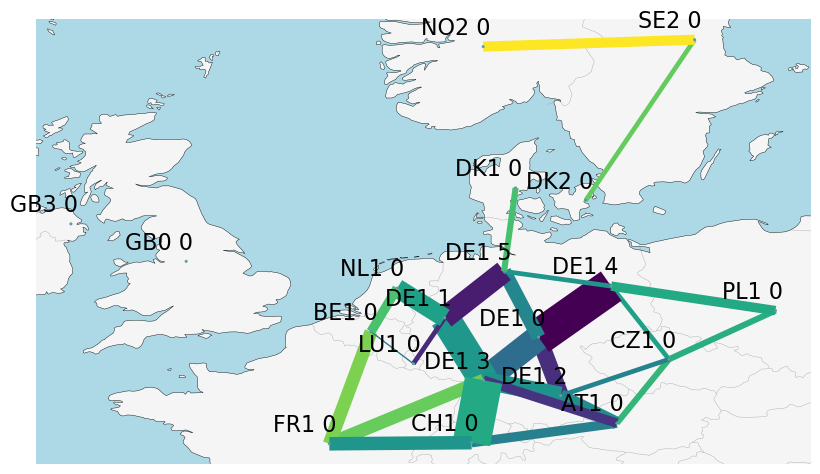

In [548]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [549]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


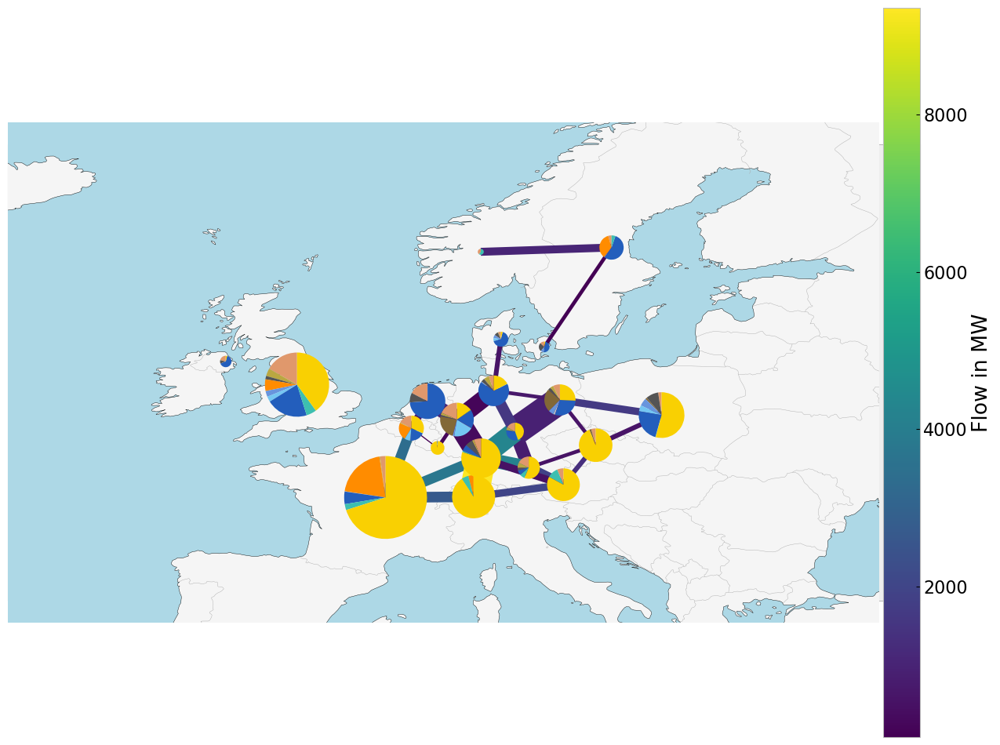

In [550]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [551]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


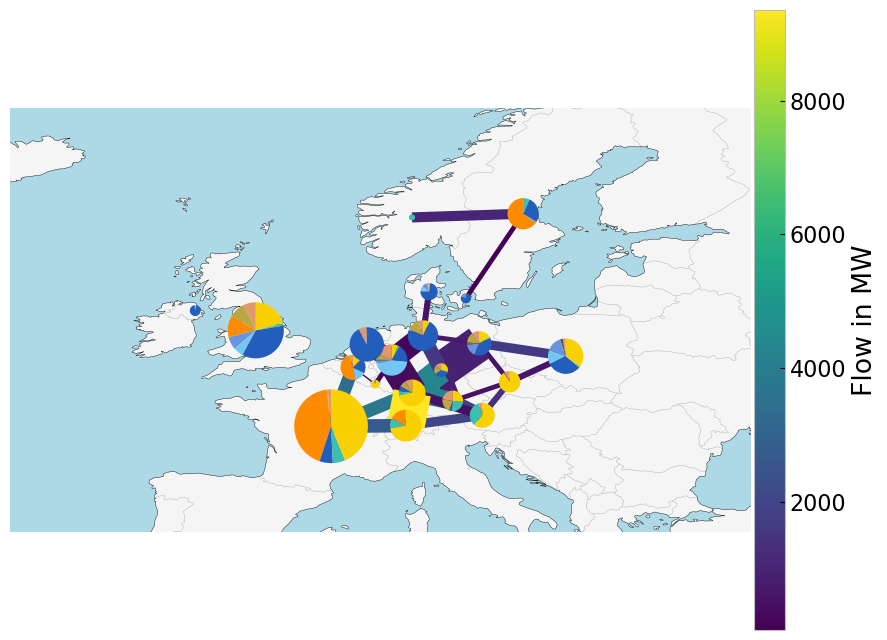

In [552]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

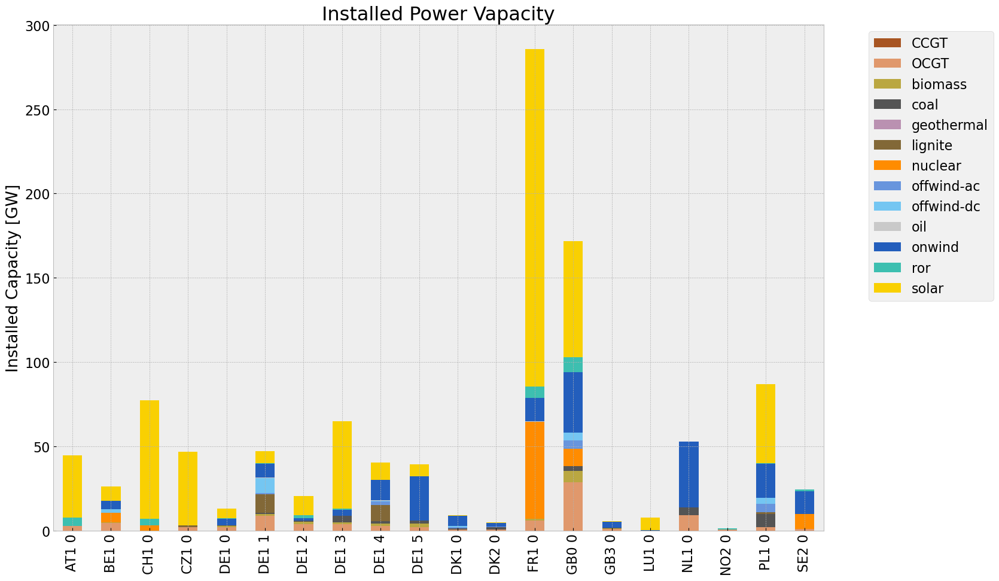

In [553]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

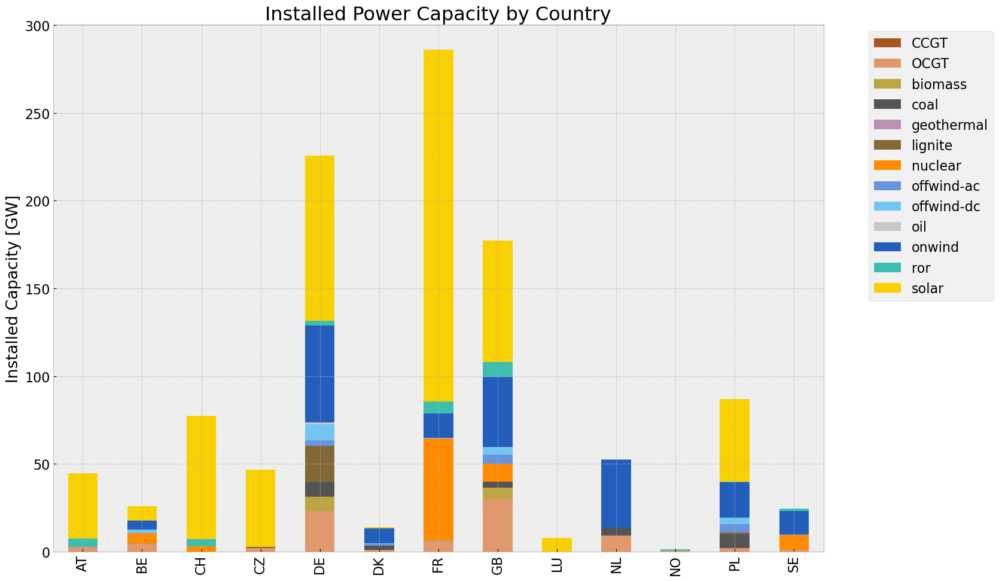

In [554]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

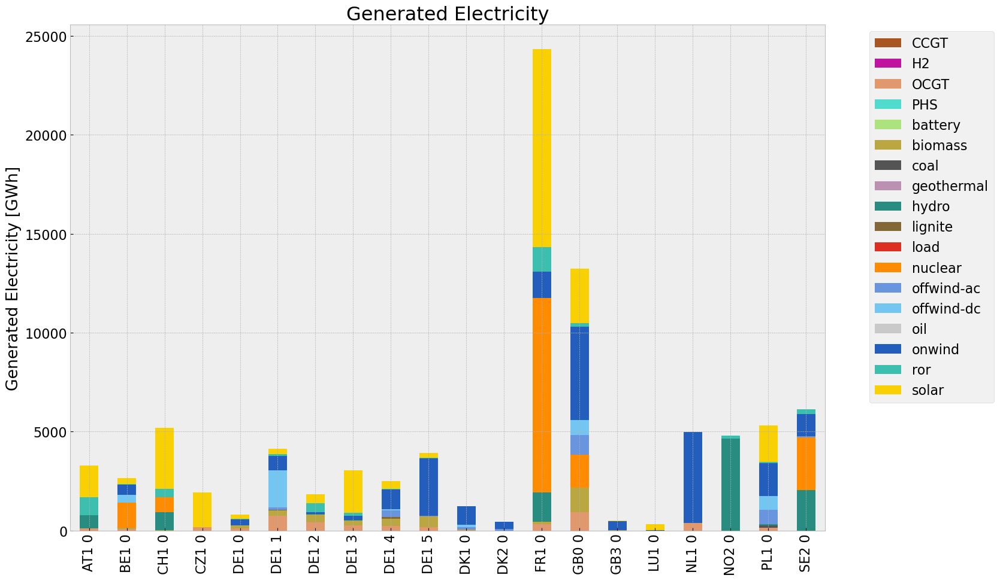

In [555]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

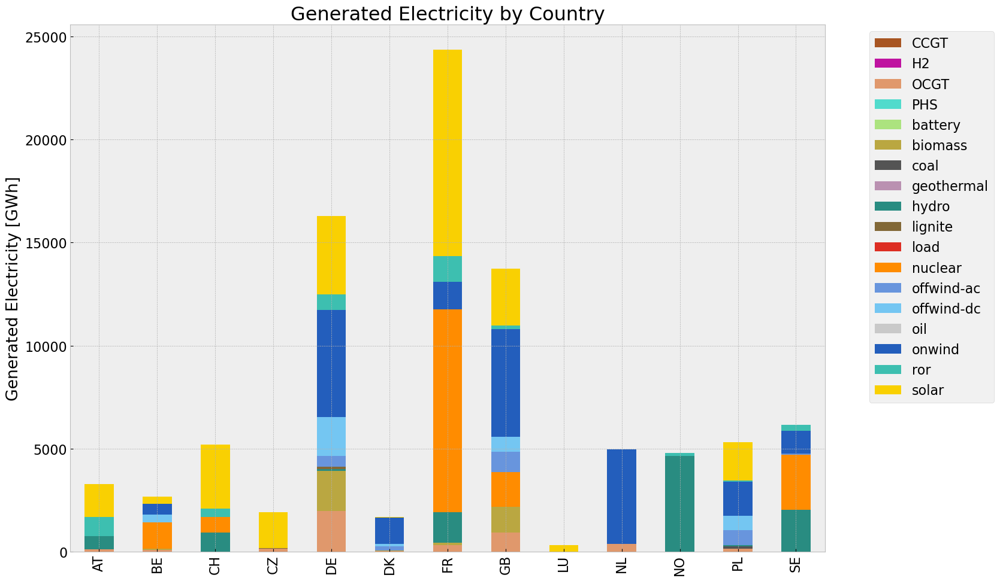

In [556]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [557]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [558]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [559]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='24H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [560]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [561]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [562]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [563]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='24H')
c:\Users\Jeremy

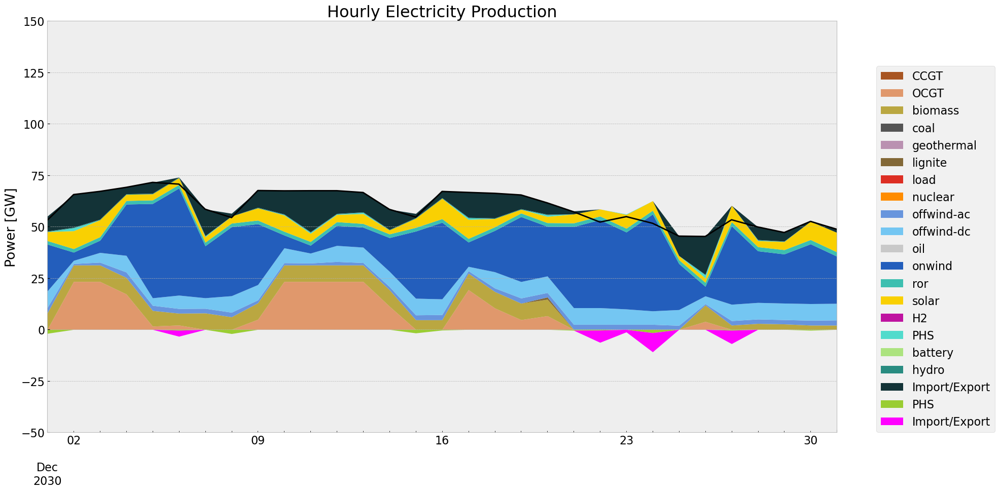

In [564]:
# winter
gen_curve(n, '2030-12-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='24H')
c:\Users\Jeremy

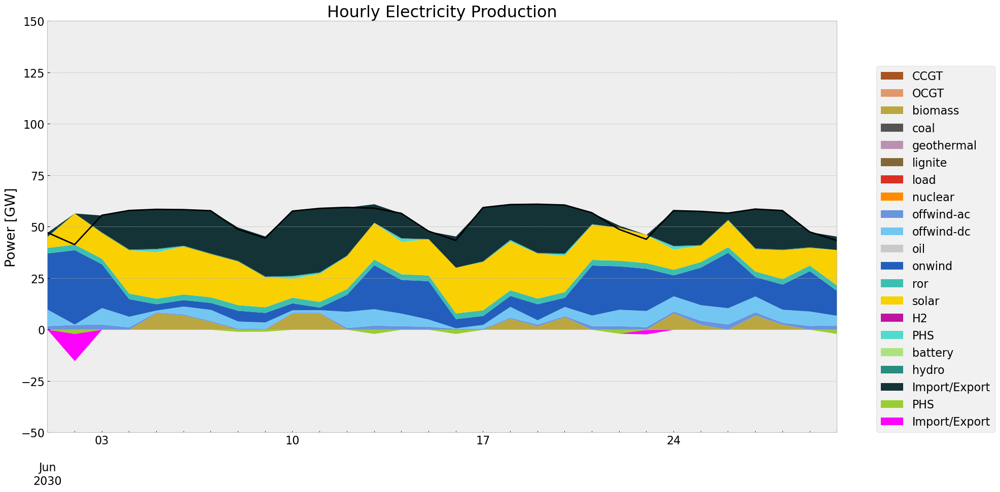

In [565]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [566]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='24H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq=

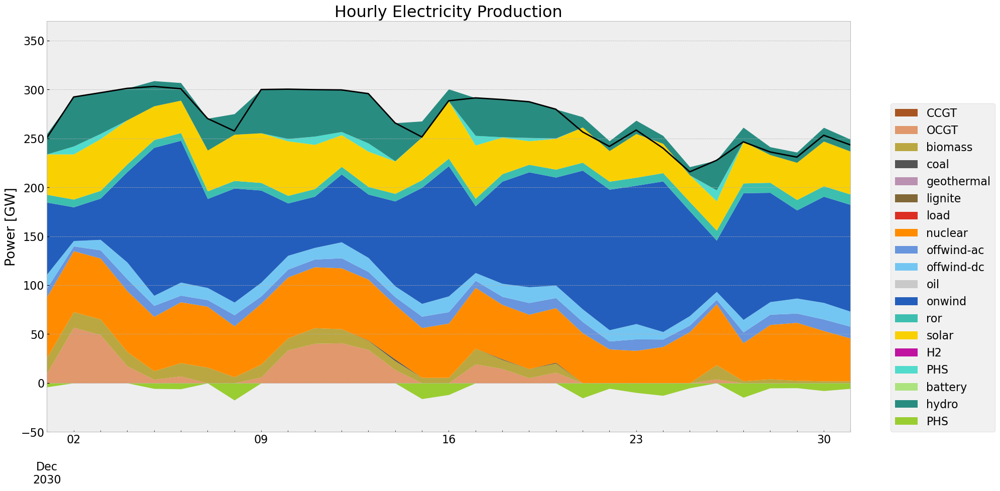

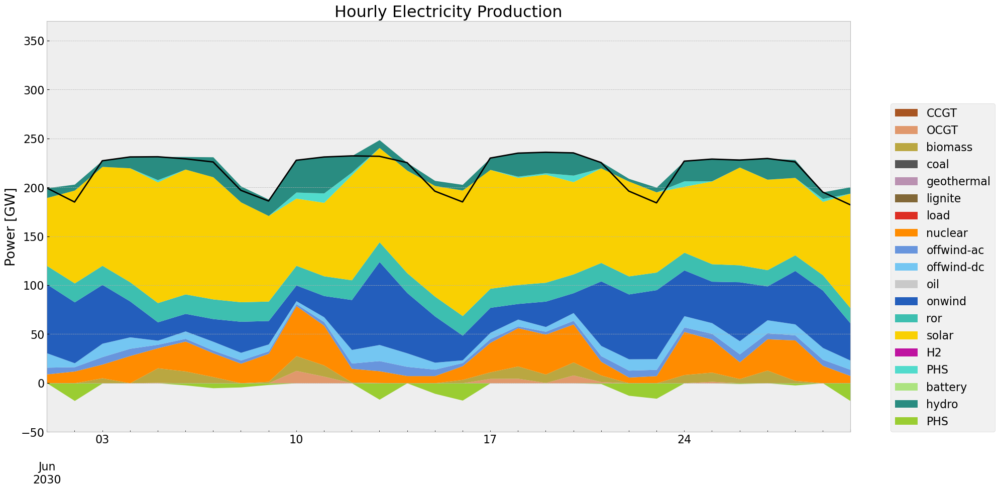

In [567]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [568]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

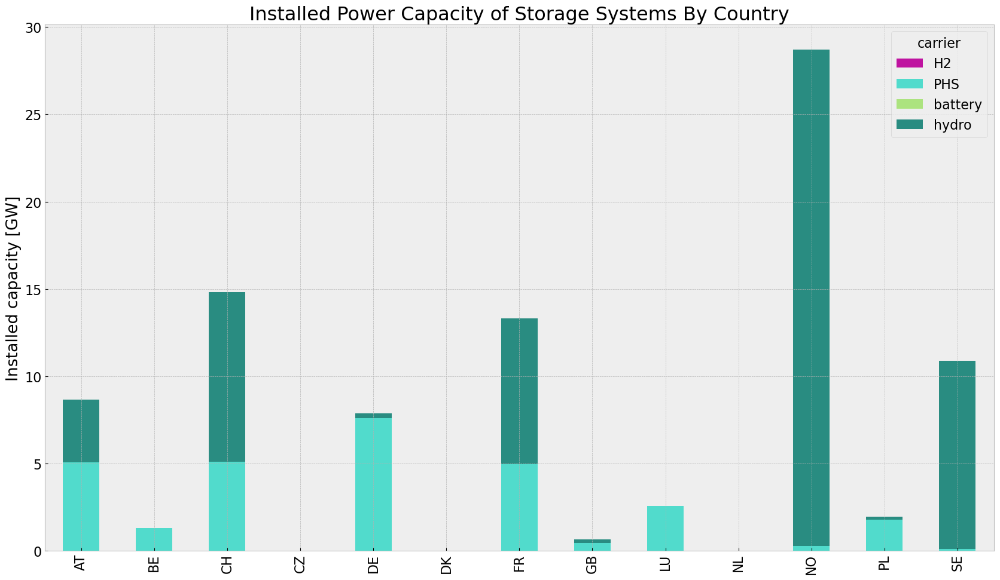

In [569]:
store_base = inst_store_table(n)

In [570]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='24H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='24H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2117112419.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2117112419.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2117112419.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='24H')


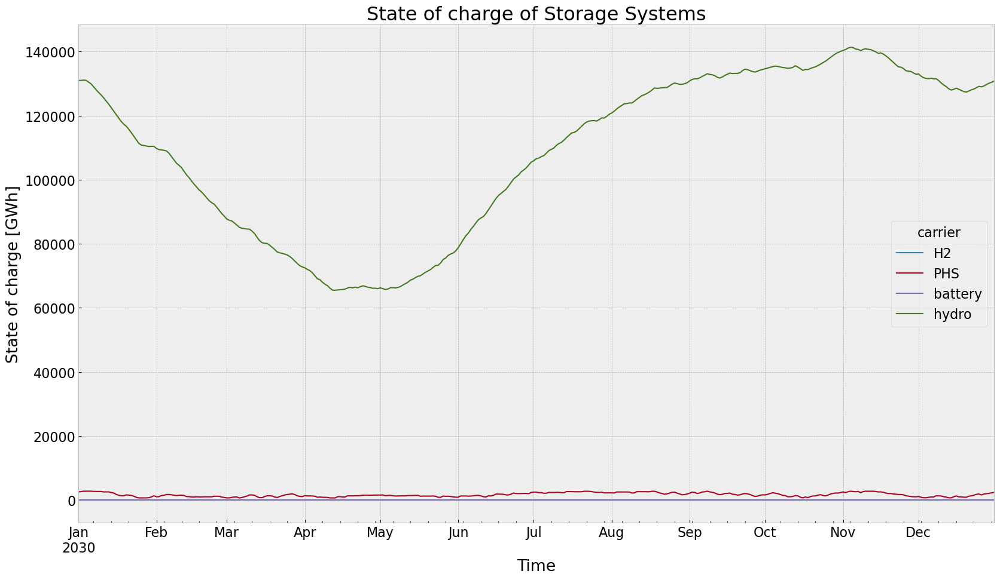

In [571]:
state_of_charge_plot(n, '2030-01-01 00:00', '2030-12-31 21:00')

## Electricity Price

In [572]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [573]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


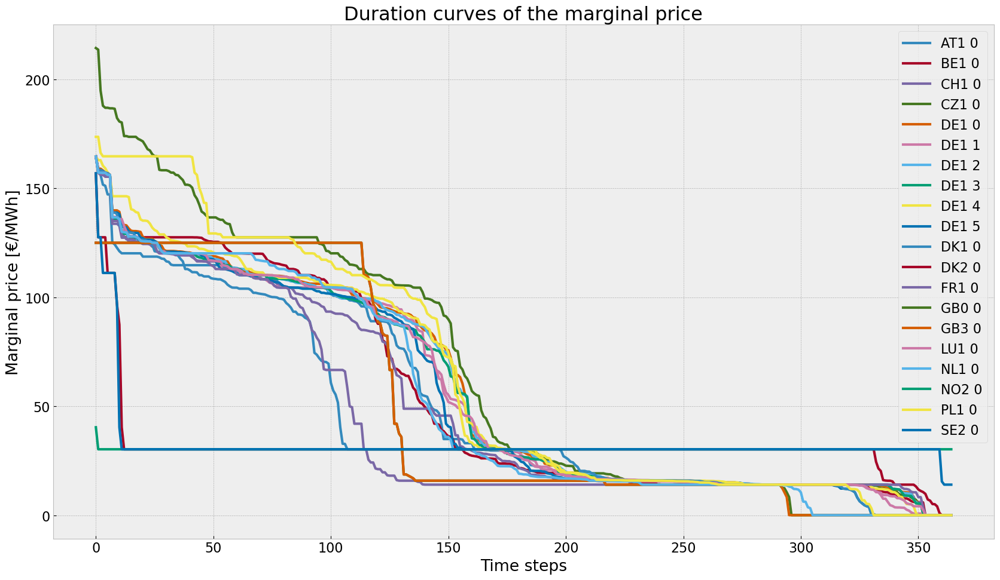

In [574]:
price_dur_curve_plot(n)

In [575]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


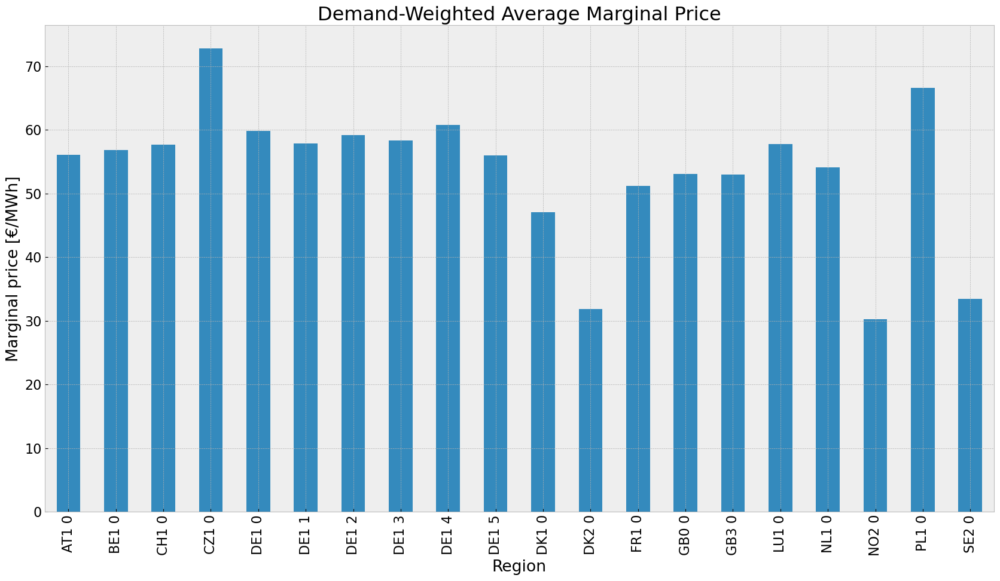

In [576]:
price_regions_table(n)

In [577]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


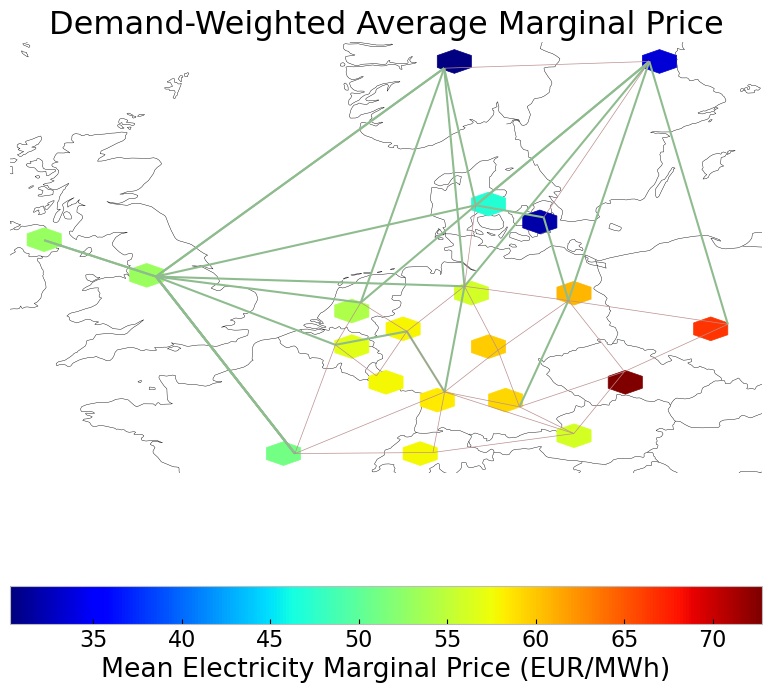

In [578]:
price_regions(n)

## Emission

In [579]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,4.172362e+06,0.451621,0.1980,1.829250e+06
biomass,3.416827e+06,0.468000,0.0000,0.000000e+00
coal,1.340987e+05,0.329908,0.3361,1.366156e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,1.343784e+05,0.337285,0.4069,1.621139e+05
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.617275e+07,0.326600,0.0000,0.000000e+00
offwind-ac,2.485185e+06,1.000000,0.0000,0.000000e+00


# PV Cut Scenario



In [580]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def pvscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('solar'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

n1 = pvscenario(n, cut_start, duration, reductionto)
n1.name = f'inv_{contingency}_24h'          

## 1. Model: perfect foresight with allowed additional investment

In [581]:
country = 'DE'

### Allow investment

In [582]:
def allow_inv(n1,n,country):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, row in n1.generators.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus']:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True
        else:
            n1.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, row in n1.storage_units.iterrows():
        if row['p_nom_extendable'] == True and country in row['bus']:
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt'] 
            n1.storage_units.at[index, 'p_nom_extendable'] = True
        else:
            n1.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, row in n1.lines.iterrows():
        if row['carrier'] == 'AC' and (country in row['bus0'] or country in row['bus1']):
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = True 
        else:
            n1.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = False 
    
    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, row in n1.links.iterrows():
        if row['carrier'] == 'DC' and (country in row['bus0'] or country in row['bus1']):
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = True 
        else:
            n1.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = False
            

allow_inv(n1,n, country)

In [583]:
n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 17.24it/s]
INFO:linopy.io: Writing time: 4.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndltwz14.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndltwz14.lp


Reading time = 1.34 seconds


INFO:gurobipy:Reading time = 1.34 seconds


obj: 408178 rows, 190229 columns, 710322 nonzeros


INFO:gurobipy:obj: 408178 rows, 190229 columns, 710322 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408178 rows, 190229 columns and 710322 nonzeros


INFO:gurobipy:Optimize a model with 408178 rows, 190229 columns and 710322 nonzeros


Model fingerprint: 0x91da030b


INFO:gurobipy:Model fingerprint: 0x91da030b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [4e-03, 2e+02]


INFO:gurobipy:  Matrix range     [4e-03, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 1e+10]


INFO:gurobipy:  Bounds range     [1e+00, 1e+10]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 345473 rows and 84871 columns


INFO:gurobipy:Presolve removed 345473 rows and 84871 columns


Presolve time: 0.52s


INFO:gurobipy:Presolve time: 0.52s


Presolved: 62705 rows, 105358 columns, 262121 nonzeros


INFO:gurobipy:Presolved: 62705 rows, 105358 columns, 262121 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.87s


INFO:gurobipy:Ordering time: 0.87s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 61


INFO:gurobipy: Dense cols : 61


 AA' NZ     : 2.564e+05


INFO:gurobipy: AA' NZ     : 2.564e+05


 Factor NZ  : 1.520e+06 (roughly 80 MB of memory)


INFO:gurobipy: Factor NZ  : 1.520e+06 (roughly 80 MB of memory)


 Factor Ops : 1.363e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.363e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.21381064e+13 -1.41819074e+15  8.36e+05 1.87e+05  3.15e+10     2s


INFO:gurobipy:   0   4.21381064e+13 -1.41819074e+15  8.36e+05 1.87e+05  3.15e+10     2s


   1   3.54888825e+13 -5.16172518e+14  6.52e+05 5.35e+04  1.84e+10     2s


INFO:gurobipy:   1   3.54888825e+13 -5.16172518e+14  6.52e+05 5.35e+04  1.84e+10     2s


   2   2.28960338e+13 -2.74124949e+14  3.84e+05 1.96e+04  1.02e+10     2s


INFO:gurobipy:   2   2.28960338e+13 -2.74124949e+14  3.84e+05 1.96e+04  1.02e+10     2s


   3   8.32553989e+12 -1.53144984e+14  5.97e+04 5.90e+03  2.18e+09     2s


INFO:gurobipy:   3   8.32553989e+12 -1.53144984e+14  5.97e+04 5.90e+03  2.18e+09     2s


   4   5.14602270e+12 -4.47896810e+13  1.56e+04 4.31e+02  4.97e+08     2s


INFO:gurobipy:   4   5.14602270e+12 -4.47896810e+13  1.56e+04 4.31e+02  4.97e+08     2s


   5   1.53572896e+12 -1.65379381e+13  1.98e+03 8.96e+01  1.07e+08     2s


INFO:gurobipy:   5   1.53572896e+12 -1.65379381e+13  1.98e+03 8.96e+01  1.07e+08     2s


   6   7.53909851e+11 -6.81019403e+12  7.24e+02 3.35e+01  3.99e+07     2s


INFO:gurobipy:   6   7.53909851e+11 -6.81019403e+12  7.24e+02 3.35e+01  3.99e+07     2s


   7   3.73239701e+11 -2.89776392e+12  1.96e+02 1.33e+01  1.58e+07     3s


INFO:gurobipy:   7   3.73239701e+11 -2.89776392e+12  1.96e+02 1.33e+01  1.58e+07     3s


   8   2.34634976e+11 -1.83176430e+12  6.51e+01 8.33e+00  9.57e+06     3s


INFO:gurobipy:   8   2.34634976e+11 -1.83176430e+12  6.51e+01 8.33e+00  9.57e+06     3s


   9   1.84777570e+11 -8.93154867e+11  3.70e+01 4.03e+00  4.95e+06     3s


INFO:gurobipy:   9   1.84777570e+11 -8.93154867e+11  3.70e+01 4.03e+00  4.95e+06     3s


  10   1.26685134e+11 -5.77260729e+11  1.23e+01 2.67e+00  3.19e+06     3s


INFO:gurobipy:  10   1.26685134e+11 -5.77260729e+11  1.23e+01 2.67e+00  3.19e+06     3s


  11   9.79595193e+10 -2.47575635e+11  6.12e+00 1.23e+00  1.56e+06     3s


INFO:gurobipy:  11   9.79595193e+10 -2.47575635e+11  6.12e+00 1.23e+00  1.56e+06     3s


  12   8.29990137e+10 -1.46332389e+11  3.97e+00 7.80e-01  1.04e+06     3s


INFO:gurobipy:  12   8.29990137e+10 -1.46332389e+11  3.97e+00 7.80e-01  1.04e+06     3s


  13   7.30915478e+10 -5.86128691e+10  2.91e+00 4.02e-01  5.94e+05     3s


INFO:gurobipy:  13   7.30915478e+10 -5.86128691e+10  2.91e+00 4.02e-01  5.94e+05     3s


  14   6.53085315e+10 -1.04856650e+10  2.27e+00 1.94e-01  3.42e+05     3s


INFO:gurobipy:  14   6.53085315e+10 -1.04856650e+10  2.27e+00 1.94e-01  3.42e+05     3s


  15   5.41083071e+10  1.91238361e+09  1.45e+00 1.40e-01  2.35e+05     3s


INFO:gurobipy:  15   5.41083071e+10  1.91238361e+09  1.45e+00 1.40e-01  2.35e+05     3s


  16   4.90146372e+10  1.36353682e+10  1.04e+00 9.11e-02  1.59e+05     3s


INFO:gurobipy:  16   4.90146372e+10  1.36353682e+10  1.04e+00 9.11e-02  1.59e+05     3s


  17   4.50496106e+10  2.37591256e+10  7.22e-01 4.68e-02  9.59e+04     4s


INFO:gurobipy:  17   4.50496106e+10  2.37591256e+10  7.22e-01 4.68e-02  9.59e+04     4s


  18   4.13230646e+10  2.89851264e+10  4.38e-01 2.38e-02  5.55e+04     4s


INFO:gurobipy:  18   4.13230646e+10  2.89851264e+10  4.38e-01 2.38e-02  5.55e+04     4s


  19   3.92041505e+10  3.09997058e+10  2.84e-01 1.57e-02  3.69e+04     4s


INFO:gurobipy:  19   3.92041505e+10  3.09997058e+10  2.84e-01 1.57e-02  3.69e+04     4s


  20   3.80786773e+10  3.19766047e+10  2.06e-01 1.18e-02  2.75e+04     4s


INFO:gurobipy:  20   3.80786773e+10  3.19766047e+10  2.06e-01 1.18e-02  2.75e+04     4s


  21   3.73801212e+10  3.27810557e+10  1.56e-01 8.62e-03  2.07e+04     4s


INFO:gurobipy:  21   3.73801212e+10  3.27810557e+10  1.56e-01 8.62e-03  2.07e+04     4s


  22   3.65291701e+10  3.35420882e+10  9.63e-02 5.66e-03  1.34e+04     4s


INFO:gurobipy:  22   3.65291701e+10  3.35420882e+10  9.63e-02 5.66e-03  1.34e+04     4s


  23   3.59998362e+10  3.41436755e+10  5.88e-02 3.35e-03  8.35e+03     4s


INFO:gurobipy:  23   3.59998362e+10  3.41436755e+10  5.88e-02 3.35e-03  8.35e+03     4s


  24   3.55974131e+10  3.44920811e+10  3.26e-02 2.06e-03  4.97e+03     4s


INFO:gurobipy:  24   3.55974131e+10  3.44920811e+10  3.26e-02 2.06e-03  4.97e+03     4s


  25   3.54132993e+10  3.47143487e+10  2.08e-02 1.24e-03  3.15e+03     4s


INFO:gurobipy:  25   3.54132993e+10  3.47143487e+10  2.08e-02 1.24e-03  3.15e+03     4s


  26   3.53241045e+10  3.48246794e+10  1.53e-02 8.53e-04  2.25e+03     5s


INFO:gurobipy:  26   3.53241045e+10  3.48246794e+10  1.53e-02 8.53e-04  2.25e+03     5s


  27   3.52470912e+10  3.48750655e+10  1.05e-02 6.67e-04  1.67e+03     5s


INFO:gurobipy:  27   3.52470912e+10  3.48750655e+10  1.05e-02 6.67e-04  1.67e+03     5s


  28   3.51818206e+10  3.49436682e+10  6.61e-03 4.29e-04  1.07e+03     5s


INFO:gurobipy:  28   3.51818206e+10  3.49436682e+10  6.61e-03 4.29e-04  1.07e+03     5s


  29   3.51275851e+10  3.49959573e+10  3.40e-03 2.40e-04  5.92e+02     5s


INFO:gurobipy:  29   3.51275851e+10  3.49959573e+10  3.40e-03 2.40e-04  5.92e+02     5s


  30   3.50973040e+10  3.50347745e+10  1.64e-03 1.01e-04  2.81e+02     5s


INFO:gurobipy:  30   3.50973040e+10  3.50347745e+10  1.64e-03 1.01e-04  2.81e+02     5s


  31   3.50835848e+10  3.50442570e+10  8.95e-04 6.77e-05  1.77e+02     6s


INFO:gurobipy:  31   3.50835848e+10  3.50442570e+10  8.95e-04 6.77e-05  1.77e+02     6s


  32   3.50760318e+10  3.50535661e+10  4.98e-04 3.80e-05  1.01e+02     6s


INFO:gurobipy:  32   3.50760318e+10  3.50535661e+10  4.98e-04 3.80e-05  1.01e+02     6s


  33   3.50731117e+10  3.50594344e+10  3.43e-04 1.89e-05  6.15e+01     6s


INFO:gurobipy:  33   3.50731117e+10  3.50594344e+10  3.43e-04 1.89e-05  6.15e+01     6s


  34   3.50710533e+10  3.50618255e+10  2.43e-04 1.17e-05  4.15e+01     6s


INFO:gurobipy:  34   3.50710533e+10  3.50618255e+10  2.43e-04 1.17e-05  4.15e+01     6s


  35   3.50698968e+10  3.50634242e+10  1.88e-04 6.99e-06  2.91e+01     6s


INFO:gurobipy:  35   3.50698968e+10  3.50634242e+10  1.88e-04 6.99e-06  2.91e+01     6s


  36   3.50686242e+10  3.50643939e+10  1.27e-04 4.20e-06  1.90e+01     6s


INFO:gurobipy:  36   3.50686242e+10  3.50643939e+10  1.27e-04 4.20e-06  1.90e+01     6s


  37   3.50674357e+10  3.50654748e+10  6.93e-05 1.15e-06  8.82e+00     6s


INFO:gurobipy:  37   3.50674357e+10  3.50654748e+10  6.93e-05 1.15e-06  8.82e+00     6s


  38   3.50665311e+10  3.50655998e+10  2.78e-05 8.41e-07  4.19e+00     7s


INFO:gurobipy:  38   3.50665311e+10  3.50655998e+10  2.78e-05 8.41e-07  4.19e+00     7s


  39   3.50662210e+10  3.50657830e+10  1.40e-05 3.75e-07  1.97e+00     7s


INFO:gurobipy:  39   3.50662210e+10  3.50657830e+10  1.40e-05 3.75e-07  1.97e+00     7s


  40   3.50661270e+10  3.50658439e+10  7.96e-06 2.33e-07  1.27e+00     7s


INFO:gurobipy:  40   3.50661270e+10  3.50658439e+10  7.96e-06 2.33e-07  1.27e+00     7s


  41   3.50660549e+10  3.50658908e+10  7.74e-06 1.31e-07  7.38e-01     7s


INFO:gurobipy:  41   3.50660549e+10  3.50658908e+10  7.74e-06 1.31e-07  7.38e-01     7s


  42   3.50660280e+10  3.50659100e+10  5.58e-06 9.08e-08  5.31e-01     7s


INFO:gurobipy:  42   3.50660280e+10  3.50659100e+10  5.58e-06 9.08e-08  5.31e-01     7s


  43   3.50659956e+10  3.50659355e+10  3.01e-06 4.02e-08  2.70e-01     7s


INFO:gurobipy:  43   3.50659956e+10  3.50659355e+10  3.01e-06 4.02e-08  2.70e-01     7s


  44   3.50659764e+10  3.50659435e+10  1.58e-06 2.27e-08  1.48e-01     7s


INFO:gurobipy:  44   3.50659764e+10  3.50659435e+10  1.58e-06 2.27e-08  1.48e-01     7s


  45   3.50659717e+10  3.50659486e+10  1.21e-06 1.21e-08  1.04e-01     8s


INFO:gurobipy:  45   3.50659717e+10  3.50659486e+10  1.21e-06 1.21e-08  1.04e-01     8s


  46   3.50659673e+10  3.50659504e+10  8.49e-07 8.96e-09  7.58e-02     8s


INFO:gurobipy:  46   3.50659673e+10  3.50659504e+10  8.49e-07 8.96e-09  7.58e-02     8s


  47   3.50659648e+10  3.50659508e+10  7.26e-07 8.31e-09  6.31e-02     8s


INFO:gurobipy:  47   3.50659648e+10  3.50659508e+10  7.26e-07 8.31e-09  6.31e-02     8s


  48   3.50659625e+10  3.50659526e+10  4.87e-07 5.16e-09  4.44e-02     8s


INFO:gurobipy:  48   3.50659625e+10  3.50659526e+10  4.87e-07 5.16e-09  4.44e-02     8s


  49   3.50659590e+10  3.50659544e+10  2.59e-07 2.27e-09  2.08e-02     8s


INFO:gurobipy:  49   3.50659590e+10  3.50659544e+10  2.59e-07 2.27e-09  2.08e-02     8s


  50   3.50659572e+10  3.50659554e+10  9.14e-08 6.79e-10  8.38e-03     8s


INFO:gurobipy:  50   3.50659572e+10  3.50659554e+10  9.14e-08 6.79e-10  8.38e-03     8s


  51   3.50659561e+10  3.50659558e+10  2.42e-08 3.02e-10  1.28e-03     9s


INFO:gurobipy:  51   3.50659561e+10  3.50659558e+10  2.42e-08 3.02e-10  1.28e-03     9s


  52   3.50659560e+10  3.50659558e+10  1.51e-07 1.85e-10  8.14e-04     9s


INFO:gurobipy:  52   3.50659560e+10  3.50659558e+10  1.51e-07 1.85e-10  8.14e-04     9s


INFO:gurobipy:


Barrier solved model in 52 iterations and 8.70 seconds (2.82 work units)


INFO:gurobipy:Barrier solved model in 52 iterations and 8.70 seconds (2.82 work units)


Optimal objective 3.50659560e+10


INFO:gurobipy:Optimal objective 3.50659560e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   20420 DPushes remaining with DInf 0.0000000e+00                 9s


INFO:gurobipy:   20420 DPushes remaining with DInf 0.0000000e+00                 9s


       0 DPushes remaining with DInf 0.0000000e+00                 9s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 9s


INFO:gurobipy:


   53774 PPushes remaining with PInf 2.6729229e-04                 9s


INFO:gurobipy:   53774 PPushes remaining with PInf 2.6729229e-04                 9s


   15988 PPushes remaining with PInf 2.5026016e-02                18s


INFO:gurobipy:   15988 PPushes remaining with PInf 2.5026016e-02                18s


       0 PPushes remaining with PInf 0.0000000e+00                27s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                27s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1666305e+01     27s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1666305e+01     27s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   64255    3.5065956e+10   0.000000e+00   1.166630e+01     27s


INFO:gurobipy:   64255    3.5065956e+10   0.000000e+00   1.166630e+01     27s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


   64269    3.5065956e+10   0.000000e+00   0.000000e+00     28s


INFO:gurobipy:   64269    3.5065956e+10   0.000000e+00   0.000000e+00     28s


INFO:gurobipy:


Solved in 64269 iterations and 27.78 seconds (16.15 work units)


INFO:gurobipy:Solved in 64269 iterations and 27.78 seconds (16.15 work units)


Optimal objective  3.506595591e+10


INFO:gurobipy:Optimal objective  3.506595591e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190229 primals, 408178 duals
Objective: 3.51e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

### Export model for later use

In [584]:
file = f"{n1.name}_24h.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_pv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


<xarray.Dataset> Size: 2MB
Dimensions:                               (snapshots: 365,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p0_i: 18, links_t_p1_i: 18,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           generators_t_p_i: 108, lines_i: 27,
                                           ...
                                           storage_units_t_p_i: 25,
                                           storage_units_t_p_dispatch_i: 25,
                                           storage_units_t_p_store_i: 15,
                                           storage_units_t_state_of_charge_i: 65,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           loads_t_p_i: 20)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 3kB 0 1 ... 363 364
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 144B '14801' ...
  * links_t_p1_i                          (links_t_p1_i) object 144B '14801' ...
  * generators_i                          (generators_i) object 2kB 'AT1 0 CC...
    ...                                    ...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 200B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 120B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * loads_i                               (loads_i) object 160B 'AT1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
Data variables: (12/100)
    snapshots_snapshot                    (snapshots) datetime64[ns] 3kB 2013...
    snapshots_objective                   (snapshots) float64 3kB 24.0 ... 24.0
    snapshots_generators                  (snapshots) float64 3kB 24.0 ... 24.0
    snapshots_stores                      (snapshots) float64 3kB 24.0 ... 24.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 73kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 44kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 190kB ...
    loads_bus                             (loads_i) object 160B 'AT1 0' ... '...
    loads_t_p_set                         (snapshots, loads_t_p_set_i) float64 58kB ...
    loads_t_p                             (snapshots, loads_t_p_i) float64 58kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_pv
    network_objective:           35065955912.9819
    network_objective_constant:  10801412755.028429
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [585]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

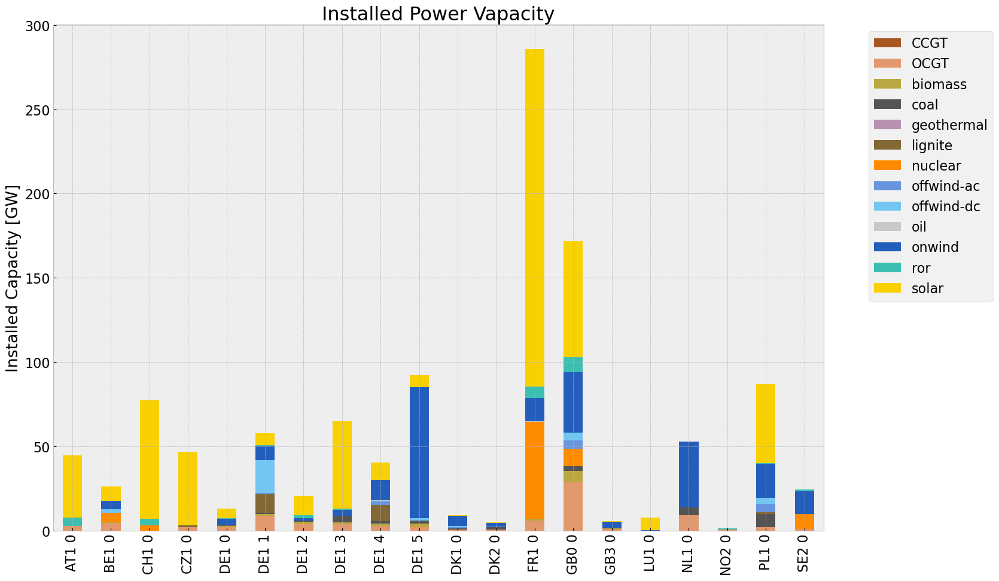

<Figure size 640x480 with 0 Axes>

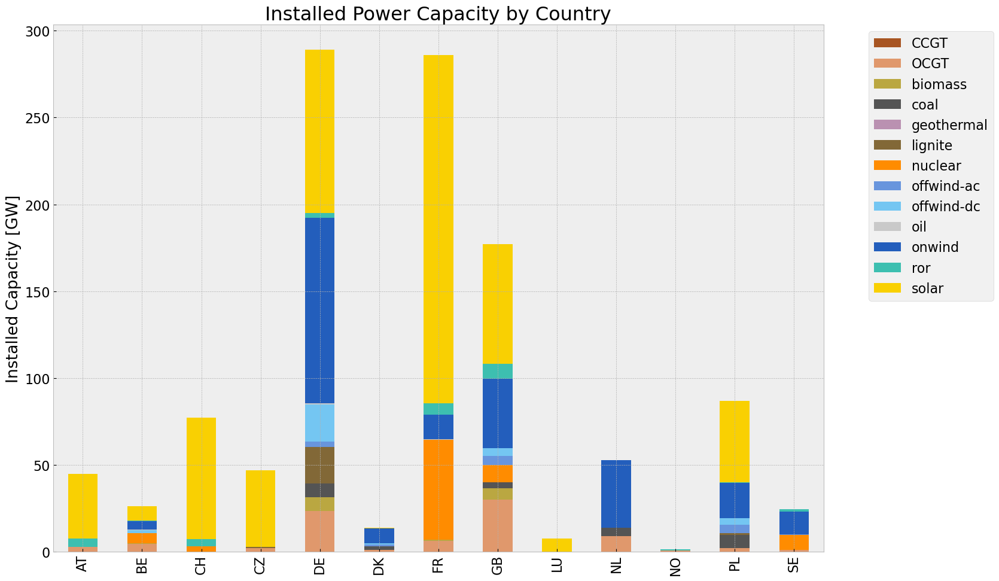

In [586]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

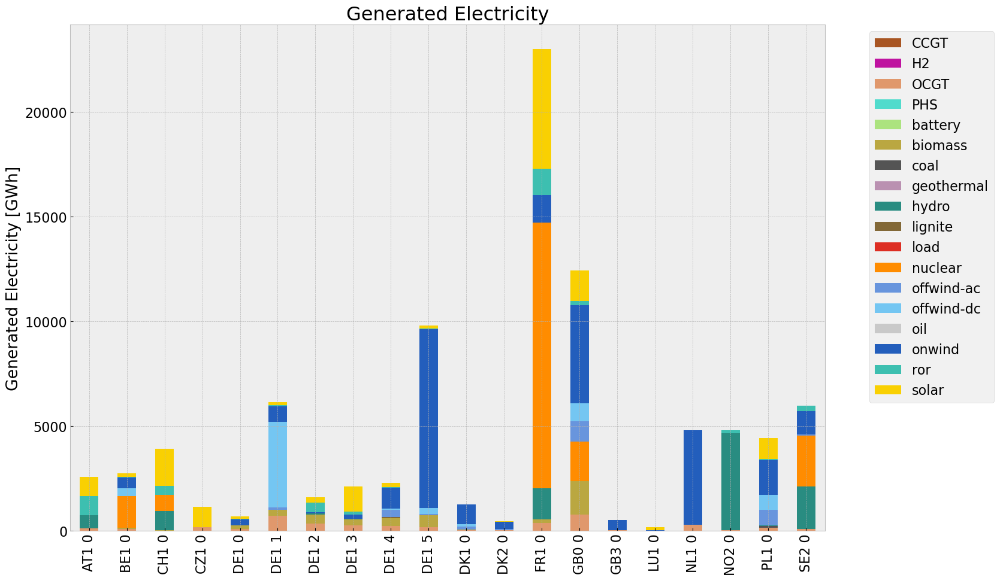

<Figure size 640x480 with 0 Axes>

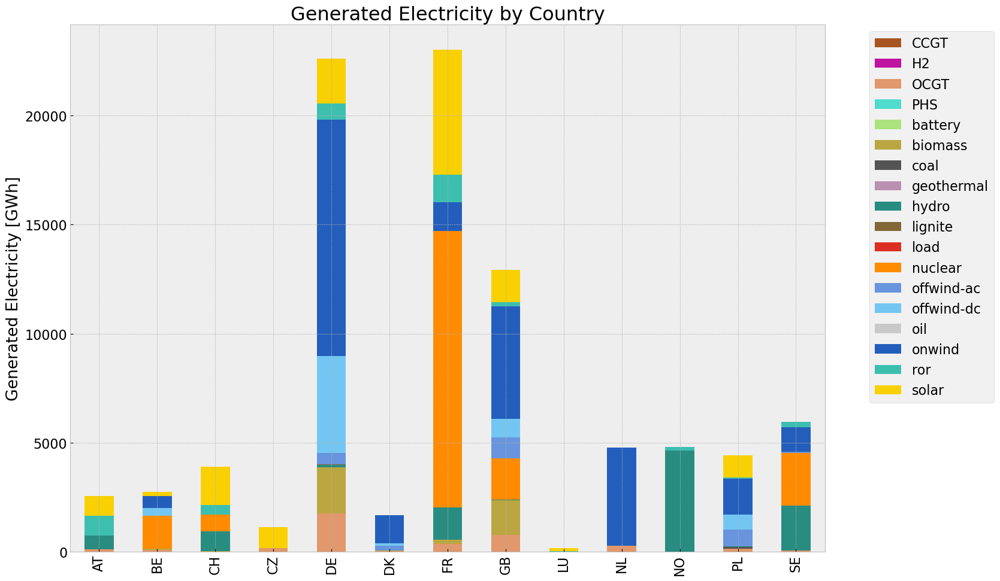

In [587]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='24H')
c:\Users\Jeremy

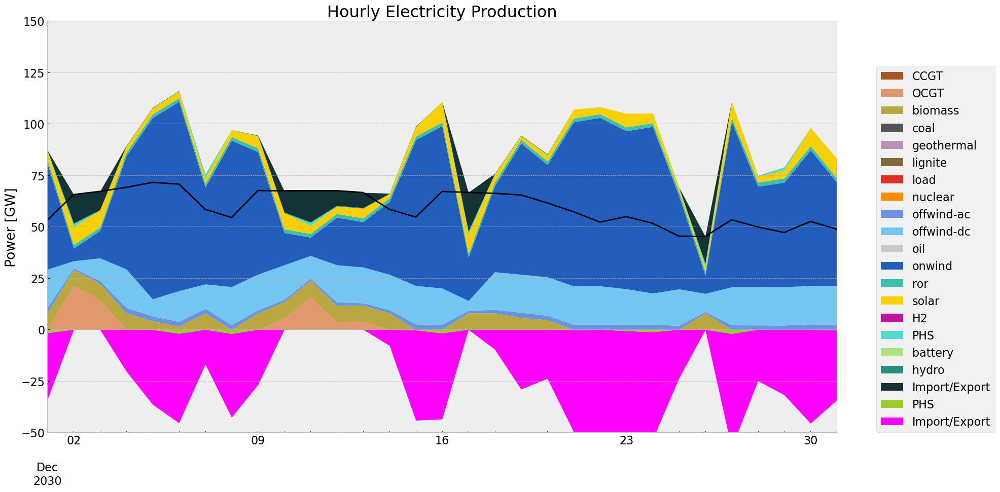

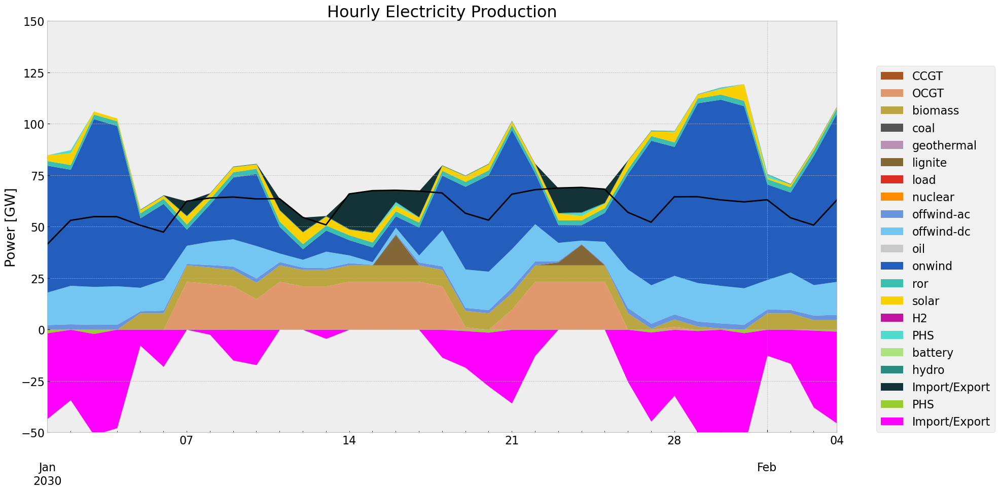

In [588]:
gen_curve(n1, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-1', '2030-02-04', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq=

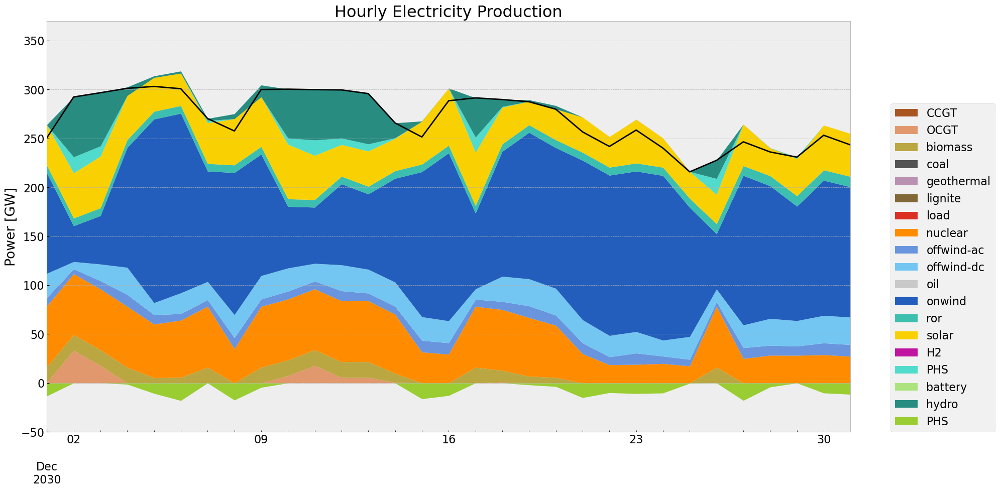

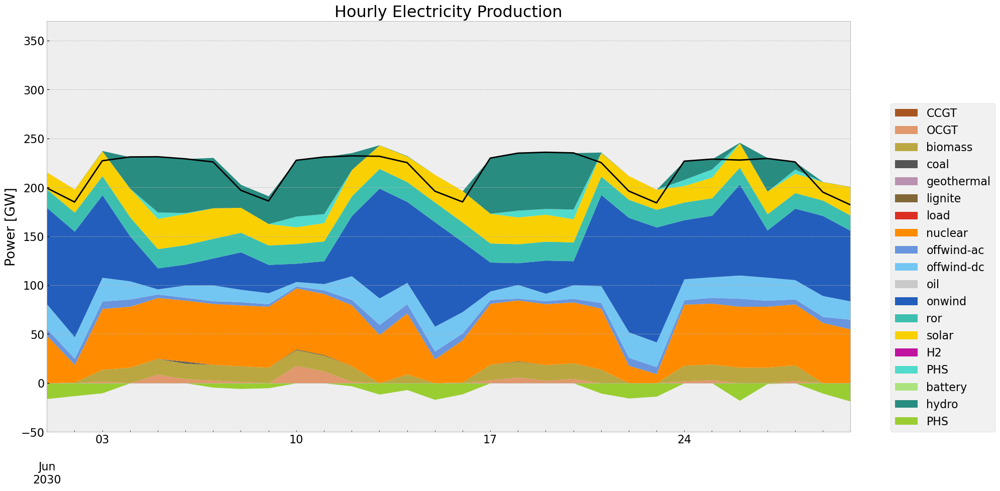

In [589]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

### Storage

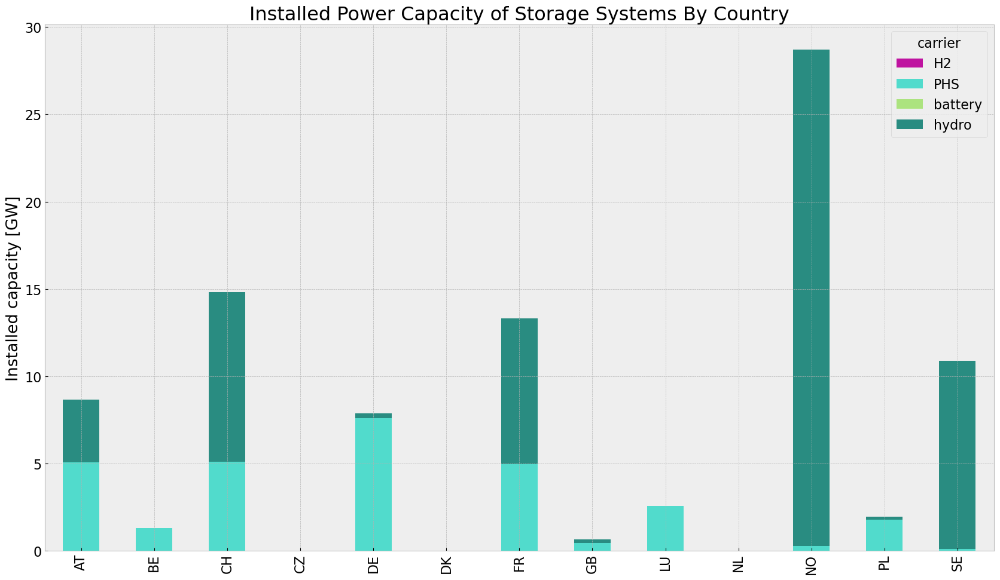

In [590]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2117112419.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2117112419.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2117112419.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='24H')


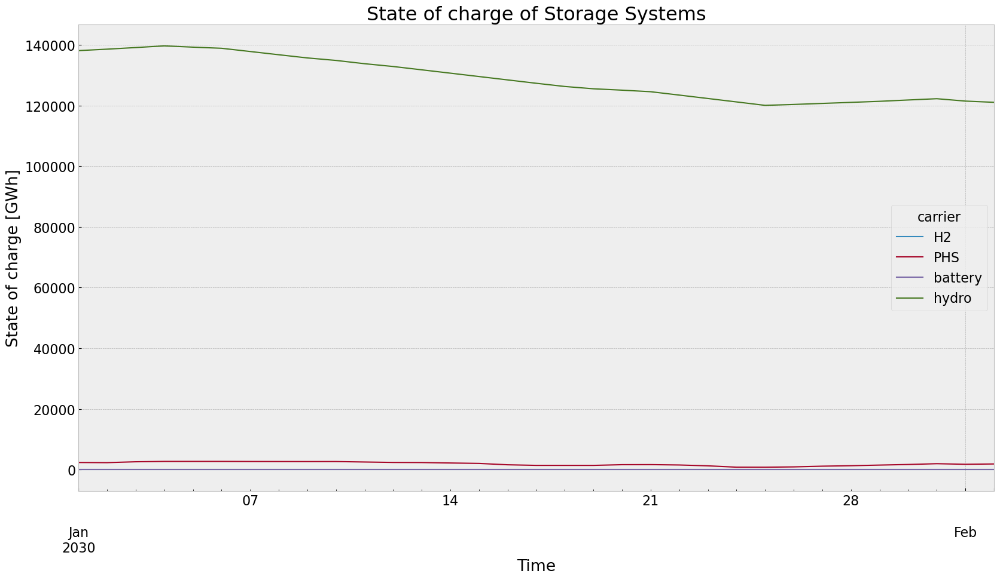

In [591]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


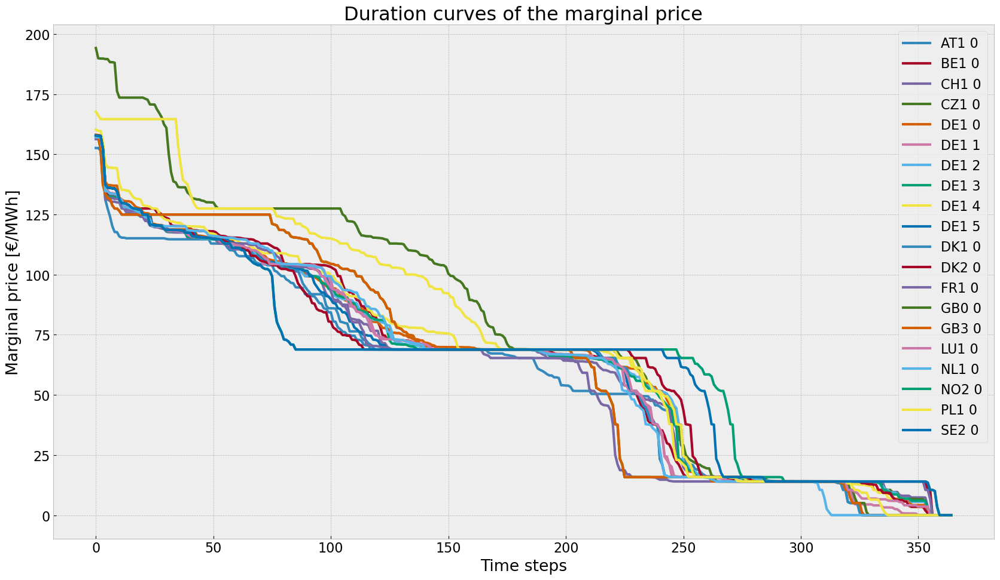

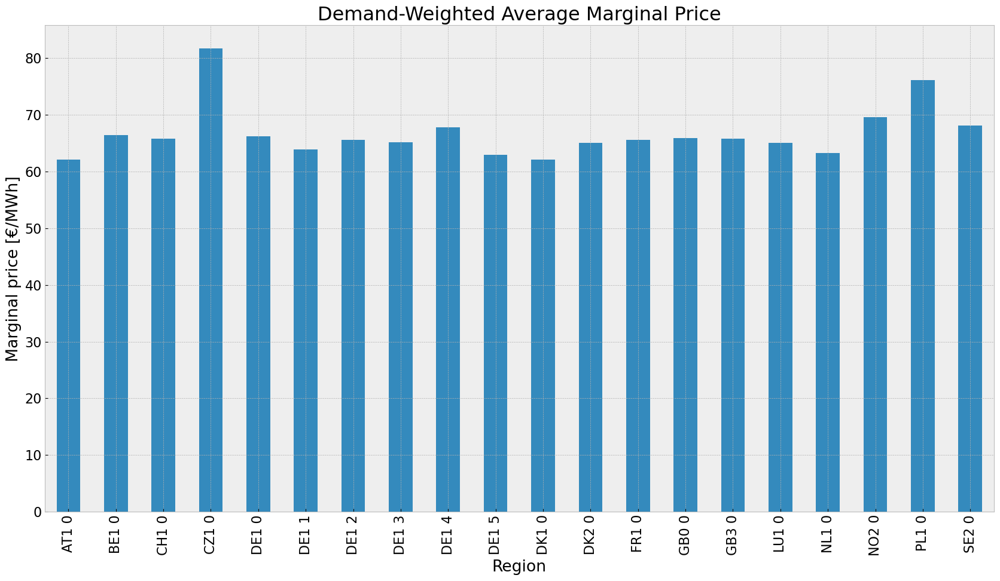

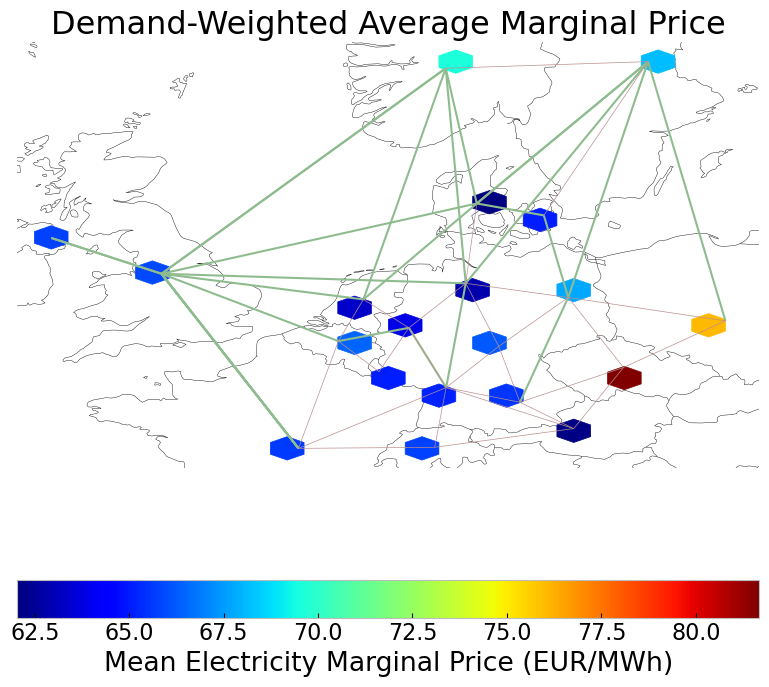

In [592]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [593]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,3.753551e+06,0.451621,0.1980,1.645635e+06
biomass,4.025954e+06,0.468000,0.0000,0.000000e+00
coal,8.461860e+04,0.329908,0.3361,8.620678e+04
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.265926e+04,0.337285,0.4069,7.559207e+04
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.926874e+07,0.326600,0.0000,0.000000e+00
offwind-ac,2.502388e+06,1.000000,0.0000,0.000000e+00


## 2. Noinv

In [594]:
n2 = pvscenario(n, cut_start, duration, reductionto)

### No Investment

In [595]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)


In [596]:
n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}_24h'    

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing constraints.:   0%|          | 0/16 [00:00<?, ?it/s]

Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 10.32it/s]
INFO:linopy.io: Writing time: 4.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d26kzf1b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d26kzf1b.lp


Reading time = 1.31 seconds


INFO:gurobipy:Reading time = 1.31 seconds


obj: 408070 rows, 190165 columns, 668680 nonzeros


INFO:gurobipy:obj: 408070 rows, 190165 columns, 668680 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


INFO:gurobipy:Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


Model fingerprint: 0xfca408dd


INFO:gurobipy:Model fingerprint: 0xfca408dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 387630 rows and 101327 columns


INFO:gurobipy:Presolve removed 387630 rows and 101327 columns


Presolve time: 0.38s


INFO:gurobipy:Presolve time: 0.38s


Presolved: 20440 rows, 88838 columns, 144683 nonzeros


INFO:gurobipy:Presolved: 20440 rows, 88838 columns, 144683 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 5.840e+04


INFO:gurobipy: AA' NZ     : 5.840e+04


 Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


 Factor Ops : 4.955e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.955e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65155507e+13 -1.50863368e+14  3.43e+05 0.00e+00  1.99e+09     1s


INFO:gurobipy:   0   1.65155507e+13 -1.50863368e+14  3.43e+05 0.00e+00  1.99e+09     1s


   1   2.16054473e+12 -1.19295434e+13  3.81e+04 2.91e-11  1.81e+08     1s


INFO:gurobipy:   1   2.16054473e+12 -1.19295434e+13  3.81e+04 2.91e-11  1.81e+08     1s


   2   5.34645740e+11 -3.43808471e+12  6.00e+03 5.02e-10  3.40e+07     1s


INFO:gurobipy:   2   5.34645740e+11 -3.43808471e+12  6.00e+03 5.02e-10  3.40e+07     1s


   3   1.48128740e+11 -1.16351114e+12  7.64e+02 1.31e-10  8.37e+06     1s


INFO:gurobipy:   3   1.48128740e+11 -1.16351114e+12  7.64e+02 1.31e-10  8.37e+06     1s


   4   8.19222800e+10 -2.03043871e+11  7.14e+01 1.20e-10  1.64e+06     1s


INFO:gurobipy:   4   8.19222800e+10 -2.03043871e+11  7.14e+01 1.20e-10  1.64e+06     1s


   5   6.30603900e+10 -5.93826870e+10  1.90e+01 4.73e-11  6.94e+05     1s


INFO:gurobipy:   5   6.30603900e+10 -5.93826870e+10  1.90e+01 4.73e-11  6.94e+05     1s


   6   5.44044017e+10 -2.06058675e+10  9.52e+00 2.91e-11  4.24e+05     1s


INFO:gurobipy:   6   5.44044017e+10 -2.06058675e+10  9.52e+00 2.91e-11  4.24e+05     1s


   7   4.69340666e+10  9.39758746e+09  3.98e+00 2.91e-11  2.12e+05     1s


INFO:gurobipy:   7   4.69340666e+10  9.39758746e+09  3.98e+00 2.91e-11  2.12e+05     1s


   8   4.06692831e+10  2.43715520e+10  8.91e-01 1.46e-11  9.18e+04     1s


INFO:gurobipy:   8   4.06692831e+10  2.43715520e+10  8.91e-01 1.46e-11  9.18e+04     1s


   9   3.89488707e+10  3.09032557e+10  4.57e-01 1.46e-11  4.53e+04     1s


INFO:gurobipy:   9   3.89488707e+10  3.09032557e+10  4.57e-01 1.46e-11  4.53e+04     1s


  10   3.77340652e+10  3.35146018e+10  1.91e-01 2.91e-11  2.38e+04     1s


INFO:gurobipy:  10   3.77340652e+10  3.35146018e+10  1.91e-01 2.91e-11  2.38e+04     1s


  11   3.72903559e+10  3.48246490e+10  1.08e-01 1.46e-11  1.39e+04     1s


INFO:gurobipy:  11   3.72903559e+10  3.48246490e+10  1.08e-01 1.46e-11  1.39e+04     1s


  12   3.69259465e+10  3.55552511e+10  4.58e-02 2.91e-11  7.72e+03     1s


INFO:gurobipy:  12   3.69259465e+10  3.55552511e+10  4.58e-02 2.91e-11  7.72e+03     1s


  13   3.67375540e+10  3.58692955e+10  1.56e-02 2.91e-11  4.89e+03     1s


INFO:gurobipy:  13   3.67375540e+10  3.58692955e+10  1.56e-02 2.91e-11  4.89e+03     1s


  14   3.66800810e+10  3.63554363e+10  7.08e-03 2.91e-11  1.83e+03     1s


INFO:gurobipy:  14   3.66800810e+10  3.63554363e+10  7.08e-03 2.91e-11  1.83e+03     1s


  15   3.66547570e+10  3.64547724e+10  3.87e-03 1.46e-11  1.13e+03     1s


INFO:gurobipy:  15   3.66547570e+10  3.64547724e+10  3.87e-03 1.46e-11  1.13e+03     1s


  16   3.66400687e+10  3.65215781e+10  2.21e-03 2.91e-11  6.67e+02     1s


INFO:gurobipy:  16   3.66400687e+10  3.65215781e+10  2.21e-03 2.91e-11  6.67e+02     1s


  17   3.66319528e+10  3.65594611e+10  1.36e-03 2.91e-11  4.08e+02     1s


INFO:gurobipy:  17   3.66319528e+10  3.65594611e+10  1.36e-03 2.91e-11  4.08e+02     1s


  18   3.66229124e+10  3.65873123e+10  4.58e-04 1.46e-11  2.00e+02     1s


INFO:gurobipy:  18   3.66229124e+10  3.65873123e+10  4.58e-04 1.46e-11  2.00e+02     1s


  19   3.66190285e+10  3.66081090e+10  1.23e-04 2.91e-11  6.15e+01     1s


INFO:gurobipy:  19   3.66190285e+10  3.66081090e+10  1.23e-04 2.91e-11  6.15e+01     1s


  20   3.66182326e+10  3.66119536e+10  6.76e-05 1.46e-11  3.53e+01     2s


INFO:gurobipy:  20   3.66182326e+10  3.66119536e+10  6.76e-05 1.46e-11  3.53e+01     2s


  21   3.66175003e+10  3.66152324e+10  1.98e-05 1.46e-11  1.28e+01     2s


INFO:gurobipy:  21   3.66175003e+10  3.66152324e+10  1.98e-05 1.46e-11  1.28e+01     2s


  22   3.66171566e+10  3.66169575e+10  4.27e-06 2.91e-11  1.12e+00     2s


INFO:gurobipy:  22   3.66171566e+10  3.66169575e+10  4.27e-06 2.91e-11  1.12e+00     2s


  23   3.66171065e+10  3.66170766e+10  1.81e-06 1.06e-09  1.68e-01     2s


INFO:gurobipy:  23   3.66171065e+10  3.66170766e+10  1.81e-06 1.06e-09  1.68e-01     2s


  24   3.66171000e+10  3.66170919e+10  4.85e-07 5.18e-10  4.55e-02     2s


INFO:gurobipy:  24   3.66171000e+10  3.66170919e+10  4.85e-07 5.18e-10  4.55e-02     2s


  25   3.66170979e+10  3.66170958e+10  9.37e-08 2.12e-10  1.19e-02     2s


INFO:gurobipy:  25   3.66170979e+10  3.66170958e+10  9.37e-08 2.12e-10  1.19e-02     2s


  26   3.66170976e+10  3.66170971e+10  1.85e-06 1.28e-10  3.17e-03     2s


INFO:gurobipy:  26   3.66170976e+10  3.66170971e+10  1.85e-06 1.28e-10  3.17e-03     2s


  27   3.66170973e+10  3.66170973e+10  4.75e-07 2.91e-11  3.01e-04     2s


INFO:gurobipy:  27   3.66170973e+10  3.66170973e+10  4.75e-07 2.91e-11  3.01e-04     2s


  28   3.66170973e+10  3.66170973e+10  2.00e-07 2.91e-11  3.81e-06     2s


INFO:gurobipy:  28   3.66170973e+10  3.66170973e+10  2.00e-07 2.91e-11  3.81e-06     2s


  29   3.66170973e+10  3.66170973e+10  2.17e-08 2.91e-11  3.81e-09     2s


INFO:gurobipy:  29   3.66170973e+10  3.66170973e+10  2.17e-08 2.91e-11  3.81e-09     2s


INFO:gurobipy:


Barrier solved model in 29 iterations and 2.03 seconds (0.94 work units)


INFO:gurobipy:Barrier solved model in 29 iterations and 2.03 seconds (0.94 work units)


Optimal objective 3.66170973e+10


INFO:gurobipy:Optimal objective 3.66170973e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    2740 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    2740 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


    1939 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:    1939 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.2994396e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.2994396e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4682    3.6617097e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    4682    3.6617097e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 4682 iterations and 2.49 seconds (1.12 work units)


INFO:gurobipy:Solved in 4682 iterations and 2.49 seconds (1.12 work units)


Optimal objective  3.661709733e+10


INFO:gurobipy:Optimal objective  3.661709733e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190165 primals, 408070 duals
Objective: 3.66e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export model for later use

In [597]:
file = f"{n2.name}_24h.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_pv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


<xarray.Dataset> Size: 2MB
Dimensions:                               (snapshots: 365,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p0_i: 12, links_t_p1_i: 12,
                                           global_constraints_i: 1,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           ...
                                           storage_units_t_p_i: 24,
                                           storage_units_t_p_dispatch_i: 24,
                                           storage_units_t_p_store_i: 14,
                                           storage_units_t_state_of_charge_i: 65,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           loads_t_p_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 3kB 0 1 ... 363 364
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 96B '14805' ....
  * links_t_p1_i                          (links_t_p1_i) object 96B '14805' ....
  * global_constraints_i                  (global_constraints_i) object 8B 'l...
    ...                                    ...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 192B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 112B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * loads_i                               (loads_i) object 160B 'AT1 0' ... '...
  * loads_t_p_set_i                       (loads_t_p_set_i) object 160B 'AT1 ...
  * loads_t_p_i                           (loads_t_p_i) object 160B 'AT1 0' ....
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 3kB 2013...
    snapshots_objective                   (snapshots) float64 3kB 24.0 ... 24.0
    snapshots_generators                  (snapshots) float64 3kB 24.0 ... 24.0
    snapshots_stores                      (snapshots) float64 3kB 24.0 ... 24.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 70kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 41kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 190kB ...
    loads_bus                             (loads_i) object 160B 'AT1 0' ... '...
    loads_t_p_set                         (snapshots, loads_t_p_set_i) float64 58kB ...
    loads_t_p                             (snapshots, loads_t_p_i) float64 58kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_pv
    network_objective:       36617097326.507126
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [598]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

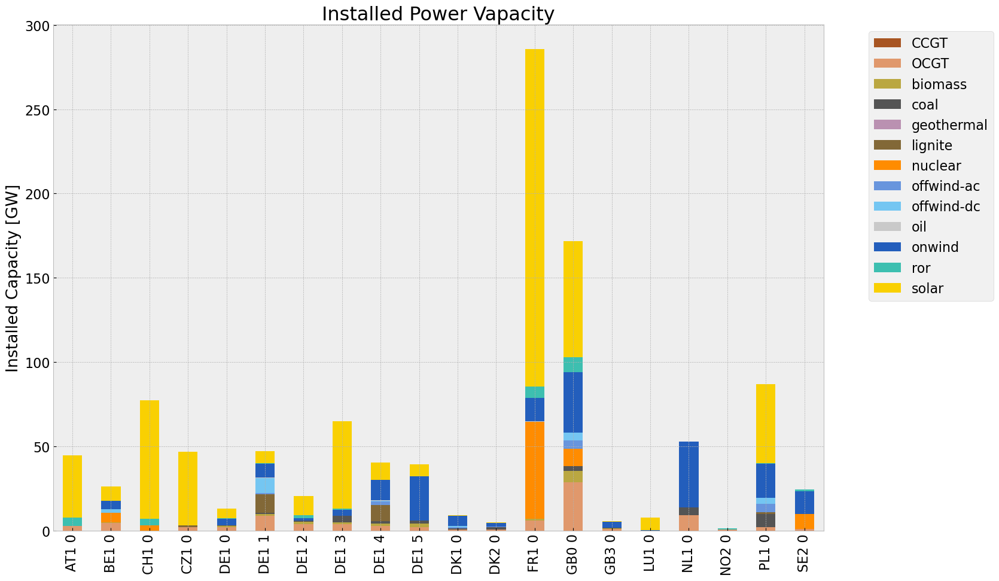

<Figure size 640x480 with 0 Axes>

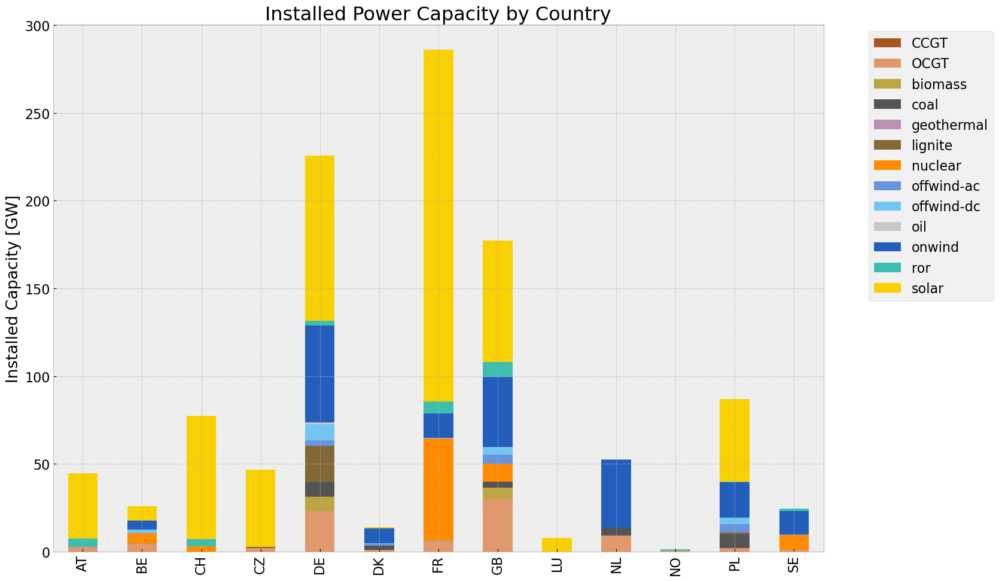

In [599]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

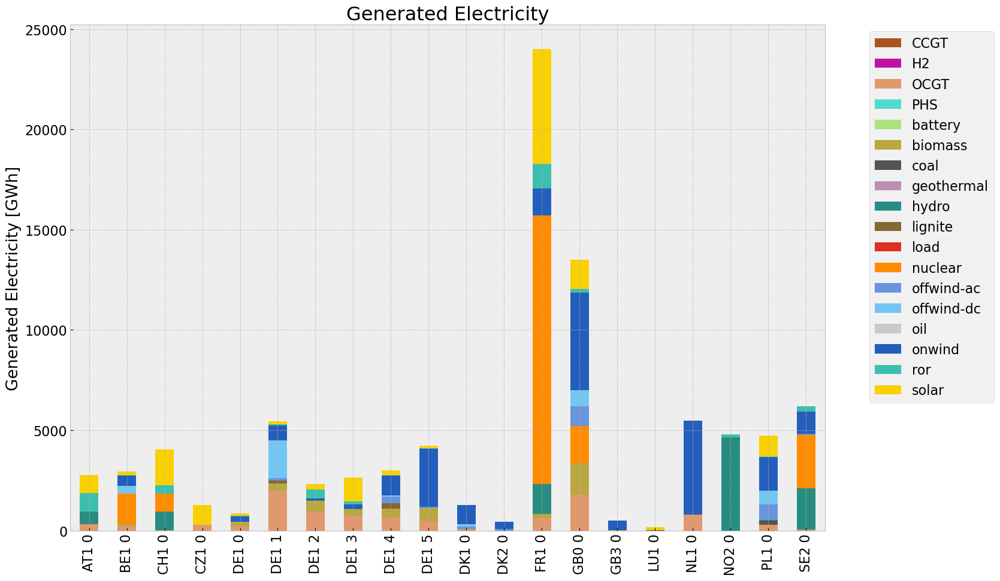

<Figure size 640x480 with 0 Axes>

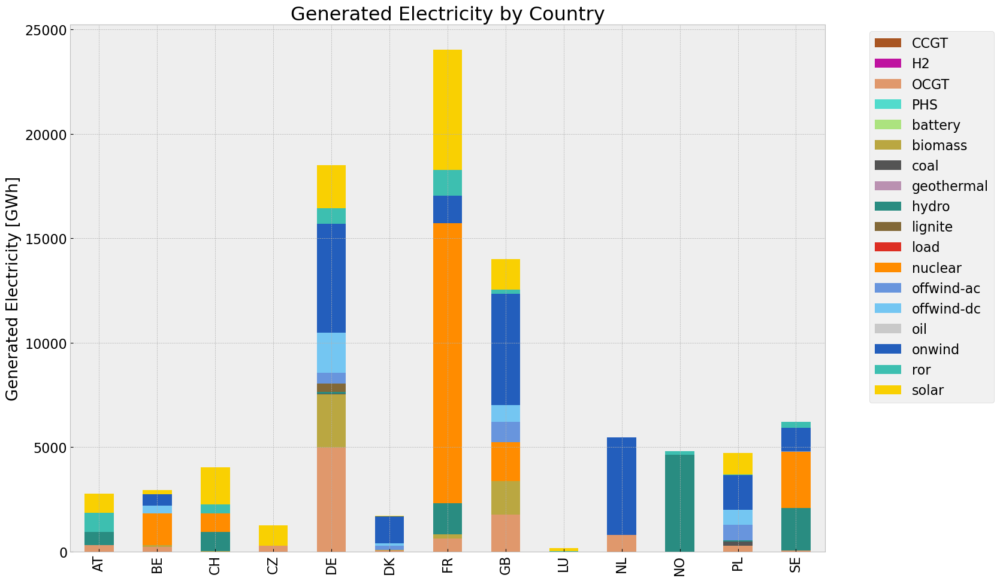

In [600]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2796143640.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2796143640.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() 

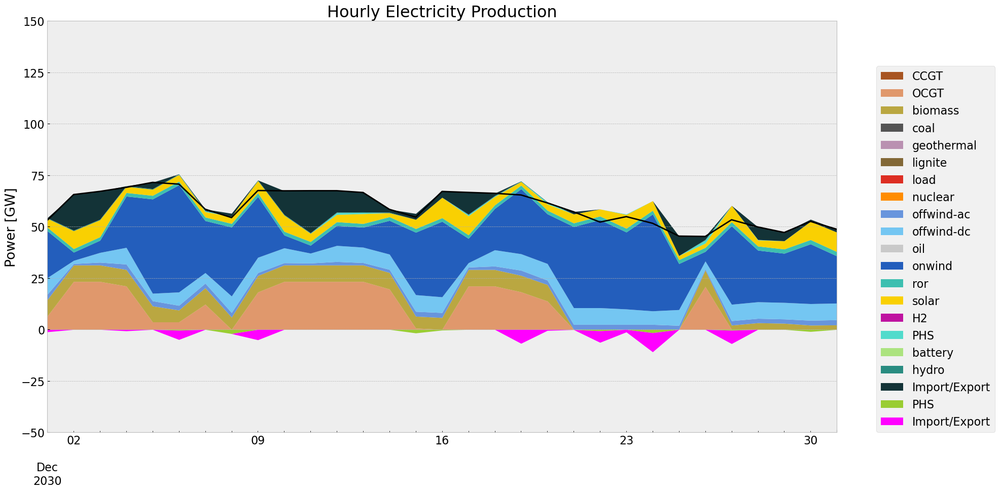

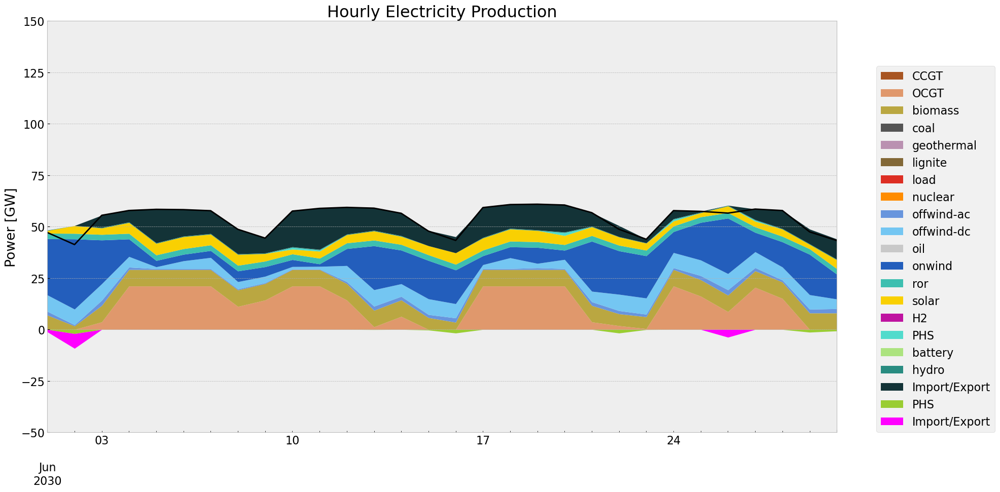

In [601]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4027937647.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq=

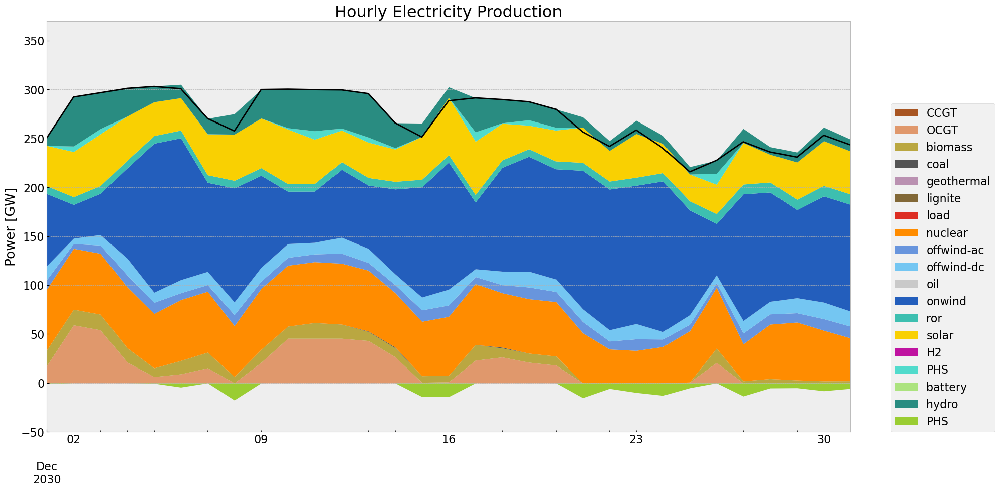

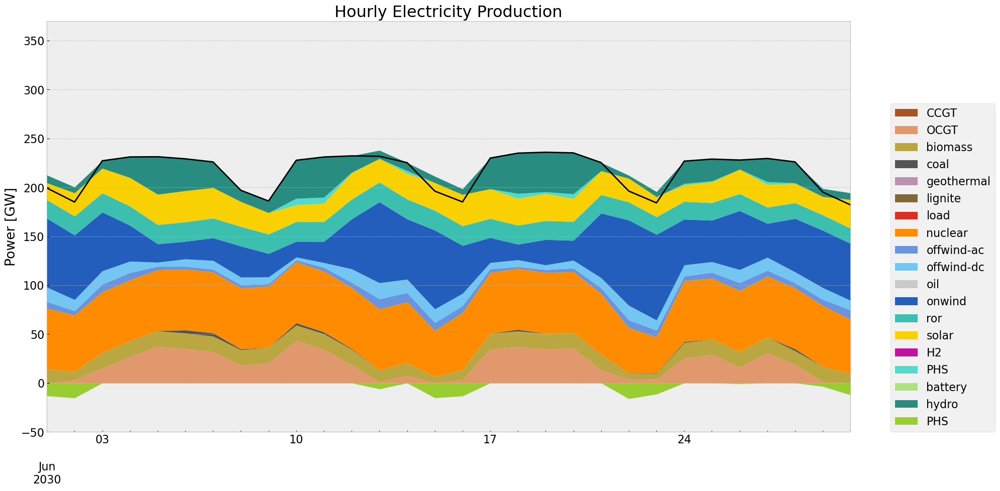

In [602]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

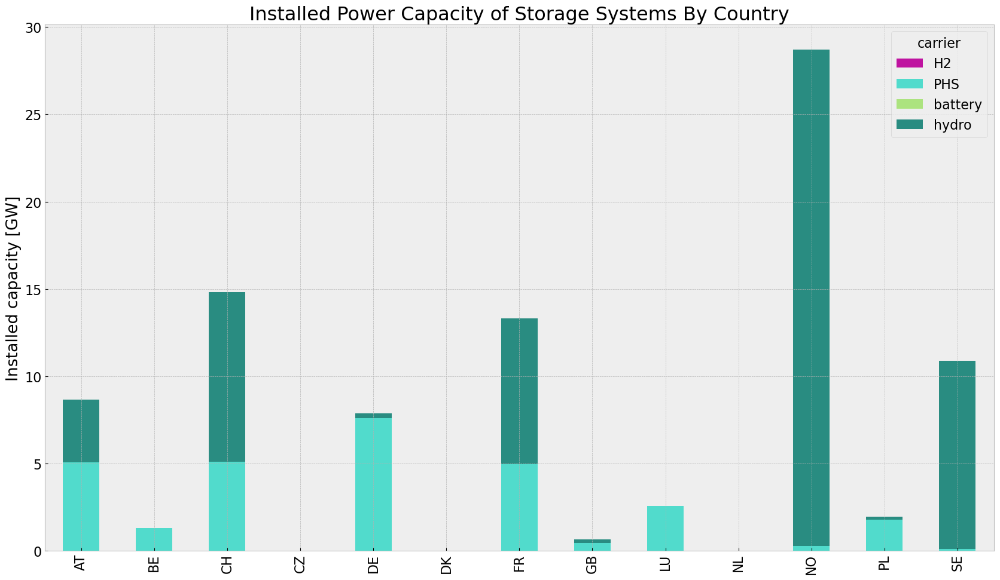

In [603]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2117112419.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2117112419.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2117112419.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3960349780.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, ax

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,9.438851e+06,0.451621,0.1980,4.138189e+06
biomass,4.488061e+06,0.468000,0.0000,0.000000e+00
coal,2.239727e+05,0.329908,0.3361,2.281764e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,4.221868e+05,0.337285,0.4069,5.093257e+05
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,2.034241e+07,0.326600,0.0000,0.000000e+00
offwind-ac,2.504547e+06,1.000000,0.0000,0.000000e+00


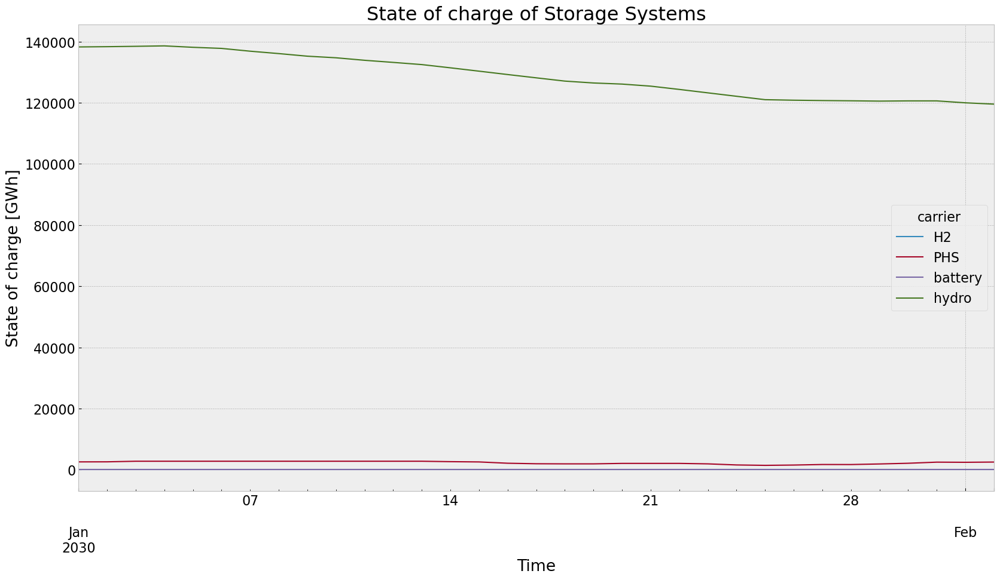

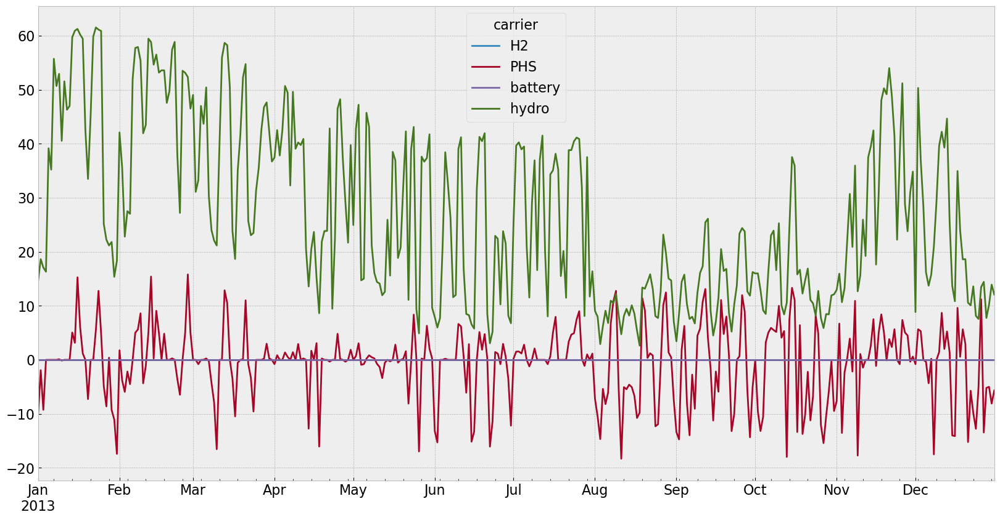

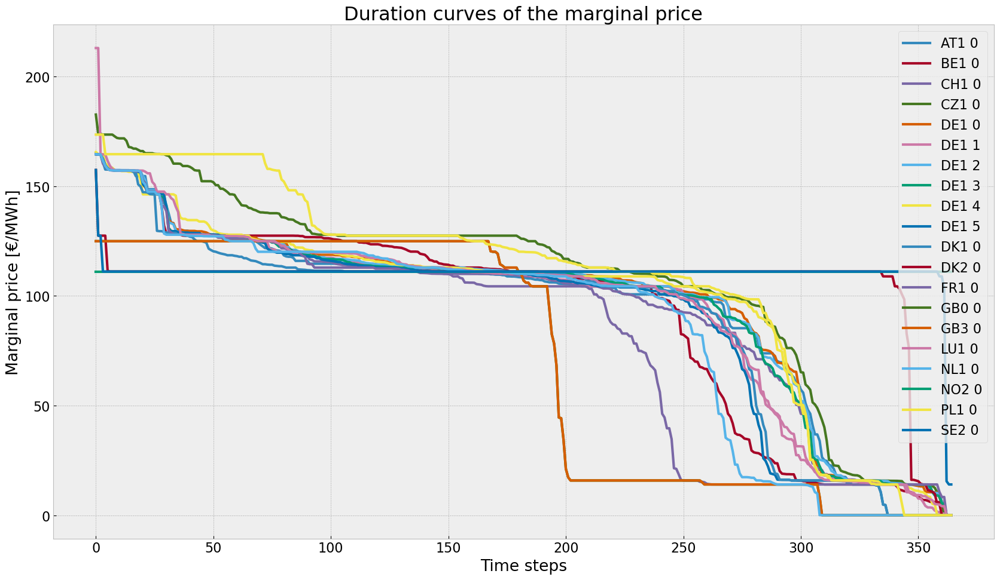

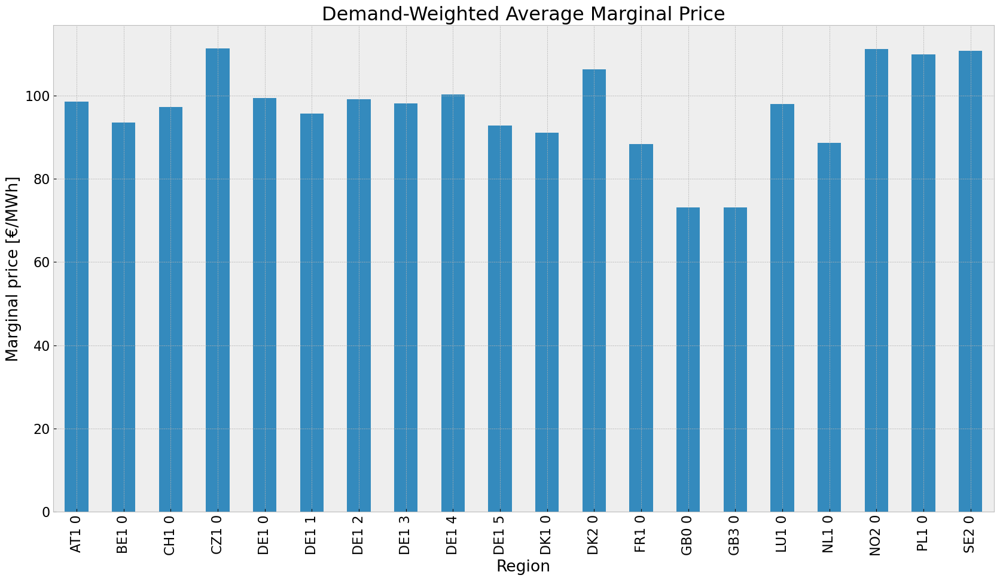

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


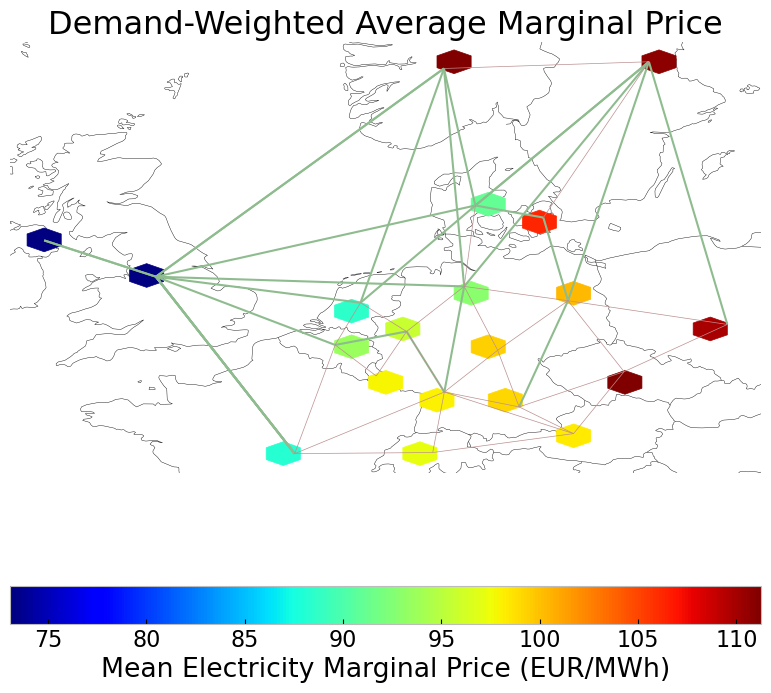

In [604]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-02-02 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='24H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [605]:
n3 = pvscenario(n, cut_start, duration, reductionto)

no_inv(n3,n)
horizon = 3
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}_24h'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-26fc6g_9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-26fc6g_9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x243ac52d


INFO:gurobipy:Model fingerprint: 0x243ac52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.475380384e+08


INFO:gurobipy:Optimal objective  1.475380384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hokpuk8p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hokpuk8p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0452390


INFO:gurobipy:Model fingerprint: 0xe0452390


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.039470602e+08


INFO:gurobipy:Optimal objective  4.039470602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6at515u1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6at515u1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9458a810


INFO:gurobipy:Model fingerprint: 0x9458a810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.877211627e+09


INFO:gurobipy:Optimal objective  1.877211627e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6ssth8i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6ssth8i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33da0a61


INFO:gurobipy:Model fingerprint: 0x33da0a61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.820576237e+09


INFO:gurobipy:Optimal objective  1.820576237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pbai53ar.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pbai53ar.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38ebecd


INFO:gurobipy:Model fingerprint: 0xc38ebecd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.370124281e+09


INFO:gurobipy:Optimal objective  3.370124281e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-olgpduhi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-olgpduhi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77cd13c4


INFO:gurobipy:Model fingerprint: 0x77cd13c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 904 columns


INFO:gurobipy:Presolve removed 3190 rows and 904 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.032715753e+09


INFO:gurobipy:Optimal objective  6.032715753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bwdhaig2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bwdhaig2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53fa4487


INFO:gurobipy:Model fingerprint: 0x53fa4487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.344857838e+09


INFO:gurobipy:Optimal objective  2.344857838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ownfwpl1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ownfwpl1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8eef27


INFO:gurobipy:Model fingerprint: 0x7a8eef27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.969365246e+09


INFO:gurobipy:Optimal objective  5.969365246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y5tfjicx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y5tfjicx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x867aca16


INFO:gurobipy:Model fingerprint: 0x867aca16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.638809453e+09


INFO:gurobipy:Optimal objective  2.638809453e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p039u8z0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p039u8z0.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfabb1453


INFO:gurobipy:Model fingerprint: 0xfabb1453


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.045567258e+09


INFO:gurobipy:Optimal objective  1.045567258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzvszshl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzvszshl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd8447fee


INFO:gurobipy:Model fingerprint: 0xd8447fee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 878 columns


INFO:gurobipy:Presolve removed 3190 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2999016e+08   2.328214e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2999016e+08   2.328214e+05   0.000000e+00      0s


     200    1.6541116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.6541116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.654111638e+09


INFO:gurobipy:Optimal objective  1.654111638e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6xj5283w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6xj5283w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x03edd202


INFO:gurobipy:Model fingerprint: 0x03edd202


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3193 rows and 883 columns


INFO:gurobipy:Presolve removed 3193 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4098508e+08   4.260094e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4098508e+08   4.260094e+05   0.000000e+00      0s


     237    1.7368155e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.7368155e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.736815484e+09


INFO:gurobipy:Optimal objective  1.736815484e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eod8ny1h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eod8ny1h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf2ac51dd


INFO:gurobipy:Model fingerprint: 0xf2ac51dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3193 rows and 879 columns


INFO:gurobipy:Presolve removed 3193 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0830212e+08   2.716486e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0830212e+08   2.716486e+05   0.000000e+00      0s


     197    3.3857900e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    3.3857900e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.385790004e+09


INFO:gurobipy:Optimal objective  3.385790004e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rp0daoz7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rp0daoz7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf971b70c


INFO:gurobipy:Model fingerprint: 0xf971b70c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3800463e+08   2.721915e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3800463e+08   2.721915e+05   0.000000e+00      0s


     237    3.6181768e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    3.6181768e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.618176828e+09


INFO:gurobipy:Optimal objective  3.618176828e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-th_94ev7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-th_94ev7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x995f4044


INFO:gurobipy:Model fingerprint: 0x995f4044


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0273668e+09   2.793134e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0273668e+09   2.793134e+05   0.000000e+00      0s


     209    6.8528564e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    6.8528564e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.852856382e+09


INFO:gurobipy:Optimal objective  6.852856382e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.85e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-obuzwdrt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-obuzwdrt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7994adfa


INFO:gurobipy:Model fingerprint: 0x7994adfa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6861158e+08   2.696774e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6861158e+08   2.696774e+05   0.000000e+00      0s


     223    4.5835456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    4.5835456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.583545647e+09


INFO:gurobipy:Optimal objective  4.583545647e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2fnz1d9e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2fnz1d9e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1efbf614


INFO:gurobipy:Model fingerprint: 0x1efbf614


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2072518e+08   2.722715e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2072518e+08   2.722715e+05   0.000000e+00      0s


     206    3.5158398e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    3.5158398e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.515839771e+09


INFO:gurobipy:Optimal objective  3.515839771e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8b13mf6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8b13mf6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0efffc35


INFO:gurobipy:Model fingerprint: 0x0efffc35


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8019867e+08   2.722755e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8019867e+08   2.722755e+05   0.000000e+00      0s


     191    3.3812145e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    3.3812145e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.381214476e+09


INFO:gurobipy:Optimal objective  3.381214476e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aees8hh_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aees8hh_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x299187ee


INFO:gurobipy:Model fingerprint: 0x299187ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 875 columns


INFO:gurobipy:Presolve removed 3187 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7106345e+08   4.462334e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7106345e+08   4.462334e+05   0.000000e+00      0s


     235    2.6216978e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.6216978e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.621697752e+09


INFO:gurobipy:Optimal objective  2.621697752e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fo0i8p40.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fo0i8p40.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46c3e089


INFO:gurobipy:Model fingerprint: 0x46c3e089


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 869 columns


INFO:gurobipy:Presolve removed 3187 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8012727e+08   2.639288e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8012727e+08   2.639288e+05   0.000000e+00      0s


     226    4.1670294e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.1670294e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.167029428e+09


INFO:gurobipy:Optimal objective  4.167029428e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bkxld9wf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bkxld9wf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x94727422


INFO:gurobipy:Model fingerprint: 0x94727422


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3088965e+08   2.808482e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3088965e+08   2.808482e+05   0.000000e+00      0s


     214    1.7938126e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.7938126e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.793812650e+09


INFO:gurobipy:Optimal objective  1.793812650e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-26nslk0_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-26nslk0_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x876dba49


INFO:gurobipy:Model fingerprint: 0x876dba49


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7186753e+08   2.719677e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7186753e+08   2.719677e+05   0.000000e+00      0s


     217    2.4518855e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    2.4518855e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.451885522e+09


INFO:gurobipy:Optimal objective  2.451885522e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.45e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u75s4bap.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u75s4bap.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd00aca0


INFO:gurobipy:Model fingerprint: 0xcd00aca0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 870 columns


INFO:gurobipy:Presolve removed 3187 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 693 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 167 rows, 693 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8600303e+08   4.118483e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8600303e+08   4.118483e+05   0.000000e+00      0s


     230    2.0820424e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.0820424e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.082042427e+09


INFO:gurobipy:Optimal objective  2.082042427e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bywpyezx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bywpyezx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ef2f3f1


INFO:gurobipy:Model fingerprint: 0x8ef2f3f1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3195 rows and 910 columns


INFO:gurobipy:Presolve removed 3195 rows and 910 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1398441e+09   5.271717e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1398441e+09   5.271717e+05   0.000000e+00      0s


     219    4.0219960e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    4.0219960e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.021996023e+09


INFO:gurobipy:Optimal objective  4.021996023e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hg0ssz60.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hg0ssz60.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90271683


INFO:gurobipy:Model fingerprint: 0x90271683


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 923 columns


INFO:gurobipy:Presolve removed 3192 rows and 923 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 640 columns, 1042 nonzeros


INFO:gurobipy:Presolved: 162 rows, 640 columns, 1042 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7337346e+09   3.861967e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7337346e+09   3.861967e+05   0.000000e+00      0s


     199    4.3568454e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.3568454e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.356845449e+09


INFO:gurobipy:Optimal objective  4.356845449e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m5uge4ng.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m5uge4ng.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x32a0ed06


INFO:gurobipy:Model fingerprint: 0x32a0ed06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 878 columns


INFO:gurobipy:Presolve removed 3188 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2146911e+08   4.158742e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2146911e+08   4.158742e+05   0.000000e+00      0s


     239    2.5639517e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.5639517e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.563951746e+09


INFO:gurobipy:Optimal objective  2.563951746e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96d_1kfw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96d_1kfw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb962a781


INFO:gurobipy:Model fingerprint: 0xb962a781


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 882 columns


INFO:gurobipy:Presolve removed 3188 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 681 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 166 rows, 681 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5930922e+08   2.634441e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5930922e+08   2.634441e+05   0.000000e+00      0s


     199    3.3315541e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    3.3315541e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.331554056e+09


INFO:gurobipy:Optimal objective  3.331554056e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dg6bpi7q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dg6bpi7q.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x009bc45f


INFO:gurobipy:Model fingerprint: 0x009bc45f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0737304e+08   4.075507e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0737304e+08   4.075507e+05   0.000000e+00      0s


     233    2.5474838e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.5474838e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.547483821e+09


INFO:gurobipy:Optimal objective  2.547483821e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-towej6yd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-towej6yd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x051c1cac


INFO:gurobipy:Model fingerprint: 0x051c1cac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6766102e+08   5.330677e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6766102e+08   5.330677e+05   0.000000e+00      0s


     253    3.1957101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    3.1957101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.195710117e+09


INFO:gurobipy:Optimal objective  3.195710117e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.20e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fquwsvtz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fquwsvtz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2b0f0f6a


INFO:gurobipy:Model fingerprint: 0x2b0f0f6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8149447e+08   2.815468e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8149447e+08   2.815468e+05   0.000000e+00      0s


     228    2.4938302e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.4938302e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.493830223e+09


INFO:gurobipy:Optimal objective  2.493830223e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80bepu7r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80bepu7r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb15bd3bf


INFO:gurobipy:Model fingerprint: 0xb15bd3bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 879 columns


INFO:gurobipy:Presolve removed 3188 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4014637e+08   3.778640e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4014637e+08   3.778640e+05   0.000000e+00      0s


     204    2.5784173e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    2.5784173e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.578417263e+09


INFO:gurobipy:Optimal objective  2.578417263e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ic24j7ep.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ic24j7ep.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x97cd4927


INFO:gurobipy:Model fingerprint: 0x97cd4927


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 878 columns


INFO:gurobipy:Presolve removed 3190 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 685 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 164 rows, 685 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8295472e+08   4.212981e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8295472e+08   4.212981e+05   0.000000e+00      0s


     223    2.7477323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.7477323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.747732300e+09


INFO:gurobipy:Optimal objective  2.747732300e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.75e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c4uiqdnc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c4uiqdnc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2152112f


INFO:gurobipy:Model fingerprint: 0x2152112f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3191 rows and 882 columns


INFO:gurobipy:Presolve removed 3191 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 681 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 163 rows, 681 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3627176e+08   2.722413e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3627176e+08   2.722413e+05   0.000000e+00      0s


     198    2.7257101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.7257101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.725710133e+09


INFO:gurobipy:Optimal objective  2.725710133e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yq80bnfq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yq80bnfq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27f1c67b


INFO:gurobipy:Model fingerprint: 0x27f1c67b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3191 rows and 877 columns


INFO:gurobipy:Presolve removed 3191 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 686 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 163 rows, 686 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2814010e+08   2.586893e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2814010e+08   2.586893e+05   0.000000e+00      0s


     209    2.8707192e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    2.8707192e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.870719194e+09


INFO:gurobipy:Optimal objective  2.870719194e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9csfo57j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9csfo57j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee07e8cf


INFO:gurobipy:Model fingerprint: 0xee07e8cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 875 columns


INFO:gurobipy:Presolve removed 3196 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 688 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 158 rows, 688 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3134337e+08   3.823702e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3134337e+08   3.823702e+05   0.000000e+00      0s


     211    1.0602704e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    1.0602704e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.060270410e+09


INFO:gurobipy:Optimal objective  1.060270410e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5mbmqoea.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5mbmqoea.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6451e8c6


INFO:gurobipy:Model fingerprint: 0x6451e8c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3196 rows and 883 columns


INFO:gurobipy:Presolve removed 3196 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 680 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 158 rows, 680 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8274259e+08   3.814220e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8274259e+08   3.814220e+05   0.000000e+00      0s


     210    6.8867133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    6.8867133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.886713328e+08


INFO:gurobipy:Optimal objective  6.886713328e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n19z5j9r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n19z5j9r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf746e40e


INFO:gurobipy:Model fingerprint: 0xf746e40e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 865 columns


INFO:gurobipy:Presolve removed 3196 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 698 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 158 rows, 698 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2336289e+07   3.909037e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2336289e+07   3.909037e+05   0.000000e+00      0s


     255    3.3311756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    3.3311756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.331175570e+08


INFO:gurobipy:Optimal objective  3.331175570e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knne5ndz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knne5ndz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61333399


INFO:gurobipy:Model fingerprint: 0x61333399


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 871 columns


INFO:gurobipy:Presolve removed 3196 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9469962e+07   2.719017e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9469962e+07   2.719017e+05   0.000000e+00      0s


     213    4.8505032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    4.8505032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.850503205e+08


INFO:gurobipy:Optimal objective  4.850503205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bd1l21e6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bd1l21e6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8d24f8f4


INFO:gurobipy:Model fingerprint: 0x8d24f8f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 874 columns


INFO:gurobipy:Presolve removed 3196 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 689 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 158 rows, 689 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5849046e+08   2.626544e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5849046e+08   2.626544e+05   0.000000e+00      0s


     209    1.4136210e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.4136210e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.413621009e+09


INFO:gurobipy:Optimal objective  1.413621009e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m3csoafi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m3csoafi.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x283a1c78


INFO:gurobipy:Model fingerprint: 0x283a1c78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 885 columns


INFO:gurobipy:Presolve removed 3197 rows and 885 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 678 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 157 rows, 678 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2409942e+08   2.688835e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2409942e+08   2.688835e+05   0.000000e+00      0s


     225    7.0022437e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    7.0022437e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.002243719e+08


INFO:gurobipy:Optimal objective  7.002243719e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-85dhwrt2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-85dhwrt2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x85ae3237


INFO:gurobipy:Model fingerprint: 0x85ae3237


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3199 rows and 881 columns


INFO:gurobipy:Presolve removed 3199 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 682 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 155 rows, 682 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3438140e+08   2.631409e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3438140e+08   2.631409e+05   0.000000e+00      0s


     258    1.0973162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    1.0973162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.097316177e+09


INFO:gurobipy:Optimal objective  1.097316177e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xsydb8dy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xsydb8dy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x561d4460


INFO:gurobipy:Model fingerprint: 0x561d4460


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3200 rows and 879 columns


INFO:gurobipy:Presolve removed 3200 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 154 rows, 684 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 154 rows, 684 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3042605e+08   3.716399e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3042605e+08   3.716399e+05   0.000000e+00      0s


     258    4.7043084e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    4.7043084e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.704308430e+08


INFO:gurobipy:Optimal objective  4.704308430e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c4pt4r4b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c4pt4r4b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xda6c15ae


INFO:gurobipy:Model fingerprint: 0xda6c15ae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 879 columns


INFO:gurobipy:Presolve removed 3201 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 684 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 153 rows, 684 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2969702e+07   2.639744e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2969702e+07   2.639744e+05   0.000000e+00      0s


     184    3.0076188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    3.0076188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.007618796e+08


INFO:gurobipy:Optimal objective  3.007618796e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4s91wtzo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4s91wtzo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0bfc12e2


INFO:gurobipy:Model fingerprint: 0x0bfc12e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 877 columns


INFO:gurobipy:Presolve removed 3196 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 686 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 158 rows, 686 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4155565e+04   2.729576e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4155565e+04   2.729576e+05   0.000000e+00      0s


     235    8.5010478e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    8.5010478e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.501047790e+07


INFO:gurobipy:Optimal objective  8.501047790e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-354tap_s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-354tap_s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x329ed255


INFO:gurobipy:Model fingerprint: 0x329ed255


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3193 rows and 865 columns


INFO:gurobipy:Presolve removed 3193 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3052056e+06   2.627441e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3052056e+06   2.627441e+05   0.000000e+00      0s


     239    9.8875762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    9.8875762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.887576163e+07


INFO:gurobipy:Optimal objective  9.887576163e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ljecuz0p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ljecuz0p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x38b6a04c


INFO:gurobipy:Model fingerprint: 0x38b6a04c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 865 columns


INFO:gurobipy:Presolve removed 3192 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 698 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 162 rows, 698 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9036379e+07   2.620894e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9036379e+07   2.620894e+05   0.000000e+00      0s


     191    2.7290086e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    2.7290086e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.729008636e+08


INFO:gurobipy:Optimal objective  2.729008636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kdvwtypg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kdvwtypg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5790d09f


INFO:gurobipy:Model fingerprint: 0x5790d09f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 862 columns


INFO:gurobipy:Presolve removed 3192 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 701 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 162 rows, 701 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9701658e+07   2.715739e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9701658e+07   2.715739e+05   0.000000e+00      0s


     225    2.4197335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.4197335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.419733503e+08


INFO:gurobipy:Optimal objective  2.419733503e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wqw_pyuz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wqw_pyuz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xad155323


INFO:gurobipy:Model fingerprint: 0xad155323


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 871 columns


INFO:gurobipy:Presolve removed 3192 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7199389e+04   2.599272e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7199389e+04   2.599272e+05   0.000000e+00      0s


     230    2.2695252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.2695252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.269525171e+08


INFO:gurobipy:Optimal objective  2.269525171e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqkxsnh4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqkxsnh4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x88dce2f8


INFO:gurobipy:Model fingerprint: 0x88dce2f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3198 rows and 889 columns


INFO:gurobipy:Presolve removed 3198 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 674 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 156 rows, 674 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0238892e+07   2.575527e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0238892e+07   2.575527e+05   0.000000e+00      0s


     207    1.0543756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.0543756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.054375629e+08


INFO:gurobipy:Optimal objective  1.054375629e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ggkkzhv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ggkkzhv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x76daa5de


INFO:gurobipy:Model fingerprint: 0x76daa5de


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3194 rows and 873 columns


INFO:gurobipy:Presolve removed 3194 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 160 rows, 690 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 160 rows, 690 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0598679e+07   2.638301e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0598679e+07   2.638301e+05   0.000000e+00      0s


     205    3.2355837e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    3.2355837e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.235583709e+08


INFO:gurobipy:Optimal objective  3.235583709e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dja_yflp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dja_yflp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x583a2e4a


INFO:gurobipy:Model fingerprint: 0x583a2e4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1081 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1081 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0512411e+07   2.748977e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0512411e+07   2.748977e+05   0.000000e+00      0s


     174    5.4162147e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    5.4162147e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.416214654e+07


INFO:gurobipy:Optimal objective  5.416214654e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1gjrmioz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1gjrmioz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa32bea59


INFO:gurobipy:Model fingerprint: 0xa32bea59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3203 rows and 888 columns


INFO:gurobipy:Presolve removed 3203 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 675 columns, 1077 nonzeros


INFO:gurobipy:Presolved: 151 rows, 675 columns, 1077 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4825520e+07   2.550850e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4825520e+07   2.550850e+05   0.000000e+00      0s


     230    2.2577108e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.2577108e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.257710815e+08


INFO:gurobipy:Optimal objective  2.257710815e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8u7eg2x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n8u7eg2x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc43e6d8a


INFO:gurobipy:Model fingerprint: 0xc43e6d8a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 910 columns


INFO:gurobipy:Presolve removed 3207 rows and 910 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9266596e+07   2.597070e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9266596e+07   2.597070e+05   0.000000e+00      0s


     174    2.6643455e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    2.6643455e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.664345478e+08


INFO:gurobipy:Optimal objective  2.664345478e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8_8o7m6g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8_8o7m6g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9d34ae59


INFO:gurobipy:Model fingerprint: 0x9d34ae59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 897 columns


INFO:gurobipy:Presolve removed 3207 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 666 columns, 1055 nonzeros


INFO:gurobipy:Presolved: 147 rows, 666 columns, 1055 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6271807e+07   2.626897e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6271807e+07   2.626897e+05   0.000000e+00      0s


     196    3.3967299e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    3.3967299e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.396729916e+08


INFO:gurobipy:Optimal objective  3.396729916e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ll3hyi_y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ll3hyi_y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3c132205


INFO:gurobipy:Model fingerprint: 0x3c132205


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 906 columns


INFO:gurobipy:Presolve removed 3207 rows and 906 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 657 columns, 1046 nonzeros


INFO:gurobipy:Presolved: 147 rows, 657 columns, 1046 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2986638e+06   2.575135e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2986638e+06   2.575135e+05   0.000000e+00      0s


     199    6.8905473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    6.8905473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.890547316e+07


INFO:gurobipy:Optimal objective  6.890547316e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f47lcsyq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f47lcsyq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc6d4f33


INFO:gurobipy:Model fingerprint: 0xcc6d4f33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 914 columns


INFO:gurobipy:Presolve removed 3207 rows and 914 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7281196e+07   2.669215e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7281196e+07   2.669215e+05   0.000000e+00      0s


     211    9.9409136e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    9.9409136e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.940913623e+07


INFO:gurobipy:Optimal objective  9.940913623e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9rdxoa1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9rdxoa1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b033142


INFO:gurobipy:Model fingerprint: 0x1b033142


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 895 columns


INFO:gurobipy:Presolve removed 3207 rows and 895 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 668 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 147 rows, 668 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9413507e+07   2.527248e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9413507e+07   2.527248e+05   0.000000e+00      0s


     222    4.2079540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.2079540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.207954024e+08


INFO:gurobipy:Optimal objective  4.207954024e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_jofgftm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_jofgftm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xab0669a5


INFO:gurobipy:Model fingerprint: 0xab0669a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3207 rows and 914 columns


INFO:gurobipy:Presolve removed 3207 rows and 914 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0290134e+07   2.669368e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0290134e+07   2.669368e+05   0.000000e+00      0s


     191    6.1297616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    6.1297616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.129761602e+07


INFO:gurobipy:Optimal objective  6.129761602e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nzlgewh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nzlgewh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ec54738


INFO:gurobipy:Model fingerprint: 0x8ec54738


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3205 rows and 890 columns


INFO:gurobipy:Presolve removed 3205 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 149 rows, 673 columns, 1066 nonzeros


INFO:gurobipy:Presolved: 149 rows, 673 columns, 1066 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9258377e+07   2.775817e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9258377e+07   2.775817e+05   0.000000e+00      0s


     192    1.7540099e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    1.7540099e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.754009858e+08


INFO:gurobipy:Optimal objective  1.754009858e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pn6jz_jj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pn6jz_jj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3cc2784a


INFO:gurobipy:Model fingerprint: 0x3cc2784a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3204 rows and 894 columns


INFO:gurobipy:Presolve removed 3204 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 669 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 150 rows, 669 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4336111e+07   2.623479e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4336111e+07   2.623479e+05   0.000000e+00      0s


     188    1.7486767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    1.7486767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.748676745e+08


INFO:gurobipy:Optimal objective  1.748676745e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xood_siz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xood_siz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9abacddf


INFO:gurobipy:Model fingerprint: 0x9abacddf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3204 rows and 887 columns


INFO:gurobipy:Presolve removed 3204 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 676 columns, 1070 nonzeros


INFO:gurobipy:Presolved: 150 rows, 676 columns, 1070 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2767274e+06   2.686646e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2767274e+06   2.686646e+05   0.000000e+00      0s


     214    1.4236002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.4236002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.423600217e+08


INFO:gurobipy:Optimal objective  1.423600217e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgu12_b0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgu12_b0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5fd8649


INFO:gurobipy:Model fingerprint: 0xc5fd8649


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3204 rows and 892 columns


INFO:gurobipy:Presolve removed 3204 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3668133e+06   2.607125e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3668133e+06   2.607125e+05   0.000000e+00      0s


     205    3.9110366e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    3.9110366e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.911036602e+08


INFO:gurobipy:Optimal objective  3.911036602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-md_loq2h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-md_loq2h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd111cdf1


INFO:gurobipy:Model fingerprint: 0xd111cdf1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3204 rows and 892 columns


INFO:gurobipy:Presolve removed 3204 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0570824e+07   2.676030e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0570824e+07   2.676030e+05   0.000000e+00      0s


     212    2.2383773e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.2383773e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.238377252e+08


INFO:gurobipy:Optimal objective  2.238377252e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5qikn8d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5qikn8d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf7702774


INFO:gurobipy:Model fingerprint: 0xf7702774


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3202 rows and 887 columns


INFO:gurobipy:Presolve removed 3202 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 152 rows, 676 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 152 rows, 676 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0636038e+07   2.677135e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0636038e+07   2.677135e+05   0.000000e+00      0s


     218    3.5799606e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.5799606e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.579960646e+08


INFO:gurobipy:Optimal objective  3.579960646e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q4jglubm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q4jglubm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3e7d9209


INFO:gurobipy:Model fingerprint: 0x3e7d9209


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 891 columns


INFO:gurobipy:Presolve removed 3201 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9925649e+07   2.676469e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9925649e+07   2.676469e+05   0.000000e+00      0s


     209    2.6701798e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    2.6701798e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.670179849e+08


INFO:gurobipy:Optimal objective  2.670179849e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryd3l5qp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryd3l5qp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9a30acb4


INFO:gurobipy:Model fingerprint: 0x9a30acb4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0551091e+07   2.515065e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0551091e+07   2.515065e+05   0.000000e+00      0s


     243    4.8963524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    4.8963524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.06 seconds (0.00 work units)


Optimal objective  4.896352385e+08


INFO:gurobipy:Optimal objective  4.896352385e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8grfzve2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8grfzve2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x798e264a


INFO:gurobipy:Model fingerprint: 0x798e264a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 889 columns


INFO:gurobipy:Presolve removed 3201 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2046300e+07   2.631927e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2046300e+07   2.631927e+05   0.000000e+00      0s


     185    3.1262732e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    3.1262732e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.126273212e+08


INFO:gurobipy:Optimal objective  3.126273212e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1qytkcrr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1qytkcrr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x59e8ba46


INFO:gurobipy:Model fingerprint: 0x59e8ba46


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3201 rows and 888 columns


INFO:gurobipy:Presolve removed 3201 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 675 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 153 rows, 675 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2733831e+07   2.653604e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2733831e+07   2.653604e+05   0.000000e+00      0s


     172    4.0191636e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     172    4.0191636e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 172 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 172 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.019163636e+08


INFO:gurobipy:Optimal objective  4.019163636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5297xl04.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5297xl04.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbdd98b8e


INFO:gurobipy:Model fingerprint: 0xbdd98b8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 905 columns


INFO:gurobipy:Presolve removed 3201 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 658 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 153 rows, 658 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3415420e+07   2.561064e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3415420e+07   2.561064e+05   0.000000e+00      0s


     256    6.8207770e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    6.8207770e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.820776987e+08


INFO:gurobipy:Optimal objective  6.820776987e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sgbczn4c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sgbczn4c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3cada389


INFO:gurobipy:Model fingerprint: 0x3cada389


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8962818e+07   2.669054e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8962818e+07   2.669054e+05   0.000000e+00      0s


     198    2.5465881e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.5465881e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.546588084e+08


INFO:gurobipy:Optimal objective  2.546588084e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qou7l8o_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qou7l8o_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2b46f2b


INFO:gurobipy:Model fingerprint: 0xb2b46f2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 886 columns


INFO:gurobipy:Presolve removed 3201 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 677 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 153 rows, 677 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2436797e+07   2.636687e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2436797e+07   2.636687e+05   0.000000e+00      0s


     194    9.6680916e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    9.6680916e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.668091582e+07


INFO:gurobipy:Optimal objective  9.668091582e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.67e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vlha4cv4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vlha4cv4.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbee69ec1


INFO:gurobipy:Model fingerprint: 0xbee69ec1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5878041e+04   2.598337e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5878041e+04   2.598337e+05   0.000000e+00      0s


     211    2.7160052e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.7160052e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.716005177e+05


INFO:gurobipy:Optimal objective  2.716005177e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4iekd1qs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4iekd1qs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe787e928


INFO:gurobipy:Model fingerprint: 0xe787e928


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5049508e+06   2.552378e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5049508e+06   2.552378e+05   0.000000e+00      0s


     235    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.655404118e+07


INFO:gurobipy:Optimal objective  4.655404118e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-la_6ds8b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-la_6ds8b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8db741bd


INFO:gurobipy:Model fingerprint: 0x8db741bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2722555e+06   2.633289e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2722555e+06   2.633289e+05   0.000000e+00      0s


     196    6.6914553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    6.6914553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.691455299e+07


INFO:gurobipy:Optimal objective  6.691455299e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oga62ida.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oga62ida.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1780fdd1


INFO:gurobipy:Model fingerprint: 0x1780fdd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 894 columns


INFO:gurobipy:Presolve removed 3201 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2631598e+06   2.715300e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2631598e+06   2.715300e+05   0.000000e+00      0s


     191    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.824693992e+06


INFO:gurobipy:Optimal objective  4.824693992e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-skbx75vy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-skbx75vy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5ed09ac2


INFO:gurobipy:Model fingerprint: 0x5ed09ac2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 901 columns


INFO:gurobipy:Presolve removed 3201 rows and 901 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 662 columns, 1061 nonzeros


INFO:gurobipy:Presolved: 153 rows, 662 columns, 1061 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2763933e+06   2.629266e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2763933e+06   2.629266e+05   0.000000e+00      0s


     210    8.6137724e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    8.6137724e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.613772416e+06


INFO:gurobipy:Optimal objective  8.613772416e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.61e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g8ygh4ir.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g8ygh4ir.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x058e519c


INFO:gurobipy:Model fingerprint: 0x058e519c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 902 columns


INFO:gurobipy:Presolve removed 3201 rows and 902 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5406557e+04   2.684108e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5406557e+04   2.684108e+05   0.000000e+00      0s


     201    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.552910203e+07


INFO:gurobipy:Optimal objective  2.552910203e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1yhg2n27.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1yhg2n27.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcee28497


INFO:gurobipy:Model fingerprint: 0xcee28497


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 891 columns


INFO:gurobipy:Presolve removed 3201 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2759064e+06   2.635678e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2759064e+06   2.635678e+05   0.000000e+00      0s


     204    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.341312303e+08


INFO:gurobipy:Optimal objective  1.341312303e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-urqpy3by.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-urqpy3by.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xebdf346e


INFO:gurobipy:Model fingerprint: 0xebdf346e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5034006e+06   2.710835e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5034006e+06   2.710835e+05   0.000000e+00      0s


     231    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.748938409e+07


INFO:gurobipy:Optimal objective  3.748938409e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7082cheu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7082cheu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf77669ab


INFO:gurobipy:Model fingerprint: 0xf77669ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3199 rows and 886 columns


INFO:gurobipy:Presolve removed 3199 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 677 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 155 rows, 677 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5042748e+06   2.670580e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5042748e+06   2.670580e+05   0.000000e+00      0s


     197    1.7863345e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.7863345e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.786334525e+08


INFO:gurobipy:Optimal objective  1.786334525e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckkn5kc_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckkn5kc_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x221a67c9


INFO:gurobipy:Model fingerprint: 0x221a67c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 889 columns


INFO:gurobipy:Presolve removed 3195 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 674 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 159 rows, 674 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3412730e+04   2.603687e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3412730e+04   2.603687e+05   0.000000e+00      0s


     191    4.8355058e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    4.8355058e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.835505764e+07


INFO:gurobipy:Optimal objective  4.835505764e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.84e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u8fhzh5k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u8fhzh5k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xef68e3fd


INFO:gurobipy:Model fingerprint: 0xef68e3fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 913 columns


INFO:gurobipy:Presolve removed 3195 rows and 913 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 650 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 159 rows, 650 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2775242e+06   2.652310e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2775242e+06   2.652310e+05   0.000000e+00      0s


     219    5.7378142e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    5.7378142e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.737814180e+06


INFO:gurobipy:Optimal objective  5.737814180e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e04kyui5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e04kyui5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe6a79646


INFO:gurobipy:Model fingerprint: 0xe6a79646


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 886 columns


INFO:gurobipy:Presolve removed 3195 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 677 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 677 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5138806e+06   2.616755e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5138806e+06   2.616755e+05   0.000000e+00      0s


     189    6.3377947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    6.3377947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.337794700e+07


INFO:gurobipy:Optimal objective  6.337794700e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmt00fu5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmt00fu5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ebf166a


INFO:gurobipy:Model fingerprint: 0x3ebf166a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 883 columns


INFO:gurobipy:Presolve removed 3195 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 680 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 159 rows, 680 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1697198e+06   2.714959e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1697198e+06   2.714959e+05   0.000000e+00      0s


     233    6.4878225e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    6.4878225e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.487822489e+07


INFO:gurobipy:Optimal objective  6.487822489e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sn221pff.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sn221pff.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf3a8b9d5


INFO:gurobipy:Model fingerprint: 0xf3a8b9d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3193 rows and 880 columns


INFO:gurobipy:Presolve removed 3193 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 161 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9368341e+07   2.609582e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9368341e+07   2.609582e+05   0.000000e+00      0s


     231    2.8186121e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.8186121e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.818612128e+08


INFO:gurobipy:Optimal objective  2.818612128e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8q1rg21.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8q1rg21.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe98c2827


INFO:gurobipy:Model fingerprint: 0xe98c2827


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 890 columns


INFO:gurobipy:Presolve removed 3192 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 673 columns, 1087 nonzeros


INFO:gurobipy:Presolved: 162 rows, 673 columns, 1087 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8760398e+07   2.642673e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8760398e+07   2.642673e+05   0.000000e+00      0s


     207    1.3151364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.3151364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.315136371e+08


INFO:gurobipy:Optimal objective  1.315136371e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ja2b5ig2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ja2b5ig2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb64a2964


INFO:gurobipy:Model fingerprint: 0xb64a2964


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 883 columns


INFO:gurobipy:Presolve removed 3192 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 162 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7994187e+04   2.581388e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7994187e+04   2.581388e+05   0.000000e+00      0s


     233    1.0263647e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.0263647e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.026364655e+08


INFO:gurobipy:Optimal objective  1.026364655e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hhx53t6t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hhx53t6t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb0f40296


INFO:gurobipy:Model fingerprint: 0xb0f40296


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 875 columns


INFO:gurobipy:Presolve removed 3192 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6365372e+04   2.555007e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6365372e+04   2.555007e+05   0.000000e+00      0s


     220    9.2057761e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    9.2057761e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.205776117e+07


INFO:gurobipy:Optimal objective  9.205776117e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yyu3e_16.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yyu3e_16.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x999660d2


INFO:gurobipy:Model fingerprint: 0x999660d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 908 columns


INFO:gurobipy:Presolve removed 3192 rows and 908 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 655 columns, 1069 nonzeros


INFO:gurobipy:Presolved: 162 rows, 655 columns, 1069 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4062839e+07   2.639559e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4062839e+07   2.639559e+05   0.000000e+00      0s


     230    9.6219646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    9.6219646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.621964552e+07


INFO:gurobipy:Optimal objective  9.621964552e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-llhl1l6o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-llhl1l6o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbe6cda9f


INFO:gurobipy:Model fingerprint: 0xbe6cda9f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 687 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8031280e+07   2.631860e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8031280e+07   2.631860e+05   0.000000e+00      0s


     232    3.1050865e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    3.1050865e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.105086527e+08


INFO:gurobipy:Optimal objective  3.105086527e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9y7n17c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9y7n17c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2bc21089


INFO:gurobipy:Model fingerprint: 0x2bc21089


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 874 columns


INFO:gurobipy:Presolve removed 3192 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 689 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 162 rows, 689 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8761603e+04   2.736321e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8761603e+04   2.736321e+05   0.000000e+00      0s


     219    2.9023089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.9023089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.902308946e+07


INFO:gurobipy:Optimal objective  2.902308946e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h4s6mdfr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h4s6mdfr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1cd6d8c5


INFO:gurobipy:Model fingerprint: 0x1cd6d8c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 884 columns


INFO:gurobipy:Presolve removed 3192 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7033713e+04   2.661136e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7033713e+04   2.661136e+05   0.000000e+00      0s


     233    2.2995795e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.2995795e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.299579458e+07


INFO:gurobipy:Optimal objective  2.299579458e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84thv03e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84thv03e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x50941dd2


INFO:gurobipy:Model fingerprint: 0x50941dd2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 860 columns


INFO:gurobipy:Presolve removed 3187 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5083438e+06   3.110200e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5083438e+06   3.110200e+05   0.000000e+00      0s


     253    7.4223962e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    7.4223962e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.422396206e+07


INFO:gurobipy:Optimal objective  7.422396206e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whp6rzvh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whp6rzvh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x64272f6c


INFO:gurobipy:Model fingerprint: 0x64272f6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.541031724e+08


INFO:gurobipy:Optimal objective  2.541031724e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-32ddvwjq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-32ddvwjq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x74e862e8


INFO:gurobipy:Model fingerprint: 0x74e862e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.591532296e+08


INFO:gurobipy:Optimal objective  1.591532296e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h604tqd6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h604tqd6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd499be5e


INFO:gurobipy:Model fingerprint: 0xd499be5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.163311428e+08


INFO:gurobipy:Optimal objective  2.163311428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gya4rbq1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gya4rbq1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07d5405d


INFO:gurobipy:Model fingerprint: 0x07d5405d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.132098189e+08


INFO:gurobipy:Optimal objective  2.132098189e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yr_mwdzz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yr_mwdzz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x793e22c9


INFO:gurobipy:Model fingerprint: 0x793e22c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.968732974e+07


INFO:gurobipy:Optimal objective  3.968732974e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b90ndvz_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b90ndvz_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x372ebf10


INFO:gurobipy:Model fingerprint: 0x372ebf10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.949290430e+07


INFO:gurobipy:Optimal objective  3.949290430e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i9sx17o9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i9sx17o9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd32b5855


INFO:gurobipy:Model fingerprint: 0xd32b5855


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.741780574e+07


INFO:gurobipy:Optimal objective  1.741780574e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m9d4y6l4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m9d4y6l4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65fb5201


INFO:gurobipy:Model fingerprint: 0x65fb5201


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.750987518e+07


INFO:gurobipy:Optimal objective  1.750987518e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qp829edw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qp829edw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27e020cd


INFO:gurobipy:Model fingerprint: 0x27e020cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.202927347e+07


INFO:gurobipy:Optimal objective  4.202927347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-toytem1k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-toytem1k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25da3ae5


INFO:gurobipy:Model fingerprint: 0x25da3ae5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.410529956e+07


INFO:gurobipy:Optimal objective  5.410529956e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rj4u86w6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rj4u86w6.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf220e9


INFO:gurobipy:Model fingerprint: 0xbaf220e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.382095428e+08


INFO:gurobipy:Optimal objective  2.382095428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4crlm524.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4crlm524.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6f7a2bd


INFO:gurobipy:Model fingerprint: 0xc6f7a2bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.130703732e+07


INFO:gurobipy:Optimal objective  7.130703732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5aynpmv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5aynpmv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x327e0401


INFO:gurobipy:Model fingerprint: 0x327e0401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.222006845e+08


INFO:gurobipy:Optimal objective  3.222006845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bh2axbum.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bh2axbum.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a03c88


INFO:gurobipy:Model fingerprint: 0x49a03c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.518614864e+08


INFO:gurobipy:Optimal objective  5.518614864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-deb6wxms.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-deb6wxms.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf879828c


INFO:gurobipy:Model fingerprint: 0xf879828c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.632925195e+08


INFO:gurobipy:Optimal objective  7.632925195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pvm_cey.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pvm_cey.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7129057d


INFO:gurobipy:Model fingerprint: 0x7129057d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.558754268e+08


INFO:gurobipy:Optimal objective  8.558754268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nur1zocs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nur1zocs.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc4e9d9d


INFO:gurobipy:Model fingerprint: 0xbc4e9d9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.748948409e+08


INFO:gurobipy:Optimal objective  5.748948409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qneu1345.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qneu1345.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc0b68c0


INFO:gurobipy:Model fingerprint: 0xcc0b68c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.347681483e+08


INFO:gurobipy:Optimal objective  4.347681483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xi3fme7y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xi3fme7y.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf429885b


INFO:gurobipy:Model fingerprint: 0xf429885b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.330914549e+08


INFO:gurobipy:Optimal objective  4.330914549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wyhfpntj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wyhfpntj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0bc5f47


INFO:gurobipy:Model fingerprint: 0xd0bc5f47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.512005809e+08


INFO:gurobipy:Optimal objective  3.512005809e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yhc9b1fd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yhc9b1fd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0bf227c


INFO:gurobipy:Model fingerprint: 0xe0bf227c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.748100317e+07


INFO:gurobipy:Optimal objective  8.748100317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oxdim9pg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oxdim9pg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d6a8aa7


INFO:gurobipy:Model fingerprint: 0x6d6a8aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.478752415e+08


INFO:gurobipy:Optimal objective  8.478752415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d64n5lwz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d64n5lwz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5bc55a4


INFO:gurobipy:Model fingerprint: 0xb5bc55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.347085349e+08


INFO:gurobipy:Optimal objective  5.347085349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1e36oyce.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1e36oyce.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x579b8896


INFO:gurobipy:Model fingerprint: 0x579b8896


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.028208520e+07


INFO:gurobipy:Optimal objective  9.028208520e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tr89h2zb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tr89h2zb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0348aa9


INFO:gurobipy:Model fingerprint: 0xd0348aa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.423666860e+08


INFO:gurobipy:Optimal objective  2.423666860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ris72yzw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ris72yzw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fe4a957


INFO:gurobipy:Model fingerprint: 0x1fe4a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 873 columns


INFO:gurobipy:Presolve removed 3186 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.919919332e+07


INFO:gurobipy:Optimal objective  1.919919332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nv_a2fex.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nv_a2fex.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x390b30c2


INFO:gurobipy:Model fingerprint: 0x390b30c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 868 columns


INFO:gurobipy:Presolve removed 3186 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.795845003e+07


INFO:gurobipy:Optimal objective  4.795845003e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8mylgw1w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8mylgw1w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72df52cb


INFO:gurobipy:Model fingerprint: 0x72df52cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.244710935e+07


INFO:gurobipy:Optimal objective  3.244710935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gh8c0zsn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gh8c0zsn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6c546104


INFO:gurobipy:Model fingerprint: 0x6c546104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 578 columns


INFO:gurobipy:Presolve removed 2124 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.095532385e+07


INFO:gurobipy:Optimal objective  2.095532385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [606]:
filename = f"{n3.name}_24h.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_pv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


<xarray.Dataset> Size: 2MB
Dimensions:                                          (snapshots: 365,
                                                      investment_periods: 0,
                                                      links_i: 28,
                                                      links_t_p0_i: 12,
                                                      links_t_p1_i: 12,
                                                      global_constraints_i: 1,
                                                      ...
                                                      storage_units_t_p_store_i: 14,
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 7,
                                                      loads_i: 20,
                                                      loads_t_p_set_i: 20,
                                                      loads_t_p_i: 20)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 3kB 0 ...
  * investment_periods                               (investment_periods) int64 0B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 96B ...
  * links_t_p1_i                                     (links_t_p1_i) object 96B ...
  * global_constraints_i                             (global_constraints_i) object 8B ...
    ...                                               ...
  * storage_units_t_p_store_i                        (storage_units_t_p_store_i) object 112B ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 56B ...
  * loads_i                                          (loads_i) object 160B 'A...
  * loads_t_p_set_i                                  (loads_t_p_set_i) object 160B ...
  * loads_t_p_i                                      (loads_t_p_i) object 160B ...
Data variables: (12/99)
    snapshots_snapshot                               (snapshots) datetime64[ns] 3kB ...
    snapshots_objective                              (snapshots) float64 3kB ...
    snapshots_generators                             (snapshots) float64 3kB ...
    snapshots_stores                                 (snapshots) float64 3kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    storage_units_t_p_store                          (snapshots, storage_units_t_p_store_i) float64 41kB ...
    storage_units_t_state_of_charge                  (snapshots, storage_units_t_state_of_charge_i) float64 190kB ...
    storage_units_t_spill                            (snapshots, storage_units_t_spill_i) float64 20kB ...
    loads_bus                                        (loads_i) object 160B 'A...
    loads_t_p_set                                    (snapshots, loads_t_p_set_i) float64 58kB ...
    loads_t_p                                        (snapshots, loads_t_p_i) float64 58kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_pv
    network_objective:       20955323.846078843
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [607]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

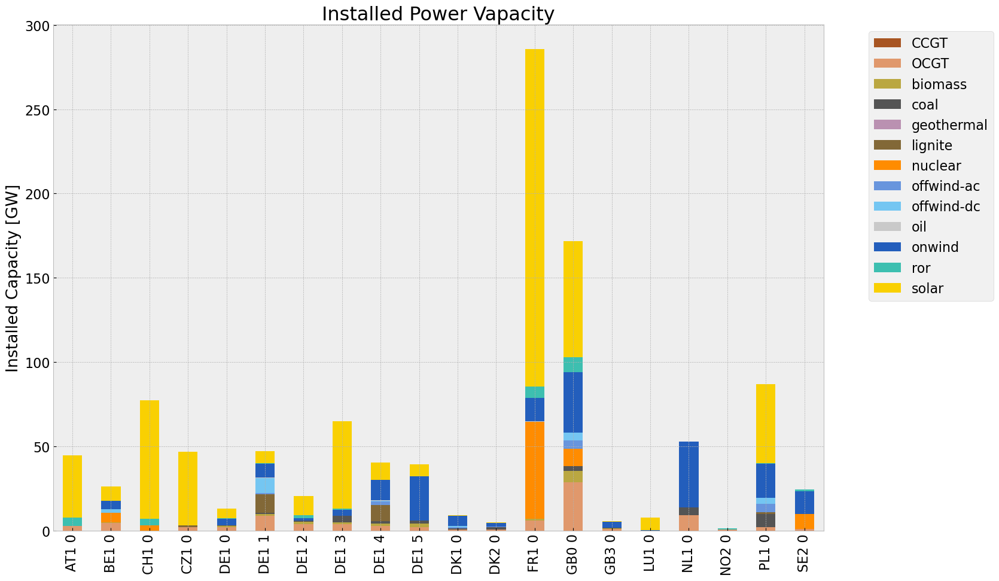

<Figure size 640x480 with 0 Axes>

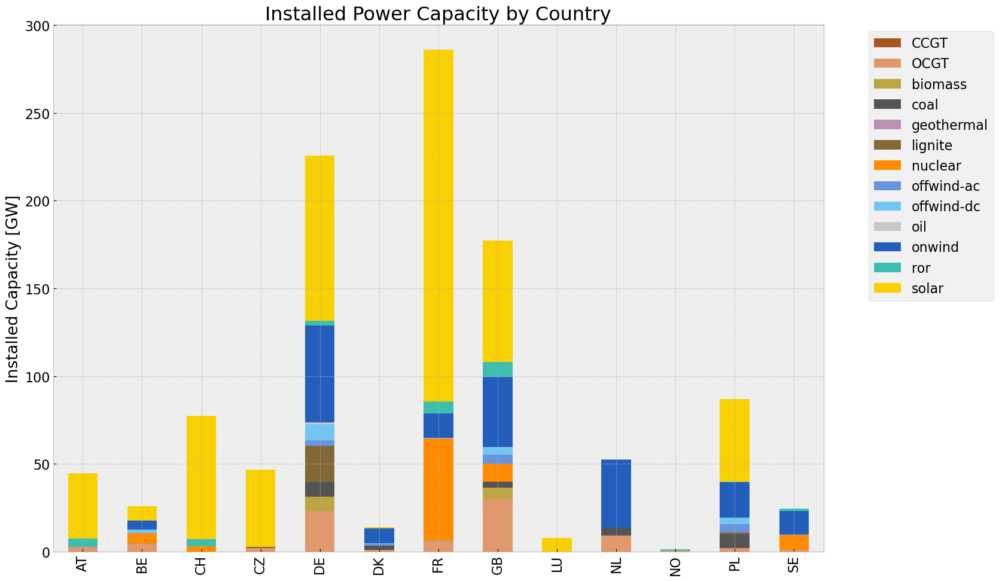

<Figure size 640x480 with 0 Axes>

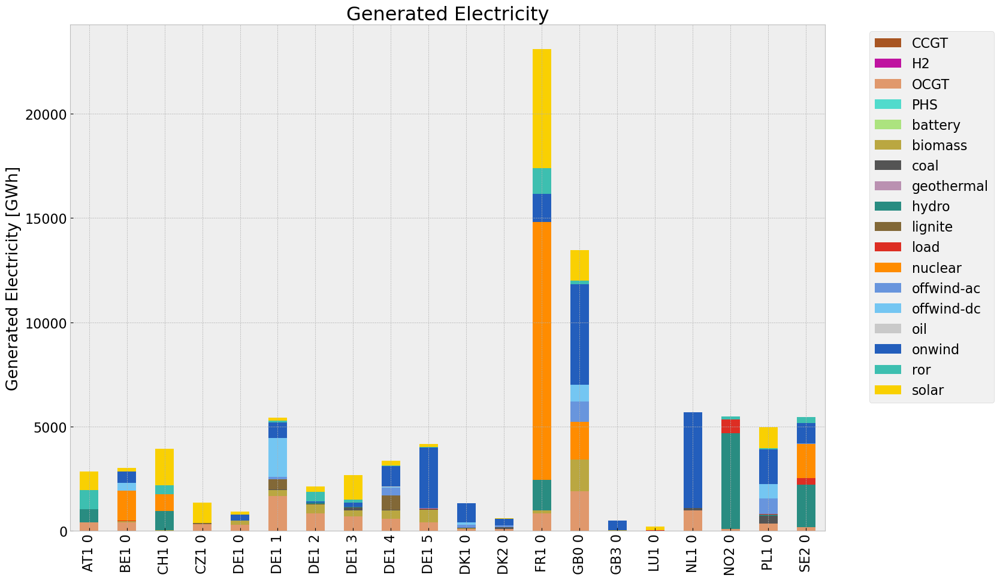

<Figure size 640x480 with 0 Axes>

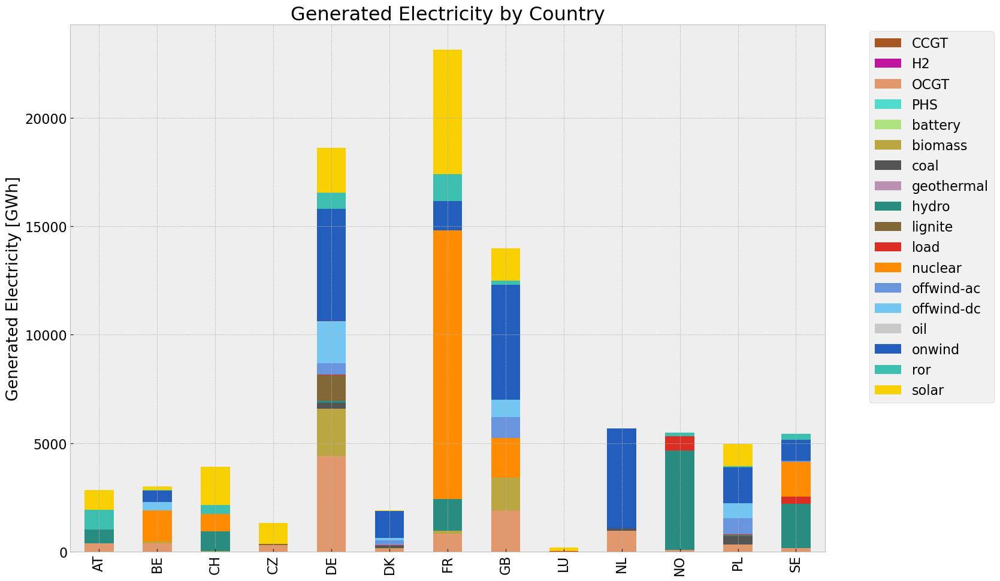

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='24H')
c:\Users\Jeremy

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,9.931859e+06,0.451621,0.1980,4.354334e+06
biomass,3.981177e+06,0.468000,0.0000,0.000000e+00
coal,8.685338e+05,0.329908,0.3361,8.848351e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,1.258163e+06,0.337285,0.4069,1.517846e+06
load,1.120650e+06,1.000000,0.0000,0.000000e+00
nuclear,1.801936e+07,0.326600,0.0000,0.000000e+00
offwind-ac,2.485563e+06,1.000000,0.0000,0.000000e+00


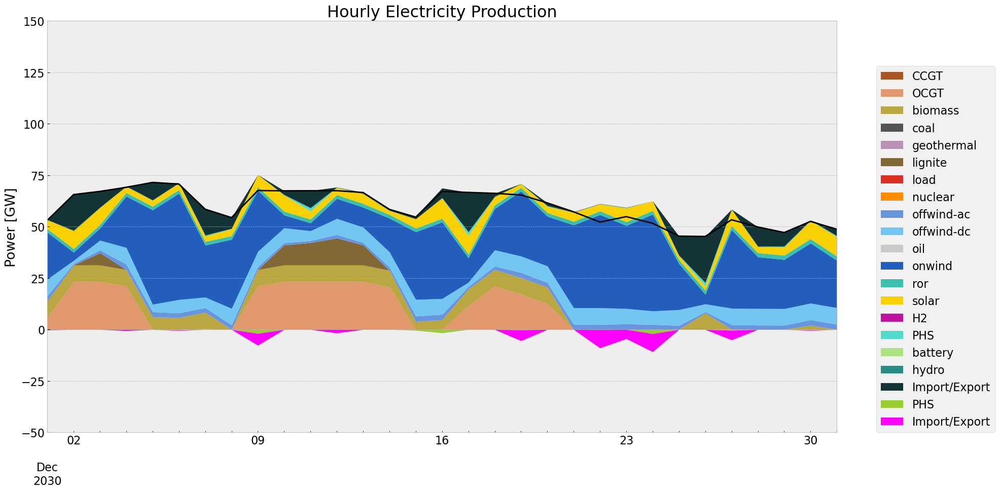

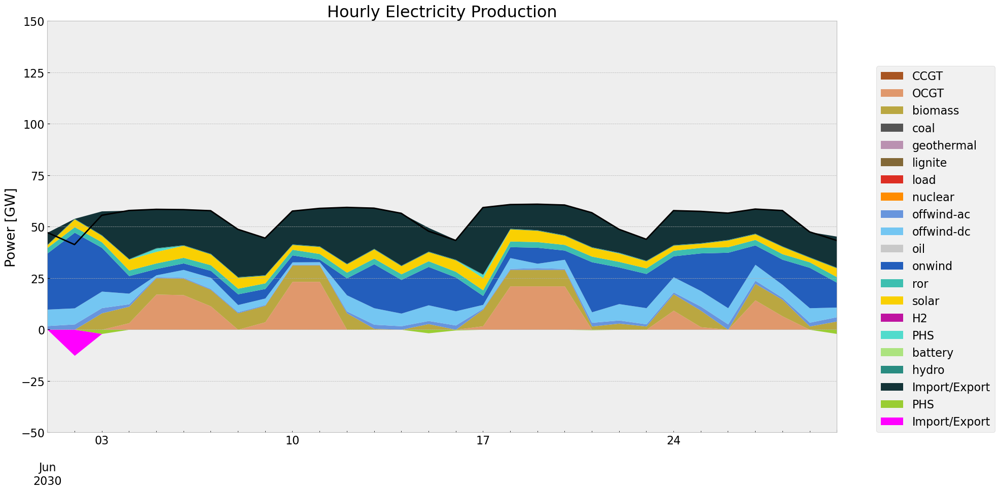

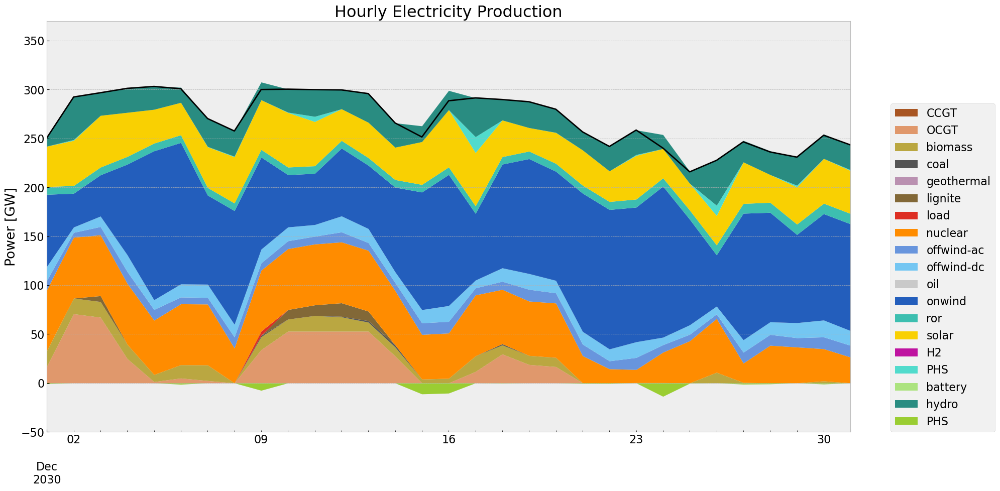

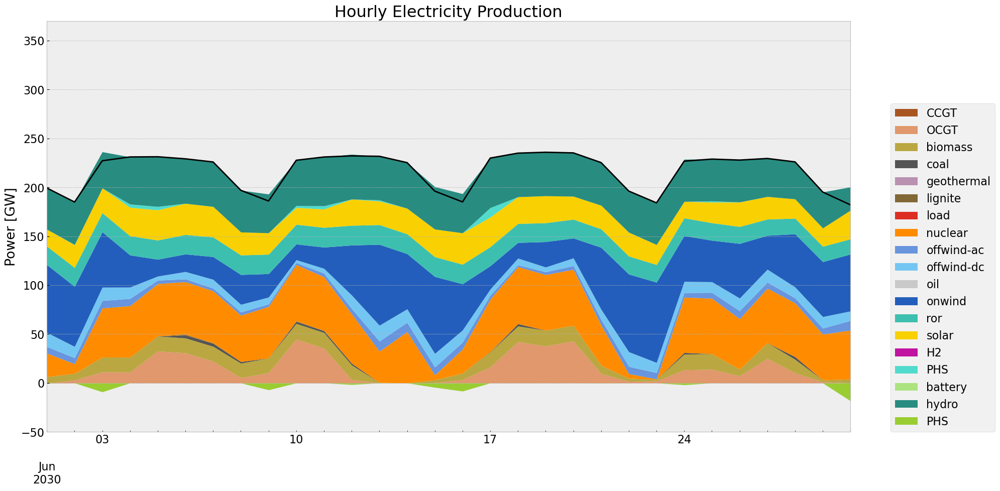

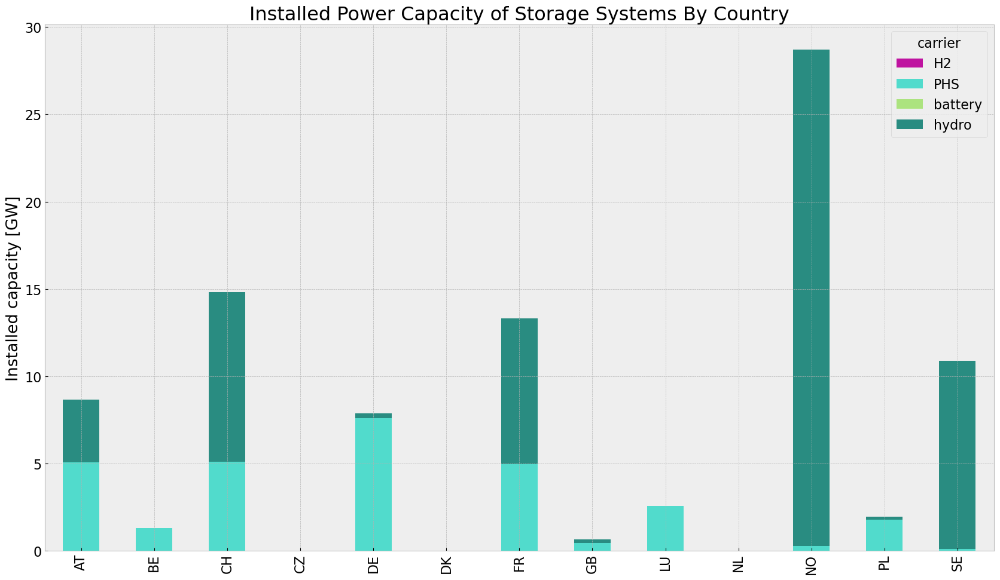

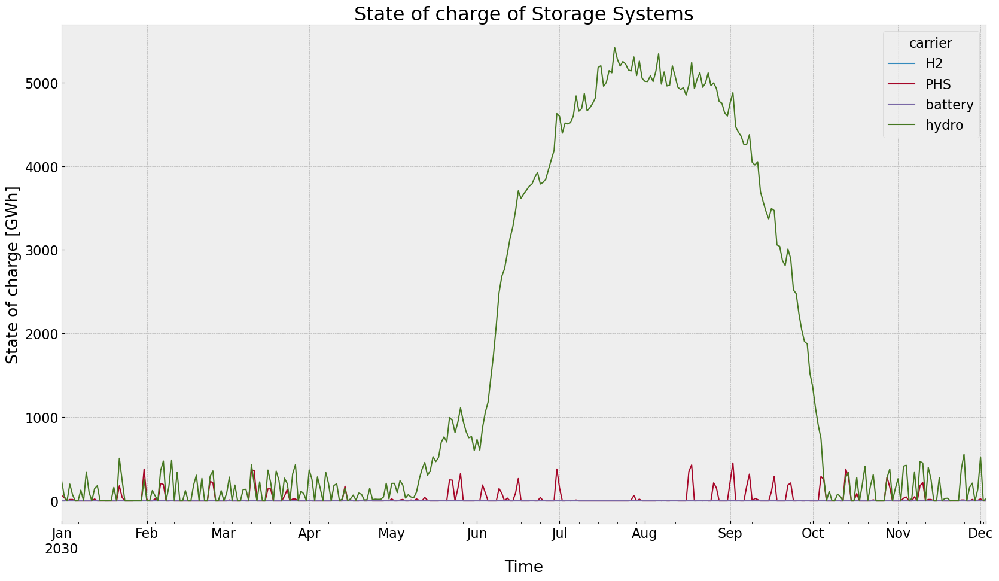

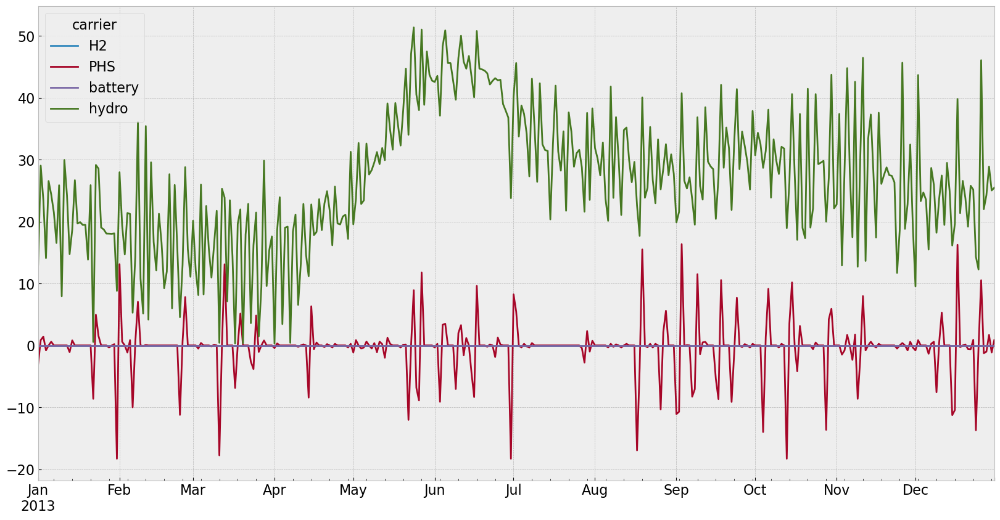

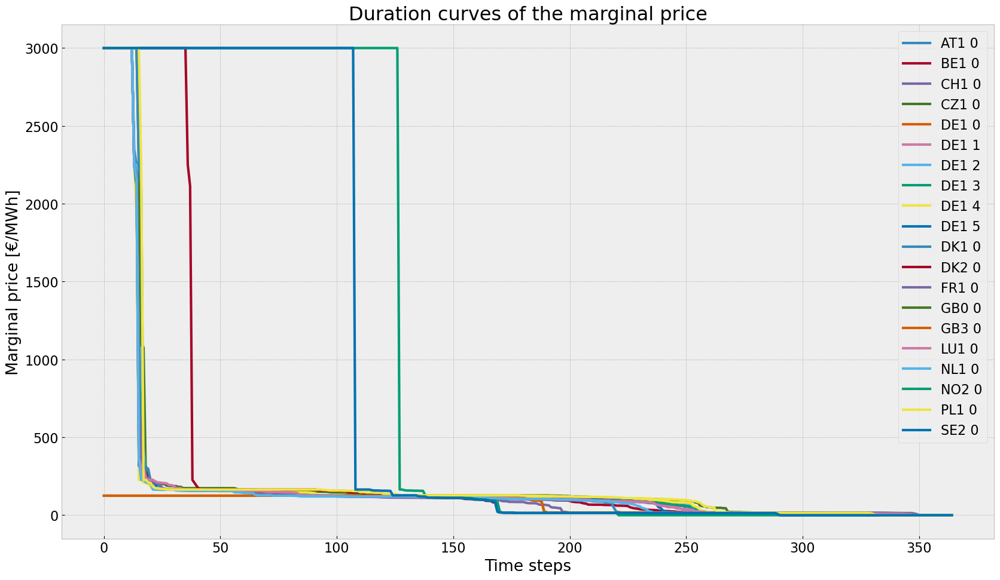

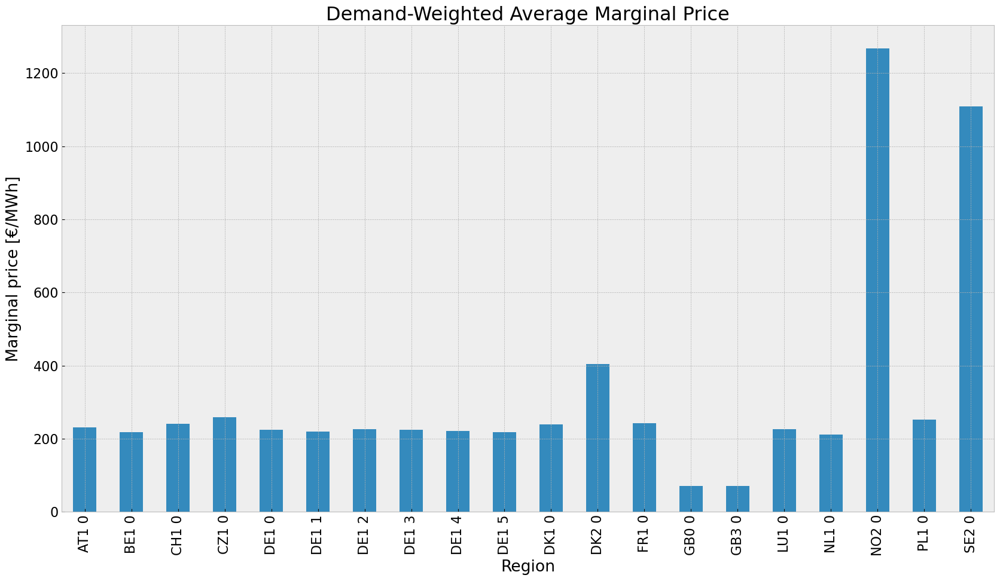

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


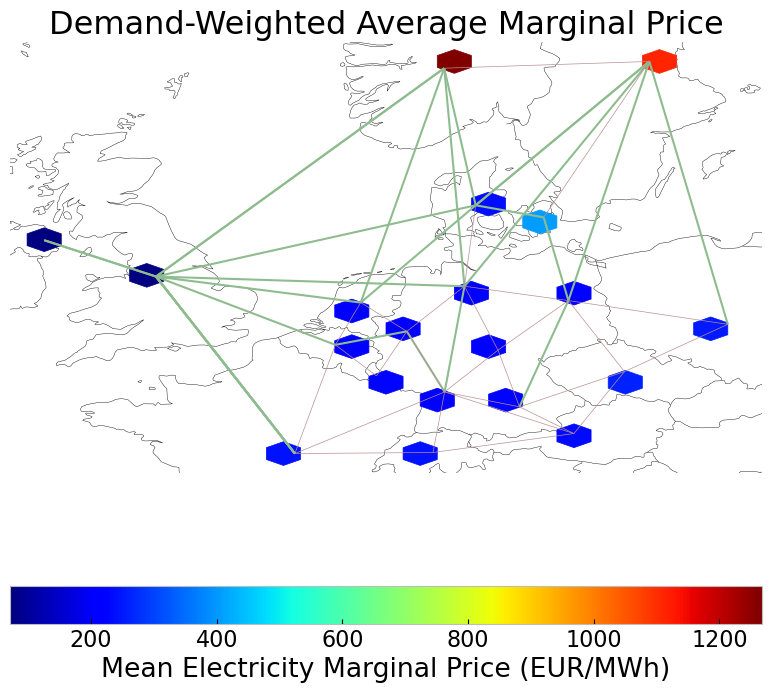

In [608]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-03 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='24H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [609]:
n4 = n1.copy()

horizon = 3

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False


optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}_24h'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmwj3tei.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmwj3tei.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7fd9483c


INFO:gurobipy:Model fingerprint: 0x7fd9483c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2343927e+04   4.155637e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2343927e+04   4.155637e+05   0.000000e+00      0s


     214    1.9645991e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.9645991e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.964599072e+07


INFO:gurobipy:Optimal objective  1.964599072e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.96e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y8fdnaq4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y8fdnaq4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb19e1491


INFO:gurobipy:Model fingerprint: 0xb19e1491


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 834 columns


INFO:gurobipy:Presolve removed 3186 rows and 834 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 729 columns, 1181 nonzeros


INFO:gurobipy:Presolved: 168 rows, 729 columns, 1181 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1116628e+04   4.101061e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1116628e+04   4.101061e+05   0.000000e+00      0s


     225    7.5498556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    7.5498556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.549855638e+07


INFO:gurobipy:Optimal objective  7.549855638e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmayuoep.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmayuoep.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x093789e0


INFO:gurobipy:Model fingerprint: 0x093789e0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1169 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1169 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1012514e+07   4.002923e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1012514e+07   4.002923e+05   0.000000e+00      0s


     225    7.9453026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    7.9453026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.945302613e+08


INFO:gurobipy:Optimal objective  7.945302613e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-og_mrcy4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-og_mrcy4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xac354972


INFO:gurobipy:Model fingerprint: 0xac354972


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 829 columns


INFO:gurobipy:Presolve removed 3186 rows and 829 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.5813634e+06   4.098182e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.5813634e+06   4.098182e+05   0.000000e+00      0s


     262    7.3274188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    7.3274188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.327418791e+08


INFO:gurobipy:Optimal objective  7.327418791e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ac1nsrhf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ac1nsrhf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x54e1e97a


INFO:gurobipy:Model fingerprint: 0x54e1e97a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 831 columns


INFO:gurobipy:Presolve removed 3186 rows and 831 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8325668e+07   4.073532e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8325668e+07   4.073532e+05   0.000000e+00      0s


     239    1.1113621e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.1113621e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.111362064e+09


INFO:gurobipy:Optimal objective  1.111362064e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgyjvojx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgyjvojx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0ebc0a85


INFO:gurobipy:Model fingerprint: 0x0ebc0a85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 831 columns


INFO:gurobipy:Presolve removed 3186 rows and 831 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0456350e+06   3.980422e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0456350e+06   3.980422e+05   0.000000e+00      0s


     234    3.1487197e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    3.1487197e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.148719732e+09


INFO:gurobipy:Optimal objective  3.148719732e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9vwu5vet.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9vwu5vet.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x573e0ec0


INFO:gurobipy:Model fingerprint: 0x573e0ec0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 831 columns


INFO:gurobipy:Presolve removed 3186 rows and 831 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2846654e+04   4.112388e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2846654e+04   4.112388e+05   0.000000e+00      0s


     255    2.6035897e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    2.6035897e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.603589724e+08


INFO:gurobipy:Optimal objective  2.603589724e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1jdzip1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1jdzip1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x37c6de9f


INFO:gurobipy:Model fingerprint: 0x37c6de9f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 725 columns, 1177 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1177 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4829844e+07   4.032525e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4829844e+07   4.032525e+05   0.000000e+00      0s


     256    2.4341263e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.4341263e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.434126297e+09


INFO:gurobipy:Optimal objective  2.434126297e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m266_jcn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m266_jcn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x97dc43d5


INFO:gurobipy:Model fingerprint: 0x97dc43d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 836 columns


INFO:gurobipy:Presolve removed 3186 rows and 836 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 727 columns, 1179 nonzeros


INFO:gurobipy:Presolved: 168 rows, 727 columns, 1179 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9245060e+04   3.967693e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9245060e+04   3.967693e+05   0.000000e+00      0s


     204    3.9752932e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    3.9752932e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.975293194e+08


INFO:gurobipy:Optimal objective  3.975293194e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4zh8i1od.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4zh8i1od.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd860db16


INFO:gurobipy:Model fingerprint: 0xd860db16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2637004e+04   4.064525e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2637004e+04   4.064525e+05   0.000000e+00      0s


     224    2.5440593e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    2.5440593e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.544059301e+07


INFO:gurobipy:Optimal objective  2.544059301e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ze70imgk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ze70imgk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3db036ac


INFO:gurobipy:Model fingerprint: 0x3db036ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 841 columns


INFO:gurobipy:Presolve removed 3188 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 722 columns, 1170 nonzeros


INFO:gurobipy:Presolved: 166 rows, 722 columns, 1170 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7436856e+04   4.024592e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7436856e+04   4.024592e+05   0.000000e+00      0s


     206    1.0340025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    1.0340025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.034002530e+08


INFO:gurobipy:Optimal objective  1.034002530e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q8j2n7de.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q8j2n7de.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x45626e72


INFO:gurobipy:Model fingerprint: 0x45626e72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 842 columns


INFO:gurobipy:Presolve removed 3192 rows and 842 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 721 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 162 rows, 721 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9055815e+03   4.125127e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9055815e+03   4.125127e+05   0.000000e+00      0s


     217    4.0617675e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    4.0617675e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.061767524e+07


INFO:gurobipy:Optimal objective  4.061767524e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npcuipon.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npcuipon.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc45ff465


INFO:gurobipy:Model fingerprint: 0xc45ff465


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 838 columns


INFO:gurobipy:Presolve removed 3192 rows and 838 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 725 columns, 1167 nonzeros


INFO:gurobipy:Presolved: 162 rows, 725 columns, 1167 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3539076e+07   4.040172e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3539076e+07   4.040172e+05   0.000000e+00      0s


     256    1.0119810e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    1.0119810e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.011980996e+09


INFO:gurobipy:Optimal objective  1.011980996e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dpw61799.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dpw61799.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x814165b5


INFO:gurobipy:Model fingerprint: 0x814165b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1292623e+07   4.031460e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1292623e+07   4.031460e+05   0.000000e+00      0s


     220    1.2466062e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.2466062e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.246606231e+09


INFO:gurobipy:Optimal objective  1.246606231e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-loaqh6mj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-loaqh6mj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdcb2defc


INFO:gurobipy:Model fingerprint: 0xdcb2defc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7814913e+07   4.027973e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7814913e+07   4.027973e+05   0.000000e+00      0s


     230    2.9235025e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.9235025e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.923502492e+09


INFO:gurobipy:Optimal objective  2.923502492e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pwtqskm1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pwtqskm1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x35da3bf6


INFO:gurobipy:Model fingerprint: 0x35da3bf6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1169 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1169 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7493875e+07   4.050891e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7493875e+07   4.050891e+05   0.000000e+00      0s


     193    2.0499508e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    2.0499508e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.049950840e+09


INFO:gurobipy:Optimal objective  2.049950840e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57zqw_ku.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57zqw_ku.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xae3b5ff7


INFO:gurobipy:Model fingerprint: 0xae3b5ff7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 826 columns


INFO:gurobipy:Presolve removed 3186 rows and 826 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 737 columns, 1189 nonzeros


INFO:gurobipy:Presolved: 168 rows, 737 columns, 1189 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.5808551e+06   3.925764e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.5808551e+06   3.925764e+05   0.000000e+00      0s


     240    9.3222422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    9.3222422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.322242204e+08


INFO:gurobipy:Optimal objective  9.322242204e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-704zln96.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-704zln96.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x528c33ab


INFO:gurobipy:Model fingerprint: 0x528c33ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 830 columns


INFO:gurobipy:Presolve removed 3186 rows and 830 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 733 columns, 1185 nonzeros


INFO:gurobipy:Presolved: 168 rows, 733 columns, 1185 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1820121e+07   4.102574e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1820121e+07   4.102574e+05   0.000000e+00      0s


     208    7.7084745e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    7.7084745e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.708474505e+08


INFO:gurobipy:Optimal objective  7.708474505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k7a6bnxj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k7a6bnxj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xffd659d3


INFO:gurobipy:Model fingerprint: 0xffd659d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4355519e+07   4.128342e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4355519e+07   4.128342e+05   0.000000e+00      0s


     216    7.3808535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    7.3808535e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.380853471e+08


INFO:gurobipy:Optimal objective  7.380853471e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6zm_iqyb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6zm_iqyb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5c243753


INFO:gurobipy:Model fingerprint: 0x5c243753


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 829 columns


INFO:gurobipy:Presolve removed 3186 rows and 829 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4346906e+07   4.087508e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4346906e+07   4.087508e+05   0.000000e+00      0s


     195    2.7603990e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    2.7603990e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.760399039e+09


INFO:gurobipy:Optimal objective  2.760399039e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.76e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ok3z_wf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ok3z_wf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6bceadd5


INFO:gurobipy:Model fingerprint: 0x6bceadd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 827 columns


INFO:gurobipy:Presolve removed 3186 rows and 827 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 736 columns, 1188 nonzeros


INFO:gurobipy:Presolved: 168 rows, 736 columns, 1188 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4346478e+07   4.085181e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4346478e+07   4.085181e+05   0.000000e+00      0s


     258    6.6097788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    6.6097788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.609778796e+08


INFO:gurobipy:Optimal objective  6.609778796e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-stk1333p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-stk1333p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe11e2c38


INFO:gurobipy:Model fingerprint: 0xe11e2c38


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 826 columns


INFO:gurobipy:Presolve removed 3186 rows and 826 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 737 columns, 1189 nonzeros


INFO:gurobipy:Presolved: 168 rows, 737 columns, 1189 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0367484e+06   4.011162e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0367484e+06   4.011162e+05   0.000000e+00      0s


     200    6.1700494e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    6.1700494e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.170049423e+08


INFO:gurobipy:Optimal objective  6.170049423e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j348t2dw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j348t2dw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf8bbe8f7


INFO:gurobipy:Model fingerprint: 0xf8bbe8f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 829 columns


INFO:gurobipy:Presolve removed 3186 rows and 829 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.4031897e+03   4.007942e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.4031897e+03   4.007942e+05   0.000000e+00      0s


     250    4.5485020e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    4.5485020e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.548502027e+07


INFO:gurobipy:Optimal objective  4.548502027e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bbcxnftm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bbcxnftm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbd48c31b


INFO:gurobipy:Model fingerprint: 0xbd48c31b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3192 rows and 843 columns


INFO:gurobipy:Presolve removed 3192 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 720 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 162 rows, 720 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0056994e+07   3.907309e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0056994e+07   3.907309e+05   0.000000e+00      0s


     201    9.1188335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    9.1188335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.118833529e+08


INFO:gurobipy:Optimal objective  9.118833529e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idt9yat5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idt9yat5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x74d59ea8


INFO:gurobipy:Model fingerprint: 0x74d59ea8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 831 columns


INFO:gurobipy:Presolve removed 3186 rows and 831 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0477112e+06   4.038328e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0477112e+06   4.038328e+05   0.000000e+00      0s


     217    1.0873137e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    1.0873137e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.087313737e+09


INFO:gurobipy:Optimal objective  1.087313737e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_kdbozqj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_kdbozqj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc44cf735


INFO:gurobipy:Model fingerprint: 0xc44cf735


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 832 columns


INFO:gurobipy:Presolve removed 3186 rows and 832 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 731 columns, 1183 nonzeros


INFO:gurobipy:Presolved: 168 rows, 731 columns, 1183 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5027734e+06   4.084156e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5027734e+06   4.084156e+05   0.000000e+00      0s


     243    2.4122725e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    2.4122725e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.412272503e+08


INFO:gurobipy:Optimal objective  2.412272503e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9dhx4j_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9dhx4j_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb1069c6e


INFO:gurobipy:Model fingerprint: 0xb1069c6e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 833 columns


INFO:gurobipy:Presolve removed 3186 rows and 833 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 730 columns, 1182 nonzeros


INFO:gurobipy:Presolved: 168 rows, 730 columns, 1182 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8078400e+06   3.920956e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8078400e+06   3.920956e+05   0.000000e+00      0s


     230    6.6545181e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    6.6545181e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.654518069e+08


INFO:gurobipy:Optimal objective  6.654518069e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ggh7zag.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ggh7zag.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x18467912


INFO:gurobipy:Model fingerprint: 0x18467912


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 723 columns, 1175 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1175 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3803818e+04   4.145043e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3803818e+04   4.145043e+05   0.000000e+00      0s


     258    4.3843767e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    4.3843767e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.384376748e+07


INFO:gurobipy:Optimal objective  4.384376748e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.38e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uzqarycs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uzqarycs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98c6cefa


INFO:gurobipy:Model fingerprint: 0x98c6cefa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 830 columns


INFO:gurobipy:Presolve removed 3186 rows and 830 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 733 columns, 1185 nonzeros


INFO:gurobipy:Presolved: 168 rows, 733 columns, 1185 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7383856e+06   4.024251e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7383856e+06   4.024251e+05   0.000000e+00      0s


     205    5.0145927e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    5.0145927e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.014592739e+08


INFO:gurobipy:Optimal objective  5.014592739e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-moz5nqgk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-moz5nqgk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9169123a


INFO:gurobipy:Model fingerprint: 0x9169123a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 825 columns


INFO:gurobipy:Presolve removed 3186 rows and 825 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2663730e+06   4.113556e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2663730e+06   4.113556e+05   0.000000e+00      0s


     216    8.0871991e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    8.0871991e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.087199052e+08


INFO:gurobipy:Optimal objective  8.087199052e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lxst3hz0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lxst3hz0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd97443bf


INFO:gurobipy:Model fingerprint: 0xd97443bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 828 columns


INFO:gurobipy:Presolve removed 3186 rows and 828 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 735 columns, 1187 nonzeros


INFO:gurobipy:Presolved: 168 rows, 735 columns, 1187 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5067917e+06   4.022059e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5067917e+06   4.022059e+05   0.000000e+00      0s


     256    5.0951467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    5.0951467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.095146741e+08


INFO:gurobipy:Optimal objective  5.095146741e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ueqfsx6s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ueqfsx6s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeefc9382


INFO:gurobipy:Model fingerprint: 0xeefc9382


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 838 columns


INFO:gurobipy:Presolve removed 3189 rows and 838 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 725 columns, 1172 nonzeros


INFO:gurobipy:Presolved: 165 rows, 725 columns, 1172 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0432811e+06   3.976662e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0432811e+06   3.976662e+05   0.000000e+00      0s


     291    7.2863696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    7.2863696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.02 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.02 seconds (0.01 work units)


Optimal objective  7.286369570e+08


INFO:gurobipy:Optimal objective  7.286369570e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r2endekc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r2endekc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0dc24595


INFO:gurobipy:Model fingerprint: 0x0dc24595


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 833 columns


INFO:gurobipy:Presolve removed 3189 rows and 833 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 730 columns, 1177 nonzeros


INFO:gurobipy:Presolved: 165 rows, 730 columns, 1177 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2637867e+06   4.024172e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2637867e+06   4.024172e+05   0.000000e+00      0s


     186    5.8484412e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    5.8484412e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.848441195e+08


INFO:gurobipy:Optimal objective  5.848441195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ul661l09.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ul661l09.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x32874b27


INFO:gurobipy:Model fingerprint: 0x32874b27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 828 columns


INFO:gurobipy:Presolve removed 3189 rows and 828 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 735 columns, 1182 nonzeros


INFO:gurobipy:Presolved: 165 rows, 735 columns, 1182 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1812914e+07   4.011237e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1812914e+07   4.011237e+05   0.000000e+00      0s


     214    6.8268254e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    6.8268254e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.826825367e+08


INFO:gurobipy:Optimal objective  6.826825367e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89uz6yhz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89uz6yhz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0289488f


INFO:gurobipy:Model fingerprint: 0x0289488f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 834 columns


INFO:gurobipy:Presolve removed 3195 rows and 834 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 729 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 159 rows, 729 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.6914822e+03   3.953545e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.6914822e+03   3.953545e+05   0.000000e+00      0s


     216    4.9406784e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.9406784e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.940678373e+07


INFO:gurobipy:Optimal objective  4.940678373e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jkgmif3l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jkgmif3l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xec6eb213


INFO:gurobipy:Model fingerprint: 0xec6eb213


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3195 rows and 844 columns


INFO:gurobipy:Presolve removed 3195 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 159 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.0257603e+03   3.985932e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.0257603e+03   3.985932e+05   0.000000e+00      0s


     184    4.1692111e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    4.1692111e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.169211072e+07


INFO:gurobipy:Optimal objective  4.169211072e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jkwi97wq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jkwi97wq.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa5612e96


INFO:gurobipy:Model fingerprint: 0xa5612e96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 829 columns


INFO:gurobipy:Presolve removed 3195 rows and 829 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 734 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 159 rows, 734 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2342772e+06   4.086339e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2342772e+06   4.086339e+05   0.000000e+00      0s


     211    1.0839480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    1.0839480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.083948009e+08


INFO:gurobipy:Optimal objective  1.083948009e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nus5g20o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nus5g20o.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2f2497d6


INFO:gurobipy:Model fingerprint: 0x2f2497d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 836 columns


INFO:gurobipy:Presolve removed 3195 rows and 836 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 159 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.6076421e+03   3.965307e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.6076421e+03   3.965307e+05   0.000000e+00      0s


     243    1.1505234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    1.1505234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.150523382e+08


INFO:gurobipy:Optimal objective  1.150523382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gjaa5gm1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gjaa5gm1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x24cc83bd


INFO:gurobipy:Model fingerprint: 0x24cc83bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 838 columns


INFO:gurobipy:Presolve removed 3195 rows and 838 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 159 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 159 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2509942e+06   3.901699e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2509942e+06   3.901699e+05   0.000000e+00      0s


     234    4.3154743e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    4.3154743e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.315474278e+08


INFO:gurobipy:Optimal objective  4.315474278e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94cx_9bt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94cx_9bt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x116fc817


INFO:gurobipy:Model fingerprint: 0x116fc817


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 846 columns


INFO:gurobipy:Presolve removed 3196 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 717 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 158 rows, 717 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2457781e+06   4.002201e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2457781e+06   4.002201e+05   0.000000e+00      0s


     220    1.1191835e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.1191835e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.119183475e+08


INFO:gurobipy:Optimal objective  1.119183475e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yuhecnz4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yuhecnz4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a6ef6e8


INFO:gurobipy:Model fingerprint: 0x6a6ef6e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3198 rows and 837 columns


INFO:gurobipy:Presolve removed 3198 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 726 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 156 rows, 726 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3491180e+04   3.990323e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3491180e+04   3.990323e+05   0.000000e+00      0s


     236    3.2082426e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    3.2082426e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.208242563e+08


INFO:gurobipy:Optimal objective  3.208242563e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tylr6zjt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tylr6zjt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcfb8dde4


INFO:gurobipy:Model fingerprint: 0xcfb8dde4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 841 columns


INFO:gurobipy:Presolve removed 3199 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 722 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 155 rows, 722 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.3388296e+03   4.003187e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.3388296e+03   4.003187e+05   0.000000e+00      0s


     236    1.1743707e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    1.1743707e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.01 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.01 work units)


Optimal objective  1.174370691e+08


INFO:gurobipy:Optimal objective  1.174370691e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1n4nxifd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1n4nxifd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x300354f0


INFO:gurobipy:Model fingerprint: 0x300354f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 848 columns


INFO:gurobipy:Presolve removed 3201 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 715 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 153 rows, 715 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2332817e+06   3.954802e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2332817e+06   3.954802e+05   0.000000e+00      0s


     210    1.4111117e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    1.4111117e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.411111711e+08


INFO:gurobipy:Optimal objective  1.411111711e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gtgh1upi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gtgh1upi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd9adf083


INFO:gurobipy:Model fingerprint: 0xd9adf083


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 843 columns


INFO:gurobipy:Presolve removed 3195 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 159 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.3515080e+03   4.009038e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.3515080e+03   4.009038e+05   0.000000e+00      0s


     271    3.0826444e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     271    3.0826444e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 271 iterations and 0.02 seconds (0.01 work units)


INFO:gurobipy:Solved in 271 iterations and 0.02 seconds (0.01 work units)


Optimal objective  3.082644419e+07


INFO:gurobipy:Optimal objective  3.082644419e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tqsral4r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tqsral4r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf8aa1563


INFO:gurobipy:Model fingerprint: 0xf8aa1563


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3193 rows and 832 columns


INFO:gurobipy:Presolve removed 3193 rows and 832 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 731 columns, 1172 nonzeros


INFO:gurobipy:Presolved: 161 rows, 731 columns, 1172 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3679626e+03   3.896694e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3679626e+03   3.896694e+05   0.000000e+00      0s


     267    4.7245875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    4.7245875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 267 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.724587455e+07


INFO:gurobipy:Optimal objective  4.724587455e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p_028df5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p_028df5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x326ce4b9


INFO:gurobipy:Model fingerprint: 0x326ce4b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 834 columns


INFO:gurobipy:Presolve removed 3192 rows and 834 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 729 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 162 rows, 729 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0264547e+06   3.919123e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0264547e+06   3.919123e+05   0.000000e+00      0s


     231    1.9855742e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    1.9855742e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.985574172e+08


INFO:gurobipy:Optimal objective  1.985574172e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n_h8uxzk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n_h8uxzk.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x582d3dd9


INFO:gurobipy:Model fingerprint: 0x582d3dd9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 831 columns


INFO:gurobipy:Presolve removed 3192 rows and 831 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 732 columns, 1174 nonzeros


INFO:gurobipy:Presolved: 162 rows, 732 columns, 1174 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2509453e+06   4.010088e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2509453e+06   4.010088e+05   0.000000e+00      0s


     217    1.7734866e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    1.7734866e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.773486575e+08


INFO:gurobipy:Optimal objective  1.773486575e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qbpepbk6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qbpepbk6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbf2101b6


INFO:gurobipy:Model fingerprint: 0xbf2101b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 839 columns


INFO:gurobipy:Presolve removed 3192 rows and 839 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 724 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 162 rows, 724 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0079789e+04   3.923459e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0079789e+04   3.923459e+05   0.000000e+00      0s


     216    7.1525002e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    7.1525002e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.152500155e+07


INFO:gurobipy:Optimal objective  7.152500155e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.15e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4la22_3k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4la22_3k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2dcee1a1


INFO:gurobipy:Model fingerprint: 0x2dcee1a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 835 columns


INFO:gurobipy:Presolve removed 3192 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 728 columns, 1170 nonzeros


INFO:gurobipy:Presolved: 162 rows, 728 columns, 1170 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.5724349e+02   3.921008e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.5724349e+02   3.921008e+05   0.000000e+00      0s


     214    3.5163989e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    3.5163989e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.516398900e+07


INFO:gurobipy:Optimal objective  3.516398900e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-akqw0kiv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-akqw0kiv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x68ae1675


INFO:gurobipy:Model fingerprint: 0x68ae1675


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 836 columns


INFO:gurobipy:Presolve removed 3192 rows and 836 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 727 columns, 1169 nonzeros


INFO:gurobipy:Presolved: 162 rows, 727 columns, 1169 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8491106e+04   3.817683e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8491106e+04   3.817683e+05   0.000000e+00      0s


     256    1.4202418e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    1.4202418e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.420241755e+08


INFO:gurobipy:Optimal objective  1.420241755e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rpi9tx_h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rpi9tx_h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xce0a1d00


INFO:gurobipy:Model fingerprint: 0xce0a1d00


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3199 rows and 849 columns


INFO:gurobipy:Presolve removed 3199 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 714 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 155 rows, 714 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1508708e+03   3.987240e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1508708e+03   3.987240e+05   0.000000e+00      0s


     185    1.1332321e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    1.1332321e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.133232052e+07


INFO:gurobipy:Optimal objective  1.133232052e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr2x1_sv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr2x1_sv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x32ae8d72


INFO:gurobipy:Model fingerprint: 0x32ae8d72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3202 rows and 853 columns


INFO:gurobipy:Presolve removed 3202 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 152 rows, 710 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 152 rows, 710 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4762179e+06   3.819671e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4762179e+06   3.819671e+05   0.000000e+00      0s


     194    8.3865159e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    8.3865159e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.386515868e+07


INFO:gurobipy:Optimal objective  8.386515868e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.39e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjxxs0ra.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjxxs0ra.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x501fc8d6


INFO:gurobipy:Model fingerprint: 0x501fc8d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 860 columns


INFO:gurobipy:Presolve removed 3201 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 153 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4766816e+06   3.871314e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4766816e+06   3.871314e+05   0.000000e+00      0s


     198    1.1179441e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    1.1179441e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.117944079e+08


INFO:gurobipy:Optimal objective  1.117944079e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-olpbvcue.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-olpbvcue.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8b3130c9


INFO:gurobipy:Model fingerprint: 0x8b3130c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 845 columns


INFO:gurobipy:Presolve removed 3201 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 718 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 153 rows, 718 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2422169e+06   3.959849e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2422169e+06   3.959849e+05   0.000000e+00      0s


     208    1.8798402e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    1.8798402e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.879840236e+08


INFO:gurobipy:Optimal objective  1.879840236e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-exzj6oce.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-exzj6oce.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x026338a2


INFO:gurobipy:Model fingerprint: 0x026338a2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 845 columns


INFO:gurobipy:Presolve removed 3201 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 718 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 153 rows, 718 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7115883e+03   3.923177e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7115883e+03   3.923177e+05   0.000000e+00      0s


     208    2.3309178e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.3309178e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.330917768e+07


INFO:gurobipy:Optimal objective  2.330917768e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-baf5cswl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-baf5cswl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x350c2a7c


INFO:gurobipy:Model fingerprint: 0x350c2a7c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 850 columns


INFO:gurobipy:Presolve removed 3201 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 713 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 153 rows, 713 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2315849e+06   3.995528e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2315849e+06   3.995528e+05   0.000000e+00      0s


     212    3.0296007e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.0296007e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.029600650e+07


INFO:gurobipy:Optimal objective  3.029600650e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57nzna0n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57nzna0n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6e3ebda7


INFO:gurobipy:Model fingerprint: 0x6e3ebda7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 844 columns


INFO:gurobipy:Presolve removed 3201 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 719 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 153 rows, 719 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7152606e+06   3.881745e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7152606e+06   3.881745e+05   0.000000e+00      0s


     202    2.5436044e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    2.5436044e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.543604402e+08


INFO:gurobipy:Optimal objective  2.543604402e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j8mb5q__.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j8mb5q__.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4723c92f


INFO:gurobipy:Model fingerprint: 0x4723c92f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 855 columns


INFO:gurobipy:Presolve removed 3201 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 708 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 153 rows, 708 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2305874e+06   3.923059e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2305874e+06   3.923059e+05   0.000000e+00      0s


     181    7.7887733e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    7.7887733e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.788773303e+06


INFO:gurobipy:Optimal objective  7.788773303e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.79e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u79wv5nv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u79wv5nv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2fc89c13


INFO:gurobipy:Model fingerprint: 0x2fc89c13


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 834 columns


INFO:gurobipy:Presolve removed 3199 rows and 834 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 729 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 155 rows, 729 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4731941e+06   4.106009e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4731941e+06   4.106009e+05   0.000000e+00      0s


     194    6.1815900e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    6.1815900e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.181589992e+07


INFO:gurobipy:Optimal objective  6.181589992e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ddjrbhxj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ddjrbhxj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4cccfcdf


INFO:gurobipy:Model fingerprint: 0x4cccfcdf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 837 columns


INFO:gurobipy:Presolve removed 3198 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 726 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 156 rows, 726 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2308088e+06   4.004196e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2308088e+06   4.004196e+05   0.000000e+00      0s


     211    4.8316026e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    4.8316026e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.831602554e+07


INFO:gurobipy:Optimal objective  4.831602554e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ij5lweow.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ij5lweow.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xabd0e90c


INFO:gurobipy:Model fingerprint: 0xabd0e90c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3198 rows and 830 columns


INFO:gurobipy:Presolve removed 3198 rows and 830 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 733 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 156 rows, 733 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.6424912e+03   4.016592e+05   0.000000e+00      0s


INFO:gurobipy:       0   -9.6424912e+03   4.016592e+05   0.000000e+00      0s


     207    6.0185344e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    6.0185344e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.018534410e+07


INFO:gurobipy:Optimal objective  6.018534410e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k4m76knb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k4m76knb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04d58224


INFO:gurobipy:Model fingerprint: 0x04d58224


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 834 columns


INFO:gurobipy:Presolve removed 3196 rows and 834 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 729 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 158 rows, 729 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5063710e+03   3.911361e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5063710e+03   3.911361e+05   0.000000e+00      0s


     245    2.2642784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    2.2642784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.264278430e+08


INFO:gurobipy:Optimal objective  2.264278430e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yi6qz0ll.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yi6qz0ll.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd78893d6


INFO:gurobipy:Model fingerprint: 0xd78893d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 830 columns


INFO:gurobipy:Presolve removed 3195 rows and 830 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 733 columns, 1170 nonzeros


INFO:gurobipy:Presolved: 159 rows, 733 columns, 1170 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2237970e+06   4.018514e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2237970e+06   4.018514e+05   0.000000e+00      0s


     214    1.1384039e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.1384039e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.138403935e+08


INFO:gurobipy:Optimal objective  1.138403935e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4il9sp7r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4il9sp7r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2c048d96


INFO:gurobipy:Model fingerprint: 0x2c048d96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 835 columns


INFO:gurobipy:Presolve removed 3195 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 159 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7059190e+06   3.940393e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7059190e+06   3.940393e+05   0.000000e+00      0s


     209    1.6596158e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.6596158e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.659615782e+08


INFO:gurobipy:Optimal objective  1.659615782e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eej0u8gv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eej0u8gv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xddcd54b9


INFO:gurobipy:Model fingerprint: 0xddcd54b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 834 columns


INFO:gurobipy:Presolve removed 3195 rows and 834 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 729 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 159 rows, 729 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2253011e+06   3.955267e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2253011e+06   3.955267e+05   0.000000e+00      0s


     192    1.8282187e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    1.8282187e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.828218664e+08


INFO:gurobipy:Optimal objective  1.828218664e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dp3tpmld.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dp3tpmld.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9b2c06b2


INFO:gurobipy:Model fingerprint: 0x9b2c06b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 832 columns


INFO:gurobipy:Presolve removed 3195 rows and 832 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 159 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4782661e+06   3.983822e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4782661e+06   3.983822e+05   0.000000e+00      0s


     211    3.6058867e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    3.6058867e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.605886735e+08


INFO:gurobipy:Optimal objective  3.605886735e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-srsil99m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-srsil99m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x32ab9b4a


INFO:gurobipy:Model fingerprint: 0x32ab9b4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 836 columns


INFO:gurobipy:Presolve removed 3195 rows and 836 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 159 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4742481e+06   3.947412e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4742481e+06   3.947412e+05   0.000000e+00      0s


     214    1.5150501e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.5150501e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.515050078e+08


INFO:gurobipy:Optimal objective  1.515050078e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xakzmdmc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xakzmdmc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa3da3e9c


INFO:gurobipy:Model fingerprint: 0xa3da3e9c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 838 columns


INFO:gurobipy:Presolve removed 3195 rows and 838 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 159 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4730984e+06   3.972758e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4730984e+06   3.972758e+05   0.000000e+00      0s


     205    2.7024102e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    2.7024102e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.702410247e+08


INFO:gurobipy:Optimal objective  2.702410247e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-via2i8uq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-via2i8uq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xda4c38be


INFO:gurobipy:Model fingerprint: 0xda4c38be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 851 columns


INFO:gurobipy:Presolve removed 3195 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 159 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7058719e+06   3.928256e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7058719e+06   3.928256e+05   0.000000e+00      0s


     245    5.9634474e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    5.9634474e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.963447444e+08


INFO:gurobipy:Optimal objective  5.963447444e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lak_rxuv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lak_rxuv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3f8e6dc0


INFO:gurobipy:Model fingerprint: 0x3f8e6dc0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 829 columns


INFO:gurobipy:Presolve removed 3195 rows and 829 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 734 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 159 rows, 734 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2263847e+06   3.998508e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2263847e+06   3.998508e+05   0.000000e+00      0s


     198    1.4828298e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    1.4828298e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.482829759e+08


INFO:gurobipy:Optimal objective  1.482829759e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7btjgyer.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7btjgyer.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5194ef41


INFO:gurobipy:Model fingerprint: 0x5194ef41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 834 columns


INFO:gurobipy:Presolve removed 3195 rows and 834 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 729 columns, 1166 nonzeros


INFO:gurobipy:Presolved: 159 rows, 729 columns, 1166 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.3955737e+03   3.945496e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.3955737e+03   3.945496e+05   0.000000e+00      0s


     232    4.1148120e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    4.1148120e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.114811994e+07


INFO:gurobipy:Optimal objective  4.114811994e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bj3zk1sa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bj3zk1sa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0b07e257


INFO:gurobipy:Model fingerprint: 0x0b07e257


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 844 columns


INFO:gurobipy:Presolve removed 3195 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 159 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.4701986e+04   3.864351e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.4701986e+04   3.864351e+05   0.000000e+00      0s


     248    2.4572977e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    2.4572977e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.457297651e+05


INFO:gurobipy:Optimal objective  2.457297651e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.46e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2hkz__jn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2hkz__jn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb20943e4


INFO:gurobipy:Model fingerprint: 0xb20943e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 835 columns


INFO:gurobipy:Presolve removed 3195 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 159 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.0951068e+03   3.981629e+05   0.000000e+00      0s


INFO:gurobipy:       0   -7.0951068e+03   3.981629e+05   0.000000e+00      0s


     239    2.1065390e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.1065390e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.106538978e+07


INFO:gurobipy:Optimal objective  2.106538978e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y6aj900_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y6aj900_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xafc01697


INFO:gurobipy:Model fingerprint: 0xafc01697


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 835 columns


INFO:gurobipy:Presolve removed 3195 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 159 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.0696813e+03   3.893965e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.0696813e+03   3.893965e+05   0.000000e+00      0s


     184    2.6691661e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    2.6691661e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.669166098e+07


INFO:gurobipy:Optimal objective  2.669166098e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.67e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ufbtbii.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ufbtbii.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x08c99abf


INFO:gurobipy:Model fingerprint: 0x08c99abf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 837 columns


INFO:gurobipy:Presolve removed 3195 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 726 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 159 rows, 726 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.2498269e+04   4.044374e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.2498269e+04   4.044374e+05   0.000000e+00      0s


     184    1.4201065e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    1.4201065e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.420106482e+06


INFO:gurobipy:Optimal objective  1.420106482e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.42e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rr86jpaa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rr86jpaa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf80a7f98


INFO:gurobipy:Model fingerprint: 0xf80a7f98


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 847 columns


INFO:gurobipy:Presolve removed 3195 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 159 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.3933142e+03   3.891859e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.3933142e+03   3.891859e+05   0.000000e+00      0s


     193    1.6686701e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    1.6686701e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.668670141e+06


INFO:gurobipy:Optimal objective  1.668670141e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.67e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryxhbjvi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryxhbjvi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2b6ebb68


INFO:gurobipy:Model fingerprint: 0x2b6ebb68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 843 columns


INFO:gurobipy:Presolve removed 3195 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 159 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1338040e+04   3.945040e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1338040e+04   3.945040e+05   0.000000e+00      0s


     211    7.9858314e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    7.9858314e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.985831442e+06


INFO:gurobipy:Optimal objective  7.985831442e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.99e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2zuf291o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2zuf291o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9303ba3a


INFO:gurobipy:Model fingerprint: 0x9303ba3a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 841 columns


INFO:gurobipy:Presolve removed 3195 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 159 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.2841909e+03   3.957544e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.2841909e+03   3.957544e+05   0.000000e+00      0s


     247    5.6678544e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    5.6678544e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.667854366e+07


INFO:gurobipy:Optimal objective  5.667854366e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.67e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eh3alz4a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eh3alz4a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xafb7b16b


INFO:gurobipy:Model fingerprint: 0xafb7b16b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3193 rows and 832 columns


INFO:gurobipy:Presolve removed 3193 rows and 832 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 731 columns, 1172 nonzeros


INFO:gurobipy:Presolved: 161 rows, 731 columns, 1172 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.7228271e+03   4.042400e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.7228271e+03   4.042400e+05   0.000000e+00      0s


     202    1.0863686e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    1.0863686e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.086368625e+07


INFO:gurobipy:Optimal objective  1.086368625e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4epbkwu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4epbkwu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x32179f00


INFO:gurobipy:Model fingerprint: 0x32179f00


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3191 rows and 831 columns


INFO:gurobipy:Presolve removed 3191 rows and 831 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 732 columns, 1176 nonzeros


INFO:gurobipy:Presolved: 163 rows, 732 columns, 1176 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1236291e+04   3.852184e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1236291e+04   3.852184e+05   0.000000e+00      0s


     225    8.1870623e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    8.1870623e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.187062312e+07


INFO:gurobipy:Optimal objective  8.187062312e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rkmg_zt3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rkmg_zt3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7f287b00


INFO:gurobipy:Model fingerprint: 0x7f287b00


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 828 columns


INFO:gurobipy:Presolve removed 3186 rows and 828 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 735 columns, 1187 nonzeros


INFO:gurobipy:Presolved: 168 rows, 735 columns, 1187 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6042167e+04   3.892560e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6042167e+04   3.892560e+05   0.000000e+00      0s


     226    2.9561106e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    2.9561106e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.956110630e+07


INFO:gurobipy:Optimal objective  2.956110630e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.96e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uiv2om6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uiv2om6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5207c540


INFO:gurobipy:Model fingerprint: 0x5207c540


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1171 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1171 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.6731045e+03   4.035280e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.6731045e+03   4.035280e+05   0.000000e+00      0s


     223    1.0114458e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.0114458e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.011445850e+06


INFO:gurobipy:Optimal objective  1.011445850e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5sub2u4d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5sub2u4d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x36e7835a


INFO:gurobipy:Model fingerprint: 0x36e7835a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3186 rows and 825 columns


INFO:gurobipy:Presolve removed 3186 rows and 825 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.2577423e+02   3.931267e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.2577423e+02   3.931267e+05   0.000000e+00      0s


     215    2.7059431e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    2.7059431e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.705943072e+07


INFO:gurobipy:Optimal objective  2.705943072e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.71e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mtz26bvj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mtz26bvj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa0495ee3


INFO:gurobipy:Model fingerprint: 0xa0495ee3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 821 columns


INFO:gurobipy:Presolve removed 3186 rows and 821 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 742 columns, 1194 nonzeros


INFO:gurobipy:Presolved: 168 rows, 742 columns, 1194 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.9401202e+03   3.989696e+05   0.000000e+00      0s


INFO:gurobipy:       0   -6.9401202e+03   3.989696e+05   0.000000e+00      0s


     246    4.5180607e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    4.5180607e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.518060739e+07


INFO:gurobipy:Optimal objective  4.518060739e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3za0iri.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3za0iri.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04edf2fe


INFO:gurobipy:Model fingerprint: 0x04edf2fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 824 columns


INFO:gurobipy:Presolve removed 3186 rows and 824 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 739 columns, 1191 nonzeros


INFO:gurobipy:Presolved: 168 rows, 739 columns, 1191 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.8523175e+03   3.938212e+05   0.000000e+00      0s


INFO:gurobipy:       0   -3.8523175e+03   3.938212e+05   0.000000e+00      0s


     209    1.9464335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.9464335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.946433460e+08


INFO:gurobipy:Optimal objective  1.946433460e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nt6pocj_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nt6pocj_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0e1f5b6e


INFO:gurobipy:Model fingerprint: 0x0e1f5b6e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2302281e+06   3.978805e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2302281e+06   3.978805e+05   0.000000e+00      0s


     205    1.1120811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    1.1120811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.112081062e+08


INFO:gurobipy:Optimal objective  1.112081062e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zpin8imd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zpin8imd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa9a32193


INFO:gurobipy:Model fingerprint: 0xa9a32193


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 826 columns


INFO:gurobipy:Presolve removed 3186 rows and 826 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 737 columns, 1189 nonzeros


INFO:gurobipy:Presolved: 168 rows, 737 columns, 1189 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -8.4072415e+03   3.996578e+05   0.000000e+00      0s


INFO:gurobipy:       0   -8.4072415e+03   3.996578e+05   0.000000e+00      0s


     239    2.5525825e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.5525825e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.552582480e+07


INFO:gurobipy:Optimal objective  2.552582480e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kl6cw_fz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kl6cw_fz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x82c188be


INFO:gurobipy:Model fingerprint: 0x82c188be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 825 columns


INFO:gurobipy:Presolve removed 3186 rows and 825 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.8944635e+03   3.852418e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.8944635e+03   3.852418e+05   0.000000e+00      0s


     212    5.1225054e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    5.1225054e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.122505370e+07


INFO:gurobipy:Optimal objective  5.122505370e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9jvf3idg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9jvf3idg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d15a2bf


INFO:gurobipy:Model fingerprint: 0x1d15a2bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1169 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1169 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4653209e+06   3.988178e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4653209e+06   3.988178e+05   0.000000e+00      0s


     190    2.6663510e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    2.6663510e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.666351009e+07


INFO:gurobipy:Optimal objective  2.666351009e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.67e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05bv4cqa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05bv4cqa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x508de4c8


INFO:gurobipy:Model fingerprint: 0x508de4c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 825 columns


INFO:gurobipy:Presolve removed 3186 rows and 825 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2350754e+06   3.954245e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2350754e+06   3.954245e+05   0.000000e+00      0s


     227    2.2832437e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.2832437e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.283243698e+08


INFO:gurobipy:Optimal objective  2.283243698e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbxeuc5k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbxeuc5k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8702096b


INFO:gurobipy:Model fingerprint: 0x8702096b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 825 columns


INFO:gurobipy:Presolve removed 3186 rows and 825 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3544725e+04   4.078789e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.3544725e+04   4.078789e+05   0.000000e+00      0s


     212    1.4740626e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    1.4740626e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.474062612e+07


INFO:gurobipy:Optimal objective  1.474062612e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.47e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nrux3hl0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nrux3hl0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x24bbc8cd


INFO:gurobipy:Model fingerprint: 0x24bbc8cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 825 columns


INFO:gurobipy:Presolve removed 3186 rows and 825 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3285702e+04   4.026512e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.3285702e+04   4.026512e+05   0.000000e+00      0s


     227    7.3275024e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    7.3275024e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.327502371e+06


INFO:gurobipy:Optimal objective  7.327502371e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.33e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vmnuv0pd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vmnuv0pd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x255c1bda


INFO:gurobipy:Model fingerprint: 0x255c1bda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 830 columns


INFO:gurobipy:Presolve removed 3187 rows and 830 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 733 columns, 1183 nonzeros


INFO:gurobipy:Presolved: 167 rows, 733 columns, 1183 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.7760628e+03   4.032684e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.7760628e+03   4.032684e+05   0.000000e+00      0s


     242    3.9762876e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    3.9762876e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.976287608e+07


INFO:gurobipy:Optimal objective  3.976287608e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cuvszx88.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cuvszx88.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x22e72463


INFO:gurobipy:Model fingerprint: 0x22e72463


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 819 columns


INFO:gurobipy:Presolve removed 3186 rows and 819 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 744 columns, 1196 nonzeros


INFO:gurobipy:Presolved: 168 rows, 744 columns, 1196 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1355231e+04   3.868732e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1355231e+04   3.868732e+05   0.000000e+00      0s


     247    1.0767100e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.0767100e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.076709988e+08


INFO:gurobipy:Optimal objective  1.076709988e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2c7446d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2c7446d.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x521b276e


INFO:gurobipy:Model fingerprint: 0x521b276e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 818 columns


INFO:gurobipy:Presolve removed 3186 rows and 818 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 745 columns, 1197 nonzeros


INFO:gurobipy:Presolved: 168 rows, 745 columns, 1197 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.0608707e+04   3.943995e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.0608707e+04   3.943995e+05   0.000000e+00      0s


     225    6.5207614e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    6.5207614e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.520761356e+07


INFO:gurobipy:Optimal objective  6.520761356e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9x2vtd9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9x2vtd9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0a77a061


INFO:gurobipy:Model fingerprint: 0x0a77a061


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 825 columns


INFO:gurobipy:Presolve removed 3186 rows and 825 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2424384e+06   4.005428e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2424384e+06   4.005428e+05   0.000000e+00      0s


     221    7.9199657e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    7.9199657e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.919965724e+07


INFO:gurobipy:Optimal objective  7.919965724e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cowcnsw2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cowcnsw2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaddba0f1


INFO:gurobipy:Model fingerprint: 0xaddba0f1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 825 columns


INFO:gurobipy:Presolve removed 3186 rows and 825 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:Presolved: 168 rows, 738 columns, 1190 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0575688e+03   3.865346e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0575688e+03   3.865346e+05   0.000000e+00      0s


     219    1.4948539e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    1.4948539e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.494853906e+08


INFO:gurobipy:Optimal objective  1.494853906e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rw0guaq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rw0guaq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0e8b1c6f


INFO:gurobipy:Model fingerprint: 0x0e8b1c6f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 818 columns


INFO:gurobipy:Presolve removed 3186 rows and 818 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 745 columns, 1197 nonzeros


INFO:gurobipy:Presolved: 168 rows, 745 columns, 1197 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.4384252e+03   4.092936e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.4384252e+03   4.092936e+05   0.000000e+00      0s


     270    9.3247109e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     270    9.3247109e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 270 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 270 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.324710904e+06


INFO:gurobipy:Optimal objective  9.324710904e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.32e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pvudki8y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pvudki8y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1dfb8f1c


INFO:gurobipy:Model fingerprint: 0x1dfb8f1c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 828 columns


INFO:gurobipy:Presolve removed 3186 rows and 828 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 735 columns, 1187 nonzeros


INFO:gurobipy:Presolved: 168 rows, 735 columns, 1187 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.6930117e+03   3.912777e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.6930117e+03   3.912777e+05   0.000000e+00      0s


     262    8.4753141e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4753141e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.475314051e+06


INFO:gurobipy:Optimal objective  8.475314051e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4lpcdrzn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4lpcdrzn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3e5a013f


INFO:gurobipy:Model fingerprint: 0x3e5a013f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1169 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1169 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1610067e+04   3.897054e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.1610067e+04   3.897054e+05   0.000000e+00      0s


     209    6.8182115e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    6.8182115e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.818211503e+06


INFO:gurobipy:Optimal objective  6.818211503e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-evq1831d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-evq1831d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x93e4e014


INFO:gurobipy:Model fingerprint: 0x93e4e014


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -7.3161955e+03   3.965854e+05   0.000000e+00      0s


INFO:gurobipy:       0   -7.3161955e+03   3.965854e+05   0.000000e+00      0s


     229    2.3528488e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    2.3528488e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.352848784e+06


INFO:gurobipy:Optimal objective  2.352848784e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.35e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-37vvcsxk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-37vvcsxk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaf965485


INFO:gurobipy:Model fingerprint: 0xaf965485


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 819 columns


INFO:gurobipy:Presolve removed 3186 rows and 819 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 744 columns, 1196 nonzeros


INFO:gurobipy:Presolved: 168 rows, 744 columns, 1196 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.6993235e+04   3.950156e+05   0.000000e+00      0s


INFO:gurobipy:       0   -1.6993235e+04   3.950156e+05   0.000000e+00      0s


     263    1.2042970e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    1.2042970e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.204296977e+07


INFO:gurobipy:Optimal objective  1.204296977e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8_zz1yea.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8_zz1yea.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1484eb48


INFO:gurobipy:Model fingerprint: 0x1484eb48


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9442388e+04   3.859654e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9442388e+04   3.859654e+05   0.000000e+00      0s


     216    1.6839574e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.6839574e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.683957420e+07


INFO:gurobipy:Optimal objective  1.683957420e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.68e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m1s1bidc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m1s1bidc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7409afe3


INFO:gurobipy:Model fingerprint: 0x7409afe3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 824 columns


INFO:gurobipy:Presolve removed 3186 rows and 824 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 739 columns, 1191 nonzeros


INFO:gurobipy:Presolved: 168 rows, 739 columns, 1191 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1710920e+04   3.935055e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1710920e+04   3.935055e+05   0.000000e+00      0s


     258    7.3513156e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    7.3513156e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.351315625e+07


INFO:gurobipy:Optimal objective  7.351315625e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pkyj1kv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pkyj1kv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0e7441f3


INFO:gurobipy:Model fingerprint: 0x0e7441f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 813 columns


INFO:gurobipy:Presolve removed 3186 rows and 813 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 750 columns, 1202 nonzeros


INFO:gurobipy:Presolved: 168 rows, 750 columns, 1202 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.8782415e+03   3.932580e+05   0.000000e+00      0s


INFO:gurobipy:       0   -5.8782415e+03   3.932580e+05   0.000000e+00      0s


     273    3.3045870e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     273    3.3045870e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 273 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 273 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.304586980e+07


INFO:gurobipy:Optimal objective  3.304586980e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tmsyuqc1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tmsyuqc1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xadd39537


INFO:gurobipy:Model fingerprint: 0xadd39537


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 827 columns


INFO:gurobipy:Presolve removed 3186 rows and 827 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 736 columns, 1188 nonzeros


INFO:gurobipy:Presolved: 168 rows, 736 columns, 1188 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1184987e+04   3.930727e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1184987e+04   3.930727e+05   0.000000e+00      0s


     242    7.9924816e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    7.9924816e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.992481645e+07


INFO:gurobipy:Optimal objective  7.992481645e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.99e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hylijhf7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hylijhf7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6976e905


INFO:gurobipy:Model fingerprint: 0x6976e905


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 828 columns


INFO:gurobipy:Presolve removed 3186 rows and 828 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 735 columns, 1187 nonzeros


INFO:gurobipy:Presolved: 168 rows, 735 columns, 1187 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2635580e+06   3.993455e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2635580e+06   3.993455e+05   0.000000e+00      0s


     211    3.8827687e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    3.8827687e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.882768673e+08


INFO:gurobipy:Optimal objective  3.882768673e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7jnscsdf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7jnscsdf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1bed382d


INFO:gurobipy:Model fingerprint: 0x1bed382d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 829 columns


INFO:gurobipy:Presolve removed 3186 rows and 829 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2585781e+06   3.998639e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2585781e+06   3.998639e+05   0.000000e+00      0s


     223    5.8796295e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    5.8796295e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.879629531e+08


INFO:gurobipy:Optimal objective  5.879629531e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6dfg70km.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6dfg70km.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0b54b2b9


INFO:gurobipy:Model fingerprint: 0x0b54b2b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 836 columns


INFO:gurobipy:Presolve removed 3186 rows and 836 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 727 columns, 1179 nonzeros


INFO:gurobipy:Presolved: 168 rows, 727 columns, 1179 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5175571e+06   4.032951e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5175571e+06   4.032951e+05   0.000000e+00      0s


     217    6.8263893e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.8263893e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.826389288e+08


INFO:gurobipy:Optimal objective  6.826389288e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sbnoozqg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sbnoozqg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfcc1e92b


INFO:gurobipy:Model fingerprint: 0xfcc1e92b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 829 columns


INFO:gurobipy:Presolve removed 3186 rows and 829 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:Presolved: 168 rows, 734 columns, 1186 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0576879e+06   3.994000e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0576879e+06   3.994000e+05   0.000000e+00      0s


     239    4.2721124e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    4.2721124e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.272112417e+08


INFO:gurobipy:Optimal objective  4.272112417e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aagz284t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aagz284t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf7369acf


INFO:gurobipy:Model fingerprint: 0xf7369acf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8087027e+06   3.859299e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8087027e+06   3.859299e+05   0.000000e+00      0s


     204    1.6880317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    1.6880317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.688031696e+08


INFO:gurobipy:Optimal objective  1.688031696e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ws12fh3f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ws12fh3f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf81b04ba


INFO:gurobipy:Model fingerprint: 0xf81b04ba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 827 columns


INFO:gurobipy:Presolve removed 3186 rows and 827 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 736 columns, 1188 nonzeros


INFO:gurobipy:Presolved: 168 rows, 736 columns, 1188 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0457027e+06   4.060249e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0457027e+06   4.060249e+05   0.000000e+00      0s


     221    2.3508234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    2.3508234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.350823384e+08


INFO:gurobipy:Optimal objective  2.350823384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4omzd8eo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4omzd8eo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xac96abfe


INFO:gurobipy:Model fingerprint: 0xac96abfe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 723 columns, 1175 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1175 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2685467e+06   3.967234e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2685467e+06   3.967234e+05   0.000000e+00      0s


     183    2.2266126e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     183    2.2266126e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 183 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 183 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.226612573e+08


INFO:gurobipy:Optimal objective  2.226612573e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n45malr3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n45malr3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7ce88da3


INFO:gurobipy:Model fingerprint: 0x7ce88da3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1172 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1172 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0812721e+04   4.010798e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0812721e+04   4.010798e+05   0.000000e+00      0s


     212    3.4314663e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.4314663e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.431466295e+07


INFO:gurobipy:Optimal objective  3.431466295e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.43e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cg_izun1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cg_izun1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xffc4f3f7


INFO:gurobipy:Model fingerprint: 0xffc4f3f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 725 columns, 1177 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1177 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1618699e+04   3.899374e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1618699e+04   3.899374e+05   0.000000e+00      0s


     266    3.1644188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     266    3.1644188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 266 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 266 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.164418790e+08


INFO:gurobipy:Optimal objective  3.164418790e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5qustjz1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5qustjz1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc043923


INFO:gurobipy:Model fingerprint: 0xcc043923


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1178 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1424491e+04   4.070003e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1424491e+04   4.070003e+05   0.000000e+00      0s


     239    2.8226410e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.8226410e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.822640972e+08


INFO:gurobipy:Optimal objective  2.822640972e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5b8euvqa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5b8euvqa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x881a86d6


INFO:gurobipy:Model fingerprint: 0x881a86d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 831 columns


INFO:gurobipy:Presolve removed 3186 rows and 831 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:Presolved: 168 rows, 732 columns, 1184 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4152256e+04   4.060031e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4152256e+04   4.060031e+05   0.000000e+00      0s


     206    3.5875642e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    3.5875642e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.587564180e+07


INFO:gurobipy:Optimal objective  3.587564180e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.59e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m73y9kne.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m73y9kne.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd9ca75c1


INFO:gurobipy:Model fingerprint: 0xd9ca75c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2574229e+04   3.911110e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2574229e+04   3.911110e+05   0.000000e+00      0s


     219    5.0035085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    5.0035085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.003508548e+07


INFO:gurobipy:Optimal objective  5.003508548e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5rju0r_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5rju0r_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x870da363


INFO:gurobipy:Model fingerprint: 0x870da363


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5962649e+04   4.008353e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5962649e+04   4.008353e+05   0.000000e+00      0s


     238    1.1052141e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    1.1052141e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.105214085e+07


INFO:gurobipy:Optimal objective  1.105214085e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nc56l80s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nc56l80s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcdd006ae


INFO:gurobipy:Model fingerprint: 0xcdd006ae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 721 columns, 1173 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1173 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1187241e+04   4.151079e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1187241e+04   4.151079e+05   0.000000e+00      0s


     195    2.6652039e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    2.6652039e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.665203852e+07


INFO:gurobipy:Optimal objective  2.665203852e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.67e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lex503y_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lex503y_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfc0a32c7


INFO:gurobipy:Model fingerprint: 0xfc0a32c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1180 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5608914e+03   4.001863e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5608914e+03   4.001863e+05   0.000000e+00      0s


     225    1.1331130e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.1331130e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.133113001e+07


INFO:gurobipy:Optimal objective  1.133113001e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rmptqo4o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rmptqo4o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xa3f16c83


INFO:gurobipy:Model fingerprint: 0xa3f16c83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 558 columns


INFO:gurobipy:Presolve removed 2124 rows and 558 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 484 columns, 777 nonzeros


INFO:gurobipy:Presolved: 112 rows, 484 columns, 777 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8753917e+03   2.753272e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8753917e+03   2.753272e+05   0.000000e+00      0s


     136    7.4123682e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     136    7.4123682e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 136 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 136 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.412368206e+06


INFO:gurobipy:Optimal objective  7.412368206e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 7.41e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [610]:
filename = f"{n4.name}_24h.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_pv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


<xarray.Dataset> Size: 2MB
Dimensions:                                          (snapshots: 365,
                                                      investment_periods: 0,
                                                      links_i: 28,
                                                      links_t_p0_i: 18,
                                                      links_t_p1_i: 18,
                                                      generators_i: 261,
                                                      ...
                                                      storage_units_t_p_store_i: 15,
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 6,
                                                      loads_i: 20,
                                                      loads_t_p_set_i: 20,
                                                      loads_t_p_i: 20)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 3kB 0 ...
  * investment_periods                               (investment_periods) int64 0B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p0_i                                     (links_t_p0_i) object 144B ...
  * links_t_p1_i                                     (links_t_p1_i) object 144B ...
  * generators_i                                     (generators_i) object 2kB ...
    ...                                               ...
  * storage_units_t_p_store_i                        (storage_units_t_p_store_i) object 120B ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 48B ...
  * loads_i                                          (loads_i) object 160B 'A...
  * loads_t_p_set_i                                  (loads_t_p_set_i) object 160B ...
  * loads_t_p_i                                      (loads_t_p_i) object 160B ...
Data variables: (12/97)
    snapshots_snapshot                               (snapshots) datetime64[ns] 3kB ...
    snapshots_objective                              (snapshots) float64 3kB ...
    snapshots_generators                             (snapshots) float64 3kB ...
    snapshots_stores                                 (snapshots) float64 3kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    storage_units_t_p_store                          (snapshots, storage_units_t_p_store_i) float64 44kB ...
    storage_units_t_state_of_charge                  (snapshots, storage_units_t_state_of_charge_i) float64 190kB ...
    storage_units_t_spill                            (snapshots, storage_units_t_spill_i) float64 18kB ...
    loads_bus                                        (loads_i) object 160B 'A...
    loads_t_p_set                                    (snapshots, loads_t_p_set_i) float64 58kB ...
    loads_t_p                                        (snapshots, loads_t_p_i) float64 58kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_pv
    network_objective:       7412368.205667283
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [611]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

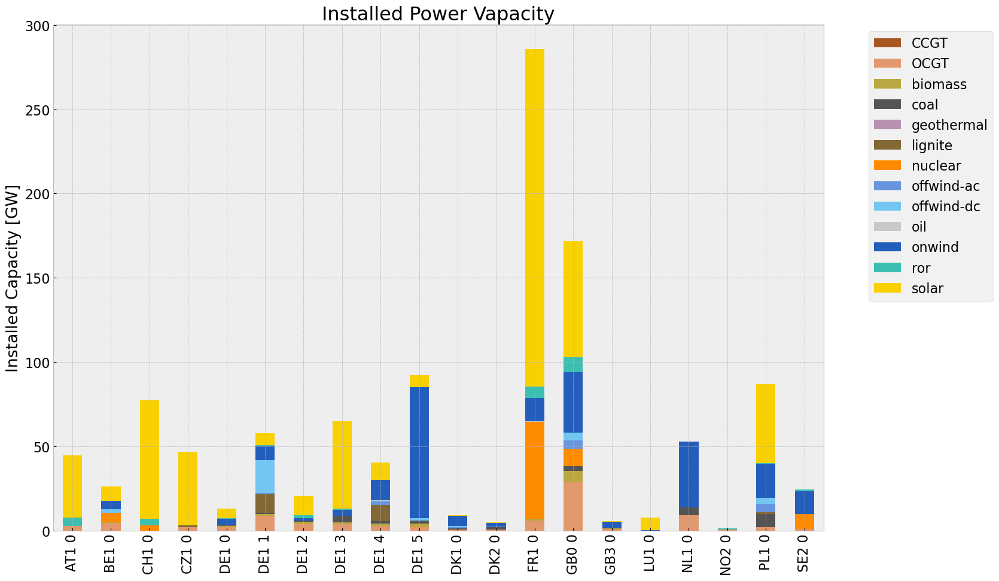

<Figure size 640x480 with 0 Axes>

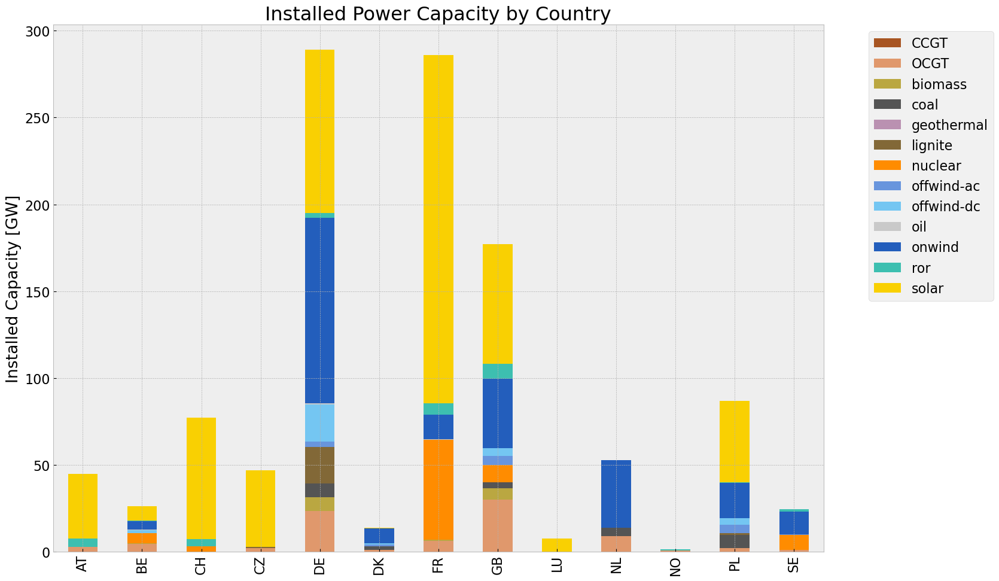

<Figure size 640x480 with 0 Axes>

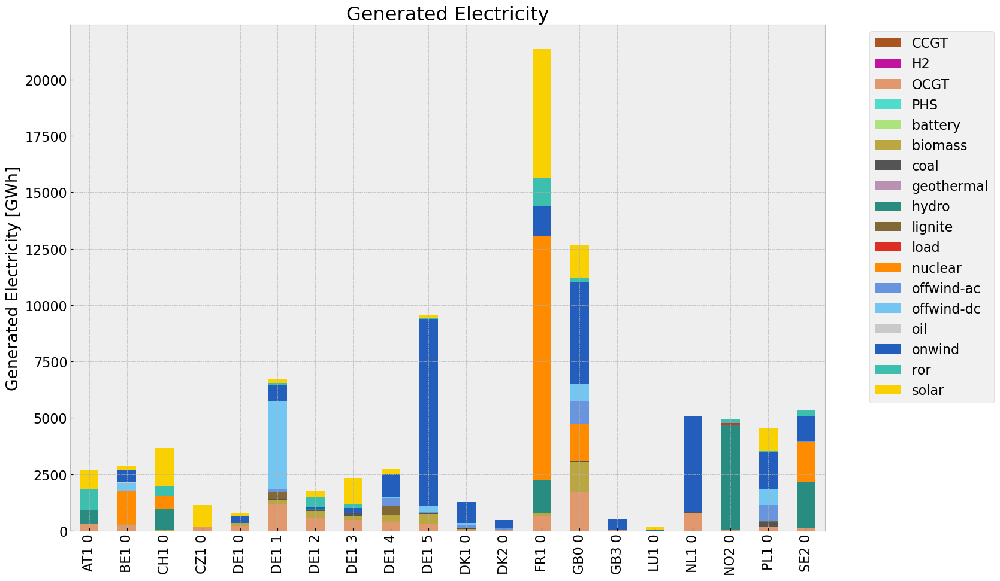

<Figure size 640x480 with 0 Axes>

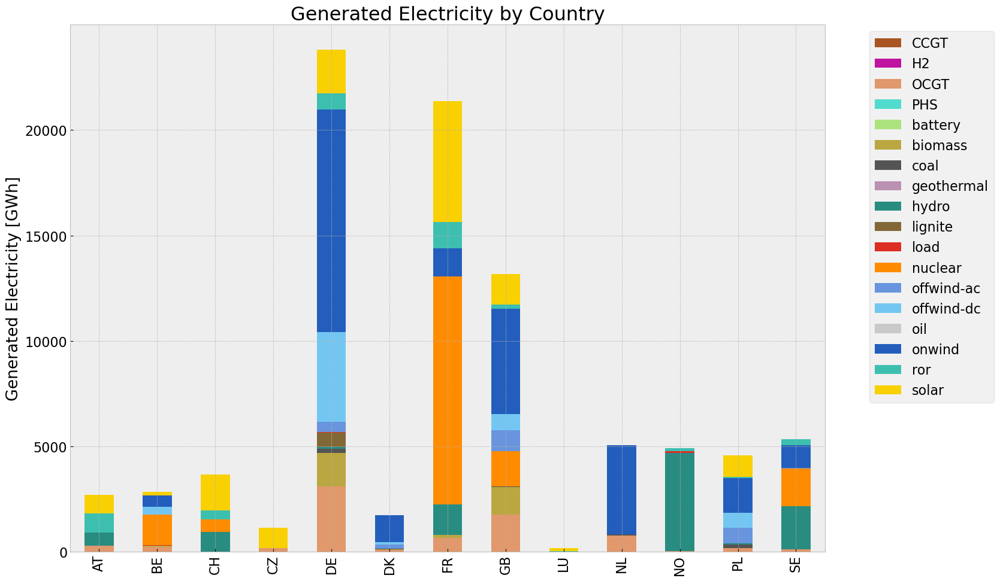

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='24H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\570502833.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='24H')
c:\Users\Jeremy

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.359114e+06,0.451621,0.1980,3.226389e+06
biomass,3.164902e+06,0.468000,0.0000,0.000000e+00
coal,4.944358e+05,0.329908,0.3361,5.037158e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,7.314005e+05,0.337285,0.4069,8.823608e+05
load,1.163385e+05,1.000000,0.0000,0.000000e+00
nuclear,1.627861e+07,0.326600,0.0000,0.000000e+00
offwind-ac,2.467875e+06,1.000000,0.0000,0.000000e+00


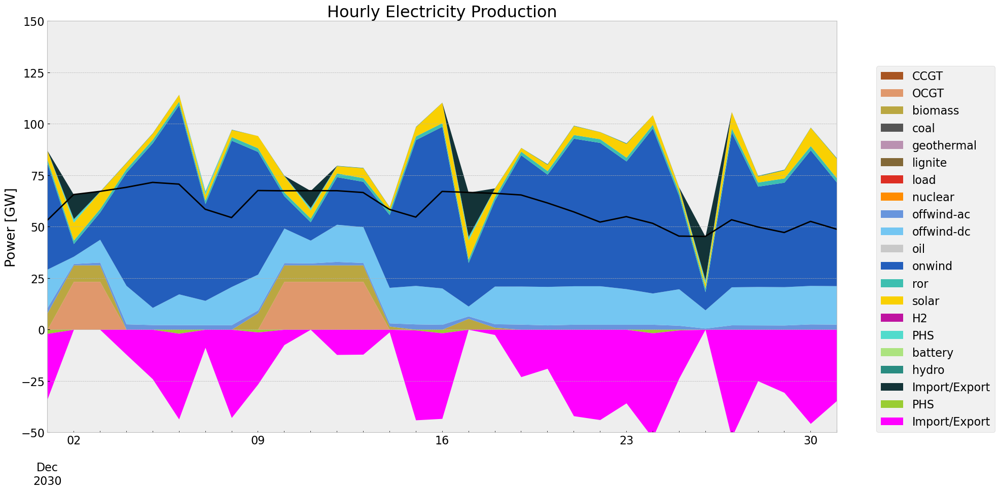

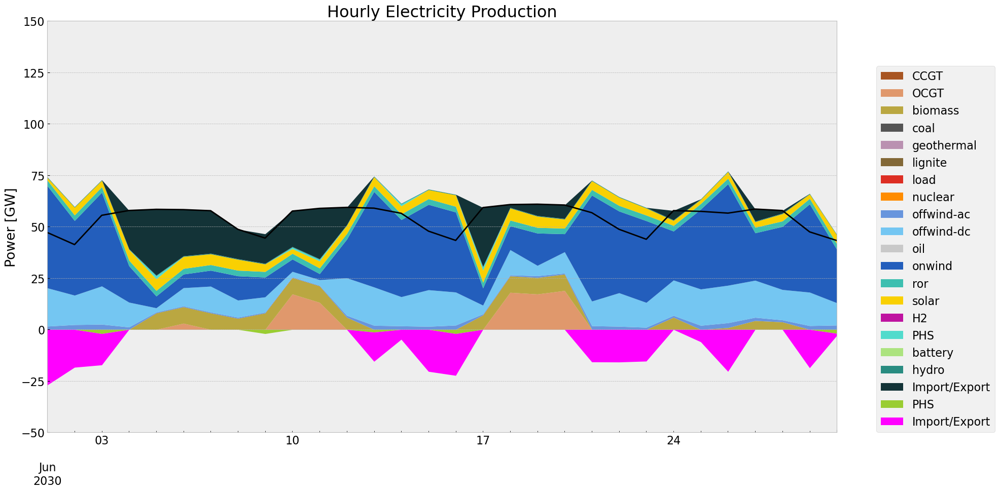

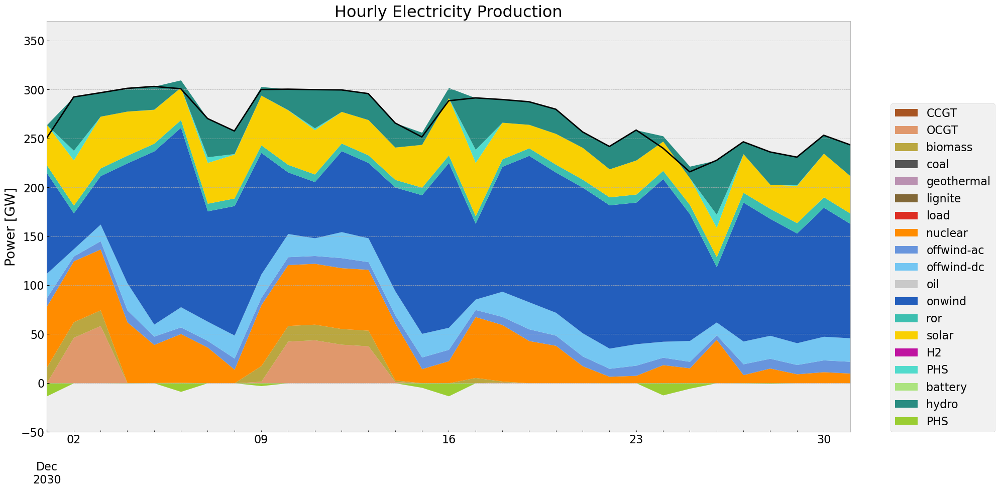

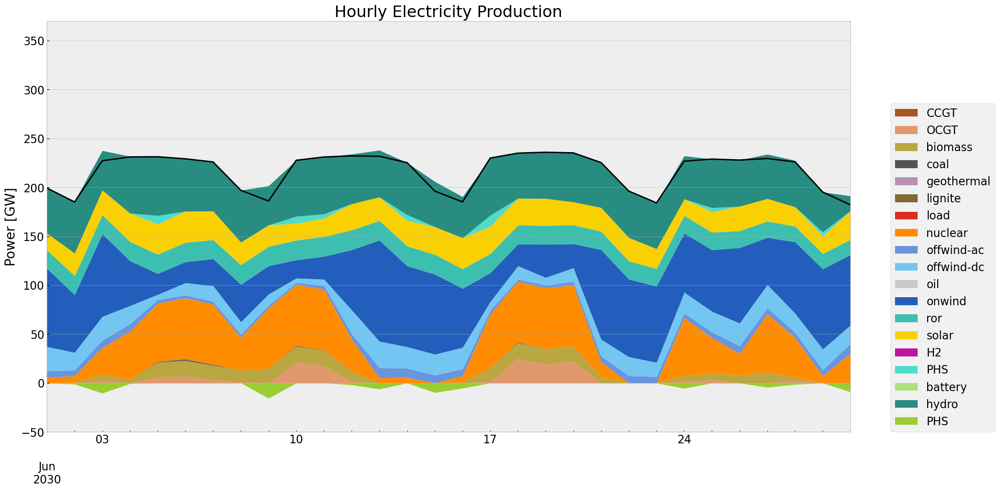

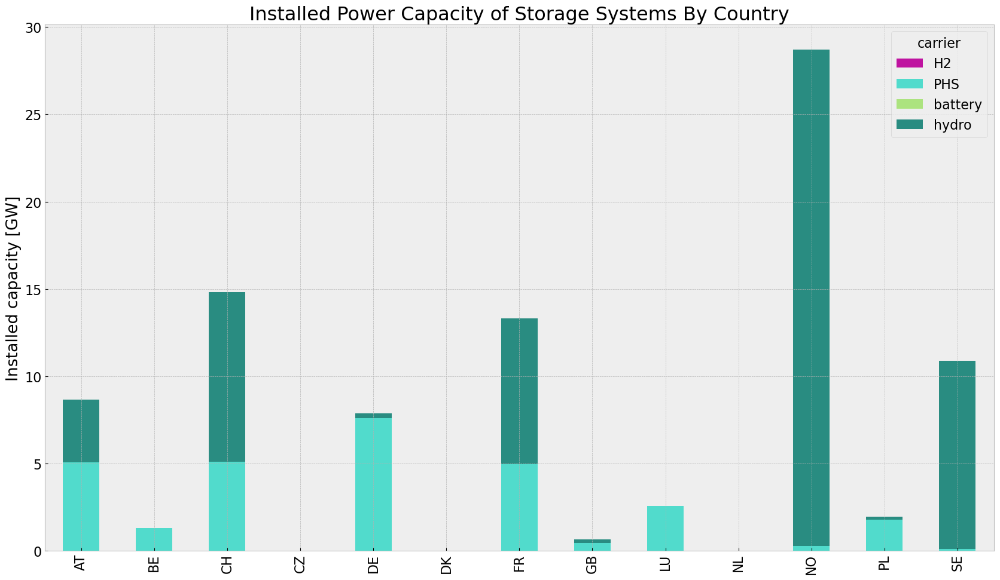

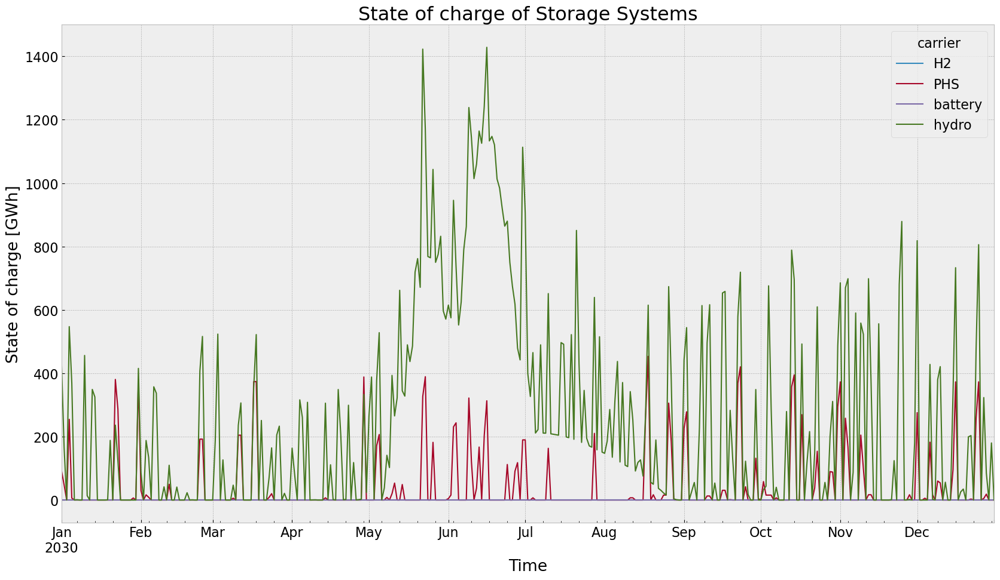

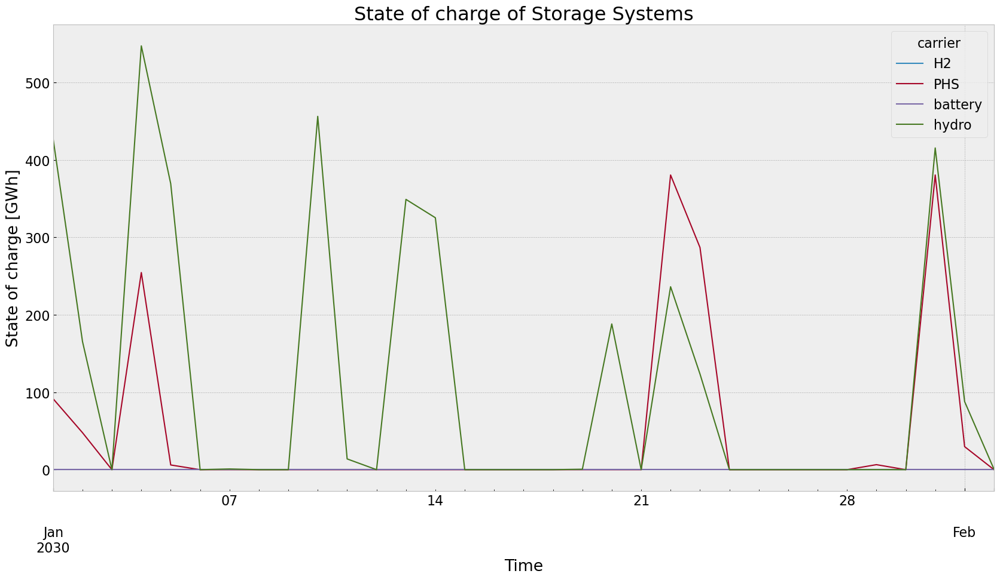

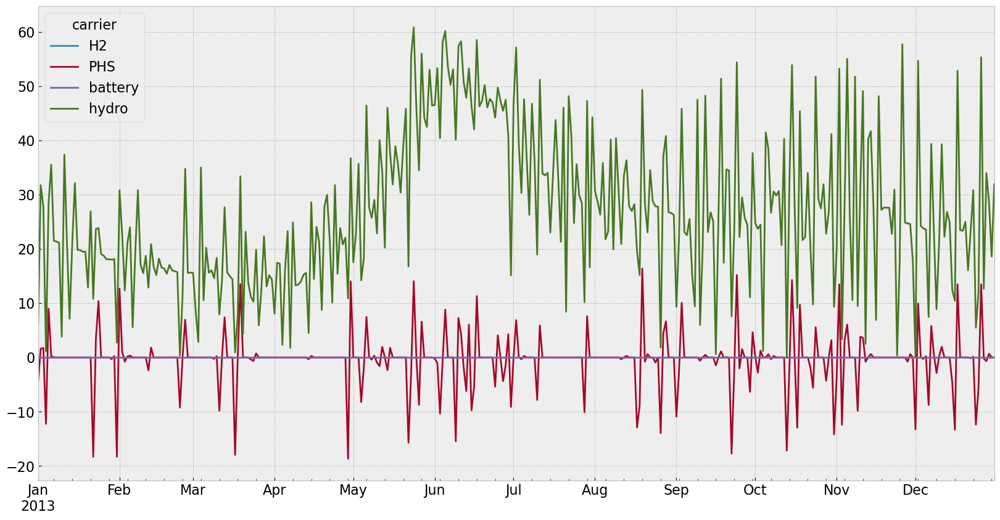

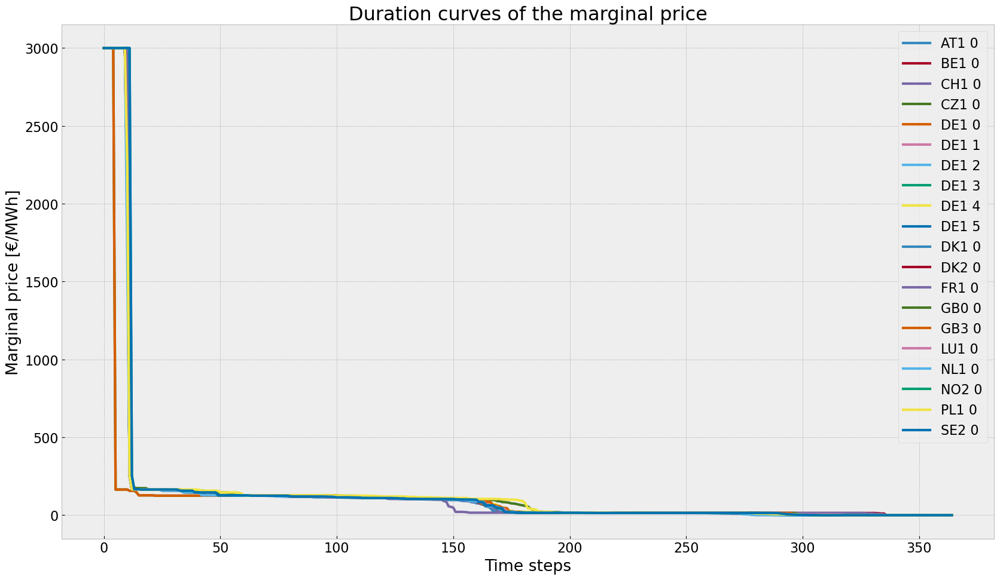

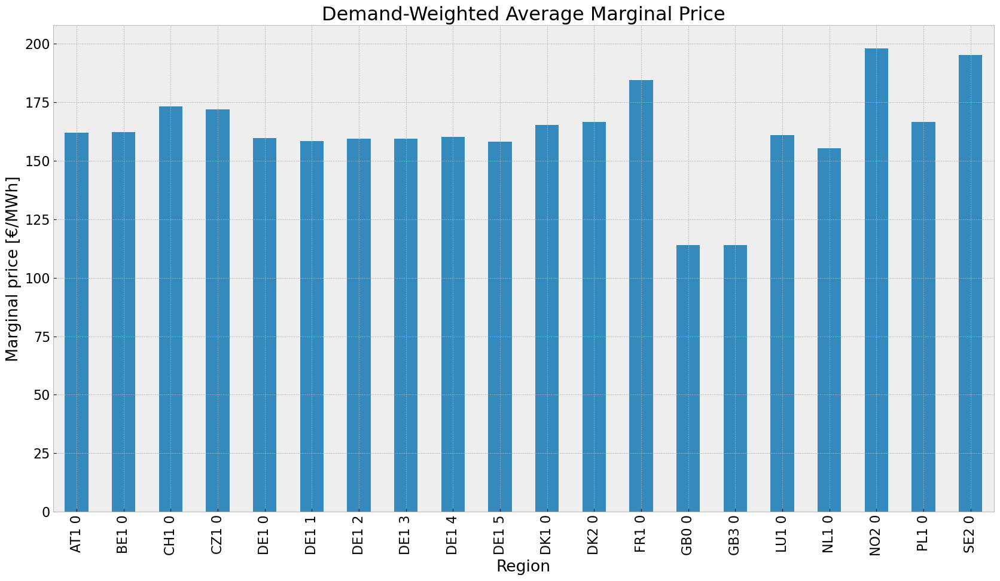

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


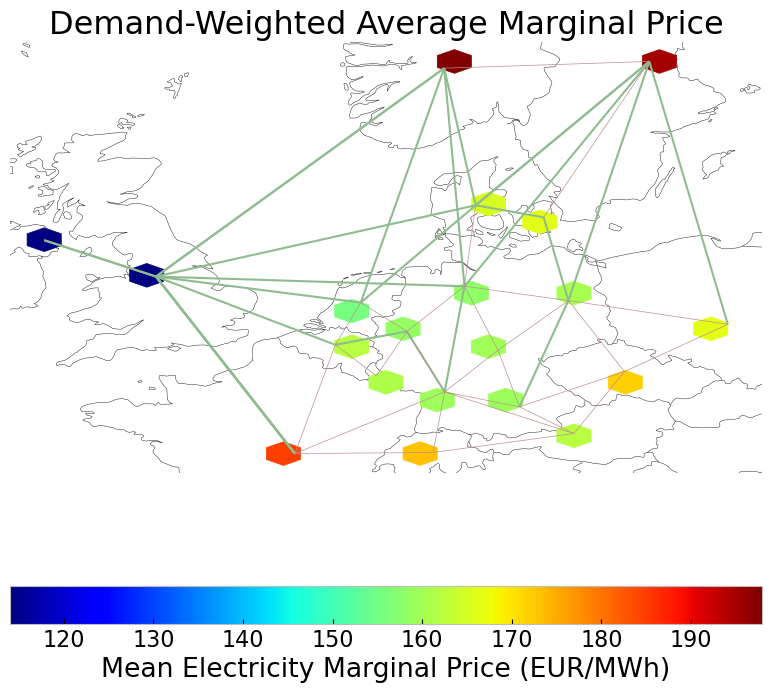

In [612]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-02-02 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='24H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [613]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

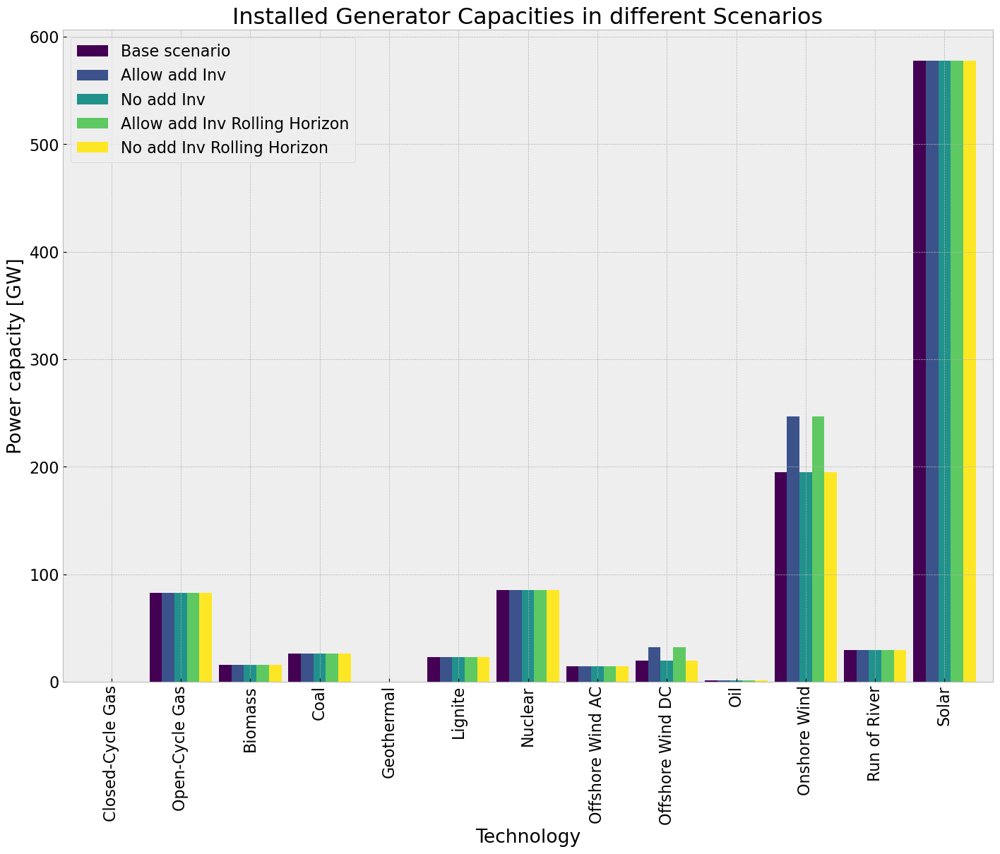

In [614]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'oil': '#c9c9c9', 'CCGT': '#a85522', 'solar': '#f9d002', 'geothermal': '#ba91b1', 'coal': '#545454', 'offwind-ac': '#6895dd', 'onwind': '#235ebc', 'OCGT': '#e0986c', 'nuclear': '#ff8c00', 'lignite': '#826837', 'offwind-dc': '#74c6f2', 'biomass': '#baa741', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


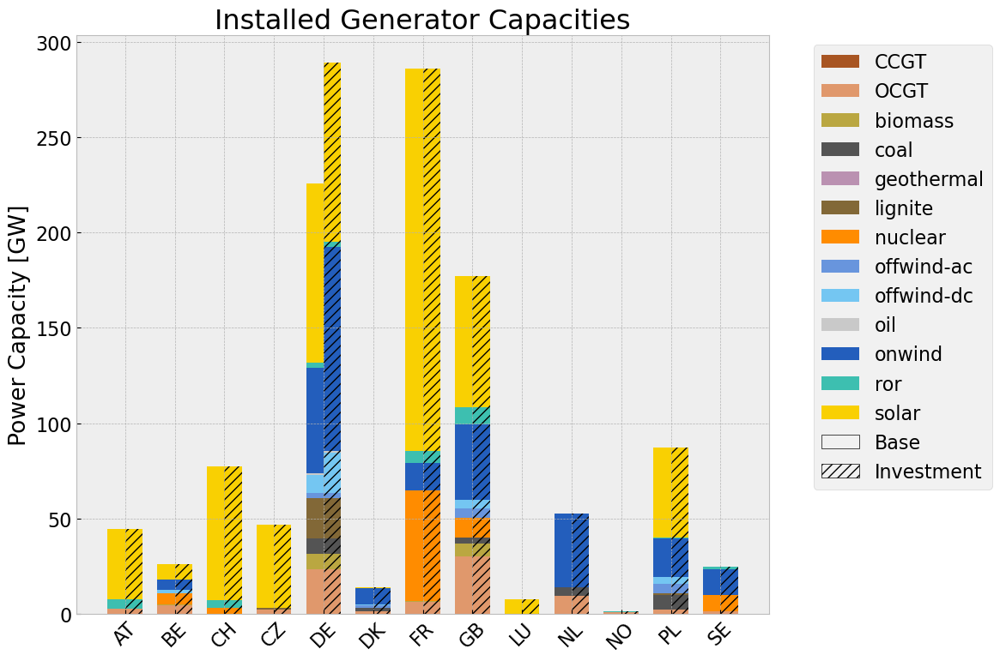

In [615]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

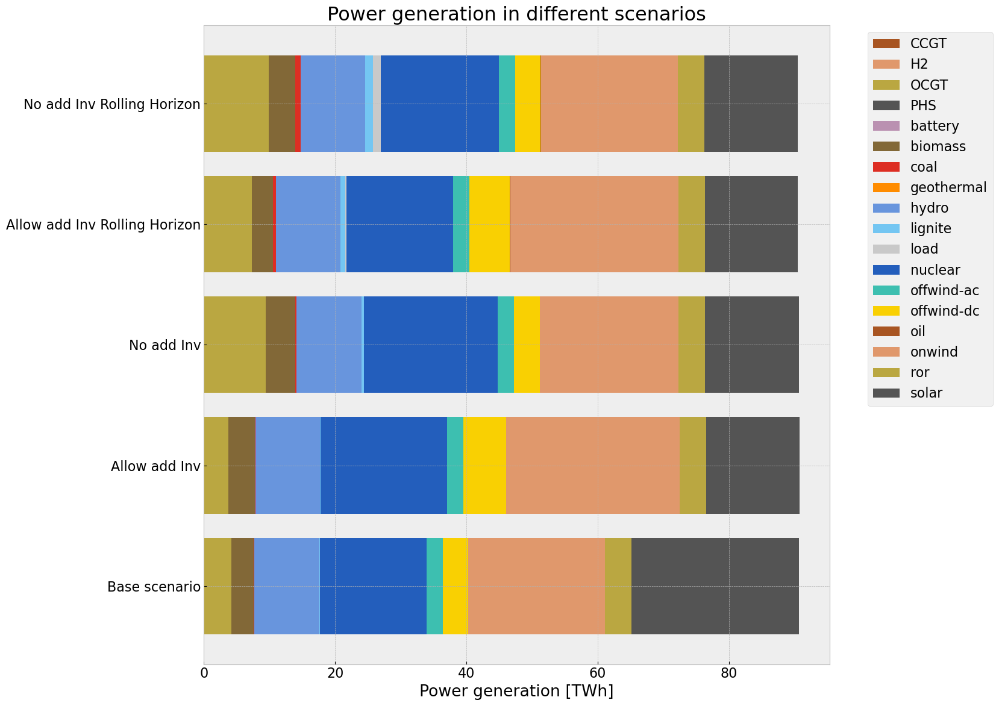

In [616]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

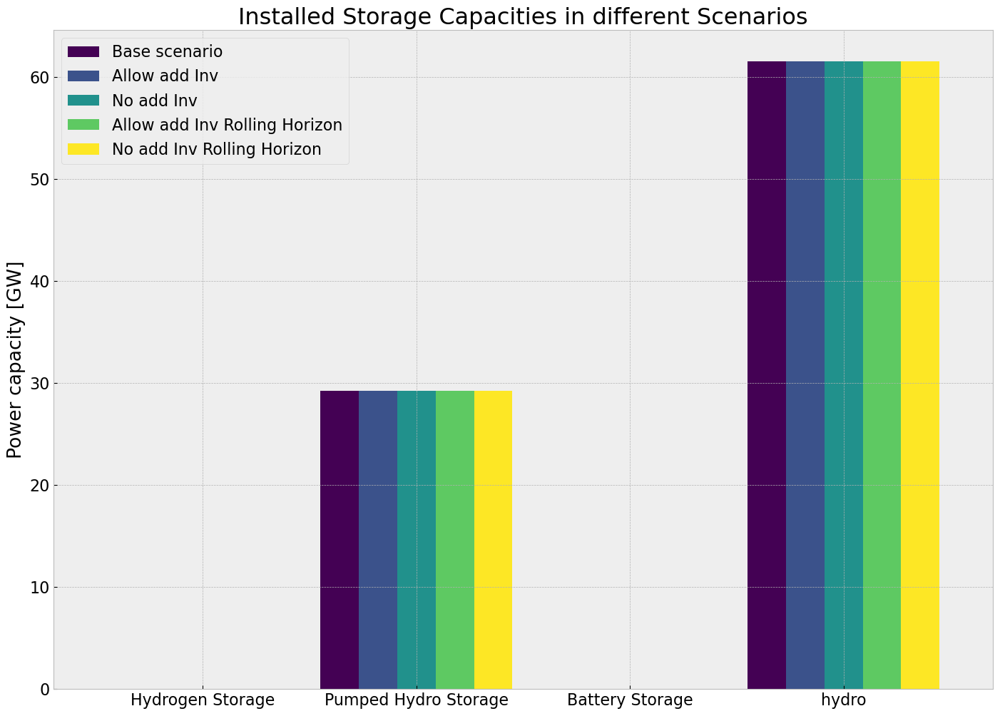

In [617]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

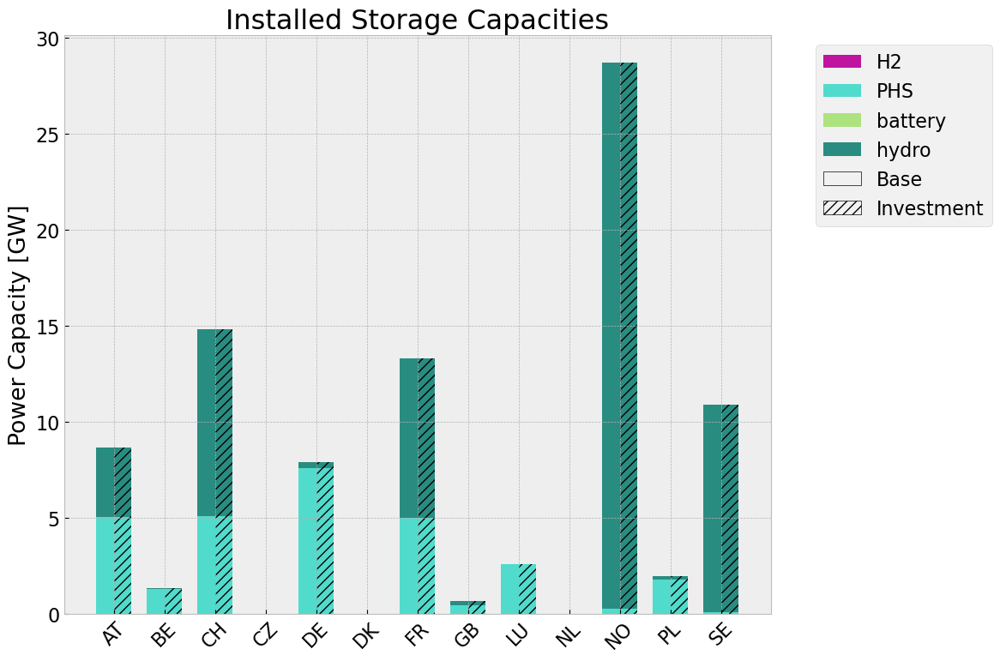

In [618]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [619]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


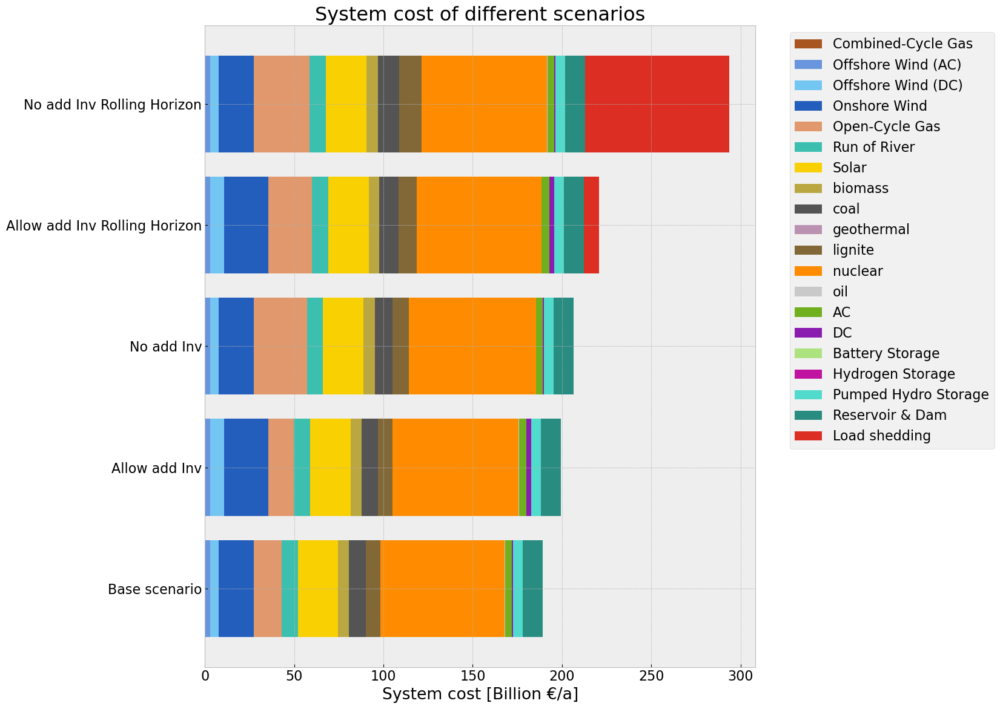

In [620]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [621]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [622]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


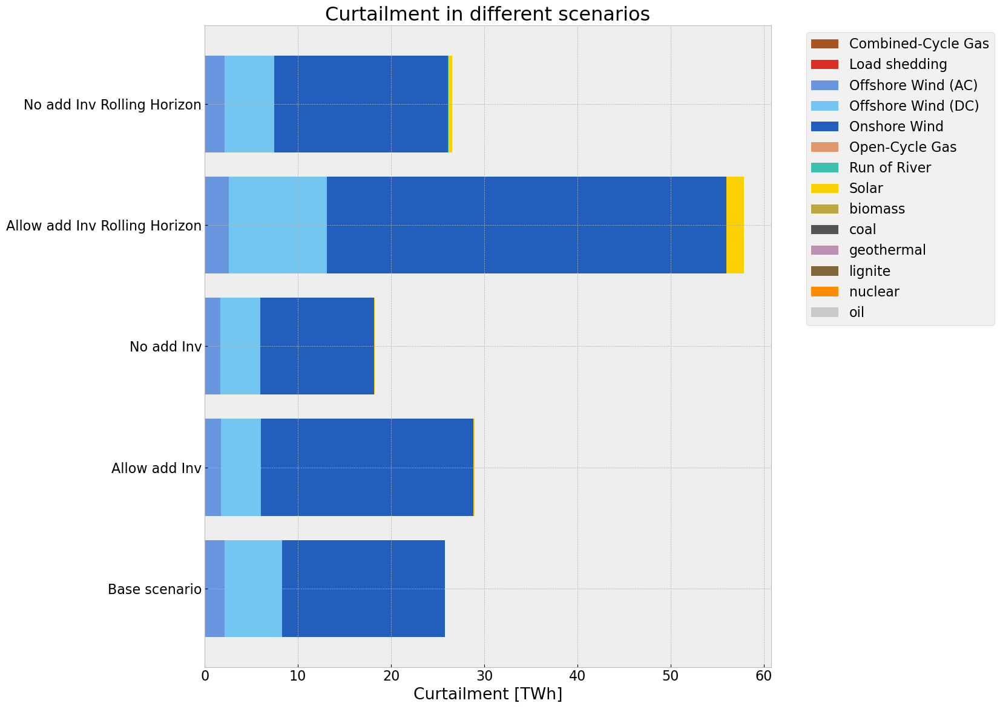

In [623]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\1032422005.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


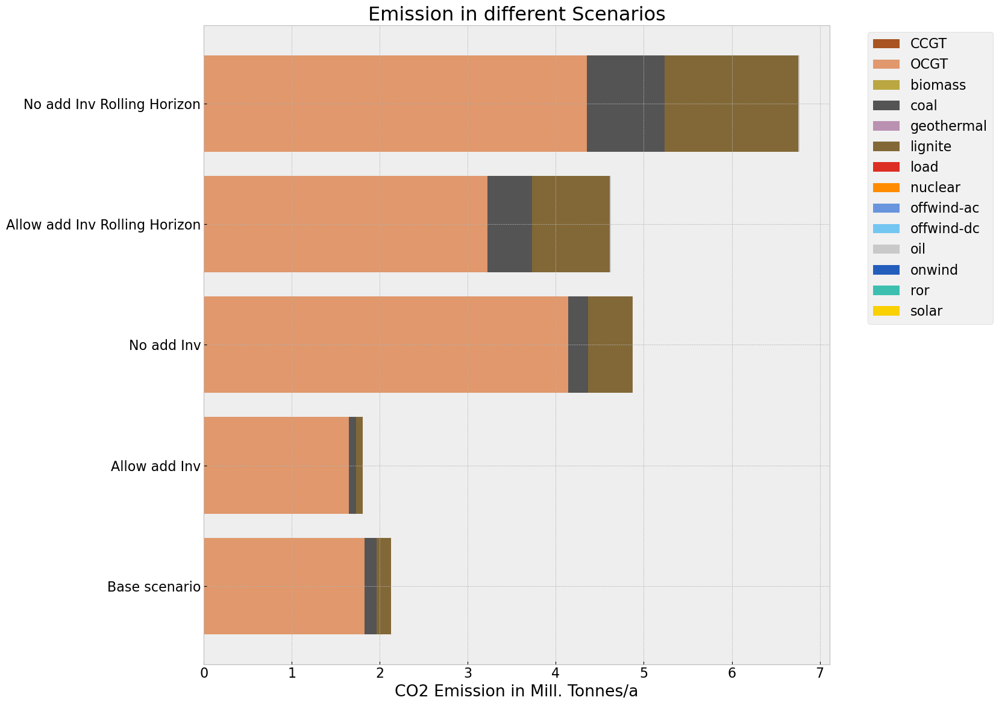

In [624]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [625]:
models = [n, n1, n2, n4]

In [626]:
model_trans = [n,n1]
for m in model_trans:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

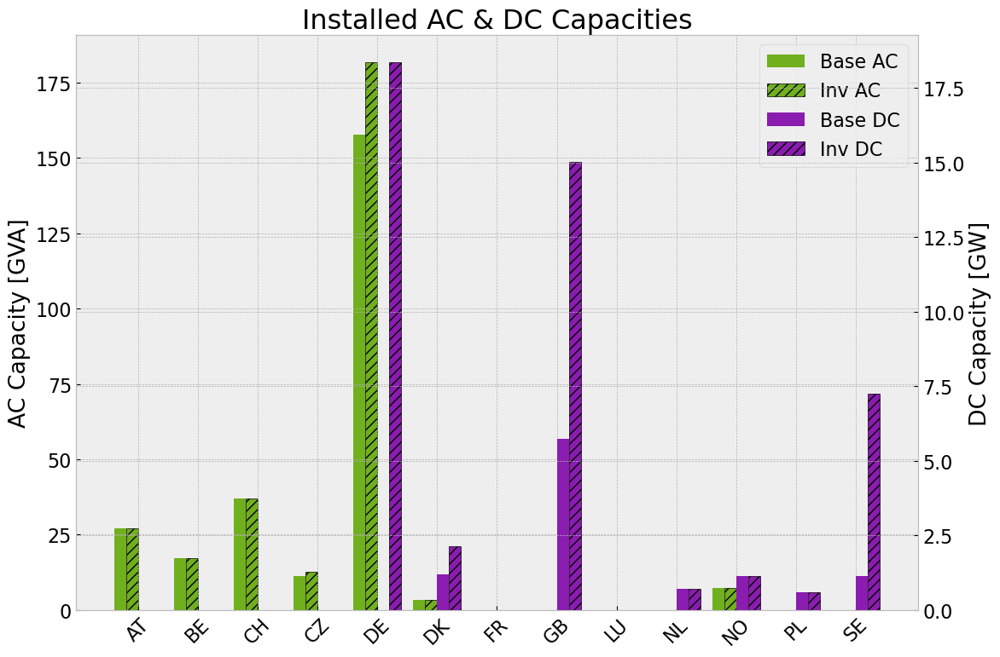

In [627]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_pv.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_pv.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_pv.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_pv.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_pv.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_pv.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

# Sensitivity Analysis

In [646]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [647]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [648]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_24h'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll_24h'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_24h'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll_24h'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = pvscenario(n, cut_start, dur, red)
        allow_inv(globals()[inv_model_name], n, country)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = pvscenario(n, cut_start, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

n_0_5_90_inv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 16.95it/s]
INFO:linopy.io: Writing time: 4.64s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w0kpl9uu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w0kpl9uu.lp


Reading time = 1.30 seconds


INFO:gurobipy:Reading time = 1.30 seconds


obj: 408095 rows, 190180 columns, 677801 nonzeros


INFO:gurobipy:obj: 408095 rows, 190180 columns, 677801 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


INFO:gurobipy:Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


Model fingerprint: 0x949b7c1b


INFO:gurobipy:Model fingerprint: 0x949b7c1b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [5e-03, 2e+02]


INFO:gurobipy:  Matrix range     [5e-03, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 2e+09]


INFO:gurobipy:  Bounds range     [1e+00, 2e+09]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 378196 rows and 97978 columns


INFO:gurobipy:Presolve removed 378196 rows and 97978 columns


Presolve time: 0.43s


INFO:gurobipy:Presolve time: 0.43s


Presolved: 29899 rows, 92202 columns, 169127 nonzeros


INFO:gurobipy:Presolved: 29899 rows, 92202 columns, 169127 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.29s


INFO:gurobipy:Ordering time: 0.29s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 14


INFO:gurobipy: Dense cols : 14


 AA' NZ     : 8.714e+04


INFO:gurobipy: AA' NZ     : 8.714e+04


 Factor NZ  : 7.303e+05 (roughly 60 MB of memory)


INFO:gurobipy: Factor NZ  : 7.303e+05 (roughly 60 MB of memory)


 Factor Ops : 3.873e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.873e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.61024559e+13 -9.90254799e+14  5.62e+05 1.31e+05  1.61e+10     1s


INFO:gurobipy:   0   2.61024559e+13 -9.90254799e+14  5.62e+05 1.31e+05  1.61e+10     1s


   1   2.01426929e+13 -2.88374862e+14  3.40e+05 2.78e+04  7.39e+09     1s


INFO:gurobipy:   1   2.01426929e+13 -2.88374862e+14  3.40e+05 2.78e+04  7.39e+09     1s


   2   1.07671947e+13 -1.46910397e+14  1.59e+05 1.00e+04  3.42e+09     1s


INFO:gurobipy:   2   1.07671947e+13 -1.46910397e+14  1.59e+05 1.00e+04  3.42e+09     1s


   3   2.42212854e+12 -4.99882834e+13  6.25e+03 1.72e+03  3.75e+08     1s


INFO:gurobipy:   3   2.42212854e+12 -4.99882834e+13  6.25e+03 1.72e+03  3.75e+08     1s


   4   6.53847486e+11 -9.68474705e+12  3.06e+02 2.39e+02  5.88e+07     1s


INFO:gurobipy:   4   6.53847486e+11 -9.68474705e+12  3.06e+02 2.39e+02  5.88e+07     1s


   5   3.64893863e+11 -3.06709302e+12  1.39e+02 7.13e+01  1.92e+07     1s


INFO:gurobipy:   5   3.64893863e+11 -3.06709302e+12  1.39e+02 7.13e+01  1.92e+07     1s


   6   2.13730574e+11 -2.03180011e+12  5.88e+01 4.63e+01  1.24e+07     1s


INFO:gurobipy:   6   2.13730574e+11 -2.03180011e+12  5.88e+01 4.63e+01  1.24e+07     1s


   7   1.41148614e+11 -1.00832356e+12  2.38e+01 2.27e+01  6.26e+06     1s


INFO:gurobipy:   7   1.41148614e+11 -1.00832356e+12  2.38e+01 2.27e+01  6.26e+06     1s


   8   8.43681277e+10 -4.58331969e+11  5.80e+00 1.02e+01  2.94e+06     1s


INFO:gurobipy:   8   8.43681277e+10 -4.58331969e+11  5.80e+00 1.02e+01  2.94e+06     1s


   9   6.82945223e+10 -2.21791960e+11  3.50e+00 5.23e+00  1.57e+06     1s


INFO:gurobipy:   9   6.82945223e+10 -2.21791960e+11  3.50e+00 5.23e+00  1.57e+06     1s


  10   4.87125187e+10 -7.50866210e+10  1.50e+00 2.01e+00  6.67e+05     2s


INFO:gurobipy:  10   4.87125187e+10 -7.50866210e+10  1.50e+00 2.01e+00  6.67e+05     2s


  11   3.95280578e+10 -3.27657224e+10  8.58e-01 1.15e+00  3.89e+05     2s


INFO:gurobipy:  11   3.95280578e+10 -3.27657224e+10  8.58e-01 1.15e+00  3.89e+05     2s


  12   3.47827637e+10 -4.09578732e+09  5.83e-01 5.46e-01  2.09e+05     2s


INFO:gurobipy:  12   3.47827637e+10 -4.09578732e+09  5.83e-01 5.46e-01  2.09e+05     2s


  13   2.98751342e+10  2.38605058e+09  3.24e-01 4.08e-01  1.48e+05     2s


INFO:gurobipy:  13   2.98751342e+10  2.38605058e+09  3.24e-01 4.08e-01  1.48e+05     2s


  14   2.80628722e+10  1.02722884e+10  2.35e-01 2.47e-01  9.58e+04     2s


INFO:gurobipy:  14   2.80628722e+10  1.02722884e+10  2.35e-01 2.47e-01  9.58e+04     2s


  15   2.65246088e+10  1.43414230e+10  1.65e-01 1.63e-01  6.56e+04     2s


INFO:gurobipy:  15   2.65246088e+10  1.43414230e+10  1.65e-01 1.63e-01  6.56e+04     2s


  16   2.52077626e+10  1.72896358e+10  1.07e-01 1.03e-01  4.26e+04     2s


INFO:gurobipy:  16   2.52077626e+10  1.72896358e+10  1.07e-01 1.03e-01  4.26e+04     2s


  17   2.44589255e+10  1.86649497e+10  7.51e-02 7.55e-02  3.12e+04     2s


INFO:gurobipy:  17   2.44589255e+10  1.86649497e+10  7.51e-02 7.55e-02  3.12e+04     2s


  18   2.39587197e+10  1.91273960e+10  5.44e-02 6.66e-02  2.60e+04     2s


INFO:gurobipy:  18   2.39587197e+10  1.91273960e+10  5.44e-02 6.66e-02  2.60e+04     2s


  19   2.35586843e+10  1.99738283e+10  3.83e-02 4.97e-02  1.93e+04     2s


INFO:gurobipy:  19   2.35586843e+10  1.99738283e+10  3.83e-02 4.97e-02  1.93e+04     2s


  20   2.31652755e+10  2.15311302e+10  2.26e-02 1.89e-02  8.79e+03     2s


INFO:gurobipy:  20   2.31652755e+10  2.15311302e+10  2.26e-02 1.89e-02  8.79e+03     2s


  21   2.29080316e+10  2.20314808e+10  1.30e-02 9.19e-03  4.72e+03     2s


INFO:gurobipy:  21   2.29080316e+10  2.20314808e+10  1.30e-02 9.19e-03  4.72e+03     2s


  22   2.28011555e+10  2.21894631e+10  9.17e-03 6.18e-03  3.29e+03     3s


INFO:gurobipy:  22   2.28011555e+10  2.21894631e+10  9.17e-03 6.18e-03  3.29e+03     3s


  23   2.27035130e+10  2.23042383e+10  5.73e-03 4.03e-03  2.15e+03     3s


INFO:gurobipy:  23   2.27035130e+10  2.23042383e+10  5.73e-03 4.03e-03  2.15e+03     3s


  24   2.26574822e+10  2.23795472e+10  4.14e-03 2.65e-03  1.50e+03     3s


INFO:gurobipy:  24   2.26574822e+10  2.23795472e+10  4.14e-03 2.65e-03  1.50e+03     3s


  25   2.26417405e+10  2.24316177e+10  3.62e-03 1.66e-03  1.13e+03     3s


INFO:gurobipy:  25   2.26417405e+10  2.24316177e+10  3.62e-03 1.66e-03  1.13e+03     3s


  26   2.25730213e+10  2.24827619e+10  1.30e-03 7.60e-04  4.86e+02     3s


INFO:gurobipy:  26   2.25730213e+10  2.24827619e+10  1.30e-03 7.60e-04  4.86e+02     3s


  27   2.25457604e+10  2.25044164e+10  4.29e-04 4.00e-04  2.22e+02     3s


INFO:gurobipy:  27   2.25457604e+10  2.25044164e+10  4.29e-04 4.00e-04  2.22e+02     3s


  28   2.25390698e+10  2.25219441e+10  2.12e-04 1.38e-04  9.21e+01     3s


INFO:gurobipy:  28   2.25390698e+10  2.25219441e+10  2.12e-04 1.38e-04  9.21e+01     3s


  29   2.25361158e+10  2.25249554e+10  1.20e-04 9.51e-05  6.00e+01     3s


INFO:gurobipy:  29   2.25361158e+10  2.25249554e+10  1.20e-04 9.51e-05  6.00e+01     3s


  30   2.25344938e+10  2.25282420e+10  7.12e-05 4.80e-05  3.36e+01     3s


INFO:gurobipy:  30   2.25344938e+10  2.25282420e+10  7.12e-05 4.80e-05  3.36e+01     3s


  31   2.25333907e+10  2.25295614e+10  3.98e-05 2.95e-05  2.06e+01     3s


INFO:gurobipy:  31   2.25333907e+10  2.25295614e+10  3.98e-05 2.95e-05  2.06e+01     3s


  32   2.25324754e+10  2.25308023e+10  1.44e-05 1.35e-05  9.00e+00     3s


INFO:gurobipy:  32   2.25324754e+10  2.25308023e+10  1.44e-05 1.35e-05  9.00e+00     3s


  33   2.25322223e+10  2.25315520e+10  7.59e-06 4.06e-06  3.61e+00     3s


INFO:gurobipy:  33   2.25322223e+10  2.25315520e+10  7.59e-06 4.06e-06  3.61e+00     3s


  34   2.25319527e+10  2.25318114e+10  1.27e-06 8.88e-07  7.60e-01     4s


INFO:gurobipy:  34   2.25319527e+10  2.25318114e+10  1.27e-06 8.88e-07  7.60e-01     4s


  35   2.25319096e+10  2.25318719e+10  1.35e-06 2.65e-07  2.03e-01     4s


INFO:gurobipy:  35   2.25319096e+10  2.25318719e+10  1.35e-06 2.65e-07  2.03e-01     4s


  36   2.25319058e+10  2.25318889e+10  5.60e-07 1.17e-07  9.07e-02     4s


INFO:gurobipy:  36   2.25319058e+10  2.25318889e+10  5.60e-07 1.17e-07  9.07e-02     4s


  37   2.25319045e+10  2.25318979e+10  4.88e-07 3.84e-08  3.51e-02     4s


INFO:gurobipy:  37   2.25319045e+10  2.25318979e+10  4.88e-07 3.84e-08  3.51e-02     4s


  38   2.25319036e+10  2.25319013e+10  2.15e-07 1.12e-08  1.25e-02     4s


INFO:gurobipy:  38   2.25319036e+10  2.25319013e+10  2.15e-07 1.12e-08  1.25e-02     4s


  39   2.25319032e+10  2.25319023e+10  7.20e-08 3.90e-09  4.64e-03     4s


INFO:gurobipy:  39   2.25319032e+10  2.25319023e+10  7.20e-08 3.90e-09  4.64e-03     4s


  40   2.25319030e+10  2.25319029e+10  8.06e-09 3.38e-10  6.31e-04     4s


INFO:gurobipy:  40   2.25319030e+10  2.25319029e+10  8.06e-09 3.38e-10  6.31e-04     4s


  41   2.25319029e+10  2.25319029e+10  1.34e-08 2.72e-10  3.94e-05     4s


INFO:gurobipy:  41   2.25319029e+10  2.25319029e+10  1.34e-08 2.72e-10  3.94e-05     4s


  42   2.25319029e+10  2.25319029e+10  2.10e-07 7.45e-11  7.38e-07     4s


INFO:gurobipy:  42   2.25319029e+10  2.25319029e+10  2.10e-07 7.45e-11  7.38e-07     4s


  43   2.25319029e+10  2.25319029e+10  1.88e-08 2.90e-10  2.50e-09     4s


INFO:gurobipy:  43   2.25319029e+10  2.25319029e+10  1.88e-08 2.90e-10  2.50e-09     4s


INFO:gurobipy:


Barrier solved model in 43 iterations and 4.15 seconds (1.45 work units)


INFO:gurobipy:Barrier solved model in 43 iterations and 4.15 seconds (1.45 work units)


Optimal objective 2.25319029e+10


INFO:gurobipy:Optimal objective 2.25319029e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    5740 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:    5740 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:


    2368 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:    2368 PPushes remaining with PInf 0.0000000e+00                 5s


       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.7406022e-09      5s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.7406022e-09      5s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6455    2.2531903e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    6455    2.2531903e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 6455 iterations and 5.31 seconds (1.96 work units)


INFO:gurobipy:Solved in 6455 iterations and 5.31 seconds (1.96 work units)


Optimal objective  2.253190293e+10


INFO:gurobipy:Optimal objective  2.253190293e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190180 primals, 408095 duals
Objective: 2.25e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

n_0_5_90_inv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_5_90_inv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_7xuqzp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_7xuqzp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e8b5e1a


INFO:gurobipy:Model fingerprint: 0x2e8b5e1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4672054e+04   2.809864e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4672054e+04   2.809864e+05   0.000000e+00      0s


     264    4.6809772e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    4.6809772e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.680977219e+07


INFO:gurobipy:Optimal objective  4.680977219e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.68e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ybhwqaa3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ybhwqaa3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x91452710


INFO:gurobipy:Model fingerprint: 0x91452710


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5249797e+06   2.790705e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5249797e+06   2.790705e+05   0.000000e+00      0s


     250    2.8202577e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.8202577e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.820257697e+08


INFO:gurobipy:Optimal objective  2.820257697e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irwe1n35.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-irwe1n35.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfbf5c4ce


INFO:gurobipy:Model fingerprint: 0xfbf5c4ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2282456e+07   2.708050e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2282456e+07   2.708050e+05   0.000000e+00      0s


     253    9.8356348e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    9.8356348e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.835634823e+08


INFO:gurobipy:Optimal objective  9.835634823e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-daoa3yyv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-daoa3yyv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9759f20d


INFO:gurobipy:Model fingerprint: 0x9759f20d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1349931e+08   2.722857e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1349931e+08   2.722857e+05   0.000000e+00      0s


     224    8.4427171e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    8.4427171e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.442717080e+08


INFO:gurobipy:Optimal objective  8.442717080e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a2u424m0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a2u424m0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde2413ff


INFO:gurobipy:Model fingerprint: 0xde2413ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0645378e+08   2.764402e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0645378e+08   2.764402e+05   0.000000e+00      0s


     245    1.2069755e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.2069755e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.206975505e+09


INFO:gurobipy:Optimal objective  1.206975505e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8_11o2cc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8_11o2cc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe2b50c72


INFO:gurobipy:Model fingerprint: 0xe2b50c72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9091207e+07   2.674610e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9091207e+07   2.674610e+05   0.000000e+00      0s


     242    5.1115589e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    5.1115589e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.111558856e+09


INFO:gurobipy:Optimal objective  5.111558856e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hn61bswj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hn61bswj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb3779872


INFO:gurobipy:Model fingerprint: 0xb3779872


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3000539e+07   2.804044e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3000539e+07   2.804044e+05   0.000000e+00      0s


     239    5.7953420e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    5.7953420e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.795342049e+08


INFO:gurobipy:Optimal objective  5.795342049e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_swursht.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_swursht.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8e5da14c


INFO:gurobipy:Model fingerprint: 0x8e5da14c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 695 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8348401e+08   2.711028e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8348401e+08   2.711028e+05   0.000000e+00      0s


     282    5.4811258e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    5.4811258e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 282 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.481125812e+09


INFO:gurobipy:Optimal objective  5.481125812e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ftax3f5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ftax3f5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6646dd69


INFO:gurobipy:Model fingerprint: 0x6646dd69


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3177873e+06   2.678756e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3177873e+06   2.678756e+05   0.000000e+00      0s


     247    1.6405195e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.6405195e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.640519463e+09


INFO:gurobipy:Optimal objective  1.640519463e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oezeehku.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oezeehku.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0cf99dab


INFO:gurobipy:Model fingerprint: 0x0cf99dab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4929368e+04   2.695087e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4929368e+04   2.695087e+05   0.000000e+00      0s


     253    9.1414237e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    9.1414237e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.141423702e+07


INFO:gurobipy:Optimal objective  9.141423702e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lzwwh_nf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lzwwh_nf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xac4a0b28


INFO:gurobipy:Model fingerprint: 0xac4a0b28


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 705 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5420419e+06   2.713157e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5420419e+06   2.713157e+05   0.000000e+00      0s


     186    2.2323456e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    2.2323456e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.232345626e+08


INFO:gurobipy:Optimal objective  2.232345626e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rxd0iai.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rxd0iai.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x496d745e


INFO:gurobipy:Model fingerprint: 0x496d745e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 864 columns


INFO:gurobipy:Presolve removed 3192 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 699 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 162 rows, 699 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0801990e+04   2.777980e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0801990e+04   2.777980e+05   0.000000e+00      0s


     247    1.1927534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.1927534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.192753420e+08


INFO:gurobipy:Optimal objective  1.192753420e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3x8t4vok.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3x8t4vok.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x75460080


INFO:gurobipy:Model fingerprint: 0x75460080


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 860 columns


INFO:gurobipy:Presolve removed 3192 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 162 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0902434e+07   2.690274e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0902434e+07   2.690274e+05   0.000000e+00      0s


     214    1.0879361e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.0879361e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.087936090e+09


INFO:gurobipy:Optimal objective  1.087936090e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_bom9hx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_bom9hx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8e135d4a


INFO:gurobipy:Model fingerprint: 0x8e135d4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4018668e+07   2.804703e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4018668e+07   2.804703e+05   0.000000e+00      0s


     229    1.2860291e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    1.2860291e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.286029063e+09


INFO:gurobipy:Optimal objective  1.286029063e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1839f1hb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1839f1hb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2620f119


INFO:gurobipy:Model fingerprint: 0x2620f119


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8737083e+07   2.714298e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8737083e+07   2.714298e+05   0.000000e+00      0s


     279    4.6016927e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    4.6016927e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 279 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.601692673e+09


INFO:gurobipy:Optimal objective  4.601692673e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4ogg2em.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4ogg2em.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x210545c7


INFO:gurobipy:Model fingerprint: 0x210545c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4079912e+07   2.654585e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4079912e+07   2.654585e+05   0.000000e+00      0s


     226    2.3616479e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    2.3616479e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.361647934e+09


INFO:gurobipy:Optimal objective  2.361647934e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_i4liew0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_i4liew0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x50e0e0e4


INFO:gurobipy:Model fingerprint: 0x50e0e0e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.6193835e+07   2.630351e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.6193835e+07   2.630351e+05   0.000000e+00      0s


     208    9.2526027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    9.2526027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.252602661e+08


INFO:gurobipy:Optimal objective  9.252602661e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xofjcqaz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xofjcqaz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb1f4a72c


INFO:gurobipy:Model fingerprint: 0xb1f4a72c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1194905e+08   2.741249e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1194905e+08   2.741249e+05   0.000000e+00      0s


     206    8.8393427e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    8.8393427e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.839342748e+08


INFO:gurobipy:Optimal objective  8.839342748e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7j7uq8g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7j7uq8g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc184966f


INFO:gurobipy:Model fingerprint: 0xc184966f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2303840e+08   2.756091e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2303840e+08   2.756091e+05   0.000000e+00      0s


     244    8.8716723e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    8.8716723e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.871672256e+08


INFO:gurobipy:Optimal objective  8.871672256e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2fo9954h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2fo9954h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbe482c60


INFO:gurobipy:Model fingerprint: 0xbe482c60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3795717e+08   2.692386e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3795717e+08   2.692386e+05   0.000000e+00      0s


     255    2.4009125e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    2.4009125e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.400912503e+09


INFO:gurobipy:Optimal objective  2.400912503e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rvgh3uy2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rvgh3uy2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf90336fa


INFO:gurobipy:Model fingerprint: 0xf90336fa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2200957e+08   2.743765e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2200957e+08   2.743765e+05   0.000000e+00      0s


     270    6.2036557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     270    6.2036557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 270 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 270 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.203655685e+08


INFO:gurobipy:Optimal objective  6.203655685e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0b2a_ssh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0b2a_ssh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x82f7eeef


INFO:gurobipy:Model fingerprint: 0x82f7eeef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0141242e+07   2.691847e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0141242e+07   2.691847e+05   0.000000e+00      0s


     217    6.7375568e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.7375568e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.737556820e+08


INFO:gurobipy:Optimal objective  6.737556820e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e1rizuz7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e1rizuz7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8eba516f


INFO:gurobipy:Model fingerprint: 0x8eba516f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4639142e+04   2.670802e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4639142e+04   2.670802e+05   0.000000e+00      0s


     236    1.1488755e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    1.1488755e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.148875529e+08


INFO:gurobipy:Optimal objective  1.148875529e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-muhxgjxt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-muhxgjxt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x51b3e27c


INFO:gurobipy:Model fingerprint: 0x51b3e27c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3193 rows and 874 columns


INFO:gurobipy:Presolve removed 3193 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 689 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 161 rows, 689 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2851075e+07   4.044036e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2851075e+07   4.044036e+05   0.000000e+00      0s


     232    1.3022678e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.3022678e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.302267772e+09


INFO:gurobipy:Optimal objective  1.302267772e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4s441okn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4s441okn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x60972a83


INFO:gurobipy:Model fingerprint: 0x60972a83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 702 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0108623e+08   2.725232e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0108623e+08   2.725232e+05   0.000000e+00      0s


     220    1.3940547e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.3940547e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.394054672e+09


INFO:gurobipy:Optimal objective  1.394054672e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b5hbfsmp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b5hbfsmp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89f1ac8c


INFO:gurobipy:Model fingerprint: 0x89f1ac8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8616391e+07   2.760988e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8616391e+07   2.760988e+05   0.000000e+00      0s


     268    3.9193369e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    3.9193369e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 268 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.919336908e+08


INFO:gurobipy:Optimal objective  3.919336908e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-840cwfc1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-840cwfc1.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd1166e9c


INFO:gurobipy:Model fingerprint: 0xd1166e9c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 702 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0793129e+07   2.603408e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0793129e+07   2.603408e+05   0.000000e+00      0s


     236    7.8344236e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    7.8344236e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.834423634e+08


INFO:gurobipy:Optimal objective  7.834423634e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0tv9s5d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0tv9s5d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x30598ee9


INFO:gurobipy:Model fingerprint: 0x30598ee9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1305229e+04   2.787531e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1305229e+04   2.787531e+05   0.000000e+00      0s


     230    1.1231397e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    1.1231397e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.123139686e+08


INFO:gurobipy:Optimal objective  1.123139686e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w23segi0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w23segi0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd80b432f


INFO:gurobipy:Model fingerprint: 0xd80b432f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0074714e+07   2.675678e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0074714e+07   2.675678e+05   0.000000e+00      0s


     225    6.2023601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    6.2023601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.202360098e+08


INFO:gurobipy:Optimal objective  6.202360098e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mwwbznm1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mwwbznm1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa60174ed


INFO:gurobipy:Model fingerprint: 0xa60174ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2694942e+07   2.799419e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2694942e+07   2.799419e+05   0.000000e+00      0s


     195    7.1205987e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    7.1205987e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.120598675e+08


INFO:gurobipy:Optimal objective  7.120598675e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2t5iqfe_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2t5iqfe_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2395142b


INFO:gurobipy:Model fingerprint: 0x2395142b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3131220e+07   2.687733e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3131220e+07   2.687733e+05   0.000000e+00      0s


     223    4.5938703e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    4.5938703e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.593870266e+08


INFO:gurobipy:Optimal objective  4.593870266e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_88kbbz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_88kbbz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb60e3015


INFO:gurobipy:Model fingerprint: 0xb60e3015


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 857 columns


INFO:gurobipy:Presolve removed 3189 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 706 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 165 rows, 706 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2065959e+07   2.666934e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2065959e+07   2.666934e+05   0.000000e+00      0s


     228    7.6235636e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    7.6235636e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.623563591e+08


INFO:gurobipy:Optimal objective  7.623563591e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bfa0ask9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bfa0ask9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x39b9aa3a


INFO:gurobipy:Model fingerprint: 0x39b9aa3a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 849 columns


INFO:gurobipy:Presolve removed 3189 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 714 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 165 rows, 714 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4940835e+07   2.701870e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4940835e+07   2.701870e+05   0.000000e+00      0s


     254    5.9281508e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    5.9281508e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.928150784e+08


INFO:gurobipy:Optimal objective  5.928150784e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_3_6wc7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_3_6wc7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeb6522f3


INFO:gurobipy:Model fingerprint: 0xeb6522f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3189 rows and 850 columns


INFO:gurobipy:Presolve removed 3189 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 713 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 165 rows, 713 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.7525038e+07   2.593893e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.7525038e+07   2.593893e+05   0.000000e+00      0s


     255    6.5491198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    6.5491198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.549119821e+08


INFO:gurobipy:Optimal objective  6.549119821e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99y3nshd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99y3nshd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x88053417


INFO:gurobipy:Model fingerprint: 0x88053417


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0359834e+04   2.687319e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0359834e+04   2.687319e+05   0.000000e+00      0s


     211    5.9239034e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    5.9239034e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.923903354e+07


INFO:gurobipy:Optimal objective  5.923903354e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eio8mb8a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eio8mb8a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89e4d898


INFO:gurobipy:Model fingerprint: 0x89e4d898


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3195 rows and 865 columns


INFO:gurobipy:Presolve removed 3195 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9010588e+04   2.679028e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9010588e+04   2.679028e+05   0.000000e+00      0s


     202    6.3731874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    6.3731874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.373187428e+07


INFO:gurobipy:Optimal objective  6.373187428e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v9kezhf4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v9kezhf4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x556fcde4


INFO:gurobipy:Model fingerprint: 0x556fcde4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 845 columns


INFO:gurobipy:Presolve removed 3195 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 718 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 159 rows, 718 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7818805e+06   2.716770e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7818805e+06   2.716770e+05   0.000000e+00      0s


     226    1.4966133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.4966133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.496613305e+08


INFO:gurobipy:Optimal objective  1.496613305e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4511xt9w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4511xt9w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd3d0729


INFO:gurobipy:Model fingerprint: 0xcd3d0729


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 853 columns


INFO:gurobipy:Presolve removed 3195 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2606122e+06   2.703704e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2606122e+06   2.703704e+05   0.000000e+00      0s


     223    1.1442164e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.1442164e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.144216410e+08


INFO:gurobipy:Optimal objective  1.144216410e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7000m7xs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7000m7xs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb4fa0e84


INFO:gurobipy:Model fingerprint: 0xb4fa0e84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 855 columns


INFO:gurobipy:Presolve removed 3195 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8136002e+07   2.630989e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8136002e+07   2.630989e+05   0.000000e+00      0s


     238    3.1579116e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.1579116e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.157911555e+08


INFO:gurobipy:Optimal objective  3.157911555e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jh6fevh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jh6fevh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd2c06a57


INFO:gurobipy:Model fingerprint: 0xd2c06a57


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 861 columns


INFO:gurobipy:Presolve removed 3196 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 702 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 158 rows, 702 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2727194e+06   2.711062e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2727194e+06   2.711062e+05   0.000000e+00      0s


     251    1.5501013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    1.5501013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.550101326e+08


INFO:gurobipy:Optimal objective  1.550101326e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3sbh9ter.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3sbh9ter.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x015ef41c


INFO:gurobipy:Model fingerprint: 0x015ef41c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3198 rows and 857 columns


INFO:gurobipy:Presolve removed 3198 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 706 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 156 rows, 706 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5068436e+06   2.703673e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5068436e+06   2.703673e+05   0.000000e+00      0s


     235    2.3359146e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.3359146e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.335914625e+08


INFO:gurobipy:Optimal objective  2.335914625e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ev4rztqy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ev4rztqy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6749a3ed


INFO:gurobipy:Model fingerprint: 0x6749a3ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 868 columns


INFO:gurobipy:Presolve removed 3199 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 695 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 155 rows, 695 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5253486e+04   2.696093e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5253486e+04   2.696093e+05   0.000000e+00      0s


     217    1.2713516e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    1.2713516e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.271351582e+07


INFO:gurobipy:Optimal objective  1.271351582e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gppuvu5s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gppuvu5s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeac78c5f


INFO:gurobipy:Model fingerprint: 0xeac78c5f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 874 columns


INFO:gurobipy:Presolve removed 3201 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 689 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 153 rows, 689 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5583611e+04   2.662777e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5583611e+04   2.662777e+05   0.000000e+00      0s


     204    3.2288107e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    3.2288107e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.228810718e+07


INFO:gurobipy:Optimal objective  3.228810718e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-erfhqnwd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-erfhqnwd.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe6b3bedf


INFO:gurobipy:Model fingerprint: 0xe6b3bedf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 867 columns


INFO:gurobipy:Presolve removed 3195 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 696 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 159 rows, 696 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5782230e+04   2.698669e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5782230e+04   2.698669e+05   0.000000e+00      0s


     237    2.7789262e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    2.7789262e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.778926195e+05


INFO:gurobipy:Optimal objective  2.778926195e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.78e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zxb1chxi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zxb1chxi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7c7292ad


INFO:gurobipy:Model fingerprint: 0x7c7292ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 863 columns


INFO:gurobipy:Presolve removed 3192 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 700 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 700 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7435552e+04   2.556489e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7435552e+04   2.556489e+05   0.000000e+00      0s


     239    5.0414888e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    5.0414888e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.041488811e+06


INFO:gurobipy:Optimal objective  5.041488811e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.04e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vla5yan9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vla5yan9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa0a25382


INFO:gurobipy:Model fingerprint: 0xa0a25382


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 869 columns


INFO:gurobipy:Presolve removed 3192 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 694 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 162 rows, 694 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2346681e+06   2.638639e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2346681e+06   2.638639e+05   0.000000e+00      0s


     215    4.9769377e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    4.9769377e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.976937703e+07


INFO:gurobipy:Optimal objective  4.976937703e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uba9ti_h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uba9ti_h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf63980ce


INFO:gurobipy:Model fingerprint: 0xf63980ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 859 columns


INFO:gurobipy:Presolve removed 3192 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 704 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 162 rows, 704 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7430773e+06   2.721917e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7430773e+06   2.721917e+05   0.000000e+00      0s


     245    4.0030030e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.0030030e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.003002996e+07


INFO:gurobipy:Optimal objective  4.003002996e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62s3x4ze.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62s3x4ze.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb1ef8b58


INFO:gurobipy:Model fingerprint: 0xb1ef8b58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 866 columns


INFO:gurobipy:Presolve removed 3192 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 697 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 162 rows, 697 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4692062e+04   2.643362e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4692062e+04   2.643362e+05   0.000000e+00      0s


     220    2.7047371e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.7047371e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.704737129e+07


INFO:gurobipy:Optimal objective  2.704737129e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-icqmfvz0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-icqmfvz0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5a81c4a5


INFO:gurobipy:Model fingerprint: 0x5a81c4a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 862 columns


INFO:gurobipy:Presolve removed 3192 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 701 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 162 rows, 701 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9629060e+04   2.634289e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9629060e+04   2.634289e+05   0.000000e+00      0s


     202    2.0326948e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    2.0326948e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.032694846e+06


INFO:gurobipy:Optimal objective  2.032694846e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyl8b7vm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyl8b7vm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x20524ee9


INFO:gurobipy:Model fingerprint: 0x20524ee9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 859 columns


INFO:gurobipy:Presolve removed 3192 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 704 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 162 rows, 704 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5101138e+06   2.578002e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5101138e+06   2.578002e+05   0.000000e+00      0s


     242    4.2222953e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    4.2222953e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.222295311e+07


INFO:gurobipy:Optimal objective  4.222295311e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.22e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-en9yvz7s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-en9yvz7s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf29f3ae7


INFO:gurobipy:Model fingerprint: 0xf29f3ae7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3199 rows and 867 columns


INFO:gurobipy:Presolve removed 3199 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 696 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 155 rows, 696 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0425828e+04   2.691063e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0425828e+04   2.691063e+05   0.000000e+00      0s


     189    4.1907830e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    4.1907830e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.190783005e+06


INFO:gurobipy:Optimal objective  4.190783005e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r8u7y7mb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r8u7y7mb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7f96df72


INFO:gurobipy:Model fingerprint: 0x7f96df72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3202 rows and 877 columns


INFO:gurobipy:Presolve removed 3202 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 152 rows, 686 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 152 rows, 686 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5048779e+06   2.558593e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5048779e+06   2.558593e+05   0.000000e+00      0s


     212    1.2410538e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    1.2410538e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.241053823e+07


INFO:gurobipy:Optimal objective  1.241053823e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sumin5i2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sumin5i2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x06f263ca


INFO:gurobipy:Model fingerprint: 0x06f263ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3204 rows and 884 columns


INFO:gurobipy:Presolve removed 3204 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 679 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 150 rows, 679 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7402264e+04   2.609868e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7402264e+04   2.609868e+05   0.000000e+00      0s


     186    8.6287792e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    8.6287792e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.628779208e+06


INFO:gurobipy:Optimal objective  8.628779208e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.63e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r8c2t8xd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r8c2t8xd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb4495151


INFO:gurobipy:Model fingerprint: 0xb4495151


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 868 columns


INFO:gurobipy:Presolve removed 3201 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9794523e+06   2.698933e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9794523e+06   2.698933e+05   0.000000e+00      0s


     195    4.8879218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.8879218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.887921772e+07


INFO:gurobipy:Optimal objective  4.887921772e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03jkuapi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03jkuapi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa66c3b0a


INFO:gurobipy:Model fingerprint: 0xa66c3b0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 873 columns


INFO:gurobipy:Presolve removed 3201 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 690 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 153 rows, 690 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5304010e+04   2.622478e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5304010e+04   2.622478e+05   0.000000e+00      0s


     194    2.8312301e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    2.8312301e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.831230056e+06


INFO:gurobipy:Optimal objective  2.831230056e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.83e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lnsf0_jp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lnsf0_jp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb80f3046


INFO:gurobipy:Model fingerprint: 0xb80f3046


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 873 columns


INFO:gurobipy:Presolve removed 3201 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 690 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 153 rows, 690 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2990077e+06   2.695557e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2990077e+06   2.695557e+05   0.000000e+00      0s


     203    2.1185190e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    2.1185190e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.118518974e+07


INFO:gurobipy:Optimal objective  2.118518974e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qtt1ri8p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qtt1ri8p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x635bcf9b


INFO:gurobipy:Model fingerprint: 0x635bcf9b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 872 columns


INFO:gurobipy:Presolve removed 3201 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7970011e+07   2.586964e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7970011e+07   2.586964e+05   0.000000e+00      0s


     298    6.8905222e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     298    6.8905222e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 298 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 298 iterations and 0.03 seconds (0.01 work units)


Optimal objective  6.890522233e+07


INFO:gurobipy:Optimal objective  6.890522233e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ge7m5cfi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ge7m5cfi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x03599daf


INFO:gurobipy:Model fingerprint: 0x03599daf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 879 columns


INFO:gurobipy:Presolve removed 3201 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 153 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2574958e+06   2.650108e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2574958e+06   2.650108e+05   0.000000e+00      0s


     189    9.4595859e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    9.4595859e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.459585863e+06


INFO:gurobipy:Optimal objective  9.459585863e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.46e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vxwufn34.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vxwufn34.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe53ddb67


INFO:gurobipy:Model fingerprint: 0xe53ddb67


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 868 columns


INFO:gurobipy:Presolve removed 3201 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5067610e+06   2.622567e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5067610e+06   2.622567e+05   0.000000e+00      0s


     196    2.4905360e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    2.4905360e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.490535983e+07


INFO:gurobipy:Optimal objective  2.490535983e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ln9xwafx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ln9xwafx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3195efa3


INFO:gurobipy:Model fingerprint: 0x3195efa3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 869 columns


INFO:gurobipy:Presolve removed 3201 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 694 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 153 rows, 694 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2662651e+06   2.641379e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2662651e+06   2.641379e+05   0.000000e+00      0s


     222    1.0798654e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.0798654e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.079865406e+07


INFO:gurobipy:Optimal objective  1.079865406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lo_phgrt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lo_phgrt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x075d13b6


INFO:gurobipy:Model fingerprint: 0x075d13b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3199 rows and 867 columns


INFO:gurobipy:Presolve removed 3199 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 696 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 155 rows, 696 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7561810e+04   2.850955e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7561810e+04   2.850955e+05   0.000000e+00      0s


     213    2.2323957e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.2323957e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.232395682e+06


INFO:gurobipy:Optimal objective  2.232395682e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9p4a89tl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9p4a89tl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc4887ddd


INFO:gurobipy:Model fingerprint: 0xc4887ddd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3198 rows and 861 columns


INFO:gurobipy:Presolve removed 3198 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 702 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 156 rows, 702 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2588358e+06   2.638211e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2588358e+06   2.638211e+05   0.000000e+00      0s


     236    3.5538614e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    3.5538614e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.553861412e+07


INFO:gurobipy:Optimal objective  3.553861412e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-moj5n78u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-moj5n78u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x965742c6


INFO:gurobipy:Model fingerprint: 0x965742c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3196 rows and 858 columns


INFO:gurobipy:Presolve removed 3196 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 705 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 158 rows, 705 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7650618e+04   2.783564e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7650618e+04   2.783564e+05   0.000000e+00      0s


     193    5.1834625e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    5.1834625e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.183462522e+06


INFO:gurobipy:Optimal objective  5.183462522e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.18e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr3orzvo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr3orzvo.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x399e0c01


INFO:gurobipy:Model fingerprint: 0x399e0c01


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4955526e+06   2.654388e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4955526e+06   2.654388e+05   0.000000e+00      0s


     197    1.5687629e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.5687629e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.568762906e+07


INFO:gurobipy:Optimal objective  1.568762906e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p_ovufi_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p_ovufi_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xba6867bf


INFO:gurobipy:Model fingerprint: 0xba6867bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 862 columns


INFO:gurobipy:Presolve removed 3195 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2561179e+06   2.666695e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2561179e+06   2.666695e+05   0.000000e+00      0s


     195    1.2056480e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    1.2056480e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.205648018e+07


INFO:gurobipy:Optimal objective  1.205648018e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w3cppduw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w3cppduw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7d17e092


INFO:gurobipy:Model fingerprint: 0x7d17e092


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 855 columns


INFO:gurobipy:Presolve removed 3195 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5027561e+04   2.698002e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5027561e+04   2.698002e+05   0.000000e+00      0s


     297    1.9152191e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     297    1.9152191e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 297 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 297 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.915219146e+07


INFO:gurobipy:Optimal objective  1.915219146e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2uye467s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2uye467s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x42e9a21d


INFO:gurobipy:Model fingerprint: 0x42e9a21d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 862 columns


INFO:gurobipy:Presolve removed 3195 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0151688e+04   2.682179e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0151688e+04   2.682179e+05   0.000000e+00      0s


     201    1.3221082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.3221082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.322108183e+07


INFO:gurobipy:Optimal objective  1.322108183e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.32e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0cn3m_m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0cn3m_m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x17017654


INFO:gurobipy:Model fingerprint: 0x17017654


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 867 columns


INFO:gurobipy:Presolve removed 3195 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 696 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 159 rows, 696 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2147370e+06   2.656858e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2147370e+06   2.656858e+05   0.000000e+00      0s


     246    2.2752864e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.2752864e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.275286364e+07


INFO:gurobipy:Optimal objective  2.275286364e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-agmgbic0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-agmgbic0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3f0cc8f


INFO:gurobipy:Model fingerprint: 0xd3f0cc8f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 873 columns


INFO:gurobipy:Presolve removed 3195 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 690 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 159 rows, 690 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7293582e+06   2.648017e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7293582e+06   2.648017e+05   0.000000e+00      0s


     260    1.0026731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     260    1.0026731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 260 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 260 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.002673112e+08


INFO:gurobipy:Optimal objective  1.002673112e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w3_grcg9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w3_grcg9.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdba49076


INFO:gurobipy:Model fingerprint: 0xdba49076


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 860 columns


INFO:gurobipy:Presolve removed 3195 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2532181e+06   2.704854e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2532181e+06   2.704854e+05   0.000000e+00      0s


     228    2.0079938e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.0079938e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.007993821e+07


INFO:gurobipy:Optimal objective  2.007993821e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.01e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ap8fli6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ap8fli6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8d3f937


INFO:gurobipy:Model fingerprint: 0xe8d3f937


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 862 columns


INFO:gurobipy:Presolve removed 3195 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2552203e+06   2.667650e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2552203e+06   2.667650e+05   0.000000e+00      0s


     239    1.1004302e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.1004302e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.100430193e+07


INFO:gurobipy:Optimal objective  1.100430193e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1efkhuof.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1efkhuof.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb8bef567


INFO:gurobipy:Model fingerprint: 0xb8bef567


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 864 columns


INFO:gurobipy:Presolve removed 3195 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2020797e+04   2.613213e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2020797e+04   2.613213e+05   0.000000e+00      0s


     191    2.6479519e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    2.6479519e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.647951874e+05


INFO:gurobipy:Optimal objective  2.647951874e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wk1wvrop.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wk1wvrop.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa14c8ab8


INFO:gurobipy:Model fingerprint: 0xa14c8ab8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4904078e+06   2.675050e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4904078e+06   2.675050e+05   0.000000e+00      0s


     225    4.5787269e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    4.5787269e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.578726925e+07


INFO:gurobipy:Optimal objective  4.578726925e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4e0raq1x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4e0raq1x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2a39e179


INFO:gurobipy:Model fingerprint: 0x2a39e179


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 861 columns


INFO:gurobipy:Presolve removed 3195 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2577385e+06   2.616539e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2577385e+06   2.616539e+05   0.000000e+00      0s


     191    3.9662571e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    3.9662571e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.966257148e+07


INFO:gurobipy:Optimal objective  3.966257148e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lo5b4w1y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lo5b4w1y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04d97eff


INFO:gurobipy:Model fingerprint: 0x04d97eff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 857 columns


INFO:gurobipy:Presolve removed 3195 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2485732e+06   2.699058e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2485732e+06   2.699058e+05   0.000000e+00      0s


     209    4.8176769e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    4.8176769e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.817676855e+06


INFO:gurobipy:Optimal objective  4.817676855e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e59e5vrf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e59e5vrf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x898e4c45


INFO:gurobipy:Model fingerprint: 0x898e4c45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 866 columns


INFO:gurobipy:Presolve removed 3195 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 697 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 159 rows, 697 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2615342e+06   2.614089e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2615342e+06   2.614089e+05   0.000000e+00      0s


     243    8.0315466e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.0315466e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.031546636e+06


INFO:gurobipy:Optimal objective  8.031546636e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.03e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2t3g2ng2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2t3g2ng2.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x351d610f


INFO:gurobipy:Model fingerprint: 0x351d610f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 863 columns


INFO:gurobipy:Presolve removed 3195 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1091347e+04   2.665480e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1091347e+04   2.665480e+05   0.000000e+00      0s


     213    1.3374709e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.3374709e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.337470856e+07


INFO:gurobipy:Optimal objective  1.337470856e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6tfbtjgp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6tfbtjgp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0546d2f5


INFO:gurobipy:Model fingerprint: 0x0546d2f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 864 columns


INFO:gurobipy:Presolve removed 3195 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2563192e+06   2.668367e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2563192e+06   2.668367e+05   0.000000e+00      0s


     245    1.0235714e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.0235714e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.023571357e+08


INFO:gurobipy:Optimal objective  1.023571357e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-svn4n9_w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-svn4n9_w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x384dfe79


INFO:gurobipy:Model fingerprint: 0x384dfe79


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4888801e+06   2.625847e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4888801e+06   2.625847e+05   0.000000e+00      0s


     224    3.5351729e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.5351729e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.535172882e+07


INFO:gurobipy:Optimal objective  3.535172882e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.54e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1qss7y6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1qss7y6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb3467de8


INFO:gurobipy:Model fingerprint: 0xb3467de8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 859 columns


INFO:gurobipy:Presolve removed 3193 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 704 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 161 rows, 704 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4892245e+06   2.591088e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4892245e+06   2.591088e+05   0.000000e+00      0s


     233    1.6873409e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.6873409e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.687340929e+08


INFO:gurobipy:Optimal objective  1.687340929e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qphuw0nv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qphuw0nv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3e307e21


INFO:gurobipy:Model fingerprint: 0x3e307e21


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 862 columns


INFO:gurobipy:Presolve removed 3189 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 701 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 165 rows, 701 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8523856e+04   2.624104e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8523856e+04   2.624104e+05   0.000000e+00      0s


     199    4.5583480e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.5583480e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.558347977e+07


INFO:gurobipy:Optimal objective  4.558347977e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g0sj9fiz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g0sj9fiz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa093f161


INFO:gurobipy:Model fingerprint: 0xa093f161


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 873 columns


INFO:gurobipy:Presolve removed 3189 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 690 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 165 rows, 690 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2607307e+06   2.678119e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2607307e+06   2.678119e+05   0.000000e+00      0s


     231    4.7376051e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    4.7376051e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.737605135e+06


INFO:gurobipy:Optimal objective  4.737605135e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ms6t131s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ms6t131s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe415b52a


INFO:gurobipy:Model fingerprint: 0xe415b52a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 854 columns


INFO:gurobipy:Presolve removed 3189 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 709 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 165 rows, 709 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4988261e+06   2.637946e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4988261e+06   2.637946e+05   0.000000e+00      0s


     202    6.7151851e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    6.7151851e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.715185137e+07


INFO:gurobipy:Optimal objective  6.715185137e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksqgizjt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksqgizjt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd869fe0b


INFO:gurobipy:Model fingerprint: 0xd869fe0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 851 columns


INFO:gurobipy:Presolve removed 3189 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 712 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 165 rows, 712 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1534626e+06   2.738454e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1534626e+06   2.738454e+05   0.000000e+00      0s


     219    6.2344081e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    6.2344081e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.234408073e+07


INFO:gurobipy:Optimal objective  6.234408073e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zaor_q0l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zaor_q0l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8627398


INFO:gurobipy:Model fingerprint: 0xc8627398


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 849 columns


INFO:gurobipy:Presolve removed 3187 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 167 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9347169e+07   2.647661e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9347169e+07   2.647661e+05   0.000000e+00      0s


     254    2.9527147e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    2.9527147e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.952714654e+08


INFO:gurobipy:Optimal objective  2.952714654e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-085i2a3h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-085i2a3h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x649c62c0


INFO:gurobipy:Model fingerprint: 0x649c62c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8741033e+07   2.674548e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8741033e+07   2.674548e+05   0.000000e+00      0s


     215    1.3814239e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.3814239e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.381423887e+08


INFO:gurobipy:Optimal objective  1.381423887e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqxmzm18.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqxmzm18.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x94c71b39


INFO:gurobipy:Model fingerprint: 0x94c71b39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4366991e+04   2.627945e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4366991e+04   2.627945e+05   0.000000e+00      0s


     226    5.6995863e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    5.6995863e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.699586350e+07


INFO:gurobipy:Optimal objective  5.699586350e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f3btry1l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f3btry1l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbad30afa


INFO:gurobipy:Model fingerprint: 0xbad30afa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4779240e+04   2.598421e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4779240e+04   2.598421e+05   0.000000e+00      0s


     207    9.3029996e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    9.3029996e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.302999574e+07


INFO:gurobipy:Optimal objective  9.302999574e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j3w6lt6p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j3w6lt6p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf3dedb14


INFO:gurobipy:Model fingerprint: 0xf3dedb14


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4041779e+07   2.682128e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4041779e+07   2.682128e+05   0.000000e+00      0s


     242    9.0558337e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    9.0558337e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.055833726e+07


INFO:gurobipy:Optimal objective  9.055833726e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgriccfe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rgriccfe.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7e1bfef1


INFO:gurobipy:Model fingerprint: 0x7e1bfef1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8006631e+07   2.656031e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8006631e+07   2.656031e+05   0.000000e+00      0s


     232    3.0430025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    3.0430025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.043002477e+08


INFO:gurobipy:Optimal objective  3.043002477e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c53g23cu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c53g23cu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa5b3bf14


INFO:gurobipy:Model fingerprint: 0xa5b3bf14


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0320577e+04   2.774791e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0320577e+04   2.774791e+05   0.000000e+00      0s


     243    3.3866312e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    3.3866312e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.386631206e+07


INFO:gurobipy:Optimal objective  3.386631206e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8z0enuia.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8z0enuia.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x542df000


INFO:gurobipy:Model fingerprint: 0x542df000


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2403256e+04   2.753499e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2403256e+04   2.753499e+05   0.000000e+00      0s


     231    2.7165892e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.7165892e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.716589242e+07


INFO:gurobipy:Optimal objective  2.716589242e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hotwjw6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hotwjw6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27852bda


INFO:gurobipy:Model fingerprint: 0x27852bda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4983377e+06   2.709574e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4983377e+06   2.709574e+05   0.000000e+00      0s


     201    5.6730684e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    5.6730684e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.673068386e+07


INFO:gurobipy:Optimal objective  5.673068386e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.67e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i_q272pb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i_q272pb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8fcd490


INFO:gurobipy:Model fingerprint: 0xe8fcd490


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0713716e+04   2.592385e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0713716e+04   2.592385e+05   0.000000e+00      0s


     225    2.0717559e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.0717559e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.071755912e+08


INFO:gurobipy:Optimal objective  2.071755912e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dqij2jbg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dqij2jbg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4a943159


INFO:gurobipy:Model fingerprint: 0x4a943159


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7499224e+04   2.653567e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7499224e+04   2.653567e+05   0.000000e+00      0s


     235    1.4500745e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.4500745e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.450074508e+08


INFO:gurobipy:Optimal objective  1.450074508e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3i49tea1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3i49tea1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x52d8dffc


INFO:gurobipy:Model fingerprint: 0x52d8dffc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7212026e+07   2.703547e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7212026e+07   2.703547e+05   0.000000e+00      0s


     226    1.7947755e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.7947755e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.794775507e+08


INFO:gurobipy:Optimal objective  1.794775507e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02uewuee.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02uewuee.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7857dc3d


INFO:gurobipy:Model fingerprint: 0x7857dc3d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1359050e+06   2.591589e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1359050e+06   2.591589e+05   0.000000e+00      0s


     238    2.0554296e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    2.0554296e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.055429551e+08


INFO:gurobipy:Optimal objective  2.055429551e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iomtsqty.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iomtsqty.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbcd26ee6


INFO:gurobipy:Model fingerprint: 0xbcd26ee6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2681597e+06   2.758853e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2681597e+06   2.758853e+05   0.000000e+00      0s


     216    3.8050239e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.8050239e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.805023885e+07


INFO:gurobipy:Optimal objective  3.805023885e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.81e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vjewfxql.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vjewfxql.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6482b57d


INFO:gurobipy:Model fingerprint: 0x6482b57d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2679203e+06   2.622621e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2679203e+06   2.622621e+05   0.000000e+00      0s


     257    3.6106969e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     257    3.6106969e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 257 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 257 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.610696899e+07


INFO:gurobipy:Optimal objective  3.610696899e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-opz9_6lk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-opz9_6lk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98000463


INFO:gurobipy:Model fingerprint: 0x98000463


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6979477e+04   2.645244e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6979477e+04   2.645244e+05   0.000000e+00      0s


     219    1.6519300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    1.6519300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.651929994e+07


INFO:gurobipy:Optimal objective  1.651929994e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q8arm2tz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q8arm2tz.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5fa6234c


INFO:gurobipy:Model fingerprint: 0x5fa6234c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6297468e+04   2.680291e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6297468e+04   2.680291e+05   0.000000e+00      0s


     276    1.1303556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     276    1.1303556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 276 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 276 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.130355568e+07


INFO:gurobipy:Optimal objective  1.130355568e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q41hrmfb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q41hrmfb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a27dff9


INFO:gurobipy:Model fingerprint: 0x6a27dff9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 726 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7980921e+04   2.664831e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7980921e+04   2.664831e+05   0.000000e+00      0s


     248    3.9361158e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    3.9361158e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.936115823e+07


INFO:gurobipy:Optimal objective  3.936115823e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u89fx1xg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u89fx1xg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb910c1d9


INFO:gurobipy:Model fingerprint: 0xb910c1d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5222558e+06   2.595416e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5222558e+06   2.595416e+05   0.000000e+00      0s


     253    4.9008033e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    4.9008033e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.900803317e+07


INFO:gurobipy:Optimal objective  4.900803317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75t6qsxa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75t6qsxa.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x38e22ddf


INFO:gurobipy:Model fingerprint: 0x38e22ddf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5265158e+06   2.625287e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5265158e+06   2.625287e+05   0.000000e+00      0s


     271    2.2516907e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     271    2.2516907e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 271 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 271 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.251690746e+08


INFO:gurobipy:Optimal objective  2.251690746e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0pmuluuy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0pmuluuy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xab23b53b


INFO:gurobipy:Model fingerprint: 0xab23b53b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 836 columns


INFO:gurobipy:Presolve removed 3186 rows and 836 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2704910e+06   2.654597e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2704910e+06   2.654597e+05   0.000000e+00      0s


     237    6.6225349e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    6.6225349e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.622534943e+07


INFO:gurobipy:Optimal objective  6.622534943e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r48it4vy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r48it4vy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x228ebae2


INFO:gurobipy:Model fingerprint: 0x228ebae2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5592175e+04   2.603872e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5592175e+04   2.603872e+05   0.000000e+00      0s


     273    2.9658758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     273    2.9658758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 273 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 273 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.965875804e+08


INFO:gurobipy:Optimal objective  2.965875804e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.97e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rxbsx91u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rxbsx91u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x78591bf7


INFO:gurobipy:Model fingerprint: 0x78591bf7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4818068e+07   2.642760e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4818068e+07   2.642760e+05   0.000000e+00      0s


     219    4.9267998e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    4.9267998e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.926799785e+08


INFO:gurobipy:Optimal objective  4.926799785e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m69m7bmx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m69m7bmx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65bc4bb6


INFO:gurobipy:Model fingerprint: 0x65bc4bb6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4695162e+07   2.672600e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4695162e+07   2.672600e+05   0.000000e+00      0s


     211    7.3689211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    7.3689211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.368921104e+08


INFO:gurobipy:Optimal objective  7.368921104e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpm_t1mr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpm_t1mr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4e9afb76


INFO:gurobipy:Model fingerprint: 0x4e9afb76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0634217e+07   2.675636e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0634217e+07   2.675636e+05   0.000000e+00      0s


     230    8.4475552e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    8.4475552e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.447555236e+08


INFO:gurobipy:Optimal objective  8.447555236e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5eryt0r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5eryt0r.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8de4ddb2


INFO:gurobipy:Model fingerprint: 0x8de4ddb2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1971655e+07   2.683444e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1971655e+07   2.683444e+05   0.000000e+00      0s


     260    5.4431106e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     260    5.4431106e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 260 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 260 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.443110603e+08


INFO:gurobipy:Optimal objective  5.443110603e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sb9_w_sw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sb9_w_sw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe7c7172b


INFO:gurobipy:Model fingerprint: 0xe7c7172b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1422174e+07   2.574663e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1422174e+07   2.574663e+05   0.000000e+00      0s


     261    4.0616086e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    4.0616086e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.061608594e+08


INFO:gurobipy:Optimal objective  4.061608594e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5kng2mnt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5kng2mnt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2878d7b5


INFO:gurobipy:Model fingerprint: 0x2878d7b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1890668e+07   2.694200e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1890668e+07   2.694200e+05   0.000000e+00      0s


     239    4.0839912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    4.0839912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.083991198e+08


INFO:gurobipy:Optimal objective  4.083991198e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gzoujzdz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gzoujzdz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a3af509


INFO:gurobipy:Model fingerprint: 0x6a3af509


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5292290e+07   2.629004e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5292290e+07   2.629004e+05   0.000000e+00      0s


     209    3.2661049e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    3.2661049e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.266104905e+08


INFO:gurobipy:Optimal objective  3.266104905e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0fgvwza.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0fgvwza.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x96dfc096


INFO:gurobipy:Model fingerprint: 0x96dfc096


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5432447e+06   2.682217e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5432447e+06   2.682217e+05   0.000000e+00      0s


     235    7.0752448e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    7.0752448e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.075244790e+07


INFO:gurobipy:Optimal objective  7.075244790e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4s58plza.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4s58plza.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1bff7fd0


INFO:gurobipy:Model fingerprint: 0x1bff7fd0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.3261011e+04   2.579000e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.3261011e+04   2.579000e+05   0.000000e+00      0s


     189    5.1492033e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    5.1492033e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.149203311e+08


INFO:gurobipy:Optimal objective  5.149203311e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e7mhk7lc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e7mhk7lc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4814f893


INFO:gurobipy:Model fingerprint: 0x4814f893


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.3198505e+04   2.679711e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.3198505e+04   2.679711e+05   0.000000e+00      0s


     213    5.0678145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    5.0678145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.067814526e+08


INFO:gurobipy:Optimal objective  5.067814526e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nm08s5k6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nm08s5k6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1121ce63


INFO:gurobipy:Model fingerprint: 0x1121ce63


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3160016e+06   2.689705e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3160016e+06   2.689705e+05   0.000000e+00      0s


     224    6.1604018e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    6.1604018e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.160401793e+07


INFO:gurobipy:Optimal objective  6.160401793e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eu35hbur.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eu35hbur.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x48d9295f


INFO:gurobipy:Model fingerprint: 0x48d9295f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5614379e+04   2.628936e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5614379e+04   2.628936e+05   0.000000e+00      0s


     251    2.1637343e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    2.1637343e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.163734343e+08


INFO:gurobipy:Optimal objective  2.163734343e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dc8q04f_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dc8q04f_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8a507e4b


INFO:gurobipy:Model fingerprint: 0x8a507e4b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6282521e+04   2.713483e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6282521e+04   2.713483e+05   0.000000e+00      0s


     243    1.6320390e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    1.6320390e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.632038974e+07


INFO:gurobipy:Optimal objective  1.632038974e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ltf54ge.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ltf54ge.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0e1a155c


INFO:gurobipy:Model fingerprint: 0x0e1a155c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8649724e+04   2.794460e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8649724e+04   2.794460e+05   0.000000e+00      0s


     192    4.0540336e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    4.0540336e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.054033636e+07


INFO:gurobipy:Optimal objective  4.054033636e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.05e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-leea8ehh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-leea8ehh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4445076b


INFO:gurobipy:Model fingerprint: 0x4445076b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5627742e+04   2.718595e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5627742e+04   2.718595e+05   0.000000e+00      0s


     228    2.8556745e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.8556745e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.855674525e+07


INFO:gurobipy:Optimal objective  2.855674525e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lj_vi9k3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lj_vi9k3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x3ebc5855


INFO:gurobipy:Model fingerprint: 0x3ebc5855


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 574 columns


INFO:gurobipy:Presolve removed 2124 rows and 574 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 468 columns, 751 nonzeros


INFO:gurobipy:Presolved: 112 rows, 468 columns, 751 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2640795e+04   1.865378e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2640795e+04   1.865378e+05   0.000000e+00      0s


     133    1.8500632e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     133    1.8500632e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 133 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 133 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.850063151e+07


INFO:gurobipy:Optimal objective  1.850063151e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 1.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_inv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv_roll_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


n_0_5_90_noinv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00,  9.16it/s]
INFO:linopy.io: Writing time: 4.59s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ee6b4wc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ee6b4wc.lp


Reading time = 1.32 seconds


INFO:gurobipy:Reading time = 1.32 seconds


obj: 408070 rows, 190165 columns, 668680 nonzeros


INFO:gurobipy:obj: 408070 rows, 190165 columns, 668680 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


INFO:gurobipy:Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


Model fingerprint: 0xfa2161b2


INFO:gurobipy:Model fingerprint: 0xfa2161b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 387630 rows and 101449 columns


INFO:gurobipy:Presolve removed 387630 rows and 101449 columns


Presolve time: 0.38s


INFO:gurobipy:Presolve time: 0.38s


Presolved: 20440 rows, 88716 columns, 144561 nonzeros


INFO:gurobipy:Presolved: 20440 rows, 88716 columns, 144561 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 5.840e+04


INFO:gurobipy: AA' NZ     : 5.840e+04


 Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


 Factor Ops : 4.955e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.955e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61618384e+13 -1.51081609e+14  3.43e+05 0.00e+00  1.99e+09     1s


INFO:gurobipy:   0   1.61618384e+13 -1.51081609e+14  3.43e+05 0.00e+00  1.99e+09     1s


   1   2.08648510e+12 -1.21217799e+13  3.81e+04 2.91e-11  1.81e+08     1s


INFO:gurobipy:   1   2.08648510e+12 -1.21217799e+13  3.81e+04 2.91e-11  1.81e+08     1s


   2   4.87212528e+11 -3.51542205e+12  5.71e+03 5.09e-10  3.35e+07     1s


INFO:gurobipy:   2   4.87212528e+11 -3.51542205e+12  5.71e+03 5.09e-10  3.35e+07     1s


   3   1.20288400e+11 -1.28935632e+12  5.16e+02 3.27e-10  8.61e+06     1s


INFO:gurobipy:   3   1.20288400e+11 -1.28935632e+12  5.16e+02 3.27e-10  8.61e+06     1s


   4   6.69360963e+10 -1.74805850e+11  2.57e+01 6.91e-11  1.37e+06     1s


INFO:gurobipy:   4   6.69360963e+10 -1.74805850e+11  2.57e+01 6.91e-11  1.37e+06     1s


   5   5.21311514e+10 -6.93772063e+10  1.00e+01 3.00e-11  6.87e+05     1s


INFO:gurobipy:   5   5.21311514e+10 -6.93772063e+10  1.00e+01 3.00e-11  6.87e+05     1s


   6   4.18545189e+10 -3.23625529e+10  4.51e+00 2.91e-11  4.19e+05     1s


INFO:gurobipy:   6   4.18545189e+10 -3.23625529e+10  4.51e+00 2.91e-11  4.19e+05     1s


   7   3.54344162e+10 -7.92841505e+09  2.43e+00 2.91e-11  2.45e+05     1s


INFO:gurobipy:   7   3.54344162e+10 -7.92841505e+09  2.43e+00 2.91e-11  2.45e+05     1s


   8   3.05386178e+10  8.03686664e+09  1.18e+00 1.46e-11  1.27e+05     1s


INFO:gurobipy:   8   3.05386178e+10  8.03686664e+09  1.18e+00 1.46e-11  1.27e+05     1s


   9   2.85516179e+10  1.65321311e+10  7.31e-01 2.91e-11  6.78e+04     1s


INFO:gurobipy:   9   2.85516179e+10  1.65321311e+10  7.31e-01 2.91e-11  6.78e+04     1s


  10   2.70732060e+10  2.18965203e+10  4.22e-01 2.91e-11  2.92e+04     1s


INFO:gurobipy:  10   2.70732060e+10  2.18965203e+10  4.22e-01 2.91e-11  2.92e+04     1s


  11   2.62308896e+10  2.31672503e+10  2.61e-01 2.91e-11  1.73e+04     1s


INFO:gurobipy:  11   2.62308896e+10  2.31672503e+10  2.61e-01 2.91e-11  1.73e+04     1s


  12   2.52766092e+10  2.38075009e+10  8.65e-02 2.91e-11  8.28e+03     1s


INFO:gurobipy:  12   2.52766092e+10  2.38075009e+10  8.65e-02 2.91e-11  8.28e+03     1s


  13   2.50970807e+10  2.41998366e+10  5.55e-02 2.91e-11  5.06e+03     1s


INFO:gurobipy:  13   2.50970807e+10  2.41998366e+10  5.55e-02 2.91e-11  5.06e+03     1s


  14   2.49736545e+10  2.44068077e+10  3.51e-02 1.46e-11  3.20e+03     1s


INFO:gurobipy:  14   2.49736545e+10  2.44068077e+10  3.51e-02 1.46e-11  3.20e+03     1s


  15   2.49147345e+10  2.44665247e+10  2.55e-02 1.46e-11  2.53e+03     1s


INFO:gurobipy:  15   2.49147345e+10  2.44665247e+10  2.55e-02 1.46e-11  2.53e+03     1s


  16   2.48793331e+10  2.45369816e+10  1.98e-02 1.46e-11  1.93e+03     1s


INFO:gurobipy:  16   2.48793331e+10  2.45369816e+10  1.98e-02 1.46e-11  1.93e+03     1s


  17   2.48693799e+10  2.45719194e+10  1.82e-02 2.91e-11  1.68e+03     1s


INFO:gurobipy:  17   2.48693799e+10  2.45719194e+10  1.82e-02 2.91e-11  1.68e+03     1s


  18   2.48036920e+10  2.46263544e+10  8.05e-03 2.91e-11  1.00e+03     1s


INFO:gurobipy:  18   2.48036920e+10  2.46263544e+10  8.05e-03 2.91e-11  1.00e+03     1s


  19   2.47974245e+10  2.46563332e+10  7.10e-03 1.46e-11  7.95e+02     1s


INFO:gurobipy:  19   2.47974245e+10  2.46563332e+10  7.10e-03 1.46e-11  7.95e+02     1s


  20   2.47743998e+10  2.46884407e+10  3.62e-03 1.46e-11  4.85e+02     2s


INFO:gurobipy:  20   2.47743998e+10  2.46884407e+10  3.62e-03 1.46e-11  4.85e+02     2s


  21   2.47689031e+10  2.47166422e+10  2.72e-03 2.91e-11  2.95e+02     2s


INFO:gurobipy:  21   2.47689031e+10  2.47166422e+10  2.72e-03 2.91e-11  2.95e+02     2s


  22   2.47618009e+10  2.47296714e+10  1.71e-03 2.91e-11  1.81e+02     2s


INFO:gurobipy:  22   2.47618009e+10  2.47296714e+10  1.71e-03 2.91e-11  1.81e+02     2s


  23   2.47575370e+10  2.47331410e+10  1.08e-03 1.46e-11  1.38e+02     2s


INFO:gurobipy:  23   2.47575370e+10  2.47331410e+10  1.08e-03 1.46e-11  1.38e+02     2s


  24   2.47533935e+10  2.47419124e+10  4.98e-04 1.46e-11  6.47e+01     2s


INFO:gurobipy:  24   2.47533935e+10  2.47419124e+10  4.98e-04 1.46e-11  6.47e+01     2s


  25   2.47519801e+10  2.47463233e+10  3.06e-04 2.91e-11  3.19e+01     2s


INFO:gurobipy:  25   2.47519801e+10  2.47463233e+10  3.06e-04 2.91e-11  3.19e+01     2s


  26   2.47505894e+10  2.47486036e+10  1.25e-04 2.91e-11  1.12e+01     2s


INFO:gurobipy:  26   2.47505894e+10  2.47486036e+10  1.25e-04 2.91e-11  1.12e+01     2s


  27   2.47498155e+10  2.47491526e+10  3.07e-05 5.56e-10  3.74e+00     2s


INFO:gurobipy:  27   2.47498155e+10  2.47491526e+10  3.07e-05 5.56e-10  3.74e+00     2s


  28   2.47496081e+10  2.47493534e+10  7.17e-06 7.63e-10  1.44e+00     2s


INFO:gurobipy:  28   2.47496081e+10  2.47493534e+10  7.17e-06 7.63e-10  1.44e+00     2s


  29   2.47495755e+10  2.47494783e+10  7.33e-06 7.77e-10  5.48e-01     2s


INFO:gurobipy:  29   2.47495755e+10  2.47494783e+10  7.33e-06 7.77e-10  5.48e-01     2s


  30   2.47495602e+10  2.47495150e+10  2.34e-06 5.61e-10  2.55e-01     2s


INFO:gurobipy:  30   2.47495602e+10  2.47495150e+10  2.34e-06 5.61e-10  2.55e-01     2s


  31   2.47495507e+10  2.47495316e+10  1.26e-06 6.08e-10  1.08e-01     2s


INFO:gurobipy:  31   2.47495507e+10  2.47495316e+10  1.26e-06 6.08e-10  1.08e-01     2s


  32   2.47495460e+10  2.47495381e+10  5.37e-07 3.24e-10  4.50e-02     2s


INFO:gurobipy:  32   2.47495460e+10  2.47495381e+10  5.37e-07 3.24e-10  4.50e-02     2s


  33   2.47495442e+10  2.47495406e+10  2.75e-07 2.25e-10  2.02e-02     2s


INFO:gurobipy:  33   2.47495442e+10  2.47495406e+10  2.75e-07 2.25e-10  2.02e-02     2s


  34   2.47495422e+10  2.47495419e+10  1.27e-07 9.07e-11  1.71e-03     2s


INFO:gurobipy:  34   2.47495422e+10  2.47495419e+10  1.27e-07 9.07e-11  1.71e-03     2s


  35   2.47495422e+10  2.47495420e+10  6.98e-06 6.62e-11  9.90e-04     2s


INFO:gurobipy:  35   2.47495422e+10  2.47495420e+10  6.98e-06 6.62e-11  9.90e-04     2s


INFO:gurobipy:


Barrier solved model in 35 iterations and 2.46 seconds (1.07 work units)


INFO:gurobipy:Barrier solved model in 35 iterations and 2.46 seconds (1.07 work units)


Optimal objective 2.47495422e+10


INFO:gurobipy:Optimal objective 2.47495422e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    2482 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:    2482 DPushes remaining with DInf 0.0000000e+00                 3s


       0 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:


   31476 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:   31476 PPushes remaining with PInf 0.0000000e+00                 3s


       0 PPushes remaining with PInf 3.0553564e-05                 3s


INFO:gurobipy:       0 PPushes remaining with PInf 3.0553564e-05                 3s


INFO:gurobipy:


  Push phase complete: Pinf 3.0553564e-05, Dinf 1.2791623e+02      3s


INFO:gurobipy:  Push phase complete: Pinf 3.0553564e-05, Dinf 1.2791623e+02      3s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   33961    2.4749542e+10   0.000000e+00   1.279162e+02      3s


INFO:gurobipy:   33961    2.4749542e+10   0.000000e+00   1.279162e+02      3s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


   33970    2.4749542e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:   33970    2.4749542e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 33970 iterations and 3.55 seconds (1.37 work units)


INFO:gurobipy:Solved in 33970 iterations and 3.55 seconds (1.37 work units)


Optimal objective  2.474954215e+10


INFO:gurobipy:Optimal objective  2.474954215e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190165 primals, 408070 duals
Objective: 2.47e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_5_90_noinv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b00zvenh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b00zvenh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x243ac52d


INFO:gurobipy:Model fingerprint: 0x243ac52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.475380384e+08


INFO:gurobipy:Optimal objective  1.475380384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qz6ks1qf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qz6ks1qf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0452390


INFO:gurobipy:Model fingerprint: 0xe0452390


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.039470602e+08


INFO:gurobipy:Optimal objective  4.039470602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9cxpaujk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9cxpaujk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9458a810


INFO:gurobipy:Model fingerprint: 0x9458a810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.877211627e+09


INFO:gurobipy:Optimal objective  1.877211627e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sgnss69g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sgnss69g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33da0a61


INFO:gurobipy:Model fingerprint: 0x33da0a61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.820576237e+09


INFO:gurobipy:Optimal objective  1.820576237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zb3oj3oe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zb3oj3oe.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38ebecd


INFO:gurobipy:Model fingerprint: 0xc38ebecd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.370124281e+09


INFO:gurobipy:Optimal objective  3.370124281e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owgxrfmz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owgxrfmz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77cd13c4


INFO:gurobipy:Model fingerprint: 0x77cd13c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 904 columns


INFO:gurobipy:Presolve removed 3190 rows and 904 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.032715753e+09


INFO:gurobipy:Optimal objective  6.032715753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kxuvqtte.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kxuvqtte.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53fa4487


INFO:gurobipy:Model fingerprint: 0x53fa4487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.344857838e+09


INFO:gurobipy:Optimal objective  2.344857838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0q4uoj1l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0q4uoj1l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8eef27


INFO:gurobipy:Model fingerprint: 0x7a8eef27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.969365246e+09


INFO:gurobipy:Optimal objective  5.969365246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oklqkumu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oklqkumu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x867aca16


INFO:gurobipy:Model fingerprint: 0x867aca16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.638809453e+09


INFO:gurobipy:Optimal objective  2.638809453e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-io5rgz7l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-io5rgz7l.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfabb1453


INFO:gurobipy:Model fingerprint: 0xfabb1453


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.045567258e+09


INFO:gurobipy:Optimal objective  1.045567258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6q3wxqj6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6q3wxqj6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0fd98baa


INFO:gurobipy:Model fingerprint: 0x0fd98baa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3190 rows and 878 columns


INFO:gurobipy:Presolve removed 3190 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2999548e+08   2.314607e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2999548e+08   2.314607e+05   0.000000e+00      0s


     196    1.6076040e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    1.6076040e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.607604001e+09


INFO:gurobipy:Optimal objective  1.607604001e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x0iu8iza.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x0iu8iza.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8e02e7e


INFO:gurobipy:Model fingerprint: 0xc8e02e7e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3193 rows and 883 columns


INFO:gurobipy:Presolve removed 3193 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4099178e+08   4.121939e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4099178e+08   4.121939e+05   0.000000e+00      0s


     234    1.6855099e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.6855099e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.685509931e+09


INFO:gurobipy:Optimal objective  1.685509931e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vc13mymp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vc13mymp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xacc15a7a


INFO:gurobipy:Model fingerprint: 0xacc15a7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3193 rows and 879 columns


INFO:gurobipy:Presolve removed 3193 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0145013e+08   2.695479e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0145013e+08   2.695479e+05   0.000000e+00      0s


     187    3.2527676e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    3.2527676e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.252767636e+09


INFO:gurobipy:Optimal objective  3.252767636e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gjbtbco.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gjbtbco.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7d0b5fb9


INFO:gurobipy:Model fingerprint: 0x7d0b5fb9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4058073e+08   2.710261e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4058073e+08   2.710261e+05   0.000000e+00      0s


     212    2.9387574e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.9387574e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.938757398e+09


INFO:gurobipy:Optimal objective  2.938757398e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5aza5a9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5aza5a9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee3525c7


INFO:gurobipy:Model fingerprint: 0xee3525c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 893 columns


INFO:gurobipy:Presolve removed 3188 rows and 893 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 670 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 166 rows, 670 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0236735e+09   2.780740e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0236735e+09   2.780740e+05   0.000000e+00      0s


     211    5.4565226e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    5.4565226e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.456522554e+09


INFO:gurobipy:Optimal objective  5.456522554e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-29ej55qy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-29ej55qy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf082a566


INFO:gurobipy:Model fingerprint: 0xf082a566


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 882 columns


INFO:gurobipy:Presolve removed 3187 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5279896e+08   2.674744e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5279896e+08   2.674744e+05   0.000000e+00      0s


     226    3.5402987e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    3.5402987e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.540298658e+09


INFO:gurobipy:Optimal objective  3.540298658e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n25og33o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n25og33o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd8e9444


INFO:gurobipy:Model fingerprint: 0xcd8e9444


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0874400e+08   2.693392e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0874400e+08   2.693392e+05   0.000000e+00      0s


     183    2.9987721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     183    2.9987721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 183 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 183 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.998772135e+09


INFO:gurobipy:Optimal objective  2.998772135e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-csz4w71l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-csz4w71l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1cf95e73


INFO:gurobipy:Model fingerprint: 0x1cf95e73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7375595e+08   2.694813e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7375595e+08   2.694813e+05   0.000000e+00      0s


     201    3.2430806e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    3.2430806e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.243080566e+09


INFO:gurobipy:Optimal objective  3.243080566e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xdci0m7f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xdci0m7f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5e95bf5


INFO:gurobipy:Model fingerprint: 0xb5e95bf5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 875 columns


INFO:gurobipy:Presolve removed 3187 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6714967e+08   4.345410e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6714967e+08   4.345410e+05   0.000000e+00      0s


     202    2.4976096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    2.4976096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.497609622e+09


INFO:gurobipy:Optimal objective  2.497609622e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6xu2why.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6xu2why.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72346f14


INFO:gurobipy:Model fingerprint: 0x72346f14


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 869 columns


INFO:gurobipy:Presolve removed 3187 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6956114e+08   2.611693e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6956114e+08   2.611693e+05   0.000000e+00      0s


     238    3.0362489e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.0362489e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.036248893e+09


INFO:gurobipy:Optimal objective  3.036248893e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ytg_jj_6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ytg_jj_6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5d4c90e


INFO:gurobipy:Model fingerprint: 0xb5d4c90e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1658228e+08   2.777469e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1658228e+08   2.777469e+05   0.000000e+00      0s


     226    1.6048238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.6048238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.604823831e+09


INFO:gurobipy:Optimal objective  1.604823831e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65fbf_ue.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65fbf_ue.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07a5d010


INFO:gurobipy:Model fingerprint: 0x07a5d010


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6950598e+08   2.703066e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6950598e+08   2.703066e+05   0.000000e+00      0s


     219    2.2998128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.2998128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.299812795e+09


INFO:gurobipy:Optimal objective  2.299812795e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ukwn7c1n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ukwn7c1n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x15c39b8e


INFO:gurobipy:Model fingerprint: 0x15c39b8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8601227e+08   3.978748e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8601227e+08   3.978748e+05   0.000000e+00      0s


     229    2.0228918e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    2.0228918e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.022891776e+09


INFO:gurobipy:Optimal objective  2.022891776e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f3mg_7fq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f3mg_7fq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3e3065ec


INFO:gurobipy:Model fingerprint: 0x3e3065ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3195 rows and 910 columns


INFO:gurobipy:Presolve removed 3195 rows and 910 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1271287e+09   5.053539e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1271287e+09   5.053539e+05   0.000000e+00      0s


     199    3.8592184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    3.8592184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.859218388e+09


INFO:gurobipy:Optimal objective  3.859218388e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7vyuuv_e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7vyuuv_e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeeecb0fd


INFO:gurobipy:Model fingerprint: 0xeeecb0fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 921 columns


INFO:gurobipy:Presolve removed 3192 rows and 921 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 642 columns, 1044 nonzeros


INFO:gurobipy:Presolved: 162 rows, 642 columns, 1044 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7144573e+09   3.686639e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7144573e+09   3.686639e+05   0.000000e+00      0s


     187    3.6440814e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    3.6440814e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.644081394e+09


INFO:gurobipy:Optimal objective  3.644081394e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-itbfoyjl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-itbfoyjl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3e3c5b2


INFO:gurobipy:Model fingerprint: 0xd3e3c5b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0470029e+08   4.074172e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0470029e+08   4.074172e+05   0.000000e+00      0s


     225    2.4433116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.4433116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.443311629e+09


INFO:gurobipy:Optimal objective  2.443311629e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m4y5khz6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m4y5khz6.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b0ef972


INFO:gurobipy:Model fingerprint: 0x1b0ef972


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 881 columns


INFO:gurobipy:Presolve removed 3188 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5595677e+08   2.602867e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5595677e+08   2.602867e+05   0.000000e+00      0s


     179    3.1604663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     179    3.1604663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 179 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 179 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.160466286e+09


INFO:gurobipy:Optimal objective  3.160466286e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63q9cf0f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-63q9cf0f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0a93b59e


INFO:gurobipy:Model fingerprint: 0x0a93b59e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 872 columns


INFO:gurobipy:Presolve removed 3187 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 167 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0737941e+08   3.950134e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0737941e+08   3.950134e+05   0.000000e+00      0s


     244    2.4843513e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    2.4843513e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.484351271e+09


INFO:gurobipy:Optimal objective  2.484351271e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4pxv1ylx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4pxv1ylx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x54df2ce5


INFO:gurobipy:Model fingerprint: 0x54df2ce5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5192431e+08   4.994638e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5192431e+08   4.994638e+05   0.000000e+00      0s


     218    3.0315555e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.0315555e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.031555467e+09


INFO:gurobipy:Optimal objective  3.031555467e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88ic1nad.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88ic1nad.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0228061b


INFO:gurobipy:Model fingerprint: 0x0228061b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 700 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6037026e+08   2.815705e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6037026e+08   2.815705e+05   0.000000e+00      0s


     200    2.3334123e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    2.3334123e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.333412333e+09


INFO:gurobipy:Optimal objective  2.333412333e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6g_zpy2a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6g_zpy2a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6ff86964


INFO:gurobipy:Model fingerprint: 0x6ff86964


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 879 columns


INFO:gurobipy:Presolve removed 3188 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1966871e+08   3.624075e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1966871e+08   3.624075e+05   0.000000e+00      0s


     211    2.4004874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.4004874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.400487399e+09


INFO:gurobipy:Optimal objective  2.400487399e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6zp5oo3k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6zp5oo3k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x129294c6


INFO:gurobipy:Model fingerprint: 0x129294c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 877 columns


INFO:gurobipy:Presolve removed 3190 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 686 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 164 rows, 686 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5833593e+08   4.142062e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5833593e+08   4.142062e+05   0.000000e+00      0s


     213    2.6086946e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.6086946e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.608694626e+09


INFO:gurobipy:Optimal objective  2.608694626e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k80d_kg_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k80d_kg_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x289b891a


INFO:gurobipy:Model fingerprint: 0x289b891a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3191 rows and 879 columns


INFO:gurobipy:Presolve removed 3191 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 684 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 163 rows, 684 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2200509e+08   2.699544e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2200509e+08   2.699544e+05   0.000000e+00      0s


     211    2.5454662e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.5454662e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.545466213e+09


INFO:gurobipy:Optimal objective  2.545466213e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-59ff_ur3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-59ff_ur3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa30aff87


INFO:gurobipy:Model fingerprint: 0xa30aff87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3191 rows and 875 columns


INFO:gurobipy:Presolve removed 3191 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 688 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 163 rows, 688 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1228276e+08   2.565336e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1228276e+08   2.565336e+05   0.000000e+00      0s


     225    2.7162239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.7162239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.716223940e+09


INFO:gurobipy:Optimal objective  2.716223940e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgjpi98n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgjpi98n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e32460b


INFO:gurobipy:Model fingerprint: 0x2e32460b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 880 columns


INFO:gurobipy:Presolve removed 3196 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 158 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2910113e+08   4.063572e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2910113e+08   4.063572e+05   0.000000e+00      0s


     217    9.9450010e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    9.9450010e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.945001036e+08


INFO:gurobipy:Optimal objective  9.945001036e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-id4zwaub.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-id4zwaub.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x317b5e69


INFO:gurobipy:Model fingerprint: 0x317b5e69


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3196 rows and 887 columns


INFO:gurobipy:Presolve removed 3196 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 676 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 158 rows, 676 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8273830e+08   4.036861e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8273830e+08   4.036861e+05   0.000000e+00      0s


     214    6.0162859e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    6.0162859e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.016285935e+08


INFO:gurobipy:Optimal objective  6.016285935e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ae_yoi8n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ae_yoi8n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7493af78


INFO:gurobipy:Model fingerprint: 0x7493af78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 866 columns


INFO:gurobipy:Presolve removed 3196 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 697 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 158 rows, 697 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4381575e+07   4.069977e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4381575e+07   4.069977e+05   0.000000e+00      0s


     208    2.4070341e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.4070341e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.407034082e+08


INFO:gurobipy:Optimal objective  2.407034082e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cekglo6l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cekglo6l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb149d912


INFO:gurobipy:Model fingerprint: 0xb149d912


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 871 columns


INFO:gurobipy:Presolve removed 3196 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9443810e+07   2.773666e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9443810e+07   2.773666e+05   0.000000e+00      0s


     191    3.7267789e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    3.7267789e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.726778891e+08


INFO:gurobipy:Optimal objective  3.726778891e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6bsly1f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6bsly1f.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ca26b64


INFO:gurobipy:Model fingerprint: 0x2ca26b64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 872 columns


INFO:gurobipy:Presolve removed 3196 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 691 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 158 rows, 691 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5058051e+08   2.618038e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5058051e+08   2.618038e+05   0.000000e+00      0s


     233    1.2316914e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.2316914e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.231691435e+09


INFO:gurobipy:Optimal objective  1.231691435e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xp9uz_z9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xp9uz_z9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x384ead41


INFO:gurobipy:Model fingerprint: 0x384ead41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 879 columns


INFO:gurobipy:Presolve removed 3197 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 684 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 157 rows, 684 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1322772e+08   2.699675e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1322772e+08   2.699675e+05   0.000000e+00      0s


     215    5.8637192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    5.8637192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.863719172e+08


INFO:gurobipy:Optimal objective  5.863719172e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5_clpmad.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5_clpmad.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4f31894b


INFO:gurobipy:Model fingerprint: 0x4f31894b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3199 rows and 880 columns


INFO:gurobipy:Presolve removed 3199 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 683 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 155 rows, 683 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2439683e+08   2.662974e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2439683e+08   2.662974e+05   0.000000e+00      0s


     196    9.2493855e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    9.2493855e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.249385518e+08


INFO:gurobipy:Optimal objective  9.249385518e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58_dt0vh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58_dt0vh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d8c53aa


INFO:gurobipy:Model fingerprint: 0x1d8c53aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3200 rows and 887 columns


INFO:gurobipy:Presolve removed 3200 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 676 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 154 rows, 676 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2819152e+08   3.708922e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2819152e+08   3.708922e+05   0.000000e+00      0s


     214    2.5690993e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    2.5690993e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.569099336e+08


INFO:gurobipy:Optimal objective  2.569099336e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-me37xbnr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-me37xbnr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53a90bc8


INFO:gurobipy:Model fingerprint: 0x53a90bc8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 880 columns


INFO:gurobipy:Presolve removed 3201 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 683 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 153 rows, 683 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5571739e+04   2.685946e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5571739e+04   2.685946e+05   0.000000e+00      0s


     207    7.3438744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    7.3438744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.343874429e+07


INFO:gurobipy:Optimal objective  7.343874429e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7wdkxx23.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7wdkxx23.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xafe4e9f9


INFO:gurobipy:Model fingerprint: 0xafe4e9f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 875 columns


INFO:gurobipy:Presolve removed 3196 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 688 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 158 rows, 688 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7786088e+04   2.716875e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7786088e+04   2.716875e+05   0.000000e+00      0s


     184    4.9509053e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    4.9509053e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.950905290e+06


INFO:gurobipy:Optimal objective  4.950905290e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.95e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6hetkyr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6hetkyr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2c94a212


INFO:gurobipy:Model fingerprint: 0x2c94a212


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 867 columns


INFO:gurobipy:Presolve removed 3192 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9808514e+04   2.573123e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9808514e+04   2.573123e+05   0.000000e+00      0s


     216    7.6716672e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    7.6716672e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.671667186e+06


INFO:gurobipy:Optimal objective  7.671667186e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.67e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xiqj2wlq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xiqj2wlq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc4c834a


INFO:gurobipy:Model fingerprint: 0xcc4c834a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 875 columns


INFO:gurobipy:Presolve removed 3192 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 688 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 162 rows, 688 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2446563e+06   2.660416e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2446563e+06   2.660416e+05   0.000000e+00      0s


     233    5.2690043e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    5.2690043e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.269004297e+07


INFO:gurobipy:Optimal objective  5.269004297e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58s72zxc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58s72zxc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x031522c3


INFO:gurobipy:Model fingerprint: 0x031522c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 864 columns


INFO:gurobipy:Presolve removed 3192 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 699 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 162 rows, 699 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7531443e+06   2.742261e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7531443e+06   2.742261e+05   0.000000e+00      0s


     232    4.1645082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    4.1645082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.164508212e+07


INFO:gurobipy:Optimal objective  4.164508212e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-90ogsof2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-90ogsof2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeb53db24


INFO:gurobipy:Model fingerprint: 0xeb53db24


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 871 columns


INFO:gurobipy:Presolve removed 3192 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8397186e+04   2.656346e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8397186e+04   2.656346e+05   0.000000e+00      0s


     218    4.5803000e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    4.5803000e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.580299977e+07


INFO:gurobipy:Optimal objective  4.580299977e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q636tnt6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q636tnt6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xecad4601


INFO:gurobipy:Model fingerprint: 0xecad4601


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 893 columns


INFO:gurobipy:Presolve removed 3195 rows and 893 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 670 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 159 rows, 670 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3001153e+04   2.701503e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3001153e+04   2.701503e+05   0.000000e+00      0s


     223    5.3794565e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    5.3794565e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.379456488e+06


INFO:gurobipy:Optimal objective  5.379456488e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.38e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mhy7u0o2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mhy7u0o2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa30080ee


INFO:gurobipy:Model fingerprint: 0xa30080ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3191 rows and 864 columns


INFO:gurobipy:Presolve removed 3191 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 163 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5172061e+06   2.613408e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5172061e+06   2.613408e+05   0.000000e+00      0s


     225    5.2564378e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.2564378e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.256437769e+07


INFO:gurobipy:Optimal objective  5.256437769e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xke5sfma.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xke5sfma.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4530beb7


INFO:gurobipy:Model fingerprint: 0x4530beb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 884 columns


INFO:gurobipy:Presolve removed 3198 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 679 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 156 rows, 679 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7925287e+04   2.683757e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7925287e+04   2.683757e+05   0.000000e+00      0s


     193    4.7076375e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    4.7076375e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.707637511e+06


INFO:gurobipy:Optimal objective  4.707637511e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.71e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ga90s1g9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ga90s1g9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71f53ff8


INFO:gurobipy:Model fingerprint: 0x71f53ff8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3200 rows and 882 columns


INFO:gurobipy:Presolve removed 3200 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 154 rows, 681 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 154 rows, 681 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5164318e+06   2.648927e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5164318e+06   2.648927e+05   0.000000e+00      0s


     229    1.2998276e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    1.2998276e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.299827597e+07


INFO:gurobipy:Optimal objective  1.299827597e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-01g3kmib.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-01g3kmib.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcabc37e2


INFO:gurobipy:Model fingerprint: 0xcabc37e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3204 rows and 891 columns


INFO:gurobipy:Presolve removed 3204 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 672 columns, 1066 nonzeros


INFO:gurobipy:Presolved: 150 rows, 672 columns, 1066 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9256353e+04   2.644581e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9256353e+04   2.644581e+05   0.000000e+00      0s


     198    1.2370395e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    1.2370395e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.237039529e+07


INFO:gurobipy:Optimal objective  1.237039529e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4pgcv1in.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4pgcv1in.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4c49c53c


INFO:gurobipy:Model fingerprint: 0x4c49c53c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 881 columns


INFO:gurobipy:Presolve removed 3203 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 682 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 151 rows, 682 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9934209e+06   2.768790e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9934209e+06   2.768790e+05   0.000000e+00      0s


     187    1.0397570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    1.0397570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.039756964e+08


INFO:gurobipy:Optimal objective  1.039756964e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pv8773uw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pv8773uw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc81b21d6


INFO:gurobipy:Model fingerprint: 0xc81b21d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 912 columns


INFO:gurobipy:Presolve removed 3207 rows and 912 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 651 columns, 1040 nonzeros


INFO:gurobipy:Presolved: 147 rows, 651 columns, 1040 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0584045e+04   2.600085e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0584045e+04   2.600085e+05   0.000000e+00      0s


     198    2.8398072e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.8398072e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.839807202e+06


INFO:gurobipy:Optimal objective  2.839807202e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.84e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-trlo2lfj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-trlo2lfj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0aac6dd5


INFO:gurobipy:Model fingerprint: 0x0aac6dd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3200 rows and 886 columns


INFO:gurobipy:Presolve removed 3200 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 154 rows, 677 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 154 rows, 677 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3055913e+06   2.692403e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3055913e+06   2.692403e+05   0.000000e+00      0s


     205    2.1193934e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    2.1193934e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.119393416e+07


INFO:gurobipy:Optimal objective  2.119393416e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yf3rvbc8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yf3rvbc8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ac342b1


INFO:gurobipy:Model fingerprint: 0x3ac342b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3204 rows and 892 columns


INFO:gurobipy:Presolve removed 3204 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7978775e+07   2.631471e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7978775e+07   2.631471e+05   0.000000e+00      0s


     222    7.4658059e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    7.4658059e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.465805860e+07


INFO:gurobipy:Optimal objective  7.465805860e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.47e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0172iee1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0172iee1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x44760db3


INFO:gurobipy:Model fingerprint: 0x44760db3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3204 rows and 907 columns


INFO:gurobipy:Presolve removed 3204 rows and 907 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 656 columns, 1050 nonzeros


INFO:gurobipy:Presolved: 150 rows, 656 columns, 1050 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2664724e+06   2.660279e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2664724e+06   2.660279e+05   0.000000e+00      0s


     208    9.4688618e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    9.4688618e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.468861811e+06


INFO:gurobipy:Optimal objective  9.468861811e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.47e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-msg0vez9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-msg0vez9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x574289e1


INFO:gurobipy:Model fingerprint: 0x574289e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3202 rows and 897 columns


INFO:gurobipy:Presolve removed 3202 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 152 rows, 666 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 152 rows, 666 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5210343e+06   2.683887e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5210343e+06   2.683887e+05   0.000000e+00      0s


     212    3.0675187e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.0675187e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.067518720e+07


INFO:gurobipy:Optimal objective  3.067518720e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-659i1i41.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-659i1i41.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc00f0ed9


INFO:gurobipy:Model fingerprint: 0xc00f0ed9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 890 columns


INFO:gurobipy:Presolve removed 3201 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 673 columns, 1072 nonzeros


INFO:gurobipy:Presolved: 153 rows, 673 columns, 1072 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2748724e+06   2.652456e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2748724e+06   2.652456e+05   0.000000e+00      0s


     222    1.7872211e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.7872211e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.787221118e+07


INFO:gurobipy:Optimal objective  1.787221118e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kr1btgds.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kr1btgds.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd34c3dd8


INFO:gurobipy:Model fingerprint: 0xd34c3dd8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3197 rows and 875 columns


INFO:gurobipy:Presolve removed 3197 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 157 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9297436e+04   2.709120e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9297436e+04   2.709120e+05   0.000000e+00      0s


     239    2.7359279e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.7359279e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.735927896e+06


INFO:gurobipy:Optimal objective  2.735927896e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cqfc1gq7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cqfc1gq7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf401a54d


INFO:gurobipy:Model fingerprint: 0xf401a54d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3197 rows and 871 columns


INFO:gurobipy:Presolve removed 3197 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 157 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2704143e+06   2.599287e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2704143e+06   2.599287e+05   0.000000e+00      0s


     257    4.1412950e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     257    4.1412950e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 257 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 257 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.141295041e+07


INFO:gurobipy:Optimal objective  4.141295041e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-918rck7v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-918rck7v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x162ae2f8


INFO:gurobipy:Model fingerprint: 0x162ae2f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3201 rows and 889 columns


INFO:gurobipy:Presolve removed 3201 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2061072e+04   2.697074e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2061072e+04   2.697074e+05   0.000000e+00      0s


     184    5.1919083e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    5.1919083e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.191908262e+06


INFO:gurobipy:Optimal objective  5.191908262e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.19e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bbif1ab3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bbif1ab3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1bc74ef3


INFO:gurobipy:Model fingerprint: 0x1bc74ef3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3197 rows and 871 columns


INFO:gurobipy:Presolve removed 3197 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 157 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5096019e+06   2.642854e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5096019e+06   2.642854e+05   0.000000e+00      0s


     206    1.6531144e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    1.6531144e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.653114437e+07


INFO:gurobipy:Optimal objective  1.653114437e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21zeizqo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21zeizqo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7e19356b


INFO:gurobipy:Model fingerprint: 0x7e19356b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3197 rows and 883 columns


INFO:gurobipy:Presolve removed 3197 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 680 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 157 rows, 680 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2700350e+06   2.721611e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2700350e+06   2.721611e+05   0.000000e+00      0s


     203    1.3114402e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.3114402e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.311440174e+07


INFO:gurobipy:Optimal objective  1.311440174e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-klb8z1mh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-klb8z1mh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca645ca9


INFO:gurobipy:Model fingerprint: 0xca645ca9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3197 rows and 870 columns


INFO:gurobipy:Presolve removed 3197 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 157 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6519041e+04   2.630863e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6519041e+04   2.630863e+05   0.000000e+00      0s


     250    2.6033553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.6033553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.603355270e+07


INFO:gurobipy:Optimal objective  2.603355270e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqcqonre.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nqcqonre.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7db225b2


INFO:gurobipy:Model fingerprint: 0x7db225b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3197 rows and 877 columns


INFO:gurobipy:Presolve removed 3197 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 686 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 157 rows, 686 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1278195e+04   2.709730e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1278195e+04   2.709730e+05   0.000000e+00      0s


     199    1.6063762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.6063762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.606376227e+07


INFO:gurobipy:Optimal objective  1.606376227e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qf8czhoh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qf8czhoh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x054a9871


INFO:gurobipy:Model fingerprint: 0x054a9871


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 876 columns


INFO:gurobipy:Presolve removed 3195 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 687 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 159 rows, 687 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2247997e+06   2.737400e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2247997e+06   2.737400e+05   0.000000e+00      0s


     219    2.7014823e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.7014823e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.701482299e+07


INFO:gurobipy:Optimal objective  2.701482299e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1bzrwjmx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1bzrwjmx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6b43d0c3


INFO:gurobipy:Model fingerprint: 0x6b43d0c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 875 columns


INFO:gurobipy:Presolve removed 3195 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 688 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 159 rows, 688 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7393464e+06   2.679049e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7393464e+06   2.679049e+05   0.000000e+00      0s


     261    1.2518572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    1.2518572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.251857156e+08


INFO:gurobipy:Optimal objective  1.251857156e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_kx_lcu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_kx_lcu.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x827c23cb


INFO:gurobipy:Model fingerprint: 0x827c23cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 868 columns


INFO:gurobipy:Presolve removed 3195 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 695 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 159 rows, 695 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2632759e+06   2.721410e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2632759e+06   2.721410e+05   0.000000e+00      0s


     219    2.2089727e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.2089727e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.208972729e+07


INFO:gurobipy:Optimal objective  2.208972729e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rco8k13m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rco8k13m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf760a142


INFO:gurobipy:Model fingerprint: 0xf760a142


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 871 columns


INFO:gurobipy:Presolve removed 3195 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 692 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 159 rows, 692 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2674680e+06   2.680591e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2674680e+06   2.680591e+05   0.000000e+00      0s


     203    1.1010892e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.1010892e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.101089164e+07


INFO:gurobipy:Optimal objective  1.101089164e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5r778bzp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5r778bzp.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9cdad2cd


INFO:gurobipy:Model fingerprint: 0x9cdad2cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 872 columns


INFO:gurobipy:Presolve removed 3195 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 691 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 159 rows, 691 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2081928e+04   2.630145e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2081928e+04   2.630145e+05   0.000000e+00      0s


     214    2.7166687e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    2.7166687e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.716668723e+05


INFO:gurobipy:Optimal objective  2.716668723e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zf7n2344.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zf7n2344.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa8a0f51


INFO:gurobipy:Model fingerprint: 0xaa8a0f51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 863 columns


INFO:gurobipy:Presolve removed 3195 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 700 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 159 rows, 700 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5003959e+06   2.704367e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5003959e+06   2.704367e+05   0.000000e+00      0s


     220    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.655404118e+07


INFO:gurobipy:Optimal objective  4.655404118e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wfoqx2tm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wfoqx2tm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0914cbd8


INFO:gurobipy:Model fingerprint: 0x0914cbd8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 866 columns


INFO:gurobipy:Presolve removed 3195 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2677266e+06   2.639437e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2677266e+06   2.639437e+05   0.000000e+00      0s


     221    6.7017685e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    6.7017685e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.701768509e+07


INFO:gurobipy:Optimal objective  6.701768509e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pdpkxm42.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pdpkxm42.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x91d278d7


INFO:gurobipy:Model fingerprint: 0x91d278d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 867 columns


INFO:gurobipy:Presolve removed 3195 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 696 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 159 rows, 696 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2586303e+06   2.725531e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2586303e+06   2.725531e+05   0.000000e+00      0s


     233    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.824693992e+06


INFO:gurobipy:Optimal objective  4.824693992e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5426eq9c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5426eq9c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdd62bb09


INFO:gurobipy:Model fingerprint: 0xdd62bb09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 877 columns


INFO:gurobipy:Presolve removed 3195 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 686 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 159 rows, 686 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2715901e+06   2.635579e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2715901e+06   2.635579e+05   0.000000e+00      0s


     215    8.8600860e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    8.8600860e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.860085953e+06


INFO:gurobipy:Optimal objective  8.860085953e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.86e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p84wyi44.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p84wyi44.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x26f38d2b


INFO:gurobipy:Model fingerprint: 0x26f38d2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3197 rows and 879 columns


INFO:gurobipy:Presolve removed 3197 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 157 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2760457e+04   2.740209e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2760457e+04   2.740209e+05   0.000000e+00      0s


     194    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.552910203e+07


INFO:gurobipy:Optimal objective  2.552910203e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l8_ikhhs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l8_ikhhs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x48b1f32a


INFO:gurobipy:Model fingerprint: 0x48b1f32a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 870 columns


INFO:gurobipy:Presolve removed 3195 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 693 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 159 rows, 693 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2709085e+06   2.689595e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2709085e+06   2.689595e+05   0.000000e+00      0s


     215    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.341312303e+08


INFO:gurobipy:Optimal objective  1.341312303e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3f2gl8v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3f2gl8v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a7f5103


INFO:gurobipy:Model fingerprint: 0x6a7f5103


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 866 columns


INFO:gurobipy:Presolve removed 3195 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4989289e+06   2.654823e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4989289e+06   2.654823e+05   0.000000e+00      0s


     216    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.748938409e+07


INFO:gurobipy:Optimal objective  3.748938409e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dp_0n2fz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dp_0n2fz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa53be244


INFO:gurobipy:Model fingerprint: 0xa53be244


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 865 columns


INFO:gurobipy:Presolve removed 3193 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4992127e+06   2.622736e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4992127e+06   2.622736e+05   0.000000e+00      0s


     224    1.8057662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.8057662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.805766216e+08


INFO:gurobipy:Optimal objective  1.805766216e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fkfd8osd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fkfd8osd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7094a959


INFO:gurobipy:Model fingerprint: 0x7094a959


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 865 columns


INFO:gurobipy:Presolve removed 3189 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 698 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 165 rows, 698 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8511983e+04   2.646262e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8511983e+04   2.646262e+05   0.000000e+00      0s


     215    5.1077265e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    5.1077265e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.107726545e+07


INFO:gurobipy:Optimal objective  5.107726545e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a7rq3ate.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a7rq3ate.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49d32d33


INFO:gurobipy:Model fingerprint: 0x49d32d33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 881 columns


INFO:gurobipy:Presolve removed 3189 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 682 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 165 rows, 682 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2726040e+06   2.695001e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2726040e+06   2.695001e+05   0.000000e+00      0s


     223    5.7382994e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    5.7382994e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.738299448e+06


INFO:gurobipy:Optimal objective  5.738299448e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ocjpicaz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ocjpicaz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x78b3fc84


INFO:gurobipy:Model fingerprint: 0x78b3fc84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3189 rows and 860 columns


INFO:gurobipy:Presolve removed 3189 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 165 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5088142e+06   2.660992e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5088142e+06   2.660992e+05   0.000000e+00      0s


     206    6.8470473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    6.8470473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.847047255e+07


INFO:gurobipy:Optimal objective  6.847047255e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxvugk_b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxvugk_b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8c01b2ef


INFO:gurobipy:Model fingerprint: 0x8c01b2ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 860 columns


INFO:gurobipy:Presolve removed 3189 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 165 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1651464e+06   2.754267e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1651464e+06   2.754267e+05   0.000000e+00      0s


     227    6.7466576e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    6.7466576e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.746657589e+07


INFO:gurobipy:Optimal objective  6.746657589e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xampskaj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xampskaj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xab4a4c1a


INFO:gurobipy:Model fingerprint: 0xab4a4c1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 860 columns


INFO:gurobipy:Presolve removed 3187 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9363057e+07   2.656155e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9363057e+07   2.656155e+05   0.000000e+00      0s


     226    3.0864051e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    3.0864051e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.086405090e+08


INFO:gurobipy:Optimal objective  3.086405090e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7zvrni6a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7zvrni6a.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x23933103


INFO:gurobipy:Model fingerprint: 0x23933103


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8755541e+07   2.684906e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8755541e+07   2.684906e+05   0.000000e+00      0s


     213    1.4270769e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.4270769e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.427076914e+08


INFO:gurobipy:Optimal objective  1.427076914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1nuum8ih.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1nuum8ih.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x794a7401


INFO:gurobipy:Model fingerprint: 0x794a7401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2276837e+04   2.631891e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2276837e+04   2.631891e+05   0.000000e+00      0s


     249    1.0557957e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    1.0557957e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.055795718e+08


INFO:gurobipy:Optimal objective  1.055795718e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1pb6tes.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1pb6tes.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbabe36f7


INFO:gurobipy:Model fingerprint: 0xbabe36f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0640110e+04   2.605497e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0640110e+04   2.605497e+05   0.000000e+00      0s


     198    9.8892797e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    9.8892797e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.889279745e+07


INFO:gurobipy:Optimal objective  9.889279745e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aoy552h7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aoy552h7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd20bfbbe


INFO:gurobipy:Model fingerprint: 0xd20bfbbe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 876 columns


INFO:gurobipy:Presolve removed 3186 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 687 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 168 rows, 687 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4056980e+07   2.690868e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4056980e+07   2.690868e+05   0.000000e+00      0s


     227    9.6948226e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    9.6948226e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.694822637e+07


INFO:gurobipy:Optimal objective  9.694822637e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c1lrkd40.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c1lrkd40.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46c811c5


INFO:gurobipy:Model fingerprint: 0x46c811c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8024434e+07   2.659687e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8024434e+07   2.659687e+05   0.000000e+00      0s


     225    3.2470191e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    3.2470191e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.247019111e+08


INFO:gurobipy:Optimal objective  3.247019111e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k37lldsh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k37lldsh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89ae565e


INFO:gurobipy:Model fingerprint: 0x89ae565e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2491532e+04   2.791920e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2491532e+04   2.791920e+05   0.000000e+00      0s


     228    3.5132228e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5132228e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.513222836e+07


INFO:gurobipy:Optimal objective  3.513222836e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qc83l5gm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qc83l5gm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8a43f7a


INFO:gurobipy:Model fingerprint: 0xc8a43f7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0192744e+04   2.755291e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0192744e+04   2.755291e+05   0.000000e+00      0s


     219    2.8179373e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.8179373e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.817937311e+07


INFO:gurobipy:Optimal objective  2.817937311e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3ysr2h_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3ysr2h_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca123672


INFO:gurobipy:Model fingerprint: 0xca123672


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5083438e+06   2.732650e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5083438e+06   2.732650e+05   0.000000e+00      0s


     207    7.8256218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    7.8256218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.825621810e+07


INFO:gurobipy:Optimal objective  7.825621810e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yal2eh_2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yal2eh_2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x64272f6c


INFO:gurobipy:Model fingerprint: 0x64272f6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.541031724e+08


INFO:gurobipy:Optimal objective  2.541031724e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pa94eyk_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pa94eyk_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x74e862e8


INFO:gurobipy:Model fingerprint: 0x74e862e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.591532296e+08


INFO:gurobipy:Optimal objective  1.591532296e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e07q45s7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e07q45s7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd499be5e


INFO:gurobipy:Model fingerprint: 0xd499be5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.163311428e+08


INFO:gurobipy:Optimal objective  2.163311428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3akg_z9i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3akg_z9i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07d5405d


INFO:gurobipy:Model fingerprint: 0x07d5405d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.132098189e+08


INFO:gurobipy:Optimal objective  2.132098189e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bf956957.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bf956957.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x793e22c9


INFO:gurobipy:Model fingerprint: 0x793e22c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.968732974e+07


INFO:gurobipy:Optimal objective  3.968732974e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jy9zy9l0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jy9zy9l0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x372ebf10


INFO:gurobipy:Model fingerprint: 0x372ebf10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.949290430e+07


INFO:gurobipy:Optimal objective  3.949290430e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pgfm12x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pgfm12x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd32b5855


INFO:gurobipy:Model fingerprint: 0xd32b5855


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.741780574e+07


INFO:gurobipy:Optimal objective  1.741780574e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gd_tvx4c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gd_tvx4c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65fb5201


INFO:gurobipy:Model fingerprint: 0x65fb5201


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.750987518e+07


INFO:gurobipy:Optimal objective  1.750987518e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5_8u0eq3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5_8u0eq3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27e020cd


INFO:gurobipy:Model fingerprint: 0x27e020cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.202927347e+07


INFO:gurobipy:Optimal objective  4.202927347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jf6xl2id.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jf6xl2id.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25da3ae5


INFO:gurobipy:Model fingerprint: 0x25da3ae5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.410529956e+07


INFO:gurobipy:Optimal objective  5.410529956e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y2wkogi0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y2wkogi0.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf220e9


INFO:gurobipy:Model fingerprint: 0xbaf220e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.382095428e+08


INFO:gurobipy:Optimal objective  2.382095428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cocpu7qd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cocpu7qd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6f7a2bd


INFO:gurobipy:Model fingerprint: 0xc6f7a2bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.130703732e+07


INFO:gurobipy:Optimal objective  7.130703732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i1t8n6al.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i1t8n6al.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x327e0401


INFO:gurobipy:Model fingerprint: 0x327e0401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.222006845e+08


INFO:gurobipy:Optimal objective  3.222006845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9y18b693.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9y18b693.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a03c88


INFO:gurobipy:Model fingerprint: 0x49a03c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.518614864e+08


INFO:gurobipy:Optimal objective  5.518614864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g4vzpt27.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g4vzpt27.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf879828c


INFO:gurobipy:Model fingerprint: 0xf879828c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.632925195e+08


INFO:gurobipy:Optimal objective  7.632925195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6stwxglc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6stwxglc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7129057d


INFO:gurobipy:Model fingerprint: 0x7129057d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.558754268e+08


INFO:gurobipy:Optimal objective  8.558754268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7tvg7_bk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7tvg7_bk.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc4e9d9d


INFO:gurobipy:Model fingerprint: 0xbc4e9d9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.748948409e+08


INFO:gurobipy:Optimal objective  5.748948409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d54j11rj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d54j11rj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc0b68c0


INFO:gurobipy:Model fingerprint: 0xcc0b68c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.347681483e+08


INFO:gurobipy:Optimal objective  4.347681483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-icvrxk1n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-icvrxk1n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf429885b


INFO:gurobipy:Model fingerprint: 0xf429885b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.330914549e+08


INFO:gurobipy:Optimal objective  4.330914549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6nrexn6e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6nrexn6e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0bc5f47


INFO:gurobipy:Model fingerprint: 0xd0bc5f47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.512005809e+08


INFO:gurobipy:Optimal objective  3.512005809e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-61jf7_i4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-61jf7_i4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0bf227c


INFO:gurobipy:Model fingerprint: 0xe0bf227c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.748100317e+07


INFO:gurobipy:Optimal objective  8.748100317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-clih5l07.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-clih5l07.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d6a8aa7


INFO:gurobipy:Model fingerprint: 0x6d6a8aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.478752415e+08


INFO:gurobipy:Optimal objective  8.478752415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yipdreyo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yipdreyo.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5bc55a4


INFO:gurobipy:Model fingerprint: 0xb5bc55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.347085349e+08


INFO:gurobipy:Optimal objective  5.347085349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wx_v7cfi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wx_v7cfi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x579b8896


INFO:gurobipy:Model fingerprint: 0x579b8896


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.028208520e+07


INFO:gurobipy:Optimal objective  9.028208520e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4v6a7y91.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4v6a7y91.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0348aa9


INFO:gurobipy:Model fingerprint: 0xd0348aa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.423666860e+08


INFO:gurobipy:Optimal objective  2.423666860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e7yfwc17.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e7yfwc17.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fe4a957


INFO:gurobipy:Model fingerprint: 0x1fe4a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 873 columns


INFO:gurobipy:Presolve removed 3186 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.919919332e+07


INFO:gurobipy:Optimal objective  1.919919332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-awl45pf4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-awl45pf4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x390b30c2


INFO:gurobipy:Model fingerprint: 0x390b30c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 868 columns


INFO:gurobipy:Presolve removed 3186 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.795845003e+07


INFO:gurobipy:Optimal objective  4.795845003e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_7f6hr9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_7f6hr9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72df52cb


INFO:gurobipy:Model fingerprint: 0x72df52cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.244710935e+07


INFO:gurobipy:Optimal objective  3.244710935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tlh4wocy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tlh4wocy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6c546104


INFO:gurobipy:Model fingerprint: 0x6c546104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 578 columns


INFO:gurobipy:Presolve removed 2124 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.095532385e+07


INFO:gurobipy:Optimal objective  2.095532385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv_roll_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


n_0_5_180_inv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 16.92it/s]
INFO:linopy.io: Writing time: 4.91s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7o8raenr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7o8raenr.lp


Reading time = 1.27 seconds


INFO:gurobipy:Reading time = 1.27 seconds


obj: 408095 rows, 190180 columns, 677801 nonzeros


INFO:gurobipy:obj: 408095 rows, 190180 columns, 677801 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


INFO:gurobipy:Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


Model fingerprint: 0x4537e92e


INFO:gurobipy:Model fingerprint: 0x4537e92e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [5e-03, 2e+02]


INFO:gurobipy:  Matrix range     [5e-03, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 2e+09]


INFO:gurobipy:  Bounds range     [1e+00, 2e+09]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 378197 rows and 97826 columns


INFO:gurobipy:Presolve removed 378197 rows and 97826 columns


Presolve time: 0.44s


INFO:gurobipy:Presolve time: 0.44s


Presolved: 29898 rows, 92354 columns, 169270 nonzeros


INFO:gurobipy:Presolved: 29898 rows, 92354 columns, 169270 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.26s


INFO:gurobipy:Ordering time: 0.26s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 14


INFO:gurobipy: Dense cols : 14


 AA' NZ     : 8.713e+04


INFO:gurobipy: AA' NZ     : 8.713e+04


 Factor NZ  : 7.343e+05 (roughly 60 MB of memory)


INFO:gurobipy: Factor NZ  : 7.343e+05 (roughly 60 MB of memory)


 Factor Ops : 3.899e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.899e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.62181355e+13 -9.89192780e+14  5.61e+05 1.31e+05  1.60e+10     1s


INFO:gurobipy:   0   2.62181355e+13 -9.89192780e+14  5.61e+05 1.31e+05  1.60e+10     1s


   1   2.10428248e+13 -2.90769705e+14  3.68e+05 2.81e+04  7.89e+09     1s


INFO:gurobipy:   1   2.10428248e+13 -2.90769705e+14  3.68e+05 2.81e+04  7.89e+09     1s


   2   1.32060063e+13 -1.45291102e+14  2.04e+05 9.82e+03  4.15e+09     1s


INFO:gurobipy:   2   1.32060063e+13 -1.45291102e+14  2.04e+05 9.82e+03  4.15e+09     1s


   3   3.30168104e+12 -7.14694310e+13  2.09e+04 2.72e+03  7.19e+08     1s


INFO:gurobipy:   3   3.30168104e+12 -7.14694310e+13  2.09e+04 2.72e+03  7.19e+08     1s


   4   1.18138980e+12 -1.57396471e+13  1.41e+03 3.15e+02  1.05e+08     1s


INFO:gurobipy:   4   1.18138980e+12 -1.57396471e+13  1.41e+03 3.15e+02  1.05e+08     1s


   5   8.45077253e+11 -1.03060955e+13  9.81e+02 1.97e+02  6.76e+07     1s


INFO:gurobipy:   5   8.45077253e+11 -1.03060955e+13  9.81e+02 1.97e+02  6.76e+07     1s


   6   4.86284301e+11 -4.98785140e+12  5.18e+02 8.83e+01  3.22e+07     2s


INFO:gurobipy:   6   4.86284301e+11 -4.98785140e+12  5.18e+02 8.83e+01  3.22e+07     2s


   7   3.19836947e+11 -2.68504175e+12  2.88e+02 4.61e+01  1.72e+07     2s


INFO:gurobipy:   7   3.19836947e+11 -2.68504175e+12  2.88e+02 4.61e+01  1.72e+07     2s


   8   2.04409760e+11 -1.88760899e+12  1.41e+02 3.19e+01  1.17e+07     2s


INFO:gurobipy:   8   2.04409760e+11 -1.88760899e+12  1.41e+02 3.19e+01  1.17e+07     2s


   9   1.45691417e+11 -9.86171046e+11  7.00e+01 1.68e+01  6.22e+06     2s


INFO:gurobipy:   9   1.45691417e+11 -9.86171046e+11  7.00e+01 1.68e+01  6.22e+06     2s


  10   9.87644930e+10 -3.21299237e+11  2.39e+01 4.92e+00  2.28e+06     2s


INFO:gurobipy:  10   9.87644930e+10 -3.21299237e+11  2.39e+01 4.92e+00  2.28e+06     2s


  11   7.38128361e+10 -1.09349348e+11  1.09e+01 1.94e+00  9.90e+05     2s


INFO:gurobipy:  11   7.38128361e+10 -1.09349348e+11  1.09e+01 1.94e+00  9.90e+05     2s


  12   4.76804982e+10 -4.02946706e+10  3.70e+00 9.00e-01  4.74e+05     2s


INFO:gurobipy:  12   4.76804982e+10 -4.02946706e+10  3.70e+00 9.00e-01  4.74e+05     2s


  13   3.75994145e+10 -4.53024301e+09  1.71e+00 3.97e-01  2.27e+05     2s


INFO:gurobipy:  13   3.75994145e+10 -4.53024301e+09  1.71e+00 3.97e-01  2.27e+05     2s


  14   3.35559325e+10  1.29411389e+10  1.05e+00 1.65e-01  1.11e+05     2s


INFO:gurobipy:  14   3.35559325e+10  1.29411389e+10  1.05e+00 1.65e-01  1.11e+05     2s


  15   3.08706758e+10  1.78888754e+10  6.60e-01 1.01e-01  6.98e+04     2s


INFO:gurobipy:  15   3.08706758e+10  1.78888754e+10  6.60e-01 1.01e-01  6.98e+04     2s


  16   2.89839926e+10  2.06929066e+10  4.00e-01 6.45e-02  4.45e+04     2s


INFO:gurobipy:  16   2.89839926e+10  2.06929066e+10  4.00e-01 6.45e-02  4.45e+04     2s


  17   2.83821438e+10  2.15733450e+10  3.20e-01 5.31e-02  3.66e+04     2s


INFO:gurobipy:  17   2.83821438e+10  2.15733450e+10  3.20e-01 5.31e-02  3.66e+04     2s


  18   2.76450659e+10  2.26554421e+10  2.25e-01 3.92e-02  2.68e+04     2s


INFO:gurobipy:  18   2.76450659e+10  2.26554421e+10  2.25e-01 3.92e-02  2.68e+04     2s


  19   2.68879716e+10  2.33818317e+10  1.29e-01 3.00e-02  1.88e+04     2s


INFO:gurobipy:  19   2.68879716e+10  2.33818317e+10  1.29e-01 3.00e-02  1.88e+04     2s


  20   2.65370660e+10  2.44122002e+10  8.56e-02 1.69e-02  1.14e+04     2s


INFO:gurobipy:  20   2.65370660e+10  2.44122002e+10  8.56e-02 1.69e-02  1.14e+04     2s


  21   2.62428487e+10  2.48381332e+10  5.05e-02 1.15e-02  7.55e+03     3s


INFO:gurobipy:  21   2.62428487e+10  2.48381332e+10  5.05e-02 1.15e-02  7.55e+03     3s


  22   2.61598899e+10  2.50948111e+10  4.09e-02 8.29e-03  5.72e+03     3s


INFO:gurobipy:  22   2.61598899e+10  2.50948111e+10  4.09e-02 8.29e-03  5.72e+03     3s


  23   2.59971895e+10  2.53757408e+10  2.25e-02 4.84e-03  3.34e+03     3s


INFO:gurobipy:  23   2.59971895e+10  2.53757408e+10  2.25e-02 4.84e-03  3.34e+03     3s


  24   2.59237234e+10  2.55411824e+10  1.45e-02 2.76e-03  2.05e+03     3s


INFO:gurobipy:  24   2.59237234e+10  2.55411824e+10  1.45e-02 2.76e-03  2.05e+03     3s


  25   2.58720794e+10  2.56121138e+10  9.06e-03 1.92e-03  1.40e+03     3s


INFO:gurobipy:  25   2.58720794e+10  2.56121138e+10  9.06e-03 1.92e-03  1.40e+03     3s


  26   2.58189952e+10  2.57026222e+10  3.57e-03 8.64e-04  6.25e+02     3s


INFO:gurobipy:  26   2.58189952e+10  2.57026222e+10  3.57e-03 8.64e-04  6.25e+02     3s


  27   2.58058120e+10  2.57302984e+10  2.27e-03 5.49e-04  4.06e+02     3s


INFO:gurobipy:  27   2.58058120e+10  2.57302984e+10  2.27e-03 5.49e-04  4.06e+02     3s


  28   2.57916674e+10  2.57492775e+10  9.28e-04 3.38e-04  2.28e+02     3s


INFO:gurobipy:  28   2.57916674e+10  2.57492775e+10  9.28e-04 3.38e-04  2.28e+02     3s


  29   2.57861600e+10  2.57622206e+10  4.16e-04 1.94e-04  1.29e+02     3s


INFO:gurobipy:  29   2.57861600e+10  2.57622206e+10  4.16e-04 1.94e-04  1.29e+02     3s


  30   2.57834375e+10  2.57719018e+10  1.76e-04 9.00e-05  6.20e+01     3s


INFO:gurobipy:  30   2.57834375e+10  2.57719018e+10  1.76e-04 9.00e-05  6.20e+01     3s


  31   2.57824086e+10  2.57766674e+10  1.04e-04 4.01e-05  3.08e+01     3s


INFO:gurobipy:  31   2.57824086e+10  2.57766674e+10  1.04e-04 4.01e-05  3.08e+01     3s


  32   2.57817166e+10  2.57781471e+10  5.86e-05 2.47e-05  1.92e+01     3s


INFO:gurobipy:  32   2.57817166e+10  2.57781471e+10  5.86e-05 2.47e-05  1.92e+01     3s


  33   2.57816181e+10  2.57794108e+10  5.22e-05 1.24e-05  1.19e+01     3s


INFO:gurobipy:  33   2.57816181e+10  2.57794108e+10  5.22e-05 1.24e-05  1.19e+01     3s


  34   2.57812094e+10  2.57801417e+10  2.72e-05 5.13e-06  5.73e+00     3s


INFO:gurobipy:  34   2.57812094e+10  2.57801417e+10  2.72e-05 5.13e-06  5.73e+00     3s


  35   2.57809359e+10  2.57803075e+10  1.08e-05 3.63e-06  3.38e+00     3s


INFO:gurobipy:  35   2.57809359e+10  2.57803075e+10  1.08e-05 3.63e-06  3.38e+00     3s


  36   2.57808309e+10  2.57806471e+10  1.03e-05 6.87e-07  9.87e-01     3s


INFO:gurobipy:  36   2.57808309e+10  2.57806471e+10  1.03e-05 6.87e-07  9.87e-01     3s


  37   2.57807484e+10  2.57807144e+10  1.44e-06 1.33e-07  1.82e-01     4s


INFO:gurobipy:  37   2.57807484e+10  2.57807144e+10  1.44e-06 1.33e-07  1.82e-01     4s


  38   2.57807388e+10  2.57807285e+10  3.79e-07 3.90e-08  5.53e-02     4s


INFO:gurobipy:  38   2.57807388e+10  2.57807285e+10  3.79e-07 3.90e-08  5.53e-02     4s


  39   2.57807358e+10  2.57807332e+10  8.62e-08 9.25e-09  1.38e-02     4s


INFO:gurobipy:  39   2.57807358e+10  2.57807332e+10  8.62e-08 9.25e-09  1.38e-02     4s


  40   2.57807351e+10  2.57807345e+10  1.71e-08 2.14e-09  3.31e-03     4s


INFO:gurobipy:  40   2.57807351e+10  2.57807345e+10  1.71e-08 2.14e-09  3.31e-03     4s


  41   2.57807349e+10  2.57807348e+10  1.31e-08 5.92e-11  1.18e-04     4s


INFO:gurobipy:  41   2.57807349e+10  2.57807348e+10  1.31e-08 5.92e-11  1.18e-04     4s


  42   2.57807349e+10  2.57807349e+10  2.66e-08 1.57e-10  6.57e-07     5s


INFO:gurobipy:  42   2.57807349e+10  2.57807349e+10  2.66e-08 1.57e-10  6.57e-07     5s


  43   2.57807349e+10  2.57807349e+10  1.94e-08 1.11e-09  3.76e-09     5s


INFO:gurobipy:  43   2.57807349e+10  2.57807349e+10  1.94e-08 1.11e-09  3.76e-09     5s


INFO:gurobipy:


Barrier solved model in 43 iterations and 5.11 seconds (1.43 work units)


INFO:gurobipy:Barrier solved model in 43 iterations and 5.11 seconds (1.43 work units)


Optimal objective 2.57807349e+10


INFO:gurobipy:Optimal objective 2.57807349e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    5706 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:    5706 DPushes remaining with DInf 0.0000000e+00                 5s


       0 DPushes remaining with DInf 0.0000000e+00                 6s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 6s


INFO:gurobipy:


    2231 PPushes remaining with PInf 0.0000000e+00                 6s


INFO:gurobipy:    2231 PPushes remaining with PInf 0.0000000e+00                 6s


       0 PPushes remaining with PInf 0.0000000e+00                 6s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 6s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.7763480e-09      6s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.7763480e-09      6s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6233    2.5780735e+10   0.000000e+00   0.000000e+00      6s


INFO:gurobipy:    6233    2.5780735e+10   0.000000e+00   0.000000e+00      6s


INFO:gurobipy:


Solved in 6233 iterations and 5.92 seconds (1.94 work units)


INFO:gurobipy:Solved in 6233 iterations and 5.92 seconds (1.94 work units)


Optimal objective  2.578073486e+10


INFO:gurobipy:Optimal objective  2.578073486e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190180 primals, 408095 duals
Objective: 2.58e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

n_0_5_180_inv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_5_180_inv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vqr_b19t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vqr_b19t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x32f80a91


INFO:gurobipy:Model fingerprint: 0x32f80a91


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1469133e+04   2.804460e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1469133e+04   2.804460e+05   0.000000e+00      0s


     248    3.8927685e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    3.8927685e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.892768463e+07


INFO:gurobipy:Optimal objective  3.892768463e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4f5397_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4f5397_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04d5acfb


INFO:gurobipy:Model fingerprint: 0x04d5acfb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5211083e+06   2.787196e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5211083e+06   2.787196e+05   0.000000e+00      0s


     266    2.3304729e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     266    2.3304729e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 266 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 266 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.330472853e+08


INFO:gurobipy:Optimal objective  2.330472853e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-meq4oh03.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-meq4oh03.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8da988e7


INFO:gurobipy:Model fingerprint: 0x8da988e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2277247e+07   2.706789e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2277247e+07   2.706789e+05   0.000000e+00      0s


     255    9.3398465e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    9.3398465e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.339846483e+08


INFO:gurobipy:Optimal objective  9.339846483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4hshag0v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4hshag0v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x68dd4c06


INFO:gurobipy:Model fingerprint: 0x68dd4c06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1349611e+08   2.717454e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1349611e+08   2.717454e+05   0.000000e+00      0s


     256    7.4072662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    7.4072662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.407266237e+08


INFO:gurobipy:Optimal objective  7.407266237e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-toxmspy2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-toxmspy2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x41e6f051


INFO:gurobipy:Model fingerprint: 0x41e6f051


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0644997e+08   2.760656e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0644997e+08   2.760656e+05   0.000000e+00      0s


     215    1.1265520e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.1265520e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.126551961e+09


INFO:gurobipy:Optimal objective  1.126551961e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_dsznz6j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_dsznz6j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8f35f8c5


INFO:gurobipy:Model fingerprint: 0x8f35f8c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9082253e+07   2.681129e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9082253e+07   2.681129e+05   0.000000e+00      0s


     240    4.0938478e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    4.0938478e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.093847828e+09


INFO:gurobipy:Optimal objective  4.093847828e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j7fefmg6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j7fefmg6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdcdf917f


INFO:gurobipy:Model fingerprint: 0xdcdf917f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2995601e+07   2.802535e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2995601e+07   2.802535e+05   0.000000e+00      0s


     259    5.0285772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    5.0285772e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.028577227e+08


INFO:gurobipy:Optimal objective  5.028577227e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-japz0feh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-japz0feh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e5b6c0e


INFO:gurobipy:Model fingerprint: 0x2e5b6c0e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2606576e+08   2.714571e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2606576e+08   2.714571e+05   0.000000e+00      0s


     236    4.4107535e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.4107535e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.410753469e+09


INFO:gurobipy:Optimal objective  4.410753469e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j5t1cyti.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j5t1cyti.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc05314ac


INFO:gurobipy:Model fingerprint: 0xc05314ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3135129e+06   2.676066e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3135129e+06   2.676066e+05   0.000000e+00      0s


     222    1.4143227e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4143227e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.414322725e+09


INFO:gurobipy:Optimal objective  1.414322725e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8rdnyy8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8rdnyy8.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1dea59f0


INFO:gurobipy:Model fingerprint: 0x1dea59f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1726446e+04   2.689684e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1726446e+04   2.689684e+05   0.000000e+00      0s


     228    6.1173737e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    6.1173737e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.117373734e+07


INFO:gurobipy:Optimal objective  6.117373734e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ogufvxqt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ogufvxqt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2068ebff


INFO:gurobipy:Model fingerprint: 0x2068ebff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 166 rows, 705 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5388389e+06   2.707754e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5388389e+06   2.707754e+05   0.000000e+00      0s


     186    2.0297872e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    2.0297872e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.029787228e+08


INFO:gurobipy:Optimal objective  2.029787228e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e6j6b8o_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e6j6b8o_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x204c326b


INFO:gurobipy:Model fingerprint: 0x204c326b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 861 columns


INFO:gurobipy:Presolve removed 3192 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7555287e+04   2.772805e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7555287e+04   2.772805e+05   0.000000e+00      0s


     283    6.8245606e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     283    6.8245606e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 283 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 283 iterations and 0.03 seconds (0.01 work units)


Optimal objective  6.824560556e+07


INFO:gurobipy:Optimal objective  6.824560556e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vcdyw3j3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vcdyw3j3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf61c74bb


INFO:gurobipy:Model fingerprint: 0xf61c74bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 856 columns


INFO:gurobipy:Presolve removed 3192 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 707 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 162 rows, 707 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0896752e+07   2.689991e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0896752e+07   2.689991e+05   0.000000e+00      0s


     200    1.0227635e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.0227635e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.022763471e+09


INFO:gurobipy:Optimal objective  1.022763471e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5l9zokt6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5l9zokt6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd097e184


INFO:gurobipy:Model fingerprint: 0xd097e184


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4014924e+07   2.800420e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4014924e+07   2.800420e+05   0.000000e+00      0s


     247    1.0280387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.0280387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.028038656e+09


INFO:gurobipy:Optimal objective  1.028038656e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qriavm8_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qriavm8_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3271466d


INFO:gurobipy:Model fingerprint: 0x3271466d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8731753e+07   2.713281e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8731753e+07   2.713281e+05   0.000000e+00      0s


     239    3.9249061e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    3.9249061e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.924906061e+09


INFO:gurobipy:Optimal objective  3.924906061e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jr5s0bat.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jr5s0bat.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x75ebe1b0


INFO:gurobipy:Model fingerprint: 0x75ebe1b0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4075484e+07   2.651978e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4075484e+07   2.651978e+05   0.000000e+00      0s


     258    2.1774618e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.1774618e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.177461813e+09


INFO:gurobipy:Optimal objective  2.177461813e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6izptd5n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6izptd5n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6591da4


INFO:gurobipy:Model fingerprint: 0xc6591da4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.6190632e+07   2.624947e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.6190632e+07   2.624947e+05   0.000000e+00      0s


     239    8.2559182e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    8.2559182e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.255918206e+08


INFO:gurobipy:Optimal objective  8.255918206e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlj29uh1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlj29uh1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x318d46a9


INFO:gurobipy:Model fingerprint: 0x318d46a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1194585e+08   2.735846e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1194585e+08   2.735846e+05   0.000000e+00      0s


     224    8.1582996e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    8.1582996e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.158299602e+08


INFO:gurobipy:Optimal objective  8.158299602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dmxf7vfc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dmxf7vfc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe4199679


INFO:gurobipy:Model fingerprint: 0xe4199679


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2303456e+08   2.752117e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2303456e+08   2.752117e+05   0.000000e+00      0s


     243    8.1312983e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.1312983e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.131298348e+08


INFO:gurobipy:Optimal objective  8.131298348e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uezz7378.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uezz7378.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0ae33319


INFO:gurobipy:Model fingerprint: 0x0ae33319


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3795171e+08   2.692545e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3795171e+08   2.692545e+05   0.000000e+00      0s


     257    2.0799053e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     257    2.0799053e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 257 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 257 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.079905336e+09


INFO:gurobipy:Optimal objective  2.079905336e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-st7iobfn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-st7iobfn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x735c1f3d


INFO:gurobipy:Model fingerprint: 0x735c1f3d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2200633e+08   2.738587e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2200633e+08   2.738587e+05   0.000000e+00      0s


     236    5.4761672e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    5.4761672e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.476167207e+08


INFO:gurobipy:Optimal objective  5.476167207e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2o5fq8h6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2o5fq8h6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b97c711


INFO:gurobipy:Model fingerprint: 0x1b97c711


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0138039e+07   2.686443e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0138039e+07   2.686443e+05   0.000000e+00      0s


     227    6.0139169e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    6.0139169e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.013916856e+08


INFO:gurobipy:Optimal objective  6.013916856e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0jkn8f35.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0jkn8f35.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6973b8fc


INFO:gurobipy:Model fingerprint: 0x6973b8fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1392439e+04   2.665627e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1392439e+04   2.665627e+05   0.000000e+00      0s


     233    7.6614483e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.6614483e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.661448307e+07


INFO:gurobipy:Optimal objective  7.661448307e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nhy1x0z4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nhy1x0z4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xecbc4395


INFO:gurobipy:Model fingerprint: 0xecbc4395


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3192 rows and 862 columns


INFO:gurobipy:Presolve removed 3192 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 701 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 162 rows, 701 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5701817e+07   2.624845e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5701817e+07   2.624845e+05   0.000000e+00      0s


     215    9.5327586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    9.5327586e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.532758575e+08


INFO:gurobipy:Optimal objective  9.532758575e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tuwc568k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tuwc568k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b8d014d


INFO:gurobipy:Model fingerprint: 0x1b8d014d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7671605e+07   2.699697e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7671605e+07   2.699697e+05   0.000000e+00      0s


     183    1.1940621e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     183    1.1940621e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 183 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 183 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.194062111e+09


INFO:gurobipy:Optimal objective  1.194062111e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h7w7pjn3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h7w7pjn3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdad4f5e8


INFO:gurobipy:Model fingerprint: 0xdad4f5e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8613145e+07   2.755811e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8613145e+07   2.755811e+05   0.000000e+00      0s


     234    3.1285446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    3.1285446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.128544617e+08


INFO:gurobipy:Optimal objective  3.128544617e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eb030r52.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eb030r52.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98365ad7


INFO:gurobipy:Model fingerprint: 0x98365ad7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1693677e+07   2.621803e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1693677e+07   2.621803e+05   0.000000e+00      0s


     225    5.7060733e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.7060733e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.706073323e+08


INFO:gurobipy:Optimal objective  5.706073323e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_gg53id.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_gg53id.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x96792060


INFO:gurobipy:Model fingerprint: 0x96792060


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8102307e+04   2.782127e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8102307e+04   2.782127e+05   0.000000e+00      0s


     267    6.1433054e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    6.1433054e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 267 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.143305393e+07


INFO:gurobipy:Optimal objective  6.143305393e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wut5647k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wut5647k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x82d0f00d


INFO:gurobipy:Model fingerprint: 0x82d0f00d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0071511e+07   2.670275e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0071511e+07   2.670275e+05   0.000000e+00      0s


     225    5.7069614e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.7069614e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.706961430e+08


INFO:gurobipy:Optimal objective  5.706961430e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rf3fmnwr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rf3fmnwr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd2ecc547


INFO:gurobipy:Model fingerprint: 0xd2ecc547


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2691695e+07   2.794243e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2691695e+07   2.794243e+05   0.000000e+00      0s


     206    6.3224483e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    6.3224483e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.322448295e+08


INFO:gurobipy:Optimal objective  6.322448295e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3bit63ai.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3bit63ai.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x634f6666


INFO:gurobipy:Model fingerprint: 0x634f6666


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3127219e+07   2.684516e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3127219e+07   2.684516e+05   0.000000e+00      0s


     255    4.1321666e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    4.1321666e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.132166648e+08


INFO:gurobipy:Optimal objective  4.132166648e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0t94r3h3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0t94r3h3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xea8338d0


INFO:gurobipy:Model fingerprint: 0xea8338d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 855 columns


INFO:gurobipy:Presolve removed 3189 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 708 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 165 rows, 708 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2060630e+07   2.666323e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2060630e+07   2.666323e+05   0.000000e+00      0s


     258    6.7433175e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    6.7433175e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.743317516e+08


INFO:gurobipy:Optimal objective  6.743317516e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5i15proj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5i15proj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x70514523


INFO:gurobipy:Model fingerprint: 0x70514523


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 849 columns


INFO:gurobipy:Presolve removed 3189 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 714 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 165 rows, 714 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4937632e+07   2.696466e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4937632e+07   2.696466e+05   0.000000e+00      0s


     223    5.4539834e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    5.4539834e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.453983356e+08


INFO:gurobipy:Optimal objective  5.453983356e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8ly3gp1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8ly3gp1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x042b4309


INFO:gurobipy:Model fingerprint: 0x042b4309


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3189 rows and 850 columns


INFO:gurobipy:Presolve removed 3189 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 713 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 165 rows, 713 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.7521835e+07   2.588489e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.7521835e+07   2.588489e+05   0.000000e+00      0s


     251    5.8653803e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    5.8653803e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.01 work units)


Optimal objective  5.865380294e+08


INFO:gurobipy:Optimal objective  5.865380294e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4lf_snop.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4lf_snop.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe45905b4


INFO:gurobipy:Model fingerprint: 0xe45905b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 857 columns


INFO:gurobipy:Presolve removed 3195 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7121778e+04   2.682090e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7121778e+04   2.682090e+05   0.000000e+00      0s


     216    3.9440307e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.9440307e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.944030670e+07


INFO:gurobipy:Optimal objective  3.944030670e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryw4xg1x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ryw4xg1x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65803bb9


INFO:gurobipy:Model fingerprint: 0x65803bb9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3195 rows and 865 columns


INFO:gurobipy:Presolve removed 3195 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5807666e+04   2.673625e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5807666e+04   2.673625e+05   0.000000e+00      0s


     189    3.2120277e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    3.2120277e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.212027749e+07


INFO:gurobipy:Optimal objective  3.212027749e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lw7e6_3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7lw7e6_3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3a2ee4cd


INFO:gurobipy:Model fingerprint: 0x3a2ee4cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 843 columns


INFO:gurobipy:Presolve removed 3195 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 720 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 159 rows, 720 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7785987e+06   2.711770e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7785987e+06   2.711770e+05   0.000000e+00      0s


     231    9.9982118e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    9.9982118e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.998211826e+07


INFO:gurobipy:Optimal objective  9.998211826e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ubrl3q0r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ubrl3q0r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0362451


INFO:gurobipy:Model fingerprint: 0xd0362451


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 853 columns


INFO:gurobipy:Presolve removed 3195 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2574092e+06   2.698300e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2574092e+06   2.698300e+05   0.000000e+00      0s


     203    8.2454809e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    8.2454809e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.245480853e+07


INFO:gurobipy:Optimal objective  8.245480853e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.25e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-as1oktif.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-as1oktif.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa5c257b2


INFO:gurobipy:Model fingerprint: 0xa5c257b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 853 columns


INFO:gurobipy:Presolve removed 3195 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8132720e+07   2.625989e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8132720e+07   2.625989e+05   0.000000e+00      0s


     220    2.7487667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.7487667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.748766707e+08


INFO:gurobipy:Optimal objective  2.748766707e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fkl6vs6e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fkl6vs6e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x490ff4eb


INFO:gurobipy:Model fingerprint: 0x490ff4eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 860 columns


INFO:gurobipy:Presolve removed 3196 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 703 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 158 rows, 703 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2694814e+06   2.705834e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2694814e+06   2.705834e+05   0.000000e+00      0s


     209    1.1081396e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.1081396e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.108139601e+08


INFO:gurobipy:Optimal objective  1.108139601e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ccj8gn4t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ccj8gn4t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x36ad2cf3


INFO:gurobipy:Model fingerprint: 0x36ad2cf3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3198 rows and 855 columns


INFO:gurobipy:Presolve removed 3198 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 708 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 156 rows, 708 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5095676e+06   2.688273e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5095676e+06   2.688273e+05   0.000000e+00      0s


     236    2.4806353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    2.4806353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.480635346e+08


INFO:gurobipy:Optimal objective  2.480635346e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qve9wr8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qve9wr8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x91eac6c6


INFO:gurobipy:Model fingerprint: 0x91eac6c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 867 columns


INFO:gurobipy:Presolve removed 3199 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 696 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 155 rows, 696 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2508382e+06   2.707856e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2508382e+06   2.707856e+05   0.000000e+00      0s


     203    8.4462194e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    8.4462194e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.446219396e+07


INFO:gurobipy:Optimal objective  8.446219396e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-efa8qtfm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-efa8qtfm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1bbd0d45


INFO:gurobipy:Model fingerprint: 0x1bbd0d45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 872 columns


INFO:gurobipy:Presolve removed 3201 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2605851e+06   2.654988e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2605851e+06   2.654988e+05   0.000000e+00      0s


     201    1.1053349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.1053349e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.105334938e+08


INFO:gurobipy:Optimal objective  1.105334938e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6wtjgs5_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6wtjgs5_.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x87bafcd4


INFO:gurobipy:Model fingerprint: 0x87bafcd4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 865 columns


INFO:gurobipy:Presolve removed 3195 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4078082e+04   2.695726e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4078082e+04   2.695726e+05   0.000000e+00      0s


     201    2.7263392e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    2.7263392e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.726339219e+07


INFO:gurobipy:Optimal objective  2.726339219e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjj5hyhs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjj5hyhs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x853bd5ad


INFO:gurobipy:Model fingerprint: 0x853bd5ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 856 columns


INFO:gurobipy:Presolve removed 3192 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 707 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 162 rows, 707 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3683048e+04   2.554065e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3683048e+04   2.554065e+05   0.000000e+00      0s


     199    4.0922553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.0922553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.092255263e+07


INFO:gurobipy:Optimal objective  4.092255263e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5k4gp2ad.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5k4gp2ad.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5d0ebfed


INFO:gurobipy:Model fingerprint: 0x5d0ebfed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 853 columns


INFO:gurobipy:Presolve removed 3192 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 710 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 162 rows, 710 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1307479e+07   2.638637e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1307479e+07   2.638637e+05   0.000000e+00      0s


     180    1.0810854e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     180    1.0810854e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 180 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 180 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.081085391e+08


INFO:gurobipy:Optimal objective  1.081085391e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-skx27e0u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-skx27e0u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb1973d2f


INFO:gurobipy:Model fingerprint: 0xb1973d2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 853 columns


INFO:gurobipy:Presolve removed 3192 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 710 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 162 rows, 710 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5932089e+07   2.712258e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5932089e+07   2.712258e+05   0.000000e+00      0s


     230    9.6127133e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    9.6127133e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.05 seconds (0.00 work units)


Optimal objective  9.612713269e+07


INFO:gurobipy:Optimal objective  9.612713269e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lpe_m5d9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lpe_m5d9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x62e6f16b


INFO:gurobipy:Model fingerprint: 0x62e6f16b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 859 columns


INFO:gurobipy:Presolve removed 3192 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 704 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 162 rows, 704 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9446793e+04   2.628234e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9446793e+04   2.628234e+05   0.000000e+00      0s


     263    5.7013304e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    5.7013304e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.701330377e+07


INFO:gurobipy:Optimal objective  5.701330377e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wj3woqtg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wj3woqtg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x377806ac


INFO:gurobipy:Model fingerprint: 0x377806ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 861 columns


INFO:gurobipy:Presolve removed 3192 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2605969e+06   2.641681e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2605969e+06   2.641681e+05   0.000000e+00      0s


     204    2.3721707e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    2.3721707e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.372170731e+07


INFO:gurobipy:Optimal objective  2.372170731e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tudqe0ds.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tudqe0ds.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x762e1cc0


INFO:gurobipy:Model fingerprint: 0x762e1cc0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 850 columns


INFO:gurobipy:Presolve removed 3192 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 713 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 162 rows, 713 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7520120e+06   2.553020e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7520120e+06   2.553020e+05   0.000000e+00      0s


     242    7.7706345e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    7.7706345e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.770634491e+07


INFO:gurobipy:Optimal objective  7.770634491e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aceemc_5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aceemc_5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x414e65c4


INFO:gurobipy:Model fingerprint: 0x414e65c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3199 rows and 865 columns


INFO:gurobipy:Presolve removed 3199 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 698 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 155 rows, 698 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4940171e+06   2.701396e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4940171e+06   2.701396e+05   0.000000e+00      0s


     180    1.6026966e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     180    1.6026966e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 180 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 180 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.602696591e+07


INFO:gurobipy:Optimal objective  1.602696591e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2dma3vz6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2dma3vz6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x554b1fc8


INFO:gurobipy:Model fingerprint: 0x554b1fc8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 877 columns


INFO:gurobipy:Presolve removed 3201 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 686 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 153 rows, 686 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2695094e+07   2.555572e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2695094e+07   2.555572e+05   0.000000e+00      0s


     204    8.5527308e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    8.5527308e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.552730850e+07


INFO:gurobipy:Optimal objective  8.552730850e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65po0jf0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65po0jf0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49507a82


INFO:gurobipy:Model fingerprint: 0x49507a82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 875 columns


INFO:gurobipy:Presolve removed 3201 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 153 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2091841e+07   2.640390e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2091841e+07   2.640390e+05   0.000000e+00      0s


     201    6.9459518e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    6.9459518e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.945951786e+07


INFO:gurobipy:Optimal objective  6.945951786e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lu434y1i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lu434y1i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1c79473a


INFO:gurobipy:Model fingerprint: 0x1c79473a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 866 columns


INFO:gurobipy:Presolve removed 3201 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 697 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 153 rows, 697 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5124390e+07   2.678044e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5124390e+07   2.678044e+05   0.000000e+00      0s


     179    1.3231318e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     179    1.3231318e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 179 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 179 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.323131759e+08


INFO:gurobipy:Optimal objective  1.323131759e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-os_t6oaj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-os_t6oaj.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf00dcdc6


INFO:gurobipy:Model fingerprint: 0xf00dcdc6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 872 columns


INFO:gurobipy:Presolve removed 3201 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6730881e+04   2.616569e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6730881e+04   2.616569e+05   0.000000e+00      0s


     176    1.5131629e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     176    1.5131629e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 176 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 176 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.513162872e+07


INFO:gurobipy:Optimal objective  1.513162872e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5qijwe7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5qijwe7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x045f0543


INFO:gurobipy:Model fingerprint: 0x045f0543


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 871 columns


INFO:gurobipy:Presolve removed 3201 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 153 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1014758e+07   2.701460e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1014758e+07   2.701460e+05   0.000000e+00      0s


     215    4.1609078e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    4.1609078e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.160907759e+07


INFO:gurobipy:Optimal objective  4.160907759e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1gvx_vrb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1gvx_vrb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf3903a2b


INFO:gurobipy:Model fingerprint: 0xf3903a2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 867 columns


INFO:gurobipy:Presolve removed 3201 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 696 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 153 rows, 696 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2010213e+07   2.582891e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2010213e+07   2.582891e+05   0.000000e+00      0s


     231    1.6535219e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    1.6535219e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.653521862e+08


INFO:gurobipy:Optimal objective  1.653521862e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nrxjednm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nrxjednm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd967b8af


INFO:gurobipy:Model fingerprint: 0xd967b8af


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 875 columns


INFO:gurobipy:Presolve removed 3201 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 153 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3366571e+07   2.649493e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3366571e+07   2.649493e+05   0.000000e+00      0s


     187    2.4893510e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.4893510e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.489351017e+07


INFO:gurobipy:Optimal objective  2.489351017e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y2ac78v7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y2ac78v7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc3a102a9


INFO:gurobipy:Model fingerprint: 0xc3a102a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 870 columns


INFO:gurobipy:Presolve removed 3201 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 153 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6328810e+07   2.621712e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6328810e+07   2.621712e+05   0.000000e+00      0s


     181    8.4159398e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    8.4159398e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.415939814e+07


INFO:gurobipy:Optimal objective  8.415939814e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-obpg7cm_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-obpg7cm_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x03c6c52f


INFO:gurobipy:Model fingerprint: 0x03c6c52f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 869 columns


INFO:gurobipy:Presolve removed 3201 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 694 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 153 rows, 694 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8216183e+06   2.630391e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8216183e+06   2.630391e+05   0.000000e+00      0s


     187    5.3491112e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    5.3491112e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.349111169e+07


INFO:gurobipy:Optimal objective  5.349111169e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mv_myfmg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mv_myfmg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfeaf49fc


INFO:gurobipy:Model fingerprint: 0xfeaf49fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3199 rows and 857 columns


INFO:gurobipy:Presolve removed 3199 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 706 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 155 rows, 706 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0654878e+04   2.863359e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0654878e+04   2.863359e+05   0.000000e+00      0s


     216    3.1842280e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.1842280e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.184227967e+07


INFO:gurobipy:Optimal objective  3.184227967e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-db14bbln.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-db14bbln.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc2a68f5


INFO:gurobipy:Model fingerprint: 0xbc2a68f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3198 rows and 854 columns


INFO:gurobipy:Presolve removed 3198 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 709 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 156 rows, 709 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4904151e+06   2.642747e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4904151e+06   2.642747e+05   0.000000e+00      0s


     219    1.2099495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    1.2099495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.209949465e+08


INFO:gurobipy:Optimal objective  1.209949465e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0p5oe4az.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0p5oe4az.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3cc3c1b7


INFO:gurobipy:Model fingerprint: 0x3cc3c1b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3196 rows and 858 columns


INFO:gurobipy:Presolve removed 3196 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 705 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 158 rows, 705 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7630695e+06   2.779600e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7630695e+06   2.779600e+05   0.000000e+00      0s


     214    6.3092111e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    6.3092111e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.309211071e+07


INFO:gurobipy:Optimal objective  6.309211071e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckwjdol6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckwjdol6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde3b3a03


INFO:gurobipy:Model fingerprint: 0xde3b3a03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 856 columns


INFO:gurobipy:Presolve removed 3195 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7502418e+07   2.646060e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7502418e+07   2.646060e+05   0.000000e+00      0s


     209    1.2019058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.2019058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.201905835e+08


INFO:gurobipy:Optimal objective  1.201905835e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dxooy83k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dxooy83k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3a3a0ff1


INFO:gurobipy:Model fingerprint: 0x3a3a0ff1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 860 columns


INFO:gurobipy:Presolve removed 3195 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0823517e+07   2.667902e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0823517e+07   2.667902e+05   0.000000e+00      0s


     203    8.8342616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    8.8342616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.834261632e+07


INFO:gurobipy:Optimal objective  8.834261632e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mcewppfa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mcewppfa.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf91ed65f


INFO:gurobipy:Model fingerprint: 0xf91ed65f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 849 columns


INFO:gurobipy:Presolve removed 3195 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 714 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 159 rows, 714 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0270897e+07   2.695371e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0270897e+07   2.695371e+05   0.000000e+00      0s


     247    1.1492154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    1.1492154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.149215383e+08


INFO:gurobipy:Optimal objective  1.149215383e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0971o510.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0971o510.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcf82ca12


INFO:gurobipy:Model fingerprint: 0xcf82ca12


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 855 columns


INFO:gurobipy:Presolve removed 3195 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6194059e+07   2.667397e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6194059e+07   2.667397e+05   0.000000e+00      0s


     233    8.2967216e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    8.2967216e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.296721644e+07


INFO:gurobipy:Optimal objective  8.296721644e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-67s1jb8w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-67s1jb8w.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5df0f916


INFO:gurobipy:Model fingerprint: 0x5df0f916


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4751729e+07   2.653126e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4751729e+07   2.653126e+05   0.000000e+00      0s


     194    1.1174339e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    1.1174339e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.117433919e+08


INFO:gurobipy:Optimal objective  1.117433919e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hvm4l41z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hvm4l41z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xae01fa14


INFO:gurobipy:Model fingerprint: 0xae01fa14


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 864 columns


INFO:gurobipy:Presolve removed 3195 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1169490e+07   2.636135e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1169490e+07   2.636135e+05   0.000000e+00      0s


     263    3.8032189e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    3.8032189e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.803218880e+08


INFO:gurobipy:Optimal objective  3.803218880e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fmxzu3z_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fmxzu3z_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2906ca78


INFO:gurobipy:Model fingerprint: 0x2906ca78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 854 columns


INFO:gurobipy:Presolve removed 3195 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.7700699e+06   2.700033e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.7700699e+06   2.700033e+05   0.000000e+00      0s


     222    8.6492617e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    8.6492617e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.649261672e+07


INFO:gurobipy:Optimal objective  8.649261672e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyd3ewec.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyd3ewec.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7e91fd23


INFO:gurobipy:Model fingerprint: 0x7e91fd23


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 860 columns


INFO:gurobipy:Presolve removed 3195 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2580888e+06   2.659400e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2580888e+06   2.659400e+05   0.000000e+00      0s


     200    4.2263259e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    4.2263259e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.226325894e+07


INFO:gurobipy:Optimal objective  4.226325894e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vr67a7y2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vr67a7y2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x186dfca2


INFO:gurobipy:Model fingerprint: 0x186dfca2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 862 columns


INFO:gurobipy:Presolve removed 3195 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7445759e+03   2.613587e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7445759e+03   2.613587e+05   0.000000e+00      0s


     212    2.6331982e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.6331982e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.633198234e+05


INFO:gurobipy:Optimal objective  2.633198234e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.63e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ky2w0dyr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ky2w0dyr.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x69a1372c


INFO:gurobipy:Model fingerprint: 0x69a1372c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4872048e+06   2.675050e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4872048e+06   2.675050e+05   0.000000e+00      0s


     207    4.2709899e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    4.2709899e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.270989942e+07


INFO:gurobipy:Optimal objective  4.270989942e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ujsl4vn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ujsl4vn.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6c3002cb


INFO:gurobipy:Model fingerprint: 0x6c3002cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2544662e+06   2.616892e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2544662e+06   2.616892e+05   0.000000e+00      0s


     227    3.3374627e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    3.3374627e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.08 seconds (0.00 work units)


Optimal objective  3.337462738e+07


INFO:gurobipy:Optimal objective  3.337462738e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3r4wfjbz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3r4wfjbz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x229d01b3


INFO:gurobipy:Model fingerprint: 0x229d01b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 856 columns


INFO:gurobipy:Presolve removed 3195 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2453703e+06   2.699058e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2453703e+06   2.699058e+05   0.000000e+00      0s


     226    4.8161777e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.8161777e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.816177683e+06


INFO:gurobipy:Optimal objective  4.816177683e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q6t35r7s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q6t35r7s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5a69b6cb


INFO:gurobipy:Model fingerprint: 0x5a69b6cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 863 columns


INFO:gurobipy:Presolve removed 3195 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2582662e+06   2.614421e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2582662e+06   2.614421e+05   0.000000e+00      0s


     232    8.0297080e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    8.0297080e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.029707964e+06


INFO:gurobipy:Optimal objective  8.029707964e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.03e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6mz0lbg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6mz0lbg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x76bd5591


INFO:gurobipy:Model fingerprint: 0x76bd5591


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 863 columns


INFO:gurobipy:Presolve removed 3195 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7888426e+04   2.665480e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7888426e+04   2.665480e+05   0.000000e+00      0s


     196    1.0387406e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    1.0387406e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.038740591e+07


INFO:gurobipy:Optimal objective  1.038740591e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zm7ak2h8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zm7ak2h8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3770d5c2


INFO:gurobipy:Model fingerprint: 0x3770d5c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 864 columns


INFO:gurobipy:Presolve removed 3195 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2531163e+06   2.668367e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2531163e+06   2.668367e+05   0.000000e+00      0s


     212    7.7715305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    7.7715305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.771530481e+07


INFO:gurobipy:Optimal objective  7.771530481e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w8rjci19.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w8rjci19.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6444cdb5


INFO:gurobipy:Model fingerprint: 0x6444cdb5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 857 columns


INFO:gurobipy:Presolve removed 3195 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4856163e+06   2.626156e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4856163e+06   2.626156e+05   0.000000e+00      0s


     194    3.0609786e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    3.0609786e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.060978607e+07


INFO:gurobipy:Optimal objective  3.060978607e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kcf76esq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kcf76esq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3a91180d


INFO:gurobipy:Model fingerprint: 0x3a91180d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 859 columns


INFO:gurobipy:Presolve removed 3193 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 704 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 161 rows, 704 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4860216e+06   2.590987e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4860216e+06   2.590987e+05   0.000000e+00      0s


     207    1.5453920e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5453920e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.545392045e+08


INFO:gurobipy:Optimal objective  1.545392045e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqx8yyef.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqx8yyef.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb43c7563


INFO:gurobipy:Model fingerprint: 0xb43c7563


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 860 columns


INFO:gurobipy:Presolve removed 3189 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 703 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 165 rows, 703 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5262528e+04   2.624087e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5262528e+04   2.624087e+05   0.000000e+00      0s


     205    3.7102999e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    3.7102999e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.710299921e+07


INFO:gurobipy:Optimal objective  3.710299921e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.71e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h4q0snwa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h4q0snwa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5d6c0d2


INFO:gurobipy:Model fingerprint: 0xc5d6c0d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 872 columns


INFO:gurobipy:Presolve removed 3189 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 691 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 165 rows, 691 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2575278e+06   2.677819e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2575278e+06   2.677819e+05   0.000000e+00      0s


     248    4.7351577e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    4.7351577e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.735157716e+06


INFO:gurobipy:Optimal objective  4.735157716e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mnypmz5z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mnypmz5z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5715b49e


INFO:gurobipy:Model fingerprint: 0x5715b49e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 854 columns


INFO:gurobipy:Presolve removed 3189 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 709 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 165 rows, 709 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4956232e+06   2.637697e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4956232e+06   2.637697e+05   0.000000e+00      0s


     220    6.4376434e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    6.4376434e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.437643414e+07


INFO:gurobipy:Optimal objective  6.437643414e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1wy8tgk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1wy8tgk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd08f6df5


INFO:gurobipy:Model fingerprint: 0xd08f6df5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 849 columns


INFO:gurobipy:Presolve removed 3189 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 714 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 165 rows, 714 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1502013e+06   2.738473e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1502013e+06   2.738473e+05   0.000000e+00      0s


     208    5.6311856e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.6311856e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.631185567e+07


INFO:gurobipy:Optimal objective  5.631185567e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fu279lsd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fu279lsd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2b57b3c


INFO:gurobipy:Model fingerprint: 0xb2b57b3c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 849 columns


INFO:gurobipy:Presolve removed 3187 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 167 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9343966e+07   2.646290e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9343966e+07   2.646290e+05   0.000000e+00      0s


     243    2.7179689e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    2.7179689e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.717968940e+08


INFO:gurobipy:Optimal objective  2.717968940e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mt8lmsqh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mt8lmsqh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x273af411


INFO:gurobipy:Model fingerprint: 0x273af411


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8737803e+07   2.674319e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8737803e+07   2.674319e+05   0.000000e+00      0s


     201    1.2444578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.2444578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.244457818e+08


INFO:gurobipy:Optimal objective  1.244457818e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3t9uyok2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3t9uyok2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa82350d8


INFO:gurobipy:Model fingerprint: 0xa82350d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0275502e+04   2.626944e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0275502e+04   2.626944e+05   0.000000e+00      0s


     242    5.2411965e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    5.2411965e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.241196513e+07


INFO:gurobipy:Optimal objective  5.241196513e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3e8ez2t4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3e8ez2t4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x34fd6c76


INFO:gurobipy:Model fingerprint: 0x34fd6c76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1576319e+04   2.595387e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1576319e+04   2.595387e+05   0.000000e+00      0s


     242    8.2381326e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    8.2381326e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.238132649e+07


INFO:gurobipy:Optimal objective  8.238132649e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wunbu6mc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wunbu6mc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbe61d4ec


INFO:gurobipy:Model fingerprint: 0xbe61d4ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4038576e+07   2.678944e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4038576e+07   2.678944e+05   0.000000e+00      0s


     256    8.4601973e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    8.4601973e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.460197274e+07


INFO:gurobipy:Optimal objective  8.460197274e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-72c015cx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-72c015cx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa12dd8d0


INFO:gurobipy:Model fingerprint: 0xa12dd8d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8003428e+07   2.650627e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8003428e+07   2.650627e+05   0.000000e+00      0s


     228    2.4871792e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.4871792e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.487179187e+08


INFO:gurobipy:Optimal objective  2.487179187e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-etiym0gz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-etiym0gz.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ed7c96c


INFO:gurobipy:Model fingerprint: 0x2ed7c96c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1176554e+03   2.770180e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1176554e+03   2.770180e+05   0.000000e+00      0s


     266    3.0040164e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     266    3.0040164e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 266 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 266 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.004016391e+07


INFO:gurobipy:Optimal objective  3.004016391e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_trgkz6p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_trgkz6p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaf213c1e


INFO:gurobipy:Model fingerprint: 0xaf213c1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9200335e+04   2.748096e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9200335e+04   2.748096e+05   0.000000e+00      0s


     239    2.4786712e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.4786712e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.478671234e+07


INFO:gurobipy:Optimal objective  2.478671234e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.48e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z5s5zney.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z5s5zney.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2363d05


INFO:gurobipy:Model fingerprint: 0xb2363d05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4951348e+06   2.706215e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4951348e+06   2.706215e+05   0.000000e+00      0s


     251    4.7303355e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    4.7303355e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.730335518e+07


INFO:gurobipy:Optimal objective  4.730335518e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lu7ctq3k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lu7ctq3k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5665d423


INFO:gurobipy:Model fingerprint: 0x5665d423


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7510794e+04   2.587081e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7510794e+04   2.587081e+05   0.000000e+00      0s


     226    1.4015304e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.4015304e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.401530416e+08


INFO:gurobipy:Optimal objective  1.401530416e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xvo7x78q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xvo7x78q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1462525d


INFO:gurobipy:Model fingerprint: 0x1462525d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4296302e+04   2.648341e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4296302e+04   2.648341e+05   0.000000e+00      0s


     229    1.2565804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    1.2565804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.256580435e+08


INFO:gurobipy:Optimal objective  1.256580435e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qw6xjmu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qw6xjmu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2a438d51


INFO:gurobipy:Model fingerprint: 0x2a438d51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7208823e+07   2.698700e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7208823e+07   2.698700e+05   0.000000e+00      0s


     242    1.6070282e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.6070282e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.607028167e+08


INFO:gurobipy:Optimal objective  1.607028167e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ld0_cn8j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ld0_cn8j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc951713f


INFO:gurobipy:Model fingerprint: 0xc951713f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1327021e+06   2.586185e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1327021e+06   2.586185e+05   0.000000e+00      0s


     234    1.9427658e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.9427658e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.942765795e+08


INFO:gurobipy:Optimal objective  1.942765795e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0lf03eg5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0lf03eg5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfd7350f7


INFO:gurobipy:Model fingerprint: 0xfd7350f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2649359e+06   2.753558e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2649359e+06   2.753558e+05   0.000000e+00      0s


     236    3.2792528e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    3.2792528e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.279252841e+07


INFO:gurobipy:Optimal objective  3.279252841e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ihdilqm5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ihdilqm5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc3fc529f


INFO:gurobipy:Model fingerprint: 0xc3fc529f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2634389e+06   2.620721e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2634389e+06   2.620721e+05   0.000000e+00      0s


     251    2.6084429e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    2.6084429e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.608442851e+07


INFO:gurobipy:Optimal objective  2.608442851e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y0n6dbcz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y0n6dbcz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5daac4c9


INFO:gurobipy:Model fingerprint: 0x5daac4c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3776555e+04   2.640058e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3776555e+04   2.640058e+05   0.000000e+00      0s


     218    1.3725549e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.3725549e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.372554868e+07


INFO:gurobipy:Optimal objective  1.372554868e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tum0fyf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tum0fyf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde69fc84


INFO:gurobipy:Model fingerprint: 0xde69fc84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1739221e+04   2.678601e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1739221e+04   2.678601e+05   0.000000e+00      0s


     261    8.7486642e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    8.7486642e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.748664175e+06


INFO:gurobipy:Optimal objective  8.748664175e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ag0ufh1p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ag0ufh1p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe262a055


INFO:gurobipy:Model fingerprint: 0xe262a055


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 836 columns


INFO:gurobipy:Presolve removed 3186 rows and 836 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4759642e+04   2.659523e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4759642e+04   2.659523e+05   0.000000e+00      0s


     247    3.1041338e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    3.1041338e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.104133818e+07


INFO:gurobipy:Optimal objective  3.104133818e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58jl6y2m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58jl6y2m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x70ed45c6


INFO:gurobipy:Model fingerprint: 0x70ed45c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5190529e+06   2.590012e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5190529e+06   2.590012e+05   0.000000e+00      0s


     261    3.9510837e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    3.9510837e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.951083678e+07


INFO:gurobipy:Optimal objective  3.951083678e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cetjc7j_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cetjc7j_.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x596999c4


INFO:gurobipy:Model fingerprint: 0x596999c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5233129e+06   2.619884e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5233129e+06   2.619884e+05   0.000000e+00      0s


     296    1.9012136e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     296    1.9012136e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 296 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 296 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.901213627e+08


INFO:gurobipy:Optimal objective  1.901213627e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxatboiv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxatboiv.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8c3324c0


INFO:gurobipy:Model fingerprint: 0x8c3324c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 833 columns


INFO:gurobipy:Presolve removed 3186 rows and 833 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 730 columns, 1167 nonzeros


INFO:gurobipy:Presolved: 168 rows, 730 columns, 1167 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2666268e+06   2.651138e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2666268e+06   2.651138e+05   0.000000e+00      0s


     234    5.7877969e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    5.7877969e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.787796922e+07


INFO:gurobipy:Optimal objective  5.787796922e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.79e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fofbuy8p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fofbuy8p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbd286525


INFO:gurobipy:Model fingerprint: 0xbd286525


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0405216e+04   2.603379e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0405216e+04   2.603379e+05   0.000000e+00      0s


     259    2.2713905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    2.2713905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.271390484e+08


INFO:gurobipy:Optimal objective  2.271390484e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tjte0fnk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tjte0fnk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfe4ea0d0


INFO:gurobipy:Model fingerprint: 0xfe4ea0d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4814846e+07   2.637452e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4814846e+07   2.637452e+05   0.000000e+00      0s


     235    4.1592998e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    4.1592998e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.159299843e+08


INFO:gurobipy:Optimal objective  4.159299843e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s70qi3te.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s70qi3te.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71df765f


INFO:gurobipy:Model fingerprint: 0x71df765f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4690290e+07   2.671771e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4690290e+07   2.671771e+05   0.000000e+00      0s


     223    6.5616786e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    6.5616786e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.561678620e+08


INFO:gurobipy:Optimal objective  6.561678620e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hctghcta.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hctghcta.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x493e5e87


INFO:gurobipy:Model fingerprint: 0x493e5e87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0629044e+07   2.674281e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0629044e+07   2.674281e+05   0.000000e+00      0s


     239    8.1316835e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    8.1316835e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.131683504e+08


INFO:gurobipy:Optimal objective  8.131683504e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pmllkkhx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pmllkkhx.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9f3139ed


INFO:gurobipy:Model fingerprint: 0x9f3139ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1968099e+07   2.679060e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1968099e+07   2.679060e+05   0.000000e+00      0s


     238    4.6165999e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    4.6165999e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.616599948e+08


INFO:gurobipy:Optimal objective  4.616599948e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tplzcru.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4tplzcru.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd7e5c56b


INFO:gurobipy:Model fingerprint: 0xd7e5c56b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1418971e+07   2.569260e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1418971e+07   2.569260e+05   0.000000e+00      0s


     270    3.3495155e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     270    3.3495155e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 270 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 270 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.349515501e+08


INFO:gurobipy:Optimal objective  3.349515501e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6j6g3o3n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6j6g3o3n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x678036f0


INFO:gurobipy:Model fingerprint: 0x678036f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1885554e+07   2.694032e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1885554e+07   2.694032e+05   0.000000e+00      0s


     236    3.4635533e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    3.4635533e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.463553302e+08


INFO:gurobipy:Optimal objective  3.463553302e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lygebjk7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lygebjk7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xad59cbea


INFO:gurobipy:Model fingerprint: 0xad59cbea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5289087e+07   2.623601e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5289087e+07   2.623601e+05   0.000000e+00      0s


     202    2.6346293e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    2.6346293e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.634629287e+08


INFO:gurobipy:Optimal objective  2.634629287e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i9tgie9q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i9tgie9q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd30bd906


INFO:gurobipy:Model fingerprint: 0xd30bd906


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5400418e+06   2.676813e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5400418e+06   2.676813e+05   0.000000e+00      0s


     249    6.3112607e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    6.3112607e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.311260675e+07


INFO:gurobipy:Optimal objective  6.311260675e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cdcbudjh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cdcbudjh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ebf9093


INFO:gurobipy:Model fingerprint: 0x2ebf9093


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7664022e+04   2.578563e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7664022e+04   2.578563e+05   0.000000e+00      0s


     250    4.3943152e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    4.3943152e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.394315167e+08


INFO:gurobipy:Optimal objective  4.394315167e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k8kkr7dl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k8kkr7dl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc7a65e70


INFO:gurobipy:Model fingerprint: 0xc7a65e70


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9995583e+04   2.674307e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9995583e+04   2.674307e+05   0.000000e+00      0s


     215    4.3200666e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    4.3200666e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.320066599e+08


INFO:gurobipy:Optimal objective  4.320066599e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5mqhr4x0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5mqhr4x0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5292ce9


INFO:gurobipy:Model fingerprint: 0xc5292ce9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3107461e+06   2.689926e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3107461e+06   2.689926e+05   0.000000e+00      0s


     234    5.0995599e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    5.0995599e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.099559870e+07


INFO:gurobipy:Optimal objective  5.099559870e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vcmxzyqr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vcmxzyqr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x439291f4


INFO:gurobipy:Model fingerprint: 0x439291f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2411458e+04   2.623533e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2411458e+04   2.623533e+05   0.000000e+00      0s


     235    1.5457490e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.5457490e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.545748952e+08


INFO:gurobipy:Optimal objective  1.545748952e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-he8tj2pf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-he8tj2pf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x598a7cbd


INFO:gurobipy:Model fingerprint: 0x598a7cbd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 698 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1962643e+04   2.711141e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1962643e+04   2.711141e+05   0.000000e+00      0s


     225    1.5990003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.5990003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.599000297e+07


INFO:gurobipy:Optimal objective  1.599000297e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcjqiq72.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcjqiq72.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5254dd8e


INFO:gurobipy:Model fingerprint: 0x5254dd8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5424256e+04   2.789174e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5424256e+04   2.789174e+05   0.000000e+00      0s


     227    3.4412289e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    3.4412289e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.441228914e+07


INFO:gurobipy:Optimal objective  3.441228914e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jwsy2ydv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jwsy2ydv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa6df2b93


INFO:gurobipy:Model fingerprint: 0xa6df2b93


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2400676e+04   2.713317e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2400676e+04   2.713317e+05   0.000000e+00      0s


     252    2.0273676e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    2.0273676e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.027367630e+07


INFO:gurobipy:Optimal objective  2.027367630e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8we3uelz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8we3uelz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xdecab492


INFO:gurobipy:Model fingerprint: 0xdecab492


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 574 columns


INFO:gurobipy:Presolve removed 2124 rows and 574 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 468 columns, 751 nonzeros


INFO:gurobipy:Presolved: 112 rows, 468 columns, 751 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0505514e+04   1.861775e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0505514e+04   1.861775e+05   0.000000e+00      0s


     153    1.3638620e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     153    1.3638620e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 153 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 153 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.363862037e+07


INFO:gurobipy:Optimal objective  1.363862037e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 1.36e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_inv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv_roll_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


n_0_5_180_noinv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00,  9.51it/s]
INFO:linopy.io: Writing time: 4.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yuq_ypft.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yuq_ypft.lp


Reading time = 1.31 seconds


INFO:gurobipy:Reading time = 1.31 seconds


obj: 408070 rows, 190165 columns, 668680 nonzeros


INFO:gurobipy:obj: 408070 rows, 190165 columns, 668680 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


INFO:gurobipy:Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


Model fingerprint: 0x23125f4a


INFO:gurobipy:Model fingerprint: 0x23125f4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 387630 rows and 101299 columns


INFO:gurobipy:Presolve removed 387630 rows and 101299 columns


Presolve time: 0.56s


INFO:gurobipy:Presolve time: 0.56s


Presolved: 20440 rows, 88866 columns, 144711 nonzeros


INFO:gurobipy:Presolved: 20440 rows, 88866 columns, 144711 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 5.840e+04


INFO:gurobipy: AA' NZ     : 5.840e+04


 Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


 Factor Ops : 4.955e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.955e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.63312394e+13 -1.50946814e+14  3.42e+05 0.00e+00  1.99e+09     1s


INFO:gurobipy:   0   1.63312394e+13 -1.50946814e+14  3.42e+05 0.00e+00  1.99e+09     1s


   1   2.11936954e+12 -1.20314070e+13  3.81e+04 2.91e-11  1.81e+08     1s


INFO:gurobipy:   1   2.11936954e+12 -1.20314070e+13  3.81e+04 2.91e-11  1.81e+08     1s


   2   5.00369843e+11 -3.48697945e+12  5.71e+03 8.00e-11  3.34e+07     1s


INFO:gurobipy:   2   5.00369843e+11 -3.48697945e+12  5.71e+03 8.00e-11  3.34e+07     1s


   3   1.25055654e+11 -1.28253254e+12  5.20e+02 2.18e-10  8.59e+06     1s


INFO:gurobipy:   3   1.25055654e+11 -1.28253254e+12  5.20e+02 2.18e-10  8.59e+06     1s


   4   7.17648531e+10 -1.67561144e+11  2.53e+01 8.73e-11  1.36e+06     1s


INFO:gurobipy:   4   7.17648531e+10 -1.67561144e+11  2.53e+01 8.73e-11  1.36e+06     1s


   5   5.63623652e+10 -6.49065611e+10  9.55e+00 4.00e-11  6.85e+05     1s


INFO:gurobipy:   5   5.63623652e+10 -6.49065611e+10  9.55e+00 4.00e-11  6.85e+05     1s


   6   4.57011298e+10 -2.91169222e+10  4.12e+00 2.91e-11  4.22e+05     1s


INFO:gurobipy:   6   4.57011298e+10 -2.91169222e+10  4.12e+00 2.91e-11  4.22e+05     1s


   7   3.94250271e+10 -6.39791480e+09  2.21e+00 1.46e-11  2.58e+05     1s


INFO:gurobipy:   7   3.94250271e+10 -6.39791480e+09  2.21e+00 1.46e-11  2.58e+05     1s


   8   3.45462757e+10  1.24640679e+10  1.07e+00 1.46e-11  1.24e+05     1s


INFO:gurobipy:   8   3.45462757e+10  1.24640679e+10  1.07e+00 1.46e-11  1.24e+05     1s


   9   3.19434362e+10  2.22374682e+10  5.45e-01 1.46e-11  5.46e+04     1s


INFO:gurobipy:   9   3.19434362e+10  2.22374682e+10  5.45e-01 1.46e-11  5.46e+04     1s


  10   2.98728301e+10  2.56898218e+10  1.56e-01 2.91e-11  2.35e+04     1s


INFO:gurobipy:  10   2.98728301e+10  2.56898218e+10  1.56e-01 2.91e-11  2.35e+04     1s


  11   2.93773421e+10  2.71256773e+10  8.01e-02 1.46e-11  1.27e+04     1s


INFO:gurobipy:  11   2.93773421e+10  2.71256773e+10  8.01e-02 1.46e-11  1.27e+04     1s


  12   2.90771353e+10  2.78404519e+10  3.79e-02 1.46e-11  6.96e+03     1s


INFO:gurobipy:  12   2.90771353e+10  2.78404519e+10  3.79e-02 1.46e-11  6.96e+03     1s


  13   2.89734548e+10  2.82151062e+10  2.40e-02 2.91e-11  4.27e+03     1s


INFO:gurobipy:  13   2.89734548e+10  2.82151062e+10  2.40e-02 2.91e-11  4.27e+03     1s


  14   2.88939617e+10  2.83078166e+10  1.41e-02 1.46e-11  3.30e+03     1s


INFO:gurobipy:  14   2.88939617e+10  2.83078166e+10  1.41e-02 1.46e-11  3.30e+03     1s


  15   2.88710267e+10  2.84783033e+10  1.11e-02 1.46e-11  2.21e+03     1s


INFO:gurobipy:  15   2.88710267e+10  2.84783033e+10  1.11e-02 1.46e-11  2.21e+03     1s


  16   2.88388254e+10  2.85481322e+10  7.31e-03 2.91e-11  1.64e+03     2s


INFO:gurobipy:  16   2.88388254e+10  2.85481322e+10  7.31e-03 2.91e-11  1.64e+03     2s


  17   2.88262350e+10  2.86089843e+10  5.83e-03 1.46e-11  1.22e+03     2s


INFO:gurobipy:  17   2.88262350e+10  2.86089843e+10  5.83e-03 1.46e-11  1.22e+03     2s


  18   2.88112301e+10  2.86528346e+10  3.98e-03 1.46e-11  8.91e+02     2s


INFO:gurobipy:  18   2.88112301e+10  2.86528346e+10  3.98e-03 1.46e-11  8.91e+02     2s


  19   2.87895144e+10  2.87064384e+10  1.55e-03 2.91e-11  4.67e+02     2s


INFO:gurobipy:  19   2.87895144e+10  2.87064384e+10  1.55e-03 2.91e-11  4.67e+02     2s


  20   2.87810462e+10  2.87205366e+10  4.92e-04 2.91e-11  3.40e+02     3s


INFO:gurobipy:  20   2.87810462e+10  2.87205366e+10  4.92e-04 2.91e-11  3.40e+02     3s


  21   2.87795177e+10  2.87355560e+10  3.61e-04 2.91e-11  2.47e+02     3s


INFO:gurobipy:  21   2.87795177e+10  2.87355560e+10  3.61e-04 2.91e-11  2.47e+02     3s


  22   2.87764944e+10  2.87585951e+10  9.46e-05 2.91e-11  1.01e+02     3s


INFO:gurobipy:  22   2.87764944e+10  2.87585951e+10  9.46e-05 2.91e-11  1.01e+02     3s


  23   2.87755542e+10  2.87687834e+10  4.24e-05 2.91e-11  3.81e+01     3s


INFO:gurobipy:  23   2.87755542e+10  2.87687834e+10  4.24e-05 2.91e-11  3.81e+01     3s


  24   2.87750992e+10  2.87711015e+10  2.03e-05 1.46e-11  2.25e+01     3s


INFO:gurobipy:  24   2.87750992e+10  2.87711015e+10  2.03e-05 1.46e-11  2.25e+01     3s


  25   2.87749450e+10  2.87736979e+10  1.34e-05 1.46e-11  7.02e+00     3s


INFO:gurobipy:  25   2.87749450e+10  2.87736979e+10  1.34e-05 1.46e-11  7.02e+00     3s


  26   2.87747121e+10  2.87742159e+10  9.94e-06 2.32e-10  2.79e+00     3s


INFO:gurobipy:  26   2.87747121e+10  2.87742159e+10  9.94e-06 2.32e-10  2.79e+00     3s


  27   2.87745935e+10  2.87745497e+10  1.50e-05 6.91e-10  2.46e-01     3s


INFO:gurobipy:  27   2.87745935e+10  2.87745497e+10  1.50e-05 6.91e-10  2.46e-01     3s


  28   2.87745890e+10  2.87745816e+10  3.91e-06 4.37e-10  4.14e-02     3s


INFO:gurobipy:  28   2.87745890e+10  2.87745816e+10  3.91e-06 4.37e-10  4.14e-02     3s


  29   2.87745883e+10  2.87745864e+10  9.20e-07 1.35e-10  1.07e-02     4s


INFO:gurobipy:  29   2.87745883e+10  2.87745864e+10  9.20e-07 1.35e-10  1.07e-02     4s


  30   2.87745881e+10  2.87745877e+10  2.69e-06 6.55e-11  2.16e-03     4s


INFO:gurobipy:  30   2.87745881e+10  2.87745877e+10  2.69e-06 6.55e-11  2.16e-03     4s


  31   2.87745881e+10  2.87745880e+10  8.78e-07 2.91e-11  4.35e-04     4s


INFO:gurobipy:  31   2.87745881e+10  2.87745880e+10  8.78e-07 2.91e-11  4.35e-04     4s


  32   2.87745880e+10  2.87745880e+10  3.12e-07 2.91e-11  9.94e-06     4s


INFO:gurobipy:  32   2.87745880e+10  2.87745880e+10  3.12e-07 2.91e-11  9.94e-06     4s


  33   2.87745880e+10  2.87745880e+10  5.27e-08 2.91e-11  9.95e-09     4s


INFO:gurobipy:  33   2.87745880e+10  2.87745880e+10  5.27e-08 2.91e-11  9.95e-09     4s


INFO:gurobipy:


Barrier solved model in 33 iterations and 3.95 seconds (1.01 work units)


INFO:gurobipy:Barrier solved model in 33 iterations and 3.95 seconds (1.01 work units)


Optimal objective 2.87745880e+10


INFO:gurobipy:Optimal objective 2.87745880e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    2531 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:    2531 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


    1975 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:    1975 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.9317762e-09      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.9317762e-09      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4509    2.8774588e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    4509    2.8774588e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 4509 iterations and 4.39 seconds (1.19 work units)


INFO:gurobipy:Solved in 4509 iterations and 4.39 seconds (1.19 work units)


Optimal objective  2.877458805e+10


INFO:gurobipy:Optimal objective  2.877458805e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190165 primals, 408070 duals
Objective: 2.88e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_5_180_noinv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i5xwpgsq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i5xwpgsq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x243ac52d


INFO:gurobipy:Model fingerprint: 0x243ac52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.475380384e+08


INFO:gurobipy:Optimal objective  1.475380384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpx1s33s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpx1s33s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0452390


INFO:gurobipy:Model fingerprint: 0xe0452390


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.039470602e+08


INFO:gurobipy:Optimal objective  4.039470602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0_96qpw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0_96qpw.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9458a810


INFO:gurobipy:Model fingerprint: 0x9458a810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.07 seconds (0.00 work units)


Optimal objective  1.877211627e+09


INFO:gurobipy:Optimal objective  1.877211627e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cd_xktqg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cd_xktqg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33da0a61


INFO:gurobipy:Model fingerprint: 0x33da0a61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.820576237e+09


INFO:gurobipy:Optimal objective  1.820576237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0_x2a12j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0_x2a12j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38ebecd


INFO:gurobipy:Model fingerprint: 0xc38ebecd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.370124281e+09


INFO:gurobipy:Optimal objective  3.370124281e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osk7tcbo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osk7tcbo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77cd13c4


INFO:gurobipy:Model fingerprint: 0x77cd13c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 904 columns


INFO:gurobipy:Presolve removed 3190 rows and 904 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.032715753e+09


INFO:gurobipy:Optimal objective  6.032715753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mofp5j47.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mofp5j47.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53fa4487


INFO:gurobipy:Model fingerprint: 0x53fa4487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.344857838e+09


INFO:gurobipy:Optimal objective  2.344857838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qimsk115.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qimsk115.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8eef27


INFO:gurobipy:Model fingerprint: 0x7a8eef27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.969365246e+09


INFO:gurobipy:Optimal objective  5.969365246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1uxwsuda.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1uxwsuda.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x867aca16


INFO:gurobipy:Model fingerprint: 0x867aca16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.638809453e+09


INFO:gurobipy:Optimal objective  2.638809453e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vzdcrif_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vzdcrif_.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfabb1453


INFO:gurobipy:Model fingerprint: 0xfabb1453


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.045567258e+09


INFO:gurobipy:Optimal objective  1.045567258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v1x2ptki.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v1x2ptki.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0fd98baa


INFO:gurobipy:Model fingerprint: 0x0fd98baa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3190 rows and 878 columns


INFO:gurobipy:Presolve removed 3190 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2999548e+08   2.314607e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2999548e+08   2.314607e+05   0.000000e+00      0s


     196    1.6076040e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    1.6076040e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.607604001e+09


INFO:gurobipy:Optimal objective  1.607604001e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_kl4dzw2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_kl4dzw2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8e02e7e


INFO:gurobipy:Model fingerprint: 0xc8e02e7e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3193 rows and 883 columns


INFO:gurobipy:Presolve removed 3193 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4099178e+08   4.121939e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4099178e+08   4.121939e+05   0.000000e+00      0s


     234    1.6855099e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.6855099e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.685509931e+09


INFO:gurobipy:Optimal objective  1.685509931e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r215ohxb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r215ohxb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xacc15a7a


INFO:gurobipy:Model fingerprint: 0xacc15a7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3193 rows and 879 columns


INFO:gurobipy:Presolve removed 3193 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0145013e+08   2.695479e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0145013e+08   2.695479e+05   0.000000e+00      0s


     187    3.2527676e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    3.2527676e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.252767636e+09


INFO:gurobipy:Optimal objective  3.252767636e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv1ro5du.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv1ro5du.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7d0b5fb9


INFO:gurobipy:Model fingerprint: 0x7d0b5fb9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4058073e+08   2.710261e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4058073e+08   2.710261e+05   0.000000e+00      0s


     212    2.9387574e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.9387574e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.938757398e+09


INFO:gurobipy:Optimal objective  2.938757398e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wuxm_sfm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wuxm_sfm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee3525c7


INFO:gurobipy:Model fingerprint: 0xee3525c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 893 columns


INFO:gurobipy:Presolve removed 3188 rows and 893 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 670 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 166 rows, 670 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0236735e+09   2.780740e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0236735e+09   2.780740e+05   0.000000e+00      0s


     211    5.4565226e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    5.4565226e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.456522554e+09


INFO:gurobipy:Optimal objective  5.456522554e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwywmgbh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwywmgbh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf082a566


INFO:gurobipy:Model fingerprint: 0xf082a566


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 882 columns


INFO:gurobipy:Presolve removed 3187 rows and 882 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5279896e+08   2.674744e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5279896e+08   2.674744e+05   0.000000e+00      0s


     226    3.5402987e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    3.5402987e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.540298658e+09


INFO:gurobipy:Optimal objective  3.540298658e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0tia5et.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0tia5et.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd8e9444


INFO:gurobipy:Model fingerprint: 0xcd8e9444


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0874400e+08   2.693392e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0874400e+08   2.693392e+05   0.000000e+00      0s


     183    2.9987721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     183    2.9987721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 183 iterations and 0.10 seconds (0.00 work units)


INFO:gurobipy:Solved in 183 iterations and 0.10 seconds (0.00 work units)


Optimal objective  2.998772135e+09


INFO:gurobipy:Optimal objective  2.998772135e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tbsrfuym.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tbsrfuym.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1cf95e73


INFO:gurobipy:Model fingerprint: 0x1cf95e73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7375595e+08   2.694813e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7375595e+08   2.694813e+05   0.000000e+00      0s


     201    3.2430806e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    3.2430806e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.243080566e+09


INFO:gurobipy:Optimal objective  3.243080566e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm7c6qnn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm7c6qnn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5e95bf5


INFO:gurobipy:Model fingerprint: 0xb5e95bf5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 875 columns


INFO:gurobipy:Presolve removed 3187 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6714967e+08   4.345410e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6714967e+08   4.345410e+05   0.000000e+00      0s


     202    2.4976096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    2.4976096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.497609622e+09


INFO:gurobipy:Optimal objective  2.497609622e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksws0wag.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksws0wag.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72346f14


INFO:gurobipy:Model fingerprint: 0x72346f14


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 869 columns


INFO:gurobipy:Presolve removed 3187 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6956114e+08   2.611693e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6956114e+08   2.611693e+05   0.000000e+00      0s


     238    3.0362489e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.0362489e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.036248893e+09


INFO:gurobipy:Optimal objective  3.036248893e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d4sybee0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d4sybee0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5d4c90e


INFO:gurobipy:Model fingerprint: 0xb5d4c90e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1658228e+08   2.777469e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1658228e+08   2.777469e+05   0.000000e+00      0s


     226    1.6048238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.6048238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.604823831e+09


INFO:gurobipy:Optimal objective  1.604823831e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fwrx8abo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fwrx8abo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07a5d010


INFO:gurobipy:Model fingerprint: 0x07a5d010


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6950598e+08   2.703066e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6950598e+08   2.703066e+05   0.000000e+00      0s


     219    2.2998128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.2998128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.299812795e+09


INFO:gurobipy:Optimal objective  2.299812795e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7x9qvhj2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7x9qvhj2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x15c39b8e


INFO:gurobipy:Model fingerprint: 0x15c39b8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8601227e+08   3.978748e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8601227e+08   3.978748e+05   0.000000e+00      0s


     229    2.0228918e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    2.0228918e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.022891776e+09


INFO:gurobipy:Optimal objective  2.022891776e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eyxpqtsg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eyxpqtsg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3e3065ec


INFO:gurobipy:Model fingerprint: 0x3e3065ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3195 rows and 910 columns


INFO:gurobipy:Presolve removed 3195 rows and 910 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1271287e+09   5.053539e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1271287e+09   5.053539e+05   0.000000e+00      0s


     199    3.8592184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    3.8592184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.859218388e+09


INFO:gurobipy:Optimal objective  3.859218388e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9fcvy8ha.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9fcvy8ha.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeeecb0fd


INFO:gurobipy:Model fingerprint: 0xeeecb0fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 921 columns


INFO:gurobipy:Presolve removed 3192 rows and 921 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 642 columns, 1044 nonzeros


INFO:gurobipy:Presolved: 162 rows, 642 columns, 1044 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7144573e+09   3.686639e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7144573e+09   3.686639e+05   0.000000e+00      0s


     187    3.6440814e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    3.6440814e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.644081394e+09


INFO:gurobipy:Optimal objective  3.644081394e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bqb8mfm_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bqb8mfm_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3e3c5b2


INFO:gurobipy:Model fingerprint: 0xd3e3c5b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0470029e+08   4.074172e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0470029e+08   4.074172e+05   0.000000e+00      0s


     225    2.4433116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.4433116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.443311629e+09


INFO:gurobipy:Optimal objective  2.443311629e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gpb0htw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gpb0htw.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b0ef972


INFO:gurobipy:Model fingerprint: 0x1b0ef972


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 881 columns


INFO:gurobipy:Presolve removed 3188 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5595677e+08   2.602867e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5595677e+08   2.602867e+05   0.000000e+00      0s


     179    3.1604663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     179    3.1604663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 179 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 179 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.160466286e+09


INFO:gurobipy:Optimal objective  3.160466286e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lcvwecrk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lcvwecrk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0a93b59e


INFO:gurobipy:Model fingerprint: 0x0a93b59e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 872 columns


INFO:gurobipy:Presolve removed 3187 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 167 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0737941e+08   3.950134e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0737941e+08   3.950134e+05   0.000000e+00      0s


     244    2.4843513e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    2.4843513e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.484351271e+09


INFO:gurobipy:Optimal objective  2.484351271e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_fnbc90k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_fnbc90k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x54df2ce5


INFO:gurobipy:Model fingerprint: 0x54df2ce5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5192431e+08   4.994638e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5192431e+08   4.994638e+05   0.000000e+00      0s


     218    3.0315555e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.0315555e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.031555467e+09


INFO:gurobipy:Optimal objective  3.031555467e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y5cyi18i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y5cyi18i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0228061b


INFO:gurobipy:Model fingerprint: 0x0228061b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 700 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6037026e+08   2.815705e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6037026e+08   2.815705e+05   0.000000e+00      0s


     200    2.3334123e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    2.3334123e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.333412333e+09


INFO:gurobipy:Optimal objective  2.333412333e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cyqw2q8w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cyqw2q8w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6ff86964


INFO:gurobipy:Model fingerprint: 0x6ff86964


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 879 columns


INFO:gurobipy:Presolve removed 3188 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1966871e+08   3.624075e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1966871e+08   3.624075e+05   0.000000e+00      0s


     211    2.4004874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.4004874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.400487399e+09


INFO:gurobipy:Optimal objective  2.400487399e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9atiunfp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9atiunfp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x129294c6


INFO:gurobipy:Model fingerprint: 0x129294c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 877 columns


INFO:gurobipy:Presolve removed 3190 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 686 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 164 rows, 686 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5833593e+08   4.142062e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5833593e+08   4.142062e+05   0.000000e+00      0s


     213    2.6086946e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.6086946e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.608694626e+09


INFO:gurobipy:Optimal objective  2.608694626e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y2wq5db9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y2wq5db9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x289b891a


INFO:gurobipy:Model fingerprint: 0x289b891a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3191 rows and 879 columns


INFO:gurobipy:Presolve removed 3191 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 684 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 163 rows, 684 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2200509e+08   2.699544e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2200509e+08   2.699544e+05   0.000000e+00      0s


     211    2.5454662e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.5454662e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.545466213e+09


INFO:gurobipy:Optimal objective  2.545466213e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c35eadh2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c35eadh2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa30aff87


INFO:gurobipy:Model fingerprint: 0xa30aff87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3191 rows and 875 columns


INFO:gurobipy:Presolve removed 3191 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 688 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 163 rows, 688 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1228276e+08   2.565336e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1228276e+08   2.565336e+05   0.000000e+00      0s


     225    2.7162239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.7162239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.716223940e+09


INFO:gurobipy:Optimal objective  2.716223940e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gf_olfsl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gf_olfsl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e32460b


INFO:gurobipy:Model fingerprint: 0x2e32460b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 880 columns


INFO:gurobipy:Presolve removed 3196 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 158 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2910113e+08   4.063572e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2910113e+08   4.063572e+05   0.000000e+00      0s


     217    9.9450010e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    9.9450010e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.945001036e+08


INFO:gurobipy:Optimal objective  9.945001036e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njpvft4a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njpvft4a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x317b5e69


INFO:gurobipy:Model fingerprint: 0x317b5e69


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3196 rows and 887 columns


INFO:gurobipy:Presolve removed 3196 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 676 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 158 rows, 676 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8273830e+08   4.036861e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8273830e+08   4.036861e+05   0.000000e+00      0s


     214    6.0162859e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    6.0162859e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.016285935e+08


INFO:gurobipy:Optimal objective  6.016285935e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z50rgxij.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z50rgxij.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7493af78


INFO:gurobipy:Model fingerprint: 0x7493af78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 866 columns


INFO:gurobipy:Presolve removed 3196 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 697 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 158 rows, 697 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4381575e+07   4.069977e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4381575e+07   4.069977e+05   0.000000e+00      0s


     208    2.4070341e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.4070341e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.407034082e+08


INFO:gurobipy:Optimal objective  2.407034082e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u3zj1f2d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u3zj1f2d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb149d912


INFO:gurobipy:Model fingerprint: 0xb149d912


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 871 columns


INFO:gurobipy:Presolve removed 3196 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9443810e+07   2.773666e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9443810e+07   2.773666e+05   0.000000e+00      0s


     191    3.7267789e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    3.7267789e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.726778891e+08


INFO:gurobipy:Optimal objective  3.726778891e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ztnb9_e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ztnb9_e.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ca26b64


INFO:gurobipy:Model fingerprint: 0x2ca26b64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 872 columns


INFO:gurobipy:Presolve removed 3196 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 691 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 158 rows, 691 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5058051e+08   2.618038e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5058051e+08   2.618038e+05   0.000000e+00      0s


     233    1.2316914e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.2316914e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.231691435e+09


INFO:gurobipy:Optimal objective  1.231691435e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ra9ampm2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ra9ampm2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x384ead41


INFO:gurobipy:Model fingerprint: 0x384ead41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 879 columns


INFO:gurobipy:Presolve removed 3197 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 684 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 157 rows, 684 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1322772e+08   2.699675e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1322772e+08   2.699675e+05   0.000000e+00      0s


     215    5.8637192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    5.8637192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.863719172e+08


INFO:gurobipy:Optimal objective  5.863719172e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25a_uxub.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25a_uxub.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9d7c6146


INFO:gurobipy:Model fingerprint: 0x9d7c6146


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3199 rows and 879 columns


INFO:gurobipy:Presolve removed 3199 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 684 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 155 rows, 684 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2440345e+08   2.651076e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2440345e+08   2.651076e+05   0.000000e+00      0s


     216    9.7187051e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    9.7187051e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.718705118e+08


INFO:gurobipy:Optimal objective  9.718705118e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q5buyffd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q5buyffd.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x24005a2e


INFO:gurobipy:Model fingerprint: 0x24005a2e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3200 rows and 885 columns


INFO:gurobipy:Presolve removed 3200 rows and 885 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 154 rows, 678 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 154 rows, 678 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3042358e+08   3.717139e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3042358e+08   3.717139e+05   0.000000e+00      0s


     210    3.5503478e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    3.5503478e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.550347785e+08


INFO:gurobipy:Optimal objective  3.550347785e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ymoxuzx5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ymoxuzx5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb267711e


INFO:gurobipy:Model fingerprint: 0xb267711e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 878 columns


INFO:gurobipy:Presolve removed 3201 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 685 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 153 rows, 685 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2798575e+06   2.665907e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2798575e+06   2.665907e+05   0.000000e+00      0s


     204    1.8325446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    1.8325446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.832544605e+08


INFO:gurobipy:Optimal objective  1.832544605e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-17tdpajy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-17tdpajy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x017ad8fc


INFO:gurobipy:Model fingerprint: 0x017ad8fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 878 columns


INFO:gurobipy:Presolve removed 3196 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 685 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 158 rows, 685 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2130681e+04   2.710474e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2130681e+04   2.710474e+05   0.000000e+00      0s


     225    4.6949974e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    4.6949974e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.694997367e+07


INFO:gurobipy:Optimal objective  4.694997367e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-codxfs3z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-codxfs3z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb41e3b60


INFO:gurobipy:Model fingerprint: 0xb41e3b60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3193 rows and 866 columns


INFO:gurobipy:Presolve removed 3193 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 697 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 161 rows, 697 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2804095e+04   2.617412e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2804095e+04   2.617412e+05   0.000000e+00      0s


     207    5.0448571e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    5.0448571e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.044857073e+07


INFO:gurobipy:Optimal objective  5.044857073e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.04e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_n49fdo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_n49fdo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd071bf8e


INFO:gurobipy:Model fingerprint: 0xd071bf8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 867 columns


INFO:gurobipy:Presolve removed 3192 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1327397e+07   2.643596e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1327397e+07   2.643596e+05   0.000000e+00      0s


     184    1.6717599e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    1.6717599e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.671759899e+08


INFO:gurobipy:Optimal objective  1.671759899e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dju4mb6m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dju4mb6m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x59ea0273


INFO:gurobipy:Model fingerprint: 0x59ea0273


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 861 columns


INFO:gurobipy:Presolve removed 3192 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 702 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 162 rows, 702 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5950031e+07   2.721334e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5950031e+07   2.721334e+05   0.000000e+00      0s


     226    1.2155572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.2155572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.215557156e+08


INFO:gurobipy:Optimal objective  1.215557156e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1i6txj0t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1i6txj0t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1ad9c4f4


INFO:gurobipy:Model fingerprint: 0x1ad9c4f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 868 columns


INFO:gurobipy:Presolve removed 3192 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 695 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 162 rows, 695 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0050995e+04   2.636887e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0050995e+04   2.636887e+05   0.000000e+00      0s


     219    1.4419531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    1.4419531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.441953136e+08


INFO:gurobipy:Optimal objective  1.441953136e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-riuvqa_n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-riuvqa_n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0614b0a


INFO:gurobipy:Model fingerprint: 0xc0614b0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 896 columns


INFO:gurobipy:Presolve removed 3198 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 667 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 156 rows, 667 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2813547e+06   2.577778e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2813547e+06   2.577778e+05   0.000000e+00      0s


     208    5.3548291e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.3548291e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.354829131e+07


INFO:gurobipy:Optimal objective  5.354829131e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmdekhkz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmdekhkz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x29dbb8fb


INFO:gurobipy:Model fingerprint: 0x29dbb8fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3194 rows and 869 columns


INFO:gurobipy:Presolve removed 3194 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 160 rows, 694 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 160 rows, 694 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7699208e+06   2.644974e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7699208e+06   2.644974e+05   0.000000e+00      0s


     232    1.7803405e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.7803405e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.780340510e+08


INFO:gurobipy:Optimal objective  1.780340510e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m7c0px1n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m7c0px1n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x144e7470


INFO:gurobipy:Model fingerprint: 0x144e7470


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 676 columns, 1081 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1081 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5116148e+06   2.758700e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5116148e+06   2.758700e+05   0.000000e+00      0s


     176    2.1771518e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     176    2.1771518e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 176 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 176 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.177151846e+07


INFO:gurobipy:Optimal objective  2.177151846e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5c590nu5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5c590nu5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7355bc5a


INFO:gurobipy:Model fingerprint: 0x7355bc5a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3203 rows and 895 columns


INFO:gurobipy:Presolve removed 3203 rows and 895 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 668 columns, 1070 nonzeros


INFO:gurobipy:Presolved: 151 rows, 668 columns, 1070 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2715181e+07   2.551789e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2715181e+07   2.551789e+05   0.000000e+00      0s


     204    1.1741502e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    1.1741502e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.174150205e+08


INFO:gurobipy:Optimal objective  1.174150205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5rjjvnto.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5rjjvnto.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbfb1c0b7


INFO:gurobipy:Model fingerprint: 0xbfb1c0b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 910 columns


INFO:gurobipy:Presolve removed 3207 rows and 910 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2115182e+07   2.604711e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2115182e+07   2.604711e+05   0.000000e+00      0s


     201    1.2572911e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.2572911e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.257291112e+08


INFO:gurobipy:Optimal objective  1.257291112e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1_yj5r0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1_yj5r0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd5304147


INFO:gurobipy:Model fingerprint: 0xd5304147


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 900 columns


INFO:gurobipy:Presolve removed 3207 rows and 900 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 663 columns, 1052 nonzeros


INFO:gurobipy:Presolved: 147 rows, 663 columns, 1052 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5148603e+07   2.630318e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5148603e+07   2.630318e+05   0.000000e+00      0s


     196    2.2933427e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    2.2933427e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.293342678e+08


INFO:gurobipy:Optimal objective  2.293342678e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5jwst5uc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5jwst5uc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x997e3832


INFO:gurobipy:Model fingerprint: 0x997e3832


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 909 columns


INFO:gurobipy:Presolve removed 3207 rows and 909 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 654 columns, 1043 nonzeros


INFO:gurobipy:Presolved: 147 rows, 654 columns, 1043 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2054228e+04   2.576084e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2054228e+04   2.576084e+05   0.000000e+00      0s


     207    2.9773998e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    2.9773998e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.977399796e+07


INFO:gurobipy:Optimal objective  2.977399796e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b6lgwy6r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b6lgwy6r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa21eeeda


INFO:gurobipy:Model fingerprint: 0xa21eeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 910 columns


INFO:gurobipy:Presolve removed 3207 rows and 910 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1032916e+07   2.680966e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1032916e+07   2.680966e+05   0.000000e+00      0s


     218    4.8183522e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    4.8183522e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.818352216e+07


INFO:gurobipy:Optimal objective  4.818352216e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w37qkrw5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w37qkrw5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x55559a18


INFO:gurobipy:Model fingerprint: 0x55559a18


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 897 columns


INFO:gurobipy:Presolve removed 3207 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 666 columns, 1055 nonzeros


INFO:gurobipy:Presolved: 147 rows, 666 columns, 1055 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2036936e+07   2.539369e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2036936e+07   2.539369e+05   0.000000e+00      0s


     198    2.3347571e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.3347571e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.334757073e+08


INFO:gurobipy:Optimal objective  2.334757073e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lgd7nbgb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lgd7nbgb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x69179957


INFO:gurobipy:Model fingerprint: 0x69179957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3207 rows and 914 columns


INFO:gurobipy:Presolve removed 3207 rows and 914 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3388379e+07   2.656936e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3388379e+07   2.656936e+05   0.000000e+00      0s


     174    2.8505215e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    2.8505215e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.850521510e+07


INFO:gurobipy:Optimal objective  2.850521510e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4px50btf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4px50btf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x94eed1ab


INFO:gurobipy:Model fingerprint: 0x94eed1ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3205 rows and 892 columns


INFO:gurobipy:Presolve removed 3205 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 149 rows, 671 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 149 rows, 671 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6345411e+07   2.778252e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6345411e+07   2.778252e+05   0.000000e+00      0s


     195    1.1634896e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    1.1634896e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.163489591e+08


INFO:gurobipy:Optimal objective  1.163489591e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-db83hruq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-db83hruq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb82e4ac


INFO:gurobipy:Model fingerprint: 0xdb82e4ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3204 rows and 892 columns


INFO:gurobipy:Presolve removed 3204 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8379231e+06   2.720398e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8379231e+06   2.720398e+05   0.000000e+00      0s


     207    8.6557295e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    8.6557295e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.655729454e+07


INFO:gurobipy:Optimal objective  8.655729454e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b28tsh49.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b28tsh49.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbadfb786


INFO:gurobipy:Model fingerprint: 0xbadfb786


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3204 rows and 889 columns


INFO:gurobipy:Presolve removed 3204 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 674 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 150 rows, 674 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3236394e+04   2.681853e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3236394e+04   2.681853e+05   0.000000e+00      0s


     207    5.9576377e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    5.9576377e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.957637655e+07


INFO:gurobipy:Optimal objective  5.957637655e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzeazuem.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fzeazuem.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeaba6aeb


INFO:gurobipy:Model fingerprint: 0xeaba6aeb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3204 rows and 885 columns


INFO:gurobipy:Presolve removed 3204 rows and 885 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 678 columns, 1072 nonzeros


INFO:gurobipy:Presolved: 150 rows, 678 columns, 1072 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5165263e+06   2.621495e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5165263e+06   2.621495e+05   0.000000e+00      0s


     202    2.2517514e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    2.2517514e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.251751401e+08


INFO:gurobipy:Optimal objective  2.251751401e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pht7ehfd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pht7ehfd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfd9c43b2


INFO:gurobipy:Model fingerprint: 0xfd9c43b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3202 rows and 890 columns


INFO:gurobipy:Presolve removed 3202 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 152 rows, 673 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 152 rows, 673 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7807618e+06   2.761488e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7807618e+06   2.761488e+05   0.000000e+00      0s


     210    7.1045031e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.1045031e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.104503127e+07


INFO:gurobipy:Optimal objective  7.104503127e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wzb2w7r2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wzb2w7r2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa056c627


INFO:gurobipy:Model fingerprint: 0xa056c627


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7528155e+07   2.641164e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7528155e+07   2.641164e+05   0.000000e+00      0s


     203    1.6387531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.6387531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.638753114e+08


INFO:gurobipy:Optimal objective  1.638753114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l_oyf5pb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l_oyf5pb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc995a194


INFO:gurobipy:Model fingerprint: 0xc995a194


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 897 columns


INFO:gurobipy:Presolve removed 3201 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 666 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 153 rows, 666 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0843363e+07   2.680819e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0843363e+07   2.680819e+05   0.000000e+00      0s


     197    1.2328736e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.2328736e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.232873599e+08


INFO:gurobipy:Optimal objective  1.232873599e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p_ct07cm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p_ct07cm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x93070257


INFO:gurobipy:Model fingerprint: 0x93070257


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 882 columns


INFO:gurobipy:Presolve removed 3201 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 681 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 153 rows, 681 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0294704e+07   2.556503e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0294704e+07   2.556503e+05   0.000000e+00      0s


     187    2.2913900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.2913900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.291390042e+08


INFO:gurobipy:Optimal objective  2.291390042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q6u5rfqu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q6u5rfqu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa3509584


INFO:gurobipy:Model fingerprint: 0xa3509584


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 890 columns


INFO:gurobipy:Presolve removed 3201 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 673 columns, 1072 nonzeros


INFO:gurobipy:Presolved: 153 rows, 673 columns, 1072 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6216119e+07   2.638020e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6216119e+07   2.638020e+05   0.000000e+00      0s


     181    1.2658771e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    1.2658771e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.265877050e+08


INFO:gurobipy:Optimal objective  1.265877050e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k92v6u0m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k92v6u0m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71ff95a0


INFO:gurobipy:Model fingerprint: 0x71ff95a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3201 rows and 888 columns


INFO:gurobipy:Presolve removed 3201 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 675 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 153 rows, 675 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4771406e+07   2.665518e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4771406e+07   2.665518e+05   0.000000e+00      0s


     193    1.7606617e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    1.7606617e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.760661710e+08


INFO:gurobipy:Optimal objective  1.760661710e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-18aqf49r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-18aqf49r.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x051b1df2


INFO:gurobipy:Model fingerprint: 0x051b1df2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 898 columns


INFO:gurobipy:Presolve removed 3201 rows and 898 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 665 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 153 rows, 665 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7695377e+07   2.597732e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7695377e+07   2.597732e+05   0.000000e+00      0s


     206    4.2114013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    4.2114013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.211401347e+08


INFO:gurobipy:Optimal objective  4.211401347e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ya0dc9bp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ya0dc9bp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2043cb85


INFO:gurobipy:Model fingerprint: 0x2043cb85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3201 rows and 886 columns


INFO:gurobipy:Presolve removed 3201 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 677 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 153 rows, 677 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.7890297e+06   2.680494e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.7890297e+06   2.680494e+05   0.000000e+00      0s


     218    1.3002811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.3002811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.300281136e+08


INFO:gurobipy:Optimal objective  1.300281136e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3a1kz2qc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3a1kz2qc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x51698ae3


INFO:gurobipy:Model fingerprint: 0x51698ae3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 889 columns


INFO:gurobipy:Presolve removed 3201 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2786646e+06   2.633760e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2786646e+06   2.633760e+05   0.000000e+00      0s


     210    4.8784246e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    4.8784246e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.878424626e+07


INFO:gurobipy:Optimal objective  4.878424626e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.88e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f8356zro.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f8356zro.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbee69ec1


INFO:gurobipy:Model fingerprint: 0xbee69ec1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5878041e+04   2.598337e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5878041e+04   2.598337e+05   0.000000e+00      0s


     211    2.7160052e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.7160052e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.716005177e+05


INFO:gurobipy:Optimal objective  2.716005177e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-73mfy39j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-73mfy39j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe787e928


INFO:gurobipy:Model fingerprint: 0xe787e928


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5049508e+06   2.552378e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5049508e+06   2.552378e+05   0.000000e+00      0s


     235    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.655404118e+07


INFO:gurobipy:Optimal objective  4.655404118e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ibb119kj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ibb119kj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8db741bd


INFO:gurobipy:Model fingerprint: 0x8db741bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2722555e+06   2.633289e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2722555e+06   2.633289e+05   0.000000e+00      0s


     196    6.6914553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    6.6914553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.691455299e+07


INFO:gurobipy:Optimal objective  6.691455299e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yc4c3co2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yc4c3co2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1780fdd1


INFO:gurobipy:Model fingerprint: 0x1780fdd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 894 columns


INFO:gurobipy:Presolve removed 3201 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2631598e+06   2.715300e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2631598e+06   2.715300e+05   0.000000e+00      0s


     191    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.824693992e+06


INFO:gurobipy:Optimal objective  4.824693992e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7rekents.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7rekents.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5ed09ac2


INFO:gurobipy:Model fingerprint: 0x5ed09ac2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 901 columns


INFO:gurobipy:Presolve removed 3201 rows and 901 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 662 columns, 1061 nonzeros


INFO:gurobipy:Presolved: 153 rows, 662 columns, 1061 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2763933e+06   2.629266e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2763933e+06   2.629266e+05   0.000000e+00      0s


     210    8.6137724e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    8.6137724e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.613772416e+06


INFO:gurobipy:Optimal objective  8.613772416e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.61e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wink595t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wink595t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x058e519c


INFO:gurobipy:Model fingerprint: 0x058e519c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 902 columns


INFO:gurobipy:Presolve removed 3201 rows and 902 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5406557e+04   2.684108e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5406557e+04   2.684108e+05   0.000000e+00      0s


     201    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.552910203e+07


INFO:gurobipy:Optimal objective  2.552910203e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wnbaqb1e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wnbaqb1e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcee28497


INFO:gurobipy:Model fingerprint: 0xcee28497


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 891 columns


INFO:gurobipy:Presolve removed 3201 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2759064e+06   2.635678e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2759064e+06   2.635678e+05   0.000000e+00      0s


     204    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.341312303e+08


INFO:gurobipy:Optimal objective  1.341312303e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4w80gwhu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4w80gwhu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xebdf346e


INFO:gurobipy:Model fingerprint: 0xebdf346e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5034006e+06   2.710835e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5034006e+06   2.710835e+05   0.000000e+00      0s


     231    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.748938409e+07


INFO:gurobipy:Optimal objective  3.748938409e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jssngune.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jssngune.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf77669ab


INFO:gurobipy:Model fingerprint: 0xf77669ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3199 rows and 886 columns


INFO:gurobipy:Presolve removed 3199 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 677 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 155 rows, 677 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5042748e+06   2.670580e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5042748e+06   2.670580e+05   0.000000e+00      0s


     197    1.7863345e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.7863345e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.786334525e+08


INFO:gurobipy:Optimal objective  1.786334525e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y67qq8kt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y67qq8kt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x221a67c9


INFO:gurobipy:Model fingerprint: 0x221a67c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 889 columns


INFO:gurobipy:Presolve removed 3195 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 674 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 159 rows, 674 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3412730e+04   2.603687e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3412730e+04   2.603687e+05   0.000000e+00      0s


     191    4.8355058e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    4.8355058e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.835505764e+07


INFO:gurobipy:Optimal objective  4.835505764e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.84e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fj8ni8u1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fj8ni8u1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xef68e3fd


INFO:gurobipy:Model fingerprint: 0xef68e3fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 913 columns


INFO:gurobipy:Presolve removed 3195 rows and 913 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 650 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 159 rows, 650 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2775242e+06   2.652310e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2775242e+06   2.652310e+05   0.000000e+00      0s


     219    5.7378142e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    5.7378142e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.737814180e+06


INFO:gurobipy:Optimal objective  5.737814180e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jgpikh58.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jgpikh58.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe6a79646


INFO:gurobipy:Model fingerprint: 0xe6a79646


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 886 columns


INFO:gurobipy:Presolve removed 3195 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 677 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 677 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5138806e+06   2.616755e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5138806e+06   2.616755e+05   0.000000e+00      0s


     189    6.3377947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    6.3377947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.337794700e+07


INFO:gurobipy:Optimal objective  6.337794700e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gdovd7w1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gdovd7w1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ebf166a


INFO:gurobipy:Model fingerprint: 0x3ebf166a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 883 columns


INFO:gurobipy:Presolve removed 3195 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 680 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 159 rows, 680 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1697198e+06   2.714959e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1697198e+06   2.714959e+05   0.000000e+00      0s


     233    6.4878225e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    6.4878225e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.487822489e+07


INFO:gurobipy:Optimal objective  6.487822489e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vymbe306.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vymbe306.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf3a8b9d5


INFO:gurobipy:Model fingerprint: 0xf3a8b9d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3193 rows and 880 columns


INFO:gurobipy:Presolve removed 3193 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 161 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9368341e+07   2.609582e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9368341e+07   2.609582e+05   0.000000e+00      0s


     231    2.8186121e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.8186121e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.818612128e+08


INFO:gurobipy:Optimal objective  2.818612128e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6kkt2a2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6kkt2a2.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe98c2827


INFO:gurobipy:Model fingerprint: 0xe98c2827


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 890 columns


INFO:gurobipy:Presolve removed 3192 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 673 columns, 1087 nonzeros


INFO:gurobipy:Presolved: 162 rows, 673 columns, 1087 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8760398e+07   2.642673e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8760398e+07   2.642673e+05   0.000000e+00      0s


     207    1.3151364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.3151364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.315136371e+08


INFO:gurobipy:Optimal objective  1.315136371e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rshopsut.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rshopsut.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb64a2964


INFO:gurobipy:Model fingerprint: 0xb64a2964


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 883 columns


INFO:gurobipy:Presolve removed 3192 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 162 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7994187e+04   2.581388e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7994187e+04   2.581388e+05   0.000000e+00      0s


     233    1.0263647e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.0263647e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.026364655e+08


INFO:gurobipy:Optimal objective  1.026364655e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-syz_dedc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-syz_dedc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb0f40296


INFO:gurobipy:Model fingerprint: 0xb0f40296


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 875 columns


INFO:gurobipy:Presolve removed 3192 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6365372e+04   2.555007e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6365372e+04   2.555007e+05   0.000000e+00      0s


     220    9.2057761e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    9.2057761e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.205776117e+07


INFO:gurobipy:Optimal objective  9.205776117e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5cs0oud.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5cs0oud.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x999660d2


INFO:gurobipy:Model fingerprint: 0x999660d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 908 columns


INFO:gurobipy:Presolve removed 3192 rows and 908 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 655 columns, 1069 nonzeros


INFO:gurobipy:Presolved: 162 rows, 655 columns, 1069 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4062839e+07   2.639559e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4062839e+07   2.639559e+05   0.000000e+00      0s


     230    9.6219646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    9.6219646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.621964552e+07


INFO:gurobipy:Optimal objective  9.621964552e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8x3ghj5q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8x3ghj5q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbe6cda9f


INFO:gurobipy:Model fingerprint: 0xbe6cda9f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 687 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8031280e+07   2.631860e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8031280e+07   2.631860e+05   0.000000e+00      0s


     232    3.1050865e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    3.1050865e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.105086527e+08


INFO:gurobipy:Optimal objective  3.105086527e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8zz3m7l4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8zz3m7l4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2bc21089


INFO:gurobipy:Model fingerprint: 0x2bc21089


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 874 columns


INFO:gurobipy:Presolve removed 3192 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 689 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 162 rows, 689 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8761603e+04   2.736321e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8761603e+04   2.736321e+05   0.000000e+00      0s


     219    2.9023089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.9023089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.902308946e+07


INFO:gurobipy:Optimal objective  2.902308946e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6sjwvp5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6sjwvp5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1cd6d8c5


INFO:gurobipy:Model fingerprint: 0x1cd6d8c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 884 columns


INFO:gurobipy:Presolve removed 3192 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7033713e+04   2.661136e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7033713e+04   2.661136e+05   0.000000e+00      0s


     233    2.2995795e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.2995795e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.299579458e+07


INFO:gurobipy:Optimal objective  2.299579458e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kmel3wuu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kmel3wuu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x50941dd2


INFO:gurobipy:Model fingerprint: 0x50941dd2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 860 columns


INFO:gurobipy:Presolve removed 3187 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5083438e+06   3.110200e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5083438e+06   3.110200e+05   0.000000e+00      0s


     253    7.4223962e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    7.4223962e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.422396206e+07


INFO:gurobipy:Optimal objective  7.422396206e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-70ef3qx0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-70ef3qx0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x64272f6c


INFO:gurobipy:Model fingerprint: 0x64272f6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.541031724e+08


INFO:gurobipy:Optimal objective  2.541031724e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1dsy0f53.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1dsy0f53.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x74e862e8


INFO:gurobipy:Model fingerprint: 0x74e862e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.591532296e+08


INFO:gurobipy:Optimal objective  1.591532296e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ztcscl8i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ztcscl8i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd499be5e


INFO:gurobipy:Model fingerprint: 0xd499be5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.163311428e+08


INFO:gurobipy:Optimal objective  2.163311428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0m4ng7y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0m4ng7y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07d5405d


INFO:gurobipy:Model fingerprint: 0x07d5405d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.132098189e+08


INFO:gurobipy:Optimal objective  2.132098189e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-108fabww.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-108fabww.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x793e22c9


INFO:gurobipy:Model fingerprint: 0x793e22c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.968732974e+07


INFO:gurobipy:Optimal objective  3.968732974e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j7g5ylob.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j7g5ylob.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x372ebf10


INFO:gurobipy:Model fingerprint: 0x372ebf10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.949290430e+07


INFO:gurobipy:Optimal objective  3.949290430e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-76tll_oh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-76tll_oh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd32b5855


INFO:gurobipy:Model fingerprint: 0xd32b5855


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.741780574e+07


INFO:gurobipy:Optimal objective  1.741780574e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lm3dnc50.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lm3dnc50.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65fb5201


INFO:gurobipy:Model fingerprint: 0x65fb5201


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.750987518e+07


INFO:gurobipy:Optimal objective  1.750987518e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-901b68at.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-901b68at.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27e020cd


INFO:gurobipy:Model fingerprint: 0x27e020cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.202927347e+07


INFO:gurobipy:Optimal objective  4.202927347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8sr5v8eg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8sr5v8eg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25da3ae5


INFO:gurobipy:Model fingerprint: 0x25da3ae5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.410529956e+07


INFO:gurobipy:Optimal objective  5.410529956e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nlgznqhi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nlgznqhi.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf220e9


INFO:gurobipy:Model fingerprint: 0xbaf220e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.382095428e+08


INFO:gurobipy:Optimal objective  2.382095428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i64456w6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i64456w6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6f7a2bd


INFO:gurobipy:Model fingerprint: 0xc6f7a2bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.130703732e+07


INFO:gurobipy:Optimal objective  7.130703732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uuj288s6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uuj288s6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x327e0401


INFO:gurobipy:Model fingerprint: 0x327e0401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.222006845e+08


INFO:gurobipy:Optimal objective  3.222006845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gvdvae7o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gvdvae7o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a03c88


INFO:gurobipy:Model fingerprint: 0x49a03c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.518614864e+08


INFO:gurobipy:Optimal objective  5.518614864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqhfj5qp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqhfj5qp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf879828c


INFO:gurobipy:Model fingerprint: 0xf879828c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.632925195e+08


INFO:gurobipy:Optimal objective  7.632925195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xdh9_86u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xdh9_86u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7129057d


INFO:gurobipy:Model fingerprint: 0x7129057d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.558754268e+08


INFO:gurobipy:Optimal objective  8.558754268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jr6zmrjm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jr6zmrjm.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc4e9d9d


INFO:gurobipy:Model fingerprint: 0xbc4e9d9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.748948409e+08


INFO:gurobipy:Optimal objective  5.748948409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c3wzblka.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c3wzblka.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc0b68c0


INFO:gurobipy:Model fingerprint: 0xcc0b68c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.347681483e+08


INFO:gurobipy:Optimal objective  4.347681483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2r0mp5qi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2r0mp5qi.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf429885b


INFO:gurobipy:Model fingerprint: 0xf429885b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.330914549e+08


INFO:gurobipy:Optimal objective  4.330914549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vgxdzs7v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vgxdzs7v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0bc5f47


INFO:gurobipy:Model fingerprint: 0xd0bc5f47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.512005809e+08


INFO:gurobipy:Optimal objective  3.512005809e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0wt88oj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0wt88oj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0bf227c


INFO:gurobipy:Model fingerprint: 0xe0bf227c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.748100317e+07


INFO:gurobipy:Optimal objective  8.748100317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1433v52r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1433v52r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d6a8aa7


INFO:gurobipy:Model fingerprint: 0x6d6a8aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.478752415e+08


INFO:gurobipy:Optimal objective  8.478752415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wxvzz2jy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wxvzz2jy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5bc55a4


INFO:gurobipy:Model fingerprint: 0xb5bc55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.347085349e+08


INFO:gurobipy:Optimal objective  5.347085349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0kb0w9a_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0kb0w9a_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x579b8896


INFO:gurobipy:Model fingerprint: 0x579b8896


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.028208520e+07


INFO:gurobipy:Optimal objective  9.028208520e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hrhmaw_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hrhmaw_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0348aa9


INFO:gurobipy:Model fingerprint: 0xd0348aa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.423666860e+08


INFO:gurobipy:Optimal objective  2.423666860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rlxkz00y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rlxkz00y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fe4a957


INFO:gurobipy:Model fingerprint: 0x1fe4a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 873 columns


INFO:gurobipy:Presolve removed 3186 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.919919332e+07


INFO:gurobipy:Optimal objective  1.919919332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8rq_76fi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8rq_76fi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x390b30c2


INFO:gurobipy:Model fingerprint: 0x390b30c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 868 columns


INFO:gurobipy:Presolve removed 3186 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.795845003e+07


INFO:gurobipy:Optimal objective  4.795845003e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq5avp5a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq5avp5a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72df52cb


INFO:gurobipy:Model fingerprint: 0x72df52cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.244710935e+07


INFO:gurobipy:Optimal objective  3.244710935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q28o1meh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q28o1meh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6c546104


INFO:gurobipy:Model fingerprint: 0x6c546104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 578 columns


INFO:gurobipy:Presolve removed 2124 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.095532385e+07


INFO:gurobipy:Optimal objective  2.095532385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv_roll_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


n_0_5_270_inv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 16.04it/s]
INFO:linopy.io: Writing time: 4.66s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3il3y8p1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3il3y8p1.lp


Reading time = 1.31 seconds


INFO:gurobipy:Reading time = 1.31 seconds


obj: 408095 rows, 190180 columns, 677801 nonzeros


INFO:gurobipy:obj: 408095 rows, 190180 columns, 677801 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


INFO:gurobipy:Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


Model fingerprint: 0x488c562f


INFO:gurobipy:Model fingerprint: 0x488c562f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [5e-03, 2e+02]


INFO:gurobipy:  Matrix range     [5e-03, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 2e+09]


INFO:gurobipy:  Bounds range     [1e+00, 2e+09]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 378197 rows and 97677 columns


INFO:gurobipy:Presolve removed 378197 rows and 97677 columns


Presolve time: 0.47s


INFO:gurobipy:Presolve time: 0.47s


Presolved: 29898 rows, 92503 columns, 169419 nonzeros


INFO:gurobipy:Presolved: 29898 rows, 92503 columns, 169419 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.26s


INFO:gurobipy:Ordering time: 0.26s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 14


INFO:gurobipy: Dense cols : 14


 AA' NZ     : 8.713e+04


INFO:gurobipy: AA' NZ     : 8.713e+04


 Factor NZ  : 7.343e+05 (roughly 60 MB of memory)


INFO:gurobipy: Factor NZ  : 7.343e+05 (roughly 60 MB of memory)


 Factor Ops : 3.899e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.899e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64234406e+13 -9.88234546e+14  5.62e+05 1.31e+05  1.60e+10     1s


INFO:gurobipy:   0   2.64234406e+13 -9.88234546e+14  5.62e+05 1.31e+05  1.60e+10     1s


   1   2.20466020e+13 -2.92942700e+14  3.98e+05 2.84e+04  8.44e+09     1s


INFO:gurobipy:   1   2.20466020e+13 -2.92942700e+14  3.98e+05 2.84e+04  8.44e+09     1s


   2   1.24132043e+13 -1.47880454e+14  1.90e+05 1.01e+04  3.94e+09     1s


INFO:gurobipy:   2   1.24132043e+13 -1.47880454e+14  1.90e+05 1.01e+04  3.94e+09     1s


   3   3.44344350e+12 -6.69362444e+13  2.04e+04 2.33e+03  6.83e+08     1s


INFO:gurobipy:   3   3.44344350e+12 -6.69362444e+13  2.04e+04 2.33e+03  6.83e+08     1s


   4   1.25490878e+12 -1.57028131e+13  1.50e+03 3.01e+02  1.06e+08     1s


INFO:gurobipy:   4   1.25490878e+12 -1.57028131e+13  1.50e+03 3.01e+02  1.06e+08     1s


   5   6.35844083e+11 -7.80212631e+12  7.25e+02 1.36e+02  5.03e+07     1s


INFO:gurobipy:   5   6.35844083e+11 -7.80212631e+12  7.25e+02 1.36e+02  5.03e+07     1s


   6   3.67952546e+11 -3.53950916e+12  3.65e+02 5.85e+01  2.25e+07     1s


INFO:gurobipy:   6   3.67952546e+11 -3.53950916e+12  3.65e+02 5.85e+01  2.25e+07     1s


   7   2.40545969e+11 -2.04950587e+12  1.90e+02 3.23e+01  1.29e+07     1s


INFO:gurobipy:   7   2.40545969e+11 -2.04950587e+12  1.90e+02 3.23e+01  1.29e+07     1s


   8   1.61408263e+11 -1.50945926e+12  8.52e+01 2.36e+01  9.19e+06     1s


INFO:gurobipy:   8   1.61408263e+11 -1.50945926e+12  8.52e+01 2.36e+01  9.19e+06     1s


   9   1.18619988e+11 -9.68034645e+11  3.65e+01 1.52e+01  5.91e+06     1s


INFO:gurobipy:   9   1.18619988e+11 -9.68034645e+11  3.65e+01 1.52e+01  5.91e+06     1s


  10   9.82574341e+10 -5.24230707e+11  1.98e+01 7.96e+00  3.37e+06     2s


INFO:gurobipy:  10   9.82574341e+10 -5.24230707e+11  1.98e+01 7.96e+00  3.37e+06     2s


  11   7.50017629e+10 -2.17469217e+11  8.79e+00 3.34e+00  1.58e+06     2s


INFO:gurobipy:  11   7.50017629e+10 -2.17469217e+11  8.79e+00 3.34e+00  1.58e+06     2s


  12   5.77183447e+10 -6.13503531e+10  4.07e+00 1.20e+00  6.40e+05     2s


INFO:gurobipy:  12   5.77183447e+10 -6.13503531e+10  4.07e+00 1.20e+00  6.40e+05     2s


  13   4.33472077e+10  2.29719460e+09  1.53e+00 3.28e-01  2.20e+05     2s


INFO:gurobipy:  13   4.33472077e+10  2.29719460e+09  1.53e+00 3.28e-01  2.20e+05     2s


  14   3.78186734e+10  1.85859103e+10  9.00e-01 1.28e-01  1.03e+05     2s


INFO:gurobipy:  14   3.78186734e+10  1.85859103e+10  9.00e-01 1.28e-01  1.03e+05     2s


  15   3.41427739e+10  2.39845916e+10  5.10e-01 5.93e-02  5.45e+04     2s


INFO:gurobipy:  15   3.41427739e+10  2.39845916e+10  5.10e-01 5.93e-02  5.45e+04     2s


  16   3.22365454e+10  2.55681987e+10  3.17e-01 3.96e-02  3.58e+04     2s


INFO:gurobipy:  16   3.22365454e+10  2.55681987e+10  3.17e-01 3.96e-02  3.58e+04     2s


  17   3.14641381e+10  2.66539669e+10  2.40e-01 2.65e-02  2.58e+04     2s


INFO:gurobipy:  17   3.14641381e+10  2.66539669e+10  2.40e-01 2.65e-02  2.58e+04     2s


  18   3.05064635e+10  2.74436659e+10  1.47e-01 1.70e-02  1.64e+04     2s


INFO:gurobipy:  18   3.05064635e+10  2.74436659e+10  1.47e-01 1.70e-02  1.64e+04     2s


  19   2.99231151e+10  2.79298880e+10  9.10e-02 1.12e-02  1.07e+04     3s


INFO:gurobipy:  19   2.99231151e+10  2.79298880e+10  9.10e-02 1.12e-02  1.07e+04     3s


  20   2.95482850e+10  2.84496858e+10  5.62e-02 5.37e-03  5.89e+03     3s


INFO:gurobipy:  20   2.95482850e+10  2.84496858e+10  5.62e-02 5.37e-03  5.89e+03     3s


  21   2.93982749e+10  2.86757808e+10  4.23e-02 2.72e-03  3.87e+03     3s


INFO:gurobipy:  21   2.93982749e+10  2.86757808e+10  4.23e-02 2.72e-03  3.87e+03     3s


  22   2.92253967e+10  2.87433565e+10  2.62e-02 1.98e-03  2.58e+03     3s


INFO:gurobipy:  22   2.92253967e+10  2.87433565e+10  2.62e-02 1.98e-03  2.58e+03     3s


  23   2.91360716e+10  2.88009554e+10  1.80e-02 1.35e-03  1.80e+03     3s


INFO:gurobipy:  23   2.91360716e+10  2.88009554e+10  1.80e-02 1.35e-03  1.80e+03     3s


  24   2.90917160e+10  2.88462397e+10  1.39e-02 8.67e-04  1.32e+03     3s


INFO:gurobipy:  24   2.90917160e+10  2.88462397e+10  1.39e-02 8.67e-04  1.32e+03     3s


  25   2.90448334e+10  2.88753026e+10  9.62e-03 5.64e-04  9.09e+02     3s


INFO:gurobipy:  25   2.90448334e+10  2.88753026e+10  9.62e-03 5.64e-04  9.09e+02     3s


  26   2.89875937e+10  2.88987500e+10  4.51e-03 3.31e-04  4.76e+02     3s


INFO:gurobipy:  26   2.89875937e+10  2.88987500e+10  4.51e-03 3.31e-04  4.76e+02     3s


  27   2.89584572e+10  2.89143251e+10  1.95e-03 1.82e-04  2.37e+02     3s


INFO:gurobipy:  27   2.89584572e+10  2.89143251e+10  1.95e-03 1.82e-04  2.37e+02     3s


  28   2.89520940e+10  2.89214784e+10  1.41e-03 1.17e-04  1.64e+02     3s


INFO:gurobipy:  28   2.89520940e+10  2.89214784e+10  1.41e-03 1.17e-04  1.64e+02     3s


  29   2.89440253e+10  2.89294612e+10  7.27e-04 4.77e-05  7.81e+01     3s


INFO:gurobipy:  29   2.89440253e+10  2.89294612e+10  7.27e-04 4.77e-05  7.81e+01     3s


  30   2.89390765e+10  2.89309060e+10  3.21e-04 3.40e-05  4.38e+01     3s


INFO:gurobipy:  30   2.89390765e+10  2.89309060e+10  3.21e-04 3.40e-05  4.38e+01     3s


  31   2.89363904e+10  2.89331804e+10  1.02e-04 1.36e-05  1.72e+01     4s


INFO:gurobipy:  31   2.89363904e+10  2.89331804e+10  1.02e-04 1.36e-05  1.72e+01     4s


  32   2.89356715e+10  2.89339415e+10  4.87e-05 7.55e-06  9.28e+00     4s


INFO:gurobipy:  32   2.89356715e+10  2.89339415e+10  4.87e-05 7.55e-06  9.28e+00     4s


  33   2.89352185e+10  2.89347317e+10  1.73e-05 1.34e-06  2.61e+00     4s


INFO:gurobipy:  33   2.89352185e+10  2.89347317e+10  1.73e-05 1.34e-06  2.61e+00     4s


  34   2.89350033e+10  2.89348896e+10  6.69e-06 3.39e-07  6.10e-01     5s


INFO:gurobipy:  34   2.89350033e+10  2.89348896e+10  6.69e-06 3.39e-07  6.10e-01     5s


  35   2.89349601e+10  2.89349440e+10  1.77e-06 4.61e-08  8.65e-02     5s


INFO:gurobipy:  35   2.89349601e+10  2.89349440e+10  1.77e-06 4.61e-08  8.65e-02     5s


  36   2.89349562e+10  2.89349517e+10  5.73e-07 9.95e-09  2.40e-02     5s


INFO:gurobipy:  36   2.89349562e+10  2.89349517e+10  5.73e-07 9.95e-09  2.40e-02     5s


  37   2.89349546e+10  2.89349534e+10  1.48e-07 2.65e-09  6.65e-03     5s


INFO:gurobipy:  37   2.89349546e+10  2.89349534e+10  1.48e-07 2.65e-09  6.65e-03     5s


  38   2.89349541e+10  2.89349539e+10  4.09e-08 3.85e-10  1.04e-03     5s


INFO:gurobipy:  38   2.89349541e+10  2.89349539e+10  4.09e-08 3.85e-10  1.04e-03     5s


  39   2.89349541e+10  2.89349541e+10  1.72e-09 2.64e-10  1.91e-05     5s


INFO:gurobipy:  39   2.89349541e+10  2.89349541e+10  1.72e-09 2.64e-10  1.91e-05     5s


  40   2.89349541e+10  2.89349541e+10  3.05e-08 2.37e-10  1.60e-07     5s


INFO:gurobipy:  40   2.89349541e+10  2.89349541e+10  3.05e-08 2.37e-10  1.60e-07     5s


  41   2.89349541e+10  2.89349541e+10  2.97e-08 4.18e-10  2.63e-10     5s


INFO:gurobipy:  41   2.89349541e+10  2.89349541e+10  2.97e-08 4.18e-10  2.63e-10     5s


INFO:gurobipy:


Barrier solved model in 41 iterations and 5.15 seconds (1.37 work units)


INFO:gurobipy:Barrier solved model in 41 iterations and 5.15 seconds (1.37 work units)


Optimal objective 2.89349541e+10


INFO:gurobipy:Optimal objective 2.89349541e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    5571 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:    5571 DPushes remaining with DInf 0.0000000e+00                 5s


       0 DPushes remaining with DInf 0.0000000e+00                 6s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 6s


INFO:gurobipy:


    1290 PPushes remaining with PInf 0.0000000e+00                 6s


INFO:gurobipy:    1290 PPushes remaining with PInf 0.0000000e+00                 6s


       0 PPushes remaining with PInf 0.0000000e+00                 6s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 6s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.6651480e-09      6s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.6651480e-09      6s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5163    2.8934954e+10   0.000000e+00   0.000000e+00      6s


INFO:gurobipy:    5163    2.8934954e+10   0.000000e+00   0.000000e+00      6s


INFO:gurobipy:


Solved in 5163 iterations and 6.23 seconds (1.96 work units)


INFO:gurobipy:Solved in 5163 iterations and 6.23 seconds (1.96 work units)


Optimal objective  2.893495406e+10


INFO:gurobipy:Optimal objective  2.893495406e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190180 primals, 408095 duals
Objective: 2.89e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

n_0_5_270_inv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_5_270_inv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-un21x3yd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-un21x3yd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6fba17eb


INFO:gurobipy:Model fingerprint: 0x6fba17eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7756125e+04   2.802735e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7756125e+04   2.802735e+05   0.000000e+00      0s


     231    3.5296022e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    3.5296022e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.529602238e+07


INFO:gurobipy:Optimal objective  3.529602238e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75j9xehc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75j9xehc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a17173


INFO:gurobipy:Model fingerprint: 0x49a17173


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5181202e+06   2.783485e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5181202e+06   2.783485e+05   0.000000e+00      0s


     234    1.9974296e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.9974296e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.997429625e+08


INFO:gurobipy:Optimal objective  1.997429625e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hyxidlu3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hyxidlu3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x94a0b311


INFO:gurobipy:Model fingerprint: 0x94a0b311


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2271985e+07   2.707793e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2271985e+07   2.707793e+05   0.000000e+00      0s


     194    8.8336571e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    8.8336571e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.833657114e+08


INFO:gurobipy:Optimal objective  8.833657114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3qdujmdn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3qdujmdn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x52d85173


INFO:gurobipy:Model fingerprint: 0x52d85173


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1349312e+08   2.713742e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1349312e+08   2.713742e+05   0.000000e+00      0s


     243    6.5916080e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    6.5916080e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.591607984e+08


INFO:gurobipy:Optimal objective  6.591607984e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-adadu8eb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-adadu8eb.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7d147d95


INFO:gurobipy:Model fingerprint: 0x7d147d95


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0644655e+08   2.757893e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0644655e+08   2.757893e+05   0.000000e+00      0s


     250    1.0938794e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    1.0938794e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.093879433e+09


INFO:gurobipy:Optimal objective  1.093879433e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9k29iqw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9k29iqw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2bf692cf


INFO:gurobipy:Model fingerprint: 0x2bf692cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9079265e+07   2.677418e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9079265e+07   2.677418e+05   0.000000e+00      0s


     309    3.7367393e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     309    3.7367393e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 309 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 309 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.736739328e+09


INFO:gurobipy:Optimal objective  3.736739328e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.74e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s3o5wabk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s3o5wabk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ec04acc


INFO:gurobipy:Model fingerprint: 0x3ec04acc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2992588e+07   2.798950e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2992588e+07   2.798950e+05   0.000000e+00      0s


     225    4.3188171e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    4.3188171e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.318817082e+08


INFO:gurobipy:Optimal objective  4.318817082e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-opnne8hm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-opnne8hm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x089aea63


INFO:gurobipy:Model fingerprint: 0x089aea63


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2606277e+08   2.710860e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2606277e+08   2.710860e+05   0.000000e+00      0s


     238    3.1023807e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.1023807e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.102380650e+09


INFO:gurobipy:Optimal objective  3.102380650e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j27_isi5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j27_isi5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3b057094


INFO:gurobipy:Model fingerprint: 0x3b057094


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3088276e+06   2.675874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3088276e+06   2.675874e+05   0.000000e+00      0s


     207    1.0993447e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.0993447e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.099344672e+09


INFO:gurobipy:Optimal objective  1.099344672e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-81uqvbx1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-81uqvbx1.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04a08f2f


INFO:gurobipy:Model fingerprint: 0x04a08f2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8738384e+04   2.685972e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8738384e+04   2.685972e+05   0.000000e+00      0s


     230    5.0492356e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    5.0492356e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.049235592e+07


INFO:gurobipy:Optimal objective  5.049235592e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.05e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5grf07n0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5grf07n0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfd7128b0


INFO:gurobipy:Model fingerprint: 0xfd7128b0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 856 columns


INFO:gurobipy:Presolve removed 3188 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 707 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 166 rows, 707 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5343222e+06   2.708231e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5343222e+06   2.708231e+05   0.000000e+00      0s


     190    1.7330984e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    1.7330984e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.733098434e+08


INFO:gurobipy:Optimal objective  1.733098434e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh8x5v2l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh8x5v2l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x92c9ba7f


INFO:gurobipy:Model fingerprint: 0x92c9ba7f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 861 columns


INFO:gurobipy:Presolve removed 3192 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4567225e+04   2.769093e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4567225e+04   2.769093e+05   0.000000e+00      0s


     230    5.9201035e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    5.9201035e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.920103504e+07


INFO:gurobipy:Optimal objective  5.920103504e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_48rfu8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_48rfu8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0390b72


INFO:gurobipy:Model fingerprint: 0xe0390b72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 854 columns


INFO:gurobipy:Presolve removed 3192 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 709 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 162 rows, 709 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0891545e+07   2.690880e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0891545e+07   2.690880e+05   0.000000e+00      0s


     200    9.7004089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    9.7004089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.700408917e+08


INFO:gurobipy:Optimal objective  9.700408917e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pt2r6928.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pt2r6928.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x79a9c9fd


INFO:gurobipy:Model fingerprint: 0x79a9c9fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4011209e+07   2.798778e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4011209e+07   2.798778e+05   0.000000e+00      0s


     246    7.3764342e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    7.3764342e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.376434238e+08


INFO:gurobipy:Optimal objective  7.376434238e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mac_maz4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mac_maz4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc3787445


INFO:gurobipy:Model fingerprint: 0xc3787445


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8727367e+07   2.712467e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8727367e+07   2.712467e+05   0.000000e+00      0s


     232    3.5436887e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    3.5436887e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.543688702e+09


INFO:gurobipy:Optimal objective  3.543688702e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cgqlplcc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cgqlplcc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa7dfca87


INFO:gurobipy:Model fingerprint: 0xa7dfca87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4071571e+07   2.650383e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4071571e+07   2.650383e+05   0.000000e+00      0s


     277    1.9541291e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     277    1.9541291e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 277 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 277 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.954129101e+09


INFO:gurobipy:Optimal objective  1.954129101e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.95e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8v512abv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8v512abv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x967a2816


INFO:gurobipy:Model fingerprint: 0x967a2816


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.6187644e+07   2.621236e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.6187644e+07   2.621236e+05   0.000000e+00      0s


     240    7.6219690e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    7.6219690e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.621968966e+08


INFO:gurobipy:Optimal objective  7.621968966e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nbrj85do.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nbrj85do.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xda133ab1


INFO:gurobipy:Model fingerprint: 0xda133ab1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1194198e+08   2.733970e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1194198e+08   2.733970e+05   0.000000e+00      0s


     232    7.7231559e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    7.7231559e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.723155910e+08


INFO:gurobipy:Optimal objective  7.723155910e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjgx37c5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jjgx37c5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98dd5cba


INFO:gurobipy:Model fingerprint: 0x98dd5cba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2303037e+08   2.750895e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2303037e+08   2.750895e+05   0.000000e+00      0s


     250    7.2574678e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    7.2574678e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.257467766e+08


INFO:gurobipy:Optimal objective  7.257467766e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cuedou30.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cuedou30.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x06e6d258


INFO:gurobipy:Model fingerprint: 0x06e6d258


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3794872e+08   2.688834e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3794872e+08   2.688834e+05   0.000000e+00      0s


     216    1.2206128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.2206128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.220612824e+09


INFO:gurobipy:Optimal objective  1.220612824e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.22e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k1u1xxyf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k1u1xxyf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1032438c


INFO:gurobipy:Model fingerprint: 0x1032438c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2200334e+08   2.734875e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2200334e+08   2.734875e+05   0.000000e+00      0s


     244    4.6848201e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    4.6848201e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.684820149e+08


INFO:gurobipy:Optimal objective  4.684820149e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpsyvpdo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpsyvpdo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a23fd99


INFO:gurobipy:Model fingerprint: 0x7a23fd99


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0135051e+07   2.682732e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0135051e+07   2.682732e+05   0.000000e+00      0s


     218    5.2663228e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    5.2663228e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.266322780e+08


INFO:gurobipy:Optimal objective  5.266322780e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5fuk8lw7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5fuk8lw7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfeafa2da


INFO:gurobipy:Model fingerprint: 0xfeafa2da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7921180e+04   2.663239e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7921180e+04   2.663239e+05   0.000000e+00      0s


     237    5.9772046e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    5.9772046e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.977204591e+07


INFO:gurobipy:Optimal objective  5.977204591e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmwz7bfj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmwz7bfj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61154109


INFO:gurobipy:Model fingerprint: 0x61154109


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3192 rows and 861 columns


INFO:gurobipy:Presolve removed 3192 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5698457e+07   2.621881e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5698457e+07   2.621881e+05   0.000000e+00      0s


     239    9.0230090e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    9.0230090e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.023008960e+08


INFO:gurobipy:Optimal objective  9.023008960e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zbo9u839.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zbo9u839.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x29f0ea39


INFO:gurobipy:Model fingerprint: 0x29f0ea39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7668617e+07   2.695985e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7668617e+07   2.695985e+05   0.000000e+00      0s


     197    9.9632310e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    9.9632310e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.963230959e+08


INFO:gurobipy:Optimal objective  9.963230959e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6bakr21m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6bakr21m.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3f47c9a


INFO:gurobipy:Model fingerprint: 0xd3f47c9a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8610157e+07   2.752100e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8610157e+07   2.752100e+05   0.000000e+00      0s


     231    2.4115567e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.4115567e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.411556732e+08


INFO:gurobipy:Optimal objective  2.411556732e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5cbqsp3n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5cbqsp3n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd165617


INFO:gurobipy:Model fingerprint: 0xcd165617


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1690689e+07   2.618092e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1690689e+07   2.618092e+05   0.000000e+00      0s


     216    4.8101459e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.8101459e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.810145949e+08


INFO:gurobipy:Optimal objective  4.810145949e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6hp2z57.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p6hp2z57.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd2cef177


INFO:gurobipy:Model fingerprint: 0xd2cef177


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3845078e+04   2.782002e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3845078e+04   2.782002e+05   0.000000e+00      0s


     243    5.7325838e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    5.7325838e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.732583799e+07


INFO:gurobipy:Optimal objective  5.732583799e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qby8aopr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qby8aopr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf126e3b5


INFO:gurobipy:Model fingerprint: 0xf126e3b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0065936e+07   2.673652e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0065936e+07   2.673652e+05   0.000000e+00      0s


     291    5.4841330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    5.4841330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.03 seconds (0.01 work units)


Optimal objective  5.484132988e+08


INFO:gurobipy:Optimal objective  5.484132988e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oh_6kcsa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oh_6kcsa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x17cb9f39


INFO:gurobipy:Model fingerprint: 0x17cb9f39


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2688707e+07   2.790531e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2688707e+07   2.790531e+05   0.000000e+00      0s


     238    5.9581319e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    5.9581319e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.958131938e+08


INFO:gurobipy:Optimal objective  5.958131938e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j79ncbk6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j79ncbk6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x41201c3b


INFO:gurobipy:Model fingerprint: 0x41201c3b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3124231e+07   2.680805e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3124231e+07   2.680805e+05   0.000000e+00      0s


     201    3.7867125e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    3.7867125e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.786712515e+08


INFO:gurobipy:Optimal objective  3.786712515e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1xda5hn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1xda5hn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3d9b8b10


INFO:gurobipy:Model fingerprint: 0x3d9b8b10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 854 columns


INFO:gurobipy:Presolve removed 3189 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 709 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 165 rows, 709 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2057607e+07   2.662787e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2057607e+07   2.662787e+05   0.000000e+00      0s


     231    6.4096397e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.4096397e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.409639731e+08


INFO:gurobipy:Optimal objective  6.409639731e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3z0ti2a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3z0ti2a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8fa472e5


INFO:gurobipy:Model fingerprint: 0x8fa472e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 848 columns


INFO:gurobipy:Presolve removed 3189 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 715 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 165 rows, 715 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4933640e+07   2.695505e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4933640e+07   2.695505e+05   0.000000e+00      0s


     183    5.1450850e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     183    5.1450850e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 183 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 183 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.145085021e+08


INFO:gurobipy:Optimal objective  5.145085021e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3zex7yx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3zex7yx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5ce5d25


INFO:gurobipy:Model fingerprint: 0xb5ce5d25


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3189 rows and 848 columns


INFO:gurobipy:Presolve removed 3189 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 715 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 165 rows, 715 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.7517252e+07   2.589147e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.7517252e+07   2.589147e+05   0.000000e+00      0s


     234    5.4936554e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    5.4936554e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.493655436e+08


INFO:gurobipy:Optimal objective  5.493655436e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vdcf5bm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vdcf5bm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x38e4ab64


INFO:gurobipy:Model fingerprint: 0x38e4ab64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 856 columns


INFO:gurobipy:Presolve removed 3195 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4089936e+04   2.678607e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4089936e+04   2.678607e+05   0.000000e+00      0s


     214    3.0165863e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    3.0165863e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.016586261e+07


INFO:gurobipy:Optimal objective  3.016586261e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d4ttdvi5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d4ttdvi5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb53e4f03


INFO:gurobipy:Model fingerprint: 0xb53e4f03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3195 rows and 865 columns


INFO:gurobipy:Presolve removed 3195 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2819604e+04   2.669913e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2819604e+04   2.669913e+05   0.000000e+00      0s


     178    2.5042730e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     178    2.5042730e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 178 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 178 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.504273009e+07


INFO:gurobipy:Optimal objective  2.504273009e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgimm8rj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgimm8rj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x40bff9da


INFO:gurobipy:Model fingerprint: 0x40bff9da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 843 columns


INFO:gurobipy:Presolve removed 3195 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 720 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 159 rows, 720 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7756106e+06   2.709035e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7756106e+06   2.709035e+05   0.000000e+00      0s


     233    7.6229633e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.6229633e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.622963268e+07


INFO:gurobipy:Optimal objective  7.622963268e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bz5mibxw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bz5mibxw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb4bf673


INFO:gurobipy:Model fingerprint: 0xdb4bf673


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 850 columns


INFO:gurobipy:Presolve removed 3195 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2543071e+06   2.695167e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2543071e+06   2.695167e+05   0.000000e+00      0s


     234    4.2734591e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    4.2734591e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.273459137e+07


INFO:gurobipy:Optimal objective  4.273459137e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojkjzsl1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojkjzsl1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa88d06a2


INFO:gurobipy:Model fingerprint: 0xa88d06a2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 852 columns


INFO:gurobipy:Presolve removed 3195 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 711 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 159 rows, 711 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8129697e+07   2.623183e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8129697e+07   2.623183e+05   0.000000e+00      0s


     210    2.4735825e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.4735825e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.473582513e+08


INFO:gurobipy:Optimal objective  2.473582513e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nijeo01s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nijeo01s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4b506d68


INFO:gurobipy:Model fingerprint: 0x4b506d68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 857 columns


INFO:gurobipy:Presolve removed 3196 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 706 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 158 rows, 706 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2663706e+06   2.703035e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2663706e+06   2.703035e+05   0.000000e+00      0s


     238    8.4645091e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    8.4645091e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.464509055e+07


INFO:gurobipy:Optimal objective  8.464509055e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ix3mwfj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ix3mwfj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x52cfc753


INFO:gurobipy:Model fingerprint: 0x52cfc753


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3198 rows and 855 columns


INFO:gurobipy:Presolve removed 3198 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 708 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 156 rows, 708 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5065795e+06   2.684678e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5065795e+06   2.684678e+05   0.000000e+00      0s


     223    1.9268757e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    1.9268757e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.926875685e+08


INFO:gurobipy:Optimal objective  1.926875685e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-auw72wp4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-auw72wp4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e4eada0


INFO:gurobipy:Model fingerprint: 0x2e4eada0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 865 columns


INFO:gurobipy:Presolve removed 3199 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 698 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 155 rows, 698 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2477712e+06   2.706306e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2477712e+06   2.706306e+05   0.000000e+00      0s


     209    5.4708592e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    5.4708592e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.470859175e+07


INFO:gurobipy:Optimal objective  5.470859175e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.47e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ddy9i5r5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ddy9i5r5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb239a2fb


INFO:gurobipy:Model fingerprint: 0xb239a2fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 872 columns


INFO:gurobipy:Presolve removed 3201 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2575970e+06   2.654966e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2575970e+06   2.654966e+05   0.000000e+00      0s


     209    9.6339719e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    9.6339719e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.633971866e+07


INFO:gurobipy:Optimal objective  9.633971866e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-inxu8gev.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-inxu8gev.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4c459aba


INFO:gurobipy:Model fingerprint: 0x4c459aba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 865 columns


INFO:gurobipy:Presolve removed 3195 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1090020e+04   2.695726e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1090020e+04   2.695726e+05   0.000000e+00      0s


     225    2.4272102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.4272102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.427210234e+07


INFO:gurobipy:Optimal objective  2.427210234e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.43e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7kdcnrm4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7kdcnrm4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe4ff1696


INFO:gurobipy:Model fingerprint: 0xe4ff1696


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 854 columns


INFO:gurobipy:Presolve removed 3192 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 709 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 162 rows, 709 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0616071e+04   2.551466e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0616071e+04   2.551466e+05   0.000000e+00      0s


     253    3.5182713e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    3.5182713e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.518271347e+07


INFO:gurobipy:Optimal objective  3.518271347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5u2gcohr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5u2gcohr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbac9c29f


INFO:gurobipy:Model fingerprint: 0xbac9c29f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 853 columns


INFO:gurobipy:Presolve removed 3192 rows and 853 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 162 rows, 710 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 162 rows, 710 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1304491e+07   2.638601e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1304491e+07   2.638601e+05   0.000000e+00      0s


     227    1.0087467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.0087467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.008746734e+08


INFO:gurobipy:Optimal objective  1.008746734e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9pdei0ez.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9pdei0ez.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2a629446


INFO:gurobipy:Model fingerprint: 0x2a629446


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 851 columns


INFO:gurobipy:Presolve removed 3192 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 712 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 162 rows, 712 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5929022e+07   2.712661e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5929022e+07   2.712661e+05   0.000000e+00      0s


     219    9.2248884e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    9.2248884e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.224888382e+07


INFO:gurobipy:Optimal objective  9.224888382e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.22e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igljqfhi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igljqfhi.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x40aaa316


INFO:gurobipy:Model fingerprint: 0x40aaa316


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 859 columns


INFO:gurobipy:Presolve removed 3192 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 704 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 162 rows, 704 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6458731e+04   2.628234e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6458731e+04   2.628234e+05   0.000000e+00      0s


     205    5.0596081e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    5.0596081e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.059608095e+07


INFO:gurobipy:Optimal objective  5.059608095e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2m8h_xu3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2m8h_xu3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x032becf7


INFO:gurobipy:Model fingerprint: 0x032becf7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 860 columns


INFO:gurobipy:Presolve removed 3192 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 162 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2575737e+06   2.641856e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2575737e+06   2.641856e+05   0.000000e+00      0s


     227    2.0561775e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.0561775e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.056177456e+07


INFO:gurobipy:Optimal objective  2.056177456e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33bsdpdx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33bsdpdx.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x459794dd


INFO:gurobipy:Model fingerprint: 0x459794dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 850 columns


INFO:gurobipy:Presolve removed 3192 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 713 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 162 rows, 713 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7490240e+06   2.553020e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7490240e+06   2.553020e+05   0.000000e+00      0s


     222    7.3864863e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    7.3864863e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.386486348e+07


INFO:gurobipy:Optimal objective  7.386486348e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.39e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xk5e5rhq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xk5e5rhq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46e69538


INFO:gurobipy:Model fingerprint: 0x46e69538


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3199 rows and 865 columns


INFO:gurobipy:Presolve removed 3199 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 698 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 155 rows, 698 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4910290e+06   2.701396e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4910290e+06   2.701396e+05   0.000000e+00      0s


     179    1.5556879e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     179    1.5556879e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 179 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 179 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.555687935e+07


INFO:gurobipy:Optimal objective  1.555687935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33ec6ug7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33ec6ug7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaaa0a859


INFO:gurobipy:Model fingerprint: 0xaaa0a859


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 875 columns


INFO:gurobipy:Presolve removed 3201 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 153 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2692027e+07   2.555975e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2692027e+07   2.555975e+05   0.000000e+00      0s


     215    8.1537263e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    8.1537263e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.153726336e+07


INFO:gurobipy:Optimal objective  8.153726336e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.15e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t_2b3svq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t_2b3svq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4a785821


INFO:gurobipy:Model fingerprint: 0x4a785821


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 876 columns


INFO:gurobipy:Presolve removed 3201 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 687 columns, 1099 nonzeros


INFO:gurobipy:Presolved: 153 rows, 687 columns, 1099 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2088853e+07   2.604685e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2088853e+07   2.604685e+05   0.000000e+00      0s


     221    6.7159919e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    6.7159919e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.715991886e+07


INFO:gurobipy:Optimal objective  6.715991886e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bpk7326w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bpk7326w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x13225b27


INFO:gurobipy:Model fingerprint: 0x13225b27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 865 columns


INFO:gurobipy:Presolve removed 3201 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 698 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 153 rows, 698 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5121367e+07   2.665910e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5121367e+07   2.665910e+05   0.000000e+00      0s


     213    1.1738291e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.1738291e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.173829063e+08


INFO:gurobipy:Optimal objective  1.173829063e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zzp6weo6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zzp6weo6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8fab3ade


INFO:gurobipy:Model fingerprint: 0x8fab3ade


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 872 columns


INFO:gurobipy:Presolve removed 3201 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3742819e+04   2.616569e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3742819e+04   2.616569e+05   0.000000e+00      0s


     178    1.4168639e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     178    1.4168639e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 178 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 178 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.416863857e+07


INFO:gurobipy:Optimal objective  1.416863857e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5l9w_r0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5l9w_r0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x66cb18cd


INFO:gurobipy:Model fingerprint: 0x66cb18cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 870 columns


INFO:gurobipy:Presolve removed 3201 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 153 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1011734e+07   2.701673e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1011734e+07   2.701673e+05   0.000000e+00      0s


     182    4.0295843e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     182    4.0295843e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 182 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 182 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.029584326e+07


INFO:gurobipy:Optimal objective  4.029584326e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qprwtbn3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qprwtbn3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x263a7925


INFO:gurobipy:Model fingerprint: 0x263a7925


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 867 columns


INFO:gurobipy:Presolve removed 3201 rows and 867 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 153 rows, 696 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 153 rows, 696 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2007225e+07   2.582891e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2007225e+07   2.582891e+05   0.000000e+00      0s


     215    1.5890846e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.5890846e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.589084641e+08


INFO:gurobipy:Optimal objective  1.589084641e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d7xk9gep.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d7xk9gep.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x58002bac


INFO:gurobipy:Model fingerprint: 0x58002bac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 875 columns


INFO:gurobipy:Presolve removed 3201 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 153 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3363582e+07   2.649493e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3363582e+07   2.649493e+05   0.000000e+00      0s


     177    2.4714394e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    2.4714394e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.471439406e+07


INFO:gurobipy:Optimal objective  2.471439406e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.47e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g2qqnow5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g2qqnow5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8cc9f8f9


INFO:gurobipy:Model fingerprint: 0x8cc9f8f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 870 columns


INFO:gurobipy:Presolve removed 3201 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 153 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6325822e+07   2.621712e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6325822e+07   2.621712e+05   0.000000e+00      0s


     203    8.1896680e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    8.1896680e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.189668018e+07


INFO:gurobipy:Optimal objective  8.189668018e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4z5qwzhz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4z5qwzhz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x43318211


INFO:gurobipy:Model fingerprint: 0x43318211


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 866 columns


INFO:gurobipy:Presolve removed 3201 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 697 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 153 rows, 697 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8185162e+06   2.630969e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8185162e+06   2.630969e+05   0.000000e+00      0s


     183    4.9995696e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     183    4.9995696e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 183 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 183 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.999569576e+07


INFO:gurobipy:Optimal objective  4.999569576e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2j0oh3ae.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2j0oh3ae.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x16c97613


INFO:gurobipy:Model fingerprint: 0x16c97613


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3199 rows and 854 columns


INFO:gurobipy:Presolve removed 3199 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 709 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 155 rows, 709 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7552768e+04   2.863938e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7552768e+04   2.863938e+05   0.000000e+00      0s


     231    2.9276062e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.9276062e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.927606160e+07


INFO:gurobipy:Optimal objective  2.927606160e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.93e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0sygun5i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0sygun5i.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7dbf2708


INFO:gurobipy:Model fingerprint: 0x7dbf2708


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3198 rows and 854 columns


INFO:gurobipy:Presolve removed 3198 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 709 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 156 rows, 709 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4874270e+06   2.642747e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4874270e+06   2.642747e+05   0.000000e+00      0s


     217    9.3669986e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    9.3669986e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.366998597e+07


INFO:gurobipy:Optimal objective  9.366998597e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b38eyfzf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b38eyfzf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa9f69136


INFO:gurobipy:Model fingerprint: 0xa9f69136


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3196 rows and 856 columns


INFO:gurobipy:Presolve removed 3196 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 707 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 158 rows, 707 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7600025e+06   2.780003e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7600025e+06   2.780003e+05   0.000000e+00      0s


     229    5.8566006e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    5.8566006e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.856600625e+07


INFO:gurobipy:Optimal objective  5.856600625e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xeuhy0fh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xeuhy0fh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8b23979


INFO:gurobipy:Model fingerprint: 0xc8b23979


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 856 columns


INFO:gurobipy:Presolve removed 3195 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7499430e+07   2.646060e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7499430e+07   2.646060e+05   0.000000e+00      0s


     199    1.0308049e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.0308049e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.030804886e+08


INFO:gurobipy:Optimal objective  1.030804886e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3zvysxlv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3zvysxlv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc4e026b7


INFO:gurobipy:Model fingerprint: 0xc4e026b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0820529e+07   2.667902e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0820529e+07   2.667902e+05   0.000000e+00      0s


     203    8.4564229e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    8.4564229e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.456422879e+07


INFO:gurobipy:Optimal objective  8.456422879e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-och40dgd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-och40dgd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf1847190


INFO:gurobipy:Model fingerprint: 0xf1847190


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 847 columns


INFO:gurobipy:Presolve removed 3195 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 716 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 159 rows, 716 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0267830e+07   2.695774e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0267830e+07   2.695774e+05   0.000000e+00      0s


     224    9.1828004e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    9.1828004e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.182800385e+07


INFO:gurobipy:Optimal objective  9.182800385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ah9_y1y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ah9_y1y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe08be1e3


INFO:gurobipy:Model fingerprint: 0xe08be1e3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 855 columns


INFO:gurobipy:Presolve removed 3195 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6191071e+07   2.667397e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6191071e+07   2.667397e+05   0.000000e+00      0s


     241    7.5019598e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    7.5019598e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.501959767e+07


INFO:gurobipy:Optimal objective  7.501959767e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t2thj6ud.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t2thj6ud.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9c56da82


INFO:gurobipy:Model fingerprint: 0x9c56da82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 857 columns


INFO:gurobipy:Presolve removed 3195 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4748668e+07   2.653499e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4748668e+07   2.653499e+05   0.000000e+00      0s


     242    1.0514199e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.0514199e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.051419903e+08


INFO:gurobipy:Optimal objective  1.051419903e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1l6g8pw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1l6g8pw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf8443c95


INFO:gurobipy:Model fingerprint: 0xf8443c95


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 864 columns


INFO:gurobipy:Presolve removed 3195 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1166501e+07   2.636135e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1166501e+07   2.636135e+05   0.000000e+00      0s


     278    3.7353569e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    3.7353569e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 278 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.735356940e+08


INFO:gurobipy:Optimal objective  3.735356940e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_wfaq2n8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_wfaq2n8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8711eb1


INFO:gurobipy:Model fingerprint: 0xc8711eb1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 854 columns


INFO:gurobipy:Presolve removed 3195 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.7670818e+06   2.700033e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.7670818e+06   2.700033e+05   0.000000e+00      0s


     195    8.1385756e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    8.1385756e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.138575626e+07


INFO:gurobipy:Optimal objective  8.138575626e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7_qeoh6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7_qeoh6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d921bc5


INFO:gurobipy:Model fingerprint: 0x6d921bc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2610099e+06   2.649861e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2610099e+06   2.649861e+05   0.000000e+00      0s


     212    5.7349172e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    5.7349172e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.734917191e+07


INFO:gurobipy:Optimal objective  5.734917191e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rzti78o2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rzti78o2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xace5929a


INFO:gurobipy:Model fingerprint: 0xace5929a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3327307e+04   2.603454e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3327307e+04   2.603454e+05   0.000000e+00      0s


     195    3.2768325e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    3.2768325e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.276832507e+07


INFO:gurobipy:Optimal objective  3.276832507e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.28e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1elt0wsn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1elt0wsn.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfad0e852


INFO:gurobipy:Model fingerprint: 0xfad0e852


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 852 columns


INFO:gurobipy:Presolve removed 3195 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 711 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 159 rows, 711 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2032456e+07   2.626762e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2032456e+07   2.626762e+05   0.000000e+00      0s


     249    1.3136463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    1.3136463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.313646327e+08


INFO:gurobipy:Optimal objective  1.313646327e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jbtbjsb2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jbtbjsb2.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ee86f7c


INFO:gurobipy:Model fingerprint: 0x8ee86f7c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 855 columns


INFO:gurobipy:Presolve removed 3195 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0555018e+07   2.617419e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0555018e+07   2.617419e+05   0.000000e+00      0s


     197    1.3682369e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.3682369e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.368236885e+08


INFO:gurobipy:Optimal objective  1.368236885e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6b65i5yi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6b65i5yi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd7a75b8b


INFO:gurobipy:Model fingerprint: 0xd7a75b8b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 847 columns


INFO:gurobipy:Presolve removed 3195 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 716 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 159 rows, 716 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2383985e+06   2.691689e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2383985e+06   2.691689e+05   0.000000e+00      0s


     236    3.9774182e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    3.9774182e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.977418175e+07


INFO:gurobipy:Optimal objective  3.977418175e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3p4ldded.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3p4ldded.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x14c31478


INFO:gurobipy:Model fingerprint: 0x14c31478


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 857 columns


INFO:gurobipy:Presolve removed 3195 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0961704e+07   2.610301e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0961704e+07   2.610301e+05   0.000000e+00      0s


     263    6.5460654e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    6.5460654e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.546065443e+07


INFO:gurobipy:Optimal objective  6.546065443e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6fcvj6m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6fcvj6m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1e2de503


INFO:gurobipy:Model fingerprint: 0x1e2de503


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 850 columns


INFO:gurobipy:Presolve removed 3195 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0099172e+03   2.687542e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0099172e+03   2.687542e+05   0.000000e+00      0s


     199    4.2465508e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.2465508e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.246550838e+07


INFO:gurobipy:Optimal objective  4.246550838e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.25e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5s7guebi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5s7guebi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfaf08a1f


INFO:gurobipy:Model fingerprint: 0xfaf08a1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 861 columns


INFO:gurobipy:Presolve removed 3195 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4620514e+07   2.660505e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4620514e+07   2.660505e+05   0.000000e+00      0s


     211    3.0088686e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    3.0088686e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.008868638e+08


INFO:gurobipy:Optimal objective  3.008868638e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rc8y1itb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rc8y1itb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0803c3fc


INFO:gurobipy:Model fingerprint: 0x0803c3fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 846 columns


INFO:gurobipy:Presolve removed 3195 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3750295e+07   2.623075e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3750295e+07   2.623075e+05   0.000000e+00      0s


     241    1.0300119e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    1.0300119e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.030011896e+08


INFO:gurobipy:Optimal objective  1.030011896e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c72ir7yn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c72ir7yn.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf94630e3


INFO:gurobipy:Model fingerprint: 0xf94630e3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 848 columns


INFO:gurobipy:Presolve removed 3193 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 715 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 161 rows, 715 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5645514e+07   2.581419e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5645514e+07   2.581419e+05   0.000000e+00      0s


     266    3.6502886e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     266    3.6502886e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 266 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 266 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.650288582e+08


INFO:gurobipy:Optimal objective  3.650288582e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qoq4s7pe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qoq4s7pe.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1c2abd23


INFO:gurobipy:Model fingerprint: 0x1c2abd23


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 848 columns


INFO:gurobipy:Presolve removed 3189 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 715 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 165 rows, 715 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2485330e+06   2.625083e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2485330e+06   2.625083e+05   0.000000e+00      0s


     220    1.7930045e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.7930045e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.793004493e+08


INFO:gurobipy:Optimal objective  1.793004493e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3gjzmf9t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3gjzmf9t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x51778d02


INFO:gurobipy:Model fingerprint: 0x51778d02


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 858 columns


INFO:gurobipy:Presolve removed 3189 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 705 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 165 rows, 705 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0733946e+06   2.688816e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0733946e+06   2.688816e+05   0.000000e+00      0s


     238    3.7952864e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.7952864e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.795286376e+07


INFO:gurobipy:Optimal objective  3.795286376e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uautsgnw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uautsgnw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc1b5245c


INFO:gurobipy:Model fingerprint: 0xc1b5245c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 846 columns


INFO:gurobipy:Presolve removed 3189 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 717 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 165 rows, 717 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9152704e+07   2.638365e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9152704e+07   2.638365e+05   0.000000e+00      0s


     226    2.3847155e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    2.3847155e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.384715537e+08


INFO:gurobipy:Optimal objective  2.384715537e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rw12z0lk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rw12z0lk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa0c9ff14


INFO:gurobipy:Model fingerprint: 0xa0c9ff14


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 837 columns


INFO:gurobipy:Presolve removed 3189 rows and 837 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 726 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 165 rows, 726 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1444675e+07   2.691412e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1444675e+07   2.691412e+05   0.000000e+00      0s


     254    1.3187361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    1.3187361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.318736144e+08


INFO:gurobipy:Optimal objective  1.318736144e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pfdb72zl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pfdb72zl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x13acca98


INFO:gurobipy:Model fingerprint: 0x13acca98


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 842 columns


INFO:gurobipy:Presolve removed 3187 rows and 842 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 721 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 167 rows, 721 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5968041e+07   2.630033e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5968041e+07   2.630033e+05   0.000000e+00      0s


     274    4.3818804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     274    4.3818804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 274 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 274 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.381880372e+08


INFO:gurobipy:Optimal objective  4.381880372e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-442g2k1t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-442g2k1t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1491aa23


INFO:gurobipy:Model fingerprint: 0x1491aa23


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5790485e+07   2.683288e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5790485e+07   2.683288e+05   0.000000e+00      0s


     197    2.1307277e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    2.1307277e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.130727719e+08


INFO:gurobipy:Optimal objective  2.130727719e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x32cwn9s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x32cwn9s.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaf3b241a


INFO:gurobipy:Model fingerprint: 0xaf3b241a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4711514e+04   2.620372e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4711514e+04   2.620372e+05   0.000000e+00      0s


     238    7.9057373e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    7.9057373e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.905737301e+07


INFO:gurobipy:Optimal objective  7.905737301e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8setbaz7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8setbaz7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2f23c338


INFO:gurobipy:Model fingerprint: 0x2f23c338


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7288216e+06   2.582676e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7288216e+06   2.582676e+05   0.000000e+00      0s


     244    1.9518214e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    1.9518214e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.951821380e+08


INFO:gurobipy:Optimal objective  1.951821380e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49z2y93b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49z2y93b.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5f04b752


INFO:gurobipy:Model fingerprint: 0x5f04b752


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4030771e+07   2.683187e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4030771e+07   2.683187e+05   0.000000e+00      0s


     231    1.4192037e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    1.4192037e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.419203661e+08


INFO:gurobipy:Optimal objective  1.419203661e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6kjrg4ez.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6kjrg4ez.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65c41f61


INFO:gurobipy:Model fingerprint: 0x65c41f61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7143757e+07   2.643667e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7143757e+07   2.643667e+05   0.000000e+00      0s


     273    4.5195154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     273    4.5195154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 273 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 273 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.519515391e+08


INFO:gurobipy:Optimal objective  4.519515391e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nsjpjnue.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nsjpjnue.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x647571fa


INFO:gurobipy:Model fingerprint: 0x647571fa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2497956e+06   2.714653e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2497956e+06   2.714653e+05   0.000000e+00      0s


     226    6.1098861e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    6.1098861e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.109886097e+07


INFO:gurobipy:Optimal objective  6.109886097e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-30c2do55.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-30c2do55.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbcd6c525


INFO:gurobipy:Model fingerprint: 0xbcd6c525


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6832454e+04   2.703117e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6832454e+04   2.703117e+05   0.000000e+00      0s


     215    7.1682596e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    7.1682596e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.168259568e+07


INFO:gurobipy:Optimal objective  7.168259568e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nh047osf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nh047osf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x857b8a55


INFO:gurobipy:Model fingerprint: 0x857b8a55


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4954565e+06   2.703199e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4954565e+06   2.703199e+05   0.000000e+00      0s


     255    7.4053630e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    7.4053630e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.405363026e+07


INFO:gurobipy:Optimal objective  7.405363026e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-167sv7mz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-167sv7mz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa1261782


INFO:gurobipy:Model fingerprint: 0xa1261782


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8823726e+04   2.578184e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8823726e+04   2.578184e+05   0.000000e+00      0s


     242    2.2935966e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    2.2935966e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.293596598e+08


INFO:gurobipy:Optimal objective  2.293596598e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-10f7ksms.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-10f7ksms.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0135c2f7


INFO:gurobipy:Model fingerprint: 0x0135c2f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3177364e+04   2.617623e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3177364e+04   2.617623e+05   0.000000e+00      0s


     233    1.6057590e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.6057590e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.605758980e+08


INFO:gurobipy:Optimal objective  1.605758980e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pf5ro0ys.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pf5ro0ys.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x42aedbee


INFO:gurobipy:Model fingerprint: 0x42aedbee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7941735e+07   2.688501e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7941735e+07   2.688501e+05   0.000000e+00      0s


     259    2.9649070e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    2.9649070e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.964907033e+08


INFO:gurobipy:Optimal objective  2.964907033e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l38_ps9g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l38_ps9g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xed17baea


INFO:gurobipy:Model fingerprint: 0xed17baea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2291332e+07   2.528845e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2291332e+07   2.528845e+05   0.000000e+00      0s


     217    2.9364198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    2.9364198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.936419834e+08


INFO:gurobipy:Optimal objective  2.936419834e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8s4kf4kp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8s4kf4kp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6c4c8083


INFO:gurobipy:Model fingerprint: 0x6c4c8083


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 839 columns


INFO:gurobipy:Presolve removed 3186 rows and 839 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 724 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 168 rows, 724 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2674341e+06   2.737815e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2674341e+06   2.737815e+05   0.000000e+00      0s


     259    5.5488091e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    5.5488091e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.548809082e+07


INFO:gurobipy:Optimal objective  5.548809082e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5vrgsol.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5vrgsol.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x85b88515


INFO:gurobipy:Model fingerprint: 0x85b88515


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2742464e+06   2.584450e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2742464e+06   2.584450e+05   0.000000e+00      0s


     247    5.0186424e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    5.0186424e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.018642366e+07


INFO:gurobipy:Optimal objective  5.018642366e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8cwlgh_1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8cwlgh_1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3a0ff089


INFO:gurobipy:Model fingerprint: 0x3a0ff089


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9739663e+04   2.600371e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9739663e+04   2.600371e+05   0.000000e+00      0s


     204    2.0963878e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    2.0963878e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.096387846e+07


INFO:gurobipy:Optimal objective  2.096387846e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kyd2oxeu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kyd2oxeu.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb4edcd8


INFO:gurobipy:Model fingerprint: 0xdb4edcd8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6919997e+04   2.655412e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6919997e+04   2.655412e+05   0.000000e+00      0s


     229    2.2615324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    2.2615324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.261532434e+07


INFO:gurobipy:Optimal objective  2.261532434e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i39nc3eg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i39nc3eg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3a6b3a10


INFO:gurobipy:Model fingerprint: 0x3a6b3a10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 836 columns


INFO:gurobipy:Presolve removed 3186 rows and 836 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1771580e+04   2.655812e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1771580e+04   2.655812e+05   0.000000e+00      0s


     254    2.5002673e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    2.5002673e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.500267316e+07


INFO:gurobipy:Optimal objective  2.500267316e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_ua6lsp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_ua6lsp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb0e60ed2


INFO:gurobipy:Model fingerprint: 0xb0e60ed2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5160648e+06   2.586331e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5160648e+06   2.586331e+05   0.000000e+00      0s


     216    3.5437592e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.5437592e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.543759157e+07


INFO:gurobipy:Optimal objective  3.543759157e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.54e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4o8n7tj_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4o8n7tj_.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x354666d5


INFO:gurobipy:Model fingerprint: 0x354666d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5190161e+06   2.619758e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5190161e+06   2.619758e+05   0.000000e+00      0s


     259    1.6042112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    1.6042112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.604211176e+08


INFO:gurobipy:Optimal objective  1.604211176e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9enyq_ff.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9enyq_ff.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a882ca3


INFO:gurobipy:Model fingerprint: 0x7a882ca3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 833 columns


INFO:gurobipy:Presolve removed 3186 rows and 833 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 730 columns, 1167 nonzeros


INFO:gurobipy:Presolved: 168 rows, 730 columns, 1167 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2636387e+06   2.647427e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2636387e+06   2.647427e+05   0.000000e+00      0s


     243    5.0546943e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    5.0546943e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.054694331e+07


INFO:gurobipy:Optimal objective  5.054694331e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.05e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-98w_qy99.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-98w_qy99.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd563ae04


INFO:gurobipy:Model fingerprint: 0xd563ae04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.6199783e+04   2.603004e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.6199783e+04   2.603004e+05   0.000000e+00      0s


     263    1.5203731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    1.5203731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.520373123e+08


INFO:gurobipy:Optimal objective  1.520373123e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v8mflg9z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v8mflg9z.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x08206176


INFO:gurobipy:Model fingerprint: 0x08206176


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4810913e+07   2.636078e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4810913e+07   2.636078e+05   0.000000e+00      0s


     218    3.4918796e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.4918796e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.491879560e+08


INFO:gurobipy:Optimal objective  3.491879560e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p660s59s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p660s59s.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xea2a470a


INFO:gurobipy:Model fingerprint: 0xea2a470a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4686128e+07   2.671275e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4686128e+07   2.671275e+05   0.000000e+00      0s


     223    5.9281797e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    5.9281797e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.928179662e+08


INFO:gurobipy:Optimal objective  5.928179662e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r523gopv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r523gopv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x561f4043


INFO:gurobipy:Model fingerprint: 0x561f4043


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0624572e+07   2.673645e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0624572e+07   2.673645e+05   0.000000e+00      0s


     226    7.5870335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    7.5870335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.587033472e+08


INFO:gurobipy:Optimal objective  7.587033472e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dj3721yr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dj3721yr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf569c052


INFO:gurobipy:Model fingerprint: 0xf569c052


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1963802e+07   2.678934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1963802e+07   2.678934e+05   0.000000e+00      0s


     232    3.5573510e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    3.5573510e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.557351007e+08


INFO:gurobipy:Optimal objective  3.557351007e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kn73igrk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kn73igrk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x75b6b572


INFO:gurobipy:Model fingerprint: 0x75b6b572


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1415983e+07   2.565548e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1415983e+07   2.565548e+05   0.000000e+00      0s


     234    2.8936514e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    2.8936514e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.893651355e+08


INFO:gurobipy:Optimal objective  2.893651355e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uksbpgmz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uksbpgmz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0fe39d28


INFO:gurobipy:Model fingerprint: 0x0fe39d28


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1882036e+07   2.691825e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1882036e+07   2.691825e+05   0.000000e+00      0s


     234    2.9145715e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    2.9145715e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.914571463e+08


INFO:gurobipy:Optimal objective  2.914571463e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ommx_x1c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ommx_x1c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8a879984


INFO:gurobipy:Model fingerprint: 0x8a879984


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5282985e+07   2.628422e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5282985e+07   2.628422e+05   0.000000e+00      0s


     207    2.1652150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    2.1652150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.165214974e+08


INFO:gurobipy:Optimal objective  2.165214974e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ng66ne1h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ng66ne1h.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4187e7c5


INFO:gurobipy:Model fingerprint: 0x4187e7c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5370337e+06   2.673206e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5370337e+06   2.673206e+05   0.000000e+00      0s


     249    6.2594921e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    6.2594921e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.259492104e+07


INFO:gurobipy:Optimal objective  6.259492104e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9lcl53rm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9lcl53rm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0a9fba9e


INFO:gurobipy:Model fingerprint: 0x0a9fba9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3145271e+04   2.579045e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3145271e+04   2.579045e+05   0.000000e+00      0s


     245    3.6182450e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.6182450e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.618245030e+08


INFO:gurobipy:Optimal objective  3.618245030e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y878tpt8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y878tpt8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1eea8cfd


INFO:gurobipy:Model fingerprint: 0x1eea8cfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4522689e+04   2.676326e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4522689e+04   2.676326e+05   0.000000e+00      0s


     183    3.3287978e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     183    3.3287978e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 183 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 183 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.328797844e+08


INFO:gurobipy:Optimal objective  3.328797844e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jte3dxw7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jte3dxw7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x391c3a78


INFO:gurobipy:Model fingerprint: 0x391c3a78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3060760e+06   2.690884e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3060760e+06   2.690884e+05   0.000000e+00      0s


     211    4.3309070e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    4.3309070e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.330907002e+07


INFO:gurobipy:Optimal objective  4.330907002e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jy932b3u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jy932b3u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6e6b0474


INFO:gurobipy:Model fingerprint: 0x6e6b0474


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7954862e+04   2.623845e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7954862e+04   2.623845e+05   0.000000e+00      0s


     235    1.1196820e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.1196820e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.119682000e+08


INFO:gurobipy:Optimal objective  1.119682000e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zeqbupj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zeqbupj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6682eb9d


INFO:gurobipy:Model fingerprint: 0x6682eb9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8952796e+04   2.707543e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8952796e+04   2.707543e+05   0.000000e+00      0s


     207    1.5676641e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5676641e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.567664127e+07


INFO:gurobipy:Optimal objective  1.567664127e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75zx1mwk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-75zx1mwk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53e0d926


INFO:gurobipy:Model fingerprint: 0x53e0d926


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2436194e+04   2.785462e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2436194e+04   2.785462e+05   0.000000e+00      0s


     234    3.2313218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    3.2313218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.231321829e+07


INFO:gurobipy:Optimal objective  3.231321829e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6o4uijsk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6o4uijsk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x617d5e97


INFO:gurobipy:Model fingerprint: 0x617d5e97


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9388541e+04   2.709731e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9388541e+04   2.709731e+05   0.000000e+00      0s


     209    1.6634901e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.6634901e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.663490145e+07


INFO:gurobipy:Optimal objective  1.663490145e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96irv8_0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96irv8_0.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x733bc014


INFO:gurobipy:Model fingerprint: 0x733bc014


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 573 columns


INFO:gurobipy:Presolve removed 2124 rows and 573 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 469 columns, 752 nonzeros


INFO:gurobipy:Presolved: 112 rows, 469 columns, 752 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8489197e+04   1.859427e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8489197e+04   1.859427e+05   0.000000e+00      0s


     126    1.1138450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     126    1.1138450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 126 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 126 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.113845027e+07


INFO:gurobipy:Optimal objective  1.113845027e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 1.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_inv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv_roll_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


n_0_5_270_noinv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00,  9.58it/s]
INFO:linopy.io: Writing time: 4.61s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5t31g9xx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5t31g9xx.lp


Reading time = 1.34 seconds


INFO:gurobipy:Reading time = 1.34 seconds


obj: 408070 rows, 190165 columns, 668680 nonzeros


INFO:gurobipy:obj: 408070 rows, 190165 columns, 668680 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


INFO:gurobipy:Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


Model fingerprint: 0x68ad67ea


INFO:gurobipy:Model fingerprint: 0x68ad67ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 387630 rows and 101197 columns


INFO:gurobipy:Presolve removed 387630 rows and 101197 columns


Presolve time: 0.43s


INFO:gurobipy:Presolve time: 0.43s


Presolved: 20440 rows, 88968 columns, 144813 nonzeros


INFO:gurobipy:Presolved: 20440 rows, 88968 columns, 144813 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 5.840e+04


INFO:gurobipy: AA' NZ     : 5.840e+04


 Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


 Factor Ops : 4.955e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.955e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64904498e+13 -1.50840077e+14  3.42e+05 0.00e+00  1.98e+09     1s


INFO:gurobipy:   0   1.64904498e+13 -1.50840077e+14  3.42e+05 0.00e+00  1.98e+09     1s


   1   2.15078431e+12 -1.19429203e+13  3.81e+04 2.91e-11  1.81e+08     1s


INFO:gurobipy:   1   2.15078431e+12 -1.19429203e+13  3.81e+04 2.91e-11  1.81e+08     1s


   2   5.13429762e+11 -3.45493988e+12  5.71e+03 1.31e-10  3.33e+07     1s


INFO:gurobipy:   2   5.13429762e+11 -3.45493988e+12  5.71e+03 1.31e-10  3.33e+07     1s


   3   1.29432328e+11 -1.27292661e+12  5.22e+02 1.25e-09  8.56e+06     1s


INFO:gurobipy:   3   1.29432328e+11 -1.27292661e+12  5.22e+02 1.25e-09  8.56e+06     1s


   4   7.62965217e+10 -1.58970533e+11  2.50e+01 1.89e-10  1.33e+06     1s


INFO:gurobipy:   4   7.62965217e+10 -1.58970533e+11  2.50e+01 1.89e-10  1.33e+06     1s


   5   6.09497535e+10 -5.30405161e+10  9.47e+00 8.37e-11  6.43e+05     1s


INFO:gurobipy:   5   6.09497535e+10 -5.30405161e+10  9.47e+00 8.37e-11  6.43e+05     1s


   6   5.02806790e+10 -1.86617673e+10  4.15e+00 5.28e-11  3.88e+05     1s


INFO:gurobipy:   6   5.02806790e+10 -1.86617673e+10  4.15e+00 5.28e-11  3.88e+05     1s


   7   4.31141427e+10  6.96063911e+08  1.99e+00 3.46e-11  2.39e+05     1s


INFO:gurobipy:   7   4.31141427e+10  6.96063911e+08  1.99e+00 3.46e-11  2.39e+05     1s


   8   3.82587072e+10  1.97415208e+10  7.80e-01 1.46e-11  1.04e+05     1s


INFO:gurobipy:   8   3.82587072e+10  1.97415208e+10  7.80e-01 1.46e-11  1.04e+05     1s


   9   3.59537915e+10  2.76397288e+10  3.58e-01 1.46e-11  4.67e+04     1s


INFO:gurobipy:   9   3.59537915e+10  2.76397288e+10  3.58e-01 1.46e-11  4.67e+04     1s


  10   3.48558853e+10  3.11791137e+10  1.87e-01 2.91e-11  2.07e+04     1s


INFO:gurobipy:  10   3.48558853e+10  3.11791137e+10  1.87e-01 2.91e-11  2.07e+04     1s


  11   3.42452943e+10  3.22075426e+10  1.02e-01 1.46e-11  1.15e+04     1s


INFO:gurobipy:  11   3.42452943e+10  3.22075426e+10  1.02e-01 1.46e-11  1.15e+04     1s


  12   3.37143910e+10  3.27465668e+10  3.04e-02 2.91e-11  5.44e+03     1s


INFO:gurobipy:  12   3.37143910e+10  3.27465668e+10  3.04e-02 2.91e-11  5.44e+03     1s


  13   3.35527131e+10  3.31137564e+10  1.00e-02 2.91e-11  2.47e+03     1s


INFO:gurobipy:  13   3.35527131e+10  3.31137564e+10  1.00e-02 2.91e-11  2.47e+03     1s


  14   3.35186672e+10  3.32407468e+10  6.16e-03 1.46e-11  1.56e+03     1s


INFO:gurobipy:  14   3.35186672e+10  3.32407468e+10  6.16e-03 1.46e-11  1.56e+03     1s


  15   3.34951410e+10  3.33178300e+10  3.65e-03 2.91e-11  9.97e+02     1s


INFO:gurobipy:  15   3.34951410e+10  3.33178300e+10  3.65e-03 2.91e-11  9.97e+02     1s


  16   3.34832402e+10  3.33736298e+10  2.46e-03 1.46e-11  6.16e+02     1s


INFO:gurobipy:  16   3.34832402e+10  3.33736298e+10  2.46e-03 1.46e-11  6.16e+02     1s


  17   3.34745312e+10  3.34081559e+10  1.62e-03 2.91e-11  3.73e+02     1s


INFO:gurobipy:  17   3.34745312e+10  3.34081559e+10  1.62e-03 2.91e-11  3.73e+02     1s


  18   3.34660219e+10  3.34259611e+10  8.53e-04 1.46e-11  2.25e+02     2s


INFO:gurobipy:  18   3.34660219e+10  3.34259611e+10  8.53e-04 1.46e-11  2.25e+02     2s


  19   3.34600804e+10  3.34432451e+10  3.34e-04 2.91e-11  9.46e+01     2s


INFO:gurobipy:  19   3.34600804e+10  3.34432451e+10  3.34e-04 2.91e-11  9.46e+01     2s


  20   3.34575038e+10  3.34499164e+10  1.29e-04 1.46e-11  4.26e+01     2s


INFO:gurobipy:  20   3.34575038e+10  3.34499164e+10  1.29e-04 1.46e-11  4.26e+01     2s


  21   3.34560776e+10  3.34538164e+10  2.84e-05 1.46e-11  1.27e+01     2s


INFO:gurobipy:  21   3.34560776e+10  3.34538164e+10  2.84e-05 1.46e-11  1.27e+01     2s


  22   3.34556347e+10  3.34552668e+10  4.41e-06 2.91e-11  2.07e+00     3s


INFO:gurobipy:  22   3.34556347e+10  3.34552668e+10  4.41e-06 2.91e-11  2.07e+00     3s


  23   3.34556057e+10  3.34555143e+10  1.38e-06 1.03e-09  5.14e-01     3s


INFO:gurobipy:  23   3.34556057e+10  3.34555143e+10  1.38e-06 1.03e-09  5.14e-01     3s


  24   3.34555942e+10  3.34555633e+10  3.92e-07 9.12e-10  1.74e-01     3s


INFO:gurobipy:  24   3.34555942e+10  3.34555633e+10  3.92e-07 9.12e-10  1.74e-01     3s


  25   3.34555901e+10  3.34555828e+10  9.32e-08 3.16e-10  4.09e-02     4s


INFO:gurobipy:  25   3.34555901e+10  3.34555828e+10  9.32e-08 3.16e-10  4.09e-02     4s


  26   3.34555889e+10  3.34555872e+10  2.14e-08 1.40e-10  9.33e-03     4s


INFO:gurobipy:  26   3.34555889e+10  3.34555872e+10  2.14e-08 1.40e-10  9.33e-03     4s


  27   3.34555885e+10  3.34555883e+10  1.72e-06 5.03e-11  8.03e-04     4s


INFO:gurobipy:  27   3.34555885e+10  3.34555883e+10  1.72e-06 5.03e-11  8.03e-04     4s


  28   3.34555885e+10  3.34555884e+10  3.81e-07 2.91e-11  1.68e-05     4s


INFO:gurobipy:  28   3.34555885e+10  3.34555884e+10  3.81e-07 2.91e-11  1.68e-05     4s


  29   3.34555885e+10  3.34555885e+10  2.76e-08 2.91e-11  1.73e-08     4s


INFO:gurobipy:  29   3.34555885e+10  3.34555885e+10  2.76e-08 2.91e-11  1.73e-08     4s


  30   3.34555885e+10  3.34555885e+10  1.36e-08 4.37e-11  1.22e-10     4s


INFO:gurobipy:  30   3.34555885e+10  3.34555885e+10  1.36e-08 4.37e-11  1.22e-10     4s


INFO:gurobipy:


Barrier solved model in 30 iterations and 3.97 seconds (0.96 work units)


INFO:gurobipy:Barrier solved model in 30 iterations and 3.97 seconds (0.96 work units)


Optimal objective 3.34555885e+10


INFO:gurobipy:Optimal objective 3.34555885e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    2591 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:    2591 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


    1176 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:    1176 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.3926823e-09      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.3926823e-09      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    3770    3.3455588e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    3770    3.3455588e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 3770 iterations and 4.41 seconds (1.15 work units)


INFO:gurobipy:Solved in 3770 iterations and 4.41 seconds (1.15 work units)


Optimal objective  3.345558845e+10


INFO:gurobipy:Optimal objective  3.345558845e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190165 primals, 408070 duals
Objective: 3.35e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_5_270_noinv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lqj2m1jp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lqj2m1jp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x243ac52d


INFO:gurobipy:Model fingerprint: 0x243ac52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.475380384e+08


INFO:gurobipy:Optimal objective  1.475380384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zsyj97b_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zsyj97b_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0452390


INFO:gurobipy:Model fingerprint: 0xe0452390


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.039470602e+08


INFO:gurobipy:Optimal objective  4.039470602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6nqoim3c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6nqoim3c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9458a810


INFO:gurobipy:Model fingerprint: 0x9458a810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.877211627e+09


INFO:gurobipy:Optimal objective  1.877211627e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nh_65jtc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nh_65jtc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33da0a61


INFO:gurobipy:Model fingerprint: 0x33da0a61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.820576237e+09


INFO:gurobipy:Optimal objective  1.820576237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rkmcgpt_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rkmcgpt_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38ebecd


INFO:gurobipy:Model fingerprint: 0xc38ebecd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.370124281e+09


INFO:gurobipy:Optimal objective  3.370124281e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czbi_1o_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czbi_1o_.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77cd13c4


INFO:gurobipy:Model fingerprint: 0x77cd13c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 904 columns


INFO:gurobipy:Presolve removed 3190 rows and 904 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.032715753e+09


INFO:gurobipy:Optimal objective  6.032715753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0wkr82gn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0wkr82gn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53fa4487


INFO:gurobipy:Model fingerprint: 0x53fa4487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.344857838e+09


INFO:gurobipy:Optimal objective  2.344857838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-239nty5h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-239nty5h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8eef27


INFO:gurobipy:Model fingerprint: 0x7a8eef27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.969365246e+09


INFO:gurobipy:Optimal objective  5.969365246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hq071ujt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hq071ujt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x867aca16


INFO:gurobipy:Model fingerprint: 0x867aca16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.638809453e+09


INFO:gurobipy:Optimal objective  2.638809453e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m3354wao.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m3354wao.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfabb1453


INFO:gurobipy:Model fingerprint: 0xfabb1453


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.045567258e+09


INFO:gurobipy:Optimal objective  1.045567258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-61fqpz3u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-61fqpz3u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0fd98baa


INFO:gurobipy:Model fingerprint: 0x0fd98baa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3190 rows and 878 columns


INFO:gurobipy:Presolve removed 3190 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2999548e+08   2.314607e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2999548e+08   2.314607e+05   0.000000e+00      0s


     196    1.6076040e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    1.6076040e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.607604001e+09


INFO:gurobipy:Optimal objective  1.607604001e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbiv8y28.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mbiv8y28.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8e02e7e


INFO:gurobipy:Model fingerprint: 0xc8e02e7e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3193 rows and 883 columns


INFO:gurobipy:Presolve removed 3193 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4099178e+08   4.121939e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4099178e+08   4.121939e+05   0.000000e+00      0s


     234    1.6855099e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.6855099e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.685509931e+09


INFO:gurobipy:Optimal objective  1.685509931e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.69e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b7foc_g0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b7foc_g0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xacc15a7a


INFO:gurobipy:Model fingerprint: 0xacc15a7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3193 rows and 879 columns


INFO:gurobipy:Presolve removed 3193 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0145013e+08   2.695479e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0145013e+08   2.695479e+05   0.000000e+00      0s


     187    3.2527676e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    3.2527676e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.252767636e+09


INFO:gurobipy:Optimal objective  3.252767636e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-378s9253.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-378s9253.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7d0b5fb9


INFO:gurobipy:Model fingerprint: 0x7d0b5fb9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4058073e+08   2.710261e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4058073e+08   2.710261e+05   0.000000e+00      0s


     212    2.9387574e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.9387574e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.938757398e+09


INFO:gurobipy:Optimal objective  2.938757398e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f6g2abrl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f6g2abrl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee3525c7


INFO:gurobipy:Model fingerprint: 0xee3525c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 893 columns


INFO:gurobipy:Presolve removed 3188 rows and 893 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 670 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 166 rows, 670 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0236735e+09   2.780740e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0236735e+09   2.780740e+05   0.000000e+00      0s


     211    5.4565226e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    5.4565226e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.456522554e+09


INFO:gurobipy:Optimal objective  5.456522554e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0zx8xfx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u0zx8xfx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf082a566


INFO:gurobipy:Model fingerprint: 0xf082a566


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 882 columns


INFO:gurobipy:Presolve removed 3187 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 167 rows, 681 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5279896e+08   2.674744e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5279896e+08   2.674744e+05   0.000000e+00      0s


     226    3.5402987e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    3.5402987e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.540298658e+09


INFO:gurobipy:Optimal objective  3.540298658e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6oj1qhgz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6oj1qhgz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd8e9444


INFO:gurobipy:Model fingerprint: 0xcd8e9444


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0874400e+08   2.693392e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0874400e+08   2.693392e+05   0.000000e+00      0s


     183    2.9987721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     183    2.9987721e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 183 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 183 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.998772135e+09


INFO:gurobipy:Optimal objective  2.998772135e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-34u3nd5n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-34u3nd5n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1cf95e73


INFO:gurobipy:Model fingerprint: 0x1cf95e73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7375595e+08   2.694813e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7375595e+08   2.694813e+05   0.000000e+00      0s


     201    3.2430806e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    3.2430806e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.243080566e+09


INFO:gurobipy:Optimal objective  3.243080566e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zzic101e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zzic101e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5e95bf5


INFO:gurobipy:Model fingerprint: 0xb5e95bf5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 875 columns


INFO:gurobipy:Presolve removed 3187 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6714967e+08   4.345410e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6714967e+08   4.345410e+05   0.000000e+00      0s


     202    2.4976096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    2.4976096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.497609622e+09


INFO:gurobipy:Optimal objective  2.497609622e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kwzxnu6_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kwzxnu6_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72346f14


INFO:gurobipy:Model fingerprint: 0x72346f14


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 869 columns


INFO:gurobipy:Presolve removed 3187 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6956114e+08   2.611693e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6956114e+08   2.611693e+05   0.000000e+00      0s


     238    3.0362489e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.0362489e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.036248893e+09


INFO:gurobipy:Optimal objective  3.036248893e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz2udik1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz2udik1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5d4c90e


INFO:gurobipy:Model fingerprint: 0xb5d4c90e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1658228e+08   2.777469e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1658228e+08   2.777469e+05   0.000000e+00      0s


     226    1.6048238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.6048238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.604823831e+09


INFO:gurobipy:Optimal objective  1.604823831e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwrnhgrs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwrnhgrs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07a5d010


INFO:gurobipy:Model fingerprint: 0x07a5d010


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6950598e+08   2.703066e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6950598e+08   2.703066e+05   0.000000e+00      0s


     219    2.2998128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.2998128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.299812795e+09


INFO:gurobipy:Optimal objective  2.299812795e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxzntu_r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxzntu_r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x15c39b8e


INFO:gurobipy:Model fingerprint: 0x15c39b8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8601227e+08   3.978748e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8601227e+08   3.978748e+05   0.000000e+00      0s


     229    2.0228918e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    2.0228918e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.022891776e+09


INFO:gurobipy:Optimal objective  2.022891776e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jwu1swkm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jwu1swkm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3e3065ec


INFO:gurobipy:Model fingerprint: 0x3e3065ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3195 rows and 910 columns


INFO:gurobipy:Presolve removed 3195 rows and 910 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1271287e+09   5.053539e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1271287e+09   5.053539e+05   0.000000e+00      0s


     199    3.8592184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    3.8592184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.859218388e+09


INFO:gurobipy:Optimal objective  3.859218388e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.86e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hfmd0j6p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hfmd0j6p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeeecb0fd


INFO:gurobipy:Model fingerprint: 0xeeecb0fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 921 columns


INFO:gurobipy:Presolve removed 3192 rows and 921 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 642 columns, 1044 nonzeros


INFO:gurobipy:Presolved: 162 rows, 642 columns, 1044 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7144573e+09   3.686639e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7144573e+09   3.686639e+05   0.000000e+00      0s


     187    3.6440814e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    3.6440814e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.644081394e+09


INFO:gurobipy:Optimal objective  3.644081394e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h_z0t80z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h_z0t80z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3e3c5b2


INFO:gurobipy:Model fingerprint: 0xd3e3c5b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0470029e+08   4.074172e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0470029e+08   4.074172e+05   0.000000e+00      0s


     225    2.4433116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.4433116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.443311629e+09


INFO:gurobipy:Optimal objective  2.443311629e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xwybs90p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xwybs90p.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b0ef972


INFO:gurobipy:Model fingerprint: 0x1b0ef972


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 881 columns


INFO:gurobipy:Presolve removed 3188 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 166 rows, 682 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5595677e+08   2.602867e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5595677e+08   2.602867e+05   0.000000e+00      0s


     179    3.1604663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     179    3.1604663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 179 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 179 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.160466286e+09


INFO:gurobipy:Optimal objective  3.160466286e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yr7ct49w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yr7ct49w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0a93b59e


INFO:gurobipy:Model fingerprint: 0x0a93b59e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 872 columns


INFO:gurobipy:Presolve removed 3187 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 167 rows, 691 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0737941e+08   3.950134e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0737941e+08   3.950134e+05   0.000000e+00      0s


     244    2.4843513e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    2.4843513e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.484351271e+09


INFO:gurobipy:Optimal objective  2.484351271e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-os0nae1o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-os0nae1o.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x54df2ce5


INFO:gurobipy:Model fingerprint: 0x54df2ce5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5192431e+08   4.994638e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5192431e+08   4.994638e+05   0.000000e+00      0s


     218    3.0315555e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.0315555e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.031555467e+09


INFO:gurobipy:Optimal objective  3.031555467e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4h3tufzj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4h3tufzj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0228061b


INFO:gurobipy:Model fingerprint: 0x0228061b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 863 columns


INFO:gurobipy:Presolve removed 3187 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 700 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 167 rows, 700 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6037026e+08   2.815705e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6037026e+08   2.815705e+05   0.000000e+00      0s


     200    2.3334123e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    2.3334123e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.333412333e+09


INFO:gurobipy:Optimal objective  2.333412333e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rlwrwzo_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rlwrwzo_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6ff86964


INFO:gurobipy:Model fingerprint: 0x6ff86964


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 879 columns


INFO:gurobipy:Presolve removed 3188 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1966871e+08   3.624075e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1966871e+08   3.624075e+05   0.000000e+00      0s


     211    2.4004874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.4004874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.400487399e+09


INFO:gurobipy:Optimal objective  2.400487399e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znsysga_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znsysga_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x129294c6


INFO:gurobipy:Model fingerprint: 0x129294c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 877 columns


INFO:gurobipy:Presolve removed 3190 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 686 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 164 rows, 686 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5833593e+08   4.142062e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5833593e+08   4.142062e+05   0.000000e+00      0s


     213    2.6086946e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.6086946e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.608694626e+09


INFO:gurobipy:Optimal objective  2.608694626e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-efoiog7d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-efoiog7d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x289b891a


INFO:gurobipy:Model fingerprint: 0x289b891a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3191 rows and 879 columns


INFO:gurobipy:Presolve removed 3191 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 684 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 163 rows, 684 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2200509e+08   2.699544e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2200509e+08   2.699544e+05   0.000000e+00      0s


     211    2.5454662e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.5454662e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.545466213e+09


INFO:gurobipy:Optimal objective  2.545466213e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7mog0ca.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7mog0ca.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa30aff87


INFO:gurobipy:Model fingerprint: 0xa30aff87


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3191 rows and 875 columns


INFO:gurobipy:Presolve removed 3191 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 688 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 163 rows, 688 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1228276e+08   2.565336e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1228276e+08   2.565336e+05   0.000000e+00      0s


     225    2.7162239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.7162239e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.716223940e+09


INFO:gurobipy:Optimal objective  2.716223940e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8x5zyknz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8x5zyknz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e32460b


INFO:gurobipy:Model fingerprint: 0x2e32460b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 880 columns


INFO:gurobipy:Presolve removed 3196 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 158 rows, 683 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2910113e+08   4.063572e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2910113e+08   4.063572e+05   0.000000e+00      0s


     217    9.9450010e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    9.9450010e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.945001036e+08


INFO:gurobipy:Optimal objective  9.945001036e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wauy9iw1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wauy9iw1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x317b5e69


INFO:gurobipy:Model fingerprint: 0x317b5e69


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3196 rows and 887 columns


INFO:gurobipy:Presolve removed 3196 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 676 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 158 rows, 676 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8273830e+08   4.036861e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8273830e+08   4.036861e+05   0.000000e+00      0s


     214    6.0162859e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    6.0162859e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.016285935e+08


INFO:gurobipy:Optimal objective  6.016285935e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d611crmt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d611crmt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7493af78


INFO:gurobipy:Model fingerprint: 0x7493af78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 866 columns


INFO:gurobipy:Presolve removed 3196 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 697 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 158 rows, 697 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4381575e+07   4.069977e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4381575e+07   4.069977e+05   0.000000e+00      0s


     208    2.4070341e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.4070341e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.407034082e+08


INFO:gurobipy:Optimal objective  2.407034082e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwa5e3ne.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwa5e3ne.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb149d912


INFO:gurobipy:Model fingerprint: 0xb149d912


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 871 columns


INFO:gurobipy:Presolve removed 3196 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9443810e+07   2.773666e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9443810e+07   2.773666e+05   0.000000e+00      0s


     191    3.7267789e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    3.7267789e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.726778891e+08


INFO:gurobipy:Optimal objective  3.726778891e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-11rlwfw3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-11rlwfw3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ca26b64


INFO:gurobipy:Model fingerprint: 0x2ca26b64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 872 columns


INFO:gurobipy:Presolve removed 3196 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 691 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 158 rows, 691 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5058051e+08   2.618038e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5058051e+08   2.618038e+05   0.000000e+00      0s


     233    1.2316914e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.2316914e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.231691435e+09


INFO:gurobipy:Optimal objective  1.231691435e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o1j3l736.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o1j3l736.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x384ead41


INFO:gurobipy:Model fingerprint: 0x384ead41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 879 columns


INFO:gurobipy:Presolve removed 3197 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 684 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 157 rows, 684 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1322772e+08   2.699675e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1322772e+08   2.699675e+05   0.000000e+00      0s


     215    5.8637192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    5.8637192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.863719172e+08


INFO:gurobipy:Optimal objective  5.863719172e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z5u84tud.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z5u84tud.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9d7c6146


INFO:gurobipy:Model fingerprint: 0x9d7c6146


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3199 rows and 879 columns


INFO:gurobipy:Presolve removed 3199 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 684 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 155 rows, 684 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2440345e+08   2.651076e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2440345e+08   2.651076e+05   0.000000e+00      0s


     216    9.7187051e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    9.7187051e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.718705118e+08


INFO:gurobipy:Optimal objective  9.718705118e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49epzv27.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49epzv27.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x24005a2e


INFO:gurobipy:Model fingerprint: 0x24005a2e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3200 rows and 885 columns


INFO:gurobipy:Presolve removed 3200 rows and 885 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 154 rows, 678 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 154 rows, 678 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3042358e+08   3.717139e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3042358e+08   3.717139e+05   0.000000e+00      0s


     210    3.5503478e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    3.5503478e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.550347785e+08


INFO:gurobipy:Optimal objective  3.550347785e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ywzpxul8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ywzpxul8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb267711e


INFO:gurobipy:Model fingerprint: 0xb267711e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 878 columns


INFO:gurobipy:Presolve removed 3201 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 685 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 153 rows, 685 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2798575e+06   2.665907e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2798575e+06   2.665907e+05   0.000000e+00      0s


     204    1.8325446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    1.8325446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.832544605e+08


INFO:gurobipy:Optimal objective  1.832544605e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ko7oa9sq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ko7oa9sq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x017ad8fc


INFO:gurobipy:Model fingerprint: 0x017ad8fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 878 columns


INFO:gurobipy:Presolve removed 3196 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 685 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 158 rows, 685 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2130681e+04   2.710474e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2130681e+04   2.710474e+05   0.000000e+00      0s


     225    4.6949974e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    4.6949974e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.694997367e+07


INFO:gurobipy:Optimal objective  4.694997367e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jl_dkicv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jl_dkicv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb41e3b60


INFO:gurobipy:Model fingerprint: 0xb41e3b60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3193 rows and 866 columns


INFO:gurobipy:Presolve removed 3193 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 697 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 161 rows, 697 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2804095e+04   2.617412e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2804095e+04   2.617412e+05   0.000000e+00      0s


     207    5.0448571e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    5.0448571e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.044857073e+07


INFO:gurobipy:Optimal objective  5.044857073e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.04e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gshanv8y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gshanv8y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd071bf8e


INFO:gurobipy:Model fingerprint: 0xd071bf8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 867 columns


INFO:gurobipy:Presolve removed 3192 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1327397e+07   2.643596e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1327397e+07   2.643596e+05   0.000000e+00      0s


     184    1.6717599e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    1.6717599e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.671759899e+08


INFO:gurobipy:Optimal objective  1.671759899e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_g7ffj6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_g7ffj6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x59ea0273


INFO:gurobipy:Model fingerprint: 0x59ea0273


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 861 columns


INFO:gurobipy:Presolve removed 3192 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 702 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 162 rows, 702 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5950031e+07   2.721334e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5950031e+07   2.721334e+05   0.000000e+00      0s


     226    1.2155572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.2155572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.215557156e+08


INFO:gurobipy:Optimal objective  1.215557156e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zyj99_4p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zyj99_4p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1ad9c4f4


INFO:gurobipy:Model fingerprint: 0x1ad9c4f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 868 columns


INFO:gurobipy:Presolve removed 3192 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 695 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 162 rows, 695 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0050995e+04   2.636887e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0050995e+04   2.636887e+05   0.000000e+00      0s


     219    1.4419531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    1.4419531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.441953136e+08


INFO:gurobipy:Optimal objective  1.441953136e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-keoib2qc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-keoib2qc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0614b0a


INFO:gurobipy:Model fingerprint: 0xc0614b0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 896 columns


INFO:gurobipy:Presolve removed 3198 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 667 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 156 rows, 667 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2813547e+06   2.577778e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2813547e+06   2.577778e+05   0.000000e+00      0s


     208    5.3548291e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.3548291e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.354829131e+07


INFO:gurobipy:Optimal objective  5.354829131e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jdc2_2ay.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jdc2_2ay.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x29dbb8fb


INFO:gurobipy:Model fingerprint: 0x29dbb8fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3194 rows and 869 columns


INFO:gurobipy:Presolve removed 3194 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 160 rows, 694 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 160 rows, 694 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7699208e+06   2.644974e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7699208e+06   2.644974e+05   0.000000e+00      0s


     232    1.7803405e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.7803405e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.780340510e+08


INFO:gurobipy:Optimal objective  1.780340510e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1etj43fq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1etj43fq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x144e7470


INFO:gurobipy:Model fingerprint: 0x144e7470


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1081 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1081 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5116148e+06   2.758700e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5116148e+06   2.758700e+05   0.000000e+00      0s


     176    2.1771518e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     176    2.1771518e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 176 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 176 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.177151846e+07


INFO:gurobipy:Optimal objective  2.177151846e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xre9f_2_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xre9f_2_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7355bc5a


INFO:gurobipy:Model fingerprint: 0x7355bc5a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3203 rows and 895 columns


INFO:gurobipy:Presolve removed 3203 rows and 895 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 668 columns, 1070 nonzeros


INFO:gurobipy:Presolved: 151 rows, 668 columns, 1070 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2715181e+07   2.551789e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2715181e+07   2.551789e+05   0.000000e+00      0s


     204    1.1741502e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    1.1741502e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.174150205e+08


INFO:gurobipy:Optimal objective  1.174150205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99zkwan8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99zkwan8.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbfb1c0b7


INFO:gurobipy:Model fingerprint: 0xbfb1c0b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 910 columns


INFO:gurobipy:Presolve removed 3207 rows and 910 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2115182e+07   2.604711e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2115182e+07   2.604711e+05   0.000000e+00      0s


     201    1.2572911e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    1.2572911e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.257291112e+08


INFO:gurobipy:Optimal objective  1.257291112e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eyuigly7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eyuigly7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd5304147


INFO:gurobipy:Model fingerprint: 0xd5304147


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 900 columns


INFO:gurobipy:Presolve removed 3207 rows and 900 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 663 columns, 1052 nonzeros


INFO:gurobipy:Presolved: 147 rows, 663 columns, 1052 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5148603e+07   2.630318e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5148603e+07   2.630318e+05   0.000000e+00      0s


     196    2.2933427e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    2.2933427e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.293342678e+08


INFO:gurobipy:Optimal objective  2.293342678e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dd8k0q4u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dd8k0q4u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x997e3832


INFO:gurobipy:Model fingerprint: 0x997e3832


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 909 columns


INFO:gurobipy:Presolve removed 3207 rows and 909 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 654 columns, 1043 nonzeros


INFO:gurobipy:Presolved: 147 rows, 654 columns, 1043 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2054228e+04   2.576084e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2054228e+04   2.576084e+05   0.000000e+00      0s


     207    2.9773998e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    2.9773998e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.977399796e+07


INFO:gurobipy:Optimal objective  2.977399796e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6n4ezi4w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6n4ezi4w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa21eeeda


INFO:gurobipy:Model fingerprint: 0xa21eeeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 910 columns


INFO:gurobipy:Presolve removed 3207 rows and 910 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1032916e+07   2.680966e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1032916e+07   2.680966e+05   0.000000e+00      0s


     218    4.8183522e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    4.8183522e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.818352216e+07


INFO:gurobipy:Optimal objective  4.818352216e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9kvknu_r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9kvknu_r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x55559a18


INFO:gurobipy:Model fingerprint: 0x55559a18


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 897 columns


INFO:gurobipy:Presolve removed 3207 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 666 columns, 1055 nonzeros


INFO:gurobipy:Presolved: 147 rows, 666 columns, 1055 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2036936e+07   2.539369e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2036936e+07   2.539369e+05   0.000000e+00      0s


     198    2.3347571e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.3347571e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.334757073e+08


INFO:gurobipy:Optimal objective  2.334757073e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i3tm0uqm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i3tm0uqm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x69179957


INFO:gurobipy:Model fingerprint: 0x69179957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3207 rows and 914 columns


INFO:gurobipy:Presolve removed 3207 rows and 914 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3388379e+07   2.656936e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3388379e+07   2.656936e+05   0.000000e+00      0s


     174    2.8505215e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    2.8505215e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.850521510e+07


INFO:gurobipy:Optimal objective  2.850521510e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9vawlbk2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9vawlbk2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x94eed1ab


INFO:gurobipy:Model fingerprint: 0x94eed1ab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3205 rows and 892 columns


INFO:gurobipy:Presolve removed 3205 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 149 rows, 671 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 149 rows, 671 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6345411e+07   2.778252e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6345411e+07   2.778252e+05   0.000000e+00      0s


     195    1.1634896e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    1.1634896e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.163489591e+08


INFO:gurobipy:Optimal objective  1.163489591e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oum43q1o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oum43q1o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb82e4ac


INFO:gurobipy:Model fingerprint: 0xdb82e4ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3204 rows and 892 columns


INFO:gurobipy:Presolve removed 3204 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8379231e+06   2.720398e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8379231e+06   2.720398e+05   0.000000e+00      0s


     207    8.6557295e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    8.6557295e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.655729454e+07


INFO:gurobipy:Optimal objective  8.655729454e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ypfvlgr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ypfvlgr.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbadfb786


INFO:gurobipy:Model fingerprint: 0xbadfb786


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3204 rows and 889 columns


INFO:gurobipy:Presolve removed 3204 rows and 889 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 150 rows, 674 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 150 rows, 674 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3236394e+04   2.681853e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3236394e+04   2.681853e+05   0.000000e+00      0s


     207    5.9576377e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    5.9576377e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.957637655e+07


INFO:gurobipy:Optimal objective  5.957637655e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.96e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k9x3gu8w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k9x3gu8w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeaba6aeb


INFO:gurobipy:Model fingerprint: 0xeaba6aeb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3204 rows and 885 columns


INFO:gurobipy:Presolve removed 3204 rows and 885 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 678 columns, 1072 nonzeros


INFO:gurobipy:Presolved: 150 rows, 678 columns, 1072 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5165263e+06   2.621495e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5165263e+06   2.621495e+05   0.000000e+00      0s


     202    2.2517514e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    2.2517514e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.251751401e+08


INFO:gurobipy:Optimal objective  2.251751401e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tx809qf5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tx809qf5.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfd9c43b2


INFO:gurobipy:Model fingerprint: 0xfd9c43b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3202 rows and 890 columns


INFO:gurobipy:Presolve removed 3202 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 152 rows, 673 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 152 rows, 673 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7807618e+06   2.761488e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7807618e+06   2.761488e+05   0.000000e+00      0s


     210    7.1045031e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.1045031e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.05 seconds (0.00 work units)


Optimal objective  7.104503127e+07


INFO:gurobipy:Optimal objective  7.104503127e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ovwy2rc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ovwy2rc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa056c627


INFO:gurobipy:Model fingerprint: 0xa056c627


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7528155e+07   2.641164e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7528155e+07   2.641164e+05   0.000000e+00      0s


     203    1.6387531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.6387531e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.638753114e+08


INFO:gurobipy:Optimal objective  1.638753114e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eavyqetz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eavyqetz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc995a194


INFO:gurobipy:Model fingerprint: 0xc995a194


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 897 columns


INFO:gurobipy:Presolve removed 3201 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 666 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 153 rows, 666 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0843363e+07   2.680819e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0843363e+07   2.680819e+05   0.000000e+00      0s


     197    1.2328736e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.2328736e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.232873599e+08


INFO:gurobipy:Optimal objective  1.232873599e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uecv6i27.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uecv6i27.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x93070257


INFO:gurobipy:Model fingerprint: 0x93070257


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 882 columns


INFO:gurobipy:Presolve removed 3201 rows and 882 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 153 rows, 681 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 153 rows, 681 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0294704e+07   2.556503e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0294704e+07   2.556503e+05   0.000000e+00      0s


     187    2.2913900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.2913900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.291390042e+08


INFO:gurobipy:Optimal objective  2.291390042e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9l5jxo4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9l5jxo4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa3509584


INFO:gurobipy:Model fingerprint: 0xa3509584


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 890 columns


INFO:gurobipy:Presolve removed 3201 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 673 columns, 1072 nonzeros


INFO:gurobipy:Presolved: 153 rows, 673 columns, 1072 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6216119e+07   2.638020e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6216119e+07   2.638020e+05   0.000000e+00      0s


     181    1.2658771e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    1.2658771e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.265877050e+08


INFO:gurobipy:Optimal objective  1.265877050e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lu__9pxy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lu__9pxy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71ff95a0


INFO:gurobipy:Model fingerprint: 0x71ff95a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3201 rows and 888 columns


INFO:gurobipy:Presolve removed 3201 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 675 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 153 rows, 675 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4771406e+07   2.665518e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4771406e+07   2.665518e+05   0.000000e+00      0s


     193    1.7606617e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    1.7606617e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.760661710e+08


INFO:gurobipy:Optimal objective  1.760661710e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vfds2ly4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vfds2ly4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x051b1df2


INFO:gurobipy:Model fingerprint: 0x051b1df2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 898 columns


INFO:gurobipy:Presolve removed 3201 rows and 898 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 665 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 153 rows, 665 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7695377e+07   2.597732e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7695377e+07   2.597732e+05   0.000000e+00      0s


     206    4.2114013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    4.2114013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.211401347e+08


INFO:gurobipy:Optimal objective  4.211401347e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1wjl1wqx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1wjl1wqx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2043cb85


INFO:gurobipy:Model fingerprint: 0x2043cb85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3201 rows and 886 columns


INFO:gurobipy:Presolve removed 3201 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 677 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 153 rows, 677 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.7890297e+06   2.680494e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.7890297e+06   2.680494e+05   0.000000e+00      0s


     218    1.3002811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.3002811e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.300281136e+08


INFO:gurobipy:Optimal objective  1.300281136e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4eyx11nv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4eyx11nv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9e260de0


INFO:gurobipy:Model fingerprint: 0x9e260de0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 889 columns


INFO:gurobipy:Presolve removed 3201 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2873690e+06   2.616983e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2873690e+06   2.616983e+05   0.000000e+00      0s


     200    7.2564595e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    7.2564595e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.256459479e+07


INFO:gurobipy:Optimal objective  7.256459479e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_6s7zto.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3_6s7zto.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf5dd14aa


INFO:gurobipy:Model fingerprint: 0xf5dd14aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 894 columns


INFO:gurobipy:Presolve removed 3201 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5833763e+04   2.581669e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5833763e+04   2.581669e+05   0.000000e+00      0s


     210    4.4883854e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    4.4883854e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.488385427e+07


INFO:gurobipy:Optimal objective  4.488385427e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aiw98etj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aiw98etj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x816de642


INFO:gurobipy:Model fingerprint: 0x816de642


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 882 columns


INFO:gurobipy:Presolve removed 3201 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 681 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 153 rows, 681 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2060539e+07   2.518831e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2060539e+07   2.518831e+05   0.000000e+00      0s


     231    2.1785581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.1785581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.178558109e+08


INFO:gurobipy:Optimal objective  2.178558109e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d97ef11o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d97ef11o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3591754c


INFO:gurobipy:Model fingerprint: 0x3591754c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 884 columns


INFO:gurobipy:Presolve removed 3201 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 679 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 153 rows, 679 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0580917e+07   2.619781e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0580917e+07   2.619781e+05   0.000000e+00      0s


     185    2.1693299e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    2.1693299e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.169329884e+08


INFO:gurobipy:Optimal objective  2.169329884e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a4ycz0gq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a4ycz0gq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x50595196


INFO:gurobipy:Model fingerprint: 0x50595196


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2630317e+06   2.696556e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2630317e+06   2.696556e+05   0.000000e+00      0s


     184    5.3965012e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    5.3965012e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.396501164e+07


INFO:gurobipy:Optimal objective  5.396501164e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hufyvv07.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hufyvv07.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89d5a3ef


INFO:gurobipy:Model fingerprint: 0x89d5a3ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 894 columns


INFO:gurobipy:Presolve removed 3201 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0984816e+07   2.619514e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0984816e+07   2.619514e+05   0.000000e+00      0s


     207    9.2488396e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    9.2488396e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.248839592e+07


INFO:gurobipy:Optimal objective  9.248839592e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.25e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gtkjc3jv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gtkjc3jv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcdfe942d


INFO:gurobipy:Model fingerprint: 0xcdfe942d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 894 columns


INFO:gurobipy:Presolve removed 3201 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9234979e+04   2.699433e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9234979e+04   2.699433e+05   0.000000e+00      0s


     192    1.0542555e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    1.0542555e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.054255494e+08


INFO:gurobipy:Optimal objective  1.054255494e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x2if5q_b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x2if5q_b.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8032309d


INFO:gurobipy:Model fingerprint: 0x8032309d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 896 columns


INFO:gurobipy:Presolve removed 3201 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 667 columns, 1066 nonzeros


INFO:gurobipy:Presolved: 153 rows, 667 columns, 1066 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4650307e+07   2.619820e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4650307e+07   2.619820e+05   0.000000e+00      0s


     226    4.0030809e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.0030809e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.003080863e+08


INFO:gurobipy:Optimal objective  4.003080863e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tg3pqh1m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tg3pqh1m.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x632c2eb1


INFO:gurobipy:Model fingerprint: 0x632c2eb1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 879 columns


INFO:gurobipy:Presolve removed 3201 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 684 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 153 rows, 684 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3773601e+07   2.666747e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3773601e+07   2.666747e+05   0.000000e+00      0s


     210    1.3735434e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    1.3735434e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.373543427e+08


INFO:gurobipy:Optimal objective  1.373543427e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57w2h36m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-57w2h36m.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdff97926


INFO:gurobipy:Model fingerprint: 0xdff97926


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3199 rows and 881 columns


INFO:gurobipy:Presolve removed 3199 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 682 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 155 rows, 682 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5674224e+07   2.642149e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5674224e+07   2.642149e+05   0.000000e+00      0s


     192    4.1146320e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    4.1146320e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.114632025e+08


INFO:gurobipy:Optimal objective  4.114632025e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5bjwa2v4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5bjwa2v4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe4b91c28


INFO:gurobipy:Model fingerprint: 0xe4b91c28


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 886 columns


INFO:gurobipy:Presolve removed 3195 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 677 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 677 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2762514e+06   2.587888e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2762514e+06   2.587888e+05   0.000000e+00      0s


     208    2.1893695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.1893695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.189369480e+08


INFO:gurobipy:Optimal objective  2.189369480e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4im2qk2e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4im2qk2e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfc85814a


INFO:gurobipy:Model fingerprint: 0xfc85814a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 906 columns


INFO:gurobipy:Presolve removed 3195 rows and 906 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 657 columns, 1066 nonzeros


INFO:gurobipy:Presolved: 159 rows, 657 columns, 1066 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0984052e+06   2.657676e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0984052e+06   2.657676e+05   0.000000e+00      0s


     201    6.1907653e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    6.1907653e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.190765345e+07


INFO:gurobipy:Optimal objective  6.190765345e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h8cdxx8c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h8cdxx8c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x641167c9


INFO:gurobipy:Model fingerprint: 0x641167c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 882 columns


INFO:gurobipy:Presolve removed 3195 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 681 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 159 rows, 681 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9181926e+07   2.596499e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9181926e+07   2.596499e+05   0.000000e+00      0s


     217    2.9309694e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    2.9309694e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.930969368e+08


INFO:gurobipy:Optimal objective  2.930969368e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xaxap1l0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xaxap1l0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2f880a9


INFO:gurobipy:Model fingerprint: 0xb2f880a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 871 columns


INFO:gurobipy:Presolve removed 3195 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 692 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 159 rows, 692 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1466363e+07   2.703534e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1466363e+07   2.703534e+05   0.000000e+00      0s


     213    2.3003112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.3003112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.300311207e+08


INFO:gurobipy:Optimal objective  2.300311207e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4b8zufv4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4b8zufv4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xebd0faa0


INFO:gurobipy:Model fingerprint: 0xebd0faa0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3193 rows and 877 columns


INFO:gurobipy:Presolve removed 3193 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 686 columns, 1099 nonzeros


INFO:gurobipy:Presolved: 161 rows, 686 columns, 1099 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8998949e+07   2.585424e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8998949e+07   2.585424e+05   0.000000e+00      0s


     231    4.6371382e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    4.6371382e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.637138204e+08


INFO:gurobipy:Optimal objective  4.637138204e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8flk14fa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8flk14fa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa4d6ab6f


INFO:gurobipy:Model fingerprint: 0xa4d6ab6f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 884 columns


INFO:gurobipy:Presolve removed 3192 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5818185e+07   2.647672e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5818185e+07   2.647672e+05   0.000000e+00      0s


     197    2.4008546e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    2.4008546e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.400854622e+08


INFO:gurobipy:Optimal objective  2.400854622e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ua7qk1ag.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ua7qk1ag.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65de66c6


INFO:gurobipy:Model fingerprint: 0x65de66c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 884 columns


INFO:gurobipy:Presolve removed 3192 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6312988e+04   2.541298e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6312988e+04   2.541298e+05   0.000000e+00      0s


     235    1.9915876e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.9915876e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.991587561e+08


INFO:gurobipy:Optimal objective  1.991587561e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rhd3gmqx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rhd3gmqx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xded46e18


INFO:gurobipy:Model fingerprint: 0xded46e18


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 870 columns


INFO:gurobipy:Presolve removed 3192 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 693 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 162 rows, 693 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7561053e+06   2.545178e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7561053e+06   2.545178e+05   0.000000e+00      0s


     245    2.4761824e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    2.4761824e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.476182401e+08


INFO:gurobipy:Optimal objective  2.476182401e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4lgabpm3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4lgabpm3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x928e759c


INFO:gurobipy:Model fingerprint: 0x928e759c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 895 columns


INFO:gurobipy:Presolve removed 3192 rows and 895 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 668 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 162 rows, 668 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4055431e+07   2.650961e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4055431e+07   2.650961e+05   0.000000e+00      0s


     219    2.0079271e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.0079271e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.007927082e+08


INFO:gurobipy:Optimal objective  2.007927082e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-olxb_r5k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-olxb_r5k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90facc5b


INFO:gurobipy:Model fingerprint: 0x90facc5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 874 columns


INFO:gurobipy:Presolve removed 3192 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 689 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 162 rows, 689 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7175561e+07   2.627240e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7175561e+07   2.627240e+05   0.000000e+00      0s


     264    5.8440002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    5.8440002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.844000159e+08


INFO:gurobipy:Optimal objective  5.844000159e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r319yn4v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r319yn4v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6c5c7725


INFO:gurobipy:Model fingerprint: 0x6c5c7725


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 875 columns


INFO:gurobipy:Presolve removed 3192 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2777720e+06   2.708098e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2777720e+06   2.708098e+05   0.000000e+00      0s


     225    7.4597634e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    7.4597634e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.459763350e+07


INFO:gurobipy:Optimal objective  7.459763350e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwch_5p7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwch_5p7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9861ecf2


INFO:gurobipy:Model fingerprint: 0x9861ecf2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 884 columns


INFO:gurobipy:Presolve removed 3192 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0713216e+04   2.615284e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0713216e+04   2.615284e+05   0.000000e+00      0s


     208    9.5624758e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    9.5624758e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.562475769e+07


INFO:gurobipy:Optimal objective  9.562475769e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9gxnyhf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9gxnyhf.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde1a96cc


INFO:gurobipy:Model fingerprint: 0xde1a96cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 710 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5175753e+06   3.092154e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5175753e+06   3.092154e+05   0.000000e+00      0s


     216    1.8759606e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8759606e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.875960611e+08


INFO:gurobipy:Optimal objective  1.875960611e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wcuq6f4y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wcuq6f4y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb3ca0beb


INFO:gurobipy:Model fingerprint: 0xb3ca0beb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3977087e+04   2.586132e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3977087e+04   2.586132e+05   0.000000e+00      0s


     195    4.1602021e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.1602021e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.160202139e+08


INFO:gurobipy:Optimal objective  4.160202139e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlkdrveo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlkdrveo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x328431e7


INFO:gurobipy:Model fingerprint: 0x328431e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5311482e+04   2.633571e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5311482e+04   2.633571e+05   0.000000e+00      0s


     219    2.7993782e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.7993782e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.799378198e+08


INFO:gurobipy:Optimal objective  2.799378198e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yp8pcu6w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yp8pcu6w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9de81fe8


INFO:gurobipy:Model fingerprint: 0x9de81fe8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4466708e+07   2.698379e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4466708e+07   2.698379e+05   0.000000e+00      0s


     206    3.8308435e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    3.8308435e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.830843454e+08


INFO:gurobipy:Optimal objective  3.830843454e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-md1cgxbi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-md1cgxbi.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x91d9beb0


INFO:gurobipy:Model fingerprint: 0x91d9beb0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8813073e+07   2.549369e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8813073e+07   2.549369e+05   0.000000e+00      0s


     212    3.6759809e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.6759809e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.675980898e+08


INFO:gurobipy:Optimal objective  3.675980898e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8yk2tir7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8yk2tir7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xff96f3d8


INFO:gurobipy:Model fingerprint: 0xff96f3d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2870550e+06   2.760565e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2870550e+06   2.760565e+05   0.000000e+00      0s


     249    6.9273225e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    6.9273225e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.927322469e+07


INFO:gurobipy:Optimal objective  6.927322469e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.93e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gh_sdc7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gh_sdc7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x51b5439c


INFO:gurobipy:Model fingerprint: 0x51b5439c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2961491e+06   2.602375e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2961491e+06   2.602375e+05   0.000000e+00      0s


     269    9.2959766e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     269    9.2959766e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 269 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 269 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.295976579e+07


INFO:gurobipy:Optimal objective  9.295976579e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-15vxsqe7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-15vxsqe7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x090fd402


INFO:gurobipy:Model fingerprint: 0x090fd402


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1869129e+04   2.615830e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1869129e+04   2.615830e+05   0.000000e+00      0s


     195    4.6151924e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.6151924e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.615192444e+07


INFO:gurobipy:Optimal objective  4.615192444e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l3hreozc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l3hreozc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8efda6ea


INFO:gurobipy:Model fingerprint: 0x8efda6ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7890284e+04   2.676511e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7890284e+04   2.676511e+05   0.000000e+00      0s


     229    3.2704407e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    3.2704407e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.270440680e+07


INFO:gurobipy:Optimal objective  3.270440680e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6hglet9s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6hglet9s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27e020cd


INFO:gurobipy:Model fingerprint: 0x27e020cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.202927347e+07


INFO:gurobipy:Optimal objective  4.202927347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ll8vc9t4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ll8vc9t4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25da3ae5


INFO:gurobipy:Model fingerprint: 0x25da3ae5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.410529956e+07


INFO:gurobipy:Optimal objective  5.410529956e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gfkg62p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gfkg62p.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf220e9


INFO:gurobipy:Model fingerprint: 0xbaf220e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.382095428e+08


INFO:gurobipy:Optimal objective  2.382095428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-85kqf4_r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-85kqf4_r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6f7a2bd


INFO:gurobipy:Model fingerprint: 0xc6f7a2bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.130703732e+07


INFO:gurobipy:Optimal objective  7.130703732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dbke8xht.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dbke8xht.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x327e0401


INFO:gurobipy:Model fingerprint: 0x327e0401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.222006845e+08


INFO:gurobipy:Optimal objective  3.222006845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03_0xr2r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03_0xr2r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a03c88


INFO:gurobipy:Model fingerprint: 0x49a03c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.518614864e+08


INFO:gurobipy:Optimal objective  5.518614864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_cjrs45.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_cjrs45.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf879828c


INFO:gurobipy:Model fingerprint: 0xf879828c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.632925195e+08


INFO:gurobipy:Optimal objective  7.632925195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-15oycd42.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-15oycd42.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7129057d


INFO:gurobipy:Model fingerprint: 0x7129057d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.558754268e+08


INFO:gurobipy:Optimal objective  8.558754268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03glhdpn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03glhdpn.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc4e9d9d


INFO:gurobipy:Model fingerprint: 0xbc4e9d9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.748948409e+08


INFO:gurobipy:Optimal objective  5.748948409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ft2h817r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ft2h817r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc0b68c0


INFO:gurobipy:Model fingerprint: 0xcc0b68c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.347681483e+08


INFO:gurobipy:Optimal objective  4.347681483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ff23pf56.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ff23pf56.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf429885b


INFO:gurobipy:Model fingerprint: 0xf429885b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.330914549e+08


INFO:gurobipy:Optimal objective  4.330914549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vei2gaz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vei2gaz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0bc5f47


INFO:gurobipy:Model fingerprint: 0xd0bc5f47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.512005809e+08


INFO:gurobipy:Optimal objective  3.512005809e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0m32th41.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0m32th41.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0bf227c


INFO:gurobipy:Model fingerprint: 0xe0bf227c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.748100317e+07


INFO:gurobipy:Optimal objective  8.748100317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oc85nk65.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oc85nk65.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d6a8aa7


INFO:gurobipy:Model fingerprint: 0x6d6a8aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.478752415e+08


INFO:gurobipy:Optimal objective  8.478752415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-un84t91f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-un84t91f.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5bc55a4


INFO:gurobipy:Model fingerprint: 0xb5bc55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.347085349e+08


INFO:gurobipy:Optimal objective  5.347085349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sc7917uo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sc7917uo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x579b8896


INFO:gurobipy:Model fingerprint: 0x579b8896


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.028208520e+07


INFO:gurobipy:Optimal objective  9.028208520e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rxidctj0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rxidctj0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0348aa9


INFO:gurobipy:Model fingerprint: 0xd0348aa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.423666860e+08


INFO:gurobipy:Optimal objective  2.423666860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uqeqg8kb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uqeqg8kb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fe4a957


INFO:gurobipy:Model fingerprint: 0x1fe4a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 873 columns


INFO:gurobipy:Presolve removed 3186 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.919919332e+07


INFO:gurobipy:Optimal objective  1.919919332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xoibpoms.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xoibpoms.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x390b30c2


INFO:gurobipy:Model fingerprint: 0x390b30c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 868 columns


INFO:gurobipy:Presolve removed 3186 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.795845003e+07


INFO:gurobipy:Optimal objective  4.795845003e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xs9w0wul.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xs9w0wul.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72df52cb


INFO:gurobipy:Model fingerprint: 0x72df52cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.244710935e+07


INFO:gurobipy:Optimal objective  3.244710935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tq36r36z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tq36r36z.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6c546104


INFO:gurobipy:Model fingerprint: 0x6c546104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 578 columns


INFO:gurobipy:Presolve removed 2124 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.095532385e+07


INFO:gurobipy:Optimal objective  2.095532385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv_roll_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


n_0_25_90_inv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 16.13it/s]
INFO:linopy.io: Writing time: 4.78s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qhyg5q72.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qhyg5q72.lp


Reading time = 1.34 seconds


INFO:gurobipy:Reading time = 1.34 seconds


obj: 408095 rows, 190180 columns, 677801 nonzeros


INFO:gurobipy:obj: 408095 rows, 190180 columns, 677801 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


INFO:gurobipy:Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


Model fingerprint: 0xb3600a34


INFO:gurobipy:Model fingerprint: 0xb3600a34


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [3e-03, 2e+02]


INFO:gurobipy:  Matrix range     [3e-03, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 2e+09]


INFO:gurobipy:  Bounds range     [1e+00, 2e+09]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 378196 rows and 97995 columns


INFO:gurobipy:Presolve removed 378196 rows and 97995 columns


Presolve time: 0.42s


INFO:gurobipy:Presolve time: 0.42s


Presolved: 29899 rows, 92185 columns, 169110 nonzeros


INFO:gurobipy:Presolved: 29899 rows, 92185 columns, 169110 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.27s


INFO:gurobipy:Ordering time: 0.27s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 14


INFO:gurobipy: Dense cols : 14


 AA' NZ     : 8.714e+04


INFO:gurobipy: AA' NZ     : 8.714e+04


 Factor NZ  : 7.303e+05 (roughly 60 MB of memory)


INFO:gurobipy: Factor NZ  : 7.303e+05 (roughly 60 MB of memory)


 Factor Ops : 3.873e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.873e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.60395406e+13 -6.95938212e+14  5.61e+05 9.24e+04  1.14e+10     1s


INFO:gurobipy:   0   2.60395406e+13 -6.95938212e+14  5.61e+05 9.24e+04  1.14e+10     1s


   1   2.08096454e+13 -2.29726072e+14  4.09e+05 2.37e+04  6.28e+09     1s


INFO:gurobipy:   1   2.08096454e+13 -2.29726072e+14  4.09e+05 2.37e+04  6.28e+09     1s


   2   1.17348768e+13 -9.87106794e+13  2.07e+05 6.62e+03  2.96e+09     1s


INFO:gurobipy:   2   1.17348768e+13 -9.87106794e+13  2.07e+05 6.62e+03  2.96e+09     1s


   3   2.97038379e+12 -4.09069212e+13  1.90e+04 1.22e+03  4.35e+08     2s


INFO:gurobipy:   3   2.97038379e+12 -4.09069212e+13  1.90e+04 1.22e+03  4.35e+08     2s


   4   8.21159046e+11 -9.86432593e+12  1.79e+03 1.60e+02  6.96e+07     2s


INFO:gurobipy:   4   8.21159046e+11 -9.86432593e+12  1.79e+03 1.60e+02  6.96e+07     2s


   5   4.24618973e+11 -4.31940904e+12  8.05e+02 6.27e+01  2.90e+07     3s


INFO:gurobipy:   5   4.24618973e+11 -4.31940904e+12  8.05e+02 6.27e+01  2.90e+07     3s


   6   2.56005759e+11 -1.87262427e+12  3.80e+02 2.55e+01  1.25e+07     3s


INFO:gurobipy:   6   2.56005759e+11 -1.87262427e+12  3.80e+02 2.55e+01  1.25e+07     3s


   7   1.74726703e+11 -1.00857687e+12  1.98e+02 1.34e+01  6.74e+06     3s


INFO:gurobipy:   7   1.74726703e+11 -1.00857687e+12  1.98e+02 1.34e+01  6.74e+06     3s


   8   1.14882798e+11 -7.37475408e+11  7.80e+01 9.64e+00  4.71e+06     3s


INFO:gurobipy:   8   1.14882798e+11 -7.37475408e+11  7.80e+01 9.64e+00  4.71e+06     3s


   9   9.73135274e+10 -3.40965864e+11  5.20e+01 4.53e+00  2.41e+06     3s


INFO:gurobipy:   9   9.73135274e+10 -3.40965864e+11  5.20e+01 4.53e+00  2.41e+06     3s


  10   6.38616080e+10 -8.38647895e+10  1.57e+01 1.28e+00  8.01e+05     3s


INFO:gurobipy:  10   6.38616080e+10 -8.38647895e+10  1.57e+01 1.28e+00  8.01e+05     3s


  11   4.93549495e+10 -2.50500711e+10  8.44e+00 6.06e-01  4.02e+05     3s


INFO:gurobipy:  11   4.93549495e+10 -2.50500711e+10  8.44e+00 6.06e-01  4.02e+05     3s


  12   3.87661955e+10  4.19544826e+09  4.20e+00 2.56e-01  1.87e+05     3s


INFO:gurobipy:  12   3.87661955e+10  4.19544826e+09  4.20e+00 2.56e-01  1.87e+05     3s


  13   3.34907671e+10  1.15692485e+10  2.31e+00 1.70e-01  1.18e+05     4s


INFO:gurobipy:  13   3.34907671e+10  1.15692485e+10  2.31e+00 1.70e-01  1.18e+05     4s


  14   3.06134877e+10  1.75312473e+10  1.37e+00 9.71e-02  7.05e+04     4s


INFO:gurobipy:  14   3.06134877e+10  1.75312473e+10  1.37e+00 9.71e-02  7.05e+04     4s


  15   2.89695584e+10  2.01136324e+10  8.71e-01 6.63e-02  4.77e+04     4s


INFO:gurobipy:  15   2.89695584e+10  2.01136324e+10  8.71e-01 6.63e-02  4.77e+04     4s


  16   2.79612951e+10  2.16622675e+10  5.75e-01 4.79e-02  3.39e+04     4s


INFO:gurobipy:  16   2.79612951e+10  2.16622675e+10  5.75e-01 4.79e-02  3.39e+04     4s


  17   2.73106070e+10  2.24835740e+10  3.89e-01 3.82e-02  2.60e+04     4s


INFO:gurobipy:  17   2.73106070e+10  2.24835740e+10  3.89e-01 3.82e-02  2.60e+04     4s


  18   2.69280825e+10  2.30772417e+10  2.82e-01 3.14e-02  2.07e+04     4s


INFO:gurobipy:  18   2.69280825e+10  2.30772417e+10  2.82e-01 3.14e-02  2.07e+04     4s


  19   2.66163327e+10  2.43021882e+10  1.98e-01 1.76e-02  1.25e+04     4s


INFO:gurobipy:  19   2.66163327e+10  2.43021882e+10  1.98e-01 1.76e-02  1.25e+04     4s


  20   2.62696403e+10  2.47544595e+10  1.09e-01 1.22e-02  8.15e+03     4s


INFO:gurobipy:  20   2.62696403e+10  2.47544595e+10  1.09e-01 1.22e-02  8.15e+03     4s


  21   2.61811096e+10  2.53518161e+10  8.69e-02 5.35e-03  4.46e+03     4s


INFO:gurobipy:  21   2.61811096e+10  2.53518161e+10  8.69e-02 5.35e-03  4.46e+03     4s


  22   2.60889031e+10  2.55550488e+10  6.47e-02 2.87e-03  2.87e+03     4s


INFO:gurobipy:  22   2.60889031e+10  2.55550488e+10  6.47e-02 2.87e-03  2.87e+03     4s


  23   2.59889394e+10  2.56504749e+10  4.10e-02 1.74e-03  1.82e+03     4s


INFO:gurobipy:  23   2.59889394e+10  2.56504749e+10  4.10e-02 1.74e-03  1.82e+03     4s


  24   2.59317934e+10  2.57111610e+10  2.80e-02 1.04e-03  1.19e+03     4s


INFO:gurobipy:  24   2.59317934e+10  2.57111610e+10  2.80e-02 1.04e-03  1.19e+03     4s


  25   2.58870936e+10  2.57476120e+10  1.79e-02 6.14e-04  7.51e+02     4s


INFO:gurobipy:  25   2.58870936e+10  2.57476120e+10  1.79e-02 6.14e-04  7.51e+02     4s


  26   2.58425649e+10  2.57711036e+10  7.80e-03 3.52e-04  3.85e+02     4s


INFO:gurobipy:  26   2.58425649e+10  2.57711036e+10  7.80e-03 3.52e-04  3.85e+02     4s


  27   2.58296600e+10  2.57850949e+10  4.84e-03 2.12e-04  2.40e+02     4s


INFO:gurobipy:  27   2.58296600e+10  2.57850949e+10  4.84e-03 2.12e-04  2.40e+02     4s


  28   2.58199055e+10  2.57972580e+10  2.64e-03 9.36e-05  1.22e+02     4s


INFO:gurobipy:  28   2.58199055e+10  2.57972580e+10  2.64e-03 9.36e-05  1.22e+02     4s


  29   2.58124751e+10  2.58034569e+10  1.02e-03 3.32e-05  4.85e+01     5s


INFO:gurobipy:  29   2.58124751e+10  2.58034569e+10  1.02e-03 3.32e-05  4.85e+01     5s


  30   2.58104897e+10  2.58053121e+10  5.95e-04 1.66e-05  2.79e+01     5s


INFO:gurobipy:  30   2.58104897e+10  2.58053121e+10  5.95e-04 1.66e-05  2.79e+01     5s


  31   2.58091244e+10  2.58062025e+10  3.13e-04 9.45e-06  1.57e+01     5s


INFO:gurobipy:  31   2.58091244e+10  2.58062025e+10  3.13e-04 9.45e-06  1.57e+01     5s


  32   2.58084502e+10  2.58068917e+10  1.75e-04 4.11e-06  8.38e+00     5s


INFO:gurobipy:  32   2.58084502e+10  2.58068917e+10  1.75e-04 4.11e-06  8.38e+00     5s


  33   2.58079865e+10  2.58072562e+10  8.52e-05 1.73e-06  3.93e+00     5s


INFO:gurobipy:  33   2.58079865e+10  2.58072562e+10  8.52e-05 1.73e-06  3.93e+00     5s


  34   2.58077443e+10  2.58073921e+10  3.80e-05 8.63e-07  1.89e+00     5s


INFO:gurobipy:  34   2.58077443e+10  2.58073921e+10  3.80e-05 8.63e-07  1.89e+00     5s


  35   2.58075972e+10  2.58075012e+10  1.05e-05 1.92e-07  5.17e-01     5s


INFO:gurobipy:  35   2.58075972e+10  2.58075012e+10  1.05e-05 1.92e-07  5.17e-01     5s


  36   2.58075648e+10  2.58075180e+10  7.16e-06 1.13e-07  2.52e-01     5s


INFO:gurobipy:  36   2.58075648e+10  2.58075180e+10  7.16e-06 1.13e-07  2.52e-01     5s


  37   2.58075483e+10  2.58075347e+10  7.31e-06 2.85e-08  7.31e-02     6s


INFO:gurobipy:  37   2.58075483e+10  2.58075347e+10  7.31e-06 2.85e-08  7.31e-02     6s


  38   2.58075455e+10  2.58075398e+10  3.95e-06 8.41e-09  3.07e-02     6s


INFO:gurobipy:  38   2.58075455e+10  2.58075398e+10  3.95e-06 8.41e-09  3.07e-02     6s


  39   2.58075431e+10  2.58075414e+10  1.14e-06 2.49e-09  9.36e-03     6s


INFO:gurobipy:  39   2.58075431e+10  2.58075414e+10  1.14e-06 2.49e-09  9.36e-03     6s


  40   2.58075422e+10  2.58075419e+10  1.96e-07 5.10e-10  1.28e-03     6s


INFO:gurobipy:  40   2.58075422e+10  2.58075419e+10  1.96e-07 5.10e-10  1.28e-03     6s


  41   2.58075421e+10  2.58075421e+10  5.99e-08 2.62e-10  8.02e-05     6s


INFO:gurobipy:  41   2.58075421e+10  2.58075421e+10  5.99e-08 2.62e-10  8.02e-05     6s


  42   2.58075421e+10  2.58075421e+10  8.70e-08 7.63e-11  2.86e-06     6s


INFO:gurobipy:  42   2.58075421e+10  2.58075421e+10  8.70e-08 7.63e-11  2.86e-06     6s


  43   2.58075421e+10  2.58075421e+10  2.82e-08 1.81e-10  2.87e-07     6s


INFO:gurobipy:  43   2.58075421e+10  2.58075421e+10  2.82e-08 1.81e-10  2.87e-07     6s


  44   2.58075421e+10  2.58075421e+10  3.81e-07 1.82e-10  1.67e-09     6s


INFO:gurobipy:  44   2.58075421e+10  2.58075421e+10  3.81e-07 1.82e-10  1.67e-09     6s


INFO:gurobipy:


Barrier solved model in 44 iterations and 6.14 seconds (1.47 work units)


INFO:gurobipy:Barrier solved model in 44 iterations and 6.14 seconds (1.47 work units)


Optimal objective 2.58075421e+10


INFO:gurobipy:Optimal objective 2.58075421e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    5740 DPushes remaining with DInf 0.0000000e+00                 6s


INFO:gurobipy:    5740 DPushes remaining with DInf 0.0000000e+00                 6s


       0 DPushes remaining with DInf 0.0000000e+00                 7s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 7s


INFO:gurobipy:


    1805 PPushes remaining with PInf 0.0000000e+00                 7s


INFO:gurobipy:    1805 PPushes remaining with PInf 0.0000000e+00                 7s


       0 PPushes remaining with PInf 0.0000000e+00                 7s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 7s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.0896414e-09      7s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.0896414e-09      7s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5914    2.5807542e+10   0.000000e+00   0.000000e+00      7s


INFO:gurobipy:    5914    2.5807542e+10   0.000000e+00   0.000000e+00      7s


INFO:gurobipy:


Solved in 5914 iterations and 7.08 seconds (1.96 work units)


INFO:gurobipy:Solved in 5914 iterations and 7.08 seconds (1.96 work units)


Optimal objective  2.580754211e+10


INFO:gurobipy:Optimal objective  2.580754211e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190180 primals, 408095 duals
Objective: 2.58e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

n_0_25_90_inv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_25_90_inv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_t2njt9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_t2njt9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6429f234


INFO:gurobipy:Model fingerprint: 0x6429f234


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3142646e+04   2.807721e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3142646e+04   2.807721e+05   0.000000e+00      0s


     254    4.4011006e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    4.4011006e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.401100618e+07


INFO:gurobipy:Optimal objective  4.401100618e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojqekscm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojqekscm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x76e9d233


INFO:gurobipy:Model fingerprint: 0x76e9d233


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5234246e+06   2.788696e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5234246e+06   2.788696e+05   0.000000e+00      0s


     236    2.6801861e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    2.6801861e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.680186144e+08


INFO:gurobipy:Optimal objective  2.680186144e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xuyh8jnk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xuyh8jnk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0ebcaaa7


INFO:gurobipy:Model fingerprint: 0x0ebcaaa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2280927e+07   2.705907e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2280927e+07   2.705907e+05   0.000000e+00      0s


     249    9.6762622e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    9.6762622e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.676262174e+08


INFO:gurobipy:Optimal objective  9.676262174e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o615dolk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o615dolk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xff49b327


INFO:gurobipy:Model fingerprint: 0xff49b327


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1349779e+08   2.720715e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1349779e+08   2.720715e+05   0.000000e+00      0s


     236    8.1279679e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    8.1279679e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.127967882e+08


INFO:gurobipy:Optimal objective  8.127967882e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob_oldcg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob_oldcg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2c7b5cd1


INFO:gurobipy:Model fingerprint: 0x2c7b5cd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0645165e+08   2.763916e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0645165e+08   2.763916e+05   0.000000e+00      0s


     250    1.1851089e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    1.1851089e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.185108942e+09


INFO:gurobipy:Optimal objective  1.185108942e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9p4l1szi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9p4l1szi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25b28bf6


INFO:gurobipy:Model fingerprint: 0x25b28bf6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9084789e+07   2.682607e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9084789e+07   2.682607e+05   0.000000e+00      0s


     209    4.8415197e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    4.8415197e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.06 seconds (0.00 work units)


Optimal objective  4.841519657e+09


INFO:gurobipy:Optimal objective  4.841519657e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9z9dmzov.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9z9dmzov.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf070d8f7


INFO:gurobipy:Model fingerprint: 0xf070d8f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2997274e+07   2.805796e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2997274e+07   2.805796e+05   0.000000e+00      0s


     245    5.5355784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    5.5355784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.535578419e+08


INFO:gurobipy:Optimal objective  5.535578419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6muoeth.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6muoeth.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x369e5105


INFO:gurobipy:Model fingerprint: 0x369e5105


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3257061e+08   2.711015e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3257061e+08   2.711015e+05   0.000000e+00      0s


     215    5.0902382e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    5.0902382e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.090238166e+09


INFO:gurobipy:Optimal objective  5.090238166e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mumk3lnr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mumk3lnr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4ee5858a


INFO:gurobipy:Model fingerprint: 0x4ee5858a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3151864e+06   2.679326e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3151864e+06   2.679326e+05   0.000000e+00      0s


     227    1.5518346e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.5518346e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.551834594e+09


INFO:gurobipy:Optimal objective  1.551834594e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9btq5rm_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9btq5rm_.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33479584


INFO:gurobipy:Model fingerprint: 0x33479584


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.3399959e+04   2.692945e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.3399959e+04   2.692945e+05   0.000000e+00      0s


     236    8.0249982e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    8.0249982e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.024998220e+07


INFO:gurobipy:Optimal objective  8.024998220e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yaqltkpm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yaqltkpm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x764493c6


INFO:gurobipy:Model fingerprint: 0x764493c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 858 columns


INFO:gurobipy:Presolve removed 3188 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 705 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 166 rows, 705 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5351922e+06   2.724622e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5351922e+06   2.724622e+05   0.000000e+00      0s


     210    2.6169785e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.6169785e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.616978540e+08


INFO:gurobipy:Optimal objective  2.616978540e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gm11zf7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gm11zf7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbd0adec4


INFO:gurobipy:Model fingerprint: 0xbd0adec4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 861 columns


INFO:gurobipy:Presolve removed 3192 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 162 rows, 702 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2827191e+04   2.793352e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2827191e+04   2.793352e+05   0.000000e+00      0s


     304    1.5837960e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     304    1.5837960e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 304 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 304 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.583795979e+08


INFO:gurobipy:Optimal objective  1.583795979e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gys3qn68.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gys3qn68.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5a0b7b66


INFO:gurobipy:Model fingerprint: 0x5a0b7b66


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 860 columns


INFO:gurobipy:Presolve removed 3192 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 162 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7752900e+07   2.709139e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7752900e+07   2.709139e+05   0.000000e+00      0s


     275    1.9396003e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     275    1.9396003e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 275 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 275 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.939600277e+09


INFO:gurobipy:Optimal objective  1.939600277e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.94e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8vjcviag.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8vjcviag.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x774a323e


INFO:gurobipy:Model fingerprint: 0x774a323e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1441298e+07   2.813520e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1441298e+07   2.813520e+05   0.000000e+00      0s


     236    1.9461713e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    1.9461713e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.946171332e+09


INFO:gurobipy:Optimal objective  1.946171332e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.95e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6g5trbyx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6g5trbyx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe91c8bed


INFO:gurobipy:Model fingerprint: 0xe91c8bed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2428764e+07   2.724542e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2428764e+07   2.724542e+05   0.000000e+00      0s


     260    6.0555468e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     260    6.0555468e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 260 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 260 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.055546808e+09


INFO:gurobipy:Optimal objective  6.055546808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mlljzeak.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mlljzeak.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1152ceb7


INFO:gurobipy:Model fingerprint: 0x1152ceb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9890863e+07   2.674857e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9890863e+07   2.674857e+05   0.000000e+00      0s


     252    3.8667169e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    3.8667169e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.866716866e+09


INFO:gurobipy:Optimal objective  3.866716866e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-39vi8naw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-39vi8naw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc982c22a


INFO:gurobipy:Model fingerprint: 0xc982c22a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8173493e+07   2.657531e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8173493e+07   2.657531e+05   0.000000e+00      0s


     216    1.8124812e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8124812e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.812481165e+09


INFO:gurobipy:Optimal objective  1.812481165e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.81e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zezu4rek.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zezu4rek.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd344e6ff


INFO:gurobipy:Model fingerprint: 0xd344e6ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1839024e+08   2.767049e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1839024e+08   2.767049e+05   0.000000e+00      0s


     227    9.9805522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    9.9805522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.980552214e+08


INFO:gurobipy:Optimal objective  9.980552214e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vz2zwj2x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vz2zwj2x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x51ed23c8


INFO:gurobipy:Model fingerprint: 0x51ed23c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2695030e+08   2.775180e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2695030e+08   2.775180e+05   0.000000e+00      0s


     252    9.8117982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    9.8117982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.811798205e+08


INFO:gurobipy:Optimal objective  9.811798205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bjqfqu2f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bjqfqu2f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71766e7b


INFO:gurobipy:Model fingerprint: 0x71766e7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4852177e+08   2.717839e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4852177e+08   2.717839e+05   0.000000e+00      0s


     246    3.1796367e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    3.1796367e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.179636687e+09


INFO:gurobipy:Optimal objective  3.179636687e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eut_ogm4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eut_ogm4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89b735bc


INFO:gurobipy:Model fingerprint: 0x89b735bc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3631589e+08   2.769649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3631589e+08   2.769649e+05   0.000000e+00      0s


     261    7.8266380e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    7.8266380e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.826637957e+08


INFO:gurobipy:Optimal objective  7.826637957e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bonxlaep.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bonxlaep.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1538d82f


INFO:gurobipy:Model fingerprint: 0x1538d82f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2500895e+07   2.704645e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2500895e+07   2.704645e+05   0.000000e+00      0s


     246    8.0538719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    8.0538719e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.053871896e+08


INFO:gurobipy:Optimal objective  8.053871896e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vj_j0ac.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vj_j0ac.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x88f35dc5


INFO:gurobipy:Model fingerprint: 0x88f35dc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4021461e+04   2.692269e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4021461e+04   2.692269e+05   0.000000e+00      0s


     211    1.6798601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    1.6798601e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.679860073e+08


INFO:gurobipy:Optimal objective  1.679860073e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25qhhcn5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25qhhcn5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x76e5666f


INFO:gurobipy:Model fingerprint: 0x76e5666f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3192 rows and 863 columns


INFO:gurobipy:Presolve removed 3192 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 700 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 700 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4920039e+07   2.648151e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4920039e+07   2.648151e+05   0.000000e+00      0s


     233    2.1074225e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.1074225e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.107422506e+09


INFO:gurobipy:Optimal objective  2.107422506e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-na4q5zwi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-na4q5zwi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x959ee41f


INFO:gurobipy:Model fingerprint: 0x959ee41f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6285896e+07   2.724365e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6285896e+07   2.724365e+05   0.000000e+00      0s


     208    2.4611082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.4611082e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.461108223e+09


INFO:gurobipy:Optimal objective  2.461108223e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kotkgd2q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kotkgd2q.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x23f868cf


INFO:gurobipy:Model fingerprint: 0x23f868cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5384590e+07   2.773538e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5384590e+07   2.773538e+05   0.000000e+00      0s


     272    4.8994272e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     272    4.8994272e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 272 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 272 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.899427226e+08


INFO:gurobipy:Optimal objective  4.899427226e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdlagfjd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdlagfjd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc910ee55


INFO:gurobipy:Model fingerprint: 0xc910ee55


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 702 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3000901e+07   2.636855e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3000901e+07   2.636855e+05   0.000000e+00      0s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


     244    8.3345574e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    8.3345574e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.334557384e+08


INFO:gurobipy:Optimal objective  8.334557384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-537ba5ll.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-537ba5ll.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x26747072


INFO:gurobipy:Model fingerprint: 0x26747072


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1189615e+04   2.807312e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1189615e+04   2.807312e+05   0.000000e+00      0s


     240    1.7981911e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.7981911e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.798191059e+08


INFO:gurobipy:Optimal objective  1.798191059e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sn3zmaux.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sn3zmaux.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a74956d


INFO:gurobipy:Model fingerprint: 0x6a74956d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5809895e+07   2.704952e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5809895e+07   2.704952e+05   0.000000e+00      0s


     307    7.8545873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     307    7.8545873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 307 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 307 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.854587263e+08


INFO:gurobipy:Optimal objective  7.854587263e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n3u0pkz0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n3u0pkz0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9e462d67


INFO:gurobipy:Model fingerprint: 0x9e462d67


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3817525e+07   2.796914e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3817525e+07   2.796914e+05   0.000000e+00      0s


     201    8.5676901e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    8.5676901e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.567690146e+08


INFO:gurobipy:Optimal objective  8.567690146e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gi3wyn_i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gi3wyn_i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9ff5b31c


INFO:gurobipy:Model fingerprint: 0x9ff5b31c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3607582e+07   2.720414e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3607582e+07   2.720414e+05   0.000000e+00      0s


     220    6.3322540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    6.3322540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.332253997e+08


INFO:gurobipy:Optimal objective  6.332253997e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-08vg_mjj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-08vg_mjj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe9bc64a0


INFO:gurobipy:Model fingerprint: 0xe9bc64a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 858 columns


INFO:gurobipy:Presolve removed 3189 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 705 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 165 rows, 705 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6683229e+07   2.676373e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6683229e+07   2.676373e+05   0.000000e+00      0s


     244    8.8382979e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    8.8382979e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.838297851e+08


INFO:gurobipy:Optimal objective  8.838297851e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nzqckq2r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nzqckq2r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0f3a9247


INFO:gurobipy:Model fingerprint: 0x0f3a9247


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 852 columns


INFO:gurobipy:Presolve removed 3189 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 711 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 165 rows, 711 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9207514e+07   2.717782e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9207514e+07   2.717782e+05   0.000000e+00      0s


     248    7.6943028e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    7.6943028e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.694302750e+08


INFO:gurobipy:Optimal objective  7.694302750e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a0oqnks9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a0oqnks9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbf283980


INFO:gurobipy:Model fingerprint: 0xbf283980


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 851 columns


INFO:gurobipy:Presolve removed 3189 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 712 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 165 rows, 712 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1337817e+08   2.617932e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1337817e+08   2.617932e+05   0.000000e+00      0s


     230    7.9738372e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    7.9738372e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.973837165e+08


INFO:gurobipy:Optimal objective  7.973837165e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.97e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dov1bu6u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dov1bu6u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x97b77b31


INFO:gurobipy:Model fingerprint: 0x97b77b31


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 855 columns


INFO:gurobipy:Presolve removed 3195 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2722767e+06   2.665812e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2722767e+06   2.665812e+05   0.000000e+00      0s


     221    1.1470690e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    1.1470690e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.147068966e+08


INFO:gurobipy:Optimal objective  1.147068966e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-42xw8786.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-42xw8786.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x86852f3b


INFO:gurobipy:Model fingerprint: 0x86852f3b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3195 rows and 863 columns


INFO:gurobipy:Presolve removed 3195 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3581578e+04   2.662575e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3581578e+04   2.662575e+05   0.000000e+00      0s


     222    1.3241461e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.3241461e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.324146107e+08


INFO:gurobipy:Optimal objective  1.324146107e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fgyig30w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fgyig30w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3d5f9681


INFO:gurobipy:Model fingerprint: 0x3d5f9681


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 846 columns


INFO:gurobipy:Presolve removed 3195 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5736610e+07   2.702334e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5736610e+07   2.702334e+05   0.000000e+00      0s


     241    2.2296210e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    2.2296210e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.229620975e+08


INFO:gurobipy:Optimal objective  2.229620975e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bf_m2azu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bf_m2azu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3353314


INFO:gurobipy:Model fingerprint: 0xd3353314


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 856 columns


INFO:gurobipy:Presolve removed 3195 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2860454e+06   2.644691e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2860454e+06   2.644691e+05   0.000000e+00      0s


     227    1.9139474e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.9139474e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.913947357e+08


INFO:gurobipy:Optimal objective  1.913947357e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-20ovrrgi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-20ovrrgi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x93c49dce


INFO:gurobipy:Model fingerprint: 0x93c49dce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 854 columns


INFO:gurobipy:Presolve removed 3195 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6045344e+07   2.633918e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6045344e+07   2.633918e+05   0.000000e+00      0s


     255    4.8967094e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    4.8967094e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.896709435e+08


INFO:gurobipy:Optimal objective  4.896709435e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fresr6t9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fresr6t9.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcadea001


INFO:gurobipy:Model fingerprint: 0xcadea001


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 864 columns


INFO:gurobipy:Presolve removed 3196 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 699 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 158 rows, 699 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3140605e+07   2.701572e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3140605e+07   2.701572e+05   0.000000e+00      0s


     220    2.4662169e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.4662169e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.466216885e+08


INFO:gurobipy:Optimal objective  2.466216885e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2phe47dz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2phe47dz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcda0d9b4


INFO:gurobipy:Model fingerprint: 0xcda0d9b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3198 rows and 858 columns


INFO:gurobipy:Presolve removed 3198 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 705 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 156 rows, 705 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4479118e+07   2.690357e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4479118e+07   2.690357e+05   0.000000e+00      0s


     251    3.1391828e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    3.1391828e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.139182833e+08


INFO:gurobipy:Optimal objective  3.139182833e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5yddrvw6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5yddrvw6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3d0e9782


INFO:gurobipy:Model fingerprint: 0x3d0e9782


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 868 columns


INFO:gurobipy:Presolve removed 3199 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 695 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 155 rows, 695 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3724077e+04   2.693951e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3724077e+04   2.693951e+05   0.000000e+00      0s


     217    1.0967728e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    1.0967728e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.096772829e+07


INFO:gurobipy:Optimal objective  1.096772829e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgiin0dh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgiin0dh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7c38a24


INFO:gurobipy:Model fingerprint: 0xb7c38a24


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 874 columns


INFO:gurobipy:Presolve removed 3201 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 689 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 153 rows, 689 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4054203e+04   2.660634e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4054203e+04   2.660634e+05   0.000000e+00      0s


     201    2.7727118e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    2.7727118e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.772711781e+07


INFO:gurobipy:Optimal objective  2.772711781e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ghyfjfi8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ghyfjfi8.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x94ce90cf


INFO:gurobipy:Model fingerprint: 0x94ce90cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 865 columns


INFO:gurobipy:Presolve removed 3195 rows and 865 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4173907e+04   2.696929e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4173907e+04   2.696929e+05   0.000000e+00      0s


     203    2.7588774e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    2.7588774e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.758877426e+05


INFO:gurobipy:Optimal objective  2.758877426e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.76e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uyc8aaa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uyc8aaa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcaefd47d


INFO:gurobipy:Model fingerprint: 0xcaefd47d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 863 columns


INFO:gurobipy:Presolve removed 3192 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 700 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 700 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5906144e+04   2.554346e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5906144e+04   2.554346e+05   0.000000e+00      0s


     244    4.0042263e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    4.0042263e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.004226294e+06


INFO:gurobipy:Optimal objective  4.004226294e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.00e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qhezqvs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qhezqvs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x291f6346


INFO:gurobipy:Model fingerprint: 0x291f6346


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 867 columns


INFO:gurobipy:Presolve removed 3192 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 696 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 162 rows, 696 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2330598e+06   2.638328e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2330598e+06   2.638328e+05   0.000000e+00      0s


     197    4.7713060e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    4.7713060e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.771306013e+07


INFO:gurobipy:Optimal objective  4.771306013e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-svqbh1i_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-svqbh1i_.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9e598203


INFO:gurobipy:Model fingerprint: 0x9e598203


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 858 columns


INFO:gurobipy:Presolve removed 3192 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 705 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 162 rows, 705 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7415479e+06   2.721203e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7415479e+06   2.721203e+05   0.000000e+00      0s


     297    3.8698244e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     297    3.8698244e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 297 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 297 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.869824418e+07


INFO:gurobipy:Optimal objective  3.869824418e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.87e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4psh2x7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4psh2x7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x88730b61


INFO:gurobipy:Model fingerprint: 0x88730b61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 866 columns


INFO:gurobipy:Presolve removed 3192 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 697 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 162 rows, 697 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3162653e+04   2.641219e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3162653e+04   2.641219e+05   0.000000e+00      0s


     207    2.5204540e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    2.5204540e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.520453985e+07


INFO:gurobipy:Optimal objective  2.520453985e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-begegb6s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-begegb6s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0b30ec47


INFO:gurobipy:Model fingerprint: 0x0b30ec47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 860 columns


INFO:gurobipy:Presolve removed 3192 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 162 rows, 703 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8020737e+04   2.634454e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8020737e+04   2.634454e+05   0.000000e+00      0s


     200    2.0311345e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    2.0311345e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.031134482e+06


INFO:gurobipy:Optimal objective  2.031134482e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2sqng5zt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2sqng5zt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcedc0291


INFO:gurobipy:Model fingerprint: 0xcedc0291


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 857 columns


INFO:gurobipy:Presolve removed 3192 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 706 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 162 rows, 706 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5085844e+06   2.577583e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5085844e+06   2.577583e+05   0.000000e+00      0s


     264    4.0025224e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    4.0025224e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.002522418e+07


INFO:gurobipy:Optimal objective  4.002522418e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.00e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bg6r7y7n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bg6r7y7n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x52addde5


INFO:gurobipy:Model fingerprint: 0x52addde5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3199 rows and 865 columns


INFO:gurobipy:Presolve removed 3199 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 698 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 155 rows, 698 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8817504e+04   2.691466e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8817504e+04   2.691466e+05   0.000000e+00      0s


     159    4.1899023e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     159    4.1899023e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 159 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 159 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.189902311e+06


INFO:gurobipy:Optimal objective  4.189902311e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ai_ap65l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ai_ap65l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0730ada2


INFO:gurobipy:Model fingerprint: 0x0730ada2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 874 columns


INFO:gurobipy:Presolve removed 3201 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 689 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 153 rows, 689 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5033485e+06   2.558015e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5033485e+06   2.558015e+05   0.000000e+00      0s


     229    1.2409172e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    1.2409172e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.240917205e+07


INFO:gurobipy:Optimal objective  1.240917205e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pp02np0b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pp02np0b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5fd898ed


INFO:gurobipy:Model fingerprint: 0x5fd898ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3204 rows and 882 columns


INFO:gurobipy:Presolve removed 3204 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 681 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 150 rows, 681 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5793941e+04   2.609950e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5793941e+04   2.609950e+05   0.000000e+00      0s


     227    8.6275130e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.6275130e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.627513033e+06


INFO:gurobipy:Optimal objective  8.627513033e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.63e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ti5a2mm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ti5a2mm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x708fca9d


INFO:gurobipy:Model fingerprint: 0x708fca9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 868 columns


INFO:gurobipy:Presolve removed 3201 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9779229e+06   2.692323e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9779229e+06   2.692323e+05   0.000000e+00      0s


     206    4.7036411e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    4.7036411e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.703641085e+07


INFO:gurobipy:Optimal objective  4.703641085e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y20_khj5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y20_khj5.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x10a3146f


INFO:gurobipy:Model fingerprint: 0x10a3146f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 873 columns


INFO:gurobipy:Presolve removed 3201 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 690 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 153 rows, 690 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3774602e+04   2.622227e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3774602e+04   2.622227e+05   0.000000e+00      0s


     205    2.8301428e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    2.8301428e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.830142803e+06


INFO:gurobipy:Optimal objective  2.830142803e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.83e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fahzv4z2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fahzv4z2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x41475af1


INFO:gurobipy:Model fingerprint: 0x41475af1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 871 columns


INFO:gurobipy:Presolve removed 3201 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 153 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2973994e+06   2.695960e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2973994e+06   2.695960e+05   0.000000e+00      0s


     214    2.1184142e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    2.1184142e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.118414232e+07


INFO:gurobipy:Optimal objective  2.118414232e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zx09efpa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zx09efpa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd23bc270


INFO:gurobipy:Model fingerprint: 0xd23bc270


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 872 columns


INFO:gurobipy:Presolve removed 3201 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 153 rows, 691 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7968482e+07   2.586964e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7968482e+07   2.586964e+05   0.000000e+00      0s


     232    6.8042863e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    6.8042863e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.804286292e+07


INFO:gurobipy:Optimal objective  6.804286292e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bo4b2t79.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bo4b2t79.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8195295e


INFO:gurobipy:Model fingerprint: 0x8195295e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 879 columns


INFO:gurobipy:Presolve removed 3201 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 153 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2559663e+06   2.650108e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2559663e+06   2.650108e+05   0.000000e+00      0s


     215    9.4585681e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    9.4585681e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.458568089e+06


INFO:gurobipy:Optimal objective  9.458568089e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.46e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tvb1cz1n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tvb1cz1n.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x228f7727


INFO:gurobipy:Model fingerprint: 0x228f7727


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 868 columns


INFO:gurobipy:Presolve removed 3201 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5052316e+06   2.622567e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5052316e+06   2.622567e+05   0.000000e+00      0s


     187    2.4164564e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.4164564e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.416456430e+07


INFO:gurobipy:Optimal objective  2.416456430e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ebuqcc_d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ebuqcc_d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x36ed533f


INFO:gurobipy:Model fingerprint: 0x36ed533f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 869 columns


INFO:gurobipy:Presolve removed 3201 rows and 869 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 694 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 153 rows, 694 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2647357e+06   2.641379e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2647357e+06   2.641379e+05   0.000000e+00      0s


     239    9.9017881e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    9.9017881e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.901788133e+06


INFO:gurobipy:Optimal objective  9.901788133e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.90e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v4knc60_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v4knc60_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x188ec571


INFO:gurobipy:Model fingerprint: 0x188ec571


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3199 rows and 866 columns


INFO:gurobipy:Presolve removed 3199 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 697 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 155 rows, 697 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6032401e+04   2.850955e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6032401e+04   2.850955e+05   0.000000e+00      0s


     215    2.2312905e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    2.2312905e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.231290503e+06


INFO:gurobipy:Optimal objective  2.231290503e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6img_foq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6img_foq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x63aad0ff


INFO:gurobipy:Model fingerprint: 0x63aad0ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3198 rows and 861 columns


INFO:gurobipy:Presolve removed 3198 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 702 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 156 rows, 702 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2573064e+06   2.638211e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2573064e+06   2.638211e+05   0.000000e+00      0s


     217    3.4136281e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    3.4136281e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.413628137e+07


INFO:gurobipy:Optimal objective  3.413628137e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq35lfwy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq35lfwy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc656f3a6


INFO:gurobipy:Model fingerprint: 0xc656f3a6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3196 rows and 856 columns


INFO:gurobipy:Presolve removed 3196 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 707 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 158 rows, 707 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6042294e+04   2.783967e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6042294e+04   2.783967e+05   0.000000e+00      0s


     189    5.1824414e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    5.1824414e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.182441423e+06


INFO:gurobipy:Optimal objective  5.182441423e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.18e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8nd_jzx6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8nd_jzx6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x87920f7b


INFO:gurobipy:Model fingerprint: 0x87920f7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4940232e+06   2.654388e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4940232e+06   2.654388e+05   0.000000e+00      0s


     188    1.5339254e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    1.5339254e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.533925417e+07


INFO:gurobipy:Optimal objective  1.533925417e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rrx8mzhk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rrx8mzhk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x013b5a22


INFO:gurobipy:Model fingerprint: 0x013b5a22


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 860 columns


INFO:gurobipy:Presolve removed 3195 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2545096e+06   2.667098e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2545096e+06   2.667098e+05   0.000000e+00      0s


     190    1.1716202e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    1.1716202e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.171620209e+07


INFO:gurobipy:Optimal objective  1.171620209e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m0e1fmdh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m0e1fmdh.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb3c02dcc


INFO:gurobipy:Model fingerprint: 0xb3c02dcc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 855 columns


INFO:gurobipy:Presolve removed 3195 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3498153e+04   2.698002e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3498153e+04   2.698002e+05   0.000000e+00      0s


     263    1.6566305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    1.6566305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.656630472e+07


INFO:gurobipy:Optimal objective  1.656630472e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fvfghv88.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fvfghv88.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe756081a


INFO:gurobipy:Model fingerprint: 0xe756081a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8546293e+04   2.682567e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8546293e+04   2.682567e+05   0.000000e+00      0s


     186    1.2316637e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    1.2316637e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.231663655e+07


INFO:gurobipy:Optimal objective  1.231663655e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-00ayy2aa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-00ayy2aa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27c3bc9e


INFO:gurobipy:Model fingerprint: 0x27c3bc9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 867 columns


INFO:gurobipy:Presolve removed 3195 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 696 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 159 rows, 696 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2132076e+06   2.656858e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2132076e+06   2.656858e+05   0.000000e+00      0s


     254    2.2244425e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    2.2244425e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.224442549e+07


INFO:gurobipy:Optimal objective  2.224442549e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.22e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w30rifzn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w30rifzn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x476390e8


INFO:gurobipy:Model fingerprint: 0x476390e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 873 columns


INFO:gurobipy:Presolve removed 3195 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 690 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 159 rows, 690 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7278288e+06   2.648017e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7278288e+06   2.648017e+05   0.000000e+00      0s


     234    9.8862752e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    9.8862752e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.886275221e+07


INFO:gurobipy:Optimal objective  9.886275221e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7cvpvae.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7cvpvae.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6ad436ae


INFO:gurobipy:Model fingerprint: 0x6ad436ae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2516536e+06   2.705029e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2516536e+06   2.705029e+05   0.000000e+00      0s


     246    1.9109714e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    1.9109714e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.910971377e+07


INFO:gurobipy:Optimal objective  1.910971377e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nd2v8fn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nd2v8fn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5222da33


INFO:gurobipy:Model fingerprint: 0x5222da33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 862 columns


INFO:gurobipy:Presolve removed 3195 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2536909e+06   2.667650e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2536909e+06   2.667650e+05   0.000000e+00      0s


     189    1.1003247e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    1.1003247e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.100324681e+07


INFO:gurobipy:Optimal objective  1.100324681e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25ymmzs_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25ymmzs_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6821962b


INFO:gurobipy:Model fingerprint: 0x6821962b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 862 columns


INFO:gurobipy:Presolve removed 3195 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0418089e+04   2.613587e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0418089e+04   2.613587e+05   0.000000e+00      0s


     221    2.6374409e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    2.6374409e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.637440920e+05


INFO:gurobipy:Optimal objective  2.637440920e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2bcqqaz5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2bcqqaz5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe39fb423


INFO:gurobipy:Model fingerprint: 0xe39fb423


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4888783e+06   2.675050e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4888783e+06   2.675050e+05   0.000000e+00      0s


     229    4.4762650e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    4.4762650e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.476265047e+07


INFO:gurobipy:Optimal objective  4.476265047e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.48e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o3apoteo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o3apoteo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa1fa4fd6


INFO:gurobipy:Model fingerprint: 0xa1fa4fd6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2561397e+06   2.616892e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2561397e+06   2.616892e+05   0.000000e+00      0s


     222    3.6956715e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    3.6956715e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.695671490e+07


INFO:gurobipy:Optimal objective  3.695671490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxm_wbi0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxm_wbi0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe7eadc1f


INFO:gurobipy:Model fingerprint: 0xe7eadc1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 856 columns


INFO:gurobipy:Presolve removed 3195 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2470438e+06   2.699058e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2470438e+06   2.699058e+05   0.000000e+00      0s


     212    4.8166135e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    4.8166135e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.816613543e+06


INFO:gurobipy:Optimal objective  4.816613543e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yzi6m_9c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yzi6m_9c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46051b0a


INFO:gurobipy:Model fingerprint: 0x46051b0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 864 columns


INFO:gurobipy:Presolve removed 3195 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2599397e+06   2.614421e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2599397e+06   2.614421e+05   0.000000e+00      0s


     223    8.0303177e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    8.0303177e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.030317726e+06


INFO:gurobipy:Optimal objective  8.030317726e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.03e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82j1p2bk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82j1p2bk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2f640402


INFO:gurobipy:Model fingerprint: 0x2f640402


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 863 columns


INFO:gurobipy:Presolve removed 3195 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 159 rows, 700 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9561939e+04   2.665480e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9561939e+04   2.665480e+05   0.000000e+00      0s


     186    1.1741370e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    1.1741370e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.174137010e+07


INFO:gurobipy:Optimal objective  1.174137010e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xsxy_vnz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xsxy_vnz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x17184677


INFO:gurobipy:Model fingerprint: 0x17184677


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 864 columns


INFO:gurobipy:Presolve removed 3195 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 159 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2547898e+06   2.668367e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2547898e+06   2.668367e+05   0.000000e+00      0s


     223    9.5642618e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    9.5642618e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.564261804e+07


INFO:gurobipy:Optimal objective  9.564261804e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z95mx7ic.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z95mx7ic.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe413d728


INFO:gurobipy:Model fingerprint: 0xe413d728


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 857 columns


INFO:gurobipy:Presolve removed 3195 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4872898e+06   2.626156e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4872898e+06   2.626156e+05   0.000000e+00      0s


     242    3.4383856e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    3.4383856e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.438385616e+07


INFO:gurobipy:Optimal objective  3.438385616e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4kug9g7g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4kug9g7g.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfff02353


INFO:gurobipy:Model fingerprint: 0xfff02353


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 859 columns


INFO:gurobipy:Presolve removed 3193 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 704 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 161 rows, 704 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4876951e+06   2.590987e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4876951e+06   2.590987e+05   0.000000e+00      0s


     235    1.6327508e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.6327508e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.632750791e+08


INFO:gurobipy:Optimal objective  1.632750791e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o74vqv1n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o74vqv1n.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xba473223


INFO:gurobipy:Model fingerprint: 0xba473223


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 860 columns


INFO:gurobipy:Presolve removed 3189 rows and 860 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 165 rows, 703 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 165 rows, 703 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6936042e+04   2.624087e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6936042e+04   2.624087e+05   0.000000e+00      0s


     210    4.3436729e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    4.3436729e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.343672868e+07


INFO:gurobipy:Optimal objective  4.343672868e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ynz76_08.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ynz76_08.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe3093514


INFO:gurobipy:Model fingerprint: 0xe3093514


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 872 columns


INFO:gurobipy:Presolve removed 3189 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 691 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 165 rows, 691 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2592013e+06   2.677819e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2592013e+06   2.677819e+05   0.000000e+00      0s


     221    4.7363956e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    4.7363956e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.736395649e+06


INFO:gurobipy:Optimal objective  4.736395649e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zuw1wtbv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zuw1wtbv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf580e3d6


INFO:gurobipy:Model fingerprint: 0xf580e3d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 854 columns


INFO:gurobipy:Presolve removed 3189 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 709 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 165 rows, 709 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4972967e+06   2.637697e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4972967e+06   2.637697e+05   0.000000e+00      0s


     200    6.5703128e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    6.5703128e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.570312786e+07


INFO:gurobipy:Optimal objective  6.570312786e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xfo1upnd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xfo1upnd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb931d9c0


INFO:gurobipy:Model fingerprint: 0xb931d9c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 849 columns


INFO:gurobipy:Presolve removed 3189 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 714 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 165 rows, 714 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1518748e+06   2.738473e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1518748e+06   2.738473e+05   0.000000e+00      0s


     239    6.0832966e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    6.0832966e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.083296643e+07


INFO:gurobipy:Optimal objective  6.083296643e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v5pczqxk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v5pczqxk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xff13bbe1


INFO:gurobipy:Model fingerprint: 0xff13bbe1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 849 columns


INFO:gurobipy:Presolve removed 3187 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 167 rows, 714 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9345639e+07   2.646290e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9345639e+07   2.646290e+05   0.000000e+00      0s


     258    2.8951788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.8951788e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.895178848e+08


INFO:gurobipy:Optimal objective  2.895178848e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tq8rsqoa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tq8rsqoa.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9acfb327


INFO:gurobipy:Model fingerprint: 0x9acfb327


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8739504e+07   2.674177e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8739504e+07   2.674177e+05   0.000000e+00      0s


     206    1.3419979e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    1.3419979e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.341997885e+08


INFO:gurobipy:Optimal objective  1.341997885e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwcfpajz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwcfpajz.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc1272907


INFO:gurobipy:Model fingerprint: 0xc1272907


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2837583e+04   2.625802e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2837583e+04   2.625802e+05   0.000000e+00      0s


     264    5.4398392e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    5.4398392e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.439839186e+07


INFO:gurobipy:Optimal objective  5.439839186e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idf0ion0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idf0ion0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2f891650


INFO:gurobipy:Model fingerprint: 0x2f891650


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3249832e+04   2.596737e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3249832e+04   2.596737e+05   0.000000e+00      0s


     237    8.8173340e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    8.8173340e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.817334025e+07


INFO:gurobipy:Optimal objective  8.817334025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-51strcpo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-51strcpo.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcf8b94ad


INFO:gurobipy:Model fingerprint: 0xcf8b94ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4040250e+07   2.680699e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4040250e+07   2.680699e+05   0.000000e+00      0s


     247    8.7816948e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    8.7816948e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.781694823e+07


INFO:gurobipy:Optimal objective  8.781694823e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.78e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7n40fmt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7n40fmt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xba2d1001


INFO:gurobipy:Model fingerprint: 0xba2d1001


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8005101e+07   2.653888e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8005101e+07   2.653888e+05   0.000000e+00      0s


     272    2.8651634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     272    2.8651634e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 272 iterations and 0.02 seconds (0.01 work units)


INFO:gurobipy:Solved in 272 iterations and 0.02 seconds (0.01 work units)


Optimal objective  2.865163425e+08


INFO:gurobipy:Optimal objective  2.865163425e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3v5tjmb8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3v5tjmb8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaf538f54


INFO:gurobipy:Model fingerprint: 0xaf538f54


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7911686e+03   2.772648e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7911686e+03   2.772648e+05   0.000000e+00      0s


     253    3.3042104e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    3.3042104e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.304210440e+07


INFO:gurobipy:Optimal objective  3.304210440e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-spumrib3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-spumrib3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfd77002a


INFO:gurobipy:Model fingerprint: 0xfd77002a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0873848e+04   2.751356e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0873848e+04   2.751356e+05   0.000000e+00      0s


     235    2.6529587e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.6529587e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.652958671e+07


INFO:gurobipy:Optimal objective  2.652958671e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i3hl8ca0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i3hl8ca0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x83fc0fcc


INFO:gurobipy:Model fingerprint: 0x83fc0fcc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4968083e+06   2.707431e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4968083e+06   2.707431e+05   0.000000e+00      0s


     241    5.3730377e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    5.3730377e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.06 seconds (0.00 work units)


Optimal objective  5.373037654e+07


INFO:gurobipy:Optimal objective  5.373037654e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ivvf6vy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ivvf6vy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25ecc8d3


INFO:gurobipy:Model fingerprint: 0x25ecc8d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9184308e+04   2.590242e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9184308e+04   2.590242e+05   0.000000e+00      0s


     254    1.8643250e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    1.8643250e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.864324984e+08


INFO:gurobipy:Optimal objective  1.864324984e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s0py7d44.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s0py7d44.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeea762a4


INFO:gurobipy:Model fingerprint: 0xeea762a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 838 columns


INFO:gurobipy:Presolve removed 3186 rows and 838 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:Presolved: 168 rows, 725 columns, 1162 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5969816e+04   2.651424e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5969816e+04   2.651424e+05   0.000000e+00      0s


     227    1.3808408e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.3808408e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.380840822e+08


INFO:gurobipy:Optimal objective  1.380840822e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7jjs0u4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c7jjs0u4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1bc8b947


INFO:gurobipy:Model fingerprint: 0x1bc8b947


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7210497e+07   2.701404e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7210497e+07   2.701404e+05   0.000000e+00      0s


     235    1.7133066e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.7133066e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.713306570e+08


INFO:gurobipy:Optimal objective  1.713306570e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7omjrq73.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7omjrq73.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xef347059


INFO:gurobipy:Model fingerprint: 0xef347059


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1343756e+06   2.589446e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1343756e+06   2.589446e+05   0.000000e+00      0s


     208    2.0258767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.0258767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.025876698e+08


INFO:gurobipy:Optimal objective  2.025876698e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8t_bpoxj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8t_bpoxj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3eabe6b1


INFO:gurobipy:Model fingerprint: 0x3eabe6b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2666094e+06   2.756819e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2666094e+06   2.756819e+05   0.000000e+00      0s


     254    3.6280271e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    3.6280271e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.628027149e+07


INFO:gurobipy:Optimal objective  3.628027149e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7voxs6h1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7voxs6h1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1bcf0ef7


INFO:gurobipy:Model fingerprint: 0x1bcf0ef7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2663909e+06   2.620478e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2663909e+06   2.620478e+05   0.000000e+00      0s


     252    3.2517082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    3.2517082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.251708216e+07


INFO:gurobipy:Optimal objective  3.251708216e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j70ufzp9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j70ufzp9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x68d19e3c


INFO:gurobipy:Model fingerprint: 0x68d19e3c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5450068e+04   2.643101e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5450068e+04   2.643101e+05   0.000000e+00      0s


     236    1.5627765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    1.5627765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.562776487e+07


INFO:gurobipy:Optimal objective  1.562776487e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bxt62z0b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bxt62z0b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71cc693e


INFO:gurobipy:Model fingerprint: 0x71cc693e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3412734e+04   2.681862e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3412734e+04   2.681862e+05   0.000000e+00      0s


     239    9.8067853e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    9.8067853e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.806785325e+06


INFO:gurobipy:Optimal objective  9.806785325e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.81e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-do18bm__.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-do18bm__.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0f1db47


INFO:gurobipy:Model fingerprint: 0xc0f1db47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 836 columns


INFO:gurobipy:Presolve removed 3186 rows and 836 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6433155e+04   2.662784e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6433155e+04   2.662784e+05   0.000000e+00      0s


     254    3.7098791e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    3.7098791e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.709879147e+07


INFO:gurobipy:Optimal objective  3.709879147e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.71e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vg4t64d8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vg4t64d8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5911ed21


INFO:gurobipy:Model fingerprint: 0x5911ed21


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5207264e+06   2.593273e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5207264e+06   2.593273e+05   0.000000e+00      0s


     247    4.6495297e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    4.6495297e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.649529702e+07


INFO:gurobipy:Optimal objective  4.649529702e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j9d7m2fo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j9d7m2fo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfb706ba6


INFO:gurobipy:Model fingerprint: 0xfb706ba6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5249864e+06   2.623144e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5249864e+06   2.623144e+05   0.000000e+00      0s


     242    2.1483108e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    2.1483108e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.148310813e+08


INFO:gurobipy:Optimal objective  2.148310813e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0ttthvv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0ttthvv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5a6237ce


INFO:gurobipy:Model fingerprint: 0x5a6237ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 833 columns


INFO:gurobipy:Presolve removed 3186 rows and 833 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 730 columns, 1167 nonzeros


INFO:gurobipy:Presolved: 168 rows, 730 columns, 1167 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2683003e+06   2.654399e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2683003e+06   2.654399e+05   0.000000e+00      0s


     233    6.3540214e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    6.3540214e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.354021430e+07


INFO:gurobipy:Optimal objective  6.354021430e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2g_bby00.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2g_bby00.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd974d832


INFO:gurobipy:Model fingerprint: 0xd974d832


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.3273083e+04   2.603367e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.3273083e+04   2.603367e+05   0.000000e+00      0s


     246    2.7336018e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.7336018e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.733601762e+08


INFO:gurobipy:Optimal objective  2.733601762e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3cegi2gm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3cegi2gm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5213a170


INFO:gurobipy:Model fingerprint: 0x5213a170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4816538e+07   2.640617e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4816538e+07   2.640617e+05   0.000000e+00      0s


     217    4.5790778e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    4.5790778e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.579077766e+08


INFO:gurobipy:Optimal objective  4.579077766e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-otar3umz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-otar3umz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf7a37803


INFO:gurobipy:Model fingerprint: 0xf7a37803


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4691963e+07   2.675031e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4691963e+07   2.675031e+05   0.000000e+00      0s


     236    7.1354212e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    7.1354212e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.07 seconds (0.00 work units)


Optimal objective  7.135421211e+08


INFO:gurobipy:Optimal objective  7.135421211e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-psg6tl9r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-psg6tl9r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdf9fdc82


INFO:gurobipy:Model fingerprint: 0xdf9fdc82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0631393e+07   2.676141e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0631393e+07   2.676141e+05   0.000000e+00      0s


     221    8.3114279e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.3114279e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.311427902e+08


INFO:gurobipy:Optimal objective  8.311427902e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ji0tpgn_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ji0tpgn_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6446a5f3


INFO:gurobipy:Model fingerprint: 0x6446a5f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1969793e+07   2.682212e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1969793e+07   2.682212e+05   0.000000e+00      0s


     217    5.1298439e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    5.1298439e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.129843879e+08


INFO:gurobipy:Optimal objective  5.129843879e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mk76ln2z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mk76ln2z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5851113f


INFO:gurobipy:Model fingerprint: 0x5851113f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1420645e+07   2.572520e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1420645e+07   2.572520e+05   0.000000e+00      0s


     259    3.7573133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    3.7573133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.757313288e+08


INFO:gurobipy:Optimal objective  3.757313288e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hvoabw3c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hvoabw3c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x82665234


INFO:gurobipy:Model fingerprint: 0x82665234


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1887228e+07   2.697293e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1887228e+07   2.697293e+05   0.000000e+00      0s


     256    3.8080548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    3.8080548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.808054842e+08


INFO:gurobipy:Optimal objective  3.808054842e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w64n7e5d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w64n7e5d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9967768f


INFO:gurobipy:Model fingerprint: 0x9967768f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5290760e+07   2.626862e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5290760e+07   2.626862e+05   0.000000e+00      0s


     189    3.0251660e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    3.0251660e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.025165982e+08


INFO:gurobipy:Optimal objective  3.025165982e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9nvfr2c_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9nvfr2c_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9a42c496


INFO:gurobipy:Model fingerprint: 0x9a42c496


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5417153e+06   2.680074e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5417153e+06   2.680074e+05   0.000000e+00      0s


     240    6.7003285e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    6.7003285e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.700328460e+07


INFO:gurobipy:Optimal objective  6.700328460e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q1ozm505.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q1ozm505.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x13f82476


INFO:gurobipy:Model fingerprint: 0x13f82476


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9337535e+04   2.581823e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9337535e+04   2.581823e+05   0.000000e+00      0s


     252    4.8705283e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    4.8705283e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.870528303e+08


INFO:gurobipy:Optimal objective  4.870528303e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5eazz2ty.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5eazz2ty.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfc3d6327


INFO:gurobipy:Model fingerprint: 0xfc3d6327


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1669096e+04   2.677568e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1669096e+04   2.677568e+05   0.000000e+00      0s


     193    4.7769807e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    4.7769807e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.776980664e+08


INFO:gurobipy:Optimal objective  4.776980664e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ivk4vjgn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ivk4vjgn.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x23dbb841


INFO:gurobipy:Model fingerprint: 0x23dbb841


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3140309e+06   2.688771e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3140309e+06   2.688771e+05   0.000000e+00      0s


     244    5.7784655e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    5.7784655e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.778465522e+07


INFO:gurobipy:Optimal objective  5.778465522e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.78e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hr6kzcnq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hr6kzcnq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaf6e97ea


INFO:gurobipy:Model fingerprint: 0xaf6e97ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4084971e+04   2.626794e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4084971e+04   2.626794e+05   0.000000e+00      0s


     261    1.9523228e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    1.9523228e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.952322845e+08


INFO:gurobipy:Optimal objective  1.952322845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xx2r614n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xx2r614n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf6ced40f


INFO:gurobipy:Model fingerprint: 0xf6ced40f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4753113e+04   2.711341e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4753113e+04   2.711341e+05   0.000000e+00      0s


     230    1.6038473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    1.6038473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.603847283e+07


INFO:gurobipy:Optimal objective  1.603847283e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlpn2ez7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hlpn2ez7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5c2cefbf


INFO:gurobipy:Model fingerprint: 0x5c2cefbf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7097769e+04   2.792435e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7097769e+04   2.792435e+05   0.000000e+00      0s


     224    3.7512235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.7512235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.751223516e+07


INFO:gurobipy:Optimal objective  3.751223516e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bu7ehp_x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bu7ehp_x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98bf3fe8


INFO:gurobipy:Model fingerprint: 0x98bf3fe8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4098333e+04   2.716452e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4098333e+04   2.716452e+05   0.000000e+00      0s


     241    2.5078181e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    2.5078181e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.507818053e+07


INFO:gurobipy:Optimal objective  2.507818053e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jghb_xek.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jghb_xek.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x7393d499


INFO:gurobipy:Model fingerprint: 0x7393d499


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 574 columns


INFO:gurobipy:Presolve removed 2124 rows and 574 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 468 columns, 751 nonzeros


INFO:gurobipy:Presolved: 112 rows, 468 columns, 751 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1621190e+04   1.863949e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1621190e+04   1.863949e+05   0.000000e+00      0s


     129    1.6275160e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     129    1.6275160e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 129 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 129 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.627516047e+07


INFO:gurobipy:Optimal objective  1.627516047e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 1.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_inv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv_roll_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


n_0_25_90_noinv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00,  9.97it/s]
INFO:linopy.io: Writing time: 5.04s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9_vc907i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9_vc907i.lp


Reading time = 1.34 seconds


INFO:gurobipy:Reading time = 1.34 seconds


obj: 408070 rows, 190165 columns, 668680 nonzeros


INFO:gurobipy:obj: 408070 rows, 190165 columns, 668680 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


INFO:gurobipy:Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


Model fingerprint: 0x26af508f


INFO:gurobipy:Model fingerprint: 0x26af508f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 387630 rows and 101467 columns


INFO:gurobipy:Presolve removed 387630 rows and 101467 columns


Presolve time: 0.37s


INFO:gurobipy:Presolve time: 0.37s


Presolved: 20440 rows, 88698 columns, 144543 nonzeros


INFO:gurobipy:Presolved: 20440 rows, 88698 columns, 144543 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 5.840e+04


INFO:gurobipy: AA' NZ     : 5.840e+04


 Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


 Factor Ops : 4.955e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.955e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62306316e+13 -1.51063097e+14  3.43e+05 0.00e+00  1.99e+09     1s


INFO:gurobipy:   0   1.62306316e+13 -1.51063097e+14  3.43e+05 0.00e+00  1.99e+09     1s


   1   2.10460305e+12 -1.20851412e+13  3.82e+04 2.91e-11  1.82e+08     1s


INFO:gurobipy:   1   2.10460305e+12 -1.20851412e+13  3.82e+04 2.91e-11  1.82e+08     1s


   2   5.11521462e+11 -3.49563248e+12  6.00e+03 3.64e-10  3.41e+07     1s


INFO:gurobipy:   2   5.11521462e+11 -3.49563248e+12  6.00e+03 3.64e-10  3.41e+07     1s


   3   1.39175895e+11 -1.17507428e+12  7.55e+02 2.40e-10  8.37e+06     1s


INFO:gurobipy:   3   1.39175895e+11 -1.17507428e+12  7.55e+02 2.40e-10  8.37e+06     1s


   4   7.30191355e+10 -2.30940527e+11  6.88e+01 8.91e-11  1.75e+06     1s


INFO:gurobipy:   4   7.30191355e+10 -2.30940527e+11  6.88e+01 8.91e-11  1.75e+06     1s


   5   5.51779390e+10 -7.81426622e+10  1.92e+01 3.73e-11  7.57e+05     1s


INFO:gurobipy:   5   5.51779390e+10 -7.81426622e+10  1.92e+01 3.73e-11  7.57e+05     1s


   6   4.71321505e+10 -3.19327742e+10  1.02e+01 2.91e-11  4.48e+05     1s


INFO:gurobipy:   6   4.71321505e+10 -3.19327742e+10  1.02e+01 2.91e-11  4.48e+05     1s


   7   3.96837365e+10  2.92897168e+07  5.12e+00 1.46e-11  2.24e+05     1s


INFO:gurobipy:   7   3.96837365e+10  2.92897168e+07  5.12e+00 1.46e-11  2.24e+05     1s


   8   3.40509474e+10  1.54129567e+10  2.13e+00 2.91e-11  1.05e+05     1s


INFO:gurobipy:   8   3.40509474e+10  1.54129567e+10  2.13e+00 2.91e-11  1.05e+05     1s


   9   3.21149288e+10  2.19322178e+10  1.31e+00 2.91e-11  5.74e+04     1s


INFO:gurobipy:   9   3.21149288e+10  2.19322178e+10  1.31e+00 2.91e-11  5.74e+04     1s


  10   3.03097191e+10  2.57096795e+10  6.00e-01 1.46e-11  2.59e+04     2s


INFO:gurobipy:  10   3.03097191e+10  2.57096795e+10  6.00e-01 1.46e-11  2.59e+04     2s


  11   2.97169143e+10  2.70380245e+10  3.91e-01 1.46e-11  1.51e+04     2s


INFO:gurobipy:  11   2.97169143e+10  2.70380245e+10  3.91e-01 1.46e-11  1.51e+04     2s


  12   2.89942561e+10  2.76409746e+10  1.49e-01 2.91e-11  7.63e+03     2s


INFO:gurobipy:  12   2.89942561e+10  2.76409746e+10  1.49e-01 2.91e-11  7.63e+03     2s


  13   2.88105715e+10  2.79712295e+10  9.01e-02 2.91e-11  4.73e+03     2s


INFO:gurobipy:  13   2.88105715e+10  2.79712295e+10  9.01e-02 2.91e-11  4.73e+03     2s


  14   2.86828420e+10  2.81407053e+10  5.12e-02 1.46e-11  3.06e+03     2s


INFO:gurobipy:  14   2.86828420e+10  2.81407053e+10  5.12e-02 1.46e-11  3.06e+03     2s


  15   2.86473653e+10  2.82322875e+10  4.00e-02 2.91e-11  2.34e+03     2s


INFO:gurobipy:  15   2.86473653e+10  2.82322875e+10  4.00e-02 2.91e-11  2.34e+03     2s


  16   2.86218911e+10  2.83241702e+10  3.27e-02 2.91e-11  1.68e+03     2s


INFO:gurobipy:  16   2.86218911e+10  2.83241702e+10  3.27e-02 2.91e-11  1.68e+03     2s


  17   2.86042803e+10  2.83411428e+10  2.77e-02 2.91e-11  1.48e+03     2s


INFO:gurobipy:  17   2.86042803e+10  2.83411428e+10  2.77e-02 2.91e-11  1.48e+03     2s


  18   2.85666351e+10  2.84191109e+10  1.70e-02 2.91e-11  8.32e+02     2s


INFO:gurobipy:  18   2.85666351e+10  2.84191109e+10  1.70e-02 2.91e-11  8.32e+02     2s


  19   2.85409938e+10  2.84428328e+10  9.63e-03 2.91e-11  5.53e+02     2s


INFO:gurobipy:  19   2.85409938e+10  2.84428328e+10  9.63e-03 2.91e-11  5.53e+02     2s


  20   2.85351202e+10  2.84725643e+10  8.05e-03 2.91e-11  3.53e+02     2s


INFO:gurobipy:  20   2.85351202e+10  2.84725643e+10  8.05e-03 2.91e-11  3.53e+02     2s


  21   2.85257386e+10  2.84843470e+10  5.55e-03 2.91e-11  2.33e+02     2s


INFO:gurobipy:  21   2.85257386e+10  2.84843470e+10  5.55e-03 2.91e-11  2.33e+02     2s


  22   2.85168790e+10  2.84930511e+10  3.20e-03 1.46e-11  1.34e+02     2s


INFO:gurobipy:  22   2.85168790e+10  2.84930511e+10  3.20e-03 1.46e-11  1.34e+02     2s


  23   2.85148595e+10  2.84973572e+10  2.65e-03 2.91e-11  9.87e+01     2s


INFO:gurobipy:  23   2.85148595e+10  2.84973572e+10  2.65e-03 2.91e-11  9.87e+01     2s


  24   2.85094030e+10  2.85000550e+10  1.20e-03 2.91e-11  5.27e+01     3s


INFO:gurobipy:  24   2.85094030e+10  2.85000550e+10  1.20e-03 2.91e-11  5.27e+01     3s


  25   2.85069574e+10  2.85014371e+10  5.73e-04 1.46e-11  3.11e+01     3s


INFO:gurobipy:  25   2.85069574e+10  2.85014371e+10  5.73e-04 1.46e-11  3.11e+01     3s


  26   2.85062085e+10  2.85035576e+10  3.86e-04 2.91e-11  1.49e+01     3s


INFO:gurobipy:  26   2.85062085e+10  2.85035576e+10  3.86e-04 2.91e-11  1.49e+01     3s


  27   2.85048324e+10  2.85043038e+10  5.23e-05 2.72e-10  2.98e+00     3s


INFO:gurobipy:  27   2.85048324e+10  2.85043038e+10  5.23e-05 2.72e-10  2.98e+00     3s


  28   2.85046771e+10  2.85045053e+10  1.56e-05 1.37e-09  9.69e-01     3s


INFO:gurobipy:  28   2.85046771e+10  2.85045053e+10  1.56e-05 1.37e-09  9.69e-01     3s


  29   2.85046331e+10  2.85045707e+10  1.02e-05 9.33e-10  3.52e-01     3s


INFO:gurobipy:  29   2.85046331e+10  2.85045707e+10  1.02e-05 9.33e-10  3.52e-01     3s


  30   2.85046176e+10  2.85045904e+10  4.85e-06 8.28e-10  1.54e-01     3s


INFO:gurobipy:  30   2.85046176e+10  2.85045904e+10  4.85e-06 8.28e-10  1.54e-01     3s


  31   2.85046091e+10  2.85045996e+10  1.64e-06 8.63e-10  5.35e-02     3s


INFO:gurobipy:  31   2.85046091e+10  2.85045996e+10  1.64e-06 8.63e-10  5.35e-02     3s


  32   2.85046073e+10  2.85046019e+10  1.01e-06 5.16e-10  3.05e-02     3s


INFO:gurobipy:  32   2.85046073e+10  2.85046019e+10  1.01e-06 5.16e-10  3.05e-02     3s


  33   2.85046053e+10  2.85046030e+10  6.83e-07 4.67e-10  1.28e-02     3s


INFO:gurobipy:  33   2.85046053e+10  2.85046030e+10  6.83e-07 4.67e-10  1.28e-02     3s


  34   2.85046044e+10  2.85046039e+10  2.99e-07 1.37e-10  2.51e-03     3s


INFO:gurobipy:  34   2.85046044e+10  2.85046039e+10  2.99e-07 1.37e-10  2.51e-03     3s


  35   2.85046042e+10  2.85046042e+10  4.70e-06 4.79e-11  3.57e-04     3s


INFO:gurobipy:  35   2.85046042e+10  2.85046042e+10  4.70e-06 4.79e-11  3.57e-04     3s


  36   2.85046042e+10  2.85046042e+10  1.71e-06 2.91e-11  3.38e-05     3s


INFO:gurobipy:  36   2.85046042e+10  2.85046042e+10  1.71e-06 2.91e-11  3.38e-05     3s


  37   2.85046042e+10  2.85046042e+10  8.22e-08 2.91e-11  3.82e-07     3s


INFO:gurobipy:  37   2.85046042e+10  2.85046042e+10  8.22e-08 2.91e-11  3.82e-07     3s


  38   2.85046042e+10  2.85046042e+10  3.54e-08 2.91e-11  7.20e-08     4s


INFO:gurobipy:  38   2.85046042e+10  2.85046042e+10  3.54e-08 2.91e-11  7.20e-08     4s


  39   2.85046042e+10  2.85046042e+10  4.91e-08 2.91e-11  1.96e-10     4s


INFO:gurobipy:  39   2.85046042e+10  2.85046042e+10  4.91e-08 2.91e-11  1.96e-10     4s


INFO:gurobipy:


Barrier solved model in 39 iterations and 3.67 seconds (1.14 work units)


INFO:gurobipy:Barrier solved model in 39 iterations and 3.67 seconds (1.14 work units)


Optimal objective 2.85046042e+10


INFO:gurobipy:Optimal objective 2.85046042e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    2558 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:    2558 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


    1351 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:    1351 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.8984785e-09      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.8984785e-09      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    3912    2.8504604e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    3912    2.8504604e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 3912 iterations and 4.78 seconds (1.32 work units)


INFO:gurobipy:Solved in 3912 iterations and 4.78 seconds (1.32 work units)


Optimal objective  2.850460422e+10


INFO:gurobipy:Optimal objective  2.850460422e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190165 primals, 408070 duals
Objective: 2.85e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_25_90_noinv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-babrw6o6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-babrw6o6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x243ac52d


INFO:gurobipy:Model fingerprint: 0x243ac52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.475380384e+08


INFO:gurobipy:Optimal objective  1.475380384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hv72ect.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hv72ect.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0452390


INFO:gurobipy:Model fingerprint: 0xe0452390


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.039470602e+08


INFO:gurobipy:Optimal objective  4.039470602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jn9tjnu2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jn9tjnu2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9458a810


INFO:gurobipy:Model fingerprint: 0x9458a810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.877211627e+09


INFO:gurobipy:Optimal objective  1.877211627e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xra51mxy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xra51mxy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33da0a61


INFO:gurobipy:Model fingerprint: 0x33da0a61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.820576237e+09


INFO:gurobipy:Optimal objective  1.820576237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h6fnd0ej.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h6fnd0ej.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38ebecd


INFO:gurobipy:Model fingerprint: 0xc38ebecd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.370124281e+09


INFO:gurobipy:Optimal objective  3.370124281e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gguam1ud.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gguam1ud.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77cd13c4


INFO:gurobipy:Model fingerprint: 0x77cd13c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 904 columns


INFO:gurobipy:Presolve removed 3190 rows and 904 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.032715753e+09


INFO:gurobipy:Optimal objective  6.032715753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_tc64cxe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_tc64cxe.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53fa4487


INFO:gurobipy:Model fingerprint: 0x53fa4487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.344857838e+09


INFO:gurobipy:Optimal objective  2.344857838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q__id2qp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q__id2qp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8eef27


INFO:gurobipy:Model fingerprint: 0x7a8eef27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.969365246e+09


INFO:gurobipy:Optimal objective  5.969365246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3kpswqrl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3kpswqrl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x867aca16


INFO:gurobipy:Model fingerprint: 0x867aca16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.638809453e+09


INFO:gurobipy:Optimal objective  2.638809453e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-be4q0je5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-be4q0je5.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfabb1453


INFO:gurobipy:Model fingerprint: 0xfabb1453


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.045567258e+09


INFO:gurobipy:Optimal objective  1.045567258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sl15vxmv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sl15vxmv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd8447fee


INFO:gurobipy:Model fingerprint: 0xd8447fee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 878 columns


INFO:gurobipy:Presolve removed 3190 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2999016e+08   2.328214e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2999016e+08   2.328214e+05   0.000000e+00      0s


     200    1.6541116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.6541116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.654111638e+09


INFO:gurobipy:Optimal objective  1.654111638e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozs6x1cn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozs6x1cn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x03edd202


INFO:gurobipy:Model fingerprint: 0x03edd202


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3193 rows and 883 columns


INFO:gurobipy:Presolve removed 3193 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4098508e+08   4.260094e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4098508e+08   4.260094e+05   0.000000e+00      0s


     237    1.7368155e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.7368155e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.736815484e+09


INFO:gurobipy:Optimal objective  1.736815484e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m66swyoh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m66swyoh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf2ac51dd


INFO:gurobipy:Model fingerprint: 0xf2ac51dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3193 rows and 879 columns


INFO:gurobipy:Presolve removed 3193 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0830212e+08   2.716486e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0830212e+08   2.716486e+05   0.000000e+00      0s


     197    3.3857900e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    3.3857900e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.385790004e+09


INFO:gurobipy:Optimal objective  3.385790004e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-123j95h6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-123j95h6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf971b70c


INFO:gurobipy:Model fingerprint: 0xf971b70c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3800463e+08   2.721915e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3800463e+08   2.721915e+05   0.000000e+00      0s


     237    3.6181768e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    3.6181768e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.618176828e+09


INFO:gurobipy:Optimal objective  3.618176828e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nq_qzird.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nq_qzird.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x995f4044


INFO:gurobipy:Model fingerprint: 0x995f4044


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0273668e+09   2.793134e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0273668e+09   2.793134e+05   0.000000e+00      0s


     209    6.8528564e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    6.8528564e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.852856382e+09


INFO:gurobipy:Optimal objective  6.852856382e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.85e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6d1i4fg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6d1i4fg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7994adfa


INFO:gurobipy:Model fingerprint: 0x7994adfa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6861158e+08   2.696774e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6861158e+08   2.696774e+05   0.000000e+00      0s


     223    4.5835456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    4.5835456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.583545647e+09


INFO:gurobipy:Optimal objective  4.583545647e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m5gvn86q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m5gvn86q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1efbf614


INFO:gurobipy:Model fingerprint: 0x1efbf614


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2072518e+08   2.722715e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2072518e+08   2.722715e+05   0.000000e+00      0s


     206    3.5158398e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    3.5158398e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.515839771e+09


INFO:gurobipy:Optimal objective  3.515839771e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2vlng52l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2vlng52l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0efffc35


INFO:gurobipy:Model fingerprint: 0x0efffc35


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8019867e+08   2.722755e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8019867e+08   2.722755e+05   0.000000e+00      0s


     191    3.3812145e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    3.3812145e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.381214476e+09


INFO:gurobipy:Optimal objective  3.381214476e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfnllq_7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfnllq_7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x299187ee


INFO:gurobipy:Model fingerprint: 0x299187ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 875 columns


INFO:gurobipy:Presolve removed 3187 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7106345e+08   4.462334e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7106345e+08   4.462334e+05   0.000000e+00      0s


     235    2.6216978e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.6216978e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.621697752e+09


INFO:gurobipy:Optimal objective  2.621697752e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l8442pzu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l8442pzu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46c3e089


INFO:gurobipy:Model fingerprint: 0x46c3e089


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 869 columns


INFO:gurobipy:Presolve removed 3187 rows and 869 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8012727e+08   2.639288e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8012727e+08   2.639288e+05   0.000000e+00      0s


     226    4.1670294e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.1670294e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.167029428e+09


INFO:gurobipy:Optimal objective  4.167029428e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d77kjxn6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d77kjxn6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x94727422


INFO:gurobipy:Model fingerprint: 0x94727422


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3088965e+08   2.808482e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3088965e+08   2.808482e+05   0.000000e+00      0s


     214    1.7938126e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.7938126e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.793812650e+09


INFO:gurobipy:Optimal objective  1.793812650e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njrslwee.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-njrslwee.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x876dba49


INFO:gurobipy:Model fingerprint: 0x876dba49


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7186753e+08   2.719677e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7186753e+08   2.719677e+05   0.000000e+00      0s


     217    2.4518855e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    2.4518855e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.451885522e+09


INFO:gurobipy:Optimal objective  2.451885522e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.45e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-saigpov4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-saigpov4.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd00aca0


INFO:gurobipy:Model fingerprint: 0xcd00aca0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 870 columns


INFO:gurobipy:Presolve removed 3187 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 693 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 167 rows, 693 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8600303e+08   4.118483e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8600303e+08   4.118483e+05   0.000000e+00      0s


     230    2.0820424e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.0820424e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.082042427e+09


INFO:gurobipy:Optimal objective  2.082042427e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o3vl4dst.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o3vl4dst.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ef2f3f1


INFO:gurobipy:Model fingerprint: 0x8ef2f3f1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3195 rows and 910 columns


INFO:gurobipy:Presolve removed 3195 rows and 910 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1398441e+09   5.271717e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1398441e+09   5.271717e+05   0.000000e+00      0s


     219    4.0219960e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    4.0219960e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.021996023e+09


INFO:gurobipy:Optimal objective  4.021996023e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8_1o1xz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x8_1o1xz.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90271683


INFO:gurobipy:Model fingerprint: 0x90271683


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 923 columns


INFO:gurobipy:Presolve removed 3192 rows and 923 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 640 columns, 1042 nonzeros


INFO:gurobipy:Presolved: 162 rows, 640 columns, 1042 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7337346e+09   3.861967e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7337346e+09   3.861967e+05   0.000000e+00      0s


     199    4.3568454e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.3568454e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.356845449e+09


INFO:gurobipy:Optimal objective  4.356845449e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jprossdk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jprossdk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x32a0ed06


INFO:gurobipy:Model fingerprint: 0x32a0ed06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 878 columns


INFO:gurobipy:Presolve removed 3188 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2146911e+08   4.158742e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2146911e+08   4.158742e+05   0.000000e+00      0s


     239    2.5639517e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.5639517e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.563951746e+09


INFO:gurobipy:Optimal objective  2.563951746e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h3sbo1n8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h3sbo1n8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb962a781


INFO:gurobipy:Model fingerprint: 0xb962a781


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 882 columns


INFO:gurobipy:Presolve removed 3188 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 681 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 166 rows, 681 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5930922e+08   2.634441e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5930922e+08   2.634441e+05   0.000000e+00      0s


     199    3.3315541e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    3.3315541e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.331554056e+09


INFO:gurobipy:Optimal objective  3.331554056e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9yviweda.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9yviweda.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x009bc45f


INFO:gurobipy:Model fingerprint: 0x009bc45f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0737304e+08   4.075507e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0737304e+08   4.075507e+05   0.000000e+00      0s


     233    2.5474838e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.5474838e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.547483821e+09


INFO:gurobipy:Optimal objective  2.547483821e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr2p2cu1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr2p2cu1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x051c1cac


INFO:gurobipy:Model fingerprint: 0x051c1cac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6766102e+08   5.330677e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6766102e+08   5.330677e+05   0.000000e+00      0s


     253    3.1957101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    3.1957101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.195710117e+09


INFO:gurobipy:Optimal objective  3.195710117e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.20e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0db_7w7i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0db_7w7i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2b0f0f6a


INFO:gurobipy:Model fingerprint: 0x2b0f0f6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8149447e+08   2.815468e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8149447e+08   2.815468e+05   0.000000e+00      0s


     228    2.4938302e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.4938302e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.493830223e+09


INFO:gurobipy:Optimal objective  2.493830223e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wg89up9f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wg89up9f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb15bd3bf


INFO:gurobipy:Model fingerprint: 0xb15bd3bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 879 columns


INFO:gurobipy:Presolve removed 3188 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4014637e+08   3.778640e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4014637e+08   3.778640e+05   0.000000e+00      0s


     204    2.5784173e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    2.5784173e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.578417263e+09


INFO:gurobipy:Optimal objective  2.578417263e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-folyhkfb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-folyhkfb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x97cd4927


INFO:gurobipy:Model fingerprint: 0x97cd4927


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 878 columns


INFO:gurobipy:Presolve removed 3190 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 685 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 164 rows, 685 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8295472e+08   4.212981e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8295472e+08   4.212981e+05   0.000000e+00      0s


     223    2.7477323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.7477323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.747732300e+09


INFO:gurobipy:Optimal objective  2.747732300e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.75e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o2gnzucs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o2gnzucs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2152112f


INFO:gurobipy:Model fingerprint: 0x2152112f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3191 rows and 882 columns


INFO:gurobipy:Presolve removed 3191 rows and 882 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 163 rows, 681 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 163 rows, 681 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3627176e+08   2.722413e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3627176e+08   2.722413e+05   0.000000e+00      0s


     198    2.7257101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.7257101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.725710133e+09


INFO:gurobipy:Optimal objective  2.725710133e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ewmyocq_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ewmyocq_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27f1c67b


INFO:gurobipy:Model fingerprint: 0x27f1c67b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3191 rows and 877 columns


INFO:gurobipy:Presolve removed 3191 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 686 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 163 rows, 686 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2814010e+08   2.586893e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2814010e+08   2.586893e+05   0.000000e+00      0s


     209    2.8707192e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    2.8707192e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.870719194e+09


INFO:gurobipy:Optimal objective  2.870719194e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8w5x03rs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8w5x03rs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee07e8cf


INFO:gurobipy:Model fingerprint: 0xee07e8cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 875 columns


INFO:gurobipy:Presolve removed 3196 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 688 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 158 rows, 688 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3134337e+08   3.823702e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3134337e+08   3.823702e+05   0.000000e+00      0s


     211    1.0602704e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    1.0602704e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.060270410e+09


INFO:gurobipy:Optimal objective  1.060270410e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-31hvew20.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-31hvew20.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6451e8c6


INFO:gurobipy:Model fingerprint: 0x6451e8c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3196 rows and 883 columns


INFO:gurobipy:Presolve removed 3196 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 680 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 158 rows, 680 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8274259e+08   3.814220e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8274259e+08   3.814220e+05   0.000000e+00      0s


     210    6.8867133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    6.8867133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.886713328e+08


INFO:gurobipy:Optimal objective  6.886713328e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w28kudu5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w28kudu5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf746e40e


INFO:gurobipy:Model fingerprint: 0xf746e40e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 865 columns


INFO:gurobipy:Presolve removed 3196 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 698 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 158 rows, 698 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2336289e+07   3.909037e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2336289e+07   3.909037e+05   0.000000e+00      0s


     255    3.3311756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    3.3311756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.331175570e+08


INFO:gurobipy:Optimal objective  3.331175570e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pie4dxdc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pie4dxdc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61333399


INFO:gurobipy:Model fingerprint: 0x61333399


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 871 columns


INFO:gurobipy:Presolve removed 3196 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9469962e+07   2.719017e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9469962e+07   2.719017e+05   0.000000e+00      0s


     213    4.8505032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    4.8505032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.850503205e+08


INFO:gurobipy:Optimal objective  4.850503205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w4nrh91k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w4nrh91k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8d24f8f4


INFO:gurobipy:Model fingerprint: 0x8d24f8f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 874 columns


INFO:gurobipy:Presolve removed 3196 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 689 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 158 rows, 689 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5849046e+08   2.626544e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5849046e+08   2.626544e+05   0.000000e+00      0s


     209    1.4136210e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.4136210e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.413621009e+09


INFO:gurobipy:Optimal objective  1.413621009e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nbsx3hd0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nbsx3hd0.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x283a1c78


INFO:gurobipy:Model fingerprint: 0x283a1c78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 885 columns


INFO:gurobipy:Presolve removed 3197 rows and 885 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 678 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 157 rows, 678 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2409942e+08   2.688835e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2409942e+08   2.688835e+05   0.000000e+00      0s


     225    7.0022437e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    7.0022437e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.05 seconds (0.00 work units)


Optimal objective  7.002243719e+08


INFO:gurobipy:Optimal objective  7.002243719e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_eh0w97g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_eh0w97g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5c807266


INFO:gurobipy:Model fingerprint: 0x5c807266


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3199 rows and 882 columns


INFO:gurobipy:Presolve removed 3199 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 681 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 155 rows, 681 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3436997e+08   2.653736e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3436997e+08   2.653736e+05   0.000000e+00      0s


     198    1.0193365e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    1.0193365e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.019336541e+09


INFO:gurobipy:Optimal objective  1.019336541e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dtit0ji_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dtit0ji_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d8c53aa


INFO:gurobipy:Model fingerprint: 0x1d8c53aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3200 rows and 887 columns


INFO:gurobipy:Presolve removed 3200 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 154 rows, 676 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 154 rows, 676 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2819152e+08   3.708922e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2819152e+08   3.708922e+05   0.000000e+00      0s


     214    2.5690993e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    2.5690993e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.569099336e+08


INFO:gurobipy:Optimal objective  2.569099336e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qccrlqgi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qccrlqgi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53a90bc8


INFO:gurobipy:Model fingerprint: 0x53a90bc8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 880 columns


INFO:gurobipy:Presolve removed 3201 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 683 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 153 rows, 683 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5571739e+04   2.685946e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5571739e+04   2.685946e+05   0.000000e+00      0s


     207    7.3438744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    7.3438744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.343874429e+07


INFO:gurobipy:Optimal objective  7.343874429e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sy8e9pfn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sy8e9pfn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xafe4e9f9


INFO:gurobipy:Model fingerprint: 0xafe4e9f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 875 columns


INFO:gurobipy:Presolve removed 3196 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 688 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 158 rows, 688 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7786088e+04   2.716875e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7786088e+04   2.716875e+05   0.000000e+00      0s


     184    4.9509053e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    4.9509053e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.950905290e+06


INFO:gurobipy:Optimal objective  4.950905290e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.95e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-27oprp7l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-27oprp7l.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2c94a212


INFO:gurobipy:Model fingerprint: 0x2c94a212


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 867 columns


INFO:gurobipy:Presolve removed 3192 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9808514e+04   2.573123e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9808514e+04   2.573123e+05   0.000000e+00      0s


     216    7.6716672e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    7.6716672e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.671667186e+06


INFO:gurobipy:Optimal objective  7.671667186e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.67e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mzrvwe4s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mzrvwe4s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc4c834a


INFO:gurobipy:Model fingerprint: 0xcc4c834a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 875 columns


INFO:gurobipy:Presolve removed 3192 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 688 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 162 rows, 688 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2446563e+06   2.660416e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2446563e+06   2.660416e+05   0.000000e+00      0s


     233    5.2690043e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    5.2690043e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.269004297e+07


INFO:gurobipy:Optimal objective  5.269004297e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6lmdkum3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6lmdkum3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x031522c3


INFO:gurobipy:Model fingerprint: 0x031522c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 864 columns


INFO:gurobipy:Presolve removed 3192 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 699 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 162 rows, 699 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7531443e+06   2.742261e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7531443e+06   2.742261e+05   0.000000e+00      0s


     232    4.1645082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    4.1645082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.164508212e+07


INFO:gurobipy:Optimal objective  4.164508212e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nbflcmhx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nbflcmhx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeb53db24


INFO:gurobipy:Model fingerprint: 0xeb53db24


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 871 columns


INFO:gurobipy:Presolve removed 3192 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8397186e+04   2.656346e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8397186e+04   2.656346e+05   0.000000e+00      0s


     218    4.5803000e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    4.5803000e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.580299977e+07


INFO:gurobipy:Optimal objective  4.580299977e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v9y8nf96.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v9y8nf96.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xecad4601


INFO:gurobipy:Model fingerprint: 0xecad4601


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 893 columns


INFO:gurobipy:Presolve removed 3195 rows and 893 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 670 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 159 rows, 670 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3001153e+04   2.701503e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3001153e+04   2.701503e+05   0.000000e+00      0s


     223    5.3794565e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    5.3794565e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.379456488e+06


INFO:gurobipy:Optimal objective  5.379456488e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.38e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqpdyajf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqpdyajf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa30080ee


INFO:gurobipy:Model fingerprint: 0xa30080ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3191 rows and 864 columns


INFO:gurobipy:Presolve removed 3191 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 163 rows, 699 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5172061e+06   2.613408e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5172061e+06   2.613408e+05   0.000000e+00      0s


     225    5.2564378e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.2564378e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.256437769e+07


INFO:gurobipy:Optimal objective  5.256437769e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n2awd8ox.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n2awd8ox.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4530beb7


INFO:gurobipy:Model fingerprint: 0x4530beb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 884 columns


INFO:gurobipy:Presolve removed 3198 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 679 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 156 rows, 679 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7925287e+04   2.683757e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7925287e+04   2.683757e+05   0.000000e+00      0s


     193    4.7076375e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    4.7076375e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.707637511e+06


INFO:gurobipy:Optimal objective  4.707637511e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.71e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ey8eumh7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ey8eumh7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71f53ff8


INFO:gurobipy:Model fingerprint: 0x71f53ff8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3200 rows and 882 columns


INFO:gurobipy:Presolve removed 3200 rows and 882 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 681 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 154 rows, 681 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5164318e+06   2.648927e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5164318e+06   2.648927e+05   0.000000e+00      0s


     229    1.2998276e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    1.2998276e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.299827597e+07


INFO:gurobipy:Optimal objective  1.299827597e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwivpqf9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwivpqf9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcabc37e2


INFO:gurobipy:Model fingerprint: 0xcabc37e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3204 rows and 891 columns


INFO:gurobipy:Presolve removed 3204 rows and 891 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 150 rows, 672 columns, 1066 nonzeros


INFO:gurobipy:Presolved: 150 rows, 672 columns, 1066 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9256353e+04   2.644581e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9256353e+04   2.644581e+05   0.000000e+00      0s


     198    1.2370395e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    1.2370395e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.237039529e+07


INFO:gurobipy:Optimal objective  1.237039529e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-duhpnc_v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-duhpnc_v.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4c49c53c


INFO:gurobipy:Model fingerprint: 0x4c49c53c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 881 columns


INFO:gurobipy:Presolve removed 3203 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 682 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 151 rows, 682 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9934209e+06   2.768790e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9934209e+06   2.768790e+05   0.000000e+00      0s


     187    1.0397570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    1.0397570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.039756964e+08


INFO:gurobipy:Optimal objective  1.039756964e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_e7iqxuj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_e7iqxuj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc81b21d6


INFO:gurobipy:Model fingerprint: 0xc81b21d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 912 columns


INFO:gurobipy:Presolve removed 3207 rows and 912 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 651 columns, 1040 nonzeros


INFO:gurobipy:Presolved: 147 rows, 651 columns, 1040 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0584045e+04   2.600085e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0584045e+04   2.600085e+05   0.000000e+00      0s


     198    2.8398072e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.8398072e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.839807202e+06


INFO:gurobipy:Optimal objective  2.839807202e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.84e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjv9kgkg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjv9kgkg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0aac6dd5


INFO:gurobipy:Model fingerprint: 0x0aac6dd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3200 rows and 886 columns


INFO:gurobipy:Presolve removed 3200 rows and 886 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 677 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 154 rows, 677 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3055913e+06   2.692403e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3055913e+06   2.692403e+05   0.000000e+00      0s


     205    2.1193934e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    2.1193934e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.119393416e+07


INFO:gurobipy:Optimal objective  2.119393416e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b0qdsh_r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b0qdsh_r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ac342b1


INFO:gurobipy:Model fingerprint: 0x3ac342b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3204 rows and 892 columns


INFO:gurobipy:Presolve removed 3204 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7978775e+07   2.631471e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7978775e+07   2.631471e+05   0.000000e+00      0s


     222    7.4658059e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    7.4658059e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.465805860e+07


INFO:gurobipy:Optimal objective  7.465805860e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.47e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3e6okkf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3e6okkf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x44760db3


INFO:gurobipy:Model fingerprint: 0x44760db3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3204 rows and 907 columns


INFO:gurobipy:Presolve removed 3204 rows and 907 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 656 columns, 1050 nonzeros


INFO:gurobipy:Presolved: 150 rows, 656 columns, 1050 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2664724e+06   2.660279e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2664724e+06   2.660279e+05   0.000000e+00      0s


     208    9.4688618e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    9.4688618e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.468861811e+06


INFO:gurobipy:Optimal objective  9.468861811e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.47e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q75id23s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q75id23s.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x574289e1


INFO:gurobipy:Model fingerprint: 0x574289e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3202 rows and 897 columns


INFO:gurobipy:Presolve removed 3202 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 152 rows, 666 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 152 rows, 666 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5210343e+06   2.683887e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5210343e+06   2.683887e+05   0.000000e+00      0s


     212    3.0675187e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.0675187e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.067518720e+07


INFO:gurobipy:Optimal objective  3.067518720e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r06acrm0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r06acrm0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc00f0ed9


INFO:gurobipy:Model fingerprint: 0xc00f0ed9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 890 columns


INFO:gurobipy:Presolve removed 3201 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 673 columns, 1072 nonzeros


INFO:gurobipy:Presolved: 153 rows, 673 columns, 1072 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2748724e+06   2.652456e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2748724e+06   2.652456e+05   0.000000e+00      0s


     222    1.7872211e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.7872211e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.787221118e+07


INFO:gurobipy:Optimal objective  1.787221118e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ffm8m25t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ffm8m25t.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd34c3dd8


INFO:gurobipy:Model fingerprint: 0xd34c3dd8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3197 rows and 875 columns


INFO:gurobipy:Presolve removed 3197 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 157 rows, 688 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9297436e+04   2.709120e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9297436e+04   2.709120e+05   0.000000e+00      0s


     239    2.7359279e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.7359279e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.735927896e+06


INFO:gurobipy:Optimal objective  2.735927896e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h2qxw_ug.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h2qxw_ug.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf401a54d


INFO:gurobipy:Model fingerprint: 0xf401a54d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3197 rows and 871 columns


INFO:gurobipy:Presolve removed 3197 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 157 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2704143e+06   2.599287e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2704143e+06   2.599287e+05   0.000000e+00      0s


     257    4.1412950e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     257    4.1412950e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 257 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 257 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.141295041e+07


INFO:gurobipy:Optimal objective  4.141295041e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62rgh63j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62rgh63j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x162ae2f8


INFO:gurobipy:Model fingerprint: 0x162ae2f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3201 rows and 889 columns


INFO:gurobipy:Presolve removed 3201 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2061072e+04   2.697074e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2061072e+04   2.697074e+05   0.000000e+00      0s


     184    5.1919083e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    5.1919083e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.191908262e+06


INFO:gurobipy:Optimal objective  5.191908262e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.19e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cf7c338k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cf7c338k.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1bc74ef3


INFO:gurobipy:Model fingerprint: 0x1bc74ef3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3197 rows and 871 columns


INFO:gurobipy:Presolve removed 3197 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 157 rows, 692 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5096019e+06   2.642854e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5096019e+06   2.642854e+05   0.000000e+00      0s


     206    1.6531144e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    1.6531144e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.653114437e+07


INFO:gurobipy:Optimal objective  1.653114437e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-puzcjowz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-puzcjowz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7e19356b


INFO:gurobipy:Model fingerprint: 0x7e19356b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3197 rows and 883 columns


INFO:gurobipy:Presolve removed 3197 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 680 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 157 rows, 680 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2700350e+06   2.721611e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2700350e+06   2.721611e+05   0.000000e+00      0s


     203    1.3114402e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.3114402e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.311440174e+07


INFO:gurobipy:Optimal objective  1.311440174e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6lbluker.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6lbluker.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca645ca9


INFO:gurobipy:Model fingerprint: 0xca645ca9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3197 rows and 870 columns


INFO:gurobipy:Presolve removed 3197 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 157 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6519041e+04   2.630863e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6519041e+04   2.630863e+05   0.000000e+00      0s


     250    2.6033553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.6033553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.603355270e+07


INFO:gurobipy:Optimal objective  2.603355270e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whz7j17a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whz7j17a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7db225b2


INFO:gurobipy:Model fingerprint: 0x7db225b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3197 rows and 877 columns


INFO:gurobipy:Presolve removed 3197 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 686 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 157 rows, 686 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1278195e+04   2.709730e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1278195e+04   2.709730e+05   0.000000e+00      0s


     199    1.6063762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.6063762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.606376227e+07


INFO:gurobipy:Optimal objective  1.606376227e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9o87evot.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9o87evot.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x054a9871


INFO:gurobipy:Model fingerprint: 0x054a9871


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 876 columns


INFO:gurobipy:Presolve removed 3195 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 687 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 159 rows, 687 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2247997e+06   2.737400e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2247997e+06   2.737400e+05   0.000000e+00      0s


     219    2.7014823e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.7014823e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.701482299e+07


INFO:gurobipy:Optimal objective  2.701482299e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-23a2uqaq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-23a2uqaq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6b43d0c3


INFO:gurobipy:Model fingerprint: 0x6b43d0c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 875 columns


INFO:gurobipy:Presolve removed 3195 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 688 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 159 rows, 688 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7393464e+06   2.679049e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7393464e+06   2.679049e+05   0.000000e+00      0s


     261    1.2518572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    1.2518572e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.251857156e+08


INFO:gurobipy:Optimal objective  1.251857156e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ymib6cnq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ymib6cnq.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x827c23cb


INFO:gurobipy:Model fingerprint: 0x827c23cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 868 columns


INFO:gurobipy:Presolve removed 3195 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 695 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 159 rows, 695 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2632759e+06   2.721410e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2632759e+06   2.721410e+05   0.000000e+00      0s


     219    2.2089727e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.2089727e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.208972729e+07


INFO:gurobipy:Optimal objective  2.208972729e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qvfu4c99.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qvfu4c99.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf760a142


INFO:gurobipy:Model fingerprint: 0xf760a142


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 871 columns


INFO:gurobipy:Presolve removed 3195 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 692 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 159 rows, 692 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2674680e+06   2.680591e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2674680e+06   2.680591e+05   0.000000e+00      0s


     203    1.1010892e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.1010892e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.101089164e+07


INFO:gurobipy:Optimal objective  1.101089164e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x0rjgxsk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x0rjgxsk.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9cdad2cd


INFO:gurobipy:Model fingerprint: 0x9cdad2cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 872 columns


INFO:gurobipy:Presolve removed 3195 rows and 872 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 691 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 159 rows, 691 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2081928e+04   2.630145e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2081928e+04   2.630145e+05   0.000000e+00      0s


     214    2.7166687e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    2.7166687e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.716668723e+05


INFO:gurobipy:Optimal objective  2.716668723e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mliskhgk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mliskhgk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa8a0f51


INFO:gurobipy:Model fingerprint: 0xaa8a0f51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 863 columns


INFO:gurobipy:Presolve removed 3195 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 700 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 159 rows, 700 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5003959e+06   2.704367e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5003959e+06   2.704367e+05   0.000000e+00      0s


     220    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.655404118e+07


INFO:gurobipy:Optimal objective  4.655404118e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j9s4ovdc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j9s4ovdc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0914cbd8


INFO:gurobipy:Model fingerprint: 0x0914cbd8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 866 columns


INFO:gurobipy:Presolve removed 3195 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2677266e+06   2.639437e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2677266e+06   2.639437e+05   0.000000e+00      0s


     221    6.7017685e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    6.7017685e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.701768509e+07


INFO:gurobipy:Optimal objective  6.701768509e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2urxjr6o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2urxjr6o.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x91d278d7


INFO:gurobipy:Model fingerprint: 0x91d278d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 867 columns


INFO:gurobipy:Presolve removed 3195 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 696 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 159 rows, 696 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2586303e+06   2.725531e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2586303e+06   2.725531e+05   0.000000e+00      0s


     233    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.824693992e+06


INFO:gurobipy:Optimal objective  4.824693992e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ajxgziza.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ajxgziza.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdd62bb09


INFO:gurobipy:Model fingerprint: 0xdd62bb09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 877 columns


INFO:gurobipy:Presolve removed 3195 rows and 877 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 686 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 159 rows, 686 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2715901e+06   2.635579e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2715901e+06   2.635579e+05   0.000000e+00      0s


     215    8.8600860e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    8.8600860e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.860085953e+06


INFO:gurobipy:Optimal objective  8.860085953e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.86e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-az9jocdd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-az9jocdd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x26f38d2b


INFO:gurobipy:Model fingerprint: 0x26f38d2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3197 rows and 879 columns


INFO:gurobipy:Presolve removed 3197 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 157 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2760457e+04   2.740209e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2760457e+04   2.740209e+05   0.000000e+00      0s


     194    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.552910203e+07


INFO:gurobipy:Optimal objective  2.552910203e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1c39quuc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1c39quuc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x48b1f32a


INFO:gurobipy:Model fingerprint: 0x48b1f32a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 870 columns


INFO:gurobipy:Presolve removed 3195 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 693 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 159 rows, 693 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2709085e+06   2.689595e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2709085e+06   2.689595e+05   0.000000e+00      0s


     215    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.08 seconds (0.00 work units)


Optimal objective  1.341312303e+08


INFO:gurobipy:Optimal objective  1.341312303e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vundeu4l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vundeu4l.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6a7f5103


INFO:gurobipy:Model fingerprint: 0x6a7f5103


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 866 columns


INFO:gurobipy:Presolve removed 3195 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4989289e+06   2.654823e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4989289e+06   2.654823e+05   0.000000e+00      0s


     216    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.748938409e+07


INFO:gurobipy:Optimal objective  3.748938409e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jhn58906.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jhn58906.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa53be244


INFO:gurobipy:Model fingerprint: 0xa53be244


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 865 columns


INFO:gurobipy:Presolve removed 3193 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4992127e+06   2.622736e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4992127e+06   2.622736e+05   0.000000e+00      0s


     224    1.8057662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.8057662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.805766216e+08


INFO:gurobipy:Optimal objective  1.805766216e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-msqr7121.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-msqr7121.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7094a959


INFO:gurobipy:Model fingerprint: 0x7094a959


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 865 columns


INFO:gurobipy:Presolve removed 3189 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 698 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 165 rows, 698 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8511983e+04   2.646262e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8511983e+04   2.646262e+05   0.000000e+00      0s


     215    5.1077265e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    5.1077265e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.107726545e+07


INFO:gurobipy:Optimal objective  5.107726545e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zla__636.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zla__636.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49d32d33


INFO:gurobipy:Model fingerprint: 0x49d32d33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 881 columns


INFO:gurobipy:Presolve removed 3189 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 682 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 165 rows, 682 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2726040e+06   2.695001e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2726040e+06   2.695001e+05   0.000000e+00      0s


     223    5.7382994e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    5.7382994e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.738299448e+06


INFO:gurobipy:Optimal objective  5.738299448e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob4_oo3_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob4_oo3_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x78b3fc84


INFO:gurobipy:Model fingerprint: 0x78b3fc84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3189 rows and 860 columns


INFO:gurobipy:Presolve removed 3189 rows and 860 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 165 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 165 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5088142e+06   2.660992e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5088142e+06   2.660992e+05   0.000000e+00      0s


     206    6.8470473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    6.8470473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.847047255e+07


INFO:gurobipy:Optimal objective  6.847047255e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3p9f2rqb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3p9f2rqb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8c01b2ef


INFO:gurobipy:Model fingerprint: 0x8c01b2ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 860 columns


INFO:gurobipy:Presolve removed 3189 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 165 rows, 703 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1651464e+06   2.754267e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1651464e+06   2.754267e+05   0.000000e+00      0s


     227    6.7466576e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    6.7466576e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.746657589e+07


INFO:gurobipy:Optimal objective  6.746657589e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rx514hzn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rx514hzn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xab4a4c1a


INFO:gurobipy:Model fingerprint: 0xab4a4c1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 860 columns


INFO:gurobipy:Presolve removed 3187 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9363057e+07   2.656155e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9363057e+07   2.656155e+05   0.000000e+00      0s


     226    3.0864051e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    3.0864051e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.086405090e+08


INFO:gurobipy:Optimal objective  3.086405090e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-999ghf4_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-999ghf4_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x23933103


INFO:gurobipy:Model fingerprint: 0x23933103


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8755541e+07   2.684906e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8755541e+07   2.684906e+05   0.000000e+00      0s


     213    1.4270769e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.4270769e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.427076914e+08


INFO:gurobipy:Optimal objective  1.427076914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pct_7mw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pct_7mw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x794a7401


INFO:gurobipy:Model fingerprint: 0x794a7401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2276837e+04   2.631891e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2276837e+04   2.631891e+05   0.000000e+00      0s


     249    1.0557957e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    1.0557957e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.055795718e+08


INFO:gurobipy:Optimal objective  1.055795718e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6o3xd1ox.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6o3xd1ox.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbabe36f7


INFO:gurobipy:Model fingerprint: 0xbabe36f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 709 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0640110e+04   2.605497e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0640110e+04   2.605497e+05   0.000000e+00      0s


     198    9.8892797e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    9.8892797e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.889279745e+07


INFO:gurobipy:Optimal objective  9.889279745e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3orx_t1k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3orx_t1k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd20bfbbe


INFO:gurobipy:Model fingerprint: 0xd20bfbbe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 876 columns


INFO:gurobipy:Presolve removed 3186 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 687 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 168 rows, 687 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4056980e+07   2.690868e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4056980e+07   2.690868e+05   0.000000e+00      0s


     227    9.6948226e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    9.6948226e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.694822637e+07


INFO:gurobipy:Optimal objective  9.694822637e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s_vjtio0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s_vjtio0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46c811c5


INFO:gurobipy:Model fingerprint: 0x46c811c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8024434e+07   2.659687e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8024434e+07   2.659687e+05   0.000000e+00      0s


     225    3.2470191e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    3.2470191e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.247019111e+08


INFO:gurobipy:Optimal objective  3.247019111e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwqzpxdi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwqzpxdi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89ae565e


INFO:gurobipy:Model fingerprint: 0x89ae565e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2491532e+04   2.791920e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2491532e+04   2.791920e+05   0.000000e+00      0s


     228    3.5132228e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5132228e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.513222836e+07


INFO:gurobipy:Optimal objective  3.513222836e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89g6ir2m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-89g6ir2m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8a43f7a


INFO:gurobipy:Model fingerprint: 0xc8a43f7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0192744e+04   2.755291e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0192744e+04   2.755291e+05   0.000000e+00      0s


     219    2.8179373e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.8179373e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.817937311e+07


INFO:gurobipy:Optimal objective  2.817937311e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ouz0gb8l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ouz0gb8l.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca123672


INFO:gurobipy:Model fingerprint: 0xca123672


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5083438e+06   2.732650e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5083438e+06   2.732650e+05   0.000000e+00      0s


     207    7.8256218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    7.8256218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.825621810e+07


INFO:gurobipy:Optimal objective  7.825621810e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sdki5asz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sdki5asz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x64272f6c


INFO:gurobipy:Model fingerprint: 0x64272f6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.541031724e+08


INFO:gurobipy:Optimal objective  2.541031724e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w09cnk1t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w09cnk1t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x74e862e8


INFO:gurobipy:Model fingerprint: 0x74e862e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.591532296e+08


INFO:gurobipy:Optimal objective  1.591532296e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wlvcvs6v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wlvcvs6v.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd499be5e


INFO:gurobipy:Model fingerprint: 0xd499be5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.163311428e+08


INFO:gurobipy:Optimal objective  2.163311428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_apz1v6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_apz1v6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07d5405d


INFO:gurobipy:Model fingerprint: 0x07d5405d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.132098189e+08


INFO:gurobipy:Optimal objective  2.132098189e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7ybg707.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w7ybg707.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x793e22c9


INFO:gurobipy:Model fingerprint: 0x793e22c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.968732974e+07


INFO:gurobipy:Optimal objective  3.968732974e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jmjitgj9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jmjitgj9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x372ebf10


INFO:gurobipy:Model fingerprint: 0x372ebf10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.949290430e+07


INFO:gurobipy:Optimal objective  3.949290430e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m5xbb69e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m5xbb69e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd32b5855


INFO:gurobipy:Model fingerprint: 0xd32b5855


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.741780574e+07


INFO:gurobipy:Optimal objective  1.741780574e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjaqx7xm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjaqx7xm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65fb5201


INFO:gurobipy:Model fingerprint: 0x65fb5201


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.08 seconds (0.00 work units)


Optimal objective  1.750987518e+07


INFO:gurobipy:Optimal objective  1.750987518e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22a_zoox.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22a_zoox.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27e020cd


INFO:gurobipy:Model fingerprint: 0x27e020cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.202927347e+07


INFO:gurobipy:Optimal objective  4.202927347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_wlp6tly.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_wlp6tly.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25da3ae5


INFO:gurobipy:Model fingerprint: 0x25da3ae5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.410529956e+07


INFO:gurobipy:Optimal objective  5.410529956e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oa7cvgqb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oa7cvgqb.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf220e9


INFO:gurobipy:Model fingerprint: 0xbaf220e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.382095428e+08


INFO:gurobipy:Optimal objective  2.382095428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o7phhfx6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o7phhfx6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6f7a2bd


INFO:gurobipy:Model fingerprint: 0xc6f7a2bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.130703732e+07


INFO:gurobipy:Optimal objective  7.130703732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ioti2g95.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ioti2g95.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x327e0401


INFO:gurobipy:Model fingerprint: 0x327e0401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.222006845e+08


INFO:gurobipy:Optimal objective  3.222006845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksot_eev.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ksot_eev.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a03c88


INFO:gurobipy:Model fingerprint: 0x49a03c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.518614864e+08


INFO:gurobipy:Optimal objective  5.518614864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-43l0ih8b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-43l0ih8b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf879828c


INFO:gurobipy:Model fingerprint: 0xf879828c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.632925195e+08


INFO:gurobipy:Optimal objective  7.632925195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o85iic90.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o85iic90.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7129057d


INFO:gurobipy:Model fingerprint: 0x7129057d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.558754268e+08


INFO:gurobipy:Optimal objective  8.558754268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wct52yua.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wct52yua.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc4e9d9d


INFO:gurobipy:Model fingerprint: 0xbc4e9d9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.748948409e+08


INFO:gurobipy:Optimal objective  5.748948409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8tytv1uz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8tytv1uz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc0b68c0


INFO:gurobipy:Model fingerprint: 0xcc0b68c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.347681483e+08


INFO:gurobipy:Optimal objective  4.347681483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rptu2fl9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rptu2fl9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf429885b


INFO:gurobipy:Model fingerprint: 0xf429885b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.330914549e+08


INFO:gurobipy:Optimal objective  4.330914549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fda2atdh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fda2atdh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0bc5f47


INFO:gurobipy:Model fingerprint: 0xd0bc5f47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.512005809e+08


INFO:gurobipy:Optimal objective  3.512005809e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i1duo8go.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i1duo8go.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0bf227c


INFO:gurobipy:Model fingerprint: 0xe0bf227c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.748100317e+07


INFO:gurobipy:Optimal objective  8.748100317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qedihup6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qedihup6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d6a8aa7


INFO:gurobipy:Model fingerprint: 0x6d6a8aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.478752415e+08


INFO:gurobipy:Optimal objective  8.478752415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-stpbvxs3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-stpbvxs3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5bc55a4


INFO:gurobipy:Model fingerprint: 0xb5bc55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.347085349e+08


INFO:gurobipy:Optimal objective  5.347085349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rmk3hrkv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rmk3hrkv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x579b8896


INFO:gurobipy:Model fingerprint: 0x579b8896


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.028208520e+07


INFO:gurobipy:Optimal objective  9.028208520e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-013o5a7d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-013o5a7d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0348aa9


INFO:gurobipy:Model fingerprint: 0xd0348aa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.423666860e+08


INFO:gurobipy:Optimal objective  2.423666860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1a8_dukf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1a8_dukf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fe4a957


INFO:gurobipy:Model fingerprint: 0x1fe4a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 873 columns


INFO:gurobipy:Presolve removed 3186 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.919919332e+07


INFO:gurobipy:Optimal objective  1.919919332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-67p7u2_5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-67p7u2_5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x390b30c2


INFO:gurobipy:Model fingerprint: 0x390b30c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 868 columns


INFO:gurobipy:Presolve removed 3186 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.795845003e+07


INFO:gurobipy:Optimal objective  4.795845003e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ddg6tkki.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ddg6tkki.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72df52cb


INFO:gurobipy:Model fingerprint: 0x72df52cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.244710935e+07


INFO:gurobipy:Optimal objective  3.244710935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gt77b9j6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gt77b9j6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6c546104


INFO:gurobipy:Model fingerprint: 0x6c546104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 578 columns


INFO:gurobipy:Presolve removed 2124 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.095532385e+07


INFO:gurobipy:Optimal objective  2.095532385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv_roll_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


n_0_25_270_inv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 15.94it/s]
INFO:linopy.io: Writing time: 5.53s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2t0vnt_r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2t0vnt_r.lp


Reading time = 1.50 seconds


INFO:gurobipy:Reading time = 1.50 seconds


obj: 408095 rows, 190180 columns, 677801 nonzeros


INFO:gurobipy:obj: 408095 rows, 190180 columns, 677801 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


INFO:gurobipy:Optimize a model with 408095 rows, 190180 columns and 677801 nonzeros


Model fingerprint: 0x286f4fa4


INFO:gurobipy:Model fingerprint: 0x286f4fa4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [3e-03, 2e+02]


INFO:gurobipy:  Matrix range     [3e-03, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 2e+09]


INFO:gurobipy:  Bounds range     [1e+00, 2e+09]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 378197 rows and 97633 columns


INFO:gurobipy:Presolve removed 378197 rows and 97633 columns


Presolve time: 0.45s


INFO:gurobipy:Presolve time: 0.45s


Presolved: 29898 rows, 92547 columns, 169463 nonzeros


INFO:gurobipy:Presolved: 29898 rows, 92547 columns, 169463 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.26s


INFO:gurobipy:Ordering time: 0.26s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 14


INFO:gurobipy: Dense cols : 14


 AA' NZ     : 8.713e+04


INFO:gurobipy: AA' NZ     : 8.713e+04


 Factor NZ  : 7.343e+05 (roughly 60 MB of memory)


INFO:gurobipy: Factor NZ  : 7.343e+05 (roughly 60 MB of memory)


 Factor Ops : 3.899e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.899e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.67203801e+13 -9.86819855e+14  5.62e+05 1.31e+05  1.60e+10     1s


INFO:gurobipy:   0   2.67203801e+13 -9.86819855e+14  5.62e+05 1.31e+05  1.60e+10     1s


   1   2.18122620e+13 -2.93636321e+14  4.15e+05 2.86e+04  8.76e+09     1s


INFO:gurobipy:   1   2.18122620e+13 -2.93636321e+14  4.15e+05 2.86e+04  8.76e+09     1s


   2   1.23605737e+13 -1.45614829e+14  1.98e+05 9.82e+03  4.07e+09     1s


INFO:gurobipy:   2   1.23605737e+13 -1.45614829e+14  1.98e+05 9.82e+03  4.07e+09     1s


   3   3.58385473e+12 -6.56950190e+13  2.26e+04 2.18e+03  7.11e+08     1s


INFO:gurobipy:   3   3.58385473e+12 -6.56950190e+13  2.26e+04 2.18e+03  7.11e+08     1s


   4   1.37499727e+12 -1.71488241e+13  1.94e+03 2.70e+02  1.19e+08     1s


INFO:gurobipy:   4   1.37499727e+12 -1.71488241e+13  1.94e+03 2.70e+02  1.19e+08     1s


   5   6.86072255e+11 -8.44281126e+12  9.09e+02 1.19e+02  5.55e+07     1s


INFO:gurobipy:   5   6.86072255e+11 -8.44281126e+12  9.09e+02 1.19e+02  5.55e+07     1s


   6   3.91039018e+11 -3.80338015e+12  4.51e+02 4.98e+01  2.46e+07     1s


INFO:gurobipy:   6   3.91039018e+11 -3.80338015e+12  4.51e+02 4.98e+01  2.46e+07     1s


   7   2.49330108e+11 -2.22422242e+12  2.22e+02 2.83e+01  1.40e+07     1s


INFO:gurobipy:   7   2.49330108e+11 -2.22422242e+12  2.22e+02 2.83e+01  1.40e+07     1s


   8   1.53017354e+11 -1.64609737e+12  6.77e+01 2.08e+01  9.84e+06     1s


INFO:gurobipy:   8   1.53017354e+11 -1.64609737e+12  6.77e+01 2.08e+01  9.84e+06     1s


   9   1.17569393e+11 -9.15090401e+11  2.78e+01 1.13e+01  5.60e+06     1s


INFO:gurobipy:   9   1.17569393e+11 -9.15090401e+11  2.78e+01 1.13e+01  5.60e+06     1s


  10   9.04560406e+10 -2.89442303e+11  8.43e+00 3.40e+00  2.05e+06     1s


INFO:gurobipy:  10   9.04560406e+10 -2.89442303e+11  8.43e+00 3.40e+00  2.05e+06     1s


  11   7.11292546e+10 -1.17690117e+11  3.50e+00 1.66e+00  1.01e+06     2s


INFO:gurobipy:  11   7.11292546e+10 -1.17690117e+11  3.50e+00 1.66e+00  1.01e+06     2s


  12   5.69559966e+10 -2.92182269e+10  1.54e+00 7.43e-01  4.62e+05     2s


INFO:gurobipy:  12   5.69559966e+10 -2.92182269e+10  1.54e+00 7.43e-01  4.62e+05     2s


  13   4.85359209e+10  8.43272581e+09  7.11e-01 3.27e-01  2.15e+05     2s


INFO:gurobipy:  13   4.85359209e+10  8.43272581e+09  7.11e-01 3.27e-01  2.15e+05     2s


  14   4.43754330e+10  2.11887349e+10  3.90e-01 1.86e-01  1.24e+05     2s


INFO:gurobipy:  14   4.43754330e+10  2.11887349e+10  3.90e-01 1.86e-01  1.24e+05     2s


  15   4.23096606e+10  2.89924102e+10  2.52e-01 9.84e-02  7.14e+04     2s


INFO:gurobipy:  15   4.23096606e+10  2.89924102e+10  2.52e-01 9.84e-02  7.14e+04     2s


  16   4.14121707e+10  3.07540354e+10  1.97e-01 7.95e-02  5.71e+04     2s


INFO:gurobipy:  16   4.14121707e+10  3.07540354e+10  1.97e-01 7.95e-02  5.71e+04     2s


  17   4.06267041e+10  3.10644090e+10  1.50e-01 7.61e-02  5.13e+04     2s


INFO:gurobipy:  17   4.06267041e+10  3.10644090e+10  1.50e-01 7.61e-02  5.13e+04     2s


  18   3.95957894e+10  3.32459921e+10  8.97e-02 5.12e-02  3.40e+04     2s


INFO:gurobipy:  18   3.95957894e+10  3.32459921e+10  8.97e-02 5.12e-02  3.40e+04     2s


  19   3.91052821e+10  3.49797912e+10  6.21e-02 3.23e-02  2.21e+04     3s


INFO:gurobipy:  19   3.91052821e+10  3.49797912e+10  6.21e-02 3.23e-02  2.21e+04     3s


  20   3.85940266e+10  3.61989346e+10  3.54e-02 1.88e-02  1.28e+04     3s


INFO:gurobipy:  20   3.85940266e+10  3.61989346e+10  3.54e-02 1.88e-02  1.28e+04     3s


  21   3.84602043e+10  3.65642717e+10  2.86e-02 1.45e-02  1.02e+04     3s


INFO:gurobipy:  21   3.84602043e+10  3.65642717e+10  2.86e-02 1.45e-02  1.02e+04     3s


  22   3.83629694e+10  3.67832278e+10  2.39e-02 1.20e-02  8.47e+03     3s


INFO:gurobipy:  22   3.83629694e+10  3.67832278e+10  2.39e-02 1.20e-02  8.47e+03     3s


  23   3.83071609e+10  3.68260645e+10  2.12e-02 1.15e-02  7.94e+03     3s


INFO:gurobipy:  23   3.83071609e+10  3.68260645e+10  2.12e-02 1.15e-02  7.94e+03     3s


  24   3.81577446e+10  3.70762736e+10  1.37e-02 8.71e-03  5.80e+03     4s


INFO:gurobipy:  24   3.81577446e+10  3.70762736e+10  1.37e-02 8.71e-03  5.80e+03     4s


  25   3.80309749e+10  3.71960096e+10  7.59e-03 7.33e-03  4.48e+03     4s


INFO:gurobipy:  25   3.80309749e+10  3.71960096e+10  7.59e-03 7.33e-03  4.48e+03     4s


  26   3.80018505e+10  3.74374662e+10  6.22e-03 4.66e-03  3.03e+03     4s


INFO:gurobipy:  26   3.80018505e+10  3.74374662e+10  6.22e-03 4.66e-03  3.03e+03     4s


  27   3.79542165e+10  3.75861158e+10  4.05e-03 2.97e-03  1.97e+03     5s


INFO:gurobipy:  27   3.79542165e+10  3.75861158e+10  4.05e-03 2.97e-03  1.97e+03     5s


  28   3.79188300e+10  3.76997429e+10  2.48e-03 1.69e-03  1.17e+03     5s


INFO:gurobipy:  28   3.79188300e+10  3.76997429e+10  2.48e-03 1.69e-03  1.17e+03     5s


  29   3.78994795e+10  3.77628953e+10  1.66e-03 9.93e-04  7.32e+02     5s


INFO:gurobipy:  29   3.78994795e+10  3.77628953e+10  1.66e-03 9.93e-04  7.32e+02     5s


  30   3.78877573e+10  3.77866262e+10  1.20e-03 7.35e-04  5.42e+02     5s


INFO:gurobipy:  30   3.78877573e+10  3.77866262e+10  1.20e-03 7.35e-04  5.42e+02     5s


  31   3.78799658e+10  3.78022262e+10  8.94e-04 5.66e-04  4.17e+02     5s


INFO:gurobipy:  31   3.78799658e+10  3.78022262e+10  8.94e-04 5.66e-04  4.17e+02     5s


  32   3.78752241e+10  3.78124673e+10  7.01e-04 4.56e-04  3.36e+02     6s


INFO:gurobipy:  32   3.78752241e+10  3.78124673e+10  7.01e-04 4.56e-04  3.36e+02     6s


  33   3.78681762e+10  3.78290849e+10  4.21e-04 2.80e-04  2.10e+02     6s


INFO:gurobipy:  33   3.78681762e+10  3.78290849e+10  4.21e-04 2.80e-04  2.10e+02     6s


  34   3.78646750e+10  3.78389237e+10  2.81e-04 1.77e-04  1.38e+02     6s


INFO:gurobipy:  34   3.78646750e+10  3.78389237e+10  2.81e-04 1.77e-04  1.38e+02     6s


  35   3.78597564e+10  3.78483431e+10  1.01e-04 8.31e-05  6.12e+01     6s


INFO:gurobipy:  35   3.78597564e+10  3.78483431e+10  1.01e-04 8.31e-05  6.12e+01     6s


  36   3.78583077e+10  3.78522650e+10  5.16e-05 4.29e-05  3.24e+01     6s


INFO:gurobipy:  36   3.78583077e+10  3.78522650e+10  5.16e-05 4.29e-05  3.24e+01     6s


  37   3.78576061e+10  3.78538592e+10  2.76e-05 2.69e-05  2.01e+01     6s


INFO:gurobipy:  37   3.78576061e+10  3.78538592e+10  2.76e-05 2.69e-05  2.01e+01     6s


  38   3.78572311e+10  3.78550976e+10  1.61e-05 1.46e-05  1.14e+01     6s


INFO:gurobipy:  38   3.78572311e+10  3.78550976e+10  1.61e-05 1.46e-05  1.14e+01     6s


  39   3.78569175e+10  3.78555967e+10  1.67e-05 9.72e-06  7.08e+00     6s


INFO:gurobipy:  39   3.78569175e+10  3.78555967e+10  1.67e-05 9.72e-06  7.08e+00     6s


  40   3.78567658e+10  3.78560526e+10  1.08e-05 5.26e-06  3.82e+00     6s


INFO:gurobipy:  40   3.78567658e+10  3.78560526e+10  1.08e-05 5.26e-06  3.82e+00     6s


  41   3.78566962e+10  3.78564242e+10  6.04e-06 1.82e-06  1.46e+00     7s


INFO:gurobipy:  41   3.78566962e+10  3.78564242e+10  6.04e-06 1.82e-06  1.46e+00     7s


  42   3.78566562e+10  3.78565480e+10  2.40e-06 7.06e-07  5.80e-01     7s


INFO:gurobipy:  42   3.78566562e+10  3.78565480e+10  2.40e-06 7.06e-07  5.80e-01     7s


  43   3.78566488e+10  3.78565857e+10  1.32e-06 3.82e-07  3.38e-01     7s


INFO:gurobipy:  43   3.78566488e+10  3.78565857e+10  1.32e-06 3.82e-07  3.38e-01     7s


  44   3.78566456e+10  3.78565938e+10  1.06e-06 3.14e-07  2.77e-01     7s


INFO:gurobipy:  44   3.78566456e+10  3.78565938e+10  1.06e-06 3.14e-07  2.77e-01     7s


  45   3.78566427e+10  3.78565988e+10  8.21e-07 2.71e-07  2.35e-01     7s


INFO:gurobipy:  45   3.78566427e+10  3.78565988e+10  8.21e-07 2.71e-07  2.35e-01     7s


  46   3.78566400e+10  3.78566069e+10  5.98e-07 2.04e-07  1.78e-01     7s


INFO:gurobipy:  46   3.78566400e+10  3.78566069e+10  5.98e-07 2.04e-07  1.78e-01     7s


  47   3.78566367e+10  3.78566153e+10  3.07e-07 1.36e-07  1.15e-01     7s


INFO:gurobipy:  47   3.78566367e+10  3.78566153e+10  3.07e-07 1.36e-07  1.15e-01     7s


  48   3.78566352e+10  3.78566226e+10  2.00e-07 7.71e-08  6.76e-02     7s


INFO:gurobipy:  48   3.78566352e+10  3.78566226e+10  2.00e-07 7.71e-08  6.76e-02     7s


  49   3.78566348e+10  3.78566280e+10  1.63e-07 3.22e-08  3.65e-02     7s


INFO:gurobipy:  49   3.78566348e+10  3.78566280e+10  1.63e-07 3.22e-08  3.65e-02     7s


  50   3.78566342e+10  3.78566286e+10  1.18e-07 2.81e-08  3.02e-02     7s


INFO:gurobipy:  50   3.78566342e+10  3.78566286e+10  1.18e-07 2.81e-08  3.02e-02     7s


  51   3.78566336e+10  3.78566301e+10  7.40e-08 1.69e-08  1.87e-02     7s


INFO:gurobipy:  51   3.78566336e+10  3.78566301e+10  7.40e-08 1.69e-08  1.87e-02     7s


  52   3.78566335e+10  3.78566308e+10  6.33e-08 1.22e-08  1.44e-02     7s


INFO:gurobipy:  52   3.78566335e+10  3.78566308e+10  6.33e-08 1.22e-08  1.44e-02     7s


  53   3.78566333e+10  3.78566317e+10  4.91e-08 5.27e-09  8.23e-03     7s


INFO:gurobipy:  53   3.78566333e+10  3.78566317e+10  4.91e-08 5.27e-09  8.23e-03     7s


  54   3.78566327e+10  3.78566324e+10  3.03e-08 8.58e-10  1.81e-03     7s


INFO:gurobipy:  54   3.78566327e+10  3.78566324e+10  3.03e-08 8.58e-10  1.81e-03     7s


  55   3.78566326e+10  3.78566325e+10  5.09e-09 2.24e-10  4.19e-04     8s


INFO:gurobipy:  55   3.78566326e+10  3.78566325e+10  5.09e-09 2.24e-10  4.19e-04     8s


  56   3.78566325e+10  3.78566325e+10  1.50e-08 6.69e-10  3.43e-05     8s


INFO:gurobipy:  56   3.78566325e+10  3.78566325e+10  1.50e-08 6.69e-10  3.43e-05     8s


  57   3.78566325e+10  3.78566325e+10  2.55e-08 3.18e-10  1.38e-06     8s


INFO:gurobipy:  57   3.78566325e+10  3.78566325e+10  2.55e-08 3.18e-10  1.38e-06     8s


  58   3.78566325e+10  3.78566325e+10  1.45e-08 5.68e-10  1.39e-09     8s


INFO:gurobipy:  58   3.78566325e+10  3.78566325e+10  1.45e-08 5.68e-10  1.39e-09     8s


INFO:gurobipy:


Barrier solved model in 58 iterations and 8.14 seconds (1.89 work units)


INFO:gurobipy:Barrier solved model in 58 iterations and 8.14 seconds (1.89 work units)


Optimal objective 3.78566325e+10


INFO:gurobipy:Optimal objective 3.78566325e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    5869 DPushes remaining with DInf 0.0000000e+00                 8s


INFO:gurobipy:    5869 DPushes remaining with DInf 0.0000000e+00                 8s


       0 DPushes remaining with DInf 0.0000000e+00                 9s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 9s


INFO:gurobipy:


    1621 PPushes remaining with PInf 0.0000000e+00                 9s


INFO:gurobipy:    1621 PPushes remaining with PInf 0.0000000e+00                 9s


       0 PPushes remaining with PInf 0.0000000e+00                 9s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 9s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.9166442e-09      9s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.9166442e-09      9s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5793    3.7856633e+10   0.000000e+00   0.000000e+00     10s


INFO:gurobipy:    5793    3.7856633e+10   0.000000e+00   0.000000e+00     10s


INFO:gurobipy:


Solved in 5793 iterations and 9.92 seconds (2.40 work units)


INFO:gurobipy:Solved in 5793 iterations and 9.92 seconds (2.40 work units)


Optimal objective  3.785663253e+10


INFO:gurobipy:Optimal objective  3.785663253e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190180 primals, 408095 duals
Objective: 3.79e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

n_0_25_270_inv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_25_270_inv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob3dz8p9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob3dz8p9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7b8f0e8e


INFO:gurobipy:Model fingerprint: 0x7b8f0e8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1001471e+04   2.794686e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1001471e+04   2.794686e+05   0.000000e+00      0s


     215    3.2549616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    3.2549616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.254961619e+07


INFO:gurobipy:Optimal objective  3.254961619e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c6_g5qz2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c6_g5qz2.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x03d6efdf


INFO:gurobipy:Model fingerprint: 0x03d6efdf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5112288e+06   2.775756e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5112288e+06   2.775756e+05   0.000000e+00      0s


     240    1.6576151e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.6576151e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.657615065e+08


INFO:gurobipy:Optimal objective  1.657615065e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_gin_oh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_gin_oh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd491bb01


INFO:gurobipy:Model fingerprint: 0xd491bb01


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2264045e+07   2.702258e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2264045e+07   2.702258e+05   0.000000e+00      0s


     251    7.8577479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    7.8577479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.857747880e+08


INFO:gurobipy:Optimal objective  7.857747880e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l198v2_l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l198v2_l.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7c04de64


INFO:gurobipy:Model fingerprint: 0x7c04de64


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1348524e+08   2.708104e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1348524e+08   2.708104e+05   0.000000e+00      0s


     243    5.2102347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    5.2102347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.210234722e+08


INFO:gurobipy:Optimal objective  5.210234722e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iqxe82xc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iqxe82xc.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x45e9ca1a


INFO:gurobipy:Model fingerprint: 0x45e9ca1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0643791e+08   2.753556e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0643791e+08   2.753556e+05   0.000000e+00      0s


     231    1.0293083e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    1.0293083e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.029308338e+09


INFO:gurobipy:Optimal objective  1.029308338e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bo6fv8s6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bo6fv8s6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x81581dab


INFO:gurobipy:Model fingerprint: 0x81581dab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9071560e+07   2.670370e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9071560e+07   2.670370e+05   0.000000e+00      0s


     264    3.0217011e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    3.0217011e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.021701106e+09


INFO:gurobipy:Optimal objective  3.021701106e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6za3l_q8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6za3l_q8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7b98b016


INFO:gurobipy:Model fingerprint: 0x7b98b016


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2985717e+07   2.790547e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2985717e+07   2.790547e+05   0.000000e+00      0s


     238    3.0645178e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.0645178e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.064517848e+08


INFO:gurobipy:Optimal objective  3.064517848e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-odr0p4_n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-odr0p4_n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf9b217e7


INFO:gurobipy:Model fingerprint: 0xf9b217e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2605448e+08   2.704987e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2605448e+08   2.704987e+05   0.000000e+00      0s


     269    1.2102124e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     269    1.2102124e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 269 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 269 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.210212409e+09


INFO:gurobipy:Optimal objective  1.210212409e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tzdktuxf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tzdktuxf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6364024b


INFO:gurobipy:Model fingerprint: 0x6364024b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3012071e+06   2.669596e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3012071e+06   2.669596e+05   0.000000e+00      0s


     214    4.8586426e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    4.8586426e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.858642588e+08


INFO:gurobipy:Optimal objective  4.858642588e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__8ox1au.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__8ox1au.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd7ce22b3


INFO:gurobipy:Model fingerprint: 0xd7ce22b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1086653e+04   2.679649e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1086653e+04   2.679649e+05   0.000000e+00      0s


     258    4.6714476e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    4.6714476e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.671447585e+07


INFO:gurobipy:Optimal objective  4.671447585e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.67e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5t4i5xz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5t4i5xz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa5552aa7


INFO:gurobipy:Model fingerprint: 0xa5552aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 853 columns


INFO:gurobipy:Presolve removed 3188 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 710 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 166 rows, 710 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5223860e+06   2.712881e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5223860e+06   2.712881e+05   0.000000e+00      0s


     190    1.6081713e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    1.6081713e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.608171285e+08


INFO:gurobipy:Optimal objective  1.608171285e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5f6736th.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5f6736th.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb7d06a2a


INFO:gurobipy:Model fingerprint: 0xb7d06a2a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 858 columns


INFO:gurobipy:Presolve removed 3192 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 705 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 162 rows, 705 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1088907e+04   2.778589e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1088907e+04   2.778589e+05   0.000000e+00      0s


     224    7.1794764e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    7.1794764e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.179476366e+07


INFO:gurobipy:Optimal objective  7.179476366e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dsbdrdqc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dsbdrdqc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xddf438e2


INFO:gurobipy:Model fingerprint: 0xddf438e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 851 columns


INFO:gurobipy:Presolve removed 3192 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 712 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 162 rows, 712 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7736335e+07   2.704341e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7736335e+07   2.704341e+05   0.000000e+00      0s


     235    9.8700827e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    9.8700827e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.870082690e+08


INFO:gurobipy:Optimal objective  9.870082690e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2p0pq2i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2p0pq2i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca07ece3


INFO:gurobipy:Model fingerprint: 0xca07ece3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1429006e+07   2.799961e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1429006e+07   2.799961e+05   0.000000e+00      0s


     256    7.1999487e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    7.1999487e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.05 seconds (0.00 work units)


Optimal objective  7.199948747e+08


INFO:gurobipy:Optimal objective  7.199948747e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfgh5rga.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfgh5rga.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xecedd0b7


INFO:gurobipy:Model fingerprint: 0xecedd0b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2412535e+07   2.718845e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2412535e+07   2.718845e+05   0.000000e+00      0s


     239    4.0594459e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    4.0594459e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.059445936e+09


INFO:gurobipy:Optimal objective  4.059445936e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ap9jz2bz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ap9jz2bz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde36a032


INFO:gurobipy:Model fingerprint: 0xde36a032


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9877145e+07   2.664026e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9877145e+07   2.664026e+05   0.000000e+00      0s


     277    2.5506558e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     277    2.5506558e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 277 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 277 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.550655800e+09


INFO:gurobipy:Optimal objective  2.550655800e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-du0mffr6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-du0mffr6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x87b7ab82


INFO:gurobipy:Model fingerprint: 0x87b7ab82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8160947e+07   2.644267e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8160947e+07   2.644267e+05   0.000000e+00      0s


     220    8.0643665e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    8.0643665e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.064366546e+08


INFO:gurobipy:Optimal objective  8.064366546e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4oks6gna.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4oks6gna.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x637f4a24


INFO:gurobipy:Model fingerprint: 0x637f4a24


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1837753e+08   2.754336e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1837753e+08   2.754336e+05   0.000000e+00      0s


     215    8.2383770e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    8.2383770e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.238377020e+08


INFO:gurobipy:Optimal objective  8.238377020e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_kicswe9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_kicswe9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xddad261a


INFO:gurobipy:Model fingerprint: 0xddad261a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2693752e+08   2.762798e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2693752e+08   2.762798e+05   0.000000e+00      0s


     247    6.7367133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    6.7367133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.736713333e+08


INFO:gurobipy:Optimal objective  6.736713333e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udbz_2ox.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udbz_2ox.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9658e464


INFO:gurobipy:Model fingerprint: 0x9658e464


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4850828e+08   2.707455e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4850828e+08   2.707455e+05   0.000000e+00      0s


     252    9.3082050e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    9.3082050e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.308205023e+08


INFO:gurobipy:Optimal objective  9.308205023e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6t1vtnye.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6t1vtnye.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7c1caf08


INFO:gurobipy:Model fingerprint: 0x7c1caf08


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3630369e+08   2.757825e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3630369e+08   2.757825e+05   0.000000e+00      0s


     217    5.1568721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    5.1568721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.156872137e+08


INFO:gurobipy:Optimal objective  5.156872137e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4r4ox_8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f4r4ox_8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb6098ff3


INFO:gurobipy:Model fingerprint: 0xb6098ff3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2487508e+07   2.694596e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2487508e+07   2.694596e+05   0.000000e+00      0s


     203    5.2310646e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    5.2310646e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.231064630e+08


INFO:gurobipy:Optimal objective  5.231064630e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qmjc854u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qmjc854u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6da942fe


INFO:gurobipy:Model fingerprint: 0x6da942fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2451056e+04   2.677153e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2451056e+04   2.677153e+05   0.000000e+00      0s


     240    6.6155046e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    6.6155046e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.615504575e+07


INFO:gurobipy:Optimal objective  6.615504575e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owaaiikr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owaaiikr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4b5d7a91


INFO:gurobipy:Model fingerprint: 0x4b5d7a91


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3192 rows and 854 columns


INFO:gurobipy:Presolve removed 3192 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 709 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 162 rows, 709 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8405794e+07   2.638760e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8405794e+07   2.638760e+05   0.000000e+00      0s


     230    9.4193153e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    9.4193153e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.419315272e+08


INFO:gurobipy:Optimal objective  9.419315272e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0vvvtz4r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0vvvtz4r.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x522f0456


INFO:gurobipy:Model fingerprint: 0x522f0456


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6273395e+07   2.711692e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6273395e+07   2.711692e+05   0.000000e+00      0s


     229    1.8116336e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    1.8116336e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.811633560e+09


INFO:gurobipy:Optimal objective  1.811633560e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.81e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ehqi1c1g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ehqi1c1g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe15baed7


INFO:gurobipy:Model fingerprint: 0xe15baed7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5372800e+07   2.759022e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5372800e+07   2.759022e+05   0.000000e+00      0s


     220    2.5614305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.5614305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.561430467e+08


INFO:gurobipy:Optimal objective  2.561430467e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-effrx23r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-effrx23r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x02b38e76


INFO:gurobipy:Model fingerprint: 0x02b38e76


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5034421e+07   2.645319e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5034421e+07   2.645319e+05   0.000000e+00      0s


     220    4.5053650e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    4.5053650e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.505364979e+08


INFO:gurobipy:Optimal objective  4.505364979e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ai438ov.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ai438ov.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd9677268


INFO:gurobipy:Model fingerprint: 0xd9677268


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8667029e+04   2.794806e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8667029e+04   2.794806e+05   0.000000e+00      0s


     232    6.5554021e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    6.5554021e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.555402149e+07


INFO:gurobipy:Optimal objective  6.555402149e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdzq_2pj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdzq_2pj.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x530af251


INFO:gurobipy:Model fingerprint: 0x530af251


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5797039e+07   2.693750e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5797039e+07   2.693750e+05   0.000000e+00      0s


     286    6.6512107e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     286    6.6512107e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 286 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 286 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.651210703e+08


INFO:gurobipy:Optimal objective  6.651210703e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5qo7w24j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5qo7w24j.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe97a7b21


INFO:gurobipy:Model fingerprint: 0xe97a7b21


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3806157e+07   2.784811e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3806157e+07   2.784811e+05   0.000000e+00      0s


     225    6.7418154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    6.7418154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.741815361e+08


INFO:gurobipy:Optimal objective  6.741815361e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ynd052xa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ynd052xa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa5a3e509


INFO:gurobipy:Model fingerprint: 0xa5a3e509


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3595793e+07   2.708101e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3595793e+07   2.708101e+05   0.000000e+00      0s


     262    4.8242638e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    4.8242638e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.824263786e+08


INFO:gurobipy:Optimal objective  4.824263786e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tnp0abmm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tnp0abmm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x40452067


INFO:gurobipy:Model fingerprint: 0x40452067


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 847 columns


INFO:gurobipy:Presolve removed 3189 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 716 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 165 rows, 716 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6669128e+07   2.670353e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6669128e+07   2.670353e+05   0.000000e+00      0s


     241    7.0749337e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    7.0749337e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.074933739e+08


INFO:gurobipy:Optimal objective  7.074933739e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-otthf3ym.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-otthf3ym.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa7c7bed0


INFO:gurobipy:Model fingerprint: 0xa7c7bed0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 846 columns


INFO:gurobipy:Presolve removed 3189 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 717 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 165 rows, 717 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9194920e+07   2.708596e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9194920e+07   2.708596e+05   0.000000e+00      0s


     197    6.2744431e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    6.2744431e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.274443100e+08


INFO:gurobipy:Optimal objective  6.274443100e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zsk3we9c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zsk3we9c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6b76cc18


INFO:gurobipy:Model fingerprint: 0x6b76cc18


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 842 columns


INFO:gurobipy:Presolve removed 3189 rows and 842 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 721 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 165 rows, 721 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1336542e+08   2.608099e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1336542e+08   2.608099e+05   0.000000e+00      0s


     216    6.2279845e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    6.2279845e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.227984528e+08


INFO:gurobipy:Optimal objective  6.227984528e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9ugzl2c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9ugzl2c.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x66fd3ba5


INFO:gurobipy:Model fingerprint: 0x66fd3ba5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 853 columns


INFO:gurobipy:Presolve removed 3195 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2610586e+06   2.657490e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2610586e+06   2.657490e+05   0.000000e+00      0s


     240    4.1285138e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    4.1285138e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.128513846e+07


INFO:gurobipy:Optimal objective  4.128513846e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yhp5at8u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yhp5at8u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89ce123e


INFO:gurobipy:Model fingerprint: 0x89ce123e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3195 rows and 861 columns


INFO:gurobipy:Presolve removed 3195 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2284521e+04   2.655025e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2284521e+04   2.655025e+05   0.000000e+00      0s


     197    3.3789109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    3.3789109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.378910889e+07


INFO:gurobipy:Optimal objective  3.378910889e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3gjtnsy9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3gjtnsy9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3e36f5a9


INFO:gurobipy:Model fingerprint: 0x3e36f5a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 846 columns


INFO:gurobipy:Presolve removed 3195 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5724955e+07   2.697411e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5724955e+07   2.697411e+05   0.000000e+00      0s


     238    8.7564859e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    8.7564859e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.756485927e+07


INFO:gurobipy:Optimal objective  8.756485927e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3001kqkd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3001kqkd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x959020e3


INFO:gurobipy:Model fingerprint: 0x959020e3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 854 columns


INFO:gurobipy:Presolve removed 3195 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2747483e+06   2.637941e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2747483e+06   2.637941e+05   0.000000e+00      0s


     225    5.0948606e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.0948606e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.094860586e+07


INFO:gurobipy:Optimal objective  5.094860586e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qnzf0mq1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qnzf0mq1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb24627d3


INFO:gurobipy:Model fingerprint: 0xb24627d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 850 columns


INFO:gurobipy:Presolve removed 3195 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6034126e+07   2.627958e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6034126e+07   2.627958e+05   0.000000e+00      0s


     268    3.6724943e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    3.6724943e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 268 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.672494334e+08


INFO:gurobipy:Optimal objective  3.672494334e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hg355p8m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hg355p8m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb8ca4b7b


INFO:gurobipy:Model fingerprint: 0xb8ca4b7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 862 columns


INFO:gurobipy:Presolve removed 3196 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 701 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 158 rows, 701 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3129387e+07   2.694480e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3129387e+07   2.694480e+05   0.000000e+00      0s


     206    8.7564262e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    8.7564262e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.756426172e+07


INFO:gurobipy:Optimal objective  8.756426172e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d7_agr53.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d7_agr53.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf6f60d7c


INFO:gurobipy:Model fingerprint: 0xf6f60d7c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3198 rows and 856 columns


INFO:gurobipy:Presolve removed 3198 rows and 856 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 156 rows, 707 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 156 rows, 707 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4479142e+07   2.659818e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4479142e+07   2.659818e+05   0.000000e+00      0s


     236    2.0572097e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    2.0572097e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.057209695e+08


INFO:gurobipy:Optimal objective  2.057209695e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmtdwrgc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bmtdwrgc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf857a266


INFO:gurobipy:Model fingerprint: 0xf857a266


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 857 columns


INFO:gurobipy:Presolve removed 3199 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 706 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 155 rows, 706 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2446240e+06   2.702824e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2446240e+06   2.702824e+05   0.000000e+00      0s


     227    7.7895670e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    7.7895670e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.789566951e+07


INFO:gurobipy:Optimal objective  7.789566951e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.79e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rnwpdp3x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rnwpdp3x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1e05c665


INFO:gurobipy:Model fingerprint: 0x1e05c665


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 862 columns


INFO:gurobipy:Presolve removed 3201 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 701 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 153 rows, 701 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2938340e+07   2.633068e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2938340e+07   2.633068e+05   0.000000e+00      0s


     212    1.3137692e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    1.3137692e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.313769171e+08


INFO:gurobipy:Optimal objective  1.313769171e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fis8vh9_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fis8vh9_.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4bbf9416


INFO:gurobipy:Model fingerprint: 0x4bbf9416


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9605015e+03   2.715429e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9605015e+03   2.715429e+05   0.000000e+00      0s


     218    3.6954907e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.6954907e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.695490651e+07


INFO:gurobipy:Optimal objective  3.695490651e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vhzrxwkv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vhzrxwkv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6aeda5b4


INFO:gurobipy:Model fingerprint: 0x6aeda5b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 848 columns


INFO:gurobipy:Presolve removed 3192 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 715 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 162 rows, 715 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2753869e+06   2.536478e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2753869e+06   2.536478e+05   0.000000e+00      0s


     213    4.5510249e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    4.5510249e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.551024927e+07


INFO:gurobipy:Optimal objective  4.551024927e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e17493da.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e17493da.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0acaeb3b


INFO:gurobipy:Model fingerprint: 0x0acaeb3b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 851 columns


INFO:gurobipy:Presolve removed 3192 rows and 851 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 162 rows, 712 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 162 rows, 712 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9010240e+07   2.607597e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9010240e+07   2.607597e+05   0.000000e+00      0s


     242    1.2224578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.2224578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.222457821e+08


INFO:gurobipy:Optimal objective  1.222457821e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cp6cat53.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cp6cat53.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc44bb6b2


INFO:gurobipy:Model fingerprint: 0xc44bb6b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 848 columns


INFO:gurobipy:Presolve removed 3192 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 715 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 162 rows, 715 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9673266e+07   2.708146e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9673266e+07   2.708146e+05   0.000000e+00      0s


     226    1.1935027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.1935027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.193502695e+08


INFO:gurobipy:Optimal objective  1.193502695e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n6df5g26.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n6df5g26.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6db85f0c


INFO:gurobipy:Model fingerprint: 0x6db85f0c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 854 columns


INFO:gurobipy:Presolve removed 3192 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 709 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 162 rows, 709 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6425874e+04   2.591751e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6425874e+04   2.591751e+05   0.000000e+00      0s


     196    5.9903133e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    5.9903133e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.990313312e+07


INFO:gurobipy:Optimal objective  5.990313312e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.99e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f9z0s4oo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f9z0s4oo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x37ca143c


INFO:gurobipy:Model fingerprint: 0x37ca143c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 850 columns


INFO:gurobipy:Presolve removed 3192 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 713 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 162 rows, 713 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0206849e+07   2.643418e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0206849e+07   2.643418e+05   0.000000e+00      0s


     225    4.7296992e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    4.7296992e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.729699187e+07


INFO:gurobipy:Optimal objective  4.729699187e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2hb1ysb5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2hb1ysb5.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0070c109


INFO:gurobipy:Model fingerprint: 0x0070c109


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 851 columns


INFO:gurobipy:Presolve removed 3192 rows and 851 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 162 rows, 712 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 162 rows, 712 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0571968e+07   2.545119e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0571968e+07   2.545119e+05   0.000000e+00      0s


     230    1.0842298e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    1.0842298e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.084229843e+08


INFO:gurobipy:Optimal objective  1.084229843e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5m_m5xs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5m_m5xs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3331217e


INFO:gurobipy:Model fingerprint: 0x3331217e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3199 rows and 864 columns


INFO:gurobipy:Presolve removed 3199 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 699 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 155 rows, 699 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0485923e+07   2.690313e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0485923e+07   2.690313e+05   0.000000e+00      0s


     223    4.3090299e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    4.3090299e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.309029867e+07


INFO:gurobipy:Optimal objective  4.309029867e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3l7p60v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3l7p60v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0069d392


INFO:gurobipy:Model fingerprint: 0x0069d392


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3202 rows and 867 columns


INFO:gurobipy:Presolve removed 3202 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 152 rows, 696 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 152 rows, 696 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4797307e+07   2.551741e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4797307e+07   2.551741e+05   0.000000e+00      0s


     206    1.3664649e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    1.3664649e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.366464942e+08


INFO:gurobipy:Optimal objective  1.366464942e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hzmz_nz3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hzmz_nz3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe80e5ad7


INFO:gurobipy:Model fingerprint: 0xe80e5ad7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 867 columns


INFO:gurobipy:Presolve removed 3201 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 696 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 153 rows, 696 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6231413e+07   2.602729e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6231413e+07   2.602729e+05   0.000000e+00      0s


     193    1.3395984e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    1.3395984e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.339598383e+08


INFO:gurobipy:Optimal objective  1.339598383e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9gpe2ec.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9gpe2ec.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x293a02e2


INFO:gurobipy:Model fingerprint: 0x293a02e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 857 columns


INFO:gurobipy:Presolve removed 3201 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 706 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 153 rows, 706 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6238030e+07   2.663042e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6238030e+07   2.663042e+05   0.000000e+00      0s


     196    1.5064751e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    1.5064751e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.506475095e+08


INFO:gurobipy:Optimal objective  1.506475095e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ce_9c35l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ce_9c35l.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb3e4114f


INFO:gurobipy:Model fingerprint: 0xb3e4114f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 860 columns


INFO:gurobipy:Presolve removed 3201 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 703 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 153 rows, 703 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2646265e+06   2.612843e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2646265e+06   2.612843e+05   0.000000e+00      0s


     177    3.0533721e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    3.0533721e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.053372100e+07


INFO:gurobipy:Optimal objective  3.053372100e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.05e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-duqbuqk3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-duqbuqk3.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x553ada7d


INFO:gurobipy:Model fingerprint: 0x553ada7d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 867 columns


INFO:gurobipy:Presolve removed 3201 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 696 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 153 rows, 696 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7247727e+07   2.704617e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7247727e+07   2.704617e+05   0.000000e+00      0s


     225    6.0249692e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    6.0249692e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.024969211e+07


INFO:gurobipy:Optimal objective  6.024969211e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.02e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wudqd05q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wudqd05q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb21de91b


INFO:gurobipy:Model fingerprint: 0xb21de91b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 857 columns


INFO:gurobipy:Presolve removed 3201 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 706 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 153 rows, 706 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2878313e+07   2.567316e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2878313e+07   2.567316e+05   0.000000e+00      0s


     218    2.6220528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    2.6220528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.622052845e+08


INFO:gurobipy:Optimal objective  2.622052845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9wnyl3d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9wnyl3d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0f565654


INFO:gurobipy:Model fingerprint: 0x0f565654


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 868 columns


INFO:gurobipy:Presolve removed 3201 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 153 rows, 695 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0256859e+07   2.665528e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0256859e+07   2.665528e+05   0.000000e+00      0s


     211    3.4199556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    3.4199556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.419955623e+07


INFO:gurobipy:Optimal objective  3.419955623e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bqvb7zus.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bqvb7zus.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x57b61880


INFO:gurobipy:Model fingerprint: 0x57b61880


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 851 columns


INFO:gurobipy:Presolve removed 3199 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 712 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 155 rows, 712 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9233188e+07   2.649110e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9233188e+07   2.649110e+05   0.000000e+00      0s


     196    1.1707303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    1.1707303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.170730342e+08


INFO:gurobipy:Optimal objective  1.170730342e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4cso1mqy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4cso1mqy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x20d28695


INFO:gurobipy:Model fingerprint: 0x20d28695


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 853 columns


INFO:gurobipy:Presolve removed 3198 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 710 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 156 rows, 710 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7807951e+07   2.594420e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7807951e+07   2.594420e+05   0.000000e+00      0s


     218    7.1156879e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    7.1156879e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.115687857e+07


INFO:gurobipy:Optimal objective  7.115687857e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oc3bfa7u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oc3bfa7u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x501ffc1b


INFO:gurobipy:Model fingerprint: 0x501ffc1b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 842 columns


INFO:gurobipy:Presolve removed 3196 rows and 842 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 721 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 158 rows, 721 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2436761e+06   2.834954e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2436761e+06   2.834954e+05   0.000000e+00      0s


     220    5.5124927e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    5.5124927e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.512492662e+07


INFO:gurobipy:Optimal objective  5.512492662e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b02j3amz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b02j3amz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe6b8926d


INFO:gurobipy:Model fingerprint: 0xe6b8926d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 845 columns


INFO:gurobipy:Presolve removed 3195 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 718 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 159 rows, 718 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3305232e+06   2.594034e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3305232e+06   2.594034e+05   0.000000e+00      0s


     262    1.7890898e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    1.7890898e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.789089816e+08


INFO:gurobipy:Optimal objective  1.789089816e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dke5yc7z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dke5yc7z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x82511f27


INFO:gurobipy:Model fingerprint: 0x82511f27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 849 columns


INFO:gurobipy:Presolve removed 3195 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 714 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 159 rows, 714 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0539850e+07   2.704017e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0539850e+07   2.704017e+05   0.000000e+00      0s


     235    1.0836230e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.0836230e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.083622989e+08


INFO:gurobipy:Optimal objective  1.083622989e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tnmd7r1n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tnmd7r1n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe01d6983


INFO:gurobipy:Model fingerprint: 0xe01d6983


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 846 columns


INFO:gurobipy:Presolve removed 3195 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4101347e+07   2.619996e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4101347e+07   2.619996e+05   0.000000e+00      0s


     209    1.8695856e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.8695856e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.869585621e+08


INFO:gurobipy:Optimal objective  1.869585621e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rd074tn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rd074tn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa7650d25


INFO:gurobipy:Model fingerprint: 0xa7650d25


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 847 columns


INFO:gurobipy:Presolve removed 3195 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 716 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 159 rows, 716 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9894138e+07   2.668354e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9894138e+07   2.668354e+05   0.000000e+00      0s


     191    1.8193428e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    1.8193428e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.819342824e+08


INFO:gurobipy:Optimal objective  1.819342824e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ugpa6drz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ugpa6drz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xadb258ca


INFO:gurobipy:Model fingerprint: 0xadb258ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 846 columns


INFO:gurobipy:Presolve removed 3195 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0515039e+07   2.658726e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0515039e+07   2.658726e+05   0.000000e+00      0s


     285    2.3435253e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     285    2.3435253e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 285 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 285 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.343525306e+08


INFO:gurobipy:Optimal objective  2.343525306e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n_2m0si5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n_2m0si5.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xccd2077a


INFO:gurobipy:Model fingerprint: 0xccd2077a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 848 columns


INFO:gurobipy:Presolve removed 3195 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 715 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 159 rows, 715 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2015431e+07   2.659739e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2015431e+07   2.659739e+05   0.000000e+00      0s


     227    1.4560481e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.4560481e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.456048082e+08


INFO:gurobipy:Optimal objective  1.456048082e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xjrlhjb9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xjrlhjb9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd05ffda5


INFO:gurobipy:Model fingerprint: 0xd05ffda5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 853 columns


INFO:gurobipy:Presolve removed 3195 rows and 853 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2703202e+07   2.644963e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2703202e+07   2.644963e+05   0.000000e+00      0s


     226    1.6932924e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    1.6932924e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.693292423e+08


INFO:gurobipy:Optimal objective  1.693292423e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-20rvuf58.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-20rvuf58.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7de8975c


INFO:gurobipy:Model fingerprint: 0x7de8975c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 862 columns


INFO:gurobipy:Presolve removed 3195 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0381054e+07   2.596456e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0381054e+07   2.596456e+05   0.000000e+00      0s


     258    6.0716655e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    6.0716655e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.071665537e+08


INFO:gurobipy:Optimal objective  6.071665537e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7hujyxrt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7hujyxrt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x62316839


INFO:gurobipy:Model fingerprint: 0x62316839


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 846 columns


INFO:gurobipy:Presolve removed 3195 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8929865e+07   2.699089e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8929865e+07   2.699089e+05   0.000000e+00      0s


     197    1.4980270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.4980270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.498026990e+08


INFO:gurobipy:Optimal objective  1.498026990e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxbrhjqc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxbrhjqc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9ed90be5


INFO:gurobipy:Model fingerprint: 0x9ed90be5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 846 columns


INFO:gurobipy:Presolve removed 3195 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2410265e+07   2.658700e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2410265e+07   2.658700e+05   0.000000e+00      0s


     235    8.7366472e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    8.7366472e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.736647218e+07


INFO:gurobipy:Optimal objective  8.736647218e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-megx_83x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-megx_83x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3b855f61


INFO:gurobipy:Model fingerprint: 0x3b855f61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 847 columns


INFO:gurobipy:Presolve removed 3195 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 716 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 159 rows, 716 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8789591e+03   2.616524e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8789591e+03   2.616524e+05   0.000000e+00      0s


     212    7.1925297e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    7.1925297e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.192529739e+07


INFO:gurobipy:Optimal objective  7.192529739e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-56as2a15.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-56as2a15.lp


Reading time = 0.23 seconds


INFO:gurobipy:Reading time = 0.23 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeaa2d9fc


INFO:gurobipy:Model fingerprint: 0xeaa2d9fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 845 columns


INFO:gurobipy:Presolve removed 3195 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 718 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 159 rows, 718 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0075049e+07   2.630087e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0075049e+07   2.630087e+05   0.000000e+00      0s


     221    2.7633316e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    2.7633316e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.763331590e+08


INFO:gurobipy:Optimal objective  2.763331590e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3zqpn8a7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3zqpn8a7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1c836c8f


INFO:gurobipy:Model fingerprint: 0x1c836c8f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 846 columns


INFO:gurobipy:Presolve removed 3195 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3362538e+07   2.616417e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3362538e+07   2.616417e+05   0.000000e+00      0s


     209    2.1431619e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    2.1431619e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.143161855e+08


INFO:gurobipy:Optimal objective  2.143161855e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f30zbyrd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f30zbyrd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xab5503d9


INFO:gurobipy:Model fingerprint: 0xab5503d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 841 columns


INFO:gurobipy:Presolve removed 3195 rows and 841 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 159 rows, 722 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 159 rows, 722 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4772699e+07   2.683039e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4772699e+07   2.683039e+05   0.000000e+00      0s


     259    6.9127249e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    6.9127249e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.912724947e+07


INFO:gurobipy:Optimal objective  6.912724947e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr_mxlhu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nr_mxlhu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fa6a2ee


INFO:gurobipy:Model fingerprint: 0x1fa6a2ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 849 columns


INFO:gurobipy:Presolve removed 3195 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 714 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 159 rows, 714 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8039241e+07   2.616528e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8039241e+07   2.616528e+05   0.000000e+00      0s


     221    9.5354347e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    9.5354347e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.535434694e+07


INFO:gurobipy:Optimal objective  9.535434694e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.54e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ju09eya.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ju09eya.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46988417


INFO:gurobipy:Model fingerprint: 0x46988417


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 846 columns


INFO:gurobipy:Presolve removed 3195 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 159 rows, 717 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2370004e+06   2.682929e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2370004e+06   2.682929e+05   0.000000e+00      0s


     215    5.0680884e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    5.0680884e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.068088405e+07


INFO:gurobipy:Optimal objective  5.068088405e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2rp6ilp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2rp6ilp.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5163aaae


INFO:gurobipy:Model fingerprint: 0x5163aaae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 851 columns


INFO:gurobipy:Presolve removed 3195 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 712 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 159 rows, 712 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6728161e+07   2.649384e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6728161e+07   2.649384e+05   0.000000e+00      0s


     228    4.5852092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    4.5852092e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.585209204e+08


INFO:gurobipy:Optimal objective  4.585209204e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wn33ojl5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wn33ojl5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07df028e


INFO:gurobipy:Model fingerprint: 0x07df028e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 843 columns


INFO:gurobipy:Presolve removed 3195 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 720 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 159 rows, 720 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2915001e+07   2.619993e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2915001e+07   2.619993e+05   0.000000e+00      0s


     200    1.8666286e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.8666286e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.866628645e+08


INFO:gurobipy:Optimal objective  1.866628645e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6y5_6b7x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6y5_6b7x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7681c126


INFO:gurobipy:Model fingerprint: 0x7681c126


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 847 columns


INFO:gurobipy:Presolve removed 3193 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 716 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 161 rows, 716 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1686196e+07   2.554373e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1686196e+07   2.554373e+05   0.000000e+00      0s


     208    4.9869022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    4.9869022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.986902230e+08


INFO:gurobipy:Optimal objective  4.986902230e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0h24ttm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e0h24ttm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf10a6cce


INFO:gurobipy:Model fingerprint: 0xf10a6cce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 844 columns


INFO:gurobipy:Presolve removed 3189 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 719 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 165 rows, 719 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4447289e+06   2.606261e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4447289e+06   2.606261e+05   0.000000e+00      0s


     191    3.0615003e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    3.0615003e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.061500313e+08


INFO:gurobipy:Optimal objective  3.061500313e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gqmjcxqn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gqmjcxqn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x13ee93b1


INFO:gurobipy:Model fingerprint: 0x13ee93b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 848 columns


INFO:gurobipy:Presolve removed 3189 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 715 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 165 rows, 715 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4412223e+07   2.693761e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4412223e+07   2.693761e+05   0.000000e+00      0s


     252    6.7719810e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    6.7719810e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.771981048e+07


INFO:gurobipy:Optimal objective  6.771981048e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_q2rjblx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_q2rjblx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe9b1a299


INFO:gurobipy:Model fingerprint: 0xe9b1a299


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3189 rows and 846 columns


INFO:gurobipy:Presolve removed 3189 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 717 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 165 rows, 717 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9746707e+07   2.603242e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9746707e+07   2.603242e+05   0.000000e+00      0s


     204    4.2987279e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    4.2987279e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.298727936e+08


INFO:gurobipy:Optimal objective  4.298727936e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qjgql1x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6qjgql1x.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53303f23


INFO:gurobipy:Model fingerprint: 0x53303f23


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3189 rows and 838 columns


INFO:gurobipy:Presolve removed 3189 rows and 838 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 725 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 165 rows, 725 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7471812e+07   2.643662e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7471812e+07   2.643662e+05   0.000000e+00      0s


     234    2.3143438e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    2.3143438e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.314343784e+08


INFO:gurobipy:Optimal objective  2.314343784e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ou260wi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ou260wi.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf7387b8d


INFO:gurobipy:Model fingerprint: 0xf7387b8d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 843 columns


INFO:gurobipy:Presolve removed 3187 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 720 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 167 rows, 720 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4283726e+07   2.599764e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4283726e+07   2.599764e+05   0.000000e+00      0s


     257    5.4293005e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     257    5.4293005e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 257 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 257 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.429300498e+08


INFO:gurobipy:Optimal objective  5.429300498e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-apq5t8so.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-apq5t8so.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa474bf5b


INFO:gurobipy:Model fingerprint: 0xa474bf5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9317658e+07   2.674436e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9317658e+07   2.674436e+05   0.000000e+00      0s


     219    2.5873903e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.5873903e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.587390290e+08


INFO:gurobipy:Optimal objective  2.587390290e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwduqfyh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwduqfyh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf8eb76cc


INFO:gurobipy:Model fingerprint: 0xf8eb76cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7886166e+04   2.647947e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7886166e+04   2.647947e+05   0.000000e+00      0s


     247    9.1393513e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    9.1393513e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.139351348e+07


INFO:gurobipy:Optimal objective  9.139351348e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v0l3y9xa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v0l3y9xa.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe23a9563


INFO:gurobipy:Model fingerprint: 0xe23a9563


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7307834e+06   2.563565e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7307834e+06   2.563565e+05   0.000000e+00      0s


     287    2.6384218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    2.6384218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 287 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.638421811e+08


INFO:gurobipy:Optimal objective  2.638421811e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zn2d1u86.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zn2d1u86.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04a16b0d


INFO:gurobipy:Model fingerprint: 0x04a16b0d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4032716e+07   2.658860e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4032716e+07   2.658860e+05   0.000000e+00      0s


     234    2.0819629e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    2.0819629e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.081962895e+08


INFO:gurobipy:Optimal objective  2.081962895e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ng0ux8au.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ng0ux8au.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf86f66f2


INFO:gurobipy:Model fingerprint: 0xf86f66f2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.3740537e+07   2.612760e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.3740537e+07   2.612760e+05   0.000000e+00      0s


     225    5.0840980e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.0840980e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.084097976e+08


INFO:gurobipy:Optimal objective  5.084097976e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-698jzs37.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-698jzs37.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46978e6b


INFO:gurobipy:Model fingerprint: 0x46978e6b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2567932e+06   2.721730e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2567932e+06   2.721730e+05   0.000000e+00      0s


     240    9.1749924e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    9.1749924e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.174992415e+07


INFO:gurobipy:Optimal objective  9.174992415e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w4_mze6z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w4_mze6z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x42ad8abb


INFO:gurobipy:Model fingerprint: 0x42ad8abb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0362828e+04   2.680882e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0362828e+04   2.680882e+05   0.000000e+00      0s


     188    1.2541754e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    1.2541754e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.254175382e+08


INFO:gurobipy:Optimal objective  1.254175382e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rhb7930e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rhb7930e.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3004b752


INFO:gurobipy:Model fingerprint: 0x3004b752


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4864611e+06   2.710871e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4864611e+06   2.710871e+05   0.000000e+00      0s


     228    8.7561522e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    8.7561522e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.05 seconds (0.00 work units)


Optimal objective  8.756152218e+07


INFO:gurobipy:Optimal objective  8.756152218e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twz_jjvm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twz_jjvm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdfac11d7


INFO:gurobipy:Model fingerprint: 0xdfac11d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2981695e+04   2.576406e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2981695e+04   2.576406e+05   0.000000e+00      0s


     230    2.5975422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.5975422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.597542205e+08


INFO:gurobipy:Optimal objective  2.597542205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxgur9vn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxgur9vn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x828b8777


INFO:gurobipy:Model fingerprint: 0x828b8777


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2706842e+04   2.610199e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2706842e+04   2.610199e+05   0.000000e+00      0s


     202    1.7319234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    1.7319234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.731923409e+08


INFO:gurobipy:Optimal objective  1.731923409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8hw3fkd_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8hw3fkd_.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x751814ce


INFO:gurobipy:Model fingerprint: 0x751814ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7964825e+07   2.682157e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7964825e+07   2.682157e+05   0.000000e+00      0s


     245    3.2088333e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    3.2088333e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.208833266e+08


INFO:gurobipy:Optimal objective  3.208833266e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d3499hty.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d3499hty.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbf9ebf55


INFO:gurobipy:Model fingerprint: 0xbf9ebf55


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8229472e+07   2.547608e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8229472e+07   2.547608e+05   0.000000e+00      0s


     249    3.5779255e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    3.5779255e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.577925461e+08


INFO:gurobipy:Optimal objective  3.577925461e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ui287ryg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ui287ryg.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6f8e9f6a


INFO:gurobipy:Model fingerprint: 0x6f8e9f6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2654320e+06   2.724447e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2654320e+06   2.724447e+05   0.000000e+00      0s


     239    5.7665470e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    5.7665470e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.766546969e+07


INFO:gurobipy:Optimal objective  5.766546969e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tg425ivy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tg425ivy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6f249ad6


INFO:gurobipy:Model fingerprint: 0x6f249ad6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2692131e+06   2.583593e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2692131e+06   2.583593e+05   0.000000e+00      0s


     224    6.7324503e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    6.7324503e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.732450347e+07


INFO:gurobipy:Optimal objective  6.732450347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xs6sb9mp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xs6sb9mp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4e499485


INFO:gurobipy:Model fingerprint: 0x4e499485


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7811231e+04   2.590584e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7811231e+04   2.590584e+05   0.000000e+00      0s


     208    2.5667660e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.5667660e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.566766017e+07


INFO:gurobipy:Optimal objective  2.566766017e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-anrkrqs5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-anrkrqs5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x309f718d


INFO:gurobipy:Model fingerprint: 0x309f718d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6447343e+04   2.645791e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6447343e+04   2.645791e+05   0.000000e+00      0s


     229    3.0956693e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    3.0956693e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.095669263e+07


INFO:gurobipy:Optimal objective  3.095669263e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r0dtzahw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r0dtzahw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x416698f5


INFO:gurobipy:Model fingerprint: 0x416698f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5354355e+04   2.653716e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5354355e+04   2.653716e+05   0.000000e+00      0s


     227    1.8611205e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.8611205e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.861120475e+07


INFO:gurobipy:Optimal objective  1.861120475e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a5al38ap.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a5al38ap.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2722925a


INFO:gurobipy:Model fingerprint: 0x2722925a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5089452e+06   2.585146e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5089452e+06   2.585146e+05   0.000000e+00      0s


     267    3.4045501e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     267    3.4045501e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 267 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 267 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.404550050e+07


INFO:gurobipy:Optimal objective  3.404550050e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9lkbd2gs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9lkbd2gs.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca861be2


INFO:gurobipy:Model fingerprint: 0xca861be2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5115479e+06   2.615125e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5115479e+06   2.615125e+05   0.000000e+00      0s


     233    1.1409640e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.1409640e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.140963967e+08


INFO:gurobipy:Optimal objective  1.140963967e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g96eh9fc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g96eh9fc.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa8bf4958


INFO:gurobipy:Model fingerprint: 0xa8bf4958


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 832 columns


INFO:gurobipy:Presolve removed 3186 rows and 832 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2572143e+06   2.641840e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2572143e+06   2.641840e+05   0.000000e+00      0s


     250    3.6053078e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    3.6053078e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.605307837e+07


INFO:gurobipy:Optimal objective  3.605307837e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9930cea.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9930cea.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3791db1b


INFO:gurobipy:Model fingerprint: 0x3791db1b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9266358e+04   2.596994e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9266358e+04   2.596994e+05   0.000000e+00      0s


     223    6.4555343e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    6.4555343e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.455534278e+07


INFO:gurobipy:Optimal objective  6.455534278e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zun1356n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zun1356n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x500c42da


INFO:gurobipy:Model fingerprint: 0x500c42da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4803580e+07   2.635391e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4803580e+07   2.635391e+05   0.000000e+00      0s


     220    2.7205238e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.7205238e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.720523785e+08


INFO:gurobipy:Optimal objective  2.720523785e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yndt4yn1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yndt4yn1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0ec512e5


INFO:gurobipy:Model fingerprint: 0x0ec512e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4679010e+07   2.664006e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4679010e+07   2.664006e+05   0.000000e+00      0s


     210    4.7685864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    4.7685864e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.768586405e+08


INFO:gurobipy:Optimal objective  4.768586405e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-auqw61xh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-auqw61xh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x79982b3d


INFO:gurobipy:Model fingerprint: 0x79982b3d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0615949e+07   2.669459e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0615949e+07   2.669459e+05   0.000000e+00      0s


     191    6.5610330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    6.5610330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.561033010e+08


INFO:gurobipy:Optimal objective  6.561033010e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-agzviajr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-agzviajr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9ea092d4


INFO:gurobipy:Model fingerprint: 0x9ea092d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1956601e+07   2.671376e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1956601e+07   2.671376e+05   0.000000e+00      0s


     232    2.8588460e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.8588460e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.858845985e+08


INFO:gurobipy:Optimal objective  2.858845985e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3gruoog.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_3gruoog.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x99b285d2


INFO:gurobipy:Model fingerprint: 0x99b285d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1407816e+07   2.560945e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1407816e+07   2.560945e+05   0.000000e+00      0s


     222    2.7034124e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    2.7034124e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.703412369e+08


INFO:gurobipy:Optimal objective  2.703412369e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ci_23b5w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ci_23b5w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9b4546d3


INFO:gurobipy:Model fingerprint: 0x9b4546d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1875616e+07   2.683257e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1875616e+07   2.683257e+05   0.000000e+00      0s


     232    2.2038210e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.2038210e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.203821046e+08


INFO:gurobipy:Optimal objective  2.203821046e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0yjtqng.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j0yjtqng.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04c7f7f1


INFO:gurobipy:Model fingerprint: 0x04c7f7f1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5275832e+07   2.620757e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5275832e+07   2.620757e+05   0.000000e+00      0s


     203    1.8987262e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.8987262e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.898726239e+08


INFO:gurobipy:Optimal objective  1.898726239e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x211yppa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x211yppa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7bfbb774


INFO:gurobipy:Model fingerprint: 0x7bfbb774


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5295494e+06   2.666473e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5295494e+06   2.666473e+05   0.000000e+00      0s


     212    6.1900778e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    6.1900778e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.190077838e+07


INFO:gurobipy:Optimal objective  6.190077838e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jlq_r0un.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jlq_r0un.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb4d558e0


INFO:gurobipy:Model fingerprint: 0xb4d558e0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6746534e+04   2.569288e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6746534e+04   2.569288e+05   0.000000e+00      0s


     232    2.6178982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    2.6178982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.617898169e+08


INFO:gurobipy:Optimal objective  2.617898169e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ddw4nt6p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ddw4nt6p.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1e052765


INFO:gurobipy:Model fingerprint: 0x1e052765


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6210412e+04   2.671872e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6210412e+04   2.671872e+05   0.000000e+00      0s


     230    2.2439862e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.2439862e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.243986240e+08


INFO:gurobipy:Optimal objective  2.243986240e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ylba4rff.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ylba4rff.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x00ced248


INFO:gurobipy:Model fingerprint: 0x00ced248


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2996773e+06   2.682278e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2996773e+06   2.682278e+05   0.000000e+00      0s


     219    3.9938140e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    3.9938140e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.993813964e+07


INFO:gurobipy:Optimal objective  3.993813964e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.99e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-srd5bbo1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-srd5bbo1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc72c9d13


INFO:gurobipy:Model fingerprint: 0xc72c9d13


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9683244e+04   2.619220e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9683244e+04   2.619220e+05   0.000000e+00      0s


     228    7.3324512e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    7.3324512e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.06 seconds (0.00 work units)


Optimal objective  7.332451230e+07


INFO:gurobipy:Optimal objective  7.332451230e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.33e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uu3_ksv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uu3_ksv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x506b9635


INFO:gurobipy:Model fingerprint: 0x506b9635


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2510240e+04   2.700836e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2510240e+04   2.700836e+05   0.000000e+00      0s


     213    1.5502511e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.5502511e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.550251057e+07


INFO:gurobipy:Optimal objective  1.550251057e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7bajv4sn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7bajv4sn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0735978a


INFO:gurobipy:Model fingerprint: 0x0735978a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6037457e+04   2.781365e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6037457e+04   2.781365e+05   0.000000e+00      0s


     214    2.9548594e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    2.9548594e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.954859381e+07


INFO:gurobipy:Optimal objective  2.954859381e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-semxkgtq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-semxkgtq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x192d8de5


INFO:gurobipy:Model fingerprint: 0x192d8de5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2989803e+04   2.704855e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2989803e+04   2.704855e+05   0.000000e+00      0s


     239    1.5268900e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.5268900e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.526890031e+07


INFO:gurobipy:Optimal objective  1.526890031e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k1md15_l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k1md15_l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x5c0494a0


INFO:gurobipy:Model fingerprint: 0x5c0494a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 572 columns


INFO:gurobipy:Presolve removed 2124 rows and 572 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 470 columns, 753 nonzeros


INFO:gurobipy:Presolved: 112 rows, 470 columns, 753 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4198993e+04   1.854654e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4198993e+04   1.854654e+05   0.000000e+00      0s


     149    1.0770166e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     149    1.0770166e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 149 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 149 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.077016649e+07


INFO:gurobipy:Optimal objective  1.077016649e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 1.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_inv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv_roll_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


n_0_25_270_noinv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00,  9.79it/s]
INFO:linopy.io: Writing time: 5.97s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6fcr_4e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6fcr_4e.lp


Reading time = 1.36 seconds


INFO:gurobipy:Reading time = 1.36 seconds


obj: 408070 rows, 190165 columns, 668680 nonzeros


INFO:gurobipy:obj: 408070 rows, 190165 columns, 668680 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


INFO:gurobipy:Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


Model fingerprint: 0x83506194


INFO:gurobipy:Model fingerprint: 0x83506194


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 387630 rows and 101272 columns


INFO:gurobipy:Presolve removed 387630 rows and 101272 columns


Presolve time: 0.38s


INFO:gurobipy:Presolve time: 0.38s


Presolved: 20440 rows, 88893 columns, 144738 nonzeros


INFO:gurobipy:Presolved: 20440 rows, 88893 columns, 144738 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 5.840e+04


INFO:gurobipy: AA' NZ     : 5.840e+04


 Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


 Factor Ops : 4.955e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.955e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.67575431e+13 -1.50700918e+14  3.43e+05 0.00e+00  1.99e+09     1s


INFO:gurobipy:   0   1.67575431e+13 -1.50700918e+14  3.43e+05 0.00e+00  1.99e+09     1s


   1   2.21031267e+12 -1.17822177e+13  3.81e+04 2.91e-11  1.80e+08     1s


INFO:gurobipy:   1   2.21031267e+12 -1.17822177e+13  3.81e+04 2.91e-11  1.80e+08     1s


   2   5.56512726e+11 -3.37670031e+12  6.00e+03 2.69e-10  3.38e+07     1s


INFO:gurobipy:   2   5.56512726e+11 -3.37670031e+12  6.00e+03 2.69e-10  3.38e+07     1s


   3   1.55775580e+11 -1.14903419e+12  7.65e+02 6.26e-10  8.34e+06     1s


INFO:gurobipy:   3   1.55775580e+11 -1.14903419e+12  7.65e+02 6.26e-10  8.34e+06     1s


   4   9.38258992e+10 -1.41622863e+11  1.14e+02 9.46e-11  1.38e+06     1s


INFO:gurobipy:   4   9.38258992e+10 -1.41622863e+11  1.14e+02 9.46e-11  1.38e+06     1s


   5   7.64952012e+10 -3.11808724e+10  4.91e+01 3.46e-11  6.20e+05     1s


INFO:gurobipy:   5   7.64952012e+10 -3.11808724e+10  4.91e+01 3.46e-11  6.20e+05     1s


   6   6.33729468e+10 -5.48007598e+08  2.01e+01 2.18e-11  3.64e+05     1s


INFO:gurobipy:   6   6.33729468e+10 -5.48007598e+08  2.01e+01 2.18e-11  3.64e+05     1s


   7   5.80992851e+10  1.62545411e+10  1.22e+01 1.46e-11  2.37e+05     1s


INFO:gurobipy:   7   5.80992851e+10  1.62545411e+10  1.22e+01 1.46e-11  2.37e+05     1s


   8   5.17799469e+10  3.00083190e+10  4.26e+00 1.46e-11  1.23e+05     1s


INFO:gurobipy:   8   5.17799469e+10  3.00083190e+10  4.26e+00 1.46e-11  1.23e+05     1s


   9   4.99320313e+10  3.68285461e+10  2.72e+00 2.91e-11  7.39e+04     1s


INFO:gurobipy:   9   4.99320313e+10  3.68285461e+10  2.72e+00 2.91e-11  7.39e+04     1s


  10   4.83113203e+10  4.18451803e+10  1.53e+00 1.46e-11  3.64e+04     1s


INFO:gurobipy:  10   4.83113203e+10  4.18451803e+10  1.53e+00 1.46e-11  3.64e+04     1s


  11   4.72897908e+10  4.35624471e+10  8.58e-01 1.46e-11  2.10e+04     1s


INFO:gurobipy:  11   4.72897908e+10  4.35624471e+10  8.58e-01 1.46e-11  2.10e+04     1s


  12   4.66660496e+10  4.45893609e+10  4.74e-01 2.91e-11  1.17e+04     1s


INFO:gurobipy:  12   4.66660496e+10  4.45893609e+10  4.74e-01 2.91e-11  1.17e+04     1s


  13   4.62094162e+10  4.51077098e+10  2.07e-01 2.91e-11  6.20e+03     1s


INFO:gurobipy:  13   4.62094162e+10  4.51077098e+10  2.07e-01 2.91e-11  6.20e+03     1s


  14   4.60381720e+10  4.53265102e+10  1.12e-01 2.91e-11  4.00e+03     1s


INFO:gurobipy:  14   4.60381720e+10  4.53265102e+10  1.12e-01 2.91e-11  4.00e+03     1s


  15   4.60165085e+10  4.54650111e+10  9.95e-02 2.91e-11  3.10e+03     1s


INFO:gurobipy:  15   4.60165085e+10  4.54650111e+10  9.95e-02 2.91e-11  3.10e+03     1s


  16   4.59443714e+10  4.55232981e+10  5.97e-02 2.91e-11  2.37e+03     2s


INFO:gurobipy:  16   4.59443714e+10  4.55232981e+10  5.97e-02 2.91e-11  2.37e+03     2s


  17   4.59289574e+10  4.55988497e+10  5.15e-02 1.46e-11  1.86e+03     2s


INFO:gurobipy:  17   4.59289574e+10  4.55988497e+10  5.15e-02 1.46e-11  1.86e+03     2s


  18   4.58913279e+10  4.56931180e+10  3.17e-02 1.46e-11  1.12e+03     2s


INFO:gurobipy:  18   4.58913279e+10  4.56931180e+10  3.17e-02 1.46e-11  1.12e+03     2s


  19   4.58482742e+10  4.57561152e+10  1.07e-02 1.46e-11  5.18e+02     2s


INFO:gurobipy:  19   4.58482742e+10  4.57561152e+10  1.07e-02 1.46e-11  5.18e+02     2s


  20   4.58388069e+10  4.57826532e+10  6.18e-03 1.46e-11  3.16e+02     2s


INFO:gurobipy:  20   4.58388069e+10  4.57826532e+10  6.18e-03 1.46e-11  3.16e+02     2s


  21   4.58332292e+10  4.58056272e+10  3.61e-03 2.91e-11  1.55e+02     2s


INFO:gurobipy:  21   4.58332292e+10  4.58056272e+10  3.61e-03 2.91e-11  1.55e+02     2s


  22   4.58296172e+10  4.58135460e+10  2.06e-03 2.91e-11  9.04e+01     2s


INFO:gurobipy:  22   4.58296172e+10  4.58135460e+10  2.06e-03 2.91e-11  9.04e+01     2s


  23   4.58273759e+10  4.58186497e+10  1.10e-03 2.91e-11  4.91e+01     2s


INFO:gurobipy:  23   4.58273759e+10  4.58186497e+10  1.10e-03 2.91e-11  4.91e+01     2s


  24   4.58256620e+10  4.58231465e+10  4.28e-04 2.91e-11  1.42e+01     2s


INFO:gurobipy:  24   4.58256620e+10  4.58231465e+10  4.28e-04 2.91e-11  1.42e+01     2s


  25   4.58249480e+10  4.58238049e+10  1.63e-04 2.91e-11  6.43e+00     2s


INFO:gurobipy:  25   4.58249480e+10  4.58238049e+10  1.63e-04 2.91e-11  6.43e+00     2s


  26   4.58246358e+10  4.58242909e+10  5.38e-05 4.83e-10  1.94e+00     2s


INFO:gurobipy:  26   4.58246358e+10  4.58242909e+10  5.38e-05 4.83e-10  1.94e+00     2s


  27   4.58245045e+10  4.58244533e+10  1.19e-04 7.94e-10  2.88e-01     2s


INFO:gurobipy:  27   4.58245045e+10  4.58244533e+10  1.19e-04 7.94e-10  2.88e-01     2s


  28   4.58244875e+10  4.58244709e+10  4.66e-05 5.15e-10  9.37e-02     2s


INFO:gurobipy:  28   4.58244875e+10  4.58244709e+10  4.66e-05 5.15e-10  9.37e-02     2s


  29   4.58244789e+10  4.58244742e+10  1.14e-05 5.14e-10  2.64e-02     2s


INFO:gurobipy:  29   4.58244789e+10  4.58244742e+10  1.14e-05 5.14e-10  2.64e-02     2s


  30   4.58244764e+10  4.58244755e+10  1.87e-06 2.16e-10  5.11e-03     2s


INFO:gurobipy:  30   4.58244764e+10  4.58244755e+10  1.87e-06 2.16e-10  5.11e-03     2s


  31   4.58244759e+10  4.58244757e+10  7.66e-07 7.28e-11  8.39e-04     2s


INFO:gurobipy:  31   4.58244759e+10  4.58244757e+10  7.66e-07 7.28e-11  8.39e-04     2s


  32   4.58244758e+10  4.58244758e+10  4.95e-08 2.91e-11  2.57e-05     2s


INFO:gurobipy:  32   4.58244758e+10  4.58244758e+10  4.95e-08 2.91e-11  2.57e-05     2s


  33   4.58244758e+10  4.58244758e+10  2.99e-08 2.91e-11  1.65e-07     3s


INFO:gurobipy:  33   4.58244758e+10  4.58244758e+10  2.99e-08 2.91e-11  1.65e-07     3s


  34   4.58244758e+10  4.58244758e+10  2.34e-08 2.91e-11  1.65e-10     3s


INFO:gurobipy:  34   4.58244758e+10  4.58244758e+10  2.34e-08 2.91e-11  1.65e-10     3s


INFO:gurobipy:


Barrier solved model in 34 iterations and 2.68 seconds (1.04 work units)


INFO:gurobipy:Barrier solved model in 34 iterations and 2.68 seconds (1.04 work units)


Optimal objective 4.58244758e+10


INFO:gurobipy:Optimal objective 4.58244758e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    2823 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:    2823 DPushes remaining with DInf 0.0000000e+00                 3s


       0 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:


    1105 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:    1105 PPushes remaining with PInf 0.0000000e+00                 3s


       0 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.3512111e-09      3s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.3512111e-09      3s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    3931    4.5824476e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:    3931    4.5824476e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:


Solved in 3931 iterations and 3.18 seconds (1.23 work units)


INFO:gurobipy:Solved in 3931 iterations and 3.18 seconds (1.23 work units)


Optimal objective  4.582447585e+10


INFO:gurobipy:Optimal objective  4.582447585e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190165 primals, 408070 duals
Objective: 4.58e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_25_270_noinv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-coi0gx03.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-coi0gx03.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x243ac52d


INFO:gurobipy:Model fingerprint: 0x243ac52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.475380384e+08


INFO:gurobipy:Optimal objective  1.475380384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0b_jtpja.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0b_jtpja.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0452390


INFO:gurobipy:Model fingerprint: 0xe0452390


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.039470602e+08


INFO:gurobipy:Optimal objective  4.039470602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1xml1d6_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1xml1d6_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9458a810


INFO:gurobipy:Model fingerprint: 0x9458a810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.877211627e+09


INFO:gurobipy:Optimal objective  1.877211627e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2qf6b5ra.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2qf6b5ra.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33da0a61


INFO:gurobipy:Model fingerprint: 0x33da0a61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.820576237e+09


INFO:gurobipy:Optimal objective  1.820576237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ak178j9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ak178j9.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38ebecd


INFO:gurobipy:Model fingerprint: 0xc38ebecd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.370124281e+09


INFO:gurobipy:Optimal objective  3.370124281e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9v851a4q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9v851a4q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77cd13c4


INFO:gurobipy:Model fingerprint: 0x77cd13c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 904 columns


INFO:gurobipy:Presolve removed 3190 rows and 904 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.032715753e+09


INFO:gurobipy:Optimal objective  6.032715753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dvx2cl_o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dvx2cl_o.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53fa4487


INFO:gurobipy:Model fingerprint: 0x53fa4487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.344857838e+09


INFO:gurobipy:Optimal objective  2.344857838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9xkz_ijf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9xkz_ijf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8eef27


INFO:gurobipy:Model fingerprint: 0x7a8eef27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.969365246e+09


INFO:gurobipy:Optimal objective  5.969365246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1wh1ek76.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1wh1ek76.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x867aca16


INFO:gurobipy:Model fingerprint: 0x867aca16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.638809453e+09


INFO:gurobipy:Optimal objective  2.638809453e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-durja0n3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-durja0n3.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfabb1453


INFO:gurobipy:Model fingerprint: 0xfabb1453


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.045567258e+09


INFO:gurobipy:Optimal objective  1.045567258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8olwwo6k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8olwwo6k.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd8447fee


INFO:gurobipy:Model fingerprint: 0xd8447fee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 878 columns


INFO:gurobipy:Presolve removed 3190 rows and 878 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 164 rows, 685 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2999016e+08   2.328214e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2999016e+08   2.328214e+05   0.000000e+00      0s


     200    1.6541116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.6541116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.654111638e+09


INFO:gurobipy:Optimal objective  1.654111638e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oepd47k_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oepd47k_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x03edd202


INFO:gurobipy:Model fingerprint: 0x03edd202


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3193 rows and 883 columns


INFO:gurobipy:Presolve removed 3193 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 161 rows, 680 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4098508e+08   4.260094e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4098508e+08   4.260094e+05   0.000000e+00      0s


     237    1.7368155e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.7368155e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.736815484e+09


INFO:gurobipy:Optimal objective  1.736815484e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1j75tsif.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1j75tsif.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf2ac51dd


INFO:gurobipy:Model fingerprint: 0xf2ac51dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3193 rows and 879 columns


INFO:gurobipy:Presolve removed 3193 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 161 rows, 684 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0830212e+08   2.716486e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0830212e+08   2.716486e+05   0.000000e+00      0s


     197    3.3857900e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    3.3857900e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.385790004e+09


INFO:gurobipy:Optimal objective  3.385790004e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oawfushp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oawfushp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf971b70c


INFO:gurobipy:Model fingerprint: 0xf971b70c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 878 columns


INFO:gurobipy:Presolve removed 3187 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 167 rows, 685 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3800463e+08   2.721915e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3800463e+08   2.721915e+05   0.000000e+00      0s


     237    3.6181768e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    3.6181768e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.618176828e+09


INFO:gurobipy:Optimal objective  3.618176828e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qgd06zj_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qgd06zj_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x995f4044


INFO:gurobipy:Model fingerprint: 0x995f4044


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0273668e+09   2.793134e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0273668e+09   2.793134e+05   0.000000e+00      0s


     209    6.8528564e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    6.8528564e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.852856382e+09


INFO:gurobipy:Optimal objective  6.852856382e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.85e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lcgbz8lw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lcgbz8lw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7994adfa


INFO:gurobipy:Model fingerprint: 0x7994adfa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6861158e+08   2.696774e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6861158e+08   2.696774e+05   0.000000e+00      0s


     223    4.5835456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    4.5835456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.583545647e+09


INFO:gurobipy:Optimal objective  4.583545647e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zgsxpqmk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zgsxpqmk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1efbf614


INFO:gurobipy:Model fingerprint: 0x1efbf614


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2072518e+08   2.722715e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2072518e+08   2.722715e+05   0.000000e+00      0s


     206    3.5158398e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    3.5158398e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.515839771e+09


INFO:gurobipy:Optimal objective  3.515839771e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5fehfhpb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5fehfhpb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0efffc35


INFO:gurobipy:Model fingerprint: 0x0efffc35


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8019867e+08   2.722755e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8019867e+08   2.722755e+05   0.000000e+00      0s


     191    3.3812145e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    3.3812145e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.381214476e+09


INFO:gurobipy:Optimal objective  3.381214476e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4_gwvx1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4_gwvx1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x299187ee


INFO:gurobipy:Model fingerprint: 0x299187ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 875 columns


INFO:gurobipy:Presolve removed 3187 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 167 rows, 688 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7106345e+08   4.462334e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7106345e+08   4.462334e+05   0.000000e+00      0s


     235    2.6216978e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.6216978e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.621697752e+09


INFO:gurobipy:Optimal objective  2.621697752e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lltxb9fy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lltxb9fy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46c3e089


INFO:gurobipy:Model fingerprint: 0x46c3e089


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 869 columns


INFO:gurobipy:Presolve removed 3187 rows and 869 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 167 rows, 694 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8012727e+08   2.639288e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8012727e+08   2.639288e+05   0.000000e+00      0s


     226    4.1670294e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.1670294e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.167029428e+09


INFO:gurobipy:Optimal objective  4.167029428e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2owvfbzn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2owvfbzn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x94727422


INFO:gurobipy:Model fingerprint: 0x94727422


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 865 columns


INFO:gurobipy:Presolve removed 3187 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 167 rows, 698 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3088965e+08   2.808482e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3088965e+08   2.808482e+05   0.000000e+00      0s


     214    1.7938126e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.7938126e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.793812650e+09


INFO:gurobipy:Optimal objective  1.793812650e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7m8jzon9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7m8jzon9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x876dba49


INFO:gurobipy:Model fingerprint: 0x876dba49


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 861 columns


INFO:gurobipy:Presolve removed 3187 rows and 861 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 167 rows, 702 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7186753e+08   2.719677e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7186753e+08   2.719677e+05   0.000000e+00      0s


     217    2.4518855e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    2.4518855e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.451885522e+09


INFO:gurobipy:Optimal objective  2.451885522e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.45e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcipxlgt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcipxlgt.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd00aca0


INFO:gurobipy:Model fingerprint: 0xcd00aca0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 870 columns


INFO:gurobipy:Presolve removed 3187 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 693 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 167 rows, 693 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8600303e+08   4.118483e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8600303e+08   4.118483e+05   0.000000e+00      0s


     230    2.0820424e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.0820424e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.082042427e+09


INFO:gurobipy:Optimal objective  2.082042427e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58eer7_i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58eer7_i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ef2f3f1


INFO:gurobipy:Model fingerprint: 0x8ef2f3f1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3195 rows and 910 columns


INFO:gurobipy:Presolve removed 3195 rows and 910 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 159 rows, 653 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1398441e+09   5.271717e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1398441e+09   5.271717e+05   0.000000e+00      0s


     219    4.0219960e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    4.0219960e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.021996023e+09


INFO:gurobipy:Optimal objective  4.021996023e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gmtafp5d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gmtafp5d.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90271683


INFO:gurobipy:Model fingerprint: 0x90271683


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 923 columns


INFO:gurobipy:Presolve removed 3192 rows and 923 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 640 columns, 1042 nonzeros


INFO:gurobipy:Presolved: 162 rows, 640 columns, 1042 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7337346e+09   3.861967e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7337346e+09   3.861967e+05   0.000000e+00      0s


     199    4.3568454e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.3568454e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.356845449e+09


INFO:gurobipy:Optimal objective  4.356845449e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mz8x7yz6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mz8x7yz6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x32a0ed06


INFO:gurobipy:Model fingerprint: 0x32a0ed06


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 878 columns


INFO:gurobipy:Presolve removed 3188 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 166 rows, 685 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2146911e+08   4.158742e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2146911e+08   4.158742e+05   0.000000e+00      0s


     239    2.5639517e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.5639517e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.563951746e+09


INFO:gurobipy:Optimal objective  2.563951746e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vjymyb2_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vjymyb2_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb962a781


INFO:gurobipy:Model fingerprint: 0xb962a781


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 882 columns


INFO:gurobipy:Presolve removed 3188 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 681 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 166 rows, 681 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5930922e+08   2.634441e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5930922e+08   2.634441e+05   0.000000e+00      0s


     199    3.3315541e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    3.3315541e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.331554056e+09


INFO:gurobipy:Optimal objective  3.331554056e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-019fghtc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-019fghtc.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x009bc45f


INFO:gurobipy:Model fingerprint: 0x009bc45f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0737304e+08   4.075507e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0737304e+08   4.075507e+05   0.000000e+00      0s


     233    2.5474838e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.5474838e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.547483821e+09


INFO:gurobipy:Optimal objective  2.547483821e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ped5sce.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ped5sce.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x051c1cac


INFO:gurobipy:Model fingerprint: 0x051c1cac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6766102e+08   5.330677e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6766102e+08   5.330677e+05   0.000000e+00      0s


     253    3.1957101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    3.1957101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.195710117e+09


INFO:gurobipy:Optimal objective  3.195710117e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.20e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hf39y0nt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hf39y0nt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2b0f0f6a


INFO:gurobipy:Model fingerprint: 0x2b0f0f6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 866 columns


INFO:gurobipy:Presolve removed 3187 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 167 rows, 697 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8149447e+08   2.815468e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8149447e+08   2.815468e+05   0.000000e+00      0s


     228    2.4938302e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.4938302e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.493830223e+09


INFO:gurobipy:Optimal objective  2.493830223e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ie5dzlq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ie5dzlq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb15bd3bf


INFO:gurobipy:Model fingerprint: 0xb15bd3bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 879 columns


INFO:gurobipy:Presolve removed 3188 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 166 rows, 684 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4014637e+08   3.778640e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4014637e+08   3.778640e+05   0.000000e+00      0s


     204    2.5784173e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    2.5784173e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.578417263e+09


INFO:gurobipy:Optimal objective  2.578417263e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fztie6ju.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fztie6ju.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x97cd4927


INFO:gurobipy:Model fingerprint: 0x97cd4927


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 878 columns


INFO:gurobipy:Presolve removed 3190 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 685 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 164 rows, 685 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8295472e+08   4.212981e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8295472e+08   4.212981e+05   0.000000e+00      0s


     223    2.7477323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.7477323e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.747732300e+09


INFO:gurobipy:Optimal objective  2.747732300e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.75e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gr7m_5iy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gr7m_5iy.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2152112f


INFO:gurobipy:Model fingerprint: 0x2152112f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3191 rows and 882 columns


INFO:gurobipy:Presolve removed 3191 rows and 882 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 163 rows, 681 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 163 rows, 681 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3627176e+08   2.722413e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3627176e+08   2.722413e+05   0.000000e+00      0s


     198    2.7257101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.7257101e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.725710133e+09


INFO:gurobipy:Optimal objective  2.725710133e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5zkv42c6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5zkv42c6.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27f1c67b


INFO:gurobipy:Model fingerprint: 0x27f1c67b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3191 rows and 877 columns


INFO:gurobipy:Presolve removed 3191 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 163 rows, 686 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 163 rows, 686 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2814010e+08   2.586893e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2814010e+08   2.586893e+05   0.000000e+00      0s


     209    2.8707192e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    2.8707192e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.870719194e+09


INFO:gurobipy:Optimal objective  2.870719194e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xos2a2qz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xos2a2qz.lp


Reading time = 0.16 seconds


INFO:gurobipy:Reading time = 0.16 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee07e8cf


INFO:gurobipy:Model fingerprint: 0xee07e8cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 875 columns


INFO:gurobipy:Presolve removed 3196 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 688 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 158 rows, 688 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3134337e+08   3.823702e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3134337e+08   3.823702e+05   0.000000e+00      0s


     211    1.0602704e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    1.0602704e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.060270410e+09


INFO:gurobipy:Optimal objective  1.060270410e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hssdyvq1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hssdyvq1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6451e8c6


INFO:gurobipy:Model fingerprint: 0x6451e8c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3196 rows and 883 columns


INFO:gurobipy:Presolve removed 3196 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 680 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 158 rows, 680 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8274259e+08   3.814220e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8274259e+08   3.814220e+05   0.000000e+00      0s


     210    6.8867133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    6.8867133e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.886713328e+08


INFO:gurobipy:Optimal objective  6.886713328e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0f7i6hza.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0f7i6hza.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf746e40e


INFO:gurobipy:Model fingerprint: 0xf746e40e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 865 columns


INFO:gurobipy:Presolve removed 3196 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 698 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 158 rows, 698 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2336289e+07   3.909037e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2336289e+07   3.909037e+05   0.000000e+00      0s


     255    3.3311756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    3.3311756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.331175570e+08


INFO:gurobipy:Optimal objective  3.331175570e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bdwg3ig9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bdwg3ig9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61333399


INFO:gurobipy:Model fingerprint: 0x61333399


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 871 columns


INFO:gurobipy:Presolve removed 3196 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 158 rows, 692 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9469962e+07   2.719017e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9469962e+07   2.719017e+05   0.000000e+00      0s


     213    4.8505032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    4.8505032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.850503205e+08


INFO:gurobipy:Optimal objective  4.850503205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k9tr_xtn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k9tr_xtn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8d24f8f4


INFO:gurobipy:Model fingerprint: 0x8d24f8f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 874 columns


INFO:gurobipy:Presolve removed 3196 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 689 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 158 rows, 689 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5849046e+08   2.626544e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5849046e+08   2.626544e+05   0.000000e+00      0s


     209    1.4136210e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.4136210e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.413621009e+09


INFO:gurobipy:Optimal objective  1.413621009e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5tej46vd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5tej46vd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x283a1c78


INFO:gurobipy:Model fingerprint: 0x283a1c78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 885 columns


INFO:gurobipy:Presolve removed 3197 rows and 885 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 678 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 157 rows, 678 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2409942e+08   2.688835e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2409942e+08   2.688835e+05   0.000000e+00      0s


     225    7.0022437e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    7.0022437e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.002243719e+08


INFO:gurobipy:Optimal objective  7.002243719e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_kazyds.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_kazyds.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x85ae3237


INFO:gurobipy:Model fingerprint: 0x85ae3237


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3199 rows and 881 columns


INFO:gurobipy:Presolve removed 3199 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 682 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 155 rows, 682 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3438140e+08   2.631409e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3438140e+08   2.631409e+05   0.000000e+00      0s


     258    1.0973162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    1.0973162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.097316177e+09


INFO:gurobipy:Optimal objective  1.097316177e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f1padof0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f1padof0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x561d4460


INFO:gurobipy:Model fingerprint: 0x561d4460


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3200 rows and 879 columns


INFO:gurobipy:Presolve removed 3200 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 684 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 154 rows, 684 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3042605e+08   3.716399e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3042605e+08   3.716399e+05   0.000000e+00      0s


     258    4.7043084e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    4.7043084e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.704308430e+08


INFO:gurobipy:Optimal objective  4.704308430e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hv1732md.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hv1732md.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xda6c15ae


INFO:gurobipy:Model fingerprint: 0xda6c15ae


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 879 columns


INFO:gurobipy:Presolve removed 3201 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 684 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 153 rows, 684 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2969702e+07   2.639744e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2969702e+07   2.639744e+05   0.000000e+00      0s


     184    3.0076188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    3.0076188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.007618796e+08


INFO:gurobipy:Optimal objective  3.007618796e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-megvp9j_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-megvp9j_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0bfc12e2


INFO:gurobipy:Model fingerprint: 0x0bfc12e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 877 columns


INFO:gurobipy:Presolve removed 3196 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 686 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 158 rows, 686 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4155565e+04   2.729576e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4155565e+04   2.729576e+05   0.000000e+00      0s


     235    8.5010478e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    8.5010478e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.501047790e+07


INFO:gurobipy:Optimal objective  8.501047790e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nhp2u5s8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nhp2u5s8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x329ed255


INFO:gurobipy:Model fingerprint: 0x329ed255


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3193 rows and 865 columns


INFO:gurobipy:Presolve removed 3193 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3052056e+06   2.627441e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3052056e+06   2.627441e+05   0.000000e+00      0s


     239    9.8875762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    9.8875762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.887576163e+07


INFO:gurobipy:Optimal objective  9.887576163e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ltxibu_h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ltxibu_h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x38b6a04c


INFO:gurobipy:Model fingerprint: 0x38b6a04c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 865 columns


INFO:gurobipy:Presolve removed 3192 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 698 columns, 1122 nonzeros


INFO:gurobipy:Presolved: 162 rows, 698 columns, 1122 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9036379e+07   2.620894e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9036379e+07   2.620894e+05   0.000000e+00      0s


     191    2.7290086e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    2.7290086e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.729008636e+08


INFO:gurobipy:Optimal objective  2.729008636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kqc0qzz2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kqc0qzz2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5790d09f


INFO:gurobipy:Model fingerprint: 0x5790d09f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 862 columns


INFO:gurobipy:Presolve removed 3192 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 701 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 162 rows, 701 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9701658e+07   2.715739e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9701658e+07   2.715739e+05   0.000000e+00      0s


     225    2.4197335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    2.4197335e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.419733503e+08


INFO:gurobipy:Optimal objective  2.419733503e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4dfru7r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4dfru7r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xad155323


INFO:gurobipy:Model fingerprint: 0xad155323


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 871 columns


INFO:gurobipy:Presolve removed 3192 rows and 871 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7199389e+04   2.599272e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7199389e+04   2.599272e+05   0.000000e+00      0s


     230    2.2695252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.2695252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.269525171e+08


INFO:gurobipy:Optimal objective  2.269525171e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a0btsjzn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a0btsjzn.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x88dce2f8


INFO:gurobipy:Model fingerprint: 0x88dce2f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3198 rows and 889 columns


INFO:gurobipy:Presolve removed 3198 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 674 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 156 rows, 674 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0238892e+07   2.575527e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0238892e+07   2.575527e+05   0.000000e+00      0s


     207    1.0543756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.0543756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.054375629e+08


INFO:gurobipy:Optimal objective  1.054375629e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzdy5pux.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzdy5pux.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x76daa5de


INFO:gurobipy:Model fingerprint: 0x76daa5de


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3194 rows and 873 columns


INFO:gurobipy:Presolve removed 3194 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 160 rows, 690 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 160 rows, 690 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0598679e+07   2.638301e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0598679e+07   2.638301e+05   0.000000e+00      0s


     205    3.2355837e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    3.2355837e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.235583709e+08


INFO:gurobipy:Optimal objective  3.235583709e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fy15wol9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fy15wol9.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x583a2e4a


INFO:gurobipy:Model fingerprint: 0x583a2e4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1081 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1081 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0512411e+07   2.748977e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0512411e+07   2.748977e+05   0.000000e+00      0s


     174    5.4162147e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    5.4162147e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.416214654e+07


INFO:gurobipy:Optimal objective  5.416214654e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u3x31h5f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u3x31h5f.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa32bea59


INFO:gurobipy:Model fingerprint: 0xa32bea59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3203 rows and 888 columns


INFO:gurobipy:Presolve removed 3203 rows and 888 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 151 rows, 675 columns, 1077 nonzeros


INFO:gurobipy:Presolved: 151 rows, 675 columns, 1077 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4825520e+07   2.550850e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4825520e+07   2.550850e+05   0.000000e+00      0s


     230    2.2577108e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.2577108e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.257710815e+08


INFO:gurobipy:Optimal objective  2.257710815e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ql241kh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ql241kh.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc43e6d8a


INFO:gurobipy:Model fingerprint: 0xc43e6d8a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 910 columns


INFO:gurobipy:Presolve removed 3207 rows and 910 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:Presolved: 147 rows, 653 columns, 1042 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9266596e+07   2.597070e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9266596e+07   2.597070e+05   0.000000e+00      0s


     174    2.6643455e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     174    2.6643455e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 174 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 174 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.664345478e+08


INFO:gurobipy:Optimal objective  2.664345478e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mezfmwyq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mezfmwyq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9d34ae59


INFO:gurobipy:Model fingerprint: 0x9d34ae59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 897 columns


INFO:gurobipy:Presolve removed 3207 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 666 columns, 1055 nonzeros


INFO:gurobipy:Presolved: 147 rows, 666 columns, 1055 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6271807e+07   2.626897e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6271807e+07   2.626897e+05   0.000000e+00      0s


     196    3.3967299e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    3.3967299e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.396729916e+08


INFO:gurobipy:Optimal objective  3.396729916e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uahk3v73.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uahk3v73.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3c132205


INFO:gurobipy:Model fingerprint: 0x3c132205


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 906 columns


INFO:gurobipy:Presolve removed 3207 rows and 906 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 657 columns, 1046 nonzeros


INFO:gurobipy:Presolved: 147 rows, 657 columns, 1046 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2986638e+06   2.575135e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2986638e+06   2.575135e+05   0.000000e+00      0s


     199    6.8905473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    6.8905473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.890547316e+07


INFO:gurobipy:Optimal objective  6.890547316e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hpcwko3l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hpcwko3l.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc6d4f33


INFO:gurobipy:Model fingerprint: 0xcc6d4f33


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 914 columns


INFO:gurobipy:Presolve removed 3207 rows and 914 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7281196e+07   2.669215e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7281196e+07   2.669215e+05   0.000000e+00      0s


     211    9.9409136e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    9.9409136e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.940913623e+07


INFO:gurobipy:Optimal objective  9.940913623e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-025ty5wz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-025ty5wz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b033142


INFO:gurobipy:Model fingerprint: 0x1b033142


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 895 columns


INFO:gurobipy:Presolve removed 3207 rows and 895 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 668 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 147 rows, 668 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9413507e+07   2.527248e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9413507e+07   2.527248e+05   0.000000e+00      0s


     222    4.2079540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    4.2079540e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.207954024e+08


INFO:gurobipy:Optimal objective  4.207954024e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whqkm8t1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-whqkm8t1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xab0669a5


INFO:gurobipy:Model fingerprint: 0xab0669a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3207 rows and 914 columns


INFO:gurobipy:Presolve removed 3207 rows and 914 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0290134e+07   2.669368e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0290134e+07   2.669368e+05   0.000000e+00      0s


     191    6.1297616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    6.1297616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.129761602e+07


INFO:gurobipy:Optimal objective  6.129761602e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nluc_s1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nluc_s1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ec54738


INFO:gurobipy:Model fingerprint: 0x8ec54738


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3205 rows and 890 columns


INFO:gurobipy:Presolve removed 3205 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 149 rows, 673 columns, 1066 nonzeros


INFO:gurobipy:Presolved: 149 rows, 673 columns, 1066 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9258377e+07   2.775817e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9258377e+07   2.775817e+05   0.000000e+00      0s


     192    1.7540099e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    1.7540099e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.754009858e+08


INFO:gurobipy:Optimal objective  1.754009858e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_xsnma7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_xsnma7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3cc2784a


INFO:gurobipy:Model fingerprint: 0x3cc2784a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3204 rows and 894 columns


INFO:gurobipy:Presolve removed 3204 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 150 rows, 669 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 150 rows, 669 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4336111e+07   2.623479e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4336111e+07   2.623479e+05   0.000000e+00      0s


     188    1.7486767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    1.7486767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.748676745e+08


INFO:gurobipy:Optimal objective  1.748676745e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfekv0g4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfekv0g4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9abacddf


INFO:gurobipy:Model fingerprint: 0x9abacddf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3204 rows and 887 columns


INFO:gurobipy:Presolve removed 3204 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 676 columns, 1070 nonzeros


INFO:gurobipy:Presolved: 150 rows, 676 columns, 1070 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2767274e+06   2.686646e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2767274e+06   2.686646e+05   0.000000e+00      0s


     214    1.4236002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.4236002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.423600217e+08


INFO:gurobipy:Optimal objective  1.423600217e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62qt1oct.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62qt1oct.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5fd8649


INFO:gurobipy:Model fingerprint: 0xc5fd8649


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3204 rows and 892 columns


INFO:gurobipy:Presolve removed 3204 rows and 892 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3668133e+06   2.607125e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3668133e+06   2.607125e+05   0.000000e+00      0s


     205    3.9110366e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    3.9110366e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.911036602e+08


INFO:gurobipy:Optimal objective  3.911036602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ao0cgihw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ao0cgihw.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd111cdf1


INFO:gurobipy:Model fingerprint: 0xd111cdf1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3204 rows and 892 columns


INFO:gurobipy:Presolve removed 3204 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 150 rows, 671 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0570824e+07   2.676030e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0570824e+07   2.676030e+05   0.000000e+00      0s


     212    2.2383773e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.2383773e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.238377252e+08


INFO:gurobipy:Optimal objective  2.238377252e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9oqa3x5d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9oqa3x5d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf7702774


INFO:gurobipy:Model fingerprint: 0xf7702774


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3202 rows and 887 columns


INFO:gurobipy:Presolve removed 3202 rows and 887 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 152 rows, 676 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 152 rows, 676 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0636038e+07   2.677135e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0636038e+07   2.677135e+05   0.000000e+00      0s


     218    3.5799606e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.5799606e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.579960646e+08


INFO:gurobipy:Optimal objective  3.579960646e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cgmu383f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cgmu383f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3e7d9209


INFO:gurobipy:Model fingerprint: 0x3e7d9209


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 891 columns


INFO:gurobipy:Presolve removed 3201 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9925649e+07   2.676469e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9925649e+07   2.676469e+05   0.000000e+00      0s


     209    2.6701798e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    2.6701798e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.670179849e+08


INFO:gurobipy:Optimal objective  2.670179849e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6vn7cjbg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6vn7cjbg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9a30acb4


INFO:gurobipy:Model fingerprint: 0x9a30acb4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0551091e+07   2.515065e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0551091e+07   2.515065e+05   0.000000e+00      0s


     243    4.8963524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    4.8963524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.896352385e+08


INFO:gurobipy:Optimal objective  4.896352385e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kx_xlwjm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kx_xlwjm.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x798e264a


INFO:gurobipy:Model fingerprint: 0x798e264a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 889 columns


INFO:gurobipy:Presolve removed 3201 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2046300e+07   2.631927e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2046300e+07   2.631927e+05   0.000000e+00      0s


     185    3.1262732e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    3.1262732e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.126273212e+08


INFO:gurobipy:Optimal objective  3.126273212e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ur42qzpl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ur42qzpl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x59e8ba46


INFO:gurobipy:Model fingerprint: 0x59e8ba46


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3201 rows and 888 columns


INFO:gurobipy:Presolve removed 3201 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 675 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 153 rows, 675 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2733831e+07   2.653604e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2733831e+07   2.653604e+05   0.000000e+00      0s


     172    4.0191636e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     172    4.0191636e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 172 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 172 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.019163636e+08


INFO:gurobipy:Optimal objective  4.019163636e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fj8qjuj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fj8qjuj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbdd98b8e


INFO:gurobipy:Model fingerprint: 0xbdd98b8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 905 columns


INFO:gurobipy:Presolve removed 3201 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 658 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 153 rows, 658 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3415420e+07   2.561064e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3415420e+07   2.561064e+05   0.000000e+00      0s


     256    6.8207770e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    6.8207770e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.820776987e+08


INFO:gurobipy:Optimal objective  6.820776987e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yijhl_zk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yijhl_zk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3cada389


INFO:gurobipy:Model fingerprint: 0x3cada389


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8962818e+07   2.669054e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8962818e+07   2.669054e+05   0.000000e+00      0s


     198    2.5465881e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.5465881e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.546588084e+08


INFO:gurobipy:Optimal objective  2.546588084e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gcjy818d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gcjy818d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3416b242


INFO:gurobipy:Model fingerprint: 0x3416b242


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 885 columns


INFO:gurobipy:Presolve removed 3201 rows and 885 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 678 columns, 1077 nonzeros


INFO:gurobipy:Presolved: 153 rows, 678 columns, 1077 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2443334e+07   2.626233e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2443334e+07   2.626233e+05   0.000000e+00      0s


     199    1.9980721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.9980721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.998072120e+08


INFO:gurobipy:Optimal objective  1.998072120e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ie28xt5w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ie28xt5w.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2d380672


INFO:gurobipy:Model fingerprint: 0x2d380672


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 889 columns


INFO:gurobipy:Presolve removed 3201 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3663513e+04   2.587815e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3663513e+04   2.587815e+05   0.000000e+00      0s


     218    1.5658183e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.5658183e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.565818313e+08


INFO:gurobipy:Optimal objective  1.565818313e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sc8plijo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sc8plijo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde439592


INFO:gurobipy:Model fingerprint: 0xde439592


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0110362e+07   2.522407e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0110362e+07   2.522407e+05   0.000000e+00      0s


     231    4.3729912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    4.3729912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.372991233e+08


INFO:gurobipy:Optimal objective  4.372991233e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j41ewkwg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j41ewkwg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x50382500


INFO:gurobipy:Model fingerprint: 0x50382500


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 884 columns


INFO:gurobipy:Presolve removed 3201 rows and 884 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 153 rows, 679 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 153 rows, 679 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3397651e+07   2.614251e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3397651e+07   2.614251e+05   0.000000e+00      0s


     199    3.4614863e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    3.4614863e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.461486316e+08


INFO:gurobipy:Optimal objective  3.461486316e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tdt2pf_l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tdt2pf_l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb9064ed5


INFO:gurobipy:Model fingerprint: 0xb9064ed5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 882 columns


INFO:gurobipy:Presolve removed 3201 rows and 882 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 681 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 153 rows, 681 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4806298e+07   2.683102e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4806298e+07   2.683102e+05   0.000000e+00      0s


     218    1.0432056e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.0432056e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.043205623e+08


INFO:gurobipy:Optimal objective  1.043205623e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3i4q674.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y3i4q674.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd28bd5b7


INFO:gurobipy:Model fingerprint: 0xd28bd5b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 885 columns


INFO:gurobipy:Presolve removed 3201 rows and 885 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 678 columns, 1077 nonzeros


INFO:gurobipy:Presolved: 153 rows, 678 columns, 1077 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8069830e+07   2.623338e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8069830e+07   2.623338e+05   0.000000e+00      0s


     216    2.5067050e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    2.5067050e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.506704966e+08


INFO:gurobipy:Optimal objective  2.506704966e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eqp58iu6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eqp58iu6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa01e9969


INFO:gurobipy:Model fingerprint: 0xa01e9969


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 892 columns


INFO:gurobipy:Presolve removed 3201 rows and 892 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 671 columns, 1070 nonzeros


INFO:gurobipy:Presolved: 153 rows, 671 columns, 1070 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2678214e+06   2.691539e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2678214e+06   2.691539e+05   0.000000e+00      0s


     210    1.9351195e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    1.9351195e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.935119456e+08


INFO:gurobipy:Optimal objective  1.935119456e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dlz1dd9s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dlz1dd9s.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde8b96a0


INFO:gurobipy:Model fingerprint: 0xde8b96a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 894 columns


INFO:gurobipy:Presolve removed 3201 rows and 894 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9765178e+07   2.607099e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9765178e+07   2.607099e+05   0.000000e+00      0s


     206    6.3256699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    6.3256699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.07 seconds (0.00 work units)


Optimal objective  6.325669873e+08


INFO:gurobipy:Optimal objective  6.325669873e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pld8alr0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pld8alr0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f560b91


INFO:gurobipy:Model fingerprint: 0x1f560b91


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 878 columns


INFO:gurobipy:Presolve removed 3201 rows and 878 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 685 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 153 rows, 685 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2947137e+07   2.657595e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2947137e+07   2.657595e+05   0.000000e+00      0s


     195    2.4643411e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    2.4643411e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.464341056e+08


INFO:gurobipy:Optimal objective  2.464341056e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-doi50i_g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-doi50i_g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7ccb5e1e


INFO:gurobipy:Model fingerprint: 0x7ccb5e1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3199 rows and 887 columns


INFO:gurobipy:Presolve removed 3199 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 676 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 155 rows, 676 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8221234e+07   2.582665e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8221234e+07   2.582665e+05   0.000000e+00      0s


     226    6.0053613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    6.0053613e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.005361305e+08


INFO:gurobipy:Optimal objective  6.005361305e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pv69em2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pv69em2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8b18ea82


INFO:gurobipy:Model fingerprint: 0x8b18ea82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 889 columns


INFO:gurobipy:Presolve removed 3195 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 674 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 159 rows, 674 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1480201e+07   2.567030e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1480201e+07   2.567030e+05   0.000000e+00      0s


     202    3.7851128e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    3.7851128e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.785112850e+08


INFO:gurobipy:Optimal objective  3.785112850e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kq3dx1op.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kq3dx1op.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf4526b3f


INFO:gurobipy:Model fingerprint: 0xf4526b3f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 896 columns


INFO:gurobipy:Presolve removed 3195 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 667 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 159 rows, 667 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4441807e+07   2.667426e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4441807e+07   2.667426e+05   0.000000e+00      0s


     215    1.3262361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.3262361e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.326236051e+08


INFO:gurobipy:Optimal objective  1.326236051e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lgosdftw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lgosdftw.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd37a4891


INFO:gurobipy:Model fingerprint: 0xd37a4891


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 892 columns


INFO:gurobipy:Presolve removed 3195 rows and 892 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 671 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 159 rows, 671 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6283103e+07   2.561226e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6283103e+07   2.561226e+05   0.000000e+00      0s


     207    5.5574012e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    5.5574012e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.557401182e+08


INFO:gurobipy:Optimal objective  5.557401182e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i204zxmg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i204zxmg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7b32da21


INFO:gurobipy:Model fingerprint: 0x7b32da21


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 874 columns


INFO:gurobipy:Presolve removed 3195 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 689 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 159 rows, 689 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7504976e+07   2.643668e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7504976e+07   2.643668e+05   0.000000e+00      0s


     227    3.9010773e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    3.9010773e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.901077286e+08


INFO:gurobipy:Optimal objective  3.901077286e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2i9wt29.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2i9wt29.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89567d9b


INFO:gurobipy:Model fingerprint: 0x89567d9b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3193 rows and 882 columns


INFO:gurobipy:Presolve removed 3193 rows and 882 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 161 rows, 681 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 161 rows, 681 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7320033e+07   2.558305e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7320033e+07   2.558305e+05   0.000000e+00      0s


     215    5.9954199e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    5.9954199e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.995419914e+08


INFO:gurobipy:Optimal objective  5.995419914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rvh3a20f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rvh3a20f.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x01c24d83


INFO:gurobipy:Model fingerprint: 0x01c24d83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 887 columns


INFO:gurobipy:Presolve removed 3192 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 676 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 162 rows, 676 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9351988e+07   2.639201e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9351988e+07   2.639201e+05   0.000000e+00      0s


     218    3.4309795e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.4309795e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.430979529e+08


INFO:gurobipy:Optimal objective  3.430979529e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eyax57gu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eyax57gu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x03390174


INFO:gurobipy:Model fingerprint: 0x03390174


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 884 columns


INFO:gurobipy:Presolve removed 3192 rows and 884 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5154680e+04   2.570646e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5154680e+04   2.570646e+05   0.000000e+00      0s


     235    2.8055796e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.8055796e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.805579618e+08


INFO:gurobipy:Optimal objective  2.805579618e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-msnh8ery.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-msnh8ery.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfd965716


INFO:gurobipy:Model fingerprint: 0xfd965716


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 875 columns


INFO:gurobipy:Presolve removed 3192 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7635294e+06   2.528799e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7635294e+06   2.528799e+05   0.000000e+00      0s


     204    3.9564004e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    3.9564004e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.956400432e+08


INFO:gurobipy:Optimal objective  3.956400432e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ks4e_2wh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ks4e_2wh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaf53113d


INFO:gurobipy:Model fingerprint: 0xaf53113d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 894 columns


INFO:gurobipy:Presolve removed 3192 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 669 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 162 rows, 669 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4062537e+07   2.629886e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4062537e+07   2.629886e+05   0.000000e+00      0s


     206    3.3857817e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    3.3857817e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.385781656e+08


INFO:gurobipy:Optimal objective  3.385781656e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y28jnrzi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y28jnrzi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ef339b3


INFO:gurobipy:Model fingerprint: 0x2ef339b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 883 columns


INFO:gurobipy:Presolve removed 3192 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 162 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.0281098e+07   2.591713e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.0281098e+07   2.591713e+05   0.000000e+00      0s


     208    7.6726110e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    7.6726110e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.672611034e+08


INFO:gurobipy:Optimal objective  7.672611034e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p_1_75hy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p_1_75hy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x637dbbee


INFO:gurobipy:Model fingerprint: 0x637dbbee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 881 columns


INFO:gurobipy:Presolve removed 3192 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 682 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 162 rows, 682 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2913344e+06   2.681258e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2913344e+06   2.681258e+05   0.000000e+00      0s


     208    1.5374246e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    1.5374246e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.537424564e+08


INFO:gurobipy:Optimal objective  1.537424564e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mpjanam9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mpjanam9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x292a9af6


INFO:gurobipy:Model fingerprint: 0x292a9af6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 891 columns


INFO:gurobipy:Presolve removed 3192 rows and 891 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 672 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 162 rows, 672 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1416919e+04   2.592608e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1416919e+04   2.592608e+05   0.000000e+00      0s


     205    1.8687220e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    1.8687220e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.868721970e+08


INFO:gurobipy:Optimal objective  1.868721970e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pdeukg68.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pdeukg68.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x153478ff


INFO:gurobipy:Model fingerprint: 0x153478ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5133713e+06   3.104820e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5133713e+06   3.104820e+05   0.000000e+00      0s


     216    2.9012267e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    2.9012267e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.901226720e+08


INFO:gurobipy:Optimal objective  2.901226720e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq38kimt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qq38kimt.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf5e93910


INFO:gurobipy:Model fingerprint: 0xf5e93910


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7593793e+04   2.579189e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7593793e+04   2.579189e+05   0.000000e+00      0s


     229    5.4187827e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    5.4187827e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.08 seconds (0.00 work units)


Optimal objective  5.418782724e+08


INFO:gurobipy:Optimal objective  5.418782724e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c6r714dq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c6r714dq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61a39cf0


INFO:gurobipy:Model fingerprint: 0x61a39cf0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 709 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3684981e+04   2.622058e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3684981e+04   2.622058e+05   0.000000e+00      0s


     212    3.7059443e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.7059443e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.06 seconds (0.00 work units)


Optimal objective  3.705944265e+08


INFO:gurobipy:Optimal objective  3.705944265e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-guaqy708.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-guaqy708.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77a6f39a


INFO:gurobipy:Model fingerprint: 0x77a6f39a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0995915e+07   2.693574e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0995915e+07   2.693574e+05   0.000000e+00      0s


     207    4.8543595e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    4.8543595e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.854359487e+08


INFO:gurobipy:Optimal objective  4.854359487e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ph1witc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ph1witc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x282949b9


INFO:gurobipy:Model fingerprint: 0x282949b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4758398e+07   2.568407e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4758398e+07   2.568407e+05   0.000000e+00      0s


     209    4.9073721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    4.9073721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.907372077e+08


INFO:gurobipy:Optimal objective  4.907372077e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-568lyyb7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-568lyyb7.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x555218f9


INFO:gurobipy:Model fingerprint: 0x555218f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2955116e+06   2.743724e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2955116e+06   2.743724e+05   0.000000e+00      0s


     257    1.2307237e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     257    1.2307237e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 257 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 257 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.230723720e+08


INFO:gurobipy:Optimal objective  1.230723720e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rbxpdy_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rbxpdy_.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x22784d3c


INFO:gurobipy:Model fingerprint: 0x22784d3c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 702 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2985633e+06   2.601933e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2985633e+06   2.601933e+05   0.000000e+00      0s


     260    1.8657597e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     260    1.8657597e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 260 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 260 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.865759725e+08


INFO:gurobipy:Optimal objective  1.865759725e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-myxqqr0d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-myxqqr0d.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x70e1573f


INFO:gurobipy:Model fingerprint: 0x70e1573f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 865 columns


INFO:gurobipy:Presolve removed 3186 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 168 rows, 698 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4793884e+04   2.610960e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4793884e+04   2.610960e+05   0.000000e+00      0s


     187    7.9380205e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    7.9380205e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.938020453e+07


INFO:gurobipy:Optimal objective  7.938020453e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jq533x2y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jq533x2y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x22ec80bf


INFO:gurobipy:Model fingerprint: 0x22ec80bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3770709e+04   2.668422e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3770709e+04   2.668422e+05   0.000000e+00      0s


     207    4.1699975e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    4.1699975e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.169997464e+07


INFO:gurobipy:Optimal objective  4.169997464e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eho9_zf7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eho9_zf7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27e020cd


INFO:gurobipy:Model fingerprint: 0x27e020cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.202927347e+07


INFO:gurobipy:Optimal objective  4.202927347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wt6otovd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wt6otovd.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25da3ae5


INFO:gurobipy:Model fingerprint: 0x25da3ae5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.410529956e+07


INFO:gurobipy:Optimal objective  5.410529956e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ze8k571.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ze8k571.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf220e9


INFO:gurobipy:Model fingerprint: 0xbaf220e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.382095428e+08


INFO:gurobipy:Optimal objective  2.382095428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s53v_xny.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s53v_xny.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6f7a2bd


INFO:gurobipy:Model fingerprint: 0xc6f7a2bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.130703732e+07


INFO:gurobipy:Optimal objective  7.130703732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdul5dx1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdul5dx1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x327e0401


INFO:gurobipy:Model fingerprint: 0x327e0401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.222006845e+08


INFO:gurobipy:Optimal objective  3.222006845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-95jcd1pm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-95jcd1pm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a03c88


INFO:gurobipy:Model fingerprint: 0x49a03c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.07 seconds (0.00 work units)


Optimal objective  5.518614864e+08


INFO:gurobipy:Optimal objective  5.518614864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62y6gcka.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62y6gcka.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf879828c


INFO:gurobipy:Model fingerprint: 0xf879828c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.632925195e+08


INFO:gurobipy:Optimal objective  7.632925195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tab89m8y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tab89m8y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7129057d


INFO:gurobipy:Model fingerprint: 0x7129057d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.558754268e+08


INFO:gurobipy:Optimal objective  8.558754268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xbaku2ro.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xbaku2ro.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc4e9d9d


INFO:gurobipy:Model fingerprint: 0xbc4e9d9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.748948409e+08


INFO:gurobipy:Optimal objective  5.748948409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ayj0kx9w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ayj0kx9w.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc0b68c0


INFO:gurobipy:Model fingerprint: 0xcc0b68c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.347681483e+08


INFO:gurobipy:Optimal objective  4.347681483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m6dng8va.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m6dng8va.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf429885b


INFO:gurobipy:Model fingerprint: 0xf429885b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.330914549e+08


INFO:gurobipy:Optimal objective  4.330914549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjwbknw1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjwbknw1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0bc5f47


INFO:gurobipy:Model fingerprint: 0xd0bc5f47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.512005809e+08


INFO:gurobipy:Optimal objective  3.512005809e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gzxcxyv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gzxcxyv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0bf227c


INFO:gurobipy:Model fingerprint: 0xe0bf227c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.748100317e+07


INFO:gurobipy:Optimal objective  8.748100317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_ydamn3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_ydamn3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d6a8aa7


INFO:gurobipy:Model fingerprint: 0x6d6a8aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.478752415e+08


INFO:gurobipy:Optimal objective  8.478752415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cm_go336.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cm_go336.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5bc55a4


INFO:gurobipy:Model fingerprint: 0xb5bc55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.347085349e+08


INFO:gurobipy:Optimal objective  5.347085349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8du99orz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8du99orz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x579b8896


INFO:gurobipy:Model fingerprint: 0x579b8896


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.028208520e+07


INFO:gurobipy:Optimal objective  9.028208520e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q2nbzh_h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q2nbzh_h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0348aa9


INFO:gurobipy:Model fingerprint: 0xd0348aa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.423666860e+08


INFO:gurobipy:Optimal objective  2.423666860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ez5l8vl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ez5l8vl.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fe4a957


INFO:gurobipy:Model fingerprint: 0x1fe4a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 873 columns


INFO:gurobipy:Presolve removed 3186 rows and 873 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.919919332e+07


INFO:gurobipy:Optimal objective  1.919919332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-98691pe_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-98691pe_.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x390b30c2


INFO:gurobipy:Model fingerprint: 0x390b30c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 868 columns


INFO:gurobipy:Presolve removed 3186 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.795845003e+07


INFO:gurobipy:Optimal objective  4.795845003e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b6ev3057.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b6ev3057.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72df52cb


INFO:gurobipy:Model fingerprint: 0x72df52cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.244710935e+07


INFO:gurobipy:Optimal objective  3.244710935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w988p92a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w988p92a.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6c546104


INFO:gurobipy:Model fingerprint: 0x6c546104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 578 columns


INFO:gurobipy:Presolve removed 2124 rows and 578 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.095532385e+07


INFO:gurobipy:Optimal objective  2.095532385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv_roll_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


n_0_90_inv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 16.19it/s]
INFO:linopy.io: Writing time: 4.91s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qj18a2cj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qj18a2cj.lp


Reading time = 1.42 seconds


INFO:gurobipy:Reading time = 1.42 seconds


obj: 408095 rows, 190180 columns, 677711 nonzeros


INFO:gurobipy:obj: 408095 rows, 190180 columns, 677711 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408095 rows, 190180 columns and 677711 nonzeros


INFO:gurobipy:Optimize a model with 408095 rows, 190180 columns and 677711 nonzeros


Model fingerprint: 0xe195d035


INFO:gurobipy:Model fingerprint: 0xe195d035


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 2e+02]


INFO:gurobipy:  Matrix range     [1e-02, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 2e+09]


INFO:gurobipy:  Bounds range     [1e+00, 2e+09]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 378287 rows and 99470 columns


INFO:gurobipy:Presolve removed 378287 rows and 99470 columns


Presolve time: 0.50s


INFO:gurobipy:Presolve time: 0.50s


Presolved: 29808 rows, 90710 columns, 167444 nonzeros


INFO:gurobipy:Presolved: 29808 rows, 90710 columns, 167444 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 14


INFO:gurobipy: Dense cols : 14


 AA' NZ     : 8.696e+04


INFO:gurobipy: AA' NZ     : 8.696e+04


 Factor NZ  : 9.438e+05 (roughly 60 MB of memory)


INFO:gurobipy: Factor NZ  : 9.438e+05 (roughly 60 MB of memory)


 Factor Ops : 8.571e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 8.571e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.62900859e+13 -9.89404992e+14  5.65e+05 1.31e+05  1.62e+10     1s


INFO:gurobipy:   0   2.62900859e+13 -9.89404992e+14  5.65e+05 1.31e+05  1.62e+10     1s


   1   2.00927625e+13 -2.87295441e+14  3.36e+05 2.77e+04  7.33e+09     1s


INFO:gurobipy:   1   2.00927625e+13 -2.87295441e+14  3.36e+05 2.77e+04  7.33e+09     1s


   2   1.04762995e+13 -1.46930872e+14  1.51e+05 1.01e+04  3.30e+09     1s


INFO:gurobipy:   2   1.04762995e+13 -1.46930872e+14  1.51e+05 1.01e+04  3.30e+09     1s


   3   3.22000508e+12 -5.56062961e+13  1.76e+04 1.98e+03  5.71e+08     1s


INFO:gurobipy:   3   3.22000508e+12 -5.56062961e+13  1.76e+04 1.98e+03  5.71e+08     1s


   4   1.15212241e+12 -1.84201509e+13  1.16e+03 4.21e+02  1.20e+08     1s


INFO:gurobipy:   4   1.15212241e+12 -1.84201509e+13  1.16e+03 4.21e+02  1.20e+08     1s


   5   5.34028813e+11 -5.60827165e+12  3.79e+02 1.19e+02  3.58e+07     1s


INFO:gurobipy:   5   5.34028813e+11 -5.60827165e+12  3.79e+02 1.19e+02  3.58e+07     1s


   6   2.55809314e+11 -2.14834221e+12  1.25e+02 4.36e+01  1.36e+07     1s


INFO:gurobipy:   6   2.55809314e+11 -2.14834221e+12  1.25e+02 4.36e+01  1.36e+07     1s


   7   1.75194683e+11 -1.26837398e+12  6.32e+01 2.54e+01  8.06e+06     1s


INFO:gurobipy:   7   1.75194683e+11 -1.26837398e+12  6.32e+01 2.54e+01  8.06e+06     1s


   8   1.22208877e+11 -7.22769961e+11  2.64e+01 1.43e+01  4.67e+06     1s


INFO:gurobipy:   8   1.22208877e+11 -7.22769961e+11  2.64e+01 1.43e+01  4.67e+06     1s


   9   8.04291397e+10 -1.84204529e+11  7.04e+00 3.75e+00  1.45e+06     1s


INFO:gurobipy:   9   8.04291397e+10 -1.84204529e+11  7.04e+00 3.75e+00  1.45e+06     1s


  10   5.82318639e+10 -6.89296622e+10  3.14e+00 1.72e+00  6.97e+05     2s


INFO:gurobipy:  10   5.82318639e+10 -6.89296622e+10  3.14e+00 1.72e+00  6.97e+05     2s


  11   4.73857652e+10 -2.83535941e+10  1.70e+00 1.02e+00  4.15e+05     2s


INFO:gurobipy:  11   4.73857652e+10 -2.83535941e+10  1.70e+00 1.02e+00  4.15e+05     2s


  12   4.43474194e+10 -9.67822523e+09  1.38e+00 7.04e-01  2.96e+05     2s


INFO:gurobipy:  12   4.43474194e+10 -9.67822523e+09  1.38e+00 7.04e-01  2.96e+05     2s


  13   3.98286964e+10 -5.39235362e+08  8.82e-01 5.48e-01  2.21e+05     2s


INFO:gurobipy:  13   3.98286964e+10 -5.39235362e+08  8.82e-01 5.48e-01  2.21e+05     2s


  14   3.75672760e+10  9.82741496e+09  6.61e-01 3.66e-01  1.52e+05     2s


INFO:gurobipy:  14   3.75672760e+10  9.82741496e+09  6.61e-01 3.66e-01  1.52e+05     2s


  15   3.52262131e+10  1.99364320e+10  4.44e-01 1.86e-01  8.37e+04     2s


INFO:gurobipy:  15   3.52262131e+10  1.99364320e+10  4.44e-01 1.86e-01  8.37e+04     2s


  16   3.35540552e+10  2.16771878e+10  3.03e-01 1.54e-01  6.50e+04     2s


INFO:gurobipy:  16   3.35540552e+10  2.16771878e+10  3.03e-01 1.54e-01  6.50e+04     2s


  17   3.30025821e+10  2.33058547e+10  2.56e-01 1.22e-01  5.31e+04     2s


INFO:gurobipy:  17   3.30025821e+10  2.33058547e+10  2.56e-01 1.22e-01  5.31e+04     2s


  18   3.20243711e+10  2.47869385e+10  1.73e-01 9.46e-02  3.96e+04     2s


INFO:gurobipy:  18   3.20243711e+10  2.47869385e+10  1.73e-01 9.46e-02  3.96e+04     2s


  19   3.14059402e+10  2.65692133e+10  1.22e-01 6.14e-02  2.65e+04     2s


INFO:gurobipy:  19   3.14059402e+10  2.65692133e+10  1.22e-01 6.14e-02  2.65e+04     2s


  20   3.11178145e+10  2.74697414e+10  9.93e-02 4.45e-02  2.00e+04     2s


INFO:gurobipy:  20   3.11178145e+10  2.74697414e+10  9.93e-02 4.45e-02  2.00e+04     2s


  21   3.07594078e+10  2.81101703e+10  7.23e-02 3.23e-02  1.45e+04     2s


INFO:gurobipy:  21   3.07594078e+10  2.81101703e+10  7.23e-02 3.23e-02  1.45e+04     2s


  22   3.05495187e+10  2.85990309e+10  5.63e-02 2.25e-02  1.07e+04     2s


INFO:gurobipy:  22   3.05495187e+10  2.85990309e+10  5.63e-02 2.25e-02  1.07e+04     2s


  23   3.04026392e+10  2.88552753e+10  4.50e-02 1.75e-02  8.47e+03     2s


INFO:gurobipy:  23   3.04026392e+10  2.88552753e+10  4.50e-02 1.75e-02  8.47e+03     2s


  24   3.01919499e+10  2.93526011e+10  2.93e-02 8.14e-03  4.59e+03     2s


INFO:gurobipy:  24   3.01919499e+10  2.93526011e+10  2.93e-02 8.14e-03  4.59e+03     2s


  25   3.00097561e+10  2.94625404e+10  1.62e-02 5.97e-03  2.99e+03     3s


INFO:gurobipy:  25   3.00097561e+10  2.94625404e+10  1.62e-02 5.97e-03  2.99e+03     3s


  26   2.99572022e+10  2.95882356e+10  1.23e-02 3.54e-03  2.02e+03     3s


INFO:gurobipy:  26   2.99572022e+10  2.95882356e+10  1.23e-02 3.54e-03  2.02e+03     3s


  27   2.99321062e+10  2.96482910e+10  1.05e-02 2.39e-03  1.55e+03     3s


INFO:gurobipy:  27   2.99321062e+10  2.96482910e+10  1.05e-02 2.39e-03  1.55e+03     3s


  28   2.98876566e+10  2.96857632e+10  7.40e-03 1.69e-03  1.10e+03     3s


INFO:gurobipy:  28   2.98876566e+10  2.96857632e+10  7.40e-03 1.69e-03  1.10e+03     3s


  29   2.98254203e+10  2.97278141e+10  3.04e-03 9.18e-04  5.34e+02     3s


INFO:gurobipy:  29   2.98254203e+10  2.97278141e+10  3.04e-03 9.18e-04  5.34e+02     3s


  30   2.98047123e+10  2.97468136e+10  1.60e-03 5.84e-04  3.17e+02     3s


INFO:gurobipy:  30   2.98047123e+10  2.97468136e+10  1.60e-03 5.84e-04  3.17e+02     3s


  31   2.97977330e+10  2.97593410e+10  1.12e-03 3.58e-04  2.10e+02     3s


INFO:gurobipy:  31   2.97977330e+10  2.97593410e+10  1.12e-03 3.58e-04  2.10e+02     3s


  32   2.97946794e+10  2.97641688e+10  8.98e-04 2.77e-04  1.67e+02     3s


INFO:gurobipy:  32   2.97946794e+10  2.97641688e+10  8.98e-04 2.77e-04  1.67e+02     3s


  33   2.97876945e+10  2.97714055e+10  4.12e-04 1.54e-04  8.91e+01     3s


INFO:gurobipy:  33   2.97876945e+10  2.97714055e+10  4.12e-04 1.54e-04  8.91e+01     3s


  34   2.97863213e+10  2.97761178e+10  3.21e-04 7.57e-05  5.58e+01     3s


INFO:gurobipy:  34   2.97863213e+10  2.97761178e+10  3.21e-04 7.57e-05  5.58e+01     3s


  35   2.97843885e+10  2.97783258e+10  1.94e-04 4.30e-05  3.32e+01     3s


INFO:gurobipy:  35   2.97843885e+10  2.97783258e+10  1.94e-04 4.30e-05  3.32e+01     3s


  36   2.97832530e+10  2.97798964e+10  1.19e-04 2.01e-05  1.84e+01     3s


INFO:gurobipy:  36   2.97832530e+10  2.97798964e+10  1.19e-04 2.01e-05  1.84e+01     3s


  37   2.97820313e+10  2.97809126e+10  4.01e-05 5.28e-06  6.12e+00     4s


INFO:gurobipy:  37   2.97820313e+10  2.97809126e+10  4.01e-05 5.28e-06  6.12e+00     4s


  38   2.97817245e+10  2.97812208e+10  2.08e-05 1.74e-06  2.75e+00     4s


INFO:gurobipy:  38   2.97817245e+10  2.97812208e+10  2.08e-05 1.74e-06  2.75e+00     4s


  39   2.97815714e+10  2.97813084e+10  1.15e-05 7.01e-07  1.44e+00     4s


INFO:gurobipy:  39   2.97815714e+10  2.97813084e+10  1.15e-05 7.01e-07  1.44e+00     4s


  40   2.97814354e+10  2.97813404e+10  9.71e-06 3.44e-07  5.20e-01     4s


INFO:gurobipy:  40   2.97814354e+10  2.97813404e+10  9.71e-06 3.44e-07  5.20e-01     4s


  41   2.97814081e+10  2.97813603e+10  4.92e-06 1.53e-07  2.61e-01     4s


INFO:gurobipy:  41   2.97814081e+10  2.97813603e+10  4.92e-06 1.53e-07  2.61e-01     4s


  42   2.97813864e+10  2.97813691e+10  1.25e-06 7.36e-08  9.47e-02     4s


INFO:gurobipy:  42   2.97813864e+10  2.97813691e+10  1.25e-06 7.36e-08  9.47e-02     4s


  43   2.97813826e+10  2.97813746e+10  5.95e-07 3.17e-08  4.39e-02     4s


INFO:gurobipy:  43   2.97813826e+10  2.97813746e+10  5.95e-07 3.17e-08  4.39e-02     4s


  44   2.97813797e+10  2.97813778e+10  3.92e-07 8.00e-09  1.06e-02     4s


INFO:gurobipy:  44   2.97813797e+10  2.97813778e+10  3.92e-07 8.00e-09  1.06e-02     4s


  45   2.97813793e+10  2.97813785e+10  1.61e-07 3.26e-09  4.40e-03     4s


INFO:gurobipy:  45   2.97813793e+10  2.97813785e+10  1.61e-07 3.26e-09  4.40e-03     4s


  46   2.97813790e+10  2.97813788e+10  3.68e-08 1.15e-09  1.39e-03     4s


INFO:gurobipy:  46   2.97813790e+10  2.97813788e+10  3.68e-08 1.15e-09  1.39e-03     4s


  47   2.97813790e+10  2.97813789e+10  5.46e-08 7.45e-10  3.28e-04     5s


INFO:gurobipy:  47   2.97813790e+10  2.97813789e+10  5.46e-08 7.45e-10  3.28e-04     5s


  48   2.97813790e+10  2.97813790e+10  2.03e-08 4.82e-11  4.85e-05     5s


INFO:gurobipy:  48   2.97813790e+10  2.97813790e+10  2.03e-08 4.82e-11  4.85e-05     5s


  49   2.97813790e+10  2.97813790e+10  5.69e-08 2.22e-10  1.53e-06     5s


INFO:gurobipy:  49   2.97813790e+10  2.97813790e+10  5.69e-08 2.22e-10  1.53e-06     5s


  50   2.97813790e+10  2.97813790e+10  4.16e-08 6.95e-10  9.24e-09     5s


INFO:gurobipy:  50   2.97813790e+10  2.97813790e+10  4.16e-08 6.95e-10  9.24e-09     5s


INFO:gurobipy:


Barrier solved model in 50 iterations and 4.98 seconds (1.76 work units)


INFO:gurobipy:Barrier solved model in 50 iterations and 4.98 seconds (1.76 work units)


Optimal objective 2.97813790e+10


INFO:gurobipy:Optimal objective 2.97813790e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    5802 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:    5802 DPushes remaining with DInf 0.0000000e+00                 5s


       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:


    2555 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:    2555 PPushes remaining with PInf 0.0000000e+00                 5s


       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.4135082e-09      5s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.4135082e-09      5s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    6737    2.9781379e+10   0.000000e+00   0.000000e+00      6s


INFO:gurobipy:    6737    2.9781379e+10   0.000000e+00   0.000000e+00      6s


INFO:gurobipy:


Solved in 6737 iterations and 5.82 seconds (2.12 work units)


INFO:gurobipy:Solved in 6737 iterations and 5.82 seconds (2.12 work units)


Optimal objective  2.978137897e+10


INFO:gurobipy:Optimal objective  2.978137897e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190180 primals, 408095 duals
Objective: 2.98e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

n_0_90_inv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_90_inv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pf2g0gyf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pf2g0gyf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x11671ffa


INFO:gurobipy:Model fingerprint: 0x11671ffa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9880491e+04   2.808693e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9880491e+04   2.808693e+05   0.000000e+00      0s


     238    4.2068726e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    4.2068726e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.206872586e+07


INFO:gurobipy:Optimal objective  4.206872586e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tr_hv3pa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tr_hv3pa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x62e978a1


INFO:gurobipy:Model fingerprint: 0x62e978a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5202446e+06   2.789442e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5202446e+06   2.789442e+05   0.000000e+00      0s


     274    2.5536218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     274    2.5536218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 274 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 274 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.553621752e+08


INFO:gurobipy:Optimal objective  2.553621752e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7h_7zj96.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7h_7zj96.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd103f087


INFO:gurobipy:Model fingerprint: 0xd103f087


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2274109e+07   2.713751e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2274109e+07   2.713751e+05   0.000000e+00      0s


     246    9.5516087e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    9.5516087e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.551608681e+08


INFO:gurobipy:Optimal objective  9.551608681e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-az7meupu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-az7meupu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65f95c09


INFO:gurobipy:Model fingerprint: 0x65f95c09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1349525e+08   2.719700e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1349525e+08   2.719700e+05   0.000000e+00      0s


     218    7.8611271e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    7.8611271e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.861127106e+08


INFO:gurobipy:Optimal objective  7.861127106e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uyd_d1ld.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uyd_d1ld.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeea14614


INFO:gurobipy:Model fingerprint: 0xeea14614


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0644867e+08   2.763850e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0644867e+08   2.763850e+05   0.000000e+00      0s


     239    1.1638124e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.1638124e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.163812444e+09


INFO:gurobipy:Optimal objective  1.163812444e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xo2xesu2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xo2xesu2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc2b0a5d5


INFO:gurobipy:Model fingerprint: 0xc2b0a5d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9081390e+07   2.683375e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9081390e+07   2.683375e+05   0.000000e+00      0s


     199    4.5579487e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.5579487e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.557948663e+09


INFO:gurobipy:Optimal objective  4.557948663e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sb7ifrl3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sb7ifrl3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x24a5436b


INFO:gurobipy:Model fingerprint: 0x24a5436b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2994713e+07   2.804907e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2994713e+07   2.804907e+05   0.000000e+00      0s


     247    5.3483278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    5.3483278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.06 seconds (0.00 work units)


Optimal objective  5.348327788e+08


INFO:gurobipy:Optimal objective  5.348327788e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cvc0vvq8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cvc0vvq8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd6c542a0


INFO:gurobipy:Model fingerprint: 0xd6c542a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2606447e+08   2.717676e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2606447e+08   2.717676e+05   0.000000e+00      0s


     306    4.8270154e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     306    4.8270154e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 306 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 306 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.827015360e+09


INFO:gurobipy:Optimal objective  4.827015360e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-992hkeou.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-992hkeou.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdea86075


INFO:gurobipy:Model fingerprint: 0xdea86075


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3103320e+06   2.683597e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3103320e+06   2.683597e+05   0.000000e+00      0s


     234    1.4988994e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.4988994e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.498899351e+09


INFO:gurobipy:Optimal objective  1.498899351e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tchks3d5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tchks3d5.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x630593d9


INFO:gurobipy:Model fingerprint: 0x630593d9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0862750e+04   2.691930e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0862750e+04   2.691930e+05   0.000000e+00      0s


     233    7.2713161e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.2713161e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.271316143e+07


INFO:gurobipy:Optimal objective  7.271316143e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fg51skg7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fg51skg7.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7ded72f3


INFO:gurobipy:Model fingerprint: 0x7ded72f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


Presolve removed 3188 rows and 884 columns


INFO:gurobipy:Presolve removed 3188 rows and 884 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 679 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 166 rows, 679 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5260716e+06   2.740675e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5260716e+06   2.740675e+05   0.000000e+00      0s


     199    3.0695747e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    3.0695747e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.069574688e+08


INFO:gurobipy:Optimal objective  3.069574688e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_6amql9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_6amql9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1e1f08c2


INFO:gurobipy:Model fingerprint: 0x1e1f08c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3192 rows and 903 columns


INFO:gurobipy:Presolve removed 3192 rows and 903 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 660 columns, 1087 nonzeros


INFO:gurobipy:Presolved: 162 rows, 660 columns, 1087 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9763059e+04   2.817975e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9763059e+04   2.817975e+05   0.000000e+00      0s


     275    2.0824509e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     275    2.0824509e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 275 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 275 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.082450949e+08


INFO:gurobipy:Optimal objective  2.082450949e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p05jypsi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p05jypsi.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61a7ba5c


INFO:gurobipy:Model fingerprint: 0x61a7ba5c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 900 columns


INFO:gurobipy:Presolve removed 3192 rows and 900 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 663 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 162 rows, 663 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4602710e+07   2.728543e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4602710e+07   2.728543e+05   0.000000e+00      0s


     305    3.6424211e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     305    3.6424211e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 305 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 305 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.642421064e+09


INFO:gurobipy:Optimal objective  3.642421064e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-09p0w51n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-09p0w51n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x025bf08f


INFO:gurobipy:Model fingerprint: 0x025bf08f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 893 columns


INFO:gurobipy:Presolve removed 3186 rows and 893 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 670 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 168 rows, 670 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5262251e+07   2.858673e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5262251e+07   2.858673e+05   0.000000e+00      0s


     243    2.6745229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    2.6745229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.674522891e+09


INFO:gurobipy:Optimal objective  2.674522891e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v1ksfmr1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v1ksfmr1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe19f02d5


INFO:gurobipy:Model fingerprint: 0xe19f02d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 896 columns


INFO:gurobipy:Presolve removed 3186 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 667 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 168 rows, 667 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3878745e+07   2.749237e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3878745e+07   2.749237e+05   0.000000e+00      0s


     263    7.7731717e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    7.7731717e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.773171670e+09


INFO:gurobipy:Optimal objective  7.773171670e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ctt9xfsk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ctt9xfsk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf8a01766


INFO:gurobipy:Model fingerprint: 0xf8a01766


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 901 columns


INFO:gurobipy:Presolve removed 3186 rows and 901 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 662 columns, 1099 nonzeros


INFO:gurobipy:Presolved: 168 rows, 662 columns, 1099 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7363109e+07   2.796446e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7363109e+07   2.796446e+05   0.000000e+00      0s


     254    6.1614267e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    6.1614267e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.161426683e+09


INFO:gurobipy:Optimal objective  6.161426683e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9w_ezda.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9w_ezda.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7fdd4e09


INFO:gurobipy:Model fingerprint: 0x7fdd4e09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 890 columns


INFO:gurobipy:Presolve removed 3186 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3478841e+07   2.712595e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3478841e+07   2.712595e+05   0.000000e+00      0s


     240    2.8794192e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    2.8794192e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.879419163e+09


INFO:gurobipy:Optimal objective  2.879419163e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zo6bz5mg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zo6bz5mg.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe17dce77


INFO:gurobipy:Model fingerprint: 0xe17dce77


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2483042e+08   2.793976e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2483042e+08   2.793976e+05   0.000000e+00      0s


     239    2.4630356e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.4630356e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.463035615e+09


INFO:gurobipy:Optimal objective  2.463035615e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qtzwbbu3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qtzwbbu3.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x313695b3


INFO:gurobipy:Model fingerprint: 0x313695b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 893 columns


INFO:gurobipy:Presolve removed 3186 rows and 893 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 670 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 168 rows, 670 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3086175e+08   2.794366e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3086175e+08   2.794366e+05   0.000000e+00      0s


     258    1.5476341e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    1.5476341e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.547634057e+09


INFO:gurobipy:Optimal objective  1.547634057e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6gxd1au2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6gxd1au2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8fbd04c5


INFO:gurobipy:Model fingerprint: 0x8fbd04c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 891 columns


INFO:gurobipy:Presolve removed 3186 rows and 891 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0216820e+08   2.796877e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0216820e+08   2.796877e+05   0.000000e+00      0s


     263    4.7941069e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    4.7941069e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.06 seconds (0.00 work units)


Optimal objective  4.794106947e+09


INFO:gurobipy:Optimal objective  4.794106947e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tut6hetd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tut6hetd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x43306c4d


INFO:gurobipy:Model fingerprint: 0x43306c4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 889 columns


INFO:gurobipy:Presolve removed 3186 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5061910e+08   2.802425e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5061910e+08   2.802425e+05   0.000000e+00      0s


     277    9.7624954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     277    9.7624954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 277 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 277 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.762495406e+08


INFO:gurobipy:Optimal objective  9.762495406e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3f6b9zup.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3f6b9zup.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2208c066


INFO:gurobipy:Model fingerprint: 0x2208c066


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 888 columns


INFO:gurobipy:Presolve removed 3186 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2062586e+07   2.746455e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2062586e+07   2.746455e+05   0.000000e+00      0s


     256    9.4648355e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    9.4648355e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.464835546e+08


INFO:gurobipy:Optimal objective  9.464835546e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8hqt348y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8hqt348y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x91f0b57f


INFO:gurobipy:Model fingerprint: 0x91f0b57f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0635447e+04   2.718520e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0635447e+04   2.718520e+05   0.000000e+00      0s


     229    2.4108190e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    2.4108190e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.410818956e+08


INFO:gurobipy:Optimal objective  2.410818956e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osii6p_z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-osii6p_z.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa49b332f


INFO:gurobipy:Model fingerprint: 0xa49b332f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3192 rows and 904 columns


INFO:gurobipy:Presolve removed 3192 rows and 904 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 659 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 162 rows, 659 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1131714e+07   2.672494e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1131714e+07   2.672494e+05   0.000000e+00      0s


     233    3.6975336e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    3.6975336e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.697533635e+09


INFO:gurobipy:Optimal objective  3.697533635e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-659bw2za.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-659bw2za.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3109a1c2


INFO:gurobipy:Model fingerprint: 0x3109a1c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2462200e+07   2.787838e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2462200e+07   2.787838e+05   0.000000e+00      0s


     221    3.9292746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    3.9292746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.929274630e+09


INFO:gurobipy:Optimal objective  3.929274630e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.93e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckczmcsu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ckczmcsu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfb65333e


INFO:gurobipy:Model fingerprint: 0xfb65333e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 891 columns


INFO:gurobipy:Presolve removed 3186 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0101510e+07   2.795597e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0101510e+07   2.795597e+05   0.000000e+00      0s


     278    6.0409371e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    6.0409371e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 278 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.040937145e+08


INFO:gurobipy:Optimal objective  6.040937145e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-er4n30qm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-er4n30qm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x12c66ef6


INFO:gurobipy:Model fingerprint: 0x12c66ef6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 895 columns


INFO:gurobipy:Presolve removed 3186 rows and 895 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 668 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 168 rows, 668 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4256412e+07   2.772568e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4256412e+07   2.772568e+05   0.000000e+00      0s


     251    1.7922688e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    1.7922688e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.792268753e+09


INFO:gurobipy:Optimal objective  1.792268753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jxkgvt4m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jxkgvt4m.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x18b080b6


INFO:gurobipy:Model fingerprint: 0x18b080b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 898 columns


INFO:gurobipy:Presolve removed 3186 rows and 898 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 665 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 168 rows, 665 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8498383e+04   2.832626e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8498383e+04   2.832626e+05   0.000000e+00      0s


     261    2.6490174e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    2.6490174e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.649017434e+08


INFO:gurobipy:Optimal objective  2.649017434e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-to10luhy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-to10luhy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5fdca263


INFO:gurobipy:Model fingerprint: 0x5fdca263


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 897 columns


INFO:gurobipy:Presolve removed 3186 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 666 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 168 rows, 666 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1544068e+07   2.735353e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1544068e+07   2.735353e+05   0.000000e+00      0s


     238    9.6181548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    9.6181548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.618154774e+08


INFO:gurobipy:Optimal objective  9.618154774e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jvxhba7k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jvxhba7k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x699db1b4


INFO:gurobipy:Model fingerprint: 0x699db1b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 889 columns


INFO:gurobipy:Presolve removed 3186 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0492757e+08   2.823640e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0492757e+08   2.823640e+05   0.000000e+00      0s


     193    1.0083165e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    1.0083165e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.008316472e+09


INFO:gurobipy:Optimal objective  1.008316472e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5j2rfnf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w5j2rfnf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfdef3745


INFO:gurobipy:Model fingerprint: 0xfdef3745


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 890 columns


INFO:gurobipy:Presolve removed 3186 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4082936e+07   2.754223e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4082936e+07   2.754223e+05   0.000000e+00      0s


     251    8.2312406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    8.2312406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.231240635e+08


INFO:gurobipy:Optimal objective  8.231240635e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vph73vbl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vph73vbl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa089f607


INFO:gurobipy:Model fingerprint: 0xa089f607


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 897 columns


INFO:gurobipy:Presolve removed 3189 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 666 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 165 rows, 666 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.0182576e+07   2.698330e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.0182576e+07   2.698330e+05   0.000000e+00      0s


     233    1.0059411e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.0059411e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.005941121e+09


INFO:gurobipy:Optimal objective  1.005941121e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-97w8q84t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-97w8q84t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xac55f47c


INFO:gurobipy:Model fingerprint: 0xac55f47c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 897 columns


INFO:gurobipy:Presolve removed 3189 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 666 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 165 rows, 666 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5502258e+07   2.741111e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5502258e+07   2.741111e+05   0.000000e+00      0s


     207    9.6082025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    9.6082025e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.608202533e+08


INFO:gurobipy:Optimal objective  9.608202533e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-346zaqke.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-346zaqke.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5074133a


INFO:gurobipy:Model fingerprint: 0x5074133a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3189 rows and 894 columns


INFO:gurobipy:Presolve removed 3189 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 669 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 165 rows, 669 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2923470e+08   2.696725e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2923470e+08   2.696725e+05   0.000000e+00      0s


     200    9.5375981e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    9.5375981e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.537598135e+08


INFO:gurobipy:Optimal objective  9.537598135e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gur45j3z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gur45j3z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x169e6b41


INFO:gurobipy:Model fingerprint: 0x169e6b41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 899 columns


INFO:gurobipy:Presolve removed 3195 rows and 899 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2660830e+06   2.676268e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2660830e+06   2.676268e+05   0.000000e+00      0s


     204    2.7340665e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    2.7340665e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.734066523e+08


INFO:gurobipy:Optimal objective  2.734066523e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-utqhwpww.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-utqhwpww.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8b4f32e1


INFO:gurobipy:Model fingerprint: 0x8b4f32e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3195 rows and 911 columns


INFO:gurobipy:Presolve removed 3195 rows and 911 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 652 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 159 rows, 652 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5679885e+04   2.692509e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5679885e+04   2.692509e+05   0.000000e+00      0s


     220    2.4758805e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.4758805e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.475880533e+08


INFO:gurobipy:Optimal objective  2.475880533e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3jxkdjdv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3jxkdjdv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3978510d


INFO:gurobipy:Model fingerprint: 0x3978510d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 896 columns


INFO:gurobipy:Presolve removed 3195 rows and 896 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8156361e+07   2.736156e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8156361e+07   2.736156e+05   0.000000e+00      0s


     231    3.5103557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    3.5103557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.510355722e+08


INFO:gurobipy:Optimal objective  3.510355722e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2cjggne1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2cjggne1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa2d81459


INFO:gurobipy:Model fingerprint: 0xa2d81459


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 897 columns


INFO:gurobipy:Presolve removed 3195 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2721810e+06   2.674228e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2721810e+06   2.674228e+05   0.000000e+00      0s


     263    3.8458758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    3.8458758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.845875814e+08


INFO:gurobipy:Optimal objective  3.845875814e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mnvv9gzx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mnvv9gzx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3e571ad


INFO:gurobipy:Model fingerprint: 0xd3e571ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 899 columns


INFO:gurobipy:Presolve removed 3195 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6907211e+07   2.672100e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6907211e+07   2.672100e+05   0.000000e+00      0s


     245    6.8847011e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    6.8847011e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.884701135e+08


INFO:gurobipy:Optimal objective  6.884701135e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gso5h3sy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gso5h3sy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa53db6c4


INFO:gurobipy:Model fingerprint: 0xa53db6c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 905 columns


INFO:gurobipy:Presolve removed 3196 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 658 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 158 rows, 658 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4674315e+07   2.728539e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4674315e+07   2.728539e+05   0.000000e+00      0s


     233    3.5289209e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    3.5289209e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.528920867e+08


INFO:gurobipy:Optimal objective  3.528920867e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tyvul62l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tyvul62l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xccc4cbfd


INFO:gurobipy:Model fingerprint: 0xccc4cbfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3198 rows and 891 columns


INFO:gurobipy:Presolve removed 3198 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 672 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 156 rows, 672 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6785572e+07   2.687245e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6785572e+07   2.687245e+05   0.000000e+00      0s


     210    4.2922367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    4.2922367e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.292236677e+08


INFO:gurobipy:Optimal objective  4.292236677e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i7esjpsj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i7esjpsj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde352f28


INFO:gurobipy:Model fingerprint: 0xde352f28


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 866 columns


INFO:gurobipy:Presolve removed 3199 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 697 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 155 rows, 697 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1107953e+04   2.693339e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1107953e+04   2.693339e+05   0.000000e+00      0s


     221    9.7839908e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    9.7839908e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.783990785e+06


INFO:gurobipy:Optimal objective  9.783990785e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.78e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lmfprst4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lmfprst4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa74ed94c


INFO:gurobipy:Model fingerprint: 0xa74ed94c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 870 columns


INFO:gurobipy:Presolve removed 3201 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 153 rows, 693 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1367811e+04   2.660502e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1367811e+04   2.660502e+05   0.000000e+00      0s


     256    2.3768120e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    2.3768120e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 256 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.376811959e+07


INFO:gurobipy:Optimal objective  2.376811959e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ajmymt0n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ajmymt0n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46cf7055


INFO:gurobipy:Model fingerprint: 0x46cf7055


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 865 columns


INFO:gurobipy:Presolve removed 3195 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 159 rows, 698 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1636698e+04   2.696025e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1636698e+04   2.696025e+05   0.000000e+00      0s


     208    2.7331955e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.7331955e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.733195547e+05


INFO:gurobipy:Optimal objective  2.733195547e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ay5chc3e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ay5chc3e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6c03dba9


INFO:gurobipy:Model fingerprint: 0x6c03dba9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 856 columns


INFO:gurobipy:Presolve removed 3192 rows and 856 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 162 rows, 707 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 162 rows, 707 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3132190e+04   2.554541e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3132190e+04   2.554541e+05   0.000000e+00      0s


     304    3.0897285e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     304    3.0897285e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 304 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 304 iterations and 0.06 seconds (0.01 work units)


Optimal objective  3.089728479e+06


INFO:gurobipy:Optimal objective  3.089728479e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.09e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tkh361jz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tkh361jz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbfbf984c


INFO:gurobipy:Model fingerprint: 0xbfbf984c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 867 columns


INFO:gurobipy:Presolve removed 3192 rows and 867 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 162 rows, 696 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 162 rows, 696 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2305226e+06   2.637989e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2305226e+06   2.637989e+05   0.000000e+00      0s


     220    4.5796545e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    4.5796545e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.07 seconds (0.00 work units)


Optimal objective  4.579654531e+07


INFO:gurobipy:Optimal objective  4.579654531e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ilam4wm9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ilam4wm9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x91e202b0


INFO:gurobipy:Model fingerprint: 0x91e202b0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 853 columns


INFO:gurobipy:Presolve removed 3192 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 710 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 162 rows, 710 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7388966e+06   2.721686e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7388966e+06   2.721686e+05   0.000000e+00      0s


     260    3.7378254e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     260    3.7378254e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 260 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 260 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.737825443e+07


INFO:gurobipy:Optimal objective  3.737825443e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wsde4zzi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wsde4zzi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe47e15b8


INFO:gurobipy:Model fingerprint: 0xe47e15b8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 863 columns


INFO:gurobipy:Presolve removed 3192 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 700 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 162 rows, 700 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0511396e+04   2.640988e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0511396e+04   2.640988e+05   0.000000e+00      0s


     228    2.3360662e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.3360662e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.336066230e+07


INFO:gurobipy:Optimal objective  2.336066230e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0klm9l2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0klm9l2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc7e0f50f


INFO:gurobipy:Model fingerprint: 0xc7e0f50f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3189 rows and 850 columns


INFO:gurobipy:Presolve removed 3189 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 713 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 165 rows, 713 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9121915e+04   2.702373e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9121915e+04   2.702373e+05   0.000000e+00      0s


     211    2.0295952e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.0295952e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.029595236e+06


INFO:gurobipy:Optimal objective  2.029595236e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.03e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wl6gx05g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wl6gx05g.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x31c69785


INFO:gurobipy:Model fingerprint: 0x31c69785


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 840 columns


INFO:gurobipy:Presolve removed 3189 rows and 840 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 723 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 165 rows, 723 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4996855e+06   2.711635e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4996855e+06   2.711635e+05   0.000000e+00      0s


     248    3.8847356e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    3.8847356e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.884735624e+07


INFO:gurobipy:Optimal objective  3.884735624e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.88e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wz_nkjce.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wz_nkjce.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x589cc73c


INFO:gurobipy:Model fingerprint: 0x589cc73c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3196 rows and 857 columns


INFO:gurobipy:Presolve removed 3196 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 706 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 158 rows, 706 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0510333e+04   2.651453e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0510333e+04   2.651453e+05   0.000000e+00      0s


     190    4.1894732e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    4.1894732e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.189473175e+06


INFO:gurobipy:Optimal objective  4.189473175e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.19e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qqbkdwc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qqbkdwc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1cb353db


INFO:gurobipy:Model fingerprint: 0x1cb353db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 864 columns


INFO:gurobipy:Presolve removed 3198 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 699 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 156 rows, 699 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4944496e+06   2.657087e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4944496e+06   2.657087e+05   0.000000e+00      0s


     218    1.2407170e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.2407170e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.240717040e+07


INFO:gurobipy:Optimal objective  1.240717040e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eddl4uyz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eddl4uyz.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8701d5cf


INFO:gurobipy:Model fingerprint: 0x8701d5cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 874 columns


INFO:gurobipy:Presolve removed 3201 rows and 874 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 153 rows, 689 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 153 rows, 689 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7486324e+04   2.673355e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7486324e+04   2.673355e+05   0.000000e+00      0s


     233    8.6253195e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    8.6253195e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.05 seconds (0.00 work units)


Optimal objective  8.625319547e+06


INFO:gurobipy:Optimal objective  8.625319547e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.63e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tkqptw4u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tkqptw4u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb9019163


INFO:gurobipy:Model fingerprint: 0xb9019163


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 865 columns


INFO:gurobipy:Presolve removed 3201 rows and 865 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 698 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 153 rows, 698 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9752717e+06   2.689894e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9752717e+06   2.689894e+05   0.000000e+00      0s


     214    4.6032845e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    4.6032845e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.603284481e+07


INFO:gurobipy:Optimal objective  4.603284481e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c6r4onv4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c6r4onv4.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfad28163


INFO:gurobipy:Model fingerprint: 0xfad28163


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 873 columns


INFO:gurobipy:Presolve removed 3201 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 690 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 153 rows, 690 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1237393e+04   2.622227e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1237393e+04   2.622227e+05   0.000000e+00      0s


     206    2.8280253e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     206    2.8280253e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 206 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 206 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.828025331e+06


INFO:gurobipy:Optimal objective  2.828025331e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.83e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5h23pape.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5h23pape.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf71ea6cc


INFO:gurobipy:Model fingerprint: 0xf71ea6cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3198 rows and 862 columns


INFO:gurobipy:Presolve removed 3198 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 701 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 156 rows, 701 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2895539e+06   2.723230e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2895539e+06   2.723230e+05   0.000000e+00      0s


     198    2.1182609e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.1182609e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.118260885e+07


INFO:gurobipy:Optimal objective  2.118260885e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_f_c4plw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_f_c4plw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1757ee90


INFO:gurobipy:Model fingerprint: 0x1757ee90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3198 rows and 863 columns


INFO:gurobipy:Presolve removed 3198 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 700 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 156 rows, 700 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7959662e+07   2.549775e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7959662e+07   2.549775e+05   0.000000e+00      0s


     266    6.8413486e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     266    6.8413486e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 266 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 266 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.841348592e+07


INFO:gurobipy:Optimal objective  6.841348592e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.84e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5n8dcyzd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5n8dcyzd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x076fee95


INFO:gurobipy:Model fingerprint: 0x076fee95


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3198 rows and 870 columns


INFO:gurobipy:Presolve removed 3198 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 156 rows, 693 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 156 rows, 693 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2482658e+06   2.712634e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2482658e+06   2.712634e+05   0.000000e+00      0s


     169    9.4575843e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     169    9.4575843e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 169 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 169 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.457584294e+06


INFO:gurobipy:Optimal objective  9.457584294e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.46e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulxjm686.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulxjm686.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x86e3ba4e


INFO:gurobipy:Model fingerprint: 0x86e3ba4e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3196 rows and 854 columns


INFO:gurobipy:Presolve removed 3196 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 709 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 158 rows, 709 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4962539e+06   2.720850e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4962539e+06   2.720850e+05   0.000000e+00      0s


     200    2.4595921e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    2.4595921e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.459592112e+07


INFO:gurobipy:Optimal objective  2.459592112e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.46e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_c9kiomd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_c9kiomd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1bb66797


INFO:gurobipy:Model fingerprint: 0x1bb66797


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 854 columns


INFO:gurobipy:Presolve removed 3195 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2557580e+06   2.673421e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2557580e+06   2.673421e+05   0.000000e+00      0s


     224    1.1633730e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.1633730e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.163372951e+07


INFO:gurobipy:Optimal objective  1.163372951e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t05pr58i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t05pr58i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8c50157


INFO:gurobipy:Model fingerprint: 0xe8c50157


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 853 columns


INFO:gurobipy:Presolve removed 3195 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3337363e+04   2.702636e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3337363e+04   2.702636e+05   0.000000e+00      0s


     241    2.2333986e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    2.2333986e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.233398634e+06


INFO:gurobipy:Optimal objective  2.233398634e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qhf1267k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qhf1267k.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2b773b1f


INFO:gurobipy:Model fingerprint: 0x2b773b1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 856 columns


INFO:gurobipy:Presolve removed 3195 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2547340e+06   2.590118e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2547340e+06   2.590118e+05   0.000000e+00      0s


     229    3.4321261e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    3.4321261e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.432126069e+07


INFO:gurobipy:Optimal objective  3.432126069e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.43e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t8b5ghnw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t8b5ghnw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1bb52b09


INFO:gurobipy:Model fingerprint: 0x1bb52b09


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 853 columns


INFO:gurobipy:Presolve removed 3195 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 159 rows, 710 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3426171e+04   2.715590e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3426171e+04   2.715590e+05   0.000000e+00      0s


     170    5.1811775e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     170    5.1811775e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 170 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 170 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.181177529e+06


INFO:gurobipy:Optimal objective  5.181177529e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.18e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9yewa8j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9yewa8j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x09fb0bde


INFO:gurobipy:Model fingerprint: 0x09fb0bde


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 857 columns


INFO:gurobipy:Presolve removed 3195 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 159 rows, 706 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4914509e+06   2.654563e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4914509e+06   2.654563e+05   0.000000e+00      0s


     218    1.5220438e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.5220438e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.522043818e+07


INFO:gurobipy:Optimal objective  1.522043818e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6fmcuhcw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6fmcuhcw.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61d6e5b1


INFO:gurobipy:Model fingerprint: 0x61d6e5b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2519372e+06   2.667274e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2519372e+06   2.667274e+05   0.000000e+00      0s


     195    1.1233825e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    1.1233825e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.123382499e+07


INFO:gurobipy:Optimal objective  1.123382499e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_9gpgtmm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_9gpgtmm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0bc0a707


INFO:gurobipy:Model fingerprint: 0x0bc0a707


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 851 columns


INFO:gurobipy:Presolve removed 3195 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 712 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 159 rows, 712 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0803114e+04   2.698809e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0803114e+04   2.698809e+05   0.000000e+00      0s


     278    1.4395356e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    1.4395356e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 278 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.439535621e+07


INFO:gurobipy:Optimal objective  1.439535621e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oq694llw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oq694llw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x732e2bc2


INFO:gurobipy:Model fingerprint: 0x732e2bc2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6009084e+04   2.682567e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6009084e+04   2.682567e+05   0.000000e+00      0s


     189    1.1437568e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     189    1.1437568e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 189 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 189 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.143756833e+07


INFO:gurobipy:Optimal objective  1.143756833e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-giyvfv1v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-giyvfv1v.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1a21e957


INFO:gurobipy:Model fingerprint: 0x1a21e957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 861 columns


INFO:gurobipy:Presolve removed 3195 rows and 861 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2105253e+06   2.657598e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2105253e+06   2.657598e+05   0.000000e+00      0s


     246    2.2172076e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    2.2172076e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.217207633e+07


INFO:gurobipy:Optimal objective  2.217207633e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.22e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4m1yfp03.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4m1yfp03.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2c32fcd3


INFO:gurobipy:Model fingerprint: 0x2c32fcd3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 872 columns


INFO:gurobipy:Presolve removed 3195 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 691 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 159 rows, 691 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7252565e+06   2.648193e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7252565e+06   2.648193e+05   0.000000e+00      0s


     231    9.7599359e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    9.7599359e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.759935926e+07


INFO:gurobipy:Optimal objective  9.759935926e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm013yiv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm013yiv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2c26ba3d


INFO:gurobipy:Model fingerprint: 0x2c26ba3d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2490813e+06   2.705212e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2490813e+06   2.705212e+05   0.000000e+00      0s


     233    1.8205564e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.8205564e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.820556418e+07


INFO:gurobipy:Optimal objective  1.820556418e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_xys_ruv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_xys_ruv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x326f1372


INFO:gurobipy:Model fingerprint: 0x326f1372


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2510443e+06   2.668204e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2510443e+06   2.668204e+05   0.000000e+00      0s


     232    1.1001145e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.1001145e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.100114456e+07


INFO:gurobipy:Optimal objective  1.100114456e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4oz_b10t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4oz_b10t.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8e552405


INFO:gurobipy:Model fingerprint: 0x8e552405


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 861 columns


INFO:gurobipy:Presolve removed 3195 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 159 rows, 702 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.8457461e+03   2.613762e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.8457461e+03   2.613762e+05   0.000000e+00      0s


     236    2.6163879e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    2.6163879e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.616387894e+05


INFO:gurobipy:Optimal objective  2.616387894e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.62e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9ke_srv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9ke_srv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3ee2e135


INFO:gurobipy:Model fingerprint: 0x3ee2e135


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 856 columns


INFO:gurobipy:Presolve removed 3195 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 159 rows, 707 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4862684e+06   2.675421e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4862684e+06   2.675421e+05   0.000000e+00      0s


     259    4.3998826e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    4.3998826e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.399882605e+07


INFO:gurobipy:Optimal objective  4.399882605e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wuxhy_2a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wuxhy_2a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x78a2f78a


INFO:gurobipy:Model fingerprint: 0x78a2f78a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2536025e+06   2.616892e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2536025e+06   2.616892e+05   0.000000e+00      0s


     210    3.5695780e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    3.5695780e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.569578005e+07


INFO:gurobipy:Optimal objective  3.569578005e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e60bvxkb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e60bvxkb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6c043a04


INFO:gurobipy:Model fingerprint: 0x6c043a04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 850 columns


INFO:gurobipy:Presolve removed 3195 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2443702e+06   2.699753e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2443702e+06   2.699753e+05   0.000000e+00      0s


     233    4.8144757e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    4.8144757e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.814475722e+06


INFO:gurobipy:Optimal objective  4.814475722e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.81e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_ykla1o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_ykla1o.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1031b3b2


INFO:gurobipy:Model fingerprint: 0x1031b3b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2573343e+06   2.614768e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2573343e+06   2.614768e+05   0.000000e+00      0s


     210    8.0285486e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    8.0285486e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.028548645e+06


INFO:gurobipy:Optimal objective  8.028548645e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.03e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdlcj88w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdlcj88w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbce4c1e2


INFO:gurobipy:Model fingerprint: 0xbce4c1e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6963304e+04   2.665792e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6963304e+04   2.665792e+05   0.000000e+00      0s


     192    1.0780341e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    1.0780341e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.078034118e+07


INFO:gurobipy:Optimal objective  1.078034118e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iadk1lb6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iadk1lb6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbdce4f61


INFO:gurobipy:Model fingerprint: 0xbdce4f61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 862 columns


INFO:gurobipy:Presolve removed 3195 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 159 rows, 701 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2521912e+06   2.668679e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2521912e+06   2.668679e+05   0.000000e+00      0s


     226    8.9363546e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    8.9363546e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.936354585e+07


INFO:gurobipy:Optimal objective  8.936354585e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-248r9tq8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-248r9tq8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0118f27b


INFO:gurobipy:Model fingerprint: 0x0118f27b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 854 columns


INFO:gurobipy:Presolve removed 3195 rows and 854 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 159 rows, 709 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4846914e+06   2.626467e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4846914e+06   2.626467e+05   0.000000e+00      0s


     228    3.3072827e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.3072827e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.10 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.10 seconds (0.00 work units)


Optimal objective  3.307282685e+07


INFO:gurobipy:Optimal objective  3.307282685e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-itrw6_z6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-itrw6_z6.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x907d942a


INFO:gurobipy:Model fingerprint: 0x907d942a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 856 columns


INFO:gurobipy:Presolve removed 3193 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 707 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 161 rows, 707 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4850623e+06   2.591470e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4850623e+06   2.591470e+05   0.000000e+00      0s


     196    1.5993746e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    1.5993746e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.599374594e+08


INFO:gurobipy:Optimal objective  1.599374594e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-utzz_1d8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-utzz_1d8.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38e3b6b


INFO:gurobipy:Model fingerprint: 0xc38e3b6b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3189 rows and 860 columns


INFO:gurobipy:Presolve removed 3189 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 703 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 165 rows, 703 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4398833e+04   2.624087e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4398833e+04   2.624087e+05   0.000000e+00      0s


     185    4.1256158e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    4.1256158e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.125615819e+07


INFO:gurobipy:Optimal objective  4.125615819e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jk6wzucm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jk6wzucm.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x19350e1f


INFO:gurobipy:Model fingerprint: 0x19350e1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 867 columns


INFO:gurobipy:Presolve removed 3189 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 696 columns, 1128 nonzeros


INFO:gurobipy:Presolved: 165 rows, 696 columns, 1128 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2566055e+06   2.678116e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2566055e+06   2.678116e+05   0.000000e+00      0s


     205    4.7344330e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    4.7344330e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.734432970e+06


INFO:gurobipy:Optimal objective  4.734432970e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rlyluage.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rlyluage.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x96cac9e4


INFO:gurobipy:Model fingerprint: 0x96cac9e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4946541e+06   2.672132e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4946541e+06   2.672132e+05   0.000000e+00      0s


     187    6.5157379e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    6.5157379e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.06 seconds (0.00 work units)


Optimal objective  6.515737924e+07


INFO:gurobipy:Optimal objective  6.515737924e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wju8wo2s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wju8wo2s.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x644edbfe


INFO:gurobipy:Model fingerprint: 0x644edbfe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1492803e+06   2.705371e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1492803e+06   2.705371e+05   0.000000e+00      0s


     246    5.9220885e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    5.9220885e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.922088455e+07


INFO:gurobipy:Optimal objective  5.922088455e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94xjs2f0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94xjs2f0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x995e8356


INFO:gurobipy:Model fingerprint: 0x995e8356


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9343102e+07   2.644217e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9343102e+07   2.644217e+05   0.000000e+00      0s


     238    2.8375446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    2.8375446e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.837544623e+08


INFO:gurobipy:Optimal objective  2.837544623e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4azf89s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4azf89s.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb05154b3


INFO:gurobipy:Model fingerprint: 0xb05154b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8736939e+07   2.674319e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8736939e+07   2.674319e+05   0.000000e+00      0s


     213    1.3067046e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.3067046e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.306704569e+08


INFO:gurobipy:Optimal objective  1.306704569e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwg9zamr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwg9zamr.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb6f2527d


INFO:gurobipy:Model fingerprint: 0xb6f2527d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9411806e+04   2.627463e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9411806e+04   2.627463e+05   0.000000e+00      0s


     263    5.3468865e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     263    5.3468865e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 263 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 263 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.346886547e+07


INFO:gurobipy:Optimal objective  5.346886547e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ei0zphjm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ei0zphjm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8f24fe2f


INFO:gurobipy:Model fingerprint: 0x8f24fe2f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0681418e+04   2.596223e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0681418e+04   2.596223e+05   0.000000e+00      0s


     245    8.5456843e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    8.5456843e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.545684305e+07


INFO:gurobipy:Optimal objective  8.545684305e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8aof889s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8aof889s.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x796f0e05


INFO:gurobipy:Model fingerprint: 0x796f0e05


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4037713e+07   2.680023e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4037713e+07   2.680023e+05   0.000000e+00      0s


     234    8.5621177e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    8.5621177e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.562117731e+07


INFO:gurobipy:Optimal objective  8.562117731e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2mdia1gu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2mdia1gu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa62ce2f9


INFO:gurobipy:Model fingerprint: 0xa62ce2f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8001619e+07   2.655463e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8001619e+07   2.655463e+05   0.000000e+00      0s


     231    2.7247381e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.7247381e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.724738105e+08


INFO:gurobipy:Optimal objective  2.724738105e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5dl_icwr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5dl_icwr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x13bb70df


INFO:gurobipy:Model fingerprint: 0x13bb70df


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2299204e+03   2.771758e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2299204e+03   2.771758e+05   0.000000e+00      0s


     235    3.1992927e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    3.1992927e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.199292655e+07


INFO:gurobipy:Optimal objective  3.199292655e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3c45fmk9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3c45fmk9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6b5caa7e


INFO:gurobipy:Model fingerprint: 0x6b5caa7e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8336639e+04   2.750342e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8336639e+04   2.750342e+05   0.000000e+00      0s


     221    2.5906136e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    2.5906136e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.590613616e+07


INFO:gurobipy:Optimal objective  2.590613616e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.59e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lubqg6tc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lubqg6tc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc3d36a6


INFO:gurobipy:Model fingerprint: 0xbc3d36a6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4942530e+06   2.707058e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4942530e+06   2.707058e+05   0.000000e+00      0s


     240    5.1251987e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    5.1251987e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.125198714e+07


INFO:gurobipy:Optimal objective  5.125198714e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zhfky3vt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zhfky3vt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5647b84e


INFO:gurobipy:Model fingerprint: 0x5647b84e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6647099e+04   2.589227e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6647099e+04   2.589227e+05   0.000000e+00      0s


     218    1.6699038e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.6699038e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.669903769e+08


INFO:gurobipy:Optimal objective  1.669903769e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g_vqkozw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g_vqkozw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x86039119


INFO:gurobipy:Model fingerprint: 0x86039119


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 837 columns


INFO:gurobipy:Presolve removed 3186 rows and 837 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 726 columns, 1163 nonzeros


INFO:gurobipy:Presolved: 168 rows, 726 columns, 1163 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3413958e+04   2.650506e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3413958e+04   2.650506e+05   0.000000e+00      0s


     208    1.3298357e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    1.3298357e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.329835700e+08


INFO:gurobipy:Optimal objective  1.329835700e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qu1ko0bs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qu1ko0bs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x548b58dc


INFO:gurobipy:Model fingerprint: 0x548b58dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7207959e+07   2.700389e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7207959e+07   2.700389e+05   0.000000e+00      0s


     230    1.6710461e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    1.6710461e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.671046120e+08


INFO:gurobipy:Optimal objective  1.671046120e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0jpl1xrn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0jpl1xrn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x23d5217e


INFO:gurobipy:Model fingerprint: 0x23d5217e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1289466e+06   2.596355e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1289466e+06   2.596355e+05   0.000000e+00      0s


     230    1.9950913e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    1.9950913e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.995091269e+08


INFO:gurobipy:Optimal objective  1.995091269e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-levm5e7d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-levm5e7d.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdce14e22


INFO:gurobipy:Model fingerprint: 0xdce14e22


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2640510e+06   2.755914e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2640510e+06   2.755914e+05   0.000000e+00      0s


     268    3.4980127e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    3.4980127e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 268 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.498012686e+07


INFO:gurobipy:Optimal objective  3.498012686e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ybssio0n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ybssio0n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7961da78


INFO:gurobipy:Model fingerprint: 0x7961da78


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2625752e+06   2.622967e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2625752e+06   2.622967e+05   0.000000e+00      0s


     234    2.9934465e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    2.9934465e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.993446526e+07


INFO:gurobipy:Optimal objective  2.993446526e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.99e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q4iskaid.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q4iskaid.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9246a62d


INFO:gurobipy:Model fingerprint: 0x9246a62d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2894207e+04   2.642184e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2894207e+04   2.642184e+05   0.000000e+00      0s


     233    1.4925101e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.4925101e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.492510138e+07


INFO:gurobipy:Optimal objective  1.492510138e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ci4a_bm3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ci4a_bm3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf10231c7


INFO:gurobipy:Model fingerprint: 0xf10231c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1152 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9880810e+04   2.683573e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9880810e+04   2.683573e+05   0.000000e+00      0s


     255    8.6440343e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    8.6440343e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 255 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.644034321e+06


INFO:gurobipy:Optimal objective  8.644034321e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.64e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xuafbl4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2xuafbl4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x11535135


INFO:gurobipy:Model fingerprint: 0x11535135


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 836 columns


INFO:gurobipy:Presolve removed 3186 rows and 836 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:Presolved: 168 rows, 727 columns, 1164 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3895946e+04   2.661769e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3895946e+04   2.661769e+05   0.000000e+00      0s


     234    3.4924036e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    3.4924036e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.492403594e+07


INFO:gurobipy:Optimal objective  3.492403594e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz7oqsub.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tz7oqsub.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9243f93b


INFO:gurobipy:Model fingerprint: 0x9243f93b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5181892e+06   2.592258e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5181892e+06   2.592258e+05   0.000000e+00      0s


     247    4.4078757e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    4.4078757e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.407875705e+07


INFO:gurobipy:Optimal objective  4.407875705e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wwd4zcem.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wwd4zcem.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfc845ebb


INFO:gurobipy:Model fingerprint: 0xfc845ebb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5211405e+06   2.625716e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5211405e+06   2.625716e+05   0.000000e+00      0s


     253    2.0578294e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    2.0578294e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.057829423e+08


INFO:gurobipy:Optimal objective  2.057829423e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u11jcm0t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u11jcm0t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeddf42fd


INFO:gurobipy:Model fingerprint: 0xeddf42fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 832 columns


INFO:gurobipy:Presolve removed 3186 rows and 832 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2657374e+06   2.653518e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2657374e+06   2.653518e+05   0.000000e+00      0s


     249    6.1440046e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    6.1440046e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.144004565e+07


INFO:gurobipy:Optimal objective  6.144004565e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulnpczel.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulnpczel.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x73fb6e4a


INFO:gurobipy:Model fingerprint: 0x73fb6e4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.8324149e+04   2.608961e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.8324149e+04   2.608961e+05   0.000000e+00      0s


     240    2.5608814e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    2.5608814e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.560881399e+08


INFO:gurobipy:Optimal objective  2.560881399e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ljok8u57.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ljok8u57.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xccb7c231


INFO:gurobipy:Model fingerprint: 0xccb7c231


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4813037e+07   2.642035e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4813037e+07   2.642035e+05   0.000000e+00      0s


     224    4.3984918e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    4.3984918e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.398491823e+08


INFO:gurobipy:Optimal objective  4.398491823e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-39vgbric.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-39vgbric.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6c1bf797


INFO:gurobipy:Model fingerprint: 0x6c1bf797


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4688253e+07   2.677232e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4688253e+07   2.677232e+05   0.000000e+00      0s


     212    6.9270159e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    6.9270159e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.927015944e+08


INFO:gurobipy:Optimal objective  6.927015944e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y45hxd4r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y45hxd4r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x575349bd


INFO:gurobipy:Model fingerprint: 0x575349bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 849 columns


INFO:gurobipy:Presolve removed 3186 rows and 849 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:Presolved: 168 rows, 714 columns, 1151 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0626370e+07   2.680497e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0626370e+07   2.680497e+05   0.000000e+00      0s


     227    8.2384688e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    8.2384688e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.06 seconds (0.00 work units)


Optimal objective  8.238468793e+08


INFO:gurobipy:Optimal objective  8.238468793e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sml8ngqv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sml8ngqv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb4337f83


INFO:gurobipy:Model fingerprint: 0xb4337f83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1965927e+07   2.684892e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1965927e+07   2.684892e+05   0.000000e+00      0s


     244    4.9304692e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    4.9304692e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.930469240e+08


INFO:gurobipy:Optimal objective  4.930469240e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6vakqr1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s6vakqr1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0b6594c8


INFO:gurobipy:Model fingerprint: 0x0b6594c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1418108e+07   2.571506e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1418108e+07   2.571506e+05   0.000000e+00      0s


     256    3.5939241e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    3.5939241e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.593924075e+08


INFO:gurobipy:Optimal objective  3.593924075e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6wri3_5l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6wri3_5l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3a3722a5


INFO:gurobipy:Model fingerprint: 0x3a3722a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1884160e+07   2.697782e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1884160e+07   2.697782e+05   0.000000e+00      0s


     242    3.6663311e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    3.6663311e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.666331105e+08


INFO:gurobipy:Optimal objective  3.666331105e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d57o0dkf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d57o0dkf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0a61d73c


INFO:gurobipy:Model fingerprint: 0x0a61d73c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5285109e+07   2.634379e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5285109e+07   2.634379e+05   0.000000e+00      0s


     205    2.8741223e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    2.8741223e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.874122306e+08


INFO:gurobipy:Optimal objective  2.874122306e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j7dd2de5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j7dd2de5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc4751935


INFO:gurobipy:Model fingerprint: 0xc4751935


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5391581e+06   2.679163e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5391581e+06   2.679163e+05   0.000000e+00      0s


     223    6.4353575e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    6.4353575e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.435357501e+07


INFO:gurobipy:Optimal objective  6.435357501e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wb9b1w_3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wb9b1w_3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x06f5da86


INFO:gurobipy:Model fingerprint: 0x06f5da86


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5269637e+04   2.585003e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5269637e+04   2.585003e+05   0.000000e+00      0s


     216    4.6873087e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.6873087e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.687308738e+08


INFO:gurobipy:Optimal objective  4.687308738e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wq7xqej4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wq7xqej4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8d24d6f


INFO:gurobipy:Model fingerprint: 0xc8d24d6f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5234664e+04   2.686153e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5234664e+04   2.686153e+05   0.000000e+00      0s


     219    4.6012734e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    4.6012734e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.601273358e+08


INFO:gurobipy:Optimal objective  4.601273358e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_lrlkqs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_lrlkqs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5faeb2e


INFO:gurobipy:Model fingerprint: 0xc5faeb2e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3082004e+06   2.696841e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3082004e+06   2.696841e+05   0.000000e+00      0s


     222    5.5126744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    5.5126744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.512674416e+07


INFO:gurobipy:Optimal objective  5.512674416e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9p4zl_mn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9p4zl_mn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfa8e5fe3


INFO:gurobipy:Model fingerprint: 0xfa8e5fe3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8756863e+04   2.633426e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8756863e+04   2.633426e+05   0.000000e+00      0s


     208    1.7936764e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    1.7936764e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.793676358e+08


INFO:gurobipy:Optimal objective  1.793676358e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d77rel99.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d77rel99.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x748a7e72


INFO:gurobipy:Model fingerprint: 0x748a7e72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 861 columns


INFO:gurobipy:Presolve removed 3186 rows and 861 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 702 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1077162e+04   2.713500e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1077162e+04   2.713500e+05   0.000000e+00      0s


     213    1.5681514e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.5681514e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.568151388e+07


INFO:gurobipy:Optimal objective  1.568151388e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-24bdt5_q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-24bdt5_q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc46c2950


INFO:gurobipy:Model fingerprint: 0xc46c2950


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4560560e+04   2.791420e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4560560e+04   2.791420e+05   0.000000e+00      0s


     221    3.5805511e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    3.5805511e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.580551117e+07


INFO:gurobipy:Optimal objective  3.580551117e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2sp899l2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2sp899l2.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9975deda


INFO:gurobipy:Model fingerprint: 0x9975deda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1512907e+04   2.715688e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1512907e+04   2.715688e+05   0.000000e+00      0s


     261    2.2972082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    2.2972082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.297208157e+07


INFO:gurobipy:Optimal objective  2.297208157e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t40id9gg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t40id9gg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6026ab72


INFO:gurobipy:Model fingerprint: 0x6026ab72


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 572 columns


INFO:gurobipy:Presolve removed 2124 rows and 572 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 470 columns, 753 nonzeros


INFO:gurobipy:Presolved: 112 rows, 470 columns, 753 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9881062e+04   1.863526e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9881062e+04   1.863526e+05   0.000000e+00      0s


     130    1.4793869e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     130    1.4793869e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 130 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 130 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.479386906e+07


INFO:gurobipy:Optimal objective  1.479386906e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 1.48e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_inv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv_roll_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


n_0_90_noinv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00,  8.13it/s]
INFO:linopy.io: Writing time: 5.96s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igco7gy7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igco7gy7.lp


Reading time = 1.55 seconds


INFO:gurobipy:Reading time = 1.55 seconds


obj: 408070 rows, 190165 columns, 668680 nonzeros


INFO:gurobipy:obj: 408070 rows, 190165 columns, 668680 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


INFO:gurobipy:Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


Model fingerprint: 0xca5cd792


INFO:gurobipy:Model fingerprint: 0xca5cd792


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 387630 rows and 102792 columns


INFO:gurobipy:Presolve removed 387630 rows and 102792 columns


Presolve time: 0.38s


INFO:gurobipy:Presolve time: 0.38s


Presolved: 20440 rows, 87373 columns, 143218 nonzeros


INFO:gurobipy:Presolved: 20440 rows, 87373 columns, 143218 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 5.840e+04


INFO:gurobipy: AA' NZ     : 5.840e+04


 Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


 Factor Ops : 4.955e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.955e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72239840e+13 -1.51246507e+14  3.64e+05 0.00e+00  2.07e+09     1s


INFO:gurobipy:   0   1.72239840e+13 -1.51246507e+14  3.64e+05 0.00e+00  2.07e+09     1s


   1   2.37557054e+12 -1.23379908e+13  4.36e+04 2.91e-11  2.00e+08     1s


INFO:gurobipy:   1   2.37557054e+12 -1.23379908e+13  4.36e+04 2.91e-11  2.00e+08     1s


   2   5.82499814e+11 -3.71451605e+12  6.98e+03 1.07e-09  3.82e+07     1s


INFO:gurobipy:   2   5.82499814e+11 -3.71451605e+12  6.98e+03 1.07e-09  3.82e+07     1s


   3   2.07225473e+11 -1.22737037e+12  1.72e+03 7.79e-10  1.05e+07     1s


INFO:gurobipy:   3   2.07225473e+11 -1.22737037e+12  1.72e+03 7.79e-10  1.05e+07     1s


   4   1.11815519e+11 -4.07562953e+11  4.44e+02 4.80e-10  3.31e+06     1s


INFO:gurobipy:   4   1.11815519e+11 -4.07562953e+11  4.44e+02 4.80e-10  3.31e+06     1s


   5   7.64932348e+10 -1.32793354e+11  1.56e+02 1.60e-10  1.26e+06     1s


INFO:gurobipy:   5   7.64932348e+10 -1.32793354e+11  1.56e+02 1.60e-10  1.26e+06     1s


   6   6.09960844e+10 -5.15496301e+10  7.38e+01 6.55e-11  6.65e+05     1s


INFO:gurobipy:   6   6.09960844e+10 -5.15496301e+10  7.38e+01 6.55e-11  6.65e+05     1s


   7   5.14390140e+10 -1.21678915e+10  3.98e+01 4.00e-11  3.71e+05     1s


INFO:gurobipy:   7   5.14390140e+10 -1.21678915e+10  3.98e+01 4.00e-11  3.71e+05     1s


   8   4.33467852e+10  1.61147871e+10  1.93e+01 2.91e-11  1.58e+05     1s


INFO:gurobipy:   8   4.33467852e+10  1.61147871e+10  1.93e+01 2.91e-11  1.58e+05     1s


   9   4.01409763e+10  2.42561084e+10  1.26e+01 2.91e-11  9.16e+04     1s


INFO:gurobipy:   9   4.01409763e+10  2.42561084e+10  1.26e+01 2.91e-11  9.16e+04     1s


  10   3.62820252e+10  2.82397342e+10  5.38e+00 1.46e-11  4.62e+04     1s


INFO:gurobipy:  10   3.62820252e+10  2.82397342e+10  5.38e+00 1.46e-11  4.62e+04     1s


  11   3.50135870e+10  3.02414501e+10  3.16e+00 2.91e-11  2.74e+04     1s


INFO:gurobipy:  11   3.50135870e+10  3.02414501e+10  3.16e+00 2.91e-11  2.74e+04     1s


  12   3.44243006e+10  3.14751683e+10  2.19e+00 1.46e-11  1.69e+04     1s


INFO:gurobipy:  12   3.44243006e+10  3.14751683e+10  2.19e+00 1.46e-11  1.69e+04     1s


  13   3.36970401e+10  3.22142645e+10  1.04e+00 2.91e-11  8.50e+03     1s


INFO:gurobipy:  13   3.36970401e+10  3.22142645e+10  1.04e+00 2.91e-11  8.50e+03     1s


  14   3.34302287e+10  3.25976426e+10  6.36e-01 1.46e-11  4.77e+03     1s


INFO:gurobipy:  14   3.34302287e+10  3.25976426e+10  6.36e-01 1.46e-11  4.77e+03     1s


  15   3.32795167e+10  3.27349053e+10  4.18e-01 2.91e-11  3.12e+03     1s


INFO:gurobipy:  15   3.32795167e+10  3.27349053e+10  4.18e-01 2.91e-11  3.12e+03     1s


  16   3.32247301e+10  3.27842176e+10  3.39e-01 2.91e-11  2.52e+03     1s


INFO:gurobipy:  16   3.32247301e+10  3.27842176e+10  3.39e-01 2.91e-11  2.52e+03     1s


  17   3.31728911e+10  3.28559937e+10  2.64e-01 2.91e-11  1.82e+03     1s


INFO:gurobipy:  17   3.31728911e+10  3.28559937e+10  2.64e-01 2.91e-11  1.82e+03     1s


  18   3.30983293e+10  3.28861135e+10  1.60e-01 2.91e-11  1.22e+03     1s


INFO:gurobipy:  18   3.30983293e+10  3.28861135e+10  1.60e-01 2.91e-11  1.22e+03     1s


  19   3.30769977e+10  3.29234309e+10  1.30e-01 2.91e-11  8.80e+02     1s


INFO:gurobipy:  19   3.30769977e+10  3.29234309e+10  1.30e-01 2.91e-11  8.80e+02     1s


  20   3.30330443e+10  3.29440468e+10  6.84e-02 2.91e-11  5.10e+02     2s


INFO:gurobipy:  20   3.30330443e+10  3.29440468e+10  6.84e-02 2.91e-11  5.10e+02     2s


  21   3.30199052e+10  3.29564312e+10  5.02e-02 2.91e-11  3.64e+02     2s


INFO:gurobipy:  21   3.30199052e+10  3.29564312e+10  5.02e-02 2.91e-11  3.64e+02     2s


  22   3.30057415e+10  3.29685145e+10  3.09e-02 1.46e-11  2.13e+02     2s


INFO:gurobipy:  22   3.30057415e+10  3.29685145e+10  3.09e-02 1.46e-11  2.13e+02     2s


  23   3.29979208e+10  3.29714189e+10  2.04e-02 2.91e-11  1.52e+02     2s


INFO:gurobipy:  23   3.29979208e+10  3.29714189e+10  2.04e-02 2.91e-11  1.52e+02     2s


  24   3.29907779e+10  3.29784637e+10  1.11e-02 2.91e-11  7.06e+01     2s


INFO:gurobipy:  24   3.29907779e+10  3.29784637e+10  1.11e-02 2.91e-11  7.06e+01     2s


  25   3.29871928e+10  3.29793920e+10  6.43e-03 2.91e-11  4.47e+01     2s


INFO:gurobipy:  25   3.29871928e+10  3.29793920e+10  6.43e-03 2.91e-11  4.47e+01     2s


  26   3.29845661e+10  3.29811699e+10  3.08e-03 1.46e-11  1.95e+01     2s


INFO:gurobipy:  26   3.29845661e+10  3.29811699e+10  3.08e-03 1.46e-11  1.95e+01     2s


  27   3.29831339e+10  3.29815461e+10  1.30e-03 6.99e-10  9.10e+00     2s


INFO:gurobipy:  27   3.29831339e+10  3.29815461e+10  1.30e-03 6.99e-10  9.10e+00     2s


  28   3.29823362e+10  3.29819205e+10  3.41e-04 2.82e-09  2.38e+00     2s


INFO:gurobipy:  28   3.29823362e+10  3.29819205e+10  3.41e-04 2.82e-09  2.38e+00     2s


  29   3.29821957e+10  3.29820008e+10  1.72e-04 2.50e-09  1.12e+00     2s


INFO:gurobipy:  29   3.29821957e+10  3.29820008e+10  1.72e-04 2.50e-09  1.12e+00     2s


  30   3.29821155e+10  3.29820251e+10  7.98e-05 1.73e-09  5.18e-01     2s


INFO:gurobipy:  30   3.29821155e+10  3.29820251e+10  7.98e-05 1.73e-09  5.18e-01     2s


  31   3.29820821e+10  3.29820394e+10  4.02e-05 1.04e-09  2.45e-01     2s


INFO:gurobipy:  31   3.29820821e+10  3.29820394e+10  4.02e-05 1.04e-09  2.45e-01     2s


  32   3.29820646e+10  3.29820435e+10  2.01e-05 8.17e-10  1.21e-01     2s


INFO:gurobipy:  32   3.29820646e+10  3.29820435e+10  2.01e-05 8.17e-10  1.21e-01     2s


  33   3.29820524e+10  3.29820460e+10  8.20e-06 6.85e-10  3.67e-02     2s


INFO:gurobipy:  33   3.29820524e+10  3.29820460e+10  8.20e-06 6.85e-10  3.67e-02     2s


  34   3.29820482e+10  3.29820475e+10  3.97e-06 3.57e-10  4.17e-03     2s


INFO:gurobipy:  34   3.29820482e+10  3.29820475e+10  3.97e-06 3.57e-10  4.17e-03     2s


  35   3.29820479e+10  3.29820477e+10  1.59e-06 1.57e-10  1.05e-03     2s


INFO:gurobipy:  35   3.29820479e+10  3.29820477e+10  1.59e-06 1.57e-10  1.05e-03     2s


  36   3.29820479e+10  3.29820478e+10  3.22e-07 2.91e-11  1.43e-04     2s


INFO:gurobipy:  36   3.29820479e+10  3.29820478e+10  3.22e-07 2.91e-11  1.43e-04     2s


  37   3.29820479e+10  3.29820479e+10  9.86e-07 2.91e-11  5.88e-06     2s


INFO:gurobipy:  37   3.29820479e+10  3.29820479e+10  9.86e-07 2.91e-11  5.88e-06     2s


  38   3.29820479e+10  3.29820479e+10  1.41e-07 2.91e-11  1.09e-07     2s


INFO:gurobipy:  38   3.29820479e+10  3.29820479e+10  1.41e-07 2.91e-11  1.09e-07     2s


  39   3.29820479e+10  3.29820479e+10  3.73e-08 2.91e-11  1.83e-09     3s


INFO:gurobipy:  39   3.29820479e+10  3.29820479e+10  3.73e-08 2.91e-11  1.83e-09     3s


INFO:gurobipy:


Barrier solved model in 39 iterations and 2.57 seconds (1.14 work units)


INFO:gurobipy:Barrier solved model in 39 iterations and 2.57 seconds (1.14 work units)


Optimal objective 3.29820479e+10


INFO:gurobipy:Optimal objective 3.29820479e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    2625 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:    2625 DPushes remaining with DInf 0.0000000e+00                 3s


       0 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:


    1962 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:    1962 PPushes remaining with PInf 0.0000000e+00                 3s


       0 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 3s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.9089262e-09      3s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.9089262e-09      3s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4590    3.2982048e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:    4590    3.2982048e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:


Solved in 4590 iterations and 3.05 seconds (1.32 work units)


INFO:gurobipy:Solved in 4590 iterations and 3.05 seconds (1.32 work units)


Optimal objective  3.298204785e+10


INFO:gurobipy:Optimal objective  3.298204785e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190165 primals, 408070 duals
Objective: 3.30e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_90_noinv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dqw72wai.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dqw72wai.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x243ac52d


INFO:gurobipy:Model fingerprint: 0x243ac52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.475380384e+08


INFO:gurobipy:Optimal objective  1.475380384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmtg1bfe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmtg1bfe.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0452390


INFO:gurobipy:Model fingerprint: 0xe0452390


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.039470602e+08


INFO:gurobipy:Optimal objective  4.039470602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ll23snnx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ll23snnx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9458a810


INFO:gurobipy:Model fingerprint: 0x9458a810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.877211627e+09


INFO:gurobipy:Optimal objective  1.877211627e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bm11lp61.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bm11lp61.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33da0a61


INFO:gurobipy:Model fingerprint: 0x33da0a61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.820576237e+09


INFO:gurobipy:Optimal objective  1.820576237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0gnlhrax.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0gnlhrax.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38ebecd


INFO:gurobipy:Model fingerprint: 0xc38ebecd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.370124281e+09


INFO:gurobipy:Optimal objective  3.370124281e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cl2w2rh6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cl2w2rh6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77cd13c4


INFO:gurobipy:Model fingerprint: 0x77cd13c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 904 columns


INFO:gurobipy:Presolve removed 3190 rows and 904 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.032715753e+09


INFO:gurobipy:Optimal objective  6.032715753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m0hyy3rd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m0hyy3rd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53fa4487


INFO:gurobipy:Model fingerprint: 0x53fa4487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.344857838e+09


INFO:gurobipy:Optimal objective  2.344857838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h43x9qa5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h43x9qa5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8eef27


INFO:gurobipy:Model fingerprint: 0x7a8eef27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.969365246e+09


INFO:gurobipy:Optimal objective  5.969365246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ic21s0p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1ic21s0p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x867aca16


INFO:gurobipy:Model fingerprint: 0x867aca16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.638809453e+09


INFO:gurobipy:Optimal objective  2.638809453e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2ojmn82.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2ojmn82.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfabb1453


INFO:gurobipy:Model fingerprint: 0xfabb1453


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.045567258e+09


INFO:gurobipy:Optimal objective  1.045567258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cf8qeipk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cf8qeipk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5a3a747c


INFO:gurobipy:Model fingerprint: 0x5a3a747c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3190 rows and 905 columns


INFO:gurobipy:Presolve removed 3190 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 658 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 164 rows, 658 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2998484e+08   2.279282e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2998484e+08   2.279282e+05   0.000000e+00      0s


     200    1.7023511e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.7023511e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.702351087e+09


INFO:gurobipy:Optimal objective  1.702351087e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qar0ll4j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qar0ll4j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xed8fc45c


INFO:gurobipy:Model fingerprint: 0xed8fc45c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3193 rows and 922 columns


INFO:gurobipy:Presolve removed 3193 rows and 922 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 641 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 161 rows, 641 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4097425e+08   4.376804e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4097425e+08   4.376804e+05   0.000000e+00      0s


     216    1.8009746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8009746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.800974607e+09


INFO:gurobipy:Optimal objective  1.800974607e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.80e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2op5yp5_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2op5yp5_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x914c932f


INFO:gurobipy:Model fingerprint: 0x914c932f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3193 rows and 921 columns


INFO:gurobipy:Presolve removed 3193 rows and 921 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 642 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 161 rows, 642 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1515658e+08   2.732550e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1515658e+08   2.732550e+05   0.000000e+00      0s


     230    4.9688557e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    4.9688557e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.968855719e+09


INFO:gurobipy:Optimal objective  4.968855719e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xkwj0ii3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xkwj0ii3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd41ef0cd


INFO:gurobipy:Model fingerprint: 0xd41ef0cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 920 columns


INFO:gurobipy:Presolve removed 3187 rows and 920 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 643 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 167 rows, 643 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4182844e+08   2.738871e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4182844e+08   2.738871e+05   0.000000e+00      0s


     217    4.3994462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    4.3994462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.399446226e+09


INFO:gurobipy:Optimal objective  4.399446226e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ul1vudl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ul1vudl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x848cfbbc


INFO:gurobipy:Model fingerprint: 0x848cfbbc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 934 columns


INFO:gurobipy:Presolve removed 3188 rows and 934 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 629 columns, 1049 nonzeros


INFO:gurobipy:Presolved: 166 rows, 629 columns, 1049 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0288217e+09   2.813841e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0288217e+09   2.813841e+05   0.000000e+00      0s


     209    8.6771297e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    8.6771297e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.677129734e+09


INFO:gurobipy:Optimal objective  8.677129734e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7gby7s3b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7gby7s3b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x24536895


INFO:gurobipy:Model fingerprint: 0x24536895


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 927 columns


INFO:gurobipy:Presolve removed 3187 rows and 927 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 167 rows, 636 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 167 rows, 636 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8608740e+08   2.725411e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8608740e+08   2.725411e+05   0.000000e+00      0s


     207    6.4814184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    6.4814184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.481418430e+09


INFO:gurobipy:Optimal objective  6.481418430e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iz97h1cm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iz97h1cm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2d29fcfa


INFO:gurobipy:Model fingerprint: 0x2d29fcfa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 910 columns


INFO:gurobipy:Presolve removed 3187 rows and 910 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 653 columns, 1081 nonzeros


INFO:gurobipy:Presolved: 167 rows, 653 columns, 1081 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8603977e+08   2.677723e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8603977e+08   2.677723e+05   0.000000e+00      0s


     236    4.7928111e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7928111e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.792811115e+09


INFO:gurobipy:Optimal objective  4.792811115e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dmcud_vl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dmcud_vl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5459c25


INFO:gurobipy:Model fingerprint: 0xc5459c25


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 915 columns


INFO:gurobipy:Presolve removed 3187 rows and 915 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 648 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 167 rows, 648 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8664623e+08   2.725034e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8664623e+08   2.725034e+05   0.000000e+00      0s


     212    3.9257310e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.9257310e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.925730952e+09


INFO:gurobipy:Optimal objective  3.925730952e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.93e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t93ymurw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t93ymurw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3b71832


INFO:gurobipy:Model fingerprint: 0xd3b71832


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 917 columns


INFO:gurobipy:Presolve removed 3187 rows and 917 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7497892e+08   4.575766e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7497892e+08   4.575766e+05   0.000000e+00      0s


     253    3.5168223e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    3.5168223e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.516822322e+09


INFO:gurobipy:Optimal objective  3.516822322e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g0z9q90s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g0z9q90s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0b31c401


INFO:gurobipy:Model fingerprint: 0x0b31c401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 909 columns


INFO:gurobipy:Presolve removed 3187 rows and 909 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3377817e+08   2.686609e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3377817e+08   2.686609e+05   0.000000e+00      0s


     195    6.2976341e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    6.2976341e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.297634135e+09


INFO:gurobipy:Optimal objective  6.297634135e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m4f4ag0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m4f4ag0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x26c10e2e


INFO:gurobipy:Model fingerprint: 0x26c10e2e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 908 columns


INFO:gurobipy:Presolve removed 3187 rows and 908 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 655 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 167 rows, 655 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4519539e+08   2.842920e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4519539e+08   2.842920e+05   0.000000e+00      0s


     250    2.0122346e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.0122346e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.012234565e+09


INFO:gurobipy:Optimal objective  2.012234565e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2v3fyoo_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2v3fyoo_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfdbfb096


INFO:gurobipy:Model fingerprint: 0xfdbfb096


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 905 columns


INFO:gurobipy:Presolve removed 3187 rows and 905 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 658 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 167 rows, 658 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3143993e+08   2.745562e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3143993e+08   2.745562e+05   0.000000e+00      0s


     230    2.6138462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.6138462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.613846165e+09


INFO:gurobipy:Optimal objective  2.613846165e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_1ehtxi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_1ehtxi.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5afa2fe


INFO:gurobipy:Model fingerprint: 0xc5afa2fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 911 columns


INFO:gurobipy:Presolve removed 3187 rows and 911 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 652 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 167 rows, 652 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8599199e+08   4.262103e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8599199e+08   4.262103e+05   0.000000e+00      0s


     223    2.1700971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.1700971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.170097079e+09


INFO:gurobipy:Optimal objective  2.170097079e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-197n2rp4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-197n2rp4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71c3e492


INFO:gurobipy:Model fingerprint: 0x71c3e492


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3195 rows and 950 columns


INFO:gurobipy:Presolve removed 3195 rows and 950 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 613 columns, 1017 nonzeros


INFO:gurobipy:Presolved: 159 rows, 613 columns, 1017 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1525595e+09   5.489895e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1525595e+09   5.489895e+05   0.000000e+00      0s


     217    4.8880477e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    4.8880477e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.888047694e+09


INFO:gurobipy:Optimal objective  4.888047694e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7l_ugzzx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7l_ugzzx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4a33e634


INFO:gurobipy:Model fingerprint: 0x4a33e634


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 962 columns


INFO:gurobipy:Presolve removed 3192 rows and 962 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 601 columns, 1003 nonzeros


INFO:gurobipy:Presolved: 162 rows, 601 columns, 1003 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7505775e+09   4.049468e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7505775e+09   4.049468e+05   0.000000e+00      0s


     188    5.5785316e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    5.5785316e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.578531631e+09


INFO:gurobipy:Optimal objective  5.578531631e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h0sc47k9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h0sc47k9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc1b66303


INFO:gurobipy:Model fingerprint: 0xc1b66303


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 922 columns


INFO:gurobipy:Presolve removed 3188 rows and 922 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 641 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 166 rows, 641 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3618770e+08   4.221324e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3618770e+08   4.221324e+05   0.000000e+00      0s


     245    2.7027193e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    2.7027193e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.702719314e+09


INFO:gurobipy:Optimal objective  2.702719314e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2s5qe8h1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2s5qe8h1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1a2e30ca


INFO:gurobipy:Model fingerprint: 0x1a2e30ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 926 columns


INFO:gurobipy:Presolve removed 3188 rows and 926 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.6852166e+08   2.658860e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.6852166e+08   2.658860e+05   0.000000e+00      0s


     216    4.0973833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0973833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.097383318e+09


INFO:gurobipy:Optimal objective  4.097383318e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3t0_21fr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3t0_21fr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4755e71a


INFO:gurobipy:Model fingerprint: 0x4755e71a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 917 columns


INFO:gurobipy:Presolve removed 3187 rows and 917 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0736792e+08   4.198303e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0736792e+08   4.198303e+05   0.000000e+00      0s


     235    2.6487659e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.6487659e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.648765922e+09


INFO:gurobipy:Optimal objective  2.648765922e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80ak9274.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80ak9274.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x69ee692d


INFO:gurobipy:Model fingerprint: 0x69ee692d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 926 columns


INFO:gurobipy:Presolve removed 3188 rows and 926 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8340672e+08   5.662018e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8340672e+08   5.662018e+05   0.000000e+00      0s


     223    3.3832790e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    3.3832790e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.383279006e+09


INFO:gurobipy:Optimal objective  3.383279006e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y16olcvi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y16olcvi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8b2deeda


INFO:gurobipy:Model fingerprint: 0x8b2deeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 909 columns


INFO:gurobipy:Presolve removed 3187 rows and 909 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0260683e+08   2.844178e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0260683e+08   2.844178e+05   0.000000e+00      0s


     220    2.6650718e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.6650718e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.665071846e+09


INFO:gurobipy:Optimal objective  2.665071846e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bds5ygk3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bds5ygk3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4940acd1


INFO:gurobipy:Model fingerprint: 0x4940acd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 921 columns


INFO:gurobipy:Presolve removed 3188 rows and 921 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 642 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 166 rows, 642 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6712520e+08   3.930549e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6712520e+08   3.930549e+05   0.000000e+00      0s


     192    2.7752301e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    2.7752301e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.775230060e+09


INFO:gurobipy:Optimal objective  2.775230060e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3b3rt4av.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3b3rt4av.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd03a915d


INFO:gurobipy:Model fingerprint: 0xd03a915d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 920 columns


INFO:gurobipy:Presolve removed 3190 rows and 920 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 643 columns, 1066 nonzeros


INFO:gurobipy:Presolved: 164 rows, 643 columns, 1066 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0645824e+08   4.355944e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0645824e+08   4.355944e+05   0.000000e+00      0s


     244    2.8913887e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    2.8913887e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.891388676e+09


INFO:gurobipy:Optimal objective  2.891388676e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t8q3wsih.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t8q3wsih.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe4fa45d1


INFO:gurobipy:Model fingerprint: 0xe4fa45d1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3191 rows and 927 columns


INFO:gurobipy:Presolve removed 3191 rows and 927 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 636 columns, 1053 nonzeros


INFO:gurobipy:Presolved: 163 rows, 636 columns, 1053 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5907091e+08   2.743046e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5907091e+08   2.743046e+05   0.000000e+00      0s


     223    2.9291894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.9291894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.929189423e+09


INFO:gurobipy:Optimal objective  2.929189423e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.93e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ofa043a9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ofa043a9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x553dd83b


INFO:gurobipy:Model fingerprint: 0x553dd83b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3191 rows and 921 columns


INFO:gurobipy:Presolve removed 3191 rows and 921 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 642 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 163 rows, 642 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4400305e+08   2.596317e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4400305e+08   2.596317e+05   0.000000e+00      0s


     209    3.0433162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    3.0433162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.043316220e+09


INFO:gurobipy:Optimal objective  3.043316220e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_1bw2wm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_1bw2wm.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ee43d5c


INFO:gurobipy:Model fingerprint: 0x2ee43d5c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 922 columns


INFO:gurobipy:Presolve removed 3196 rows and 922 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 641 columns, 1054 nonzeros


INFO:gurobipy:Presolved: 158 rows, 641 columns, 1054 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3134443e+08   3.931104e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3134443e+08   3.931104e+05   0.000000e+00      0s


     218    1.2325565e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.2325565e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.232556479e+09


INFO:gurobipy:Optimal objective  1.232556479e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1fqs2f4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1fqs2f4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3337cef5


INFO:gurobipy:Model fingerprint: 0x3337cef5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3196 rows and 932 columns


INFO:gurobipy:Presolve removed 3196 rows and 932 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 631 columns, 1044 nonzeros


INFO:gurobipy:Presolved: 158 rows, 631 columns, 1044 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8275134e+08   3.957711e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8275134e+08   3.957711e+05   0.000000e+00      0s


     202    8.2215504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    8.2215504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.221550380e+08


INFO:gurobipy:Optimal objective  8.221550380e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wk3930yi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wk3930yi.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc72c3487


INFO:gurobipy:Model fingerprint: 0xc72c3487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 916 columns


INFO:gurobipy:Presolve removed 3196 rows and 916 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 647 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 158 rows, 647 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.4762082e+07   3.972939e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.4762082e+07   3.972939e+05   0.000000e+00      0s


     240    4.7629989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    4.7629989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.762998874e+08


INFO:gurobipy:Optimal objective  4.762998874e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-11gjts0p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-11gjts0p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9bd4f16d


INFO:gurobipy:Model fingerprint: 0x9bd4f16d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 919 columns


INFO:gurobipy:Presolve removed 3196 rows and 919 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 644 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 158 rows, 644 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9463583e+07   2.706895e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9463583e+07   2.706895e+05   0.000000e+00      0s


     198    7.0775262e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    7.0775262e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.077526173e+08


INFO:gurobipy:Optimal objective  7.077526173e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv1dx208.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv1dx208.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfef11e3c


INFO:gurobipy:Model fingerprint: 0xfef11e3c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 924 columns


INFO:gurobipy:Presolve removed 3196 rows and 924 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 639 columns, 1052 nonzeros


INFO:gurobipy:Presolved: 158 rows, 639 columns, 1052 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6935849e+08   2.625122e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6935849e+08   2.625122e+05   0.000000e+00      0s


     184    1.6253827e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    1.6253827e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.625382652e+09


INFO:gurobipy:Optimal objective  1.625382652e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dtm3j_tu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dtm3j_tu.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf39896b6


INFO:gurobipy:Model fingerprint: 0xf39896b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 929 columns


INFO:gurobipy:Presolve removed 3197 rows and 929 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 634 columns, 1045 nonzeros


INFO:gurobipy:Presolved: 157 rows, 634 columns, 1045 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3563460e+08   2.686140e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3563460e+08   2.686140e+05   0.000000e+00      0s


     200    8.2775328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    8.2775328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.277532777e+08


INFO:gurobipy:Optimal objective  8.277532777e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1jt8m2z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1jt8m2z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xec2ffc92


INFO:gurobipy:Model fingerprint: 0xec2ffc92


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3199 rows and 914 columns


INFO:gurobipy:Presolve removed 3199 rows and 914 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 649 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 155 rows, 649 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5667850e+08   2.723640e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5667850e+08   2.723640e+05   0.000000e+00      0s


     211    1.1429679e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    1.1429679e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.142967868e+09


INFO:gurobipy:Optimal objective  1.142967868e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-en2a_sig.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-en2a_sig.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d3f14bd


INFO:gurobipy:Model fingerprint: 0x6d3f14bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3200 rows and 887 columns


INFO:gurobipy:Presolve removed 3200 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 154 rows, 676 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 154 rows, 676 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2819152e+08   3.708922e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2819152e+08   3.708922e+05   0.000000e+00      0s


     214    2.5690993e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    2.5690993e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.06 seconds (0.00 work units)


Optimal objective  2.569099336e+08


INFO:gurobipy:Optimal objective  2.569099336e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cpcwd7ic.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cpcwd7ic.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee4521a1


INFO:gurobipy:Model fingerprint: 0xee4521a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 880 columns


INFO:gurobipy:Presolve removed 3201 rows and 880 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 153 rows, 683 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 153 rows, 683 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5571739e+04   2.685946e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5571739e+04   2.685946e+05   0.000000e+00      0s


     207    7.3438744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    7.3438744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.07 seconds (0.00 work units)


Optimal objective  7.343874429e+07


INFO:gurobipy:Optimal objective  7.343874429e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3mlvsuum.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3mlvsuum.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4c8e53f9


INFO:gurobipy:Model fingerprint: 0x4c8e53f9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 875 columns


INFO:gurobipy:Presolve removed 3196 rows and 875 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 688 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 158 rows, 688 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7786088e+04   2.716875e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7786088e+04   2.716875e+05   0.000000e+00      0s


     184    4.9509053e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    4.9509053e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.950905290e+06


INFO:gurobipy:Optimal objective  4.950905290e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.95e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5mvtwsdu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5mvtwsdu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbfe69426


INFO:gurobipy:Model fingerprint: 0xbfe69426


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 867 columns


INFO:gurobipy:Presolve removed 3192 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 162 rows, 696 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9808514e+04   2.573123e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9808514e+04   2.573123e+05   0.000000e+00      0s


     216    7.6716672e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    7.6716672e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.671667186e+06


INFO:gurobipy:Optimal objective  7.671667186e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.67e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-crtf6fbk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-crtf6fbk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0ce884bf


INFO:gurobipy:Model fingerprint: 0x0ce884bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 875 columns


INFO:gurobipy:Presolve removed 3192 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 688 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 162 rows, 688 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2446563e+06   2.660416e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2446563e+06   2.660416e+05   0.000000e+00      0s


     233    5.2690043e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    5.2690043e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.269004297e+07


INFO:gurobipy:Optimal objective  5.269004297e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.27e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iraoc1l1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iraoc1l1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4b196305


INFO:gurobipy:Model fingerprint: 0x4b196305


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 864 columns


INFO:gurobipy:Presolve removed 3192 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 699 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 162 rows, 699 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7531443e+06   2.742261e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7531443e+06   2.742261e+05   0.000000e+00      0s


     232    4.1645082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    4.1645082e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.164508212e+07


INFO:gurobipy:Optimal objective  4.164508212e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-74zy2e9r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-74zy2e9r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7433d239


INFO:gurobipy:Model fingerprint: 0x7433d239


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 871 columns


INFO:gurobipy:Presolve removed 3192 rows and 871 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 162 rows, 692 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8397186e+04   2.656346e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8397186e+04   2.656346e+05   0.000000e+00      0s


     218    4.5803000e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    4.5803000e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.580299977e+07


INFO:gurobipy:Optimal objective  4.580299977e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ri_3u1ch.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ri_3u1ch.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0edf3f04


INFO:gurobipy:Model fingerprint: 0x0edf3f04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 900 columns


INFO:gurobipy:Presolve removed 3198 rows and 900 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 663 columns, 1067 nonzeros


INFO:gurobipy:Presolved: 156 rows, 663 columns, 1067 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9283850e+04   2.564581e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9283850e+04   2.564581e+05   0.000000e+00      0s


     205    5.3784962e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    5.3784962e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.378496156e+06


INFO:gurobipy:Optimal objective  5.378496156e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.38e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_q3vfcq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_q3vfcq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe1de6370


INFO:gurobipy:Model fingerprint: 0xe1de6370


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3194 rows and 879 columns


INFO:gurobipy:Presolve removed 3194 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 160 rows, 684 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 160 rows, 684 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5234888e+06   2.673184e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5234888e+06   2.673184e+05   0.000000e+00      0s


     243    5.1253469e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    5.1253469e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.125346928e+07


INFO:gurobipy:Optimal objective  5.125346928e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v_0l02sk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v_0l02sk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1e8256cc


INFO:gurobipy:Model fingerprint: 0x1e8256cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 892 columns


INFO:gurobipy:Presolve removed 3201 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 671 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 153 rows, 671 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3695250e+04   2.751638e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3695250e+04   2.751638e+05   0.000000e+00      0s


     199    4.5318651e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.5318651e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.531865084e+06


INFO:gurobipy:Optimal objective  4.531865084e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.53e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulk9yjy8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ulk9yjy8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6aab1f6a


INFO:gurobipy:Model fingerprint: 0x6aab1f6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3203 rows and 890 columns


INFO:gurobipy:Presolve removed 3203 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 673 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 151 rows, 673 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5227145e+06   2.550258e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5227145e+06   2.550258e+05   0.000000e+00      0s


     209    1.2997960e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.2997960e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.299796041e+07


INFO:gurobipy:Optimal objective  1.299796041e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54xm694n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54xm694n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x570b32b7


INFO:gurobipy:Model fingerprint: 0x570b32b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 899 columns


INFO:gurobipy:Presolve removed 3207 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 664 columns, 1053 nonzeros


INFO:gurobipy:Presolved: 147 rows, 664 columns, 1053 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5026761e+04   2.615455e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5026761e+04   2.615455e+05   0.000000e+00      0s


     196    1.2330706e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    1.2330706e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.233070625e+07


INFO:gurobipy:Optimal objective  1.233070625e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ee8vfrz9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ee8vfrz9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x57476672


INFO:gurobipy:Model fingerprint: 0x57476672


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 895 columns


INFO:gurobipy:Presolve removed 3207 rows and 895 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 668 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 147 rows, 668 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.9967650e+06   2.642824e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.9967650e+06   2.642824e+05   0.000000e+00      0s


     180    1.0397570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     180    1.0397570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 180 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 180 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.039756964e+08


INFO:gurobipy:Optimal objective  1.039756964e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pnxe1ibs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pnxe1ibs.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5369d4a1


INFO:gurobipy:Model fingerprint: 0x5369d4a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 912 columns


INFO:gurobipy:Presolve removed 3207 rows and 912 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 651 columns, 1040 nonzeros


INFO:gurobipy:Presolved: 147 rows, 651 columns, 1040 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0584045e+04   2.600085e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0584045e+04   2.600085e+05   0.000000e+00      0s


     198    2.8398072e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.8398072e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.839807202e+06


INFO:gurobipy:Optimal objective  2.839807202e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.84e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9_y8rck.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9_y8rck.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0a0e126a


INFO:gurobipy:Model fingerprint: 0x0a0e126a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 917 columns


INFO:gurobipy:Presolve removed 3207 rows and 917 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 646 columns, 1035 nonzeros


INFO:gurobipy:Presolved: 147 rows, 646 columns, 1035 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3138841e+06   2.675466e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3138841e+06   2.675466e+05   0.000000e+00      0s


     208    2.1193402e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.1193402e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.119340228e+07


INFO:gurobipy:Optimal objective  2.119340228e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.12e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c3rsa40j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c3rsa40j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf91816db


INFO:gurobipy:Model fingerprint: 0xf91816db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3207 rows and 901 columns


INFO:gurobipy:Presolve removed 3207 rows and 901 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 662 columns, 1051 nonzeros


INFO:gurobipy:Presolved: 147 rows, 662 columns, 1051 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7985058e+07   2.566019e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7985058e+07   2.566019e+05   0.000000e+00      0s


     237    7.3582056e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    7.3582056e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.358205602e+07


INFO:gurobipy:Optimal objective  7.358205602e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.36e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qbulah3c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qbulah3c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x433600c8


INFO:gurobipy:Model fingerprint: 0x433600c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3207 rows and 914 columns


INFO:gurobipy:Presolve removed 3207 rows and 914 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:Presolved: 147 rows, 649 columns, 1038 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2715568e+06   2.670191e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2715568e+06   2.670191e+05   0.000000e+00      0s


     177    9.4676904e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    9.4676904e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.467690393e+06


INFO:gurobipy:Optimal objective  9.467690393e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.47e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7zo3bvyr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7zo3bvyr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc563f711


INFO:gurobipy:Model fingerprint: 0xc563f711


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3207 rows and 907 columns


INFO:gurobipy:Presolve removed 3207 rows and 907 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 656 columns, 1045 nonzeros


INFO:gurobipy:Presolved: 147 rows, 656 columns, 1045 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5273170e+06   2.586410e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5273170e+06   2.586410e+05   0.000000e+00      0s


     224    2.9502327e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    2.9502327e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.950232750e+07


INFO:gurobipy:Optimal objective  2.950232750e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bhqmj9mk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bhqmj9mk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb45ff68b


INFO:gurobipy:Model fingerprint: 0xb45ff68b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3207 rows and 901 columns


INFO:gurobipy:Presolve removed 3207 rows and 901 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 147 rows, 662 columns, 1051 nonzeros


INFO:gurobipy:Presolved: 147 rows, 662 columns, 1051 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2811551e+06   2.621221e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2811551e+06   2.621221e+05   0.000000e+00      0s


     202    1.5336280e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    1.5336280e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.533628048e+07


INFO:gurobipy:Optimal objective  1.533628048e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.53e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ix5up7f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ix5up7f.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde576d8c


INFO:gurobipy:Model fingerprint: 0xde576d8c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3205 rows and 898 columns


INFO:gurobipy:Presolve removed 3205 rows and 898 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 149 rows, 665 columns, 1058 nonzeros


INFO:gurobipy:Presolved: 149 rows, 665 columns, 1058 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2423025e+04   2.839650e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2423025e+04   2.839650e+05   0.000000e+00      0s


     230    2.7316555e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.7316555e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.731655463e+06


INFO:gurobipy:Optimal objective  2.731655463e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_59qbfg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1_59qbfg.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcfb27bdb


INFO:gurobipy:Model fingerprint: 0xcfb27bdb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3204 rows and 889 columns


INFO:gurobipy:Presolve removed 3204 rows and 889 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 150 rows, 674 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 150 rows, 674 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2737968e+06   2.660826e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2737968e+06   2.660826e+05   0.000000e+00      0s


     217    3.9761753e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    3.9761753e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.09 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.09 seconds (0.00 work units)


Optimal objective  3.976175292e+07


INFO:gurobipy:Optimal objective  3.976175292e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5h3swa8z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5h3swa8z.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbe992b10


INFO:gurobipy:Model fingerprint: 0xbe992b10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3202 rows and 890 columns


INFO:gurobipy:Presolve removed 3202 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 152 rows, 673 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 152 rows, 673 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2061072e+04   2.765855e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2061072e+04   2.765855e+05   0.000000e+00      0s


     171    5.1910842e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     171    5.1910842e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 171 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 171 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.191084161e+06


INFO:gurobipy:Optimal objective  5.191084161e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.19e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ol_mews.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7ol_mews.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfe8223b5


INFO:gurobipy:Model fingerprint: 0xfe8223b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5127196e+06   2.663037e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5127196e+06   2.663037e+05   0.000000e+00      0s


     205    1.6531144e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    1.6531144e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.653114437e+07


INFO:gurobipy:Optimal objective  1.653114437e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3h00t0s6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3h00t0s6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3def97c8


INFO:gurobipy:Model fingerprint: 0x3def97c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2728987e+06   2.679423e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2728987e+06   2.679423e+05   0.000000e+00      0s


     213    1.3114402e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.3114402e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.311440174e+07


INFO:gurobipy:Optimal objective  1.311440174e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9v8njrj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r9v8njrj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbcbdc467


INFO:gurobipy:Model fingerprint: 0xbcbdc467


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 889 columns


INFO:gurobipy:Presolve removed 3201 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 153 rows, 674 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9584577e+04   2.575368e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9584577e+04   2.575368e+05   0.000000e+00      0s


     224    2.6033553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    2.6033553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.603355270e+07


INFO:gurobipy:Optimal objective  2.603355270e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-poq3pwqa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-poq3pwqa.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa4c82821


INFO:gurobipy:Model fingerprint: 0xa4c82821


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 897 columns


INFO:gurobipy:Presolve removed 3201 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 666 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 153 rows, 666 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4268796e+04   2.665970e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4268796e+04   2.665970e+05   0.000000e+00      0s


     180    1.6063762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     180    1.6063762e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 180 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 180 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.606376227e+07


INFO:gurobipy:Optimal objective  1.606376227e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-arred2hx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-arred2hx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61fdc449


INFO:gurobipy:Model fingerprint: 0x61fdc449


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3201 rows and 901 columns


INFO:gurobipy:Presolve removed 3201 rows and 901 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 662 columns, 1061 nonzeros


INFO:gurobipy:Presolved: 153 rows, 662 columns, 1061 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2287959e+06   2.675868e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2287959e+06   2.675868e+05   0.000000e+00      0s


     233    2.7014823e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.7014823e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.701482299e+07


INFO:gurobipy:Optimal objective  2.701482299e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-as4qopsd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-as4qopsd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x571cf26b


INFO:gurobipy:Model fingerprint: 0x571cf26b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 897 columns


INFO:gurobipy:Presolve removed 3201 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 666 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 153 rows, 666 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.7435608e+06   2.631388e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.7435608e+06   2.631388e+05   0.000000e+00      0s


     210    1.2512747e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    1.2512747e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.251274653e+08


INFO:gurobipy:Optimal objective  1.251274653e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l_mihdzq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l_mihdzq.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xed48faf2


INFO:gurobipy:Model fingerprint: 0xed48faf2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3201 rows and 892 columns


INFO:gurobipy:Presolve removed 3201 rows and 892 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 671 columns, 1070 nonzeros


INFO:gurobipy:Presolved: 153 rows, 671 columns, 1070 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2667770e+06   2.691503e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2667770e+06   2.691503e+05   0.000000e+00      0s


     218    2.1489724e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    2.1489724e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.148972405e+07


INFO:gurobipy:Optimal objective  2.148972405e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.15e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lq7p4l8f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lq7p4l8f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xff243f6c


INFO:gurobipy:Model fingerprint: 0xff243f6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 895 columns


INFO:gurobipy:Presolve removed 3201 rows and 895 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 668 columns, 1067 nonzeros


INFO:gurobipy:Presolved: 153 rows, 668 columns, 1067 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2718216e+06   2.644124e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2718216e+06   2.644124e+05   0.000000e+00      0s


     203    1.1010652e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.1010652e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.101065163e+07


INFO:gurobipy:Optimal objective  1.101065163e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z2rimelb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z2rimelb.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x601943b2


INFO:gurobipy:Model fingerprint: 0x601943b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3201 rows and 899 columns


INFO:gurobipy:Presolve removed 3201 rows and 899 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 153 rows, 664 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5878041e+04   2.598337e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5878041e+04   2.598337e+05   0.000000e+00      0s


     211    2.7160052e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.7160052e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.716005177e+05


INFO:gurobipy:Optimal objective  2.716005177e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0eg1y27h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0eg1y27h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72380a04


INFO:gurobipy:Model fingerprint: 0x72380a04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5049508e+06   2.552378e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5049508e+06   2.552378e+05   0.000000e+00      0s


     235    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.655404118e+07


INFO:gurobipy:Optimal objective  4.655404118e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jqo4g3da.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jqo4g3da.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf13332e9


INFO:gurobipy:Model fingerprint: 0xf13332e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2722555e+06   2.633289e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2722555e+06   2.633289e+05   0.000000e+00      0s


     196    6.6914553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    6.6914553e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.691455299e+07


INFO:gurobipy:Optimal objective  6.691455299e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iy81qf5_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iy81qf5_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xadffe719


INFO:gurobipy:Model fingerprint: 0xadffe719


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 894 columns


INFO:gurobipy:Presolve removed 3201 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 153 rows, 669 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2631598e+06   2.715300e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2631598e+06   2.715300e+05   0.000000e+00      0s


     191    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.824693992e+06


INFO:gurobipy:Optimal objective  4.824693992e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o82xmob7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o82xmob7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x298ce9d5


INFO:gurobipy:Model fingerprint: 0x298ce9d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 901 columns


INFO:gurobipy:Presolve removed 3201 rows and 901 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 662 columns, 1061 nonzeros


INFO:gurobipy:Presolved: 153 rows, 662 columns, 1061 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2763933e+06   2.629266e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2763933e+06   2.629266e+05   0.000000e+00      0s


     210    8.6137724e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    8.6137724e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.613772416e+06


INFO:gurobipy:Optimal objective  8.613772416e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.61e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qv06lfc1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qv06lfc1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe5a8ff52


INFO:gurobipy:Model fingerprint: 0xe5a8ff52


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 902 columns


INFO:gurobipy:Presolve removed 3201 rows and 902 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 153 rows, 661 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5406557e+04   2.684108e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5406557e+04   2.684108e+05   0.000000e+00      0s


     201    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.552910203e+07


INFO:gurobipy:Optimal objective  2.552910203e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x91yoywv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x91yoywv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x88f70a7e


INFO:gurobipy:Model fingerprint: 0x88f70a7e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3201 rows and 891 columns


INFO:gurobipy:Presolve removed 3201 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 153 rows, 672 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2759064e+06   2.635678e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2759064e+06   2.635678e+05   0.000000e+00      0s


     204    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.341312303e+08


INFO:gurobipy:Optimal objective  1.341312303e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rru94di.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rru94di.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x586322ff


INFO:gurobipy:Model fingerprint: 0x586322ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3201 rows and 887 columns


INFO:gurobipy:Presolve removed 3201 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 153 rows, 676 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5034006e+06   2.710835e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5034006e+06   2.710835e+05   0.000000e+00      0s


     231    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.748938409e+07


INFO:gurobipy:Optimal objective  3.748938409e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z3j91ac7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z3j91ac7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xea9f3a9c


INFO:gurobipy:Model fingerprint: 0xea9f3a9c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3199 rows and 886 columns


INFO:gurobipy:Presolve removed 3199 rows and 886 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 677 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 155 rows, 677 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5042748e+06   2.670580e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5042748e+06   2.670580e+05   0.000000e+00      0s


     197    1.7863345e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    1.7863345e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.786334525e+08


INFO:gurobipy:Optimal objective  1.786334525e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhm16s6k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xhm16s6k.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf57ae5f4


INFO:gurobipy:Model fingerprint: 0xf57ae5f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 889 columns


INFO:gurobipy:Presolve removed 3195 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 674 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 159 rows, 674 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3412730e+04   2.603687e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3412730e+04   2.603687e+05   0.000000e+00      0s


     191    4.8355058e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    4.8355058e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.835505764e+07


INFO:gurobipy:Optimal objective  4.835505764e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.84e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rz6wlq65.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rz6wlq65.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x429db4dd


INFO:gurobipy:Model fingerprint: 0x429db4dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 913 columns


INFO:gurobipy:Presolve removed 3195 rows and 913 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 650 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 159 rows, 650 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2775242e+06   2.652310e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2775242e+06   2.652310e+05   0.000000e+00      0s


     219    5.7378142e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    5.7378142e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.737814180e+06


INFO:gurobipy:Optimal objective  5.737814180e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0gxehf3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l0gxehf3.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x980b31bf


INFO:gurobipy:Model fingerprint: 0x980b31bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3193 rows and 881 columns


INFO:gurobipy:Presolve removed 3193 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 682 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 161 rows, 682 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5137752e+06   2.652660e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5137752e+06   2.652660e+05   0.000000e+00      0s


     208    6.3377947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    6.3377947e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.337794700e+07


INFO:gurobipy:Optimal objective  6.337794700e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.34e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uuh33ueq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uuh33ueq.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x85ae15c8


INFO:gurobipy:Model fingerprint: 0x85ae15c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 875 columns


INFO:gurobipy:Presolve removed 3192 rows and 875 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1696144e+06   2.682092e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1696144e+06   2.682092e+05   0.000000e+00      0s


     226    6.4963076e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    6.4963076e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.496307625e+07


INFO:gurobipy:Optimal objective  6.496307625e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.50e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4v4bipr2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4v4bipr2.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde2f86ec


INFO:gurobipy:Model fingerprint: 0xde2f86ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3192 rows and 880 columns


INFO:gurobipy:Presolve removed 3192 rows and 880 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 683 columns, 1097 nonzeros


INFO:gurobipy:Presolved: 162 rows, 683 columns, 1097 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9368341e+07   2.640403e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9368341e+07   2.640403e+05   0.000000e+00      0s


     243    2.8247307e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    2.8247307e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.824730673e+08


INFO:gurobipy:Optimal objective  2.824730673e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmpnn_of.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmpnn_of.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe98c2827


INFO:gurobipy:Model fingerprint: 0xe98c2827


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 890 columns


INFO:gurobipy:Presolve removed 3192 rows and 890 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 162 rows, 673 columns, 1087 nonzeros


INFO:gurobipy:Presolved: 162 rows, 673 columns, 1087 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8760398e+07   2.642673e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8760398e+07   2.642673e+05   0.000000e+00      0s


     207    1.3151364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.3151364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.07 seconds (0.00 work units)


Optimal objective  1.315136371e+08


INFO:gurobipy:Optimal objective  1.315136371e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfmqokxn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfmqokxn.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb64a2964


INFO:gurobipy:Model fingerprint: 0xb64a2964


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 883 columns


INFO:gurobipy:Presolve removed 3192 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 162 rows, 680 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7994187e+04   2.581388e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7994187e+04   2.581388e+05   0.000000e+00      0s


     233    1.0263647e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.0263647e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.026364655e+08


INFO:gurobipy:Optimal objective  1.026364655e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mb8i9qzk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mb8i9qzk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb0f40296


INFO:gurobipy:Model fingerprint: 0xb0f40296


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 875 columns


INFO:gurobipy:Presolve removed 3192 rows and 875 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 162 rows, 688 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6365372e+04   2.555007e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6365372e+04   2.555007e+05   0.000000e+00      0s


     220    9.2057761e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    9.2057761e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.05 seconds (0.00 work units)


Optimal objective  9.205776117e+07


INFO:gurobipy:Optimal objective  9.205776117e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.21e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bcazn_nu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bcazn_nu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x999660d2


INFO:gurobipy:Model fingerprint: 0x999660d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 908 columns


INFO:gurobipy:Presolve removed 3192 rows and 908 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 655 columns, 1069 nonzeros


INFO:gurobipy:Presolved: 162 rows, 655 columns, 1069 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4062839e+07   2.639559e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4062839e+07   2.639559e+05   0.000000e+00      0s


     230    9.6219646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    9.6219646e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.621964552e+07


INFO:gurobipy:Optimal objective  9.621964552e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c756zp4a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c756zp4a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbe6cda9f


INFO:gurobipy:Model fingerprint: 0xbe6cda9f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 876 columns


INFO:gurobipy:Presolve removed 3192 rows and 876 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 687 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 162 rows, 687 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8031280e+07   2.631860e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8031280e+07   2.631860e+05   0.000000e+00      0s


     232    3.1050865e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    3.1050865e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.105086527e+08


INFO:gurobipy:Optimal objective  3.105086527e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzxzkpse.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzxzkpse.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2bc21089


INFO:gurobipy:Model fingerprint: 0x2bc21089


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 874 columns


INFO:gurobipy:Presolve removed 3192 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 689 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 162 rows, 689 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8761603e+04   2.736321e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8761603e+04   2.736321e+05   0.000000e+00      0s


     219    2.9023089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.9023089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.902308946e+07


INFO:gurobipy:Optimal objective  2.902308946e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojt2_lly.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojt2_lly.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1cd6d8c5


INFO:gurobipy:Model fingerprint: 0x1cd6d8c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3192 rows and 884 columns


INFO:gurobipy:Presolve removed 3192 rows and 884 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 679 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7033713e+04   2.661136e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7033713e+04   2.661136e+05   0.000000e+00      0s


     233    2.2995795e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.2995795e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.299579458e+07


INFO:gurobipy:Optimal objective  2.299579458e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gzowayj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9gzowayj.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x50941dd2


INFO:gurobipy:Model fingerprint: 0x50941dd2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 860 columns


INFO:gurobipy:Presolve removed 3187 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 167 rows, 703 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5083438e+06   3.110200e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5083438e+06   3.110200e+05   0.000000e+00      0s


     253    7.4223962e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    7.4223962e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.422396206e+07


INFO:gurobipy:Optimal objective  7.422396206e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.42e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hl09nkfk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hl09nkfk.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x64272f6c


INFO:gurobipy:Model fingerprint: 0x64272f6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.541031724e+08


INFO:gurobipy:Optimal objective  2.541031724e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozzskytz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ozzskytz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x74e862e8


INFO:gurobipy:Model fingerprint: 0x74e862e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.591532296e+08


INFO:gurobipy:Optimal objective  1.591532296e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ual0_dn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ual0_dn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd499be5e


INFO:gurobipy:Model fingerprint: 0xd499be5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.163311428e+08


INFO:gurobipy:Optimal objective  2.163311428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4zfqqkgr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4zfqqkgr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07d5405d


INFO:gurobipy:Model fingerprint: 0x07d5405d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.132098189e+08


INFO:gurobipy:Optimal objective  2.132098189e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fw_j0ts0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fw_j0ts0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x793e22c9


INFO:gurobipy:Model fingerprint: 0x793e22c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.968732974e+07


INFO:gurobipy:Optimal objective  3.968732974e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-szydy42u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-szydy42u.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x372ebf10


INFO:gurobipy:Model fingerprint: 0x372ebf10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.949290430e+07


INFO:gurobipy:Optimal objective  3.949290430e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zcy5q3hn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zcy5q3hn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd32b5855


INFO:gurobipy:Model fingerprint: 0xd32b5855


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.741780574e+07


INFO:gurobipy:Optimal objective  1.741780574e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8qqxmevw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8qqxmevw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65fb5201


INFO:gurobipy:Model fingerprint: 0x65fb5201


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.750987518e+07


INFO:gurobipy:Optimal objective  1.750987518e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12mnux8z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12mnux8z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27e020cd


INFO:gurobipy:Model fingerprint: 0x27e020cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.202927347e+07


INFO:gurobipy:Optimal objective  4.202927347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j47_gl8v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j47_gl8v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25da3ae5


INFO:gurobipy:Model fingerprint: 0x25da3ae5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.410529956e+07


INFO:gurobipy:Optimal objective  5.410529956e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1nktnydg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1nktnydg.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf220e9


INFO:gurobipy:Model fingerprint: 0xbaf220e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.07 seconds (0.00 work units)


Optimal objective  2.382095428e+08


INFO:gurobipy:Optimal objective  2.382095428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyo7r7ha.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyo7r7ha.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6f7a2bd


INFO:gurobipy:Model fingerprint: 0xc6f7a2bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.130703732e+07


INFO:gurobipy:Optimal objective  7.130703732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdtwweyl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rdtwweyl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x327e0401


INFO:gurobipy:Model fingerprint: 0x327e0401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.222006845e+08


INFO:gurobipy:Optimal objective  3.222006845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cw5cuvjk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cw5cuvjk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a03c88


INFO:gurobipy:Model fingerprint: 0x49a03c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.518614864e+08


INFO:gurobipy:Optimal objective  5.518614864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_syuwbj8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_syuwbj8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf879828c


INFO:gurobipy:Model fingerprint: 0xf879828c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.632925195e+08


INFO:gurobipy:Optimal objective  7.632925195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_vsicgr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m_vsicgr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7129057d


INFO:gurobipy:Model fingerprint: 0x7129057d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.558754268e+08


INFO:gurobipy:Optimal objective  8.558754268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f74213t5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f74213t5.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc4e9d9d


INFO:gurobipy:Model fingerprint: 0xbc4e9d9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.748948409e+08


INFO:gurobipy:Optimal objective  5.748948409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8c9zbdqa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8c9zbdqa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc0b68c0


INFO:gurobipy:Model fingerprint: 0xcc0b68c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.347681483e+08


INFO:gurobipy:Optimal objective  4.347681483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fv1lu7uz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fv1lu7uz.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf429885b


INFO:gurobipy:Model fingerprint: 0xf429885b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.330914549e+08


INFO:gurobipy:Optimal objective  4.330914549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ae06ds2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ae06ds2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0bc5f47


INFO:gurobipy:Model fingerprint: 0xd0bc5f47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.512005809e+08


INFO:gurobipy:Optimal objective  3.512005809e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpqyqqhm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tpqyqqhm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0bf227c


INFO:gurobipy:Model fingerprint: 0xe0bf227c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.748100317e+07


INFO:gurobipy:Optimal objective  8.748100317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4krfraw5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4krfraw5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d6a8aa7


INFO:gurobipy:Model fingerprint: 0x6d6a8aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.478752415e+08


INFO:gurobipy:Optimal objective  8.478752415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1l_v4zl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1l_v4zl.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5bc55a4


INFO:gurobipy:Model fingerprint: 0xb5bc55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.347085349e+08


INFO:gurobipy:Optimal objective  5.347085349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22ety1g_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22ety1g_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x579b8896


INFO:gurobipy:Model fingerprint: 0x579b8896


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.028208520e+07


INFO:gurobipy:Optimal objective  9.028208520e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aorgmuik.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aorgmuik.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0348aa9


INFO:gurobipy:Model fingerprint: 0xd0348aa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.423666860e+08


INFO:gurobipy:Optimal objective  2.423666860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jog5e090.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jog5e090.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fe4a957


INFO:gurobipy:Model fingerprint: 0x1fe4a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 873 columns


INFO:gurobipy:Presolve removed 3186 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.919919332e+07


INFO:gurobipy:Optimal objective  1.919919332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_mmutxh9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_mmutxh9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x390b30c2


INFO:gurobipy:Model fingerprint: 0x390b30c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 868 columns


INFO:gurobipy:Presolve removed 3186 rows and 868 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.795845003e+07


INFO:gurobipy:Optimal objective  4.795845003e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zi5u5vs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zi5u5vs.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72df52cb


INFO:gurobipy:Model fingerprint: 0x72df52cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.244710935e+07


INFO:gurobipy:Optimal objective  3.244710935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwfp9_nk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cwfp9_nk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6c546104


INFO:gurobipy:Model fingerprint: 0x6c546104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 578 columns


INFO:gurobipy:Presolve removed 2124 rows and 578 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.095532385e+07


INFO:gurobipy:Optimal objective  2.095532385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv_roll_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


n_0_180_inv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 14.67it/s]
INFO:linopy.io: Writing time: 6.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0iwtzgo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0iwtzgo.lp


Reading time = 1.37 seconds


INFO:gurobipy:Reading time = 1.37 seconds


obj: 408095 rows, 190180 columns, 677621 nonzeros


INFO:gurobipy:obj: 408095 rows, 190180 columns, 677621 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408095 rows, 190180 columns and 677621 nonzeros


INFO:gurobipy:Optimize a model with 408095 rows, 190180 columns and 677621 nonzeros


Model fingerprint: 0x4a320af4


INFO:gurobipy:Model fingerprint: 0x4a320af4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 2e+02]


INFO:gurobipy:  Matrix range     [1e-02, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 2e+09]


INFO:gurobipy:  Bounds range     [1e+00, 2e+09]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 378378 rows and 100813 columns


INFO:gurobipy:Presolve removed 378378 rows and 100813 columns


Presolve time: 0.49s


INFO:gurobipy:Presolve time: 0.49s


Presolved: 29717 rows, 89367 columns, 165847 nonzeros


INFO:gurobipy:Presolved: 29717 rows, 89367 columns, 165847 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.25s


INFO:gurobipy:Ordering time: 0.25s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 14


INFO:gurobipy: Dense cols : 14


 AA' NZ     : 8.677e+04


INFO:gurobipy: AA' NZ     : 8.677e+04


 Factor NZ  : 7.314e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 7.314e+05 (roughly 50 MB of memory)


 Factor Ops : 3.912e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.912e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.66799355e+13 -9.87279635e+14  5.66e+05 1.31e+05  1.63e+10     1s


INFO:gurobipy:   0   2.66799355e+13 -9.87279635e+14  5.66e+05 1.31e+05  1.63e+10     1s


   1   2.04317448e+13 -2.85950472e+14  3.38e+05 2.77e+04  7.37e+09     1s


INFO:gurobipy:   1   2.04317448e+13 -2.85950472e+14  3.38e+05 2.77e+04  7.37e+09     1s


   2   1.06026719e+13 -1.46061270e+14  1.49e+05 1.01e+04  3.29e+09     1s


INFO:gurobipy:   2   1.06026719e+13 -1.46061270e+14  1.49e+05 1.01e+04  3.29e+09     1s


   3   3.14262631e+12 -5.09004664e+13  1.34e+04 1.81e+03  4.87e+08     1s


INFO:gurobipy:   3   3.14262631e+12 -5.09004664e+13  1.34e+04 1.81e+03  4.87e+08     1s


   4   1.11988611e+12 -1.99253839e+13  1.18e+03 5.11e+02  1.30e+08     1s


INFO:gurobipy:   4   1.11988611e+12 -1.99253839e+13  1.18e+03 5.11e+02  1.30e+08     1s


   5   5.55032956e+11 -5.61649735e+12  3.99e+02 1.33e+02  3.66e+07     1s


INFO:gurobipy:   5   5.55032956e+11 -5.61649735e+12  3.99e+02 1.33e+02  3.66e+07     1s


   6   3.20598740e+11 -4.49282707e+12  1.84e+02 1.05e+02  2.78e+07     1s


INFO:gurobipy:   6   3.20598740e+11 -4.49282707e+12  1.84e+02 1.05e+02  2.78e+07     1s


   7   2.05395933e+11 -1.80935537e+12  7.07e+01 4.02e+01  1.15e+07     1s


INFO:gurobipy:   7   2.05395933e+11 -1.80935537e+12  7.07e+01 4.02e+01  1.15e+07     1s


   8   1.28320984e+11 -1.07755893e+12  1.75e+01 2.35e+01  6.77e+06     2s


INFO:gurobipy:   8   1.28320984e+11 -1.07755893e+12  1.75e+01 2.35e+01  6.77e+06     2s


   9   1.01840790e+11 -6.17017452e+11  7.33e+00 1.39e+01  4.02e+06     2s


INFO:gurobipy:   9   1.01840790e+11 -6.17017452e+11  7.33e+00 1.39e+01  4.02e+06     2s


  10   8.23251760e+10 -2.92104138e+11  3.05e+00 7.07e+00  2.09e+06     2s


INFO:gurobipy:  10   8.23251760e+10 -2.92104138e+11  3.05e+00 7.07e+00  2.09e+06     2s


  11   6.89052095e+10 -1.08297400e+11  1.57e+00 3.23e+00  9.87e+05     2s


INFO:gurobipy:  11   6.89052095e+10 -1.08297400e+11  1.57e+00 3.23e+00  9.87e+05     2s


  12   5.75756044e+10 -2.61158144e+10  8.30e-01 1.39e+00  4.66e+05     2s


INFO:gurobipy:  12   5.75756044e+10 -2.61158144e+10  8.30e-01 1.39e+00  4.66e+05     2s


  13   5.12552285e+10  1.63302769e+10  4.76e-01 4.68e-01  1.94e+05     2s


INFO:gurobipy:  13   5.12552285e+10  1.63302769e+10  4.76e-01 4.68e-01  1.94e+05     2s


  14   4.54151124e+10  2.91271456e+10  2.11e-01 2.05e-01  9.05e+04     2s


INFO:gurobipy:  14   4.54151124e+10  2.91271456e+10  2.11e-01 2.05e-01  9.05e+04     2s


  15   4.45770971e+10  3.19712211e+10  1.78e-01 1.51e-01  7.01e+04     2s


INFO:gurobipy:  15   4.45770971e+10  3.19712211e+10  1.78e-01 1.51e-01  7.01e+04     2s


  16   4.38140399e+10  3.39415374e+10  1.49e-01 1.13e-01  5.49e+04     2s


INFO:gurobipy:  16   4.38140399e+10  3.39415374e+10  1.49e-01 1.13e-01  5.49e+04     2s


  17   4.20997590e+10  3.54644302e+10  8.61e-02 8.33e-02  3.69e+04     2s


INFO:gurobipy:  17   4.20997590e+10  3.54644302e+10  8.61e-02 8.33e-02  3.69e+04     2s


  18   4.13792413e+10  3.71268343e+10  6.03e-02 5.02e-02  2.36e+04     2s


INFO:gurobipy:  18   4.13792413e+10  3.71268343e+10  6.03e-02 5.02e-02  2.36e+04     2s


  19   4.08779942e+10  3.84444000e+10  4.27e-02 2.37e-02  1.35e+04     2s


INFO:gurobipy:  19   4.08779942e+10  3.84444000e+10  4.27e-02 2.37e-02  1.35e+04     2s


  20   4.05183175e+10  3.88038971e+10  3.06e-02 1.62e-02  9.53e+03     2s


INFO:gurobipy:  20   4.05183175e+10  3.88038971e+10  3.06e-02 1.62e-02  9.53e+03     2s


  21   4.03234997e+10  3.89690735e+10  2.41e-02 1.27e-02  7.53e+03     2s


INFO:gurobipy:  21   4.03234997e+10  3.89690735e+10  2.41e-02 1.27e-02  7.53e+03     2s


  22   4.01775517e+10  3.90962329e+10  1.91e-02 1.01e-02  6.01e+03     3s


INFO:gurobipy:  22   4.01775517e+10  3.90962329e+10  1.91e-02 1.01e-02  6.01e+03     3s


  23   4.00190017e+10  3.91863182e+10  1.40e-02 8.21e-03  4.63e+03     3s


INFO:gurobipy:  23   4.00190017e+10  3.91863182e+10  1.40e-02 8.21e-03  4.63e+03     3s


  24   3.99247335e+10  3.92946904e+10  1.06e-02 6.13e-03  3.50e+03     3s


INFO:gurobipy:  24   3.99247335e+10  3.92946904e+10  1.06e-02 6.13e-03  3.50e+03     3s


  25   3.98944741e+10  3.93315018e+10  9.59e-03 5.41e-03  3.13e+03     3s


INFO:gurobipy:  25   3.98944741e+10  3.93315018e+10  9.59e-03 5.41e-03  3.13e+03     3s


  26   3.98376291e+10  3.94063559e+10  7.76e-03 3.91e-03  2.40e+03     3s


INFO:gurobipy:  26   3.98376291e+10  3.94063559e+10  7.76e-03 3.91e-03  2.40e+03     3s


  27   3.97952468e+10  3.94584839e+10  6.35e-03 2.84e-03  1.87e+03     3s


INFO:gurobipy:  27   3.97952468e+10  3.94584839e+10  6.35e-03 2.84e-03  1.87e+03     3s


  28   3.97143223e+10  3.95366981e+10  3.52e-03 1.35e-03  9.87e+02     3s


INFO:gurobipy:  28   3.97143223e+10  3.95366981e+10  3.52e-03 1.35e-03  9.87e+02     3s


  29   3.96883455e+10  3.95610236e+10  2.60e-03 9.25e-04  7.07e+02     3s


INFO:gurobipy:  29   3.96883455e+10  3.95610236e+10  2.60e-03 9.25e-04  7.07e+02     3s


  30   3.96781757e+10  3.95827296e+10  2.24e-03 5.12e-04  5.30e+02     3s


INFO:gurobipy:  30   3.96781757e+10  3.95827296e+10  2.24e-03 5.12e-04  5.30e+02     3s


  31   3.96690933e+10  3.95931229e+10  1.93e-03 3.22e-04  4.22e+02     3s


INFO:gurobipy:  31   3.96690933e+10  3.95931229e+10  1.93e-03 3.22e-04  4.22e+02     3s


  32   3.96519364e+10  3.95996154e+10  1.34e-03 2.08e-04  2.91e+02     3s


INFO:gurobipy:  32   3.96519364e+10  3.95996154e+10  1.34e-03 2.08e-04  2.91e+02     3s


  33   3.96387936e+10  3.96035859e+10  8.97e-04 1.41e-04  1.96e+02     3s


INFO:gurobipy:  33   3.96387936e+10  3.96035859e+10  8.97e-04 1.41e-04  1.96e+02     3s


  34   3.96327798e+10  3.96071869e+10  6.81e-04 8.05e-05  1.42e+02     3s


INFO:gurobipy:  34   3.96327798e+10  3.96071869e+10  6.81e-04 8.05e-05  1.42e+02     3s


  35   3.96268801e+10  3.96093077e+10  4.94e-04 4.65e-05  9.76e+01     3s


INFO:gurobipy:  35   3.96268801e+10  3.96093077e+10  4.94e-04 4.65e-05  9.76e+01     3s


  36   3.96219147e+10  3.96102805e+10  3.16e-04 3.17e-05  6.46e+01     3s


INFO:gurobipy:  36   3.96219147e+10  3.96102805e+10  3.16e-04 3.17e-05  6.46e+01     3s


  37   3.96179664e+10  3.96114092e+10  1.77e-04 1.56e-05  3.64e+01     3s


INFO:gurobipy:  37   3.96179664e+10  3.96114092e+10  1.77e-04 1.56e-05  3.64e+01     3s


  38   3.96154809e+10  3.96119234e+10  8.89e-05 9.12e-06  1.98e+01     3s


INFO:gurobipy:  38   3.96154809e+10  3.96119234e+10  8.89e-05 9.12e-06  1.98e+01     3s


  39   3.96141556e+10  3.96122605e+10  4.36e-05 5.53e-06  1.05e+01     4s


INFO:gurobipy:  39   3.96141556e+10  3.96122605e+10  4.36e-05 5.53e-06  1.05e+01     4s


  40   3.96133355e+10  3.96125695e+10  1.72e-05 2.02e-06  4.25e+00     4s


INFO:gurobipy:  40   3.96133355e+10  3.96125695e+10  1.72e-05 2.02e-06  4.25e+00     4s


  41   3.96129968e+10  3.96126796e+10  8.64e-06 9.14e-07  1.76e+00     4s


INFO:gurobipy:  41   3.96129968e+10  3.96126796e+10  8.64e-06 9.14e-07  1.76e+00     4s


  42   3.96128515e+10  3.96127538e+10  2.70e-06 2.13e-07  5.43e-01     4s


INFO:gurobipy:  42   3.96128515e+10  3.96127538e+10  2.70e-06 2.13e-07  5.43e-01     4s


  43   3.96128216e+10  3.96127721e+10  1.54e-06 5.43e-08  2.75e-01     4s


INFO:gurobipy:  43   3.96128216e+10  3.96127721e+10  1.54e-06 5.43e-08  2.75e-01     4s


  44   3.96127887e+10  3.96127781e+10  2.81e-07 6.31e-09  5.84e-02     4s


INFO:gurobipy:  44   3.96127887e+10  3.96127781e+10  2.81e-07 6.31e-09  5.84e-02     4s


  45   3.96127808e+10  3.96127800e+10  4.67e-07 4.25e-10  4.52e-03     4s


INFO:gurobipy:  45   3.96127808e+10  3.96127800e+10  4.67e-07 4.25e-10  4.52e-03     4s


  46   3.96127803e+10  3.96127803e+10  1.56e-08 7.93e-11  1.79e-04     4s


INFO:gurobipy:  46   3.96127803e+10  3.96127803e+10  1.56e-08 7.93e-11  1.79e-04     4s


  47   3.96127803e+10  3.96127803e+10  2.15e-08 7.82e-11  8.46e-06     4s


INFO:gurobipy:  47   3.96127803e+10  3.96127803e+10  2.15e-08 7.82e-11  8.46e-06     4s


  48   3.96127803e+10  3.96127803e+10  2.18e-08 1.96e-10  1.16e-09     4s


INFO:gurobipy:  48   3.96127803e+10  3.96127803e+10  2.18e-08 1.96e-10  1.16e-09     4s


INFO:gurobipy:


Barrier solved model in 48 iterations and 4.21 seconds (1.55 work units)


INFO:gurobipy:Barrier solved model in 48 iterations and 4.21 seconds (1.55 work units)


Optimal objective 3.96127803e+10


INFO:gurobipy:Optimal objective 3.96127803e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    5693 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:    5693 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:


    1438 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:    1438 PPushes remaining with PInf 0.0000000e+00                 5s


       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.6125396e-09      5s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.6125396e-09      5s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5473    3.9612780e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    5473    3.9612780e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 5473 iterations and 4.97 seconds (1.99 work units)


INFO:gurobipy:Solved in 5473 iterations and 4.97 seconds (1.99 work units)


Optimal objective  3.961278034e+10


INFO:gurobipy:Optimal objective  3.961278034e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190180 primals, 408095 duals
Objective: 3.96e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

n_0_180_inv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_180_inv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a9g2tz3g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a9g2tz3g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x507e6734


INFO:gurobipy:Model fingerprint: 0x507e6734


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9124081e+04   2.795253e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9124081e+04   2.795253e+05   0.000000e+00      0s


     214    3.2550479e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    3.2550479e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.255047947e+07


INFO:gurobipy:Optimal objective  3.255047947e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_k5jxpn4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_k5jxpn4.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x055a964c


INFO:gurobipy:Model fingerprint: 0x055a964c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5093514e+06   2.776206e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5093514e+06   2.776206e+05   0.000000e+00      0s


     235    1.7026731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    1.7026731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.702673052e+08


INFO:gurobipy:Optimal objective  1.702673052e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igeledrd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igeledrd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x753b165a


INFO:gurobipy:Model fingerprint: 0x753b165a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2262092e+07   2.703505e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2262092e+07   2.703505e+05   0.000000e+00      0s


     237    8.0240752e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    8.0240752e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.08 seconds (0.00 work units)


Optimal objective  8.024075199e+08


INFO:gurobipy:Optimal objective  8.024075199e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zt98txf6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zt98txf6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2f907866


INFO:gurobipy:Model fingerprint: 0x2f907866


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1348331e+08   2.709223e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1348331e+08   2.709223e+05   0.000000e+00      0s


     239    5.3670735e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    5.3670735e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.367073451e+08


INFO:gurobipy:Optimal objective  5.367073451e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9bbbh66.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c9bbbh66.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf246f5b2


INFO:gurobipy:Model fingerprint: 0xf246f5b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0643599e+08   2.754651e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0643599e+08   2.754651e+05   0.000000e+00      0s


     219    1.0407370e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    1.0407370e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.040737021e+09


INFO:gurobipy:Optimal objective  1.040737021e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f6d0gbgd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f6d0gbgd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6e9a73ad


INFO:gurobipy:Model fingerprint: 0x6e9a73ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9068594e+07   2.674321e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9068594e+07   2.674321e+05   0.000000e+00      0s


     234    3.1481874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    3.1481874e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.148187384e+09


INFO:gurobipy:Optimal objective  3.148187384e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hp9jmzfz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hp9jmzfz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x007c981b


INFO:gurobipy:Model fingerprint: 0x007c981b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2983504e+07   2.792380e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2983504e+07   2.792380e+05   0.000000e+00      0s


     237    3.2696122e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    3.2696122e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.269612153e+08


INFO:gurobipy:Optimal objective  3.269612153e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wikxl_6u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wikxl_6u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7cf6f21b


INFO:gurobipy:Model fingerprint: 0x7cf6f21b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2605097e+08   2.710313e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2605097e+08   2.710313e+05   0.000000e+00      0s


     287    1.2443706e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    1.2443706e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 287 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.244370564e+09


INFO:gurobipy:Optimal objective  1.244370564e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rvkh9qt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6rvkh9qt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe4f9b9b6


INFO:gurobipy:Model fingerprint: 0xe4f9b9b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2993297e+06   2.670448e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2993297e+06   2.670448e+05   0.000000e+00      0s


     218    5.9122282e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    5.9122282e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.912228162e+08


INFO:gurobipy:Optimal objective  5.912228162e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-haywn4t2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-haywn4t2.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6858c76b


INFO:gurobipy:Model fingerprint: 0x6858c76b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9126300e+04   2.680932e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9126300e+04   2.680932e+05   0.000000e+00      0s


     237    4.5161946e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    4.5161946e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.516194567e+07


INFO:gurobipy:Optimal objective  4.516194567e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3togpzp7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3togpzp7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x44e4d75a


INFO:gurobipy:Model fingerprint: 0x44e4d75a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


Presolve removed 3188 rows and 881 columns


INFO:gurobipy:Presolve removed 3188 rows and 881 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 682 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 166 rows, 682 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5155461e+06   2.726464e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5155461e+06   2.726464e+05   0.000000e+00      0s


     228    2.1571588e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.1571588e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.157158803e+08


INFO:gurobipy:Optimal objective  2.157158803e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_gpjf1q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d_gpjf1q.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1c682f7c


INFO:gurobipy:Model fingerprint: 0x1c682f7c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3192 rows and 901 columns


INFO:gurobipy:Presolve removed 3192 rows and 901 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 662 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 162 rows, 662 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9275004e+04   2.803568e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9275004e+04   2.803568e+05   0.000000e+00      0s


     205    1.2208228e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    1.2208228e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.220822793e+08


INFO:gurobipy:Optimal objective  1.220822793e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-380_85m8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-380_85m8.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2d328c9b


INFO:gurobipy:Model fingerprint: 0x2d328c9b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 894 columns


INFO:gurobipy:Presolve removed 3192 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 669 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 162 rows, 669 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4589614e+07   2.719605e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4589614e+07   2.719605e+05   0.000000e+00      0s


     259    1.1405657e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    1.1405657e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.140565713e+09


INFO:gurobipy:Optimal objective  1.140565713e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oazbx6sq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oazbx6sq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x12d19f5f


INFO:gurobipy:Model fingerprint: 0x12d19f5f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 891 columns


INFO:gurobipy:Presolve removed 3186 rows and 891 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5251787e+07   2.844143e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5251787e+07   2.844143e+05   0.000000e+00      0s


     239    1.2222313e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.2222313e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.222231253e+09


INFO:gurobipy:Optimal objective  1.222231253e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.22e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bwmf0zob.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bwmf0zob.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcce23cec


INFO:gurobipy:Model fingerprint: 0xcce23cec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 889 columns


INFO:gurobipy:Presolve removed 3186 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3866039e+07   2.739449e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3866039e+07   2.739449e+05   0.000000e+00      0s


     222    5.9722780e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    5.9722780e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.972277956e+09


INFO:gurobipy:Optimal objective  5.972277956e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aib7yo_y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aib7yo_y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33a331e8


INFO:gurobipy:Model fingerprint: 0x33a331e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 897 columns


INFO:gurobipy:Presolve removed 3186 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 666 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 168 rows, 666 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7351516e+07   2.784270e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7351516e+07   2.784270e+05   0.000000e+00      0s


     266    4.4905356e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     266    4.4905356e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 266 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 266 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.490535554e+09


INFO:gurobipy:Optimal objective  4.490535554e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_75ry0kx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_75ry0kx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x604c3092


INFO:gurobipy:Model fingerprint: 0x604c3092


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 886 columns


INFO:gurobipy:Presolve removed 3186 rows and 886 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 677 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 168 rows, 677 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3467422e+07   2.700182e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3467422e+07   2.700182e+05   0.000000e+00      0s


     274    1.6257253e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     274    1.6257253e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 274 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 274 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.625725280e+09


INFO:gurobipy:Optimal objective  1.625725280e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1wl8twtb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1wl8twtb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x20654c42


INFO:gurobipy:Model fingerprint: 0x20654c42


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3186 rows and 890 columns


INFO:gurobipy:Presolve removed 3186 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2481903e+08   2.781522e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2481903e+08   2.781522e+05   0.000000e+00      0s


     229    1.0135723e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    1.0135723e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.013572269e+09


INFO:gurobipy:Optimal objective  1.013572269e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0f5kehl6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0f5kehl6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0d48d3e7


INFO:gurobipy:Model fingerprint: 0x0d48d3e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 890 columns


INFO:gurobipy:Presolve removed 3186 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3085007e+08   2.782417e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3085007e+08   2.782417e+05   0.000000e+00      0s


     245    8.3810161e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    8.3810161e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.381016106e+08


INFO:gurobipy:Optimal objective  8.381016106e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-44jxf349.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-44jxf349.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x73c408f7


INFO:gurobipy:Model fingerprint: 0x73c408f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 888 columns


INFO:gurobipy:Presolve removed 3186 rows and 888 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0215672e+08   2.784656e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0215672e+08   2.784656e+05   0.000000e+00      0s


     229    1.9466325e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    1.9466325e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.946632468e+09


INFO:gurobipy:Optimal objective  1.946632468e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.95e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ss77uorv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ss77uorv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc646f53a


INFO:gurobipy:Model fingerprint: 0xc646f53a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 887 columns


INFO:gurobipy:Presolve removed 3186 rows and 887 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 676 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 168 rows, 676 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5060866e+08   2.790018e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5060866e+08   2.790018e+05   0.000000e+00      0s


     236    6.9754065e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    6.9754065e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.975406535e+08


INFO:gurobipy:Optimal objective  6.975406535e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r85sv7gi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r85sv7gi.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65a16fe0


INFO:gurobipy:Model fingerprint: 0x65a16fe0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 885 columns


INFO:gurobipy:Presolve removed 3186 rows and 885 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 678 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 168 rows, 678 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2052061e+07   2.732237e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2052061e+07   2.732237e+05   0.000000e+00      0s


     223    6.9655626e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    6.9655626e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.965562631e+08


INFO:gurobipy:Optimal objective  6.965562631e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.97e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z56h99jr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z56h99jr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7296a10c


INFO:gurobipy:Model fingerprint: 0x7296a10c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 892 columns


INFO:gurobipy:Presolve removed 3186 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0147586e+04   2.704112e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0147586e+04   2.704112e+05   0.000000e+00      0s


     220    1.1051389e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.1051389e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.105138888e+08


INFO:gurobipy:Optimal objective  1.105138888e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mmq1p07i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mmq1p07i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe61b97a0


INFO:gurobipy:Model fingerprint: 0xe61b97a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3192 rows and 897 columns


INFO:gurobipy:Presolve removed 3192 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 666 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 666 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1119787e+07   2.661185e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1119787e+07   2.661185e+05   0.000000e+00      0s


     233    1.6347756e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.6347756e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.634775615e+09


INFO:gurobipy:Optimal objective  1.634775615e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ih1vyqjb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ih1vyqjb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbfb03930


INFO:gurobipy:Model fingerprint: 0xbfb03930


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 891 columns


INFO:gurobipy:Presolve removed 3186 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2451669e+07   2.773659e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2451669e+07   2.773659e+05   0.000000e+00      0s


     233    3.1032368e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    3.1032368e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.103236761e+09


INFO:gurobipy:Optimal objective  3.103236761e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9ewxf6l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9ewxf6l.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd6c9d326


INFO:gurobipy:Model fingerprint: 0xd6c9d326


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 889 columns


INFO:gurobipy:Presolve removed 3186 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0091024e+07   2.781179e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0091024e+07   2.781179e+05   0.000000e+00      0s


     239    3.7332139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    3.7332139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.733213948e+08


INFO:gurobipy:Optimal objective  3.733213948e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ilkx7bh0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ilkx7bh0.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x42569a22


INFO:gurobipy:Model fingerprint: 0x42569a22


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 892 columns


INFO:gurobipy:Presolve removed 3186 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4245881e+07   2.758385e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4245881e+07   2.758385e+05   0.000000e+00      0s


     230    6.5189462e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    6.5189462e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.518946177e+08


INFO:gurobipy:Optimal objective  6.518946177e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjocc4dw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjocc4dw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x81508178


INFO:gurobipy:Model fingerprint: 0x81508178


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 896 columns


INFO:gurobipy:Presolve removed 3186 rows and 896 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 667 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 168 rows, 667 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8010327e+04   2.818219e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8010327e+04   2.818219e+05   0.000000e+00      0s


     241    1.5351424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    1.5351424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.535142365e+08


INFO:gurobipy:Optimal objective  1.535142365e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_73k9xuw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_73k9xuw.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x37edfef3


INFO:gurobipy:Model fingerprint: 0x37edfef3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1533537e+07   2.721492e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1533537e+07   2.721492e+05   0.000000e+00      0s


     280    8.5681873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     280    8.5681873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 280 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 280 iterations and 0.03 seconds (0.01 work units)


Optimal objective  8.568187323e+08


INFO:gurobipy:Optimal objective  8.568187323e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dv26qzh5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dv26qzh5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6e291cf8


INFO:gurobipy:Model fingerprint: 0x6e291cf8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 888 columns


INFO:gurobipy:Presolve removed 3186 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0491713e+08   2.811826e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0491713e+08   2.811826e+05   0.000000e+00      0s


     216    8.5132498e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    8.5132498e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.513249780e+08


INFO:gurobipy:Optimal objective  8.513249780e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjem7kze.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjem7kze.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe8262fe8


INFO:gurobipy:Model fingerprint: 0xe8262fe8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 888 columns


INFO:gurobipy:Presolve removed 3186 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4072448e+07   2.741167e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4072448e+07   2.741167e+05   0.000000e+00      0s


     238    6.8336457e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    6.8336457e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.833645694e+08


INFO:gurobipy:Optimal objective  6.833645694e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-na7x73k9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-na7x73k9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x298291e6


INFO:gurobipy:Model fingerprint: 0x298291e6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 892 columns


INFO:gurobipy:Presolve removed 3189 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 671 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 165 rows, 671 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.0171417e+07   2.687921e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.0171417e+07   2.687921e+05   0.000000e+00      0s


     285    8.6016186e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     285    8.6016186e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 285 iterations and 0.02 seconds (0.01 work units)


INFO:gurobipy:Solved in 285 iterations and 0.02 seconds (0.01 work units)


Optimal objective  8.601618610e+08


INFO:gurobipy:Optimal objective  8.601618610e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f9rdqtk4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f9rdqtk4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8613550e


INFO:gurobipy:Model fingerprint: 0x8613550e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 893 columns


INFO:gurobipy:Presolve removed 3189 rows and 893 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 670 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 165 rows, 670 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5491699e+07   2.729173e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5491699e+07   2.729173e+05   0.000000e+00      0s


     214    8.3218585e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    8.3218585e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.321858503e+08


INFO:gurobipy:Optimal objective  8.321858503e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ngfiueqc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ngfiueqc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa9105cb9


INFO:gurobipy:Model fingerprint: 0xa9105cb9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3189 rows and 888 columns


INFO:gurobipy:Presolve removed 3189 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 675 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 165 rows, 675 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2922406e+08   2.683954e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2922406e+08   2.683954e+05   0.000000e+00      0s


     216    7.9855360e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    7.9855360e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.985536003e+08


INFO:gurobipy:Optimal objective  7.985536003e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmo_w6c9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xmo_w6c9.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x55b9c6f5


INFO:gurobipy:Model fingerprint: 0x55b9c6f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 898 columns


INFO:gurobipy:Presolve removed 3195 rows and 898 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 665 columns, 1087 nonzeros


INFO:gurobipy:Presolved: 159 rows, 665 columns, 1087 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2556387e+06   2.668382e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2556387e+06   2.668382e+05   0.000000e+00      0s


     213    1.1774167e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.1774167e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.177416706e+08


INFO:gurobipy:Optimal objective  1.177416706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jr65p7xq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jr65p7xq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcf4dac62


INFO:gurobipy:Model fingerprint: 0xcf4dac62


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3195 rows and 908 columns


INFO:gurobipy:Presolve removed 3195 rows and 908 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 655 columns, 1077 nonzeros


INFO:gurobipy:Presolved: 159 rows, 655 columns, 1077 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5077781e+04   2.685798e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5077781e+04   2.685798e+05   0.000000e+00      0s


     198    9.6864110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    9.6864110e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.686410955e+07


INFO:gurobipy:Optimal objective  9.686410955e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3x0za2ac.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3x0za2ac.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1024b6e7


INFO:gurobipy:Model fingerprint: 0x1024b6e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 896 columns


INFO:gurobipy:Presolve removed 3195 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8145882e+07   2.730832e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8145882e+07   2.730832e+05   0.000000e+00      0s


     243    1.6573284e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    1.6573284e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.657328379e+08


INFO:gurobipy:Optimal objective  1.657328379e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-034dka5n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-034dka5n.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3b6902a0


INFO:gurobipy:Model fingerprint: 0x3b6902a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 897 columns


INFO:gurobipy:Presolve removed 3195 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2617805e+06   2.667284e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2617805e+06   2.667284e+05   0.000000e+00      0s


     210    1.3523190e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    1.3523190e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.352318972e+08


INFO:gurobipy:Optimal objective  1.352318972e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pnfmb0wa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pnfmb0wa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3c8e9fe2


INFO:gurobipy:Model fingerprint: 0x3c8e9fe2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 899 columns


INFO:gurobipy:Presolve removed 3195 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6896810e+07   2.666349e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6896810e+07   2.666349e+05   0.000000e+00      0s


     255    5.6920767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     255    5.6920767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 255 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 255 iterations and 0.05 seconds (0.01 work units)


Optimal objective  5.692076741e+08


INFO:gurobipy:Optimal objective  5.692076741e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8poy1dol.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8poy1dol.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf624a0c9


INFO:gurobipy:Model fingerprint: 0xf624a0c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 905 columns


INFO:gurobipy:Presolve removed 3196 rows and 905 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 658 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 158 rows, 658 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4663915e+07   2.721655e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4663915e+07   2.721655e+05   0.000000e+00      0s


     203    1.5127252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.5127252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.512725209e+08


INFO:gurobipy:Optimal objective  1.512725209e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-egqxarzb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-egqxarzb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8dcb8fb2


INFO:gurobipy:Model fingerprint: 0x8dcb8fb2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3198 rows and 903 columns


INFO:gurobipy:Presolve removed 3198 rows and 903 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 156 rows, 660 columns, 1077 nonzeros


INFO:gurobipy:Presolved: 156 rows, 660 columns, 1077 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6780840e+07   2.671477e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6780840e+07   2.671477e+05   0.000000e+00      0s


     216    3.8264673e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.8264673e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.826467269e+08


INFO:gurobipy:Optimal objective  3.826467269e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wacuhl4v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wacuhl4v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa94d59a9


INFO:gurobipy:Model fingerprint: 0xa94d59a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 905 columns


INFO:gurobipy:Presolve removed 3199 rows and 905 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 658 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 155 rows, 658 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2466648e+07   2.676640e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2466648e+07   2.676640e+05   0.000000e+00      0s


     198    2.3361675e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.3361675e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.336167505e+08


INFO:gurobipy:Optimal objective  2.336167505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ffxdn40q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ffxdn40q.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc3b67e59


INFO:gurobipy:Model fingerprint: 0xc3b67e59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 908 columns


INFO:gurobipy:Presolve removed 3201 rows and 908 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 655 columns, 1067 nonzeros


INFO:gurobipy:Presolved: 153 rows, 655 columns, 1067 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4763169e+07   2.632468e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4763169e+07   2.632468e+05   0.000000e+00      0s


     197    2.5446967e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    2.5446967e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.544696699e+08


INFO:gurobipy:Optimal objective  2.544696699e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5piap1wo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5piap1wo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc338b0d2


INFO:gurobipy:Model fingerprint: 0xc338b0d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 899 columns


INFO:gurobipy:Presolve removed 3195 rows and 899 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4184241e+04   2.639058e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4184241e+04   2.639058e+05   0.000000e+00      0s


     201    5.7208154e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    5.7208154e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.720815380e+07


INFO:gurobipy:Optimal objective  5.720815380e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.72e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ti203yju.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ti203yju.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7c98e4a3


INFO:gurobipy:Model fingerprint: 0x7c98e4a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 893 columns


INFO:gurobipy:Presolve removed 3192 rows and 893 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 670 columns, 1097 nonzeros


INFO:gurobipy:Presolved: 162 rows, 670 columns, 1097 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5054097e+06   2.550891e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5054097e+06   2.550891e+05   0.000000e+00      0s


     222    8.0113973e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    8.0113973e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.011397283e+07


INFO:gurobipy:Optimal objective  8.011397283e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.01e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mq9s8ppq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mq9s8ppq.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0be2c060


INFO:gurobipy:Model fingerprint: 0x0be2c060


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 897 columns


INFO:gurobipy:Presolve removed 3192 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 666 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 666 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4463861e+07   2.630552e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4463861e+07   2.630552e+05   0.000000e+00      0s


     199    2.0837752e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    2.0837752e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.083775220e+08


INFO:gurobipy:Optimal objective  2.083775220e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8t935sxq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8t935sxq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x790affd7


INFO:gurobipy:Model fingerprint: 0x790affd7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 896 columns


INFO:gurobipy:Presolve removed 3192 rows and 896 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 667 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 162 rows, 667 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2297752e+07   2.708788e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2297752e+07   2.708788e+05   0.000000e+00      0s


     224    2.6032172e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    2.6032172e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.603217237e+08


INFO:gurobipy:Optimal objective  2.603217237e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g2if1g0i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g2if1g0i.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ae05647


INFO:gurobipy:Model fingerprint: 0x8ae05647


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 898 columns


INFO:gurobipy:Presolve removed 3192 rows and 898 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 162 rows, 665 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 162 rows, 665 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7603014e+04   2.633394e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7603014e+04   2.633394e+05   0.000000e+00      0s


     199    1.3402056e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.3402056e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.340205560e+08


INFO:gurobipy:Optimal objective  1.340205560e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dtkfkcyl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dtkfkcyl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8ac7db


INFO:gurobipy:Model fingerprint: 0x7a8ac7db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3190 rows and 892 columns


INFO:gurobipy:Presolve removed 3190 rows and 892 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 671 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 164 rows, 671 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2975136e+07   2.842625e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2975136e+07   2.842625e+05   0.000000e+00      0s


     209    8.9393651e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    8.9393651e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.939365070e+07


INFO:gurobipy:Optimal objective  8.939365070e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-inuggba_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-inuggba_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27411229


INFO:gurobipy:Model fingerprint: 0x27411229


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 890 columns


INFO:gurobipy:Presolve removed 3189 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 673 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 165 rows, 673 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0621485e+07   2.696808e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0621485e+07   2.696808e+05   0.000000e+00      0s


     212    2.3897753e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.3897753e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.389775331e+08


INFO:gurobipy:Optimal objective  2.389775331e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g5oi7gfh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g5oi7gfh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9e7bbdf8


INFO:gurobipy:Model fingerprint: 0x9e7bbdf8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3196 rows and 899 columns


INFO:gurobipy:Presolve removed 3196 rows and 899 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 664 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 158 rows, 664 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5218173e+07   2.647470e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5218173e+07   2.647470e+05   0.000000e+00      0s


     207    8.8280018e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    8.8280018e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.828001768e+07


INFO:gurobipy:Optimal objective  8.828001768e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7bvflwql.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7bvflwql.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb8067009


INFO:gurobipy:Model fingerprint: 0xb8067009


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 902 columns


INFO:gurobipy:Presolve removed 3198 rows and 902 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 661 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 156 rows, 661 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0228699e+08   2.660108e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0228699e+08   2.660108e+05   0.000000e+00      0s


     205    2.1309914e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    2.1309914e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.130991368e+08


INFO:gurobipy:Optimal objective  2.130991368e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gt6ocd4w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gt6ocd4w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf9c49a03


INFO:gurobipy:Model fingerprint: 0xf9c49a03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 905 columns


INFO:gurobipy:Presolve removed 3198 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 658 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 156 rows, 658 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2184950e+07   2.652825e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2184950e+07   2.652825e+05   0.000000e+00      0s


     209    3.0813109e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    3.0813109e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.081310923e+08


INFO:gurobipy:Optimal objective  3.081310923e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7bb_0uux.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7bb_0uux.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd03d33dc


INFO:gurobipy:Model fingerprint: 0xd03d33dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 905 columns


INFO:gurobipy:Presolve removed 3201 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 658 columns, 1070 nonzeros


INFO:gurobipy:Presolved: 153 rows, 658 columns, 1070 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1697184e+07   2.661203e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1697184e+07   2.661203e+05   0.000000e+00      0s


     239    2.8738844e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    2.8738844e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.873884438e+08


INFO:gurobipy:Optimal objective  2.873884438e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ixex62g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ixex62g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc0221e4b


INFO:gurobipy:Model fingerprint: 0xc0221e4b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 907 columns


INFO:gurobipy:Presolve removed 3201 rows and 907 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 656 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 153 rows, 656 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2663868e+06   2.606483e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2663868e+06   2.606483e+05   0.000000e+00      0s


     200    5.9414838e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    5.9414838e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.941483789e+07


INFO:gurobipy:Optimal objective  5.941483789e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_79fl4kj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_79fl4kj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf20011a0


INFO:gurobipy:Model fingerprint: 0xf20011a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 896 columns


INFO:gurobipy:Presolve removed 3195 rows and 896 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1307743e+07   2.655758e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1307743e+07   2.655758e+05   0.000000e+00      0s


     223    9.3997482e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    9.3997482e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.399748194e+07


INFO:gurobipy:Optimal objective  9.399748194e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a8j53map.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a8j53map.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc898ce68


INFO:gurobipy:Model fingerprint: 0xc898ce68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 895 columns


INFO:gurobipy:Presolve removed 3195 rows and 895 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0373705e+08   2.643838e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0373705e+08   2.643838e+05   0.000000e+00      0s


     259    4.9685566e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    4.9685566e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 259 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.968556557e+08


INFO:gurobipy:Optimal objective  4.968556557e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.97e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mhbwb_70.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mhbwb_70.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9d138cd0


INFO:gurobipy:Model fingerprint: 0x9d138cd0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 900 columns


INFO:gurobipy:Presolve removed 3195 rows and 900 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 663 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 159 rows, 663 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7168765e+07   2.668296e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7168765e+07   2.668296e+05   0.000000e+00      0s


     211    5.5684970e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    5.5684970e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.568496996e+07


INFO:gurobipy:Optimal objective  5.568496996e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yop3zx1w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yop3zx1w.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3bd31772


INFO:gurobipy:Model fingerprint: 0x3bd31772


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 893 columns


INFO:gurobipy:Presolve removed 3195 rows and 893 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 670 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 159 rows, 670 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9904481e+07   2.643451e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9904481e+07   2.643451e+05   0.000000e+00      0s


     238    1.8813488e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    1.8813488e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.881348759e+08


INFO:gurobipy:Optimal objective  1.881348759e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxizk1ry.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pxizk1ry.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbecc5399


INFO:gurobipy:Model fingerprint: 0xbecc5399


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 894 columns


INFO:gurobipy:Presolve removed 3195 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 669 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 159 rows, 669 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8029315e+07   2.662197e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8029315e+07   2.662197e+05   0.000000e+00      0s


     224    1.3496486e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.3496486e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.349648617e+08


INFO:gurobipy:Optimal objective  1.349648617e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3dk7selj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3dk7selj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7c7a6c11


INFO:gurobipy:Model fingerprint: 0x7c7a6c11


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 890 columns


INFO:gurobipy:Presolve removed 3195 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 673 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 159 rows, 673 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2415092e+06   2.723562e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2415092e+06   2.723562e+05   0.000000e+00      0s


     268    1.8211997e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    1.8211997e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 268 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.821199701e+08


INFO:gurobipy:Optimal objective  1.821199701e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j7jwmn23.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j7jwmn23.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe48e41b8


INFO:gurobipy:Model fingerprint: 0xe48e41b8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 895 columns


INFO:gurobipy:Presolve removed 3195 rows and 895 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5942092e+07   2.569649e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5942092e+07   2.569649e+05   0.000000e+00      0s


     287    3.7373008e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    3.7373008e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 287 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.737300815e+08


INFO:gurobipy:Optimal objective  3.737300815e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-thkn93ek.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-thkn93ek.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa68c8756


INFO:gurobipy:Model fingerprint: 0xa68c8756


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 897 columns


INFO:gurobipy:Presolve removed 3195 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6663638e+07   2.701546e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6663638e+07   2.701546e+05   0.000000e+00      0s


     213    2.9912590e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.9912590e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.991258992e+08


INFO:gurobipy:Optimal objective  2.991258992e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8nj6wa9_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8nj6wa9_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa9a88309


INFO:gurobipy:Model fingerprint: 0xa9a88309


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 895 columns


INFO:gurobipy:Presolve removed 3195 rows and 895 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0069361e+08   2.631122e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0069361e+08   2.631122e+05   0.000000e+00      0s


     218    3.7980942e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    3.7980942e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.798094228e+08


INFO:gurobipy:Optimal objective  3.798094228e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfpn5qaw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfpn5qaw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33847920


INFO:gurobipy:Model fingerprint: 0x33847920


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 898 columns


INFO:gurobipy:Presolve removed 3195 rows and 898 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 665 columns, 1087 nonzeros


INFO:gurobipy:Presolved: 159 rows, 665 columns, 1087 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6431620e+07   2.654855e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6431620e+07   2.654855e+05   0.000000e+00      0s


     197    3.6253992e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    3.6253992e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.625399206e+08


INFO:gurobipy:Optimal objective  3.625399206e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_a81irm5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_a81irm5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf6ebb359


INFO:gurobipy:Model fingerprint: 0xf6ebb359


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 894 columns


INFO:gurobipy:Presolve removed 3195 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 669 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 159 rows, 669 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7748252e+07   2.681244e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7748252e+07   2.681244e+05   0.000000e+00      0s


     250    4.8013303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    4.8013303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.801330264e+08


INFO:gurobipy:Optimal objective  4.801330264e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zzegqoni.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zzegqoni.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1ce636f3


INFO:gurobipy:Model fingerprint: 0x1ce636f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 899 columns


INFO:gurobipy:Presolve removed 3195 rows and 899 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6952115e+07   2.651220e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6952115e+07   2.651220e+05   0.000000e+00      0s


     224    2.9765840e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    2.9765840e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.976583967e+08


INFO:gurobipy:Optimal objective  2.976583967e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2zy3goz1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2zy3goz1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7947252f


INFO:gurobipy:Model fingerprint: 0x7947252f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 903 columns


INFO:gurobipy:Presolve removed 3195 rows and 903 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 660 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 159 rows, 660 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5408510e+07   2.649938e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5408510e+07   2.649938e+05   0.000000e+00      0s


     247    4.0808075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    4.0808075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.080807500e+08


INFO:gurobipy:Optimal objective  4.080807500e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p64fdc75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p64fdc75.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x10d08767


INFO:gurobipy:Model fingerprint: 0x10d08767


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 909 columns


INFO:gurobipy:Presolve removed 3195 rows and 909 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 654 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 159 rows, 654 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.9568912e+07   2.634221e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.9568912e+07   2.634221e+05   0.000000e+00      0s


     280    9.0494055e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     280    9.0494055e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 280 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 280 iterations and 0.03 seconds (0.01 work units)


Optimal objective  9.049405548e+08


INFO:gurobipy:Optimal objective  9.049405548e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zjrmkju1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zjrmkju1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd836d15d


INFO:gurobipy:Model fingerprint: 0xd836d15d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 896 columns


INFO:gurobipy:Presolve removed 3195 rows and 896 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5862599e+07   2.698306e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5862599e+07   2.698306e+05   0.000000e+00      0s


     211    3.1448546e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    3.1448546e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.144854559e+08


INFO:gurobipy:Optimal objective  3.144854559e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_bi73mq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_bi73mq.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc1fa2ea4


INFO:gurobipy:Model fingerprint: 0xc1fa2ea4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 885 columns


INFO:gurobipy:Presolve removed 3195 rows and 885 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 159 rows, 678 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 159 rows, 678 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3233197e+07   2.645969e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3233197e+07   2.645969e+05   0.000000e+00      0s


     211    9.3791837e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    9.3791837e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.379183693e+07


INFO:gurobipy:Optimal objective  9.379183693e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.38e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-blc5vtdf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-blc5vtdf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf30be4d0


INFO:gurobipy:Model fingerprint: 0xf30be4d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 860 columns


INFO:gurobipy:Presolve removed 3195 rows and 860 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:Presolved: 159 rows, 703 columns, 1125 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5933811e+03   2.613963e+05   0.000000e+00      0s


INFO:gurobipy:       0   -2.5933811e+03   2.613963e+05   0.000000e+00      0s


     170    2.5755613e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     170    2.5755613e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 170 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 170 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.575561322e+05


INFO:gurobipy:Optimal objective  2.575561322e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.58e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-psu5vb38.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-psu5vb38.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa0b9a922


INFO:gurobipy:Model fingerprint: 0xa0b9a922


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 852 columns


INFO:gurobipy:Presolve removed 3195 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 711 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 159 rows, 711 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4757352e+06   2.676096e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4757352e+06   2.676096e+05   0.000000e+00      0s


     210    3.3461300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    3.3461300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.346130004e+07


INFO:gurobipy:Optimal objective  3.346130004e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mw9gbzi2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mw9gbzi2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca15400f


INFO:gurobipy:Model fingerprint: 0xca15400f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 855 columns


INFO:gurobipy:Presolve removed 3195 rows and 855 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 159 rows, 708 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2430694e+06   2.617567e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2430694e+06   2.617567e+05   0.000000e+00      0s


     195    2.8462543e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    2.8462543e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.846254296e+07


INFO:gurobipy:Optimal objective  2.846254296e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i02w7_mr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i02w7_mr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf4a9a743


INFO:gurobipy:Model fingerprint: 0xf4a9a743


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 850 columns


INFO:gurobipy:Presolve removed 3195 rows and 850 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 159 rows, 713 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2339697e+06   2.699753e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2339697e+06   2.699753e+05   0.000000e+00      0s


     280    4.8098186e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     280    4.8098186e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 280 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 280 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.809818641e+06


INFO:gurobipy:Optimal objective  4.809818641e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.81e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkxlfolc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wkxlfolc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb481527


INFO:gurobipy:Model fingerprint: 0xdb481527


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2469338e+06   2.614768e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2469338e+06   2.614768e+05   0.000000e+00      0s


     221    8.0264108e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    8.0264108e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.026410778e+06


INFO:gurobipy:Optimal objective  8.026410778e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.03e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpfaiu9e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpfaiu9e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdbcffe29


INFO:gurobipy:Model fingerprint: 0xdbcffe29


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 859 columns


INFO:gurobipy:Presolve removed 3195 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:Presolved: 159 rows, 704 columns, 1126 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5628104e+03   2.665792e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5628104e+03   2.665792e+05   0.000000e+00      0s


     192    5.5825688e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    5.5825688e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.582568766e+06


INFO:gurobipy:Optimal objective  5.582568766e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.58e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b5cjgdct.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b5cjgdct.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xce0593fc


INFO:gurobipy:Model fingerprint: 0xce0593fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 858 columns


INFO:gurobipy:Presolve removed 3195 rows and 858 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 159 rows, 705 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2416682e+06   2.669301e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2416682e+06   2.669301e+05   0.000000e+00      0s


     235    4.9821785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    4.9821785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.07 seconds (0.00 work units)


Optimal objective  4.982178480e+07


INFO:gurobipy:Optimal objective  4.982178480e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ql_mgtue.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ql_mgtue.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xadbdbdd9


INFO:gurobipy:Model fingerprint: 0xadbdbdd9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 852 columns


INFO:gurobipy:Presolve removed 3195 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 711 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 159 rows, 711 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4742909e+06   2.626467e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4742909e+06   2.626467e+05   0.000000e+00      0s


     231    2.7256002e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    2.7256002e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.725600205e+07


INFO:gurobipy:Optimal objective  2.725600205e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ii12plzh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ii12plzh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6b14709f


INFO:gurobipy:Model fingerprint: 0x6b14709f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 853 columns


INFO:gurobipy:Presolve removed 3193 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 710 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 161 rows, 710 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4745782e+06   2.591897e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4745782e+06   2.591897e+05   0.000000e+00      0s


     216    1.0125130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.0125130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.012512987e+08


INFO:gurobipy:Optimal objective  1.012512987e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ufj1vl6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ufj1vl6.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe2a83c8f


INFO:gurobipy:Model fingerprint: 0xe2a83c8f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3190 rows and 858 columns


INFO:gurobipy:Presolve removed 3190 rows and 858 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 164 rows, 705 columns, 1136 nonzeros


INFO:gurobipy:Presolved: 164 rows, 705 columns, 1136 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8809959e+03   2.660121e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8809959e+03   2.660121e+05   0.000000e+00      0s


     198    2.6336433e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.6336433e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.633643250e+07


INFO:gurobipy:Optimal objective  2.633643250e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8f766n6r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8f766n6r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xeefba67e


INFO:gurobipy:Model fingerprint: 0xeefba67e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 863 columns


INFO:gurobipy:Presolve removed 3189 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 700 columns, 1132 nonzeros


INFO:gurobipy:Presolved: 165 rows, 700 columns, 1132 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2461454e+06   2.678419e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2461454e+06   2.678419e+05   0.000000e+00      0s


     246    4.7294863e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    4.7294863e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.729486290e+06


INFO:gurobipy:Optimal objective  4.729486290e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.73e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gg00ruhb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gg00ruhb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x26fc7d00


INFO:gurobipy:Model fingerprint: 0x26fc7d00


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4841820e+06   2.672505e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4841820e+06   2.672505e+05   0.000000e+00      0s


     197    4.9762804e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    4.9762804e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.976280387e+07


INFO:gurobipy:Optimal objective  4.976280387e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6kcucvj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6kcucvj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9e5dbd3d


INFO:gurobipy:Model fingerprint: 0x9e5dbd3d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 839 columns


INFO:gurobipy:Presolve removed 3186 rows and 839 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 724 columns, 1161 nonzeros


INFO:gurobipy:Presolved: 168 rows, 724 columns, 1161 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1388798e+06   2.705371e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1388798e+06   2.705371e+05   0.000000e+00      0s


     245    4.7996549e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.7996549e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.799654881e+07


INFO:gurobipy:Optimal objective  4.799654881e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-trj54rdb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-trj54rdb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0a9042a7


INFO:gurobipy:Model fingerprint: 0x0a9042a7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9332636e+07   2.644558e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9332636e+07   2.644558e+05   0.000000e+00      0s


     223    2.3897715e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.3897715e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.389771510e+08


INFO:gurobipy:Optimal objective  2.389771510e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eq4go3ux.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eq4go3ux.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x34ac5029


INFO:gurobipy:Model fingerprint: 0x34ac5029


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8726515e+07   2.674441e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8726515e+07   2.674441e+05   0.000000e+00      0s


     187    1.0373212e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    1.0373212e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.037321236e+08


INFO:gurobipy:Optimal objective  1.037321236e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4jmqv3ra.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4jmqv3ra.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x79969282


INFO:gurobipy:Model fingerprint: 0x79969282


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8916918e+04   2.627436e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8916918e+04   2.627436e+05   0.000000e+00      0s


     260    2.9335475e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     260    2.9335475e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 260 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 260 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.933547506e+07


INFO:gurobipy:Optimal objective  2.933547506e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.93e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8bipqytd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8bipqytd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa839bac5


INFO:gurobipy:Model fingerprint: 0xa839bac5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0211798e+04   2.595910e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0211798e+04   2.595910e+05   0.000000e+00      0s


     230    5.0356613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    5.0356613e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.035661343e+07


INFO:gurobipy:Optimal objective  5.035661343e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.04e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3mb7qmu5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3mb7qmu5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x21495d47


INFO:gurobipy:Model fingerprint: 0x21495d47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4027255e+07   2.679182e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4027255e+07   2.679182e+05   0.000000e+00      0s


     248    8.3915372e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    8.3915372e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.391537237e+07


INFO:gurobipy:Optimal objective  8.391537237e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.39e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5xip83j1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5xip83j1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3551c67f


INFO:gurobipy:Model fingerprint: 0x3551c67f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 845 columns


INFO:gurobipy:Presolve removed 3187 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 718 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 167 rows, 718 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7991144e+07   2.467432e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7991144e+07   2.467432e+05   0.000000e+00      0s


     253    1.2727422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    1.2727422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.272742226e+08


INFO:gurobipy:Optimal objective  1.272742226e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f7cpx5wl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f7cpx5wl.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2bcaf1da


INFO:gurobipy:Model fingerprint: 0x2bcaf1da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.1938435e+03   2.769643e+05   0.000000e+00      0s


INFO:gurobipy:       0   -4.1938435e+03   2.769643e+05   0.000000e+00      0s


     290    2.6519474e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     290    2.6519474e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 290 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 290 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.651947419e+07


INFO:gurobipy:Optimal objective  2.651947419e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nkt_oquu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nkt_oquu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x67424a01


INFO:gurobipy:Model fingerprint: 0x67424a01


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1153 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.8731585e+03   2.745587e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.8731585e+03   2.745587e+05   0.000000e+00      0s


     234    2.0717585e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    2.0717585e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.071758504e+07


INFO:gurobipy:Optimal objective  2.071758504e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zuvwjq3c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zuvwjq3c.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49741890


INFO:gurobipy:Model fingerprint: 0x49741890


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4838342e+06   2.711211e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4838342e+06   2.711211e+05   0.000000e+00      0s


     244    2.9855785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    2.9855785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.985578507e+07


INFO:gurobipy:Optimal objective  2.985578507e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.99e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-23l8cipy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-23l8cipy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8818c8e4


INFO:gurobipy:Model fingerprint: 0x8818c8e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6192780e+04   2.586953e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6192780e+04   2.586953e+05   0.000000e+00      0s


     258    6.0599098e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    6.0599098e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.059909822e+07


INFO:gurobipy:Optimal objective  6.059909822e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.06e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yt_bqn4x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yt_bqn4x.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9aab67fc


INFO:gurobipy:Model fingerprint: 0x9aab67fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2977626e+04   2.646585e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2977626e+04   2.646585e+05   0.000000e+00      0s


     234    7.6260180e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    7.6260180e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.626018032e+07


INFO:gurobipy:Optimal objective  7.626018032e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-da6quj11.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-da6quj11.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf4eaccf5


INFO:gurobipy:Model fingerprint: 0xf4eaccf5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7197521e+07   2.696279e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7197521e+07   2.696279e+05   0.000000e+00      0s


     249    9.6820752e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    9.6820752e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.682075201e+07


INFO:gurobipy:Optimal objective  9.682075201e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.68e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q5uz7bsj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q5uz7bsj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x204c10fc


INFO:gurobipy:Model fingerprint: 0x204c10fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1159 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1184829e+06   2.588141e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1184829e+06   2.588141e+05   0.000000e+00      0s


     203    1.7791686e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.7791686e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.779168584e+08


INFO:gurobipy:Optimal objective  1.779168584e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0e5z48v3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0e5z48v3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf8e91ecc


INFO:gurobipy:Model fingerprint: 0xf8e91ecc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2536291e+06   2.746186e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2536291e+06   2.746186e+05   0.000000e+00      0s


     305    1.6645700e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     305    1.6645700e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 305 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 305 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.664569999e+07


INFO:gurobipy:Optimal objective  1.664569999e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v_2hgi4y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v_2hgi4y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfb9fd492


INFO:gurobipy:Model fingerprint: 0xfb9fd492


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2521140e+06   2.615747e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2521140e+06   2.615747e+05   0.000000e+00      0s


     225    1.8768747e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.8768747e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.876874710e+07


INFO:gurobipy:Optimal objective  1.876874710e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wh2d_ng_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wh2d_ng_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc3839850


INFO:gurobipy:Model fingerprint: 0xc3839850


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4748489e+03   2.637886e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4748489e+03   2.637886e+05   0.000000e+00      0s


     215    6.0227336e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    6.0227336e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.022733566e+06


INFO:gurobipy:Optimal objective  6.022733566e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.02e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iuf_mvfd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iuf_mvfd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1f17c0c1


INFO:gurobipy:Model fingerprint: 0x1f17c0c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9425095e+04   2.676360e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9425095e+04   2.676360e+05   0.000000e+00      0s


     230    7.2664185e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    7.2664185e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.266418480e+06


INFO:gurobipy:Optimal objective  7.266418480e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.27e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0y3dsojy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0y3dsojy.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9c9ede97


INFO:gurobipy:Model fingerprint: 0x9c9ede97


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3476965e+04   2.653716e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3476965e+04   2.653716e+05   0.000000e+00      0s


     214    1.8810532e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    1.8810532e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.881053218e+07


INFO:gurobipy:Optimal objective  1.881053218e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-smmwvhxo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-smmwvhxo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x17f6773f


INFO:gurobipy:Model fingerprint: 0x17f6773f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5070678e+06   2.585146e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5070678e+06   2.585146e+05   0.000000e+00      0s


     247    3.4022433e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    3.4022433e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.402243269e+07


INFO:gurobipy:Optimal objective  3.402243269e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohmx4qrq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ohmx4qrq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8b458cc


INFO:gurobipy:Model fingerprint: 0xc8b458cc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5096216e+06   2.615380e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5096216e+06   2.615380e+05   0.000000e+00      0s


     234    1.1705280e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    1.1705280e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.170527950e+08


INFO:gurobipy:Optimal objective  1.170527950e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w1zd8g1s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w1zd8g1s.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7376e581


INFO:gurobipy:Model fingerprint: 0x7376e581


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 832 columns


INFO:gurobipy:Presolve removed 3186 rows and 832 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2553369e+06   2.642124e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2553369e+06   2.642124e+05   0.000000e+00      0s


     271    3.8454849e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     271    3.8454849e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 271 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 271 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.845484878e+07


INFO:gurobipy:Optimal objective  3.845484878e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9vc8sle.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q9vc8sle.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd8d41936


INFO:gurobipy:Model fingerprint: 0xd8d41936


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.7344775e+04   2.597225e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.7344775e+04   2.597225e+05   0.000000e+00      0s


     240    6.6830405e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    6.6830405e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.683040464e+07


INFO:gurobipy:Optimal objective  6.683040464e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.68e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yy67hgzl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yy67hgzl.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe85d3cba


INFO:gurobipy:Model fingerprint: 0xe85d3cba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4801681e+07   2.635503e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4801681e+07   2.635503e+05   0.000000e+00      0s


     226    2.5799373e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    2.5799373e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.579937273e+08


INFO:gurobipy:Optimal objective  2.579937273e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0bmu87kp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0bmu87kp.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7eabcb80


INFO:gurobipy:Model fingerprint: 0x7eabcb80


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4677095e+07   2.664766e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4677095e+07   2.664766e+05   0.000000e+00      0s


     229    4.9639307e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    4.9639307e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.963930730e+08


INFO:gurobipy:Optimal objective  4.963930730e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0gma94l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0gma94l.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x63c1e929


INFO:gurobipy:Model fingerprint: 0x63c1e929


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0614032e+07   2.670518e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0614032e+07   2.670518e+05   0.000000e+00      0s


     232    6.7353983e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    6.7353983e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.735398315e+08


INFO:gurobipy:Optimal objective  6.735398315e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5b4h78y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n5b4h78y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8e3ab2e7


INFO:gurobipy:Model fingerprint: 0x8e3ab2e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 842 columns


INFO:gurobipy:Presolve removed 3186 rows and 842 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:Presolved: 168 rows, 721 columns, 1158 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1954679e+07   2.672459e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1954679e+07   2.672459e+05   0.000000e+00      0s


     199    2.7243589e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    2.7243589e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.724358889e+08


INFO:gurobipy:Optimal objective  2.724358889e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0fak0jqs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0fak0jqs.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x917bd0f8


INFO:gurobipy:Model fingerprint: 0x917bd0f8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1405494e+07   2.562869e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1405494e+07   2.562869e+05   0.000000e+00      0s


     209    2.6967136e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    2.6967136e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.696713562e+08


INFO:gurobipy:Optimal objective  2.696713562e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ray5psck.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ray5psck.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf3711d29


INFO:gurobipy:Model fingerprint: 0xf3711d29


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1873719e+07   2.683832e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1873719e+07   2.683832e+05   0.000000e+00      0s


     233    2.2254299e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.2254299e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.225429878e+08


INFO:gurobipy:Optimal objective  2.225429878e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-as1n8m1t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-as1n8m1t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcb17c5f5


INFO:gurobipy:Model fingerprint: 0xcb17c5f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5273894e+07   2.621899e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5273894e+07   2.621899e+05   0.000000e+00      0s


     188    1.8607430e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    1.8607430e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.860743016e+08


INFO:gurobipy:Optimal objective  1.860743016e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-28_bpnw7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-28_bpnw7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x361d8905


INFO:gurobipy:Model fingerprint: 0x361d8905


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5276517e+06   2.667430e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5276517e+06   2.667430e+05   0.000000e+00      0s


     231    6.1560744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    6.1560744e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.156074444e+07


INFO:gurobipy:Optimal objective  6.156074444e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vnfq30zg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vnfq30zg.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7eb077a4


INFO:gurobipy:Model fingerprint: 0x7eb077a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4089573e+04   2.572447e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4089573e+04   2.572447e+05   0.000000e+00      0s


     234    2.6370016e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    2.6370016e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.637001633e+08


INFO:gurobipy:Optimal objective  2.637001633e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tglcyir0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tglcyir0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf27cc359


INFO:gurobipy:Model fingerprint: 0xf27cc359


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4284527e+04   2.672977e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4284527e+04   2.672977e+05   0.000000e+00      0s


     235    2.1265467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.1265467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.126546658e+08


INFO:gurobipy:Optimal objective  2.126546658e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-acirkpj6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-acirkpj6.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x981afe71


INFO:gurobipy:Model fingerprint: 0x981afe71


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2977553e+06   2.682855e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2977553e+06   2.682855e+05   0.000000e+00      0s


     217    3.9383784e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    3.9383784e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.938378423e+07


INFO:gurobipy:Optimal objective  3.938378423e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ebjp4fl0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ebjp4fl0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8d04024a


INFO:gurobipy:Model fingerprint: 0x8d04024a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7741579e+04   2.620407e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7741579e+04   2.620407e+05   0.000000e+00      0s


     216    7.5228976e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    7.5228976e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.07 seconds (0.00 work units)


Optimal objective  7.522897600e+07


INFO:gurobipy:Optimal objective  7.522897600e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eqxc_orv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eqxc_orv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaaf5dfda


INFO:gurobipy:Model fingerprint: 0xaaf5dfda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0632850e+04   2.701030e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0632850e+04   2.701030e+05   0.000000e+00      0s


     216    1.5501686e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.5501686e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.550168625e+07


INFO:gurobipy:Optimal objective  1.550168625e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hadurq_q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hadurq_q.lp


Reading time = 0.15 seconds


INFO:gurobipy:Reading time = 0.15 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7440dc89


INFO:gurobipy:Model fingerprint: 0x7440dc89


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4160066e+04   2.781365e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4160066e+04   2.781365e+05   0.000000e+00      0s


     221    2.9073551e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    2.9073551e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.907355075e+07


INFO:gurobipy:Optimal objective  2.907355075e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jybans7p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jybans7p.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5daba672


INFO:gurobipy:Model fingerprint: 0x5daba672


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1112413e+04   2.704855e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1112413e+04   2.704855e+05   0.000000e+00      0s


     230    1.5234018e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    1.5234018e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.523401772e+07


INFO:gurobipy:Optimal objective  1.523401772e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05yqt4he.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05yqt4he.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x7082db4b


INFO:gurobipy:Model fingerprint: 0x7082db4b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 572 columns


INFO:gurobipy:Presolve removed 2124 rows and 572 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 470 columns, 753 nonzeros


INFO:gurobipy:Presolved: 112 rows, 470 columns, 753 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2947400e+04   1.854780e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2947400e+04   1.854780e+05   0.000000e+00      0s


     146    1.0763551e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     146    1.0763551e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 146 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 146 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.076355120e+07


INFO:gurobipy:Optimal objective  1.076355120e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 1.08e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_inv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv_roll_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


n_0_180_noinv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00,  8.37it/s]
INFO:linopy.io: Writing time: 4.89s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zz6pb79i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zz6pb79i.lp


Reading time = 1.32 seconds


INFO:gurobipy:Reading time = 1.32 seconds


obj: 408070 rows, 190165 columns, 668680 nonzeros


INFO:gurobipy:obj: 408070 rows, 190165 columns, 668680 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


INFO:gurobipy:Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


Model fingerprint: 0x66fd457f


INFO:gurobipy:Model fingerprint: 0x66fd457f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 387630 rows and 104118 columns


INFO:gurobipy:Presolve removed 387630 rows and 104118 columns


Presolve time: 0.43s


INFO:gurobipy:Presolve time: 0.43s


Presolved: 20440 rows, 86047 columns, 141892 nonzeros


INFO:gurobipy:Presolved: 20440 rows, 86047 columns, 141892 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 5.840e+04


INFO:gurobipy: AA' NZ     : 5.840e+04


 Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


 Factor Ops : 4.955e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.955e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.76146678e+13 -1.50999217e+14  3.64e+05 0.00e+00  2.09e+09     1s


INFO:gurobipy:   0   1.76146678e+13 -1.50999217e+14  3.64e+05 0.00e+00  2.09e+09     1s


   1   2.46465647e+12 -1.21107924e+13  4.36e+04 2.91e-11  2.01e+08     1s


INFO:gurobipy:   1   2.46465647e+12 -1.21107924e+13  4.36e+04 2.91e-11  2.01e+08     1s


   2   6.21294092e+11 -3.60843607e+12  6.99e+03 7.28e-10  3.82e+07     1s


INFO:gurobipy:   2   6.21294092e+11 -3.60843607e+12  6.99e+03 7.28e-10  3.82e+07     1s


   3   2.18840959e+11 -1.18664514e+12  1.68e+03 1.09e-09  1.04e+07     1s


INFO:gurobipy:   3   2.18840959e+11 -1.18664514e+12  1.68e+03 1.09e-09  1.04e+07     1s


   4   1.24405876e+11 -3.91772801e+11  4.42e+02 1.09e-10  3.34e+06     1s


INFO:gurobipy:   4   1.24405876e+11 -3.91772801e+11  4.42e+02 1.09e-10  3.34e+06     1s


   5   9.00111068e+10 -1.12659025e+11  1.54e+02 5.09e-11  1.24e+06     1s


INFO:gurobipy:   5   9.00111068e+10 -1.12659025e+11  1.54e+02 5.09e-11  1.24e+06     1s


   6   7.36621677e+10 -2.64645291e+10  6.66e+01 4.37e-11  5.99e+05     1s


INFO:gurobipy:   6   7.36621677e+10 -2.64645291e+10  6.66e+01 4.37e-11  5.99e+05     1s


   7   6.11484225e+10  1.39132866e+10  2.42e+01 2.00e-11  2.78e+05     1s


INFO:gurobipy:   7   6.11484225e+10  1.39132866e+10  2.42e+01 2.00e-11  2.78e+05     1s


   8   5.34227348e+10  3.23725163e+10  7.36e+00 2.91e-11  1.23e+05     1s


INFO:gurobipy:   8   5.34227348e+10  3.23725163e+10  7.36e+00 2.91e-11  1.23e+05     1s


   9   5.16263894e+10  3.94926570e+10  4.85e+00 2.91e-11  7.07e+04     1s


INFO:gurobipy:   9   5.16263894e+10  3.94926570e+10  4.85e+00 2.91e-11  7.07e+04     1s


  10   4.93507844e+10  4.33418669e+10  2.14e+00 2.91e-11  3.50e+04     1s


INFO:gurobipy:  10   4.93507844e+10  4.33418669e+10  2.14e+00 2.91e-11  3.50e+04     1s


  11   4.84818423e+10  4.47873739e+10  1.23e+00 1.46e-11  2.15e+04     1s


INFO:gurobipy:  11   4.84818423e+10  4.47873739e+10  1.23e+00 1.46e-11  2.15e+04     1s


  12   4.78243310e+10  4.60938324e+10  5.73e-01 2.91e-11  1.01e+04     1s


INFO:gurobipy:  12   4.78243310e+10  4.60938324e+10  5.73e-01 2.91e-11  1.01e+04     1s


  13   4.74286130e+10  4.67080460e+10  2.10e-01 2.91e-11  4.19e+03     1s


INFO:gurobipy:  13   4.74286130e+10  4.67080460e+10  2.10e-01 2.91e-11  4.19e+03     1s


  14   4.72948592e+10  4.69735878e+10  9.80e-02 2.91e-11  1.87e+03     1s


INFO:gurobipy:  14   4.72948592e+10  4.69735878e+10  9.80e-02 2.91e-11  1.87e+03     1s


  15   4.72476712e+10  4.70367620e+10  5.98e-02 2.91e-11  1.23e+03     1s


INFO:gurobipy:  15   4.72476712e+10  4.70367620e+10  5.98e-02 2.91e-11  1.23e+03     1s


  16   4.72262947e+10  4.70737699e+10  4.30e-02 1.46e-11  8.87e+02     1s


INFO:gurobipy:  16   4.72262947e+10  4.70737699e+10  4.30e-02 1.46e-11  8.87e+02     1s


  17   4.71980296e+10  4.71158238e+10  2.09e-02 1.46e-11  4.78e+02     1s


INFO:gurobipy:  17   4.71980296e+10  4.71158238e+10  2.09e-02 1.46e-11  4.78e+02     1s


  18   4.71848909e+10  4.71334945e+10  1.13e-02 1.46e-11  2.99e+02     1s


INFO:gurobipy:  18   4.71848909e+10  4.71334945e+10  1.13e-02 1.46e-11  2.99e+02     1s


  19   4.71763666e+10  4.71465793e+10  5.13e-03 1.46e-11  1.73e+02     2s


INFO:gurobipy:  19   4.71763666e+10  4.71465793e+10  5.13e-03 1.46e-11  1.73e+02     2s


  20   4.71728420e+10  4.71564634e+10  2.76e-03 1.46e-11  9.52e+01     2s


INFO:gurobipy:  20   4.71728420e+10  4.71564634e+10  2.76e-03 1.46e-11  9.52e+01     2s


  21   4.71700004e+10  4.71619682e+10  8.25e-04 1.46e-11  4.67e+01     2s


INFO:gurobipy:  21   4.71700004e+10  4.71619682e+10  8.25e-04 1.46e-11  4.67e+01     2s


  22   4.71688242e+10  4.71670474e+10  1.97e-04 2.91e-11  1.03e+01     2s


INFO:gurobipy:  22   4.71688242e+10  4.71670474e+10  1.97e-04 2.91e-11  1.03e+01     2s


  23   4.71685106e+10  4.71680501e+10  6.43e-05 2.91e-11  2.68e+00     2s


INFO:gurobipy:  23   4.71685106e+10  4.71680501e+10  6.43e-05 2.91e-11  2.68e+00     2s


  24   4.71683825e+10  4.71682279e+10  1.93e-05 2.01e-09  8.99e-01     2s


INFO:gurobipy:  24   4.71683825e+10  4.71682279e+10  1.93e-05 2.01e-09  8.99e-01     2s


  25   4.71683395e+10  4.71682936e+10  5.30e-06 1.82e-09  2.66e-01     2s


INFO:gurobipy:  25   4.71683395e+10  4.71682936e+10  5.30e-06 1.82e-09  2.66e-01     2s


  26   4.71683262e+10  4.71683148e+10  1.49e-06 8.48e-10  6.62e-02     2s


INFO:gurobipy:  26   4.71683262e+10  4.71683148e+10  1.49e-06 8.48e-10  6.62e-02     2s


  27   4.71683223e+10  4.71683197e+10  2.20e-06 3.45e-10  1.53e-02     2s


INFO:gurobipy:  27   4.71683223e+10  4.71683197e+10  2.20e-06 3.45e-10  1.53e-02     2s


  28   4.71683214e+10  4.71683211e+10  5.06e-06 2.01e-10  1.88e-03     2s


INFO:gurobipy:  28   4.71683214e+10  4.71683211e+10  5.06e-06 2.01e-10  1.88e-03     2s


  29   4.71683212e+10  4.71683212e+10  1.02e-06 4.03e-11  7.76e-05     2s


INFO:gurobipy:  29   4.71683212e+10  4.71683212e+10  1.02e-06 4.03e-11  7.76e-05     2s


  30   4.71683212e+10  4.71683212e+10  8.03e-08 2.91e-11  3.31e-07     2s


INFO:gurobipy:  30   4.71683212e+10  4.71683212e+10  8.03e-08 2.91e-11  3.31e-07     2s


  31   4.71683212e+10  4.71683212e+10  2.17e-08 2.91e-11  1.00e-10     2s


INFO:gurobipy:  31   4.71683212e+10  4.71683212e+10  2.17e-08 2.91e-11  1.00e-10     2s


INFO:gurobipy:


Barrier solved model in 31 iterations and 2.29 seconds (0.94 work units)


INFO:gurobipy:Barrier solved model in 31 iterations and 2.29 seconds (0.94 work units)


Optimal objective 4.71683212e+10


INFO:gurobipy:Optimal objective 4.71683212e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    2768 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    2768 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


    1106 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:    1106 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5404306e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5404306e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    3877    4.7168321e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:    3877    4.7168321e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:


Solved in 3877 iterations and 2.78 seconds (1.12 work units)


INFO:gurobipy:Solved in 3877 iterations and 2.78 seconds (1.12 work units)


Optimal objective  4.716832124e+10


INFO:gurobipy:Optimal objective  4.716832124e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190165 primals, 408070 duals
Objective: 4.72e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_180_noinv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9m_gx0ym.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9m_gx0ym.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x243ac52d


INFO:gurobipy:Model fingerprint: 0x243ac52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.07 seconds (0.00 work units)


Optimal objective  1.475380384e+08


INFO:gurobipy:Optimal objective  1.475380384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bsdcjon1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bsdcjon1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0452390


INFO:gurobipy:Model fingerprint: 0xe0452390


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.039470602e+08


INFO:gurobipy:Optimal objective  4.039470602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_jqkqpv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_jqkqpv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9458a810


INFO:gurobipy:Model fingerprint: 0x9458a810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.877211627e+09


INFO:gurobipy:Optimal objective  1.877211627e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6p9ui84z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6p9ui84z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33da0a61


INFO:gurobipy:Model fingerprint: 0x33da0a61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.820576237e+09


INFO:gurobipy:Optimal objective  1.820576237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bl27myju.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bl27myju.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38ebecd


INFO:gurobipy:Model fingerprint: 0xc38ebecd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.370124281e+09


INFO:gurobipy:Optimal objective  3.370124281e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-10bsy71e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-10bsy71e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77cd13c4


INFO:gurobipy:Model fingerprint: 0x77cd13c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 904 columns


INFO:gurobipy:Presolve removed 3190 rows and 904 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.032715753e+09


INFO:gurobipy:Optimal objective  6.032715753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5z8hw1cf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5z8hw1cf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53fa4487


INFO:gurobipy:Model fingerprint: 0x53fa4487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.344857838e+09


INFO:gurobipy:Optimal objective  2.344857838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vhj9nsxj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vhj9nsxj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8eef27


INFO:gurobipy:Model fingerprint: 0x7a8eef27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.969365246e+09


INFO:gurobipy:Optimal objective  5.969365246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwqeww7c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwqeww7c.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x867aca16


INFO:gurobipy:Model fingerprint: 0x867aca16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.638809453e+09


INFO:gurobipy:Optimal objective  2.638809453e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_mzm325.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_mzm325.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfabb1453


INFO:gurobipy:Model fingerprint: 0xfabb1453


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.045567258e+09


INFO:gurobipy:Optimal objective  1.045567258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_hr2alhs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_hr2alhs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5a3a747c


INFO:gurobipy:Model fingerprint: 0x5a3a747c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3190 rows and 905 columns


INFO:gurobipy:Presolve removed 3190 rows and 905 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 658 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 164 rows, 658 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2998484e+08   2.279282e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2998484e+08   2.279282e+05   0.000000e+00      0s


     200    1.7023511e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.7023511e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.702351087e+09


INFO:gurobipy:Optimal objective  1.702351087e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sak7m6qw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sak7m6qw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xed8fc45c


INFO:gurobipy:Model fingerprint: 0xed8fc45c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3193 rows and 922 columns


INFO:gurobipy:Presolve removed 3193 rows and 922 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 641 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 161 rows, 641 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4097425e+08   4.376804e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4097425e+08   4.376804e+05   0.000000e+00      0s


     216    1.8009746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8009746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.800974607e+09


INFO:gurobipy:Optimal objective  1.800974607e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.80e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ezrszpxq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ezrszpxq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x914c932f


INFO:gurobipy:Model fingerprint: 0x914c932f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3193 rows and 921 columns


INFO:gurobipy:Presolve removed 3193 rows and 921 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 642 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 161 rows, 642 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1515658e+08   2.732550e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1515658e+08   2.732550e+05   0.000000e+00      0s


     230    4.9688557e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    4.9688557e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.968855719e+09


INFO:gurobipy:Optimal objective  4.968855719e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qh7sgxnj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qh7sgxnj.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd41ef0cd


INFO:gurobipy:Model fingerprint: 0xd41ef0cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 920 columns


INFO:gurobipy:Presolve removed 3187 rows and 920 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 643 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 167 rows, 643 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4182844e+08   2.738871e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4182844e+08   2.738871e+05   0.000000e+00      0s


     217    4.3994462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    4.3994462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.399446226e+09


INFO:gurobipy:Optimal objective  4.399446226e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8q21ds4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8q21ds4.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x848cfbbc


INFO:gurobipy:Model fingerprint: 0x848cfbbc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 934 columns


INFO:gurobipy:Presolve removed 3188 rows and 934 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 629 columns, 1049 nonzeros


INFO:gurobipy:Presolved: 166 rows, 629 columns, 1049 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0288217e+09   2.813841e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0288217e+09   2.813841e+05   0.000000e+00      0s


     209    8.6771297e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    8.6771297e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.677129734e+09


INFO:gurobipy:Optimal objective  8.677129734e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k95lnn8n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k95lnn8n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x24536895


INFO:gurobipy:Model fingerprint: 0x24536895


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 927 columns


INFO:gurobipy:Presolve removed 3187 rows and 927 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 636 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 167 rows, 636 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8608740e+08   2.725411e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8608740e+08   2.725411e+05   0.000000e+00      0s


     207    6.4814184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    6.4814184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.481418430e+09


INFO:gurobipy:Optimal objective  6.481418430e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kbv6awzu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kbv6awzu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2d29fcfa


INFO:gurobipy:Model fingerprint: 0x2d29fcfa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 910 columns


INFO:gurobipy:Presolve removed 3187 rows and 910 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 653 columns, 1081 nonzeros


INFO:gurobipy:Presolved: 167 rows, 653 columns, 1081 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8603977e+08   2.677723e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8603977e+08   2.677723e+05   0.000000e+00      0s


     236    4.7928111e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7928111e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.06 seconds (0.00 work units)


Optimal objective  4.792811115e+09


INFO:gurobipy:Optimal objective  4.792811115e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lmv9h8to.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lmv9h8to.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5459c25


INFO:gurobipy:Model fingerprint: 0xc5459c25


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 915 columns


INFO:gurobipy:Presolve removed 3187 rows and 915 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 648 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 167 rows, 648 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8664623e+08   2.725034e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8664623e+08   2.725034e+05   0.000000e+00      0s


     212    3.9257310e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.9257310e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.925730952e+09


INFO:gurobipy:Optimal objective  3.925730952e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.93e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9p3unh6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9p3unh6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3b71832


INFO:gurobipy:Model fingerprint: 0xd3b71832


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 917 columns


INFO:gurobipy:Presolve removed 3187 rows and 917 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7497892e+08   4.575766e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7497892e+08   4.575766e+05   0.000000e+00      0s


     253    3.5168223e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    3.5168223e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.516822322e+09


INFO:gurobipy:Optimal objective  3.516822322e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfkt_k0m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfkt_k0m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0b31c401


INFO:gurobipy:Model fingerprint: 0x0b31c401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 909 columns


INFO:gurobipy:Presolve removed 3187 rows and 909 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3377817e+08   2.686609e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3377817e+08   2.686609e+05   0.000000e+00      0s


     195    6.2976341e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    6.2976341e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.297634135e+09


INFO:gurobipy:Optimal objective  6.297634135e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ledv8j1j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ledv8j1j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x26c10e2e


INFO:gurobipy:Model fingerprint: 0x26c10e2e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 908 columns


INFO:gurobipy:Presolve removed 3187 rows and 908 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 655 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 167 rows, 655 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4519539e+08   2.842920e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4519539e+08   2.842920e+05   0.000000e+00      0s


     250    2.0122346e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.0122346e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.012234565e+09


INFO:gurobipy:Optimal objective  2.012234565e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-36caks3x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-36caks3x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfdbfb096


INFO:gurobipy:Model fingerprint: 0xfdbfb096


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 905 columns


INFO:gurobipy:Presolve removed 3187 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 658 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 167 rows, 658 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3143993e+08   2.745562e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3143993e+08   2.745562e+05   0.000000e+00      0s


     230    2.6138462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.6138462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.613846165e+09


INFO:gurobipy:Optimal objective  2.613846165e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v8v1q94d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v8v1q94d.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5afa2fe


INFO:gurobipy:Model fingerprint: 0xc5afa2fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 911 columns


INFO:gurobipy:Presolve removed 3187 rows and 911 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 652 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 167 rows, 652 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8599199e+08   4.262103e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8599199e+08   4.262103e+05   0.000000e+00      0s


     223    2.1700971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.1700971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.06 seconds (0.00 work units)


Optimal objective  2.170097079e+09


INFO:gurobipy:Optimal objective  2.170097079e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdx00son.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qdx00son.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71c3e492


INFO:gurobipy:Model fingerprint: 0x71c3e492


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3195 rows and 950 columns


INFO:gurobipy:Presolve removed 3195 rows and 950 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 613 columns, 1017 nonzeros


INFO:gurobipy:Presolved: 159 rows, 613 columns, 1017 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1525595e+09   5.489895e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1525595e+09   5.489895e+05   0.000000e+00      0s


     217    4.8880477e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    4.8880477e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.888047694e+09


INFO:gurobipy:Optimal objective  4.888047694e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nzq135rh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nzq135rh.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4a33e634


INFO:gurobipy:Model fingerprint: 0x4a33e634


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 962 columns


INFO:gurobipy:Presolve removed 3192 rows and 962 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 601 columns, 1003 nonzeros


INFO:gurobipy:Presolved: 162 rows, 601 columns, 1003 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7505775e+09   4.049468e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7505775e+09   4.049468e+05   0.000000e+00      0s


     188    5.5785316e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    5.5785316e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.578531631e+09


INFO:gurobipy:Optimal objective  5.578531631e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ynihq1_l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ynihq1_l.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc1b66303


INFO:gurobipy:Model fingerprint: 0xc1b66303


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 922 columns


INFO:gurobipy:Presolve removed 3188 rows and 922 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 641 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 166 rows, 641 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3618770e+08   4.221324e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3618770e+08   4.221324e+05   0.000000e+00      0s


     245    2.7027193e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    2.7027193e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.702719314e+09


INFO:gurobipy:Optimal objective  2.702719314e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x5qlvgdx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x5qlvgdx.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1a2e30ca


INFO:gurobipy:Model fingerprint: 0x1a2e30ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 926 columns


INFO:gurobipy:Presolve removed 3188 rows and 926 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.6852166e+08   2.658860e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.6852166e+08   2.658860e+05   0.000000e+00      0s


     216    4.0973833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0973833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.097383318e+09


INFO:gurobipy:Optimal objective  4.097383318e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21oqz3ba.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21oqz3ba.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4755e71a


INFO:gurobipy:Model fingerprint: 0x4755e71a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 917 columns


INFO:gurobipy:Presolve removed 3187 rows and 917 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0736792e+08   4.198303e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0736792e+08   4.198303e+05   0.000000e+00      0s


     235    2.6487659e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.6487659e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.648765922e+09


INFO:gurobipy:Optimal objective  2.648765922e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6xnbm7v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v6xnbm7v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x69ee692d


INFO:gurobipy:Model fingerprint: 0x69ee692d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 926 columns


INFO:gurobipy:Presolve removed 3188 rows and 926 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8340672e+08   5.662018e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8340672e+08   5.662018e+05   0.000000e+00      0s


     223    3.3832790e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    3.3832790e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.383279006e+09


INFO:gurobipy:Optimal objective  3.383279006e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dfxrx2da.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dfxrx2da.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8b2deeda


INFO:gurobipy:Model fingerprint: 0x8b2deeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 909 columns


INFO:gurobipy:Presolve removed 3187 rows and 909 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0260683e+08   2.844178e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0260683e+08   2.844178e+05   0.000000e+00      0s


     220    2.6650718e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.6650718e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.665071846e+09


INFO:gurobipy:Optimal objective  2.665071846e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h5ebdobs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h5ebdobs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4940acd1


INFO:gurobipy:Model fingerprint: 0x4940acd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 921 columns


INFO:gurobipy:Presolve removed 3188 rows and 921 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 642 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 166 rows, 642 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6712520e+08   3.930549e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6712520e+08   3.930549e+05   0.000000e+00      0s


     192    2.7752301e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    2.7752301e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.775230060e+09


INFO:gurobipy:Optimal objective  2.775230060e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6j1bomy7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6j1bomy7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd03a915d


INFO:gurobipy:Model fingerprint: 0xd03a915d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 920 columns


INFO:gurobipy:Presolve removed 3190 rows and 920 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 643 columns, 1066 nonzeros


INFO:gurobipy:Presolved: 164 rows, 643 columns, 1066 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0645824e+08   4.355944e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0645824e+08   4.355944e+05   0.000000e+00      0s


     244    2.8913887e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    2.8913887e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.891388676e+09


INFO:gurobipy:Optimal objective  2.891388676e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_k8vo_8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a_k8vo_8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe4fa45d1


INFO:gurobipy:Model fingerprint: 0xe4fa45d1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3191 rows and 927 columns


INFO:gurobipy:Presolve removed 3191 rows and 927 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 636 columns, 1053 nonzeros


INFO:gurobipy:Presolved: 163 rows, 636 columns, 1053 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5907091e+08   2.743046e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5907091e+08   2.743046e+05   0.000000e+00      0s


     223    2.9291894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.9291894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.929189423e+09


INFO:gurobipy:Optimal objective  2.929189423e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.93e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hy_o_jnd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hy_o_jnd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x553dd83b


INFO:gurobipy:Model fingerprint: 0x553dd83b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3191 rows and 921 columns


INFO:gurobipy:Presolve removed 3191 rows and 921 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 642 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 163 rows, 642 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4400305e+08   2.596317e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4400305e+08   2.596317e+05   0.000000e+00      0s


     209    3.0433162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    3.0433162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.043316220e+09


INFO:gurobipy:Optimal objective  3.043316220e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3f71o0ka.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3f71o0ka.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ee43d5c


INFO:gurobipy:Model fingerprint: 0x2ee43d5c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 922 columns


INFO:gurobipy:Presolve removed 3196 rows and 922 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 641 columns, 1054 nonzeros


INFO:gurobipy:Presolved: 158 rows, 641 columns, 1054 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3134443e+08   3.931104e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3134443e+08   3.931104e+05   0.000000e+00      0s


     218    1.2325565e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.2325565e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.232556479e+09


INFO:gurobipy:Optimal objective  1.232556479e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3wyd2xni.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3wyd2xni.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3337cef5


INFO:gurobipy:Model fingerprint: 0x3337cef5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3196 rows and 932 columns


INFO:gurobipy:Presolve removed 3196 rows and 932 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 631 columns, 1044 nonzeros


INFO:gurobipy:Presolved: 158 rows, 631 columns, 1044 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8275134e+08   3.957711e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8275134e+08   3.957711e+05   0.000000e+00      0s


     202    8.2215504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    8.2215504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.221550380e+08


INFO:gurobipy:Optimal objective  8.221550380e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dn4n4gr3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dn4n4gr3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc72c3487


INFO:gurobipy:Model fingerprint: 0xc72c3487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 916 columns


INFO:gurobipy:Presolve removed 3196 rows and 916 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 647 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 158 rows, 647 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.4762082e+07   3.972939e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.4762082e+07   3.972939e+05   0.000000e+00      0s


     240    4.7629989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    4.7629989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.762998874e+08


INFO:gurobipy:Optimal objective  4.762998874e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z17_u5fa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z17_u5fa.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9bd4f16d


INFO:gurobipy:Model fingerprint: 0x9bd4f16d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 919 columns


INFO:gurobipy:Presolve removed 3196 rows and 919 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 158 rows, 644 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 158 rows, 644 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9463583e+07   2.706895e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9463583e+07   2.706895e+05   0.000000e+00      0s


     198    7.0775262e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    7.0775262e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.077526173e+08


INFO:gurobipy:Optimal objective  7.077526173e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gf_1q7_a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gf_1q7_a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfef11e3c


INFO:gurobipy:Model fingerprint: 0xfef11e3c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 924 columns


INFO:gurobipy:Presolve removed 3196 rows and 924 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 639 columns, 1052 nonzeros


INFO:gurobipy:Presolved: 158 rows, 639 columns, 1052 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6935849e+08   2.625122e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6935849e+08   2.625122e+05   0.000000e+00      0s


     184    1.6253827e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    1.6253827e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.625382652e+09


INFO:gurobipy:Optimal objective  1.625382652e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f1hfpwdd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f1hfpwdd.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf39896b6


INFO:gurobipy:Model fingerprint: 0xf39896b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 929 columns


INFO:gurobipy:Presolve removed 3197 rows and 929 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 634 columns, 1045 nonzeros


INFO:gurobipy:Presolved: 157 rows, 634 columns, 1045 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3563460e+08   2.686140e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3563460e+08   2.686140e+05   0.000000e+00      0s


     200    8.2775328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    8.2775328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.277532777e+08


INFO:gurobipy:Optimal objective  8.277532777e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zghs0zi2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zghs0zi2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb2d7c74


INFO:gurobipy:Model fingerprint: 0xdb2d7c74


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3199 rows and 926 columns


INFO:gurobipy:Presolve removed 3199 rows and 926 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 155 rows, 637 columns, 1045 nonzeros


INFO:gurobipy:Presolved: 155 rows, 637 columns, 1045 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5668417e+08   2.716021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5668417e+08   2.716021e+05   0.000000e+00      0s


     225    1.2696410e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.2696410e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.269640966e+09


INFO:gurobipy:Optimal objective  1.269640966e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1h4ph1c_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1h4ph1c_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf4e1f497


INFO:gurobipy:Model fingerprint: 0xf4e1f497


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3200 rows and 930 columns


INFO:gurobipy:Presolve removed 3200 rows and 930 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 633 columns, 1039 nonzeros


INFO:gurobipy:Presolved: 154 rows, 633 columns, 1039 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4065225e+08   3.643801e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4065225e+08   3.643801e+05   0.000000e+00      0s


     197    6.3878932e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    6.3878932e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.387893181e+08


INFO:gurobipy:Optimal objective  6.387893181e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8l56m05c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8l56m05c.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9421f9c1


INFO:gurobipy:Model fingerprint: 0x9421f9c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 925 columns


INFO:gurobipy:Presolve removed 3201 rows and 925 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 153 rows, 638 columns, 1047 nonzeros


INFO:gurobipy:Presolved: 153 rows, 638 columns, 1047 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1297238e+07   2.639228e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1297238e+07   2.639228e+05   0.000000e+00      0s


     190    4.5417646e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    4.5417646e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.07 seconds (0.00 work units)


Optimal objective  4.541764618e+08


INFO:gurobipy:Optimal objective  4.541764618e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-162wf3yq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-162wf3yq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x85705069


INFO:gurobipy:Model fingerprint: 0x85705069


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 917 columns


INFO:gurobipy:Presolve removed 3195 rows and 917 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 646 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 159 rows, 646 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5557636e+06   2.650313e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5557636e+06   2.650313e+05   0.000000e+00      0s


     212    1.2890813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    1.2890813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.289081324e+08


INFO:gurobipy:Optimal objective  1.289081324e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv4ra528.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jv4ra528.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf513f5d2


INFO:gurobipy:Model fingerprint: 0xf513f5d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 908 columns


INFO:gurobipy:Presolve removed 3192 rows and 908 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 655 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 162 rows, 655 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5385219e+06   2.594190e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5385219e+06   2.594190e+05   0.000000e+00      0s


     218    2.2648295e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    2.2648295e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.264829518e+08


INFO:gurobipy:Optimal objective  2.264829518e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d5gbnxy2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d5gbnxy2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb07711b


INFO:gurobipy:Model fingerprint: 0xdb07711b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 907 columns


INFO:gurobipy:Presolve removed 3192 rows and 907 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 656 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 162 rows, 656 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4492077e+07   2.645649e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4492077e+07   2.645649e+05   0.000000e+00      0s


     200    4.4017432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    4.4017432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.401743233e+08


INFO:gurobipy:Optimal objective  4.401743233e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6ntpt3n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6ntpt3n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x51958135


INFO:gurobipy:Model fingerprint: 0x51958135


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 911 columns


INFO:gurobipy:Presolve removed 3192 rows and 911 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 652 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 162 rows, 652 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2329132e+07   2.715400e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2329132e+07   2.715400e+05   0.000000e+00      0s


     232    4.0220744e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    4.0220744e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.022074393e+08


INFO:gurobipy:Optimal objective  4.022074393e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tf1nb4tp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tf1nb4tp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfbd666ee


INFO:gurobipy:Model fingerprint: 0xfbd666ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 914 columns


INFO:gurobipy:Presolve removed 3192 rows and 914 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 649 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 162 rows, 649 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0758243e+04   2.641052e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0758243e+04   2.641052e+05   0.000000e+00      0s


     204    3.5336323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    3.5336323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.533632286e+08


INFO:gurobipy:Optimal objective  3.533632286e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.54s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rhozxsw5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rhozxsw5.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x38c06831


INFO:gurobipy:Model fingerprint: 0x38c06831


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3196 rows and 930 columns


INFO:gurobipy:Presolve removed 3196 rows and 930 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 633 columns, 1041 nonzeros


INFO:gurobipy:Presolved: 158 rows, 633 columns, 1041 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3008091e+07   2.815498e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3008091e+07   2.815498e+05   0.000000e+00      0s


     210    2.2154303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.2154303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.215430341e+08


INFO:gurobipy:Optimal objective  2.215430341e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sb631xtr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sb631xtr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xda39758f


INFO:gurobipy:Model fingerprint: 0xda39758f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 912 columns


INFO:gurobipy:Presolve removed 3192 rows and 912 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 651 columns, 1072 nonzeros


INFO:gurobipy:Presolved: 162 rows, 651 columns, 1072 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0650296e+07   2.774611e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0650296e+07   2.774611e+05   0.000000e+00      0s


     220    4.8150139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    4.8150139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.815013912e+08


INFO:gurobipy:Optimal objective  4.815013912e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e2gowtbr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e2gowtbr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7eb15f9a


INFO:gurobipy:Model fingerprint: 0x7eb15f9a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 922 columns


INFO:gurobipy:Presolve removed 3198 rows and 922 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 156 rows, 641 columns, 1051 nonzeros


INFO:gurobipy:Presolved: 156 rows, 641 columns, 1051 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5249524e+07   2.643802e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5249524e+07   2.643802e+05   0.000000e+00      0s


     218    1.0421536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.0421536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.042153577e+08


INFO:gurobipy:Optimal objective  1.042153577e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tmjtcswt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tmjtcswt.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e8dd25e


INFO:gurobipy:Model fingerprint: 0x2e8dd25e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3200 rows and 923 columns


INFO:gurobipy:Presolve removed 3200 rows and 923 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 640 columns, 1047 nonzeros


INFO:gurobipy:Presolved: 154 rows, 640 columns, 1047 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0232012e+08   2.631072e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0232012e+08   2.631072e+05   0.000000e+00      0s


     191    4.3163419e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    4.3163419e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.316341933e+08


INFO:gurobipy:Optimal objective  4.316341933e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zljfj0pu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zljfj0pu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa5ee1e44


INFO:gurobipy:Model fingerprint: 0xa5ee1e44


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3204 rows and 946 columns


INFO:gurobipy:Presolve removed 3204 rows and 946 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 150 rows, 617 columns, 1011 nonzeros


INFO:gurobipy:Presolved: 150 rows, 617 columns, 1011 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1720555e+07   2.617419e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1720555e+07   2.617419e+05   0.000000e+00      0s


     194    4.7913044e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    4.7913044e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.07 seconds (0.00 work units)


Optimal objective  4.791304399e+08


INFO:gurobipy:Optimal objective  4.791304399e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwrmc32t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwrmc32t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6e90df92


INFO:gurobipy:Model fingerprint: 0x6e90df92


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 932 columns


INFO:gurobipy:Presolve removed 3203 rows and 932 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 151 rows, 631 columns, 1033 nonzeros


INFO:gurobipy:Presolved: 151 rows, 631 columns, 1033 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4729954e+07   2.654192e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4729954e+07   2.654192e+05   0.000000e+00      0s


     186    5.0177797e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    5.0177797e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.017779733e+08


INFO:gurobipy:Optimal objective  5.017779733e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2fn34u9m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2fn34u9m.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98a6f9ca


INFO:gurobipy:Model fingerprint: 0x98a6f9ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 953 columns


INFO:gurobipy:Presolve removed 3207 rows and 953 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 147 rows, 610 columns, 999 nonzeros


INFO:gurobipy:Presolved: 147 rows, 610 columns, 999 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8043930e+06   2.566289e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8043930e+06   2.566289e+05   0.000000e+00      0s


     209    1.5624068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.5624068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.562406754e+08


INFO:gurobipy:Optimal objective  1.562406754e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_6lt42a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_6lt42a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x338f87b4


INFO:gurobipy:Model fingerprint: 0x338f87b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3200 rows and 923 columns


INFO:gurobipy:Presolve removed 3200 rows and 923 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 640 columns, 1047 nonzeros


INFO:gurobipy:Presolved: 154 rows, 640 columns, 1047 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1340035e+07   2.684782e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1340035e+07   2.684782e+05   0.000000e+00      0s


     219    2.0549413e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.0549413e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.054941338e+08


INFO:gurobipy:Optimal objective  2.054941338e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyjiacwk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyjiacwk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25e5e6f7


INFO:gurobipy:Model fingerprint: 0x25e5e6f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3204 rows and 937 columns


INFO:gurobipy:Presolve removed 3204 rows and 937 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 150 rows, 626 columns, 1020 nonzeros


INFO:gurobipy:Presolved: 150 rows, 626 columns, 1020 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1027507e+08   2.570123e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1027507e+08   2.570123e+05   0.000000e+00      0s


     213    6.6870278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    6.6870278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.687027788e+08


INFO:gurobipy:Optimal objective  6.687027788e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_pt7ot26.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_pt7ot26.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3af70954


INFO:gurobipy:Model fingerprint: 0x3af70954


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3204 rows and 951 columns


INFO:gurobipy:Presolve removed 3204 rows and 951 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 612 columns, 1006 nonzeros


INFO:gurobipy:Presolved: 150 rows, 612 columns, 1006 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7204351e+07   2.637384e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7204351e+07   2.637384e+05   0.000000e+00      0s


     216    1.2699617e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.2699617e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.269961694e+08


INFO:gurobipy:Optimal objective  1.269961694e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cjnka8d7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cjnka8d7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x67f30725


INFO:gurobipy:Model fingerprint: 0x67f30725


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3202 rows and 934 columns


INFO:gurobipy:Presolve removed 3202 rows and 934 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 152 rows, 629 columns, 1027 nonzeros


INFO:gurobipy:Presolved: 152 rows, 629 columns, 1027 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6437633e+07   2.680124e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6437633e+07   2.680124e+05   0.000000e+00      0s


     196    3.2778206e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    3.2778206e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.277820618e+08


INFO:gurobipy:Optimal objective  3.277820618e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hfslgu4t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hfslgu4t.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2f4596fc


INFO:gurobipy:Model fingerprint: 0x2f4596fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 940 columns


INFO:gurobipy:Presolve removed 3201 rows and 940 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 153 rows, 623 columns, 1022 nonzeros


INFO:gurobipy:Presolved: 153 rows, 623 columns, 1022 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4566030e+07   2.626210e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4566030e+07   2.626210e+05   0.000000e+00      0s


     185    3.0963230e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    3.0963230e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.08 seconds (0.00 work units)


Optimal objective  3.096323000e+08


INFO:gurobipy:Optimal objective  3.096323000e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7xnsus53.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7xnsus53.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61c2d3d1


INFO:gurobipy:Model fingerprint: 0x61c2d3d1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3197 rows and 913 columns


INFO:gurobipy:Presolve removed 3197 rows and 913 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 650 columns, 1062 nonzeros


INFO:gurobipy:Presolved: 157 rows, 650 columns, 1062 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7725941e+06   2.720034e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7725941e+06   2.720034e+05   0.000000e+00      0s


     181    3.6813422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    3.6813422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.681342173e+08


INFO:gurobipy:Optimal objective  3.681342173e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wm_s4r6q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wm_s4r6q.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0f91dd63


INFO:gurobipy:Model fingerprint: 0x0f91dd63


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3197 rows and 924 columns


INFO:gurobipy:Presolve removed 3197 rows and 924 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 157 rows, 639 columns, 1051 nonzeros


INFO:gurobipy:Presolved: 157 rows, 639 columns, 1051 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8977709e+07   2.558094e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8977709e+07   2.558094e+05   0.000000e+00      0s


     234    6.1594556e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    6.1594556e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.159455565e+08


INFO:gurobipy:Optimal objective  6.159455565e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hgpzp6n8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hgpzp6n8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf1459a79


INFO:gurobipy:Model fingerprint: 0xf1459a79


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3201 rows and 941 columns


INFO:gurobipy:Presolve removed 3201 rows and 941 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 622 columns, 1021 nonzeros


INFO:gurobipy:Presolved: 153 rows, 622 columns, 1021 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3198857e+07   2.670055e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3198857e+07   2.670055e+05   0.000000e+00      0s


     216    5.1642868e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    5.1642868e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.164286754e+08


INFO:gurobipy:Optimal objective  5.164286754e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4sch6p9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4sch6p9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x57e1ada5


INFO:gurobipy:Model fingerprint: 0x57e1ada5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3197 rows and 919 columns


INFO:gurobipy:Presolve removed 3197 rows and 919 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 644 columns, 1056 nonzeros


INFO:gurobipy:Presolved: 157 rows, 644 columns, 1056 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0722717e+08   2.657266e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0722717e+08   2.657266e+05   0.000000e+00      0s


     195    6.4371603e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    6.4371603e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.437160305e+08


INFO:gurobipy:Optimal objective  6.437160305e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-460obuso.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-460obuso.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x307cd4ce


INFO:gurobipy:Model fingerprint: 0x307cd4ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3197 rows and 925 columns


INFO:gurobipy:Presolve removed 3197 rows and 925 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 638 columns, 1050 nonzeros


INFO:gurobipy:Presolved: 157 rows, 638 columns, 1050 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6460056e+07   2.693402e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6460056e+07   2.693402e+05   0.000000e+00      0s


     186    5.2602291e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    5.2602291e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.260229104e+08


INFO:gurobipy:Optimal objective  5.260229104e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-swdh9nlp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-swdh9nlp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x59a6182e


INFO:gurobipy:Model fingerprint: 0x59a6182e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3197 rows and 916 columns


INFO:gurobipy:Presolve removed 3197 rows and 916 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 647 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 157 rows, 647 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7781602e+07   2.673506e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7781602e+07   2.673506e+05   0.000000e+00      0s


     190    8.1011158e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    8.1011158e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.101115790e+08


INFO:gurobipy:Optimal objective  8.101115790e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lc_26nvo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lc_26nvo.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdf8fd323


INFO:gurobipy:Model fingerprint: 0xdf8fd323


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3197 rows and 922 columns


INFO:gurobipy:Presolve removed 3197 rows and 922 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 641 columns, 1053 nonzeros


INFO:gurobipy:Presolved: 157 rows, 641 columns, 1053 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6985641e+07   2.643827e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6985641e+07   2.643827e+05   0.000000e+00      0s


     210    5.8457804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    5.8457804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.845780427e+08


INFO:gurobipy:Optimal objective  5.845780427e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-em73o8px.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-em73o8px.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa27d086b


INFO:gurobipy:Model fingerprint: 0xa27d086b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 918 columns


INFO:gurobipy:Presolve removed 3195 rows and 918 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 645 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 159 rows, 645 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5440356e+07   2.652325e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5440356e+07   2.652325e+05   0.000000e+00      0s


     207    6.9992479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    6.9992479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.999247934e+08


INFO:gurobipy:Optimal objective  6.999247934e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ukwm3dv0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ukwm3dv0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb6a8f79a


INFO:gurobipy:Model fingerprint: 0xb6a8f79a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 929 columns


INFO:gurobipy:Presolve removed 3195 rows and 929 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 634 columns, 1053 nonzeros


INFO:gurobipy:Presolved: 159 rows, 634 columns, 1053 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1909914e+08   2.639431e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1909914e+08   2.639431e+05   0.000000e+00      0s


     202    9.8887756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    9.8887756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.888775610e+08


INFO:gurobipy:Optimal objective  9.888775610e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p767jvbf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p767jvbf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33fe99ec


INFO:gurobipy:Model fingerprint: 0x33fe99ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 913 columns


INFO:gurobipy:Presolve removed 3195 rows and 913 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 650 columns, 1069 nonzeros


INFO:gurobipy:Presolved: 159 rows, 650 columns, 1069 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2393353e+07   2.701353e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2393353e+07   2.701353e+05   0.000000e+00      0s


     199    4.6983041e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.6983041e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.698304103e+08


INFO:gurobipy:Optimal objective  4.698304103e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jpxv0izc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jpxv0izc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf378eba8


INFO:gurobipy:Model fingerprint: 0xf378eba8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 896 columns


INFO:gurobipy:Presolve removed 3195 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 667 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 667 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3261355e+07   2.656753e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3261355e+07   2.656753e+05   0.000000e+00      0s


     177    2.3254632e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     177    2.3254632e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 177 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 177 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.325463232e+08


INFO:gurobipy:Optimal objective  2.325463232e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u5lsa54r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u5lsa54r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa10baffd


INFO:gurobipy:Model fingerprint: 0xa10baffd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 872 columns


INFO:gurobipy:Presolve removed 3195 rows and 872 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 691 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 159 rows, 691 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2081928e+04   2.630145e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2081928e+04   2.630145e+05   0.000000e+00      0s


     214    2.7166687e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    2.7166687e+05   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.716668723e+05


INFO:gurobipy:Optimal objective  2.716668723e+05
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+05
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dymuc73f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dymuc73f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x63890505


INFO:gurobipy:Model fingerprint: 0x63890505


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 863 columns


INFO:gurobipy:Presolve removed 3195 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 700 columns, 1119 nonzeros


INFO:gurobipy:Presolved: 159 rows, 700 columns, 1119 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5003959e+06   2.704367e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5003959e+06   2.704367e+05   0.000000e+00      0s


     220    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    4.6554041e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.655404118e+07


INFO:gurobipy:Optimal objective  4.655404118e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vd95vms6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vd95vms6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa36ebac9


INFO:gurobipy:Model fingerprint: 0xa36ebac9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 866 columns


INFO:gurobipy:Presolve removed 3195 rows and 866 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2677266e+06   2.639437e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2677266e+06   2.639437e+05   0.000000e+00      0s


     221    6.7017685e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    6.7017685e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.701768509e+07


INFO:gurobipy:Optimal objective  6.701768509e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.70e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t1w1p_e2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t1w1p_e2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x629b15b7


INFO:gurobipy:Model fingerprint: 0x629b15b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 867 columns


INFO:gurobipy:Presolve removed 3195 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 696 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 159 rows, 696 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2586303e+06   2.725531e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2586303e+06   2.725531e+05   0.000000e+00      0s


     233    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    4.8246940e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.824693992e+06


INFO:gurobipy:Optimal objective  4.824693992e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nho6hb6o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nho6hb6o.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa5e5f667


INFO:gurobipy:Model fingerprint: 0xa5e5f667


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 877 columns


INFO:gurobipy:Presolve removed 3195 rows and 877 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 686 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 159 rows, 686 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2715901e+06   2.635579e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2715901e+06   2.635579e+05   0.000000e+00      0s


     215    8.8600860e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    8.8600860e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.860085953e+06


INFO:gurobipy:Optimal objective  8.860085953e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.86e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b7yluwp8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b7yluwp8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb0dd70c1


INFO:gurobipy:Model fingerprint: 0xb0dd70c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3197 rows and 879 columns


INFO:gurobipy:Presolve removed 3197 rows and 879 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 157 rows, 684 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2760457e+04   2.740209e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2760457e+04   2.740209e+05   0.000000e+00      0s


     194    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    2.5529102e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.552910203e+07


INFO:gurobipy:Optimal objective  2.552910203e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x576_pyf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x576_pyf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3c5b5d98


INFO:gurobipy:Model fingerprint: 0x3c5b5d98


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 870 columns


INFO:gurobipy:Presolve removed 3195 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 693 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 159 rows, 693 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2709085e+06   2.689595e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2709085e+06   2.689595e+05   0.000000e+00      0s


     215    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.3413123e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.341312303e+08


INFO:gurobipy:Optimal objective  1.341312303e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-chamxbwj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-chamxbwj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x05cda58d


INFO:gurobipy:Model fingerprint: 0x05cda58d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 866 columns


INFO:gurobipy:Presolve removed 3195 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 159 rows, 697 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4989289e+06   2.654823e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4989289e+06   2.654823e+05   0.000000e+00      0s


     216    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.7489384e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.748938409e+07


INFO:gurobipy:Optimal objective  3.748938409e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6t9bekq9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6t9bekq9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x42fdd91c


INFO:gurobipy:Model fingerprint: 0x42fdd91c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 865 columns


INFO:gurobipy:Presolve removed 3193 rows and 865 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 161 rows, 698 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4992127e+06   2.622736e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4992127e+06   2.622736e+05   0.000000e+00      0s


     224    1.8057662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    1.8057662e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.805766216e+08


INFO:gurobipy:Optimal objective  1.805766216e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l63_w4pm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l63_w4pm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7594f421


INFO:gurobipy:Model fingerprint: 0x7594f421


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3190 rows and 867 columns


INFO:gurobipy:Presolve removed 3190 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 696 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 164 rows, 696 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8511983e+04   2.681701e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8511983e+04   2.681701e+05   0.000000e+00      0s


     201    5.1059336e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    5.1059336e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.105933567e+07


INFO:gurobipy:Optimal objective  5.105933567e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.11e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qazxlzkx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qazxlzkx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xafd53926


INFO:gurobipy:Model fingerprint: 0xafd53926


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 881 columns


INFO:gurobipy:Presolve removed 3189 rows and 881 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 682 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 165 rows, 682 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2726040e+06   2.695001e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2726040e+06   2.695001e+05   0.000000e+00      0s


     223    5.7382994e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    5.7382994e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.738299448e+06


INFO:gurobipy:Optimal objective  5.738299448e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.74e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-db5vt_51.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-db5vt_51.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7b4e701d


INFO:gurobipy:Model fingerprint: 0x7b4e701d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3187 rows and 855 columns


INFO:gurobipy:Presolve removed 3187 rows and 855 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 167 rows, 708 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 167 rows, 708 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5087088e+06   2.664352e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5087088e+06   2.664352e+05   0.000000e+00      0s


     207    6.8470473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    6.8470473e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.11 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.11 seconds (0.00 work units)


Optimal objective  6.847047255e+07


INFO:gurobipy:Optimal objective  6.847047255e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6cdt_ai.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6cdt_ai.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0668d0f5


INFO:gurobipy:Model fingerprint: 0x0668d0f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1650410e+06   2.721401e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1650410e+06   2.721401e+05   0.000000e+00      0s


     241    6.7551427e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    6.7551427e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.755142726e+07


INFO:gurobipy:Optimal objective  6.755142726e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.76e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kv5cswz1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kv5cswz1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1d779834


INFO:gurobipy:Model fingerprint: 0x1d779834


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9363057e+07   2.654081e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9363057e+07   2.654081e+05   0.000000e+00      0s


     227    3.0926040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    3.0926040e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.092604019e+08


INFO:gurobipy:Optimal objective  3.092604019e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uez3vyz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uez3vyz.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x23933103


INFO:gurobipy:Model fingerprint: 0x23933103


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8755541e+07   2.684906e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8755541e+07   2.684906e+05   0.000000e+00      0s


     213    1.4270769e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    1.4270769e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.427076914e+08


INFO:gurobipy:Optimal objective  1.427076914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jcgs21fi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jcgs21fi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x794a7401


INFO:gurobipy:Model fingerprint: 0x794a7401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2276837e+04   2.631891e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2276837e+04   2.631891e+05   0.000000e+00      0s


     249    1.0557957e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    1.0557957e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.055795718e+08


INFO:gurobipy:Optimal objective  1.055795718e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vnjk657g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vnjk657g.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbabe36f7


INFO:gurobipy:Model fingerprint: 0xbabe36f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1143 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1143 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0640110e+04   2.605497e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0640110e+04   2.605497e+05   0.000000e+00      0s


     198    9.8892797e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    9.8892797e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.889279745e+07


INFO:gurobipy:Optimal objective  9.889279745e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.89e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfpy6ir9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfpy6ir9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd20bfbbe


INFO:gurobipy:Model fingerprint: 0xd20bfbbe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 876 columns


INFO:gurobipy:Presolve removed 3186 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 687 columns, 1121 nonzeros


INFO:gurobipy:Presolved: 168 rows, 687 columns, 1121 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4056980e+07   2.690868e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4056980e+07   2.690868e+05   0.000000e+00      0s


     227    9.6948226e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    9.6948226e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.694822637e+07


INFO:gurobipy:Optimal objective  9.694822637e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4wm7vayd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4wm7vayd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x46c811c5


INFO:gurobipy:Model fingerprint: 0x46c811c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8024434e+07   2.659687e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8024434e+07   2.659687e+05   0.000000e+00      0s


     225    3.2470191e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    3.2470191e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.247019111e+08


INFO:gurobipy:Optimal objective  3.247019111e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x2qf9dzc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x2qf9dzc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x89ae565e


INFO:gurobipy:Model fingerprint: 0x89ae565e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2491532e+04   2.791920e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2491532e+04   2.791920e+05   0.000000e+00      0s


     228    3.5132228e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5132228e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.513222836e+07


INFO:gurobipy:Optimal objective  3.513222836e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9547ne_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y9547ne_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc8a43f7a


INFO:gurobipy:Model fingerprint: 0xc8a43f7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0192744e+04   2.755291e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0192744e+04   2.755291e+05   0.000000e+00      0s


     219    2.8179373e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.8179373e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.817937311e+07


INFO:gurobipy:Optimal objective  2.817937311e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j19811d9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j19811d9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca123672


INFO:gurobipy:Model fingerprint: 0xca123672


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5083438e+06   2.732650e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5083438e+06   2.732650e+05   0.000000e+00      0s


     207    7.8256218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    7.8256218e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.02 seconds (0.00 work units)


Optimal objective  7.825621810e+07


INFO:gurobipy:Optimal objective  7.825621810e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g339vb0f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g339vb0f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x64272f6c


INFO:gurobipy:Model fingerprint: 0x64272f6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8788899e+04   2.594107e+05   0.000000e+00      0s


     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    2.5410317e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.541031724e+08


INFO:gurobipy:Optimal objective  2.541031724e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t1w_4v5x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t1w_4v5x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x74e862e8


INFO:gurobipy:Model fingerprint: 0x74e862e8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 847 columns


INFO:gurobipy:Presolve removed 3186 rows and 847 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 716 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3736065e+04   2.659613e+05   0.000000e+00      0s


     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    1.5915323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.591532296e+08


INFO:gurobipy:Optimal objective  1.591532296e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qf_ozsau.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qf_ozsau.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd499be5e


INFO:gurobipy:Model fingerprint: 0xd499be5e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7230719e+07   2.704676e+05   0.000000e+00      0s


     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.1633114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.163311428e+08


INFO:gurobipy:Optimal objective  2.163311428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5lehnu1t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5lehnu1t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07d5405d


INFO:gurobipy:Model fingerprint: 0x07d5405d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4651455e+07   2.602997e+05   0.000000e+00      0s


     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    2.1320982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.132098189e+08


INFO:gurobipy:Optimal objective  2.132098189e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mhw07k3d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mhw07k3d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x793e22c9


INFO:gurobipy:Model fingerprint: 0x793e22c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2800058e+06   2.776931e+05   0.000000e+00      0s


     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    3.9687330e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.968732974e+07


INFO:gurobipy:Optimal objective  3.968732974e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ou8ess3y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ou8ess3y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x372ebf10


INFO:gurobipy:Model fingerprint: 0x372ebf10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 857 columns


INFO:gurobipy:Presolve removed 3186 rows and 857 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 706 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2868554e+06   2.622940e+05   0.000000e+00      0s


     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    3.9492904e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.949290430e+07


INFO:gurobipy:Optimal objective  3.949290430e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.95e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jzjzdcbv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jzjzdcbv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd32b5855


INFO:gurobipy:Model fingerprint: 0xd32b5855


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 870 columns


INFO:gurobipy:Presolve removed 3186 rows and 870 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:Presolved: 168 rows, 693 columns, 1127 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2632153e+04   2.653765e+05   0.000000e+00      0s


     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.7417806e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.741780574e+07


INFO:gurobipy:Optimal objective  1.741780574e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bt05ckk7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bt05ckk7.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x65fb5201


INFO:gurobipy:Model fingerprint: 0x65fb5201


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1138 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.0961479e+04   2.692591e+05   0.000000e+00      0s


     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    1.7509875e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.750987518e+07


INFO:gurobipy:Optimal objective  1.750987518e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5hflinrw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5hflinrw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27e020cd


INFO:gurobipy:Model fingerprint: 0x27e020cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.202927347e+07


INFO:gurobipy:Optimal objective  4.202927347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ts42knie.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ts42knie.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25da3ae5


INFO:gurobipy:Model fingerprint: 0x25da3ae5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.410529956e+07


INFO:gurobipy:Optimal objective  5.410529956e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hop60rd6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hop60rd6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf220e9


INFO:gurobipy:Model fingerprint: 0xbaf220e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.382095428e+08


INFO:gurobipy:Optimal objective  2.382095428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3fqyzdkb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3fqyzdkb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6f7a2bd


INFO:gurobipy:Model fingerprint: 0xc6f7a2bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.130703732e+07


INFO:gurobipy:Optimal objective  7.130703732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2_bz76j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2_bz76j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x327e0401


INFO:gurobipy:Model fingerprint: 0x327e0401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.222006845e+08


INFO:gurobipy:Optimal objective  3.222006845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ay8g5qw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_ay8g5qw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a03c88


INFO:gurobipy:Model fingerprint: 0x49a03c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.518614864e+08


INFO:gurobipy:Optimal objective  5.518614864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_bzjjsgt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_bzjjsgt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf879828c


INFO:gurobipy:Model fingerprint: 0xf879828c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.07 seconds (0.00 work units)


Optimal objective  7.632925195e+08


INFO:gurobipy:Optimal objective  7.632925195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9p718pm9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9p718pm9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7129057d


INFO:gurobipy:Model fingerprint: 0x7129057d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.558754268e+08


INFO:gurobipy:Optimal objective  8.558754268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ho__sx1m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ho__sx1m.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc4e9d9d


INFO:gurobipy:Model fingerprint: 0xbc4e9d9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.748948409e+08


INFO:gurobipy:Optimal objective  5.748948409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpl07l1y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gpl07l1y.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc0b68c0


INFO:gurobipy:Model fingerprint: 0xcc0b68c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.347681483e+08


INFO:gurobipy:Optimal objective  4.347681483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfp0vcb4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfp0vcb4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf429885b


INFO:gurobipy:Model fingerprint: 0xf429885b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.330914549e+08


INFO:gurobipy:Optimal objective  4.330914549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ydavrhjj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ydavrhjj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0bc5f47


INFO:gurobipy:Model fingerprint: 0xd0bc5f47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.512005809e+08


INFO:gurobipy:Optimal objective  3.512005809e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rccqc0zw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rccqc0zw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0bf227c


INFO:gurobipy:Model fingerprint: 0xe0bf227c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.748100317e+07


INFO:gurobipy:Optimal objective  8.748100317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ten7x51y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ten7x51y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d6a8aa7


INFO:gurobipy:Model fingerprint: 0x6d6a8aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.478752415e+08


INFO:gurobipy:Optimal objective  8.478752415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_rrgdguh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_rrgdguh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5bc55a4


INFO:gurobipy:Model fingerprint: 0xb5bc55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.347085349e+08


INFO:gurobipy:Optimal objective  5.347085349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9m67ulc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9m67ulc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x579b8896


INFO:gurobipy:Model fingerprint: 0x579b8896


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.028208520e+07


INFO:gurobipy:Optimal objective  9.028208520e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e4t5l2n0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e4t5l2n0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0348aa9


INFO:gurobipy:Model fingerprint: 0xd0348aa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.423666860e+08


INFO:gurobipy:Optimal objective  2.423666860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjk8tk2c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wjk8tk2c.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fe4a957


INFO:gurobipy:Model fingerprint: 0x1fe4a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 873 columns


INFO:gurobipy:Presolve removed 3186 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.919919332e+07


INFO:gurobipy:Optimal objective  1.919919332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfywt03b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfywt03b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x390b30c2


INFO:gurobipy:Model fingerprint: 0x390b30c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 868 columns


INFO:gurobipy:Presolve removed 3186 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.06 seconds (0.00 work units)


Optimal objective  4.795845003e+07


INFO:gurobipy:Optimal objective  4.795845003e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_bc_km8j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_bc_km8j.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72df52cb


INFO:gurobipy:Model fingerprint: 0x72df52cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.07 seconds (0.00 work units)


Optimal objective  3.244710935e+07


INFO:gurobipy:Optimal objective  3.244710935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-55eaq6p5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-55eaq6p5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6c546104


INFO:gurobipy:Model fingerprint: 0x6c546104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 578 columns


INFO:gurobipy:Presolve removed 2124 rows and 578 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.095532385e+07


INFO:gurobipy:Optimal objective  2.095532385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv_roll_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


n_0_270_inv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 13.82it/s]
INFO:linopy.io: Writing time: 6.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ap7sgr02.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ap7sgr02.lp


Reading time = 1.38 seconds


INFO:gurobipy:Reading time = 1.38 seconds


obj: 408095 rows, 190180 columns, 677531 nonzeros


INFO:gurobipy:obj: 408095 rows, 190180 columns, 677531 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408095 rows, 190180 columns and 677531 nonzeros


INFO:gurobipy:Optimize a model with 408095 rows, 190180 columns and 677531 nonzeros


Model fingerprint: 0xea7466ce


INFO:gurobipy:Model fingerprint: 0xea7466ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 2e+02]


INFO:gurobipy:  Matrix range     [1e-02, 2e+02]


  Objective range  [2e-01, 3e+05]


INFO:gurobipy:  Objective range  [2e-01, 3e+05]


  Bounds range     [1e+00, 2e+09]


INFO:gurobipy:  Bounds range     [1e+00, 2e+09]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 378469 rows and 102208 columns


INFO:gurobipy:Presolve removed 378469 rows and 102208 columns


Presolve time: 0.52s


INFO:gurobipy:Presolve time: 0.52s


Presolved: 29626 rows, 87972 columns, 164245 nonzeros


INFO:gurobipy:Presolved: 29626 rows, 87972 columns, 164245 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.27s


INFO:gurobipy:Ordering time: 0.27s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 13


INFO:gurobipy: Dense cols : 13


 AA' NZ     : 8.867e+04


INFO:gurobipy: AA' NZ     : 8.867e+04


 Factor NZ  : 7.435e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 7.435e+05 (roughly 50 MB of memory)


 Factor Ops : 4.069e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.069e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.77421707e+13 -1.29483439e+15  5.62e+05 1.71e+05  2.19e+10     1s


INFO:gurobipy:   0   2.77421707e+13 -1.29483439e+15  5.62e+05 1.71e+05  2.19e+10     1s


   1   2.04692308e+13 -3.80607761e+14  3.53e+05 3.69e+04  1.04e+10     1s


INFO:gurobipy:   1   2.04692308e+13 -3.80607761e+14  3.53e+05 3.69e+04  1.04e+10     1s


   2   1.11923366e+13 -1.89592236e+14  1.62e+05 1.28e+04  4.73e+09     1s


INFO:gurobipy:   2   1.11923366e+13 -1.89592236e+14  1.62e+05 1.28e+04  4.73e+09     1s


   3   3.02275385e+12 -5.93550312e+13  6.36e+03 1.64e+03  4.78e+08     1s


INFO:gurobipy:   3   3.02275385e+12 -5.93550312e+13  6.36e+03 1.64e+03  4.78e+08     1s


   4   1.00641415e+12 -1.28589808e+13  3.11e+02 2.62e+02  8.26e+07     1s


INFO:gurobipy:   4   1.00641415e+12 -1.28589808e+13  3.11e+02 2.62e+02  8.26e+07     1s


   5   4.69020916e+11 -9.77717577e+12  1.15e+02 1.96e+02  5.96e+07     1s


INFO:gurobipy:   5   4.69020916e+11 -9.77717577e+12  1.15e+02 1.96e+02  5.96e+07     1s


   6   3.13934859e+11 -2.97784220e+12  5.68e+01 5.43e+01  1.90e+07     1s


INFO:gurobipy:   6   3.13934859e+11 -2.97784220e+12  5.68e+01 5.43e+01  1.90e+07     1s


   7   1.95627472e+11 -1.22256530e+12  2.29e+01 2.24e+01  8.11e+06     1s


INFO:gurobipy:   7   1.95627472e+11 -1.22256530e+12  2.29e+01 2.24e+01  8.11e+06     1s


   8   1.50972363e+11 -5.64976241e+11  1.22e+01 1.04e+01  4.08e+06     2s


INFO:gurobipy:   8   1.50972363e+11 -5.64976241e+11  1.22e+01 1.04e+01  4.08e+06     2s


   9   1.15656385e+11 -2.72209419e+11  6.10e+00 5.48e+00  2.20e+06     2s


INFO:gurobipy:   9   1.15656385e+11 -2.72209419e+11  6.10e+00 5.48e+00  2.20e+06     2s


  10   8.79590300e+10 -3.50134914e+10  2.95e+00 1.42e+00  6.96e+05     2s


INFO:gurobipy:  10   8.79590300e+10 -3.50134914e+10  2.95e+00 1.42e+00  6.96e+05     2s


  11   7.52807334e+10  2.85663413e+09  1.82e+00 7.65e-01  4.10e+05     2s


INFO:gurobipy:  11   7.52807334e+10  2.85663413e+09  1.82e+00 7.65e-01  4.10e+05     2s


  12   6.54061883e+10  2.36038265e+10  9.99e-01 4.45e-01  2.36e+05     2s


INFO:gurobipy:  12   6.54061883e+10  2.36038265e+10  9.99e-01 4.45e-01  2.36e+05     2s


  13   6.05387356e+10  3.91967111e+10  6.36e-01 1.86e-01  1.21e+05     2s


INFO:gurobipy:  13   6.05387356e+10  3.91967111e+10  6.36e-01 1.86e-01  1.21e+05     2s


  14   5.72050888e+10  4.43059738e+10  4.22e-01 1.04e-01  7.28e+04     2s


INFO:gurobipy:  14   5.72050888e+10  4.43059738e+10  4.22e-01 1.04e-01  7.28e+04     2s


  15   5.57807122e+10  4.58650319e+10  3.30e-01 7.68e-02  5.60e+04     2s


INFO:gurobipy:  15   5.57807122e+10  4.58650319e+10  3.30e-01 7.68e-02  5.60e+04     2s


  16   5.48558936e+10  4.70642452e+10  2.72e-01 5.60e-02  4.40e+04     2s


INFO:gurobipy:  16   5.48558936e+10  4.70642452e+10  2.72e-01 5.60e-02  4.40e+04     2s


  17   5.37900120e+10  4.73883483e+10  2.04e-01 5.04e-02  3.61e+04     2s


INFO:gurobipy:  17   5.37900120e+10  4.73883483e+10  2.04e-01 5.04e-02  3.61e+04     2s


  18   5.27767857e+10  4.83928330e+10  1.42e-01 3.34e-02  2.48e+04     2s


INFO:gurobipy:  18   5.27767857e+10  4.83928330e+10  1.42e-01 3.34e-02  2.48e+04     2s


  19   5.21966224e+10  4.88991075e+10  1.04e-01 2.56e-02  1.86e+04     2s


INFO:gurobipy:  19   5.21966224e+10  4.88991075e+10  1.04e-01 2.56e-02  1.86e+04     2s


  20   5.17830010e+10  4.96119834e+10  7.79e-02 1.44e-02  1.23e+04     2s


INFO:gurobipy:  20   5.17830010e+10  4.96119834e+10  7.79e-02 1.44e-02  1.23e+04     2s


  21   5.14857930e+10  4.99349305e+10  5.91e-02 9.29e-03  8.76e+03     2s


INFO:gurobipy:  21   5.14857930e+10  4.99349305e+10  5.91e-02 9.29e-03  8.76e+03     2s


  22   5.12186688e+10  5.00437074e+10  4.36e-02 7.43e-03  6.63e+03     3s


INFO:gurobipy:  22   5.12186688e+10  5.00437074e+10  4.36e-02 7.43e-03  6.63e+03     3s


  23   5.10150731e+10  5.02043756e+10  3.09e-02 4.74e-03  4.58e+03     3s


INFO:gurobipy:  23   5.10150731e+10  5.02043756e+10  3.09e-02 4.74e-03  4.58e+03     3s


  24   5.08646892e+10  5.03370998e+10  2.15e-02 2.58e-03  2.98e+03     3s


INFO:gurobipy:  24   5.08646892e+10  5.03370998e+10  2.15e-02 2.58e-03  2.98e+03     3s


  25   5.07524858e+10  5.03939443e+10  1.46e-02 1.72e-03  2.02e+03     3s


INFO:gurobipy:  25   5.07524858e+10  5.03939443e+10  1.46e-02 1.72e-03  2.02e+03     3s


  26   5.06794968e+10  5.04358674e+10  1.03e-02 1.10e-03  1.38e+03     3s


INFO:gurobipy:  26   5.06794968e+10  5.04358674e+10  1.03e-02 1.10e-03  1.38e+03     3s


  27   5.06432123e+10  5.04526584e+10  7.92e-03 8.42e-04  1.08e+03     3s


INFO:gurobipy:  27   5.06432123e+10  5.04526584e+10  7.92e-03 8.42e-04  1.08e+03     3s


  28   5.06155997e+10  5.04715529e+10  6.14e-03 5.81e-04  8.13e+02     3s


INFO:gurobipy:  28   5.06155997e+10  5.04715529e+10  6.14e-03 5.81e-04  8.13e+02     3s


  29   5.05790397e+10  5.04922632e+10  3.80e-03 3.04e-04  4.90e+02     3s


INFO:gurobipy:  29   5.05790397e+10  5.04922632e+10  3.80e-03 3.04e-04  4.90e+02     3s


  30   5.05626780e+10  5.05015169e+10  2.77e-03 1.85e-04  3.45e+02     3s


INFO:gurobipy:  30   5.05626780e+10  5.05015169e+10  2.77e-03 1.85e-04  3.45e+02     3s


  31   5.05507577e+10  5.05080397e+10  2.03e-03 1.04e-04  2.41e+02     3s


INFO:gurobipy:  31   5.05507577e+10  5.05080397e+10  2.03e-03 1.04e-04  2.41e+02     3s


  32   5.05402605e+10  5.05132571e+10  1.39e-03 4.28e-05  1.52e+02     3s


INFO:gurobipy:  32   5.05402605e+10  5.05132571e+10  1.39e-03 4.28e-05  1.52e+02     3s


  33   5.05323816e+10  5.05142321e+10  8.98e-04 3.31e-05  1.02e+02     3s


INFO:gurobipy:  33   5.05323816e+10  5.05142321e+10  8.98e-04 3.31e-05  1.02e+02     3s


  34   5.05293047e+10  5.05155742e+10  7.11e-04 1.83e-05  7.75e+01     3s


INFO:gurobipy:  34   5.05293047e+10  5.05155742e+10  7.11e-04 1.83e-05  7.75e+01     3s


  35   5.05219075e+10  5.05166217e+10  2.58e-04 8.02e-06  2.98e+01     3s


INFO:gurobipy:  35   5.05219075e+10  5.05166217e+10  2.58e-04 8.02e-06  2.98e+01     3s


  36   5.05201914e+10  5.05171398e+10  1.54e-04 2.97e-06  1.72e+01     3s


INFO:gurobipy:  36   5.05201914e+10  5.05171398e+10  1.54e-04 2.97e-06  1.72e+01     3s


  37   5.05188812e+10  5.05173017e+10  7.55e-05 1.78e-06  8.91e+00     3s


INFO:gurobipy:  37   5.05188812e+10  5.05173017e+10  7.55e-05 1.78e-06  8.91e+00     3s


  38   5.05179850e+10  5.05175085e+10  2.95e-05 2.75e-07  2.69e+00     3s


INFO:gurobipy:  38   5.05179850e+10  5.05175085e+10  2.95e-05 2.75e-07  2.69e+00     3s


  39   5.05177231e+10  5.05175649e+10  9.95e-06 6.25e-08  8.93e-01     4s


INFO:gurobipy:  39   5.05177231e+10  5.05175649e+10  9.95e-06 6.25e-08  8.93e-01     4s


  40   5.05176474e+10  5.05175811e+10  4.72e-06 1.72e-08  3.74e-01     4s


INFO:gurobipy:  40   5.05176474e+10  5.05175811e+10  4.72e-06 1.72e-08  3.74e-01     4s


  41   5.05176244e+10  5.05175831e+10  4.11e-06 1.28e-08  2.33e-01     4s


INFO:gurobipy:  41   5.05176244e+10  5.05175831e+10  4.11e-06 1.28e-08  2.33e-01     4s


  42   5.05175954e+10  5.05175874e+10  2.52e-06 2.31e-09  4.55e-02     4s


INFO:gurobipy:  42   5.05175954e+10  5.05175874e+10  2.52e-06 2.31e-09  4.55e-02     4s


  43   5.05175902e+10  5.05175886e+10  6.68e-07 9.47e-10  8.87e-03     4s


INFO:gurobipy:  43   5.05175902e+10  5.05175886e+10  6.68e-07 9.47e-10  8.87e-03     4s


  44   5.05175896e+10  5.05175894e+10  1.01e-07 1.18e-10  1.11e-03     4s


INFO:gurobipy:  44   5.05175896e+10  5.05175894e+10  1.01e-07 1.18e-10  1.11e-03     4s


  45   5.05175895e+10  5.05175895e+10  5.14e-09 4.28e-10  1.90e-05     4s


INFO:gurobipy:  45   5.05175895e+10  5.05175895e+10  5.14e-09 4.28e-10  1.90e-05     4s


  46   5.05175895e+10  5.05175895e+10  2.02e-08 7.86e-10  8.19e-08     4s


INFO:gurobipy:  46   5.05175895e+10  5.05175895e+10  2.02e-08 7.86e-10  8.19e-08     4s


  47   5.05175895e+10  5.05175895e+10  2.13e-08 4.66e-10  7.88e-11     4s


INFO:gurobipy:  47   5.05175895e+10  5.05175895e+10  2.13e-08 4.66e-10  7.88e-11     4s


INFO:gurobipy:


Barrier solved model in 47 iterations and 4.10 seconds (1.50 work units)


INFO:gurobipy:Barrier solved model in 47 iterations and 4.10 seconds (1.50 work units)


Optimal objective 5.05175895e+10


INFO:gurobipy:Optimal objective 5.05175895e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    5658 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:    5658 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:


    1197 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:    1197 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.9518254e-09      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.9518254e-09      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5202    5.0517590e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    5202    5.0517590e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 5202 iterations and 4.87 seconds (1.76 work units)


INFO:gurobipy:Solved in 5202 iterations and 4.87 seconds (1.76 work units)


Optimal objective  5.051758950e+10


INFO:gurobipy:Optimal objective  5.051758950e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190180 primals, 408095 duals
Objective: 5.05e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper,

n_0_270_inv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv_24h.nc has links, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_270_inv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w4ylftj7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w4ylftj7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0711896d


INFO:gurobipy:Model fingerprint: 0x0711896d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6295521e+04   2.792807e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6295521e+04   2.792807e+05   0.000000e+00      0s


     213    3.2542186e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2542186e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.254218618e+07


INFO:gurobipy:Optimal objective  3.254218618e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.25e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lrt36c6v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lrt36c6v.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x58344858


INFO:gurobipy:Model fingerprint: 0x58344858


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5065228e+06   2.774898e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5065228e+06   2.774898e+05   0.000000e+00      0s


     203    1.5444303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    1.5444303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.544430270e+08


INFO:gurobipy:Optimal objective  1.544430270e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4dprkzs3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4dprkzs3.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3dd5212f


INFO:gurobipy:Model fingerprint: 0x3dd5212f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1147 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2259263e+07   2.699836e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2259263e+07   2.699836e+05   0.000000e+00      0s


     207    7.3310808e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    7.3310808e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.331080823e+08


INFO:gurobipy:Optimal objective  7.331080823e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6t6gm_ix.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6t6gm_ix.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc2bf5ab2


INFO:gurobipy:Model fingerprint: 0xc2bf5ab2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1348049e+08   2.705554e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1348049e+08   2.705554e+05   0.000000e+00      0s


     217    4.5097495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    4.5097495e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.509749538e+08


INFO:gurobipy:Optimal objective  4.509749538e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7gd2f4g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7gd2f4g.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa82dab18


INFO:gurobipy:Model fingerprint: 0xa82dab18


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0643316e+08   2.750982e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0643316e+08   2.750982e+05   0.000000e+00      0s


     232    9.6354463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    9.6354463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.635446290e+08


INFO:gurobipy:Optimal objective  9.635446290e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.64e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gzv4ubu5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gzv4ubu5.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe3d81303


INFO:gurobipy:Model fingerprint: 0xe3d81303


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9065742e+07   2.670775e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9065742e+07   2.670775e+05   0.000000e+00      0s


     219    2.7162965e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.7162965e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.716296520e+09


INFO:gurobipy:Optimal objective  2.716296520e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g3utrni5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g3utrni5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x240bcafb


INFO:gurobipy:Model fingerprint: 0x240bcafb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2980676e+07   2.788711e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2980676e+07   2.788711e+05   0.000000e+00      0s


     283    2.5014180e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     283    2.5014180e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 283 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 283 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.501418013e+08


INFO:gurobipy:Optimal objective  2.501418013e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m77rfgha.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m77rfgha.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa1c0dc1a


INFO:gurobipy:Model fingerprint: 0xa1c0dc1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2604806e+08   2.707052e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2604806e+08   2.707052e+05   0.000000e+00      0s


     262    1.1494266e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    1.1494266e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.149426624e+09


INFO:gurobipy:Optimal objective  1.149426624e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k0cmv5m7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k0cmv5m7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdde39d79


INFO:gurobipy:Model fingerprint: 0xdde39d79


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3186 rows and 850 columns


INFO:gurobipy:Presolve removed 3186 rows and 850 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:Presolved: 168 rows, 713 columns, 1150 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2964748e+06   2.666916e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2964748e+06   2.666916e+05   0.000000e+00      0s


     226    3.8464665e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    3.8464665e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.846466539e+08


INFO:gurobipy:Optimal objective  3.846466539e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pfxq1os7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pfxq1os7.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x83d39852


INFO:gurobipy:Model fingerprint: 0x83d39852


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1145 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6297741e+04   2.677263e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6297741e+04   2.677263e+05   0.000000e+00      0s


     239    4.4517292e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    4.4517292e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.451729234e+07


INFO:gurobipy:Optimal objective  4.451729234e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ebmmmrb9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ebmmmrb9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x04ead55a


INFO:gurobipy:Model fingerprint: 0x04ead55a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


Presolve removed 3188 rows and 880 columns


INFO:gurobipy:Presolve removed 3188 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 683 columns, 1116 nonzeros


INFO:gurobipy:Presolved: 166 rows, 683 columns, 1116 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5127175e+06   2.722795e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5127175e+06   2.722795e+05   0.000000e+00      0s


     212    1.9343653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    1.9343653e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.934365333e+08


INFO:gurobipy:Optimal objective  1.934365333e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_ot830o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_ot830o.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8b1f470c


INFO:gurobipy:Model fingerprint: 0x8b1f470c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3192 rows and 901 columns


INFO:gurobipy:Presolve removed 3192 rows and 901 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 662 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 162 rows, 662 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6446445e+04   2.799899e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6446445e+04   2.799899e+05   0.000000e+00      0s


     241    1.0384286e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    1.0384286e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.038428583e+08


INFO:gurobipy:Optimal objective  1.038428583e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02ymuh0n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02ymuh0n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc4f554ad


INFO:gurobipy:Model fingerprint: 0xc4f554ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3192 rows and 894 columns


INFO:gurobipy:Presolve removed 3192 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 669 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 162 rows, 669 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4586786e+07   2.715936e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4586786e+07   2.715936e+05   0.000000e+00      0s


     221    1.0114784e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    1.0114784e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.011478425e+09


INFO:gurobipy:Optimal objective  1.011478425e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gwzap5c0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gwzap5c0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbf1dbc31


INFO:gurobipy:Model fingerprint: 0xbf1dbc31


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 891 columns


INFO:gurobipy:Presolve removed 3186 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5248958e+07   2.840474e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5248958e+07   2.840474e+05   0.000000e+00      0s


     236    7.7913480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    7.7913480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.791347958e+08


INFO:gurobipy:Optimal objective  7.791347958e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_n0znu8b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_n0znu8b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7ff3a738


INFO:gurobipy:Model fingerprint: 0x7ff3a738


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 889 columns


INFO:gurobipy:Presolve removed 3186 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.3863210e+07   2.735780e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.3863210e+07   2.735780e+05   0.000000e+00      0s


     243    5.0543964e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    5.0543964e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.07 seconds (0.00 work units)


Optimal objective  5.054396430e+09


INFO:gurobipy:Optimal objective  5.054396430e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xzex4f_l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xzex4f_l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x63ece6e6


INFO:gurobipy:Model fingerprint: 0x63ece6e6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 897 columns


INFO:gurobipy:Presolve removed 3186 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 666 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 168 rows, 666 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7348688e+07   2.781135e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7348688e+07   2.781135e+05   0.000000e+00      0s


     216    3.8211827e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    3.8211827e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.821182708e+09


INFO:gurobipy:Optimal objective  3.821182708e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52lz8q7l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-52lz8q7l.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x945f4ee4


INFO:gurobipy:Model fingerprint: 0x945f4ee4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 886 columns


INFO:gurobipy:Presolve removed 3186 rows and 886 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 677 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 168 rows, 677 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3464593e+07   2.696513e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3464593e+07   2.696513e+05   0.000000e+00      0s


     232    9.0997935e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    9.0997935e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.099793546e+08


INFO:gurobipy:Optimal objective  9.099793546e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igui445n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igui445n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb63a1cfd


INFO:gurobipy:Model fingerprint: 0xb63a1cfd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3186 rows and 890 columns


INFO:gurobipy:Presolve removed 3186 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2481620e+08   2.778151e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2481620e+08   2.778151e+05   0.000000e+00      0s


     253    9.2285038e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    9.2285038e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.228503782e+08


INFO:gurobipy:Optimal objective  9.228503782e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w70aysd1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w70aysd1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf790959e


INFO:gurobipy:Model fingerprint: 0xf790959e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 890 columns


INFO:gurobipy:Presolve removed 3186 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3084724e+08   2.779918e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3084724e+08   2.779918e+05   0.000000e+00      0s


     265    7.4365058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     265    7.4365058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 265 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 265 iterations and 0.04 seconds (0.00 work units)


Optimal objective  7.436505832e+08


INFO:gurobipy:Optimal objective  7.436505832e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fyjpapet.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fyjpapet.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcd21530b


INFO:gurobipy:Model fingerprint: 0xcd21530b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 891 columns


INFO:gurobipy:Presolve removed 3186 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0215389e+08   2.781168e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0215389e+08   2.781168e+05   0.000000e+00      0s


     218    1.5010129e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.5010129e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.501012882e+09


INFO:gurobipy:Optimal objective  1.501012882e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yuytkxht.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yuytkxht.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x95ed787a


INFO:gurobipy:Model fingerprint: 0x95ed787a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 890 columns


INFO:gurobipy:Presolve removed 3186 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:Presolved: 168 rows, 673 columns, 1110 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5060583e+08   2.789047e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5060583e+08   2.789047e+05   0.000000e+00      0s


     251    6.2720692e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     251    6.2720692e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 251 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 251 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.272069241e+08


INFO:gurobipy:Optimal objective  6.272069241e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q3rm3r30.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q3rm3r30.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbe220e16


INFO:gurobipy:Model fingerprint: 0xbe220e16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 885 columns


INFO:gurobipy:Presolve removed 3186 rows and 885 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 678 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 168 rows, 678 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2049232e+07   2.728949e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2049232e+07   2.728949e+05   0.000000e+00      0s


     226    6.1968384e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    6.1968384e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.196838428e+08


INFO:gurobipy:Optimal objective  6.196838428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kh84ol3z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kh84ol3z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4d4d0fff


INFO:gurobipy:Model fingerprint: 0x4d4d0fff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 892 columns


INFO:gurobipy:Presolve removed 3186 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7319026e+04   2.700443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7319026e+04   2.700443e+05   0.000000e+00      0s


     213    9.5692672e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    9.5692672e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.569267212e+07


INFO:gurobipy:Optimal objective  9.569267212e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r8t1oewg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r8t1oewg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x978aac9b


INFO:gurobipy:Model fingerprint: 0x978aac9b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3192 rows and 897 columns


INFO:gurobipy:Presolve removed 3192 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 666 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 666 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1116959e+07   2.657516e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1116959e+07   2.657516e+05   0.000000e+00      0s


     231    1.0188587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    1.0188587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.018858698e+09


INFO:gurobipy:Optimal objective  1.018858698e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-evgl3zub.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-evgl3zub.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x169508ed


INFO:gurobipy:Model fingerprint: 0x169508ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 891 columns


INFO:gurobipy:Presolve removed 3186 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2448840e+07   2.769990e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2448840e+07   2.769990e+05   0.000000e+00      0s


     198    2.9131245e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.9131245e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.913124514e+09


INFO:gurobipy:Optimal objective  2.913124514e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.91e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmlvw3v7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zmlvw3v7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0b5030a6


INFO:gurobipy:Model fingerprint: 0x0b5030a6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 889 columns


INFO:gurobipy:Presolve removed 3186 rows and 889 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0088196e+07   2.778319e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0088196e+07   2.778319e+05   0.000000e+00      0s


     237    3.6141477e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    3.6141477e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.614147672e+08


INFO:gurobipy:Optimal objective  3.614147672e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6yni92ip.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6yni92ip.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3d4d7589


INFO:gurobipy:Model fingerprint: 0x3d4d7589


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4243052e+07   2.754716e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4243052e+07   2.754716e+05   0.000000e+00      0s


     236    5.0862755e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    5.0862755e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.086275533e+08


INFO:gurobipy:Optimal objective  5.086275533e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49kqyrt9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49kqyrt9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6507cac2


INFO:gurobipy:Model fingerprint: 0x6507cac2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 896 columns


INFO:gurobipy:Presolve removed 3186 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 667 columns, 1104 nonzeros


INFO:gurobipy:Presolved: 168 rows, 667 columns, 1104 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5181768e+04   2.815675e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5181768e+04   2.815675e+05   0.000000e+00      0s


     256    1.0737705e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    1.0737705e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 256 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.073770487e+08


INFO:gurobipy:Optimal objective  1.073770487e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xoc7bbxt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xoc7bbxt.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b046ece


INFO:gurobipy:Model fingerprint: 0x1b046ece


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1530709e+07   2.720209e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1530709e+07   2.720209e+05   0.000000e+00      0s


     226    8.0212685e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    8.0212685e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.021268482e+08


INFO:gurobipy:Optimal objective  8.021268482e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rx23a_eu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rx23a_eu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbfcfb7c0


INFO:gurobipy:Model fingerprint: 0xbfcfb7c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 888 columns


INFO:gurobipy:Presolve removed 3186 rows and 888 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0491430e+08   2.811826e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0491430e+08   2.811826e+05   0.000000e+00      0s


     212    7.7018759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    7.7018759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.701875888e+08


INFO:gurobipy:Optimal objective  7.701875888e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-muy5rh_x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-muy5rh_x.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d965ca7


INFO:gurobipy:Model fingerprint: 0x6d965ca7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 888 columns


INFO:gurobipy:Presolve removed 3186 rows and 888 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4069620e+07   2.741167e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4069620e+07   2.741167e+05   0.000000e+00      0s


     260    6.3744127e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     260    6.3744127e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 260 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 260 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.374412748e+08


INFO:gurobipy:Optimal objective  6.374412748e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12u1fexh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12u1fexh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdde719b7


INFO:gurobipy:Model fingerprint: 0xdde719b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 892 columns


INFO:gurobipy:Presolve removed 3189 rows and 892 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 671 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 165 rows, 671 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.0168588e+07   2.687921e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.0168588e+07   2.687921e+05   0.000000e+00      0s


     238    7.8431476e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    7.8431476e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 238 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.843147587e+08


INFO:gurobipy:Optimal objective  7.843147587e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3xuy0tng.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3xuy0tng.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbb53ef42


INFO:gurobipy:Model fingerprint: 0xbb53ef42


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 893 columns


INFO:gurobipy:Presolve removed 3189 rows and 893 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 670 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 165 rows, 670 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5488871e+07   2.729173e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5488871e+07   2.729173e+05   0.000000e+00      0s


     235    7.6193218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    7.6193218e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.05 seconds (0.00 work units)


Optimal objective  7.619321766e+08


INFO:gurobipy:Optimal objective  7.619321766e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nf3ml0sv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nf3ml0sv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3d69b43b


INFO:gurobipy:Model fingerprint: 0x3d69b43b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3189 rows and 888 columns


INFO:gurobipy:Presolve removed 3189 rows and 888 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 675 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 165 rows, 675 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2922123e+08   2.683931e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2922123e+08   2.683931e+05   0.000000e+00      0s


     210    6.7533618e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    6.7533618e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.753361756e+08


INFO:gurobipy:Optimal objective  6.753361756e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-erdeon7w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-erdeon7w.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x00d6495d


INFO:gurobipy:Model fingerprint: 0x00d6495d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 901 columns


INFO:gurobipy:Presolve removed 3195 rows and 901 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 662 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 159 rows, 662 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2528101e+06   2.668382e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2528101e+06   2.668382e+05   0.000000e+00      0s


     192    9.8173275e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    9.8173275e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.817327511e+07


INFO:gurobipy:Optimal objective  9.817327511e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.82e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zm0ak8vm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zm0ak8vm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc505a7ee


INFO:gurobipy:Model fingerprint: 0xc505a7ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3195 rows and 912 columns


INFO:gurobipy:Presolve removed 3195 rows and 912 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 651 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 159 rows, 651 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2249222e+04   2.685798e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2249222e+04   2.685798e+05   0.000000e+00      0s


     230    6.6647741e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    6.6647741e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.664774124e+07


INFO:gurobipy:Optimal objective  6.664774124e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.66e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9_e2jpkk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9_e2jpkk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcb74af89


INFO:gurobipy:Model fingerprint: 0xcb74af89


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 897 columns


INFO:gurobipy:Presolve removed 3195 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8143053e+07   2.730832e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8143053e+07   2.730832e+05   0.000000e+00      0s


     225    1.2867383e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.2867383e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.286738305e+08


INFO:gurobipy:Optimal objective  1.286738305e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t69fc9bm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t69fc9bm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x686e8cdc


INFO:gurobipy:Model fingerprint: 0x686e8cdc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 903 columns


INFO:gurobipy:Presolve removed 3195 rows and 903 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 660 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 159 rows, 660 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2589519e+06   2.667284e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2589519e+06   2.667284e+05   0.000000e+00      0s


     218    1.1582183e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.1582183e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.158218265e+08


INFO:gurobipy:Optimal objective  1.158218265e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hvd0woz4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hvd0woz4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x55666f0c


INFO:gurobipy:Model fingerprint: 0x55666f0c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 899 columns


INFO:gurobipy:Presolve removed 3195 rows and 899 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6893982e+07   2.666349e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6893982e+07   2.666349e+05   0.000000e+00      0s


     241    5.1087078e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    5.1087078e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.108707839e+08


INFO:gurobipy:Optimal objective  5.108707839e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1jhah1lb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1jhah1lb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x63716194


INFO:gurobipy:Model fingerprint: 0x63716194


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3196 rows and 910 columns


INFO:gurobipy:Presolve removed 3196 rows and 910 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 653 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 158 rows, 653 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4661086e+07   2.721655e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4661086e+07   2.721655e+05   0.000000e+00      0s


     218    1.2058368e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.2058368e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.205836768e+08


INFO:gurobipy:Optimal objective  1.205836768e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tixlnfts.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tixlnfts.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfd3126ff


INFO:gurobipy:Model fingerprint: 0xfd3126ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3198 rows and 903 columns


INFO:gurobipy:Presolve removed 3198 rows and 903 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 156 rows, 660 columns, 1077 nonzeros


INFO:gurobipy:Presolved: 156 rows, 660 columns, 1077 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6778012e+07   2.671477e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6778012e+07   2.671477e+05   0.000000e+00      0s


     239    3.0510270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    3.0510270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.051026990e+08


INFO:gurobipy:Optimal objective  3.051026990e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ynvltmo5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ynvltmo5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e41aa43


INFO:gurobipy:Model fingerprint: 0x2e41aa43


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3199 rows and 905 columns


INFO:gurobipy:Presolve removed 3199 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 155 rows, 658 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 155 rows, 658 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2463820e+07   2.676640e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2463820e+07   2.676640e+05   0.000000e+00      0s


     207    1.5164202e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    1.5164202e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.516420205e+08


INFO:gurobipy:Optimal objective  1.516420205e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jgkx6pcr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jgkx6pcr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x90fa8806


INFO:gurobipy:Model fingerprint: 0x90fa8806


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 908 columns


INFO:gurobipy:Presolve removed 3201 rows and 908 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 655 columns, 1067 nonzeros


INFO:gurobipy:Presolved: 153 rows, 655 columns, 1067 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4760340e+07   2.632468e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4760340e+07   2.632468e+05   0.000000e+00      0s


     219    1.9521104e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    1.9521104e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.952110446e+08


INFO:gurobipy:Optimal objective  1.952110446e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzjcxg5b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzjcxg5b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4b41a274


INFO:gurobipy:Model fingerprint: 0x4b41a274


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 899 columns


INFO:gurobipy:Presolve removed 3195 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1355682e+04   2.639058e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1355682e+04   2.639058e+05   0.000000e+00      0s


     199    4.7857262e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.7857262e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.785726234e+07


INFO:gurobipy:Optimal objective  4.785726234e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.79e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7099s4m7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7099s4m7.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x38eba083


INFO:gurobipy:Model fingerprint: 0x38eba083


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 893 columns


INFO:gurobipy:Presolve removed 3192 rows and 893 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 162 rows, 670 columns, 1097 nonzeros


INFO:gurobipy:Presolved: 162 rows, 670 columns, 1097 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5025811e+06   2.550891e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5025811e+06   2.550891e+05   0.000000e+00      0s


     211    6.0717008e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    6.0717008e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.05 seconds (0.00 work units)


Optimal objective  6.071700766e+07


INFO:gurobipy:Optimal objective  6.071700766e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-buod_dvm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-buod_dvm.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x865bff84


INFO:gurobipy:Model fingerprint: 0x865bff84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 897 columns


INFO:gurobipy:Presolve removed 3192 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 666 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 162 rows, 666 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4461033e+07   2.630552e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4461033e+07   2.630552e+05   0.000000e+00      0s


     233    1.9021192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    1.9021192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.902119179e+08


INFO:gurobipy:Optimal objective  1.902119179e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.90e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-imczvgvf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-imczvgvf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ecae012


INFO:gurobipy:Model fingerprint: 0x8ecae012


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 896 columns


INFO:gurobipy:Presolve removed 3192 rows and 896 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 667 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 162 rows, 667 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2294923e+07   2.708788e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2294923e+07   2.708788e+05   0.000000e+00      0s


     242    2.1978112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    2.1978112e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 242 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.197811198e+08


INFO:gurobipy:Optimal objective  2.197811198e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bc1ip937.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bc1ip937.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xee74fe1e


INFO:gurobipy:Model fingerprint: 0xee74fe1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 898 columns


INFO:gurobipy:Presolve removed 3192 rows and 898 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 162 rows, 665 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 162 rows, 665 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4774455e+04   2.633394e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4774455e+04   2.633394e+05   0.000000e+00      0s


     212    1.1128658e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    1.1128658e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.112865843e+08


INFO:gurobipy:Optimal objective  1.112865843e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwq2zint.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zwq2zint.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x37583422


INFO:gurobipy:Model fingerprint: 0x37583422


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3190 rows and 892 columns


INFO:gurobipy:Presolve removed 3190 rows and 892 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 671 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 164 rows, 671 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2972307e+07   2.842625e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2972307e+07   2.842625e+05   0.000000e+00      0s


     210    8.6127133e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    8.6127133e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.612713270e+07


INFO:gurobipy:Optimal objective  8.612713270e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.61e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1en792k4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1en792k4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x053f9392


INFO:gurobipy:Model fingerprint: 0x053f9392


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3189 rows and 890 columns


INFO:gurobipy:Presolve removed 3189 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 673 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 165 rows, 673 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0618656e+07   2.696808e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0618656e+07   2.696808e+05   0.000000e+00      0s


     198    2.1962913e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    2.1962913e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.196291326e+08


INFO:gurobipy:Optimal objective  2.196291326e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zn0n2jhj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zn0n2jhj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb2c346cd


INFO:gurobipy:Model fingerprint: 0xb2c346cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3196 rows and 899 columns


INFO:gurobipy:Presolve removed 3196 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 664 columns, 1084 nonzeros


INFO:gurobipy:Presolved: 158 rows, 664 columns, 1084 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5215344e+07   2.647470e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5215344e+07   2.647470e+05   0.000000e+00      0s


     247    8.8278381e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    8.8278381e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.827838145e+07


INFO:gurobipy:Optimal objective  8.827838145e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qm71hxmq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qm71hxmq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x84336346


INFO:gurobipy:Model fingerprint: 0x84336346


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 902 columns


INFO:gurobipy:Presolve removed 3198 rows and 902 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 156 rows, 661 columns, 1078 nonzeros


INFO:gurobipy:Presolved: 156 rows, 661 columns, 1078 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0228416e+08   2.660108e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0228416e+08   2.660108e+05   0.000000e+00      0s


     211    2.0372594e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    2.0372594e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.037259363e+08


INFO:gurobipy:Optimal objective  2.037259363e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxgh8uyf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sxgh8uyf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xba4ed399


INFO:gurobipy:Model fingerprint: 0xba4ed399


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 905 columns


INFO:gurobipy:Presolve removed 3198 rows and 905 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 156 rows, 658 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 156 rows, 658 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.2182121e+07   2.652825e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.2182121e+07   2.652825e+05   0.000000e+00      0s


     183    2.9496319e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     183    2.9496319e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 183 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 183 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.949631893e+08


INFO:gurobipy:Optimal objective  2.949631893e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qk44r2ks.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qk44r2ks.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xce731294


INFO:gurobipy:Model fingerprint: 0xce731294


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3201 rows and 905 columns


INFO:gurobipy:Presolve removed 3201 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 658 columns, 1070 nonzeros


INFO:gurobipy:Presolved: 153 rows, 658 columns, 1070 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1694355e+07   2.661203e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1694355e+07   2.661203e+05   0.000000e+00      0s


     240    2.5266815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    2.5266815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.526681463e+08


INFO:gurobipy:Optimal objective  2.526681463e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ayt_cvwn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ayt_cvwn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ce92008


INFO:gurobipy:Model fingerprint: 0x2ce92008


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3201 rows and 907 columns


INFO:gurobipy:Presolve removed 3201 rows and 907 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 656 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 153 rows, 656 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2635583e+06   2.606483e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2635583e+06   2.606483e+05   0.000000e+00      0s


     190    5.2027386e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    5.2027386e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.202738563e+07


INFO:gurobipy:Optimal objective  5.202738563e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ouempes.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2ouempes.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9533fef7


INFO:gurobipy:Model fingerprint: 0x9533fef7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 896 columns


INFO:gurobipy:Presolve removed 3195 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1304915e+07   2.655758e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1304915e+07   2.655758e+05   0.000000e+00      0s


     222    9.1873386e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.1873386e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.187338648e+07


INFO:gurobipy:Optimal objective  9.187338648e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.19e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iz85_m4z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iz85_m4z.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xca3fbe07


INFO:gurobipy:Model fingerprint: 0xca3fbe07


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 895 columns


INFO:gurobipy:Presolve removed 3195 rows and 895 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0373422e+08   2.643838e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0373422e+08   2.643838e+05   0.000000e+00      0s


     242    4.6277424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    4.6277424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.05 seconds (0.00 work units)


Optimal objective  4.627742350e+08


INFO:gurobipy:Optimal objective  4.627742350e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6w7e7x3z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6w7e7x3z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6eed3364


INFO:gurobipy:Model fingerprint: 0x6eed3364


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 902 columns


INFO:gurobipy:Presolve removed 3195 rows and 902 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 661 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 159 rows, 661 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7165937e+07   2.668296e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7165937e+07   2.668296e+05   0.000000e+00      0s


     201    5.4149633e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    5.4149633e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.06 seconds (0.00 work units)


Optimal objective  5.414963310e+07


INFO:gurobipy:Optimal objective  5.414963310e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kacs953f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kacs953f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf2f0d196


INFO:gurobipy:Model fingerprint: 0xf2f0d196


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 893 columns


INFO:gurobipy:Presolve removed 3195 rows and 893 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 670 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 159 rows, 670 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9901653e+07   2.643451e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9901653e+07   2.643451e+05   0.000000e+00      0s


     198    1.6869554e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    1.6869554e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.686955360e+08


INFO:gurobipy:Optimal objective  1.686955360e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2fzhpwrr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2fzhpwrr.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf28cd52f


INFO:gurobipy:Model fingerprint: 0xf28cd52f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 894 columns


INFO:gurobipy:Presolve removed 3195 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 669 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 159 rows, 669 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8026487e+07   2.662197e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8026487e+07   2.662197e+05   0.000000e+00      0s


     231    1.0329419e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     231    1.0329419e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 231 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 231 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.032941919e+08


INFO:gurobipy:Optimal objective  1.032941919e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i1skg_ei.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i1skg_ei.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xccd24e6b


INFO:gurobipy:Model fingerprint: 0xccd24e6b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 890 columns


INFO:gurobipy:Presolve removed 3195 rows and 890 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 673 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 159 rows, 673 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2386807e+06   2.723562e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2386807e+06   2.723562e+05   0.000000e+00      0s


     215    1.3098265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    1.3098265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.309826535e+08


INFO:gurobipy:Optimal objective  1.309826535e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7840hf9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7840hf9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x67de12a4


INFO:gurobipy:Model fingerprint: 0x67de12a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 895 columns


INFO:gurobipy:Presolve removed 3195 rows and 895 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5939263e+07   2.569649e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5939263e+07   2.569649e+05   0.000000e+00      0s


     249    3.1228005e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    3.1228005e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.122800450e+08


INFO:gurobipy:Optimal objective  3.122800450e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03yv38d0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-03yv38d0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x071d6f43


INFO:gurobipy:Model fingerprint: 0x071d6f43


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 897 columns


INFO:gurobipy:Presolve removed 3195 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6660810e+07   2.701546e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.6660810e+07   2.701546e+05   0.000000e+00      0s


     217    2.4847676e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    2.4847676e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.484767640e+08


INFO:gurobipy:Optimal objective  2.484767640e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1gpxe804.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1gpxe804.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7dc3d734


INFO:gurobipy:Model fingerprint: 0x7dc3d734


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 895 columns


INFO:gurobipy:Presolve removed 3195 rows and 895 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 159 rows, 668 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0069078e+08   2.631122e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0069078e+08   2.631122e+05   0.000000e+00      0s


     225    3.4322122e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    3.4322122e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.432212181e+08


INFO:gurobipy:Optimal objective  3.432212181e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-59lhzbip.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-59lhzbip.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2640d9d4


INFO:gurobipy:Model fingerprint: 0x2640d9d4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 898 columns


INFO:gurobipy:Presolve removed 3195 rows and 898 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 665 columns, 1087 nonzeros


INFO:gurobipy:Presolved: 159 rows, 665 columns, 1087 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6428791e+07   2.654855e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6428791e+07   2.654855e+05   0.000000e+00      0s


     207    3.4156825e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.4156825e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.415682472e+08


INFO:gurobipy:Optimal objective  3.415682472e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5e8i96iw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5e8i96iw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x17de4a73


INFO:gurobipy:Model fingerprint: 0x17de4a73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 896 columns


INFO:gurobipy:Presolve removed 3195 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7745423e+07   2.681244e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7745423e+07   2.681244e+05   0.000000e+00      0s


     228    4.5110834e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    4.5110834e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.511083439e+08


INFO:gurobipy:Optimal objective  4.511083439e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uo5yo1hx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uo5yo1hx.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc1ba2b16


INFO:gurobipy:Model fingerprint: 0xc1ba2b16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 899 columns


INFO:gurobipy:Presolve removed 3195 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6949287e+07   2.651220e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6949287e+07   2.651220e+05   0.000000e+00      0s


     235    2.7383699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.7383699e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.738369863e+08


INFO:gurobipy:Optimal objective  2.738369863e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.33s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dgupob32.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dgupob32.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb0c7fcee


INFO:gurobipy:Model fingerprint: 0xb0c7fcee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 903 columns


INFO:gurobipy:Presolve removed 3195 rows and 903 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 159 rows, 660 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 159 rows, 660 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5405682e+07   2.649938e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5405682e+07   2.649938e+05   0.000000e+00      0s


     298    3.6775799e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     298    3.6775799e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 298 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 298 iterations and 0.07 seconds (0.01 work units)


Optimal objective  3.677579851e+08


INFO:gurobipy:Optimal objective  3.677579851e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mtbxc_9u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mtbxc_9u.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6611af4e


INFO:gurobipy:Model fingerprint: 0x6611af4e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 909 columns


INFO:gurobipy:Presolve removed 3195 rows and 909 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 654 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 159 rows, 654 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.9566083e+07   2.634221e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.9566083e+07   2.634221e+05   0.000000e+00      0s


     225    8.9471857e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    8.9471857e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.947185658e+08


INFO:gurobipy:Optimal objective  8.947185658e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhw_1zn7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhw_1zn7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x00cdb548


INFO:gurobipy:Model fingerprint: 0x00cdb548


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 896 columns


INFO:gurobipy:Presolve removed 3195 rows and 896 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 159 rows, 667 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5859770e+07   2.698306e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5859770e+07   2.698306e+05   0.000000e+00      0s


     208    2.7191375e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    2.7191375e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.719137492e+08


INFO:gurobipy:Optimal objective  2.719137492e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fb1l1cce.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fb1l1cce.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0fbd88e7


INFO:gurobipy:Model fingerprint: 0x0fbd88e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 899 columns


INFO:gurobipy:Presolve removed 3195 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 159 rows, 664 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5472785e+07   2.633810e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5472785e+07   2.633810e+05   0.000000e+00      0s


     254    1.6731596e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     254    1.6731596e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 254 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 254 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.673159605e+08


INFO:gurobipy:Optimal objective  1.673159605e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wo2dvvdh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wo2dvvdh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71661406


INFO:gurobipy:Model fingerprint: 0x71661406


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 897 columns


INFO:gurobipy:Presolve removed 3195 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4676574e+03   2.603952e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4676574e+03   2.603952e+05   0.000000e+00      0s


     249    1.5553767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    1.5553767e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.555376713e+08


INFO:gurobipy:Optimal objective  1.555376713e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_0k_x8w5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_0k_x8w5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1dee1de0


INFO:gurobipy:Model fingerprint: 0x1dee1de0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3195 rows and 897 columns


INFO:gurobipy:Presolve removed 3195 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1887743e+07   2.652344e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1887743e+07   2.652344e+05   0.000000e+00      0s


     237    4.5052157e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    4.5052157e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.505215671e+08


INFO:gurobipy:Optimal objective  4.505215671e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yiiplxub.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yiiplxub.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x918f765e


INFO:gurobipy:Model fingerprint: 0x918f765e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 897 columns


INFO:gurobipy:Presolve removed 3195 rows and 897 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 159 rows, 666 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9844600e+07   2.608788e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9844600e+07   2.608788e+05   0.000000e+00      0s


     198    3.6752113e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    3.6752113e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.675211290e+08


INFO:gurobipy:Optimal objective  3.675211290e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e5rs3kzk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e5rs3kzk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5efa1b2


INFO:gurobipy:Model fingerprint: 0xc5efa1b2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 890 columns


INFO:gurobipy:Presolve removed 3195 rows and 890 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 673 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 159 rows, 673 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2304467e+07   2.610762e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2304467e+07   2.610762e+05   0.000000e+00      0s


     284    9.4458767e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     284    9.4458767e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 284 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 284 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.445876707e+07


INFO:gurobipy:Optimal objective  9.445876707e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p74ldwac.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p74ldwac.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd4bab1ee


INFO:gurobipy:Model fingerprint: 0xd4bab1ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 902 columns


INFO:gurobipy:Presolve removed 3195 rows and 902 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 661 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 159 rows, 661 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0560312e+07   2.603077e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0560312e+07   2.603077e+05   0.000000e+00      0s


     233    2.2077211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.2077211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.207721076e+08


INFO:gurobipy:Optimal objective  2.207721076e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_yd8pdp8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_yd8pdp8.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5740ac44


INFO:gurobipy:Model fingerprint: 0x5740ac44


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 898 columns


INFO:gurobipy:Presolve removed 3195 rows and 898 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 665 columns, 1087 nonzeros


INFO:gurobipy:Presolved: 159 rows, 665 columns, 1087 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2339847e+06   2.716948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2339847e+06   2.716948e+05   0.000000e+00      0s


     199    1.0123423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    1.0123423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.012342287e+08


INFO:gurobipy:Optimal objective  1.012342287e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bxwdy_ek.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bxwdy_ek.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x004e217f


INFO:gurobipy:Model fingerprint: 0x004e217f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 903 columns


INFO:gurobipy:Presolve removed 3195 rows and 903 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 660 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 159 rows, 660 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4912204e+07   2.610624e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4912204e+07   2.610624e+05   0.000000e+00      0s


     237    6.7670961e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    6.7670961e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.767096127e+08


INFO:gurobipy:Optimal objective  6.767096127e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-40q00eyc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-40q00eyc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb605c560


INFO:gurobipy:Model fingerprint: 0xb605c560


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 893 columns


INFO:gurobipy:Presolve removed 3195 rows and 893 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 670 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 159 rows, 670 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1792676e+07   2.610907e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1792676e+07   2.610907e+05   0.000000e+00      0s


     201    2.7979955e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    2.7979955e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.797995510e+08


INFO:gurobipy:Optimal objective  2.797995510e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jeziupia.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jeziupia.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd867686f


INFO:gurobipy:Model fingerprint: 0xd867686f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 896 columns


INFO:gurobipy:Presolve removed 3193 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 667 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 161 rows, 667 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1743456e+07   2.570740e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1743456e+07   2.570740e+05   0.000000e+00      0s


     180    6.6012442e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     180    6.6012442e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 180 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 180 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.601244214e+08


INFO:gurobipy:Optimal objective  6.601244214e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xjx7gmri.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xjx7gmri.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7529843d


INFO:gurobipy:Model fingerprint: 0x7529843d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3190 rows and 895 columns


INFO:gurobipy:Presolve removed 3190 rows and 895 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 668 columns, 1099 nonzeros


INFO:gurobipy:Presolved: 164 rows, 668 columns, 1099 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6458335e+07   2.730129e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6458335e+07   2.730129e+05   0.000000e+00      0s


     175    4.5229511e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     175    4.5229511e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 175 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 175 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.522951109e+08


INFO:gurobipy:Optimal objective  4.522951109e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h488ljdf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h488ljdf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x229c5fff


INFO:gurobipy:Model fingerprint: 0x229c5fff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 667 columns, 1099 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1099 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2762121e+07   2.679318e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2762121e+07   2.679318e+05   0.000000e+00      0s


     220    1.5279511e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.5279511e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.527951082e+08


INFO:gurobipy:Optimal objective  1.527951082e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54b1pu_b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-54b1pu_b.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcf9815f5


INFO:gurobipy:Model fingerprint: 0xcf9815f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 887 columns


INFO:gurobipy:Presolve removed 3186 rows and 887 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 676 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 168 rows, 676 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8892473e+07   2.670662e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8892473e+07   2.670662e+05   0.000000e+00      0s


     192    6.7277003e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    6.7277003e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.06 seconds (0.00 work units)


Optimal objective  6.727700325e+08


INFO:gurobipy:Optimal objective  6.727700325e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-opqms_vh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-opqms_vh.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2a6dd3eb


INFO:gurobipy:Model fingerprint: 0x2a6dd3eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 883 columns


INFO:gurobipy:Presolve removed 3186 rows and 883 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 680 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 168 rows, 680 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1893437e+07   2.681836e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1893437e+07   2.681836e+05   0.000000e+00      0s


     202    3.1830684e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    3.1830684e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.183068426e+08


INFO:gurobipy:Optimal objective  3.183068426e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.56s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2wnln8mq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2wnln8mq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc19e1ea2


INFO:gurobipy:Model fingerprint: 0xc19e1ea2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 886 columns


INFO:gurobipy:Presolve removed 3186 rows and 886 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 168 rows, 677 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 168 rows, 677 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2581114e+07   2.617117e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2581114e+07   2.617117e+05   0.000000e+00      0s


     240    6.6837976e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    6.6837976e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.14 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.14 seconds (0.00 work units)


Optimal objective  6.683797638e+08


INFO:gurobipy:Optimal objective  6.683797638e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f9cavv4b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f9cavv4b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbbbfa6ee


INFO:gurobipy:Model fingerprint: 0xbbbfa6ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 895 columns


INFO:gurobipy:Presolve removed 3186 rows and 895 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 668 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 168 rows, 668 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9792900e+07   2.705770e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9792900e+07   2.705770e+05   0.000000e+00      0s


     225    3.4830926e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    3.4830926e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.483092599e+08


INFO:gurobipy:Optimal objective  3.483092599e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5h83oe5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5h83oe5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x799bd6a4


INFO:gurobipy:Model fingerprint: 0x799bd6a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 893 columns


INFO:gurobipy:Presolve removed 3186 rows and 893 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 670 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 168 rows, 670 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2605122e+06   2.645692e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2605122e+06   2.645692e+05   0.000000e+00      0s


     240    1.3637627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    1.3637627e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.06 seconds (0.00 work units)


Optimal objective  1.363762659e+08


INFO:gurobipy:Optimal objective  1.363762659e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rwhu4qo6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rwhu4qo6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc061aa54


INFO:gurobipy:Model fingerprint: 0xc061aa54


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 891 columns


INFO:gurobipy:Presolve removed 3186 rows and 891 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:Presolved: 168 rows, 672 columns, 1109 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1952231e+07   2.681569e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1952231e+07   2.681569e+05   0.000000e+00      0s


     236    3.8429353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    3.8429353e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.842935282e+08


INFO:gurobipy:Optimal objective  3.842935282e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yj23_6x3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yj23_6x3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1b8ceadc


INFO:gurobipy:Model fingerprint: 0x1b8ceadc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 897 columns


INFO:gurobipy:Presolve removed 3186 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 666 columns, 1103 nonzeros


INFO:gurobipy:Presolved: 168 rows, 666 columns, 1103 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.6254921e+07   2.641543e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.6254921e+07   2.641543e+05   0.000000e+00      0s


     209    3.3931316e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    3.3931316e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.393131557e+08


INFO:gurobipy:Optimal objective  3.393131557e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_419dt33.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_419dt33.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0b325f6d


INFO:gurobipy:Model fingerprint: 0x0b325f6d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 888 columns


INFO:gurobipy:Presolve removed 3186 rows and 888 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 168 rows, 675 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0314847e+07   2.674356e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0314847e+07   2.674356e+05   0.000000e+00      0s


     237    6.3594939e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    6.3594939e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.359493871e+08


INFO:gurobipy:Optimal objective  6.359493871e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xfkeigyc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xfkeigyc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x132c5432


INFO:gurobipy:Model fingerprint: 0x132c5432


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 894 columns


INFO:gurobipy:Presolve removed 3186 rows and 894 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:Presolved: 168 rows, 669 columns, 1106 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2472276e+06   2.735334e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2472276e+06   2.735334e+05   0.000000e+00      0s


     261    1.8024154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     261    1.8024154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 261 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 261 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.802415423e+08


INFO:gurobipy:Optimal objective  1.802415423e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-khrdr0vd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-khrdr0vd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x78880b88


INFO:gurobipy:Model fingerprint: 0x78880b88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


Presolve removed 3186 rows and 892 columns


INFO:gurobipy:Presolve removed 3186 rows and 892 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4837377e+04   2.675540e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4837377e+04   2.675540e+05   0.000000e+00      0s


     205    2.0061581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    2.0061581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.006158104e+08


INFO:gurobipy:Optimal objective  2.006158104e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33tz7oml.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33tz7oml.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcaa30821


INFO:gurobipy:Model fingerprint: 0xcaa30821


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 893 columns


INFO:gurobipy:Presolve removed 3186 rows and 893 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 670 columns, 1107 nonzeros


INFO:gurobipy:Presolved: 168 rows, 670 columns, 1107 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3926664e+07   2.699721e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3926664e+07   2.699721e+05   0.000000e+00      0s


     219    1.4943024e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    1.4943024e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.494302391e+08


INFO:gurobipy:Optimal objective  1.494302391e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.49e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hjchbw1f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hjchbw1f.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x212bade4


INFO:gurobipy:Model fingerprint: 0x212bade4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 889 columns


INFO:gurobipy:Presolve removed 3186 rows and 889 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:Presolved: 168 rows, 674 columns, 1111 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2456424e+06   2.595942e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2456424e+06   2.595942e+05   0.000000e+00      0s


     242    3.1737544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    3.1737544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.173754412e+08


INFO:gurobipy:Optimal objective  3.173754412e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6bq8x8js.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6bq8x8js.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8ccd4175


INFO:gurobipy:Model fingerprint: 0x8ccd4175


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 887 columns


INFO:gurobipy:Presolve removed 3186 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 676 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 168 rows, 676 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4946242e+06   2.650606e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4946242e+06   2.650606e+05   0.000000e+00      0s


     221    2.2259899e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    2.2259899e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.225989855e+08


INFO:gurobipy:Optimal objective  2.225989855e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fvhgc6c9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fvhgc6c9.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5201c298


INFO:gurobipy:Model fingerprint: 0x5201c298


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 892 columns


INFO:gurobipy:Presolve removed 3186 rows and 892 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 168 rows, 671 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5972103e+07   2.692489e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5972103e+07   2.692489e+05   0.000000e+00      0s


     272    3.8267946e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     272    3.8267946e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 272 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 272 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.826794647e+08


INFO:gurobipy:Optimal objective  3.826794647e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oz0f08dy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oz0f08dy.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7f8539f0


INFO:gurobipy:Model fingerprint: 0x7f8539f0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 887 columns


INFO:gurobipy:Presolve removed 3186 rows and 887 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 676 columns, 1113 nonzeros


INFO:gurobipy:Presolved: 168 rows, 676 columns, 1113 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4166569e+07   2.573803e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4166569e+07   2.573803e+05   0.000000e+00      0s


     226    4.5651065e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.5651065e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.565106481e+08


INFO:gurobipy:Optimal objective  4.565106481e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wo2uc2d1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wo2uc2d1.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x736c8ddd


INFO:gurobipy:Model fingerprint: 0x736c8ddd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 886 columns


INFO:gurobipy:Presolve removed 3186 rows and 886 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 677 columns, 1114 nonzeros


INFO:gurobipy:Presolved: 168 rows, 677 columns, 1114 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2555209e+06   2.738663e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2555209e+06   2.738663e+05   0.000000e+00      0s


     248    6.4418275e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    6.4418275e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 248 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.441827513e+07


INFO:gurobipy:Optimal objective  6.441827513e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_id2yiqn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_id2yiqn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa4703f96


INFO:gurobipy:Model fingerprint: 0xa4703f96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 900 columns


INFO:gurobipy:Presolve removed 3186 rows and 900 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 663 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 168 rows, 663 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.6761957e+06   2.573899e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.6761957e+06   2.573899e+05   0.000000e+00      0s


     264    1.1222073e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    1.1222073e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.122207350e+08


INFO:gurobipy:Optimal objective  1.122207350e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.12e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5a91jjo6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5a91jjo6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfcc03b46


INFO:gurobipy:Model fingerprint: 0xfcc03b46


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 898 columns


INFO:gurobipy:Presolve removed 3186 rows and 898 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 665 columns, 1102 nonzeros


INFO:gurobipy:Presolved: 168 rows, 665 columns, 1102 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7708797e+04   2.706327e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7708797e+04   2.706327e+05   0.000000e+00      0s


     214    4.1521323e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     214    4.1521323e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 214 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 214 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.152132253e+07


INFO:gurobipy:Optimal objective  4.152132253e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.15e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ygx7dp_a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ygx7dp_a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc038ba7a


INFO:gurobipy:Model fingerprint: 0xc038ba7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 880 columns


INFO:gurobipy:Presolve removed 3186 rows and 880 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 683 columns, 1120 nonzeros


INFO:gurobipy:Presolved: 168 rows, 683 columns, 1120 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2072205e+04   2.582853e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2072205e+04   2.582853e+05   0.000000e+00      0s


     202    4.0885687e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    4.0885687e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.088568667e+07


INFO:gurobipy:Optimal objective  4.088568667e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_2aojzj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z_2aojzj.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdf500c7d


INFO:gurobipy:Model fingerprint: 0xdf500c7d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 835 columns


INFO:gurobipy:Presolve removed 3186 rows and 835 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:Presolved: 168 rows, 728 columns, 1165 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0648406e+04   2.653716e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0648406e+04   2.653716e+05   0.000000e+00      0s


     287    1.6384727e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    1.6384727e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 287 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.638472732e+07


INFO:gurobipy:Optimal objective  1.638472732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.64e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ee7r1mpr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ee7r1mpr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb176f94b


INFO:gurobipy:Model fingerprint: 0xb176f94b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 846 columns


INFO:gurobipy:Presolve removed 3186 rows and 846 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:Presolved: 168 rows, 717 columns, 1154 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5042392e+06   2.585146e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5042392e+06   2.585146e+05   0.000000e+00      0s


     249    3.4018654e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    3.4018654e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.401865381e+07


INFO:gurobipy:Optimal objective  3.401865381e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.40e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7qe8zwbu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7qe8zwbu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x06b10113


INFO:gurobipy:Model fingerprint: 0x06b10113


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 840 columns


INFO:gurobipy:Presolve removed 3186 rows and 840 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:Presolved: 168 rows, 723 columns, 1160 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5067930e+06   2.615380e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5067930e+06   2.615380e+05   0.000000e+00      0s


     252    1.0126507e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    1.0126507e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.012650735e+08


INFO:gurobipy:Optimal objective  1.012650735e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.01e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ww2kfk1y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ww2kfk1y.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xde6c73d6


INFO:gurobipy:Model fingerprint: 0xde6c73d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 832 columns


INFO:gurobipy:Presolve removed 3186 rows and 832 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:Presolved: 168 rows, 731 columns, 1168 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2525083e+06   2.641247e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2525083e+06   2.641247e+05   0.000000e+00      0s


     258    3.3021524e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    3.3021524e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 258 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.302152447e+07


INFO:gurobipy:Optimal objective  3.302152447e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.30e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b0wiyaes.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b0wiyaes.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb038cf2b


INFO:gurobipy:Model fingerprint: 0xb038cf2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 844 columns


INFO:gurobipy:Presolve removed 3186 rows and 844 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 719 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4516216e+04   2.597225e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4516216e+04   2.597225e+05   0.000000e+00      0s


     234    5.5722823e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    5.5722823e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.572282253e+07


INFO:gurobipy:Optimal objective  5.572282253e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2o6q8d_n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2o6q8d_n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x54f9ce9a


INFO:gurobipy:Model fingerprint: 0x54f9ce9a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 853 columns


INFO:gurobipy:Presolve removed 3187 rows and 853 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 710 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 167 rows, 710 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4798853e+07   2.603162e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4798853e+07   2.603162e+05   0.000000e+00      0s


     226    2.3822526e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    2.3822526e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.08 seconds (0.00 work units)


Optimal objective  2.382252560e+08


INFO:gurobipy:Optimal objective  2.382252560e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k7u73g9r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k7u73g9r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe7d262c8


INFO:gurobipy:Model fingerprint: 0xe7d262c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4674267e+07   2.663194e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4674267e+07   2.663194e+05   0.000000e+00      0s


     242    4.0184196e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    4.0184196e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 242 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.018419591e+08


INFO:gurobipy:Optimal objective  4.018419591e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-451vzn8r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-451vzn8r.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x682c4bca


INFO:gurobipy:Model fingerprint: 0x682c4bca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 843 columns


INFO:gurobipy:Presolve removed 3186 rows and 843 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:Presolved: 168 rows, 720 columns, 1157 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0611203e+07   2.667199e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0611203e+07   2.667199e+05   0.000000e+00      0s


     220    6.0886869e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    6.0886869e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.088686906e+08


INFO:gurobipy:Optimal objective  6.088686906e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_a881fi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_a881fi.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x30322702


INFO:gurobipy:Model fingerprint: 0x30322702


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1951851e+07   2.669464e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1951851e+07   2.669464e+05   0.000000e+00      0s


     241    2.5417986e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     241    2.5417986e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 241 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 241 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.541798592e+08


INFO:gurobipy:Optimal objective  2.541798592e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jpii51d5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jpii51d5.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc4fb707e


INFO:gurobipy:Model fingerprint: 0xc4fb707e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 859 columns


INFO:gurobipy:Presolve removed 3186 rows and 859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 704 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1402665e+07   2.561749e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1402665e+07   2.561749e+05   0.000000e+00      0s


     203    2.6592188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     203    2.6592188e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 203 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 203 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.659218785e+08


INFO:gurobipy:Optimal objective  2.659218785e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-plzfgkbp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-plzfgkbp.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc4baee2c


INFO:gurobipy:Model fingerprint: 0xc4baee2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 845 columns


INFO:gurobipy:Presolve removed 3186 rows and 845 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:Presolved: 168 rows, 718 columns, 1155 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1870890e+07   2.682422e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1870890e+07   2.682422e+05   0.000000e+00      0s


     239    1.9511867e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.9511867e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.951186658e+08


INFO:gurobipy:Optimal objective  1.951186658e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8l14ci6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c8l14ci6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0c32043e


INFO:gurobipy:Model fingerprint: 0x0c32043e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5271065e+07   2.619193e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5271065e+07   2.619193e+05   0.000000e+00      0s


     198    1.7896231e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    1.7896231e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.789623109e+08


INFO:gurobipy:Optimal objective  1.789623109e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czsk1obg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czsk1obg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x015f07a4


INFO:gurobipy:Model fingerprint: 0x015f07a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5248231e+06   2.663761e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5248231e+06   2.663761e+05   0.000000e+00      0s


     221    6.1521785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    6.1521785e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.152178496e+07


INFO:gurobipy:Optimal objective  6.152178496e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.15e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bv0sm76r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bv0sm76r.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x03b8f616


INFO:gurobipy:Model fingerprint: 0x03b8f616


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1261014e+04   2.568856e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1261014e+04   2.568856e+05   0.000000e+00      0s


     224    2.1973628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    2.1973628e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.197362754e+08


INFO:gurobipy:Optimal objective  2.197362754e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2quxs7eo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2quxs7eo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0c2140f4


INFO:gurobipy:Model fingerprint: 0x0c2140f4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1455967e+04   2.670377e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1455967e+04   2.670377e+05   0.000000e+00      0s


     222    1.8623489e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.8623489e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.862348885e+08


INFO:gurobipy:Optimal objective  1.862348885e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udfwlb8r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udfwlb8r.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x16df53eb


INFO:gurobipy:Model fingerprint: 0x16df53eb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 852 columns


INFO:gurobipy:Presolve removed 3186 rows and 852 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:Presolved: 168 rows, 711 columns, 1148 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2949267e+06   2.681925e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2949267e+06   2.681925e+05   0.000000e+00      0s


     200    3.8374458e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    3.8374458e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.837445798e+07


INFO:gurobipy:Optimal objective  3.837445798e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.84e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cbxzcoy1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cbxzcoy1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5411c43e


INFO:gurobipy:Model fingerprint: 0x5411c43e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4913020e+04   2.617537e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4913020e+04   2.617537e+05   0.000000e+00      0s


     209    6.5181277e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    6.5181277e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.518127655e+07


INFO:gurobipy:Optimal objective  6.518127655e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.52e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_f8_r10t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_f8_r10t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9380da73


INFO:gurobipy:Model fingerprint: 0x9380da73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1137 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1137 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7804290e+04   2.700836e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7804290e+04   2.700836e+05   0.000000e+00      0s


     252    1.5498859e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     252    1.5498859e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 252 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 252 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.549885881e+07


INFO:gurobipy:Optimal objective  1.549885881e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fhw0bmsr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fhw0bmsr.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x07879e6e


INFO:gurobipy:Model fingerprint: 0x07879e6e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 860 columns


INFO:gurobipy:Presolve removed 3186 rows and 860 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:Presolved: 168 rows, 703 columns, 1140 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1331507e+04   2.781365e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1331507e+04   2.781365e+05   0.000000e+00      0s


     226    2.8264604e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    2.8264604e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.826460387e+07


INFO:gurobipy:Optimal objective  2.826460387e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.83e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8j2v1arv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8j2v1arv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x741b9484


INFO:gurobipy:Model fingerprint: 0x741b9484


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 854 columns


INFO:gurobipy:Presolve removed 3186 rows and 854 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 709 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.8283854e+04   2.704855e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.8283854e+04   2.704855e+05   0.000000e+00      0s


     220    1.5110252e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    1.5110252e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.511025174e+07


INFO:gurobipy:Optimal objective  1.511025174e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d24d31sw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d24d31sw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0xa1b4607f


INFO:gurobipy:Model fingerprint: 0xa1b4607f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 575 columns


INFO:gurobipy:Presolve removed 2124 rows and 575 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 112 rows, 467 columns, 750 nonzeros


INFO:gurobipy:Presolved: 112 rows, 467 columns, 750 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1061694e+04   1.854654e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1061694e+04   1.854654e+05   0.000000e+00      0s


     134    1.0708208e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     134    1.0708208e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 134 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 134 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.070820834e+07


INFO:gurobipy:Optimal objective  1.070820834e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 1.07e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_inv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv_roll_24h.nc has links, generators, lines, buses, carriers, storage_units, loads


n_0_270_noinv_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00,  9.16it/s]
INFO:linopy.io: Writing time: 4.64s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5kb5ixx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l5kb5ixx.lp


Reading time = 1.40 seconds


INFO:gurobipy:Reading time = 1.40 seconds


obj: 408070 rows, 190165 columns, 668680 nonzeros


INFO:gurobipy:obj: 408070 rows, 190165 columns, 668680 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


INFO:gurobipy:Optimize a model with 408070 rows, 190165 columns and 668680 nonzeros


Model fingerprint: 0xa6d84498


INFO:gurobipy:Model fingerprint: 0xa6d84498


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 387630 rows and 105468 columns


INFO:gurobipy:Presolve removed 387630 rows and 105468 columns


Presolve time: 0.45s


INFO:gurobipy:Presolve time: 0.45s


Presolved: 20440 rows, 84697 columns, 140542 nonzeros


INFO:gurobipy:Presolved: 20440 rows, 84697 columns, 140542 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 5.840e+04


INFO:gurobipy: AA' NZ     : 5.840e+04


 Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


INFO:gurobipy: Factor NZ  : 6.997e+05 (roughly 50 MB of memory)


 Factor Ops : 4.955e+07 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.955e+07 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.79506672e+13 -1.50810389e+14  3.65e+05 0.00e+00  2.11e+09     1s


INFO:gurobipy:   0   1.79506672e+13 -1.50810389e+14  3.65e+05 0.00e+00  2.11e+09     1s


   1   2.54574080e+12 -1.19183360e+13  4.36e+04 2.91e-11  2.01e+08     1s


INFO:gurobipy:   1   2.54574080e+12 -1.19183360e+13  4.36e+04 2.91e-11  2.01e+08     1s


   2   6.58133716e+11 -3.50752352e+12  6.99e+03 3.57e-10  3.82e+07     1s


INFO:gurobipy:   2   6.58133716e+11 -3.50752352e+12  6.99e+03 3.57e-10  3.82e+07     1s


   3   2.32984470e+11 -1.14483574e+12  1.68e+03 6.55e-10  1.04e+07     1s


INFO:gurobipy:   3   2.32984470e+11 -1.14483574e+12  1.68e+03 6.55e-10  1.04e+07     1s


   4   1.35329366e+11 -3.71391896e+11  4.35e+02 1.60e-10  3.32e+06     1s


INFO:gurobipy:   4   1.35329366e+11 -3.71391896e+11  4.35e+02 1.60e-10  3.32e+06     1s


   5   1.02406503e+11 -9.11523330e+10  1.51e+02 1.24e-10  1.21e+06     1s


INFO:gurobipy:   5   1.02406503e+11 -9.11523330e+10  1.51e+02 1.24e-10  1.21e+06     1s


   6   8.49419423e+10  3.30778374e+09  6.32e+01 5.46e-11  4.96e+05     1s


INFO:gurobipy:   6   8.49419423e+10  3.30778374e+09  6.32e+01 5.46e-11  4.96e+05     1s


   7   7.45991697e+10  3.20233660e+10  2.66e+01 3.27e-11  2.55e+05     1s


INFO:gurobipy:   7   7.45991697e+10  3.20233660e+10  2.66e+01 3.27e-11  2.55e+05     1s


   8   6.65929948e+10  4.79948620e+10  6.11e+00 2.91e-11  1.10e+05     1s


INFO:gurobipy:   8   6.65929948e+10  4.79948620e+10  6.11e+00 2.91e-11  1.10e+05     1s


   9   6.46742191e+10  5.44265632e+10  3.39e+00 2.91e-11  6.07e+04     1s


INFO:gurobipy:   9   6.46742191e+10  5.44265632e+10  3.39e+00 2.91e-11  6.07e+04     1s


  10   6.31049320e+10  5.77963924e+10  1.46e+00 1.46e-11  3.14e+04     1s


INFO:gurobipy:  10   6.31049320e+10  5.77963924e+10  1.46e+00 1.46e-11  3.14e+04     1s


  11   6.25222942e+10  5.93285917e+10  8.48e-01 2.91e-11  1.89e+04     1s


INFO:gurobipy:  11   6.25222942e+10  5.93285917e+10  8.48e-01 2.91e-11  1.89e+04     1s


  12   6.21302364e+10  6.04365536e+10  4.61e-01 2.91e-11  1.00e+04     1s


INFO:gurobipy:  12   6.21302364e+10  6.04365536e+10  4.61e-01 2.91e-11  1.00e+04     1s


  13   6.17982836e+10  6.11123147e+10  1.53e-01 1.46e-11  4.05e+03     1s


INFO:gurobipy:  13   6.17982836e+10  6.11123147e+10  1.53e-01 1.46e-11  4.05e+03     1s


  14   6.16904980e+10  6.12987776e+10  6.61e-02 1.46e-11  2.31e+03     1s


INFO:gurobipy:  14   6.16904980e+10  6.12987776e+10  6.61e-02 1.46e-11  2.31e+03     1s


  15   6.16600556e+10  6.14022349e+10  4.26e-02 1.46e-11  1.52e+03     1s


INFO:gurobipy:  15   6.16600556e+10  6.14022349e+10  4.26e-02 1.46e-11  1.52e+03     1s


  16   6.16407480e+10  6.14813926e+10  2.77e-02 2.91e-11  9.41e+02     1s


INFO:gurobipy:  16   6.16407480e+10  6.14813926e+10  2.77e-02 2.91e-11  9.41e+02     1s


  17   6.16304527e+10  6.15211989e+10  2.04e-02 2.91e-11  6.45e+02     1s


INFO:gurobipy:  17   6.16304527e+10  6.15211989e+10  2.04e-02 2.91e-11  6.45e+02     1s


  18   6.16216997e+10  6.15528507e+10  1.43e-02 1.46e-11  4.07e+02     1s


INFO:gurobipy:  18   6.16216997e+10  6.15528507e+10  1.43e-02 1.46e-11  4.07e+02     1s


  19   6.16114693e+10  6.15689158e+10  7.20e-03 1.46e-11  2.51e+02     1s


INFO:gurobipy:  19   6.16114693e+10  6.15689158e+10  7.20e-03 1.46e-11  2.51e+02     1s


  20   6.16049270e+10  6.15866701e+10  2.63e-03 2.91e-11  1.08e+02     2s


INFO:gurobipy:  20   6.16049270e+10  6.15866701e+10  2.63e-03 2.91e-11  1.08e+02     2s


  21   6.16024652e+10  6.15931394e+10  1.04e-03 1.46e-11  5.51e+01     2s


INFO:gurobipy:  21   6.16024652e+10  6.15931394e+10  1.04e-03 1.46e-11  5.51e+01     2s


  22   6.16020424e+10  6.15969897e+10  7.96e-04 1.46e-11  2.98e+01     2s


INFO:gurobipy:  22   6.16020424e+10  6.15969897e+10  7.96e-04 1.46e-11  2.98e+01     2s


  23   6.16014266e+10  6.15991172e+10  4.36e-04 2.91e-11  1.36e+01     2s


INFO:gurobipy:  23   6.16014266e+10  6.15991172e+10  4.36e-04 2.91e-11  1.36e+01     2s


  24   6.16011284e+10  6.16001008e+10  2.74e-04 2.91e-11  6.07e+00     2s


INFO:gurobipy:  24   6.16011284e+10  6.16001008e+10  2.74e-04 2.91e-11  6.07e+00     2s


  25   6.16008195e+10  6.16003559e+10  1.07e-04 1.64e-09  2.74e+00     2s


INFO:gurobipy:  25   6.16008195e+10  6.16003559e+10  1.07e-04 1.64e-09  2.74e+00     2s


  26   6.16006763e+10  6.16005422e+10  2.88e-05 1.81e-09  7.91e-01     2s


INFO:gurobipy:  26   6.16006763e+10  6.16005422e+10  2.88e-05 1.81e-09  7.91e-01     2s


  27   6.16006312e+10  6.16005908e+10  6.21e-06 9.95e-10  2.39e-01     2s


INFO:gurobipy:  27   6.16006312e+10  6.16005908e+10  6.21e-06 9.95e-10  2.39e-01     2s


  28   6.16006183e+10  6.16006117e+10  5.90e-07 1.24e-09  3.91e-02     2s


INFO:gurobipy:  28   6.16006183e+10  6.16006117e+10  5.90e-07 1.24e-09  3.91e-02     2s


  29   6.16006167e+10  6.16006161e+10  2.36e-07 5.79e-10  3.54e-03     2s


INFO:gurobipy:  29   6.16006167e+10  6.16006161e+10  2.36e-07 5.79e-10  3.54e-03     2s


  30   6.16006167e+10  6.16006166e+10  1.99e-07 4.06e-11  3.24e-04     2s


INFO:gurobipy:  30   6.16006167e+10  6.16006166e+10  1.99e-07 4.06e-11  3.24e-04     2s


  31   6.16006167e+10  6.16006167e+10  2.54e-07 2.91e-11  9.11e-05     2s


INFO:gurobipy:  31   6.16006167e+10  6.16006167e+10  2.54e-07 2.91e-11  9.11e-05     2s


  32   6.16006167e+10  6.16006167e+10  3.34e-07 1.38e-10  1.33e-05     2s


INFO:gurobipy:  32   6.16006167e+10  6.16006167e+10  3.34e-07 1.38e-10  1.33e-05     2s


  33   6.16006167e+10  6.16006167e+10  8.10e-08 1.02e-10  2.25e-06     2s


INFO:gurobipy:  33   6.16006167e+10  6.16006167e+10  8.10e-08 1.02e-10  2.25e-06     2s


  34   6.16006167e+10  6.16006167e+10  2.17e-08 2.91e-11  2.73e-09     2s


INFO:gurobipy:  34   6.16006167e+10  6.16006167e+10  2.17e-08 2.91e-11  2.73e-09     2s


INFO:gurobipy:


Barrier solved model in 34 iterations and 2.23 seconds (1.03 work units)


INFO:gurobipy:Barrier solved model in 34 iterations and 2.23 seconds (1.03 work units)


Optimal objective 6.16006167e+10


INFO:gurobipy:Optimal objective 6.16006167e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    2825 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:    2825 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


    1626 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:    1626 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.8222464e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.8222464e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4454    6.1600617e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:    4454    6.1600617e+10   0.000000e+00   0.000000e+00      3s


INFO:gurobipy:


Solved in 4454 iterations and 2.65 seconds (1.21 work units)


INFO:gurobipy:Solved in 4454 iterations and 2.65 seconds (1.21 work units)


Optimal objective  6.160061668e+10


INFO:gurobipy:Optimal objective  6.160061668e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 190165 primals, 408070 duals
Objective: 6.16e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 00:00:00] (1/122).


n_0_270_noinv_roll_24h


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i3795j84.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i3795j84.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x243ac52d


INFO:gurobipy:Model fingerprint: 0x243ac52d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.4679255e+04   2.832934e+05   0.000000e+00      0s


     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    1.4753804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.475380384e+08


INFO:gurobipy:Optimal objective  1.475380384e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 00:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jdf8egzf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jdf8egzf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0452390


INFO:gurobipy:Model fingerprint: 0xe0452390


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3187 rows and 873 columns


INFO:gurobipy:Presolve removed 3187 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:Presolved: 167 rows, 690 columns, 1118 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6137446e+07   4.269948e+05   0.000000e+00      0s


     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0394706e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.039470602e+08


INFO:gurobipy:Optimal objective  4.039470602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 00:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lbqzb_18.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lbqzb_18.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9458a810


INFO:gurobipy:Model fingerprint: 0x9458a810


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 883 columns


INFO:gurobipy:Presolve removed 3187 rows and 883 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:Presolved: 167 rows, 680 columns, 1108 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1236205e+08   2.677864e+05   0.000000e+00      0s


     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    1.8772116e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.05 seconds (0.00 work units)


Optimal objective  1.877211627e+09


INFO:gurobipy:Optimal objective  1.877211627e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 00:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-anqgsnn7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-anqgsnn7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33da0a61


INFO:gurobipy:Model fingerprint: 0x33da0a61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 868 columns


INFO:gurobipy:Presolve removed 3187 rows and 868 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:Presolved: 167 rows, 695 columns, 1123 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.6990179e+08   2.689615e+05   0.000000e+00      0s


     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8205762e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.08 seconds (0.00 work units)


Optimal objective  1.820576237e+09


INFO:gurobipy:Optimal objective  1.820576237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 00:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfra7aec.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mfra7aec.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc38ebecd


INFO:gurobipy:Model fingerprint: 0xc38ebecd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 874 columns


INFO:gurobipy:Presolve removed 3187 rows and 874 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:Presolved: 167 rows, 689 columns, 1117 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5144430e+08   2.740254e+05   0.000000e+00      0s


     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    3.3701243e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.370124281e+09


INFO:gurobipy:Optimal objective  3.370124281e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 00:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12vfp4li.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-12vfp4li.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x77cd13c4


INFO:gurobipy:Model fingerprint: 0x77cd13c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 904 columns


INFO:gurobipy:Presolve removed 3190 rows and 904 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 164 rows, 659 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1180864e+09   3.481145e+05   0.000000e+00      0s


     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    6.0327158e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.032715753e+09


INFO:gurobipy:Optimal objective  6.032715753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 00:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-khh34mcp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-khh34mcp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x53fa4487


INFO:gurobipy:Model fingerprint: 0x53fa4487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 876 columns


INFO:gurobipy:Presolve removed 3187 rows and 876 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:Presolved: 167 rows, 687 columns, 1115 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4272548e+08   4.545020e+05   0.000000e+00      0s


     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     227    2.3448578e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 227 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 227 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.344857838e+09


INFO:gurobipy:Optimal objective  2.344857838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 00:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bts18cas.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bts18cas.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7a8eef27


INFO:gurobipy:Model fingerprint: 0x7a8eef27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3188 rows and 894 columns


INFO:gurobipy:Presolve removed 3188 rows and 894 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 166 rows, 669 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0638605e+09   2.677789e+05   0.000000e+00      0s


     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    5.9693652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.969365246e+09


INFO:gurobipy:Optimal objective  5.969365246e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 00:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-moihs4t9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-moihs4t9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x867aca16


INFO:gurobipy:Model fingerprint: 0x867aca16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3189 rows and 896 columns


INFO:gurobipy:Presolve removed 3189 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:Presolved: 165 rows, 667 columns, 1085 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0772219e+09   2.660341e+05   0.000000e+00      0s


     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    2.6388095e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.638809453e+09


INFO:gurobipy:Optimal objective  2.638809453e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 00:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ezwah9za.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ezwah9za.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfabb1453


INFO:gurobipy:Model fingerprint: 0xfabb1453


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 879 columns


INFO:gurobipy:Presolve removed 3187 rows and 879 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 167 rows, 684 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7391208e+08   3.912887e+05   0.000000e+00      0s


     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     237    1.0455673e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 237 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 237 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.045567258e+09


INFO:gurobipy:Optimal objective  1.045567258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.05e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 00:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zb9qvsmu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zb9qvsmu.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5a3a747c


INFO:gurobipy:Model fingerprint: 0x5a3a747c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3190 rows and 905 columns


INFO:gurobipy:Presolve removed 3190 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 164 rows, 658 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 164 rows, 658 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2998484e+08   2.279282e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2998484e+08   2.279282e+05   0.000000e+00      0s


     200    1.7023511e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    1.7023511e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.702351087e+09


INFO:gurobipy:Optimal objective  1.702351087e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 00:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84rjwdyb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-84rjwdyb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xed8fc45c


INFO:gurobipy:Model fingerprint: 0xed8fc45c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3193 rows and 922 columns


INFO:gurobipy:Presolve removed 3193 rows and 922 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 641 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 161 rows, 641 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4097425e+08   4.376804e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4097425e+08   4.376804e+05   0.000000e+00      0s


     216    1.8009746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.8009746e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.800974607e+09


INFO:gurobipy:Optimal objective  1.800974607e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.80e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 00:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eyovvbvn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eyovvbvn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x914c932f


INFO:gurobipy:Model fingerprint: 0x914c932f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3193 rows and 921 columns


INFO:gurobipy:Presolve removed 3193 rows and 921 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 161 rows, 642 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 161 rows, 642 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1515658e+08   2.732550e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1515658e+08   2.732550e+05   0.000000e+00      0s


     230    4.9688557e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    4.9688557e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.968855719e+09


INFO:gurobipy:Optimal objective  4.968855719e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.97e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 00:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfoq2t_1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfoq2t_1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd41ef0cd


INFO:gurobipy:Model fingerprint: 0xd41ef0cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 920 columns


INFO:gurobipy:Presolve removed 3187 rows and 920 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 643 columns, 1071 nonzeros


INFO:gurobipy:Presolved: 167 rows, 643 columns, 1071 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4182844e+08   2.738871e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4182844e+08   2.738871e+05   0.000000e+00      0s


     217    4.3994462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    4.3994462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.399446226e+09


INFO:gurobipy:Optimal objective  4.399446226e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 00:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0s9p_53g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0s9p_53g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x848cfbbc


INFO:gurobipy:Model fingerprint: 0x848cfbbc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 934 columns


INFO:gurobipy:Presolve removed 3188 rows and 934 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 166 rows, 629 columns, 1049 nonzeros


INFO:gurobipy:Presolved: 166 rows, 629 columns, 1049 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0288217e+09   2.813841e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0288217e+09   2.813841e+05   0.000000e+00      0s


     209    8.6771297e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    8.6771297e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.677129734e+09


INFO:gurobipy:Optimal objective  8.677129734e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 00:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s7ck0a5v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s7ck0a5v.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x24536895


INFO:gurobipy:Model fingerprint: 0x24536895


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3187 rows and 927 columns


INFO:gurobipy:Presolve removed 3187 rows and 927 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 636 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 167 rows, 636 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8608740e+08   2.725411e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8608740e+08   2.725411e+05   0.000000e+00      0s


     207    6.4814184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    6.4814184e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.481418430e+09


INFO:gurobipy:Optimal objective  6.481418430e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 00:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6vpnoh42.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6vpnoh42.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2d29fcfa


INFO:gurobipy:Model fingerprint: 0x2d29fcfa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 910 columns


INFO:gurobipy:Presolve removed 3187 rows and 910 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 653 columns, 1081 nonzeros


INFO:gurobipy:Presolved: 167 rows, 653 columns, 1081 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8603977e+08   2.677723e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8603977e+08   2.677723e+05   0.000000e+00      0s


     236    4.7928111e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    4.7928111e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 236 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.792811115e+09


INFO:gurobipy:Optimal objective  4.792811115e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 00:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v2fkss2d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v2fkss2d.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5459c25


INFO:gurobipy:Model fingerprint: 0xc5459c25


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3187 rows and 915 columns


INFO:gurobipy:Presolve removed 3187 rows and 915 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 648 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 167 rows, 648 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8664623e+08   2.725034e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8664623e+08   2.725034e+05   0.000000e+00      0s


     212    3.9257310e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    3.9257310e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.925730952e+09


INFO:gurobipy:Optimal objective  3.925730952e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.93e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 00:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cpo6d1t4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cpo6d1t4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd3b71832


INFO:gurobipy:Model fingerprint: 0xd3b71832


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 917 columns


INFO:gurobipy:Presolve removed 3187 rows and 917 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7497892e+08   4.575766e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.7497892e+08   4.575766e+05   0.000000e+00      0s


     253    3.5168223e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     253    3.5168223e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 253 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 253 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.516822322e+09


INFO:gurobipy:Optimal objective  3.516822322e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 00:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pgwff91.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3pgwff91.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0b31c401


INFO:gurobipy:Model fingerprint: 0x0b31c401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 909 columns


INFO:gurobipy:Presolve removed 3187 rows and 909 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3377817e+08   2.686609e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3377817e+08   2.686609e+05   0.000000e+00      0s


     195    6.2976341e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    6.2976341e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.297634135e+09


INFO:gurobipy:Optimal objective  6.297634135e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 00:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-64j3iesb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-64j3iesb.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x26c10e2e


INFO:gurobipy:Model fingerprint: 0x26c10e2e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 908 columns


INFO:gurobipy:Presolve removed 3187 rows and 908 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 655 columns, 1083 nonzeros


INFO:gurobipy:Presolved: 167 rows, 655 columns, 1083 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4519539e+08   2.842920e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4519539e+08   2.842920e+05   0.000000e+00      0s


     250    2.0122346e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    2.0122346e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.012234565e+09


INFO:gurobipy:Optimal objective  2.012234565e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 00:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uy82eq48.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uy82eq48.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfdbfb096


INFO:gurobipy:Model fingerprint: 0xfdbfb096


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3187 rows and 905 columns


INFO:gurobipy:Presolve removed 3187 rows and 905 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 658 columns, 1086 nonzeros


INFO:gurobipy:Presolved: 167 rows, 658 columns, 1086 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3143993e+08   2.745562e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3143993e+08   2.745562e+05   0.000000e+00      0s


     230    2.6138462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     230    2.6138462e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 230 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 230 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.613846165e+09


INFO:gurobipy:Optimal objective  2.613846165e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 00:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rfvf_5ud.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rfvf_5ud.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc5afa2fe


INFO:gurobipy:Model fingerprint: 0xc5afa2fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3187 rows and 911 columns


INFO:gurobipy:Presolve removed 3187 rows and 911 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 652 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 167 rows, 652 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8599199e+08   4.262103e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8599199e+08   4.262103e+05   0.000000e+00      0s


     223    2.1700971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.1700971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.170097079e+09


INFO:gurobipy:Optimal objective  2.170097079e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 00:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qlbthhk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0qlbthhk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x71c3e492


INFO:gurobipy:Model fingerprint: 0x71c3e492


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3195 rows and 950 columns


INFO:gurobipy:Presolve removed 3195 rows and 950 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 613 columns, 1017 nonzeros


INFO:gurobipy:Presolved: 159 rows, 613 columns, 1017 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1525595e+09   5.489895e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1525595e+09   5.489895e+05   0.000000e+00      0s


     217    4.8880477e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    4.8880477e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.888047694e+09


INFO:gurobipy:Optimal objective  4.888047694e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 00:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aeqmnfu2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aeqmnfu2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4a33e634


INFO:gurobipy:Model fingerprint: 0x4a33e634


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3192 rows and 962 columns


INFO:gurobipy:Presolve removed 3192 rows and 962 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 601 columns, 1003 nonzeros


INFO:gurobipy:Presolved: 162 rows, 601 columns, 1003 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7505775e+09   4.049468e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7505775e+09   4.049468e+05   0.000000e+00      0s


     188    5.5785316e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    5.5785316e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.578531631e+09


INFO:gurobipy:Optimal objective  5.578531631e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 00:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ikz_1ja.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ikz_1ja.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc1b66303


INFO:gurobipy:Model fingerprint: 0xc1b66303


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3188 rows and 922 columns


INFO:gurobipy:Presolve removed 3188 rows and 922 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 641 columns, 1063 nonzeros


INFO:gurobipy:Presolved: 166 rows, 641 columns, 1063 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.3618770e+08   4.221324e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.3618770e+08   4.221324e+05   0.000000e+00      0s


     245    2.7027193e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    2.7027193e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.702719314e+09


INFO:gurobipy:Optimal objective  2.702719314e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 00:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gjk0r0bh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gjk0r0bh.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1a2e30ca


INFO:gurobipy:Model fingerprint: 0x1a2e30ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3188 rows and 926 columns


INFO:gurobipy:Presolve removed 3188 rows and 926 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.6852166e+08   2.658860e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.6852166e+08   2.658860e+05   0.000000e+00      0s


     216    4.0973833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    4.0973833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.097383318e+09


INFO:gurobipy:Optimal objective  4.097383318e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.10e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 00:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lrt3c4xv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lrt3c4xv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4755e71a


INFO:gurobipy:Model fingerprint: 0x4755e71a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3187 rows and 917 columns


INFO:gurobipy:Presolve removed 3187 rows and 917 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 167 rows, 646 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0736792e+08   4.198303e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0736792e+08   4.198303e+05   0.000000e+00      0s


     235    2.6487659e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     235    2.6487659e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 235 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 235 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.648765922e+09


INFO:gurobipy:Optimal objective  2.648765922e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 00:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-el3lqf4c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-el3lqf4c.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x69ee692d


INFO:gurobipy:Model fingerprint: 0x69ee692d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3188 rows and 926 columns


INFO:gurobipy:Presolve removed 3188 rows and 926 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 166 rows, 637 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8340672e+08   5.662018e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8340672e+08   5.662018e+05   0.000000e+00      0s


     223    3.3832790e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    3.3832790e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.383279006e+09


INFO:gurobipy:Optimal objective  3.383279006e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.38e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 00:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bs5p2m4i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bs5p2m4i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8b2deeda


INFO:gurobipy:Model fingerprint: 0x8b2deeda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3187 rows and 909 columns


INFO:gurobipy:Presolve removed 3187 rows and 909 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:Presolved: 167 rows, 654 columns, 1082 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0260683e+08   2.844178e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0260683e+08   2.844178e+05   0.000000e+00      0s


     220    2.6650718e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    2.6650718e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.05 seconds (0.00 work units)


Optimal objective  2.665071846e+09


INFO:gurobipy:Optimal objective  2.665071846e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 00:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5zziwuz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s5zziwuz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4940acd1


INFO:gurobipy:Model fingerprint: 0x4940acd1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3188 rows and 921 columns


INFO:gurobipy:Presolve removed 3188 rows and 921 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 166 rows, 642 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 166 rows, 642 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6712520e+08   3.930549e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6712520e+08   3.930549e+05   0.000000e+00      0s


     192    2.7752301e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    2.7752301e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 192 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.775230060e+09


INFO:gurobipy:Optimal objective  2.775230060e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 00:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qageyfd8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qageyfd8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd03a915d


INFO:gurobipy:Model fingerprint: 0xd03a915d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3190 rows and 920 columns


INFO:gurobipy:Presolve removed 3190 rows and 920 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 643 columns, 1066 nonzeros


INFO:gurobipy:Presolved: 164 rows, 643 columns, 1066 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0645824e+08   4.355944e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0645824e+08   4.355944e+05   0.000000e+00      0s


     244    2.8913887e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    2.8913887e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.891388676e+09


INFO:gurobipy:Optimal objective  2.891388676e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 00:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5y07671w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5y07671w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe4fa45d1


INFO:gurobipy:Model fingerprint: 0xe4fa45d1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3191 rows and 927 columns


INFO:gurobipy:Presolve removed 3191 rows and 927 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 163 rows, 636 columns, 1053 nonzeros


INFO:gurobipy:Presolved: 163 rows, 636 columns, 1053 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5907091e+08   2.743046e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5907091e+08   2.743046e+05   0.000000e+00      0s


     223    2.9291894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.9291894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.929189423e+09


INFO:gurobipy:Optimal objective  2.929189423e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.93e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 00:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-izhkrcxa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-izhkrcxa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x553dd83b


INFO:gurobipy:Model fingerprint: 0x553dd83b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3191 rows and 921 columns


INFO:gurobipy:Presolve removed 3191 rows and 921 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 163 rows, 642 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 163 rows, 642 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.4400305e+08   2.596317e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.4400305e+08   2.596317e+05   0.000000e+00      0s


     209    3.0433162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    3.0433162e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.043316220e+09


INFO:gurobipy:Optimal objective  3.043316220e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 00:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4mxicsap.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4mxicsap.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2ee43d5c


INFO:gurobipy:Model fingerprint: 0x2ee43d5c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [9e+00, 7e+03]


INFO:gurobipy:  Bounds range     [9e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3196 rows and 922 columns


INFO:gurobipy:Presolve removed 3196 rows and 922 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 641 columns, 1054 nonzeros


INFO:gurobipy:Presolved: 158 rows, 641 columns, 1054 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3134443e+08   3.931104e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3134443e+08   3.931104e+05   0.000000e+00      0s


     218    1.2325565e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.2325565e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.232556479e+09


INFO:gurobipy:Optimal objective  1.232556479e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 00:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i17fx_ym.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i17fx_ym.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3337cef5


INFO:gurobipy:Model fingerprint: 0x3337cef5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3196 rows and 932 columns


INFO:gurobipy:Presolve removed 3196 rows and 932 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 631 columns, 1044 nonzeros


INFO:gurobipy:Presolved: 158 rows, 631 columns, 1044 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8275134e+08   3.957711e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8275134e+08   3.957711e+05   0.000000e+00      0s


     202    8.2215504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    8.2215504e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.221550380e+08


INFO:gurobipy:Optimal objective  8.221550380e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 00:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1bnc4qh5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1bnc4qh5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc72c3487


INFO:gurobipy:Model fingerprint: 0xc72c3487


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 916 columns


INFO:gurobipy:Presolve removed 3196 rows and 916 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 647 columns, 1060 nonzeros


INFO:gurobipy:Presolved: 158 rows, 647 columns, 1060 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.4762082e+07   3.972939e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.4762082e+07   3.972939e+05   0.000000e+00      0s


     240    4.7629989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     240    4.7629989e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 240 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 240 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.762998874e+08


INFO:gurobipy:Optimal objective  4.762998874e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 00:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owp9f2vt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-owp9f2vt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9bd4f16d


INFO:gurobipy:Model fingerprint: 0x9bd4f16d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3196 rows and 919 columns


INFO:gurobipy:Presolve removed 3196 rows and 919 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 158 rows, 644 columns, 1057 nonzeros


INFO:gurobipy:Presolved: 158 rows, 644 columns, 1057 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.9463583e+07   2.706895e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.9463583e+07   2.706895e+05   0.000000e+00      0s


     198    7.0775262e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     198    7.0775262e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 198 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 198 iterations and 0.06 seconds (0.00 work units)


Optimal objective  7.077526173e+08


INFO:gurobipy:Optimal objective  7.077526173e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 00:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62cvjpss.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-62cvjpss.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfef11e3c


INFO:gurobipy:Model fingerprint: 0xfef11e3c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3196 rows and 924 columns


INFO:gurobipy:Presolve removed 3196 rows and 924 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 158 rows, 639 columns, 1052 nonzeros


INFO:gurobipy:Presolved: 158 rows, 639 columns, 1052 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6935849e+08   2.625122e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6935849e+08   2.625122e+05   0.000000e+00      0s


     184    1.6253827e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     184    1.6253827e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 184 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 184 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.625382652e+09


INFO:gurobipy:Optimal objective  1.625382652e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 00:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c5nyyof7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c5nyyof7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf39896b6


INFO:gurobipy:Model fingerprint: 0xf39896b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3197 rows and 929 columns


INFO:gurobipy:Presolve removed 3197 rows and 929 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 634 columns, 1045 nonzeros


INFO:gurobipy:Presolved: 157 rows, 634 columns, 1045 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3563460e+08   2.686140e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3563460e+08   2.686140e+05   0.000000e+00      0s


     200    8.2775328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    8.2775328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.277532777e+08


INFO:gurobipy:Optimal objective  8.277532777e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 00:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5x3h5sc8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5x3h5sc8.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb2d7c74


INFO:gurobipy:Model fingerprint: 0xdb2d7c74


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 3199 rows and 926 columns


INFO:gurobipy:Presolve removed 3199 rows and 926 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 155 rows, 637 columns, 1045 nonzeros


INFO:gurobipy:Presolved: 155 rows, 637 columns, 1045 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5668417e+08   2.716021e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5668417e+08   2.716021e+05   0.000000e+00      0s


     225    1.2696410e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     225    1.2696410e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 225 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 225 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.269640966e+09


INFO:gurobipy:Optimal objective  1.269640966e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 00:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qsu9bcal.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qsu9bcal.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf4e1f497


INFO:gurobipy:Model fingerprint: 0xf4e1f497


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3200 rows and 930 columns


INFO:gurobipy:Presolve removed 3200 rows and 930 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 633 columns, 1039 nonzeros


INFO:gurobipy:Presolved: 154 rows, 633 columns, 1039 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4065225e+08   3.643801e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4065225e+08   3.643801e+05   0.000000e+00      0s


     197    6.3878932e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    6.3878932e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.387893181e+08


INFO:gurobipy:Optimal objective  6.387893181e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 00:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1jry7muc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1jry7muc.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x9421f9c1


INFO:gurobipy:Model fingerprint: 0x9421f9c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 925 columns


INFO:gurobipy:Presolve removed 3201 rows and 925 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 153 rows, 638 columns, 1047 nonzeros


INFO:gurobipy:Presolved: 153 rows, 638 columns, 1047 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1297238e+07   2.639228e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1297238e+07   2.639228e+05   0.000000e+00      0s


     190    4.5417646e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    4.5417646e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.541764618e+08


INFO:gurobipy:Optimal objective  4.541764618e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 00:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k9pme98a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k9pme98a.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x85705069


INFO:gurobipy:Model fingerprint: 0x85705069


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 917 columns


INFO:gurobipy:Presolve removed 3195 rows and 917 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 646 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 159 rows, 646 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5557636e+06   2.650313e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5557636e+06   2.650313e+05   0.000000e+00      0s


     212    1.2890813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     212    1.2890813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 212 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 212 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.289081324e+08


INFO:gurobipy:Optimal objective  1.289081324e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 00:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-26hp6cr_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-26hp6cr_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf513f5d2


INFO:gurobipy:Model fingerprint: 0xf513f5d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3192 rows and 908 columns


INFO:gurobipy:Presolve removed 3192 rows and 908 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 655 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 162 rows, 655 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5385219e+06   2.594190e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5385219e+06   2.594190e+05   0.000000e+00      0s


     218    2.2648295e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    2.2648295e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.264829518e+08


INFO:gurobipy:Optimal objective  2.264829518e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 00:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ollx819n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ollx819n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdb07711b


INFO:gurobipy:Model fingerprint: 0xdb07711b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 907 columns


INFO:gurobipy:Presolve removed 3192 rows and 907 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 656 columns, 1080 nonzeros


INFO:gurobipy:Presolved: 162 rows, 656 columns, 1080 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4492077e+07   2.645649e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4492077e+07   2.645649e+05   0.000000e+00      0s


     200    4.4017432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    4.4017432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.401743233e+08


INFO:gurobipy:Optimal objective  4.401743233e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 00:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gdgx3gtq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gdgx3gtq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x51958135


INFO:gurobipy:Model fingerprint: 0x51958135


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3192 rows and 911 columns


INFO:gurobipy:Presolve removed 3192 rows and 911 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 652 columns, 1076 nonzeros


INFO:gurobipy:Presolved: 162 rows, 652 columns, 1076 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2329132e+07   2.715400e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.2329132e+07   2.715400e+05   0.000000e+00      0s


     232    4.0220744e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    4.0220744e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.022074393e+08


INFO:gurobipy:Optimal objective  4.022074393e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 00:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dfqikwm_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dfqikwm_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xfbd666ee


INFO:gurobipy:Model fingerprint: 0xfbd666ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3192 rows and 914 columns


INFO:gurobipy:Presolve removed 3192 rows and 914 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 649 columns, 1073 nonzeros


INFO:gurobipy:Presolved: 162 rows, 649 columns, 1073 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0758243e+04   2.641052e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0758243e+04   2.641052e+05   0.000000e+00      0s


     204    3.5336323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     204    3.5336323e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 204 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 204 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.533632286e+08


INFO:gurobipy:Optimal objective  3.533632286e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 00:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5cj7n6b8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5cj7n6b8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x38c06831


INFO:gurobipy:Model fingerprint: 0x38c06831


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3196 rows and 930 columns


INFO:gurobipy:Presolve removed 3196 rows and 930 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 158 rows, 633 columns, 1041 nonzeros


INFO:gurobipy:Presolved: 158 rows, 633 columns, 1041 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3008091e+07   2.815498e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3008091e+07   2.815498e+05   0.000000e+00      0s


     210    2.2154303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    2.2154303e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.215430341e+08


INFO:gurobipy:Optimal objective  2.215430341e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 00:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-taqixpxw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-taqixpxw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xda39758f


INFO:gurobipy:Model fingerprint: 0xda39758f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3192 rows and 912 columns


INFO:gurobipy:Presolve removed 3192 rows and 912 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 162 rows, 651 columns, 1072 nonzeros


INFO:gurobipy:Presolved: 162 rows, 651 columns, 1072 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0650296e+07   2.774611e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0650296e+07   2.774611e+05   0.000000e+00      0s


     220    4.8150139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     220    4.8150139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 220 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 220 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.815013912e+08


INFO:gurobipy:Optimal objective  4.815013912e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 00:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zv1x1yvg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zv1x1yvg.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7eb15f9a


INFO:gurobipy:Model fingerprint: 0x7eb15f9a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3198 rows and 922 columns


INFO:gurobipy:Presolve removed 3198 rows and 922 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 156 rows, 641 columns, 1051 nonzeros


INFO:gurobipy:Presolved: 156 rows, 641 columns, 1051 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.5249524e+07   2.643802e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.5249524e+07   2.643802e+05   0.000000e+00      0s


     218    1.0421536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     218    1.0421536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 218 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 218 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.042153577e+08


INFO:gurobipy:Optimal objective  1.042153577e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 00:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-paaczuq7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-paaczuq7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2e8dd25e


INFO:gurobipy:Model fingerprint: 0x2e8dd25e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3200 rows and 923 columns


INFO:gurobipy:Presolve removed 3200 rows and 923 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 640 columns, 1047 nonzeros


INFO:gurobipy:Presolved: 154 rows, 640 columns, 1047 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0232012e+08   2.631072e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0232012e+08   2.631072e+05   0.000000e+00      0s


     191    4.3163419e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     191    4.3163419e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 191 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 191 iterations and 0.04 seconds (0.00 work units)


Optimal objective  4.316341933e+08


INFO:gurobipy:Optimal objective  4.316341933e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 00:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5saiat_f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5saiat_f.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa5ee1e44


INFO:gurobipy:Model fingerprint: 0xa5ee1e44


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3204 rows and 946 columns


INFO:gurobipy:Presolve removed 3204 rows and 946 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 150 rows, 617 columns, 1011 nonzeros


INFO:gurobipy:Presolved: 150 rows, 617 columns, 1011 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.1720555e+07   2.617419e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.1720555e+07   2.617419e+05   0.000000e+00      0s


     194    4.7913044e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     194    4.7913044e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 194 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 194 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.791304399e+08


INFO:gurobipy:Optimal objective  4.791304399e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 00:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82ffwt54.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82ffwt54.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6e90df92


INFO:gurobipy:Model fingerprint: 0x6e90df92


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3203 rows and 932 columns


INFO:gurobipy:Presolve removed 3203 rows and 932 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 151 rows, 631 columns, 1033 nonzeros


INFO:gurobipy:Presolved: 151 rows, 631 columns, 1033 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4729954e+07   2.654192e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4729954e+07   2.654192e+05   0.000000e+00      0s


     186    5.0177797e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    5.0177797e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.017779733e+08


INFO:gurobipy:Optimal objective  5.017779733e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 00:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2loearl4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2loearl4.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x98a6f9ca


INFO:gurobipy:Model fingerprint: 0x98a6f9ca


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3207 rows and 953 columns


INFO:gurobipy:Presolve removed 3207 rows and 953 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 147 rows, 610 columns, 999 nonzeros


INFO:gurobipy:Presolved: 147 rows, 610 columns, 999 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.8043930e+06   2.566289e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.8043930e+06   2.566289e+05   0.000000e+00      0s


     209    1.5624068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    1.5624068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.562406754e+08


INFO:gurobipy:Optimal objective  1.562406754e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 00:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zohpkdvn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zohpkdvn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x338f87b4


INFO:gurobipy:Model fingerprint: 0x338f87b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3200 rows and 923 columns


INFO:gurobipy:Presolve removed 3200 rows and 923 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 154 rows, 640 columns, 1047 nonzeros


INFO:gurobipy:Presolved: 154 rows, 640 columns, 1047 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1340035e+07   2.684782e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1340035e+07   2.684782e+05   0.000000e+00      0s


     219    2.0549413e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     219    2.0549413e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 219 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 219 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.054941338e+08


INFO:gurobipy:Optimal objective  2.054941338e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 00:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9l0ycw1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s9l0ycw1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25e5e6f7


INFO:gurobipy:Model fingerprint: 0x25e5e6f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3204 rows and 937 columns


INFO:gurobipy:Presolve removed 3204 rows and 937 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 150 rows, 626 columns, 1020 nonzeros


INFO:gurobipy:Presolved: 150 rows, 626 columns, 1020 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1027507e+08   2.570123e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1027507e+08   2.570123e+05   0.000000e+00      0s


     213    6.6870278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    6.6870278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.687027788e+08


INFO:gurobipy:Optimal objective  6.687027788e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 00:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rplmvdpv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rplmvdpv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x3af70954


INFO:gurobipy:Model fingerprint: 0x3af70954


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3204 rows and 951 columns


INFO:gurobipy:Presolve removed 3204 rows and 951 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 150 rows, 612 columns, 1006 nonzeros


INFO:gurobipy:Presolved: 150 rows, 612 columns, 1006 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7204351e+07   2.637384e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7204351e+07   2.637384e+05   0.000000e+00      0s


     216    1.2699617e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    1.2699617e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.04 seconds (0.00 work units)


Optimal objective  1.269961694e+08


INFO:gurobipy:Optimal objective  1.269961694e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 00:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yvrzmyj1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yvrzmyj1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x67f30725


INFO:gurobipy:Model fingerprint: 0x67f30725


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3202 rows and 934 columns


INFO:gurobipy:Presolve removed 3202 rows and 934 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 152 rows, 629 columns, 1027 nonzeros


INFO:gurobipy:Presolved: 152 rows, 629 columns, 1027 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6437633e+07   2.680124e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6437633e+07   2.680124e+05   0.000000e+00      0s


     196    3.2778206e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     196    3.2778206e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 196 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 196 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.277820618e+08


INFO:gurobipy:Optimal objective  3.277820618e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 00:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9x9_bn81.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9x9_bn81.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2f4596fc


INFO:gurobipy:Model fingerprint: 0x2f4596fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3201 rows and 940 columns


INFO:gurobipy:Presolve removed 3201 rows and 940 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 623 columns, 1022 nonzeros


INFO:gurobipy:Presolved: 153 rows, 623 columns, 1022 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4566030e+07   2.626210e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.4566030e+07   2.626210e+05   0.000000e+00      0s


     185    3.0963230e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     185    3.0963230e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 185 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 185 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.096323000e+08


INFO:gurobipy:Optimal objective  3.096323000e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 00:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mpzt58f3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mpzt58f3.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x61c2d3d1


INFO:gurobipy:Model fingerprint: 0x61c2d3d1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3197 rows and 913 columns


INFO:gurobipy:Presolve removed 3197 rows and 913 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 650 columns, 1062 nonzeros


INFO:gurobipy:Presolved: 157 rows, 650 columns, 1062 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7725941e+06   2.720034e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7725941e+06   2.720034e+05   0.000000e+00      0s


     181    3.6813422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     181    3.6813422e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 181 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 181 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.681342173e+08


INFO:gurobipy:Optimal objective  3.681342173e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 00:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mz0x7jwt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mz0x7jwt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0f91dd63


INFO:gurobipy:Model fingerprint: 0x0f91dd63


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3197 rows and 924 columns


INFO:gurobipy:Presolve removed 3197 rows and 924 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 157 rows, 639 columns, 1051 nonzeros


INFO:gurobipy:Presolved: 157 rows, 639 columns, 1051 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.8977709e+07   2.558094e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.8977709e+07   2.558094e+05   0.000000e+00      0s


     234    6.1594556e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     234    6.1594556e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 234 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 234 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.159455565e+08


INFO:gurobipy:Optimal objective  6.159455565e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 00:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8pqkuy_4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8pqkuy_4.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf1459a79


INFO:gurobipy:Model fingerprint: 0xf1459a79


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3201 rows and 941 columns


INFO:gurobipy:Presolve removed 3201 rows and 941 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 153 rows, 622 columns, 1021 nonzeros


INFO:gurobipy:Presolved: 153 rows, 622 columns, 1021 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3198857e+07   2.670055e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3198857e+07   2.670055e+05   0.000000e+00      0s


     216    5.1642868e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     216    5.1642868e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 216 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 216 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.164286754e+08


INFO:gurobipy:Optimal objective  5.164286754e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 00:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hw_0th3z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hw_0th3z.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x57e1ada5


INFO:gurobipy:Model fingerprint: 0x57e1ada5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3197 rows and 919 columns


INFO:gurobipy:Presolve removed 3197 rows and 919 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 644 columns, 1056 nonzeros


INFO:gurobipy:Presolved: 157 rows, 644 columns, 1056 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0722717e+08   2.657266e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0722717e+08   2.657266e+05   0.000000e+00      0s


     195    6.4371603e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    6.4371603e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.437160305e+08


INFO:gurobipy:Optimal objective  6.437160305e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 00:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8d5945vr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8d5945vr.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x307cd4ce


INFO:gurobipy:Model fingerprint: 0x307cd4ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3197 rows and 925 columns


INFO:gurobipy:Presolve removed 3197 rows and 925 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 638 columns, 1050 nonzeros


INFO:gurobipy:Presolved: 157 rows, 638 columns, 1050 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6460056e+07   2.693402e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6460056e+07   2.693402e+05   0.000000e+00      0s


     186    5.2602291e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     186    5.2602291e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 186 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 186 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.260229104e+08


INFO:gurobipy:Optimal objective  5.260229104e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 00:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gn_p5_iz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gn_p5_iz.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x59a6182e


INFO:gurobipy:Model fingerprint: 0x59a6182e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3197 rows and 916 columns


INFO:gurobipy:Presolve removed 3197 rows and 916 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 647 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 157 rows, 647 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7781602e+07   2.673506e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7781602e+07   2.673506e+05   0.000000e+00      0s


     190    8.1011158e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     190    8.1011158e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 190 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 190 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.101115790e+08


INFO:gurobipy:Optimal objective  8.101115790e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 00:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxyq05fd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qxyq05fd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xdf8fd323


INFO:gurobipy:Model fingerprint: 0xdf8fd323


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3197 rows and 922 columns


INFO:gurobipy:Presolve removed 3197 rows and 922 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 641 columns, 1053 nonzeros


INFO:gurobipy:Presolved: 157 rows, 641 columns, 1053 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6985641e+07   2.643827e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6985641e+07   2.643827e+05   0.000000e+00      0s


     210    5.8457804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    5.8457804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.845780427e+08


INFO:gurobipy:Optimal objective  5.845780427e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 00:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fded6748.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fded6748.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa27d086b


INFO:gurobipy:Model fingerprint: 0xa27d086b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3195 rows and 918 columns


INFO:gurobipy:Presolve removed 3195 rows and 918 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 159 rows, 645 columns, 1064 nonzeros


INFO:gurobipy:Presolved: 159 rows, 645 columns, 1064 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5440356e+07   2.652325e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.5440356e+07   2.652325e+05   0.000000e+00      0s


     207    6.9992479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     207    6.9992479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 207 iterations and 0.12 seconds (0.00 work units)


INFO:gurobipy:Solved in 207 iterations and 0.12 seconds (0.00 work units)


Optimal objective  6.999247934e+08


INFO:gurobipy:Optimal objective  6.999247934e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 00:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j08o4k5s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j08o4k5s.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb6a8f79a


INFO:gurobipy:Model fingerprint: 0xb6a8f79a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 929 columns


INFO:gurobipy:Presolve removed 3195 rows and 929 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 634 columns, 1053 nonzeros


INFO:gurobipy:Presolved: 159 rows, 634 columns, 1053 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1909914e+08   2.639431e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1909914e+08   2.639431e+05   0.000000e+00      0s


     202    9.8887756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     202    9.8887756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 202 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 202 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.888775610e+08


INFO:gurobipy:Optimal objective  9.888775610e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 00:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-veghwkkn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-veghwkkn.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x33fe99ec


INFO:gurobipy:Model fingerprint: 0x33fe99ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3195 rows and 913 columns


INFO:gurobipy:Presolve removed 3195 rows and 913 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 650 columns, 1069 nonzeros


INFO:gurobipy:Presolved: 159 rows, 650 columns, 1069 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2393353e+07   2.701353e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2393353e+07   2.701353e+05   0.000000e+00      0s


     199    4.6983041e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     199    4.6983041e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 199 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 199 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.698304103e+08


INFO:gurobipy:Optimal objective  4.698304103e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 00:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-stwrieir.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-stwrieir.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0539f899


INFO:gurobipy:Model fingerprint: 0x0539f899


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 914 columns


INFO:gurobipy:Presolve removed 3195 rows and 914 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 649 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 159 rows, 649 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2007128e+07   2.637449e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2007128e+07   2.637449e+05   0.000000e+00      0s


     205    4.3943041e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     205    4.3943041e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 205 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 205 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.394304131e+08


INFO:gurobipy:Optimal objective  4.394304131e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 00:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yyx092cr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yyx092cr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xec8fcd2e


INFO:gurobipy:Model fingerprint: 0xec8fcd2e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3195 rows and 915 columns


INFO:gurobipy:Presolve removed 3195 rows and 915 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 648 columns, 1067 nonzeros


INFO:gurobipy:Presolved: 159 rows, 648 columns, 1067 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5381554e+06   2.607133e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5381554e+06   2.607133e+05   0.000000e+00      0s


     211    3.6731180e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    3.6731180e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.673118016e+08


INFO:gurobipy:Optimal objective  3.673118016e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 00:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vo5oxtg3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vo5oxtg3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5405ca49


INFO:gurobipy:Model fingerprint: 0x5405ca49


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 917 columns


INFO:gurobipy:Presolve removed 3195 rows and 917 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 646 columns, 1065 nonzeros


INFO:gurobipy:Presolved: 159 rows, 646 columns, 1065 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4924138e+07   2.652726e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4924138e+07   2.652726e+05   0.000000e+00      0s


     222    6.8511880e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    6.8511880e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  6.851187999e+08


INFO:gurobipy:Optimal objective  6.851187999e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 00:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7y5rl_1x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7y5rl_1x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7065401a


INFO:gurobipy:Model fingerprint: 0x7065401a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3195 rows and 914 columns


INFO:gurobipy:Presolve removed 3195 rows and 914 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 159 rows, 649 columns, 1068 nonzeros


INFO:gurobipy:Presolved: 159 rows, 649 columns, 1068 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9880384e+07   2.610856e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9880384e+07   2.610856e+05   0.000000e+00      0s


     228    5.5293670e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.5293670e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.05 seconds (0.00 work units)


Optimal objective  5.529366993e+08


INFO:gurobipy:Optimal objective  5.529366993e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 00:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lbhw8x5u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lbhw8x5u.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x8257151c


INFO:gurobipy:Model fingerprint: 0x8257151c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3195 rows and 903 columns


INFO:gurobipy:Presolve removed 3195 rows and 903 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 660 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 159 rows, 660 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2338202e+07   2.617071e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2338202e+07   2.617071e+05   0.000000e+00      0s


     244    2.9144432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    2.9144432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.914443183e+08


INFO:gurobipy:Optimal objective  2.914443183e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 00:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5271q463.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5271q463.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd37485b9


INFO:gurobipy:Model fingerprint: 0xd37485b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 915 columns


INFO:gurobipy:Presolve removed 3195 rows and 915 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 159 rows, 648 columns, 1067 nonzeros


INFO:gurobipy:Presolved: 159 rows, 648 columns, 1067 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0593019e+07   2.613060e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.0593019e+07   2.613060e+05   0.000000e+00      0s


     217    5.1280032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     217    5.1280032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 217 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 217 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.128003211e+08


INFO:gurobipy:Optimal objective  5.128003211e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 00:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-solnmlzp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-solnmlzp.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x32bb172d


INFO:gurobipy:Model fingerprint: 0x32bb172d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3197 rows and 919 columns


INFO:gurobipy:Presolve removed 3197 rows and 919 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 157 rows, 644 columns, 1056 nonzeros


INFO:gurobipy:Presolved: 157 rows, 644 columns, 1056 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7680194e+06   2.675702e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7680194e+06   2.675702e+05   0.000000e+00      0s


     200    3.6109435e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    3.6109435e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.610943470e+08


INFO:gurobipy:Optimal objective  3.610943470e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 00:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zc_7syx3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zc_7syx3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x68e3f2c9


INFO:gurobipy:Model fingerprint: 0x68e3f2c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3195 rows and 923 columns


INFO:gurobipy:Presolve removed 3195 rows and 923 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 640 columns, 1059 nonzeros


INFO:gurobipy:Presolved: 159 rows, 640 columns, 1059 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7948290e+07   2.614108e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7948290e+07   2.614108e+05   0.000000e+00      0s


     187    9.4042475e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     187    9.4042475e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 187 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 187 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.404247468e+08


INFO:gurobipy:Optimal objective  9.404247468e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 00:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8k2t963t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8k2t963t.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x2d1fd73b


INFO:gurobipy:Model fingerprint: 0x2d1fd73b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3195 rows and 907 columns


INFO:gurobipy:Presolve removed 3195 rows and 907 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 159 rows, 656 columns, 1075 nonzeros


INFO:gurobipy:Presolved: 159 rows, 656 columns, 1075 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1825511e+07   2.619007e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1825511e+07   2.619007e+05   0.000000e+00      0s


     211    4.1759721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     211    4.1759721e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 211 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 211 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.175972052e+08


INFO:gurobipy:Optimal objective  4.175972052e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 00:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2u9vy8w4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2u9vy8w4.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbae667c9


INFO:gurobipy:Model fingerprint: 0xbae667c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3193 rows and 912 columns


INFO:gurobipy:Presolve removed 3193 rows and 912 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 161 rows, 651 columns, 1074 nonzeros


INFO:gurobipy:Presolved: 161 rows, 651 columns, 1074 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.8275739e+07   2.582910e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.8275739e+07   2.582910e+05   0.000000e+00      0s


     208    8.1547708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    8.1547708e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.154770829e+08


INFO:gurobipy:Optimal objective  8.154770829e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 00:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fs1q6aya.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fs1q6aya.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x14fd4f9e


INFO:gurobipy:Model fingerprint: 0x14fd4f9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3190 rows and 912 columns


INFO:gurobipy:Presolve removed 3190 rows and 912 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 164 rows, 651 columns, 1079 nonzeros


INFO:gurobipy:Presolved: 164 rows, 651 columns, 1079 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9491223e+07   2.638388e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9491223e+07   2.638388e+05   0.000000e+00      0s


     209    6.2033508e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     209    6.2033508e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 209 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 209 iterations and 0.04 seconds (0.00 work units)


Optimal objective  6.203350850e+08


INFO:gurobipy:Optimal objective  6.203350850e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 00:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-um9_4o61.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-um9_4o61.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1751d73d


INFO:gurobipy:Model fingerprint: 0x1751d73d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3189 rows and 911 columns


INFO:gurobipy:Presolve removed 3189 rows and 911 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 165 rows, 652 columns, 1081 nonzeros


INFO:gurobipy:Presolved: 165 rows, 652 columns, 1081 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2789582e+07   2.700905e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2789582e+07   2.700905e+05   0.000000e+00      0s


     223    2.7500020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     223    2.7500020e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 223 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 223 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.750001988e+08


INFO:gurobipy:Optimal objective  2.750001988e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 00:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_7sth6k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_7sth6k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc9191157


INFO:gurobipy:Model fingerprint: 0xc9191157


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 3187 rows and 905 columns


INFO:gurobipy:Presolve removed 3187 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 167 rows, 658 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 167 rows, 658 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1927520e+07   2.678676e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1927520e+07   2.678676e+05   0.000000e+00      0s


     197    8.6729994e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     197    8.6729994e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 197 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 197 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.672999356e+08


INFO:gurobipy:Optimal objective  8.672999356e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 00:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqnc62u3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mqnc62u3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xaa824723


INFO:gurobipy:Model fingerprint: 0xaa824723


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 892 columns


INFO:gurobipy:Presolve removed 3186 rows and 892 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 671 columns, 1105 nonzeros


INFO:gurobipy:Presolved: 168 rows, 671 columns, 1105 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1926073e+07   2.691398e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1926073e+07   2.691398e+05   0.000000e+00      0s


     200    5.7307000e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     200    5.7307000e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 200 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 200 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.730700025e+08


INFO:gurobipy:Optimal objective  5.730700025e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 00:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i2kaxu_l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i2kaxu_l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x4ec62899


INFO:gurobipy:Model fingerprint: 0x4ec62899


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3186 rows and 903 columns


INFO:gurobipy:Presolve removed 3186 rows and 903 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 660 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 168 rows, 660 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5615819e+07   2.625690e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5615819e+07   2.625690e+05   0.000000e+00      0s


     250    7.8896321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     250    7.8896321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 250 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 250 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.889632142e+08


INFO:gurobipy:Optimal objective  7.889632142e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 00:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ovof5ph.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9ovof5ph.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0d5ba585


INFO:gurobipy:Model fingerprint: 0x0d5ba585


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 909 columns


INFO:gurobipy:Presolve removed 3186 rows and 909 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 654 columns, 1088 nonzeros


INFO:gurobipy:Presolved: 168 rows, 654 columns, 1088 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9827262e+07   2.713317e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.9827262e+07   2.713317e+05   0.000000e+00      0s


     193    4.7678227e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     193    4.7678227e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 193 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 193 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.767822688e+08


INFO:gurobipy:Optimal objective  4.767822688e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 00:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2cm19dgk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2cm19dgk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa662a799


INFO:gurobipy:Model fingerprint: 0xa662a799


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 905 columns


INFO:gurobipy:Presolve removed 3186 rows and 905 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 658 columns, 1092 nonzeros


INFO:gurobipy:Presolved: 168 rows, 658 columns, 1092 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7978912e+06   2.650934e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7978912e+06   2.650934e+05   0.000000e+00      0s


     239    3.8831670e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     239    3.8831670e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 239 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 239 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.883167031e+08


INFO:gurobipy:Optimal objective  3.883167031e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 00:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wdgoewet.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wdgoewet.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcbe14edb


INFO:gurobipy:Model fingerprint: 0xcbe14edb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 902 columns


INFO:gurobipy:Presolve removed 3186 rows and 902 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 661 columns, 1095 nonzeros


INFO:gurobipy:Presolved: 168 rows, 661 columns, 1095 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1988705e+07   2.688426e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1988705e+07   2.688426e+05   0.000000e+00      0s


     201    5.7045328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     201    5.7045328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 201 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 201 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.704532791e+08


INFO:gurobipy:Optimal objective  5.704532791e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 00:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cx493g80.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cx493g80.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x977328e1


INFO:gurobipy:Model fingerprint: 0x977328e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 908 columns


INFO:gurobipy:Presolve removed 3186 rows and 908 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 655 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 168 rows, 655 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.6282293e+07   2.667428e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.6282293e+07   2.667428e+05   0.000000e+00      0s


     215    5.3284146e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     215    5.3284146e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 215 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 215 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.328414558e+08


INFO:gurobipy:Optimal objective  5.328414558e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 00:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ecwreax.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ecwreax.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa824d09d


INFO:gurobipy:Model fingerprint: 0xa824d09d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 904 columns


INFO:gurobipy:Presolve removed 3186 rows and 904 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 659 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 168 rows, 659 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.6853006e+07   2.682737e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.6853006e+07   2.682737e+05   0.000000e+00      0s


     224    9.8462062e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    9.8462062e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.08 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.08 seconds (0.00 work units)


Optimal objective  9.846206152e+08


INFO:gurobipy:Optimal objective  9.846206152e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 00:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-le7skvdy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-le7skvdy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc3f489d8


INFO:gurobipy:Model fingerprint: 0xc3f489d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 907 columns


INFO:gurobipy:Presolve removed 3186 rows and 907 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 656 columns, 1090 nonzeros


INFO:gurobipy:Presolved: 168 rows, 656 columns, 1090 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2827569e+06   2.746616e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2827569e+06   2.746616e+05   0.000000e+00      0s


     228    2.8721515e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    2.8721515e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.872151471e+08


INFO:gurobipy:Optimal objective  2.872151471e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 00:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w0norvi5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w0norvi5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xa232ea42


INFO:gurobipy:Model fingerprint: 0xa232ea42


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 3186 rows and 908 columns


INFO:gurobipy:Presolve removed 3186 rows and 908 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 655 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 168 rows, 655 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.5636412e+06   2.682767e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.5636412e+06   2.682767e+05   0.000000e+00      0s


     208    3.3553553e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    3.3553553e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.355355332e+08


INFO:gurobipy:Optimal objective  3.355355332e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 00:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xqzgyy2u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xqzgyy2u.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x70145217


INFO:gurobipy:Model fingerprint: 0x70145217


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 901 columns


INFO:gurobipy:Presolve removed 3186 rows and 901 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 662 columns, 1096 nonzeros


INFO:gurobipy:Presolved: 168 rows, 662 columns, 1096 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3961685e+07   2.710770e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3961685e+07   2.710770e+05   0.000000e+00      0s


     244    4.1146827e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     244    4.1146827e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 244 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 244 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.114682665e+08


INFO:gurobipy:Optimal objective  4.114682665e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.11e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 00:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm61ioko.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm61ioko.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb95e7bb3


INFO:gurobipy:Model fingerprint: 0xb95e7bb3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 903 columns


INFO:gurobipy:Presolve removed 3186 rows and 903 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 660 columns, 1094 nonzeros


INFO:gurobipy:Presolved: 168 rows, 660 columns, 1094 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2832063e+06   2.603531e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2832063e+06   2.603531e+05   0.000000e+00      0s


     222    6.8239139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    6.8239139e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.06 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.06 seconds (0.00 work units)


Optimal objective  6.823913857e+08


INFO:gurobipy:Optimal objective  6.823913857e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 00:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a24nwx30.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a24nwx30.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x0f8d8e4b


INFO:gurobipy:Model fingerprint: 0x0f8d8e4b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 897 columns


INFO:gurobipy:Presolve removed 3186 rows and 897 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 666 columns, 1100 nonzeros


INFO:gurobipy:Presolved: 168 rows, 666 columns, 1100 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5287461e+06   2.666746e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5287461e+06   2.666746e+05   0.000000e+00      0s


     228    4.6854463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    4.6854463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.685446286e+08


INFO:gurobipy:Optimal objective  4.685446286e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 00:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qfc2k84i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qfc2k84i.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x891df46b


INFO:gurobipy:Model fingerprint: 0x891df46b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 908 columns


INFO:gurobipy:Presolve removed 3186 rows and 908 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 655 columns, 1089 nonzeros


INFO:gurobipy:Presolved: 168 rows, 655 columns, 1089 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.9007242e+07   2.706265e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.9007242e+07   2.706265e+05   0.000000e+00      0s


     222    5.9902534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    5.9902534e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.02 seconds (0.00 work units)


Optimal objective  5.990253441e+08


INFO:gurobipy:Optimal objective  5.990253441e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 00:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ofjxai4w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ofjxai4w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1c5bf667


INFO:gurobipy:Model fingerprint: 0x1c5bf667


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 899 columns


INFO:gurobipy:Presolve removed 3186 rows and 899 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 664 columns, 1098 nonzeros


INFO:gurobipy:Presolved: 168 rows, 664 columns, 1098 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0701041e+07   2.593349e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0701041e+07   2.593349e+05   0.000000e+00      0s


     233    6.2668530e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    6.2668530e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  6.266852962e+08


INFO:gurobipy:Optimal objective  6.266852962e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 6.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 00:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eeo7glfz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eeo7glfz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x02f8607e


INFO:gurobipy:Model fingerprint: 0x02f8607e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 896 columns


INFO:gurobipy:Presolve removed 3186 rows and 896 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 667 columns, 1101 nonzeros


INFO:gurobipy:Presolved: 168 rows, 667 columns, 1101 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2901126e+06   2.759482e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2901126e+06   2.759482e+05   0.000000e+00      0s


     233    2.2429119e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    2.2429119e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.242911917e+08


INFO:gurobipy:Optimal objective  2.242911917e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 00:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fw1hwvr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fw1hwvr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x5eae06e1


INFO:gurobipy:Model fingerprint: 0x5eae06e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 904 columns


INFO:gurobipy:Presolve removed 3186 rows and 904 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 659 columns, 1093 nonzeros


INFO:gurobipy:Presolved: 168 rows, 659 columns, 1093 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.7119363e+06   2.590051e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.7119363e+06   2.590051e+05   0.000000e+00      0s


     247    2.9091032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    2.9091032e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 247 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.909103210e+08


INFO:gurobipy:Optimal objective  2.909103210e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 00:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_53e8r2n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_53e8r2n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x03695793


INFO:gurobipy:Model fingerprint: 0x03695793


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 906 columns


INFO:gurobipy:Presolve removed 3186 rows and 906 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 657 columns, 1091 nonzeros


INFO:gurobipy:Presolved: 168 rows, 657 columns, 1091 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9544151e+04   2.727544e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.9544151e+04   2.727544e+05   0.000000e+00      0s


     188    1.1601162e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     188    1.1601162e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 188 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 188 iterations and 0.02 seconds (0.00 work units)


Optimal objective  1.160116151e+08


INFO:gurobipy:Optimal objective  1.160116151e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 00:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jppze1ft.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jppze1ft.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x754d45c0


INFO:gurobipy:Model fingerprint: 0x754d45c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 885 columns


INFO:gurobipy:Presolve removed 3186 rows and 885 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 678 columns, 1112 nonzeros


INFO:gurobipy:Presolved: 168 rows, 678 columns, 1112 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.3322977e+04   2.607617e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.3322977e+04   2.607617e+05   0.000000e+00      0s


     264    5.3755937e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    5.3755937e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.375593709e+07


INFO:gurobipy:Optimal objective  5.375593709e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.38e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 00:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ld_j2ut.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ld_j2ut.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x27e020cd


INFO:gurobipy:Model fingerprint: 0x27e020cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 848 columns


INFO:gurobipy:Presolve removed 3186 rows and 848 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:Presolved: 168 rows, 715 columns, 1149 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1736397e+04   2.677632e+05   0.000000e+00      0s


     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.2029273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.202927347e+07


INFO:gurobipy:Optimal objective  4.202927347e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 00:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7b4porjl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7b4porjl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x25da3ae5


INFO:gurobipy:Model fingerprint: 0x25da3ae5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5378422e+06   2.605342e+05   0.000000e+00      0s


     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    5.4105300e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.410529956e+07


INFO:gurobipy:Optimal objective  5.410529956e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 00:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.36s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twokb7gm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twokb7gm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbaf220e9


INFO:gurobipy:Model fingerprint: 0xbaf220e9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 851 columns


INFO:gurobipy:Presolve removed 3186 rows and 851 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:Presolved: 168 rows, 712 columns, 1146 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5430375e+06   2.634906e+05   0.000000e+00      0s


     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.3820954e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 249 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.382095428e+08


INFO:gurobipy:Optimal objective  2.382095428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 00:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fo02lw2b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fo02lw2b.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xc6f7a2bd


INFO:gurobipy:Model fingerprint: 0xc6f7a2bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 841 columns


INFO:gurobipy:Presolve removed 3186 rows and 841 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:Presolved: 168 rows, 722 columns, 1156 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2831517e+06   2.670443e+05   0.000000e+00      0s


     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     233    7.1307037e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 233 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 233 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.130703732e+07


INFO:gurobipy:Optimal objective  7.130703732e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 00:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bf577tsg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bf577tsg.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x327e0401


INFO:gurobipy:Model fingerprint: 0x327e0401


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 855 columns


INFO:gurobipy:Presolve removed 3186 rows and 855 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:Presolved: 168 rows, 708 columns, 1142 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.2947337e+04   2.611840e+05   0.000000e+00      0s


     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    3.2220068e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.04 seconds (0.00 work units)


Optimal objective  3.222006845e+08


INFO:gurobipy:Optimal objective  3.222006845e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 00:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7r6_v1pd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7r6_v1pd.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x49a03c88


INFO:gurobipy:Model fingerprint: 0x49a03c88


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1332393e+07   2.656023e+05   0.000000e+00      0s


     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     208    5.5186149e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 208 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 208 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.518614864e+08


INFO:gurobipy:Optimal objective  5.518614864e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 00:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x1r8yj6y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x1r8yj6y.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf879828c


INFO:gurobipy:Model fingerprint: 0xf879828c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 858 columns


INFO:gurobipy:Presolve removed 3186 rows and 858 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:Presolved: 168 rows, 705 columns, 1139 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4711442e+07   2.682772e+05   0.000000e+00      0s


     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    7.6329252e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 210 iterations and 0.03 seconds (0.00 work units)


Optimal objective  7.632925195e+08


INFO:gurobipy:Optimal objective  7.632925195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 00:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n_4bg5i5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n_4bg5i5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x7129057d


INFO:gurobipy:Model fingerprint: 0x7129057d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.0149436e+07   2.687337e+05   0.000000e+00      0s


     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     243    8.5587543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 243 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 243 iterations and 0.02 seconds (0.00 work units)


Optimal objective  8.558754268e+08


INFO:gurobipy:Optimal objective  8.558754268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 00:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t_c7to_v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t_c7to_v.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xbc4e9d9d


INFO:gurobipy:Model fingerprint: 0xbc4e9d9d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 856 columns


INFO:gurobipy:Presolve removed 3186 rows and 856 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:Presolved: 168 rows, 707 columns, 1141 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1985247e+07   2.699144e+05   0.000000e+00      0s


     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     232    5.7489484e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 232 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 232 iterations and 0.03 seconds (0.00 work units)


Optimal objective  5.748948409e+08


INFO:gurobipy:Optimal objective  5.748948409e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 00:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vhnqp4dj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vhnqp4dj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xcc0b68c0


INFO:gurobipy:Model fingerprint: 0xcc0b68c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 864 columns


INFO:gurobipy:Presolve removed 3186 rows and 864 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:Presolved: 168 rows, 699 columns, 1133 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1435910e+07   2.590060e+05   0.000000e+00      0s


     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    4.3476815e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.347681483e+08


INFO:gurobipy:Optimal objective  4.347681483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 00:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wc0e_pmg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wc0e_pmg.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xf429885b


INFO:gurobipy:Model fingerprint: 0xf429885b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [3e+00, 1e+09]


INFO:gurobipy:  RHS range        [3e+00, 1e+09]


Presolve removed 3186 rows and 853 columns


INFO:gurobipy:Presolve removed 3186 rows and 853 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:Presolved: 168 rows, 710 columns, 1144 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.1901220e+07   2.715824e+05   0.000000e+00      0s


     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     226    4.3309145e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 226 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 226 iterations and 0.02 seconds (0.00 work units)


Optimal objective  4.330914549e+08


INFO:gurobipy:Optimal objective  4.330914549e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 00:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gbayq7zv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gbayq7zv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0bc5f47


INFO:gurobipy:Model fingerprint: 0xd0bc5f47


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.5302278e+07   2.652174e+05   0.000000e+00      0s


     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     228    3.5120058e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 228 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 228 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.512005809e+08


INFO:gurobipy:Optimal objective  3.512005809e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 00:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b45e_bw1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b45e_bw1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xe0bf227c


INFO:gurobipy:Model fingerprint: 0xe0bf227c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 3186 rows and 866 columns


INFO:gurobipy:Presolve removed 3186 rows and 866 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:Presolved: 168 rows, 697 columns, 1131 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.5541750e+06   2.702804e+05   0.000000e+00      0s


     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    8.7481003e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 229 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.748100317e+07


INFO:gurobipy:Optimal objective  8.748100317e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 00:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ek6h5_a3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ek6h5_a3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x6d6a8aa7


INFO:gurobipy:Model fingerprint: 0x6d6a8aa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0784844e+05   2.592649e+05   0.000000e+00      0s


     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    8.4787524e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 262 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.478752415e+08


INFO:gurobipy:Optimal objective  8.478752415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 8.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 00:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02r2do0n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02r2do0n.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xb5bc55a4


INFO:gurobipy:Model fingerprint: 0xb5bc55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 3186 rows and 867 columns


INFO:gurobipy:Presolve removed 3186 rows and 867 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:Presolved: 168 rows, 696 columns, 1130 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


INFO:gurobipy:       0    9.0840836e+04   2.687076e+05   0.000000e+00      0s


     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     221    5.3470853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 221 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 221 iterations and 0.04 seconds (0.00 work units)


Optimal objective  5.347085349e+08


INFO:gurobipy:Optimal objective  5.347085349e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 5.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 00:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_essowk1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_essowk1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x579b8896


INFO:gurobipy:Model fingerprint: 0x579b8896


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3259897e+06   2.712874e+05   0.000000e+00      0s


     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     222    9.0282085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 222 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 222 iterations and 0.04 seconds (0.00 work units)


Optimal objective  9.028208520e+07


INFO:gurobipy:Optimal objective  9.028208520e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 00:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5dqir1f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5dqir1f.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0xd0348aa9


INFO:gurobipy:Model fingerprint: 0xd0348aa9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 863 columns


INFO:gurobipy:Presolve removed 3186 rows and 863 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:Presolved: 168 rows, 700 columns, 1134 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1649656e+04   2.639568e+05   0.000000e+00      0s


     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     213    2.4236669e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 213 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 213 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.423666860e+08


INFO:gurobipy:Optimal objective  2.423666860e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 2.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 00:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82yesqqh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-82yesqqh.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x1fe4a957


INFO:gurobipy:Model fingerprint: 0x1fe4a957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 873 columns


INFO:gurobipy:Presolve removed 3186 rows and 873 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:Presolved: 168 rows, 690 columns, 1124 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.9080129e+04   2.728954e+05   0.000000e+00      0s


     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     245    1.9199193e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 245 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 245 iterations and 0.03 seconds (0.00 work units)


Optimal objective  1.919919332e+07


INFO:gurobipy:Optimal objective  1.919919332e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 1.92e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 00:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4awfg2j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_4awfg2j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x390b30c2


INFO:gurobipy:Model fingerprint: 0x390b30c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 3186 rows and 868 columns


INFO:gurobipy:Presolve removed 3186 rows and 868 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:Presolved: 168 rows, 695 columns, 1129 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.0930638e+04   2.811232e+05   0.000000e+00      0s


     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     195    4.7958450e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 195 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 195 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.795845003e+07


INFO:gurobipy:Optimal objective  4.795845003e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 4.80e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 00:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jf3b0gpt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jf3b0gpt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 3354 rows, 1563 columns, 5431 nonzeros


INFO:gurobipy:obj: 3354 rows, 1563 columns, 5431 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


INFO:gurobipy:Optimize a model with 3354 rows, 1563 columns and 5431 nonzeros


Model fingerprint: 0x72df52cb


INFO:gurobipy:Model fingerprint: 0x72df52cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 3186 rows and 862 columns


INFO:gurobipy:Presolve removed 3186 rows and 862 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:Presolved: 168 rows, 701 columns, 1135 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.8660408e+04   2.733361e+05   0.000000e+00      0s


     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     224    3.2447109e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 224 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 224 iterations and 0.02 seconds (0.00 work units)


Optimal objective  3.244710935e+07


INFO:gurobipy:Optimal objective  3.244710935e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1563 primals, 3354 duals
Objective: 3.24e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 00:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7pg02nuq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7pg02nuq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 2236 rows, 1042 columns, 3599 nonzeros


INFO:gurobipy:obj: 2236 rows, 1042 columns, 3599 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


INFO:gurobipy:Optimize a model with 2236 rows, 1042 columns and 3599 nonzeros


Model fingerprint: 0x6c546104


INFO:gurobipy:Model fingerprint: 0x6c546104


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 2124 rows and 578 columns


INFO:gurobipy:Presolve removed 2124 rows and 578 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:Presolved: 112 rows, 464 columns, 745 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.2336062e+04   1.872503e+05   0.000000e+00      0s


     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     127    2.0955324e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 127 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 127 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.095532385e+07


INFO:gurobipy:Optimal objective  2.095532385e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1042 primals, 2236 duals
Objective: 2.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv_roll_24h.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv_roll_24h.nc has links, global_constraints, generators, lines, buses, carriers, storage_units, loads


In [682]:
# import initial models and give uniformed name
models =['inv_24h', 'inv_roll_24h', 'noinv_24h', 'noinv_roll_24h']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_24h':
                    filename = 'inv_pv_24h.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_24h'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_24h':
                    filename = 'noinv_pv_24h.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_24h'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll_24h':
                    filename = 'noinv_roll_pv_24h.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll_24h'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll_24h':
                    filename = 'inv_roll_pv_24h.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll_24h'

INFO:pypsa.io:Imported network inv_pv_24h.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_pv_24h.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_pv_24h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_pv_24h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [684]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [697]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_{mod}'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_{mod}'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

In [698]:
addcost_df

,added cost (dur: 90 days),added cost (dur: 180 days),added cost (dur: 270 days)
0.50,86.859231,85.165181,85.280121
0.25,89.410687,24.483444,88.21692
0.00,92.368316,91.299815,93.221811


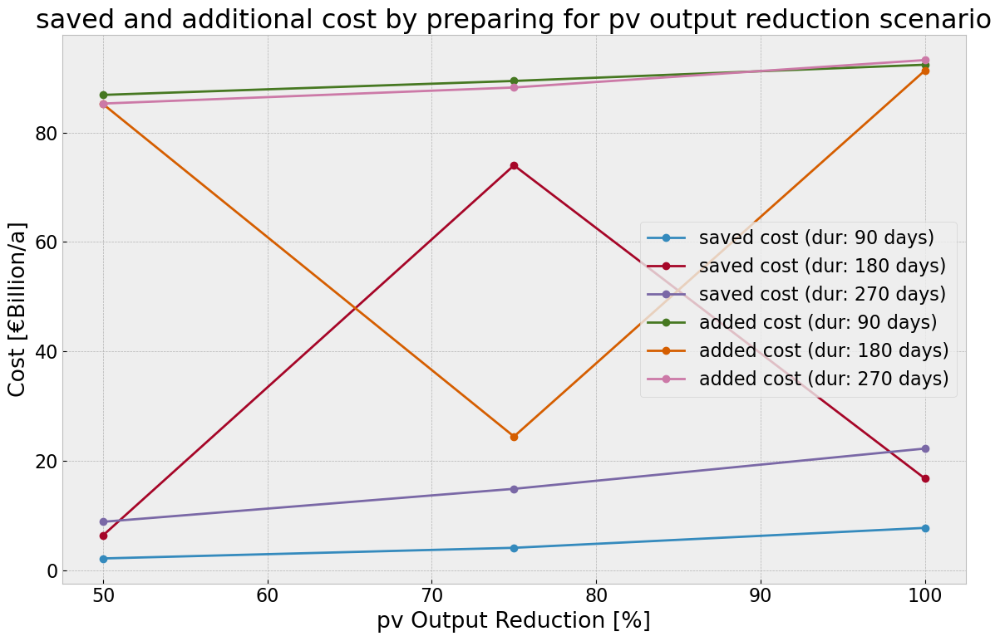

In [709]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [710]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [711]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [712]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3181701580.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3181701580.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base', i] = cap_base_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3181701580.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.025925288351283' has dtype incompatible with int64, ple

In [713]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'onwind': 0, 'offwind': 1, 'OCGT': 2, 'solar': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

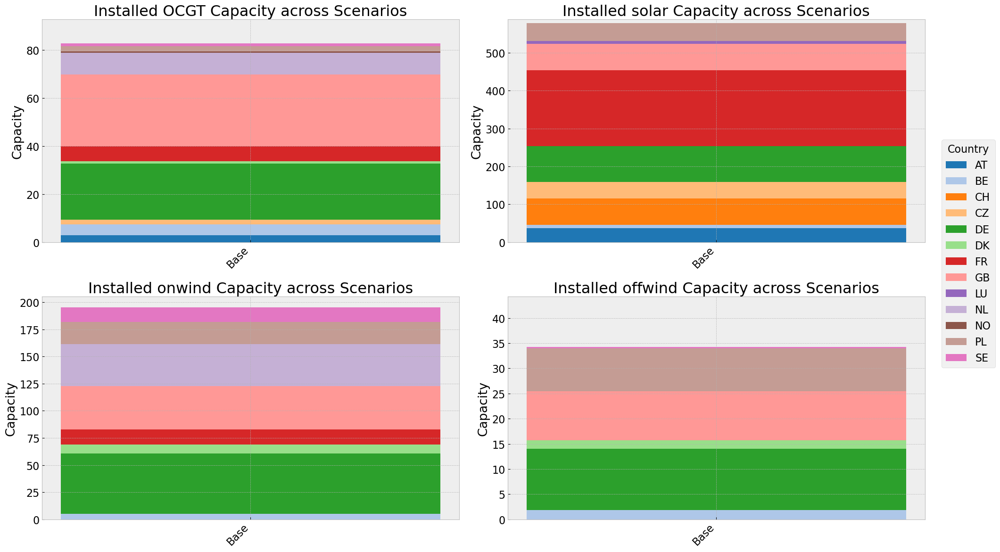

In [714]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [715]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly cast

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

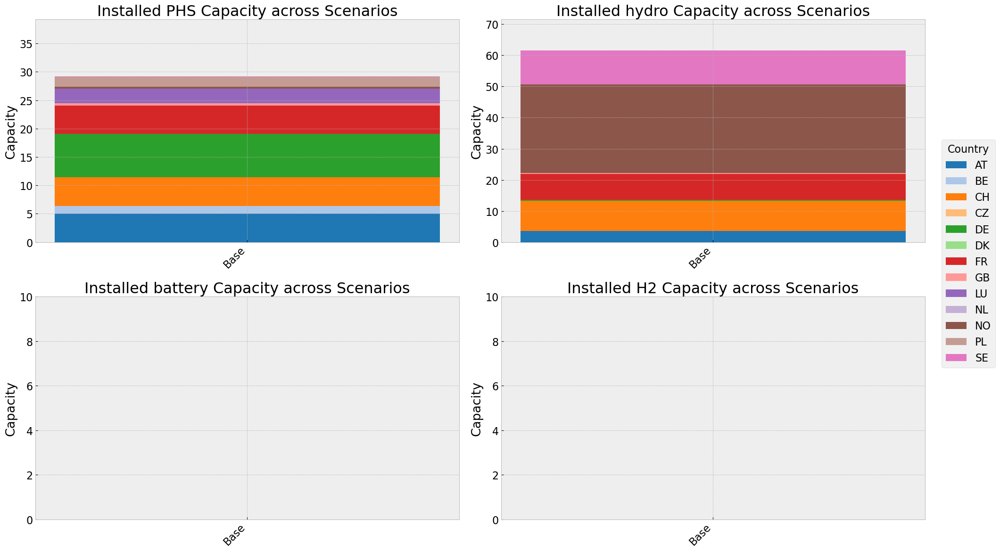

In [716]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [717]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '27.214328698683715' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '17.249147582416935' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '36.91138834993883' has dtype incompat

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9472\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


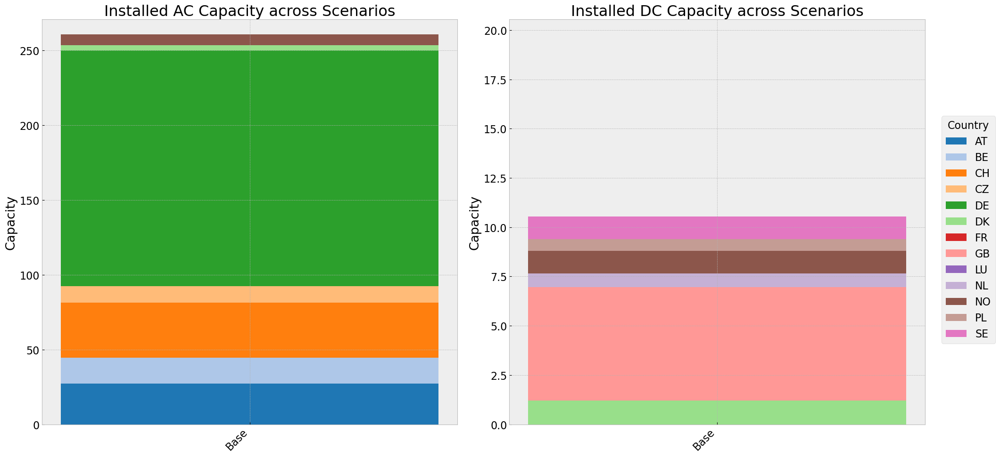

In [718]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()